# Vanilla Stock Portfolio Management
## Adapted from FinRL Tutorial
### This version is rewarded based on total return.

https://github.com/AI4Finance-Foundation/FinRL-Tutorials/blob/master/1-Introduction/FinRL_PortfolioAllocation_NeurIPS_2020.ipynb

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
matplotlib.use('Agg')
%matplotlib inline
import datetime

from finrl import config
from finrl import config_tickers
from finrl.meta.preprocessor.yahoodownloader import YahooDownloader
from finrl.meta.preprocessor.preprocessors import FeatureEngineer, data_split
from finrl.meta.env_portfolio_allocation.env_portfolio import StockPortfolioEnv
from sb3_models import DRLAgent
from finrl.plot import backtest_stats, backtest_plot, get_daily_return, get_baseline,convert_daily_return_to_pyfolio_ts
from finrl.meta.data_processor import DataProcessor
import sys
sys.path.append("../FinRL-Library")


config.INDICATORS

/opt/homebrew/Caskroom/miniconda/base/lib/python3.10/site-packages/pyfolio/pos.py:26: UserWarning: Module "zipline.assets" not found; mutltipliers will not be applied to position notionals.
  warnings.warn(


['macd',
 'boll_ub',
 'boll_lb',
 'rsi_30',
 'cci_30',
 'dx_30',
 'close_30_sma',
 'close_60_sma']

In [2]:
print(config_tickers.DOW_30_TICKER)

['AXP', 'AMGN', 'AAPL', 'BA', 'CAT', 'CSCO', 'CVX', 'GS', 'HD', 'HON', 'IBM', 'INTC', 'JNJ', 'KO', 'JPM', 'MCD', 'MMM', 'MRK', 'MSFT', 'NKE', 'PG', 'TRV', 'UNH', 'CRM', 'VZ', 'V', 'WBA', 'WMT', 'DIS', 'DOW']


In [3]:
import os
if not os.path.exists("./" + config.RESULTS_DIR):
    os.makedirs("./" + config.RESULTS_DIR)

## Download stock market data

In [4]:
df = YahooDownloader(start_date='2020-01-01',
                     end_date='2023-12-07',
                     ticker_list=config_tickers.DOW_30_TICKER,
                    ).fetch_data()
df = df.rename(columns={'timestamp': 'date'})

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

In [5]:
print(df)
print(len(df))

             date        open        high         low       close     volume  \
0      2020-01-02   74.059998   75.150002   73.797501   73.152657  135480400   
1      2020-01-02  243.000000  243.190002  238.979996  212.332352    2088000   
2      2020-01-02  124.660004  126.269997  124.230003  119.306709    2708000   
3      2020-01-02  328.549988  333.350006  327.700012  331.348572    4544400   
4      2020-01-02  149.000000  150.550003  147.979996  137.044815    3311900   
...           ...         ...         ...         ...         ...        ...   
29695  2023-12-06  547.559998  551.880005  547.099976  549.530029    2239700   
29696  2023-12-06  255.800003  256.829987  253.529999  254.289993    3874000   
29697  2023-12-06   38.250000   38.880001   38.080002   38.500000   20218500   
29698  2023-12-06   20.580000   21.660000   20.400000   21.379999   14124800   
29699  2023-12-06  155.550003  155.830002  153.649994  153.470001    8815800   

        tic  day  
0      AAPL    3  
1

In [6]:
fe = FeatureEngineer(
                    use_technical_indicator=True,
                    use_turbulence=False,
                    user_defined_feature = False)

df = fe.preprocess_data(df)

Successfully added technical indicators


In [7]:
# add covariance matrix as states
df=df.sort_values(['date','tic'],ignore_index=True)
df.index = df.date.factorize()[0]

cov_list = []
return_list = []

# look back is one year
lookback=252
for i in range(lookback,len(df.index.unique())):
  data_lookback = df.loc[i-lookback:i,:]
  price_lookback=data_lookback.pivot_table(index = 'date',columns = 'tic', values = 'close')
  return_lookback = price_lookback.pct_change().dropna()
  return_list.append(return_lookback)

  covs = return_lookback.cov().values 
  cov_list.append(covs)

  
df_cov = pd.DataFrame({'date':df.date.unique()[lookback:],'cov_list':cov_list,'return_list':return_list})
df = df.merge(df_cov, on='date')
df = df.sort_values(['date','tic']).reset_index(drop=True)
df

,date,open,high,low,close,volume,tic,day,macd,boll_ub,boll_lb,rsi_30,cci_30,dx_30,close_30_sma,close_60_sma,cov_list,return_list
0,2020-12-31,134.080002,134.740005,131.720001,130.387238,99116600,AAPL,3,3.798808,134.960053,116.065589,60.049980,109.912046,30.069064,122.342315,118.476422,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
1,2020-12-31,227.309998,230.250000,225.889999,208.949753,1821000,AMGN,3,-0.417804,211.647572,201.568082,50.278696,62.505639,7.522113,205.506675,207.567846,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
2,2020-12-31,119.709999,121.059998,119.160004,116.266846,1747800,AXP,3,1.019445,120.469245,109.682569,57.946445,38.725678,8.051612,114.522828,107.043677,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
3,2020-12-31,216.240005,216.899994,212.699997,214.059998,10487600,BA,3,2.783167,241.532025,208.912974,55.192247,-57.736645,5.306019,220.824666,193.928667,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
4,2020-12-31,180.250000,182.100006,178.750000,170.705872,1717800,CAT,3,1.862807,171.562770,164.542653,59.189824,97.574289,22.924337,166.429310,160.052207,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22135,2023-12-06,547.559998,551.880005,547.099976,549.530029,2239700,UNH,2,5.499928,552.493196,529.299217,60.149912,137.472473,14.762317,537.284715,524.128617,"[[0.0001888144813901267, 2.0279977798833123e-0...",tic AAPL AMGN AXP ...
22136,2023-12-06,255.800003,256.829987,253.529999,254.289993,3874000,V,2,4.013324,259.845183,241.819818,61.014676,88.597988,26.742910,246.362182,240.921262,"[[0.0001888144813901267, 2.0279977798833123e-0...",tic AAPL AMGN AXP ...
22137,2023-12-06,38.250000,38.880001,38.080002,38.500000,20218500,VZ,2,1.088623,39.119915,34.920085,66.990125,128.436574,57.177165,36.355000,34.135153,"[[0.0001888144813901267, 2.0279977798833123e-0...",tic AAPL AMGN AXP ...
22138,2023-12-06,20.580000,21.660000,20.400000,21.379999,14124800,WBA,2,-0.120179,21.628894,19.629269,48.725902,45.495158,12.189124,20.732519,21.118925,"[[0.0001888144813901267, 2.0279977798833123e-0...",tic AAPL AMGN AXP ...


In [8]:
train = data_split(df, '2020-01-01','2022-12-06')
train

,date,open,high,low,close,volume,tic,day,macd,boll_ub,boll_lb,rsi_30,cci_30,dx_30,close_30_sma,close_60_sma,cov_list,return_list
0,2020-12-31,134.080002,134.740005,131.720001,130.387238,99116600,AAPL,3,3.798808,134.960053,116.065589,60.049980,109.912046,30.069064,122.342315,118.476422,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
0,2020-12-31,227.309998,230.250000,225.889999,208.949753,1821000,AMGN,3,-0.417804,211.647572,201.568082,50.278696,62.505639,7.522113,205.506675,207.567846,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
0,2020-12-31,119.709999,121.059998,119.160004,116.266846,1747800,AXP,3,1.019445,120.469245,109.682569,57.946445,38.725678,8.051612,114.522828,107.043677,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
0,2020-12-31,216.240005,216.899994,212.699997,214.059998,10487600,BA,3,2.783167,241.532025,208.912974,55.192247,-57.736645,5.306019,220.824666,193.928667,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
0,2020-12-31,180.250000,182.100006,178.750000,170.705872,1717800,CAT,3,1.862807,171.562770,164.542653,59.189824,97.574289,22.924337,166.429310,160.052207,"[[0.0008654079692777507, 0.0004378997993788159...",tic AAPL AMGN AXP ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
485,2022-12-05,531.489990,540.380005,530.880005,527.104309,2424800,UNH,0,2.043266,547.204162,494.416941,52.227634,3.595902,12.142209,525.488441,515.864255,"[[0.0005042535137362604, 9.795941946222373e-05...",tic AAPL AMGN AXP ...
485,2022-12-05,215.649994,216.910004,213.050003,211.996521,9006300,V,0,4.805273,219.364874,195.549621,56.888425,100.439355,20.416435,204.589788,194.675665,"[[0.0005042535137362604, 9.795941946222373e-05...",tic AAPL AMGN AXP ...
485,2022-12-05,37.980000,38.110001,36.900002,34.533562,27561000,VZ,0,0.093918,36.706306,34.559333,43.325538,-45.586645,13.087324,35.229757,35.438277,"[[0.0005042535137362604, 9.795941946222373e-05...",tic AAPL AMGN AXP ...
485,2022-12-05,41.360001,41.419998,40.820000,38.444477,4501800,WBA,0,1.371688,40.402224,34.781284,60.949548,68.081884,39.187576,36.105662,33.355762,"[[0.0005042535137362604, 9.795941946222373e-05...",tic AAPL AMGN AXP ...


## Environment

In [9]:
import numpy as np
import pandas as pd
from gym.utils import seeding
import gym
from gym import spaces
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
from stable_baselines3.common.vec_env import DummyVecEnv


class StockPortfolioEnv(gym.Env):
    """A single stock trading environment for OpenAI gym

    Attributes
    ----------
        df: DataFrame
            input data
        stock_dim : int
            number of unique stocks
        hmax : int
            maximum number of shares to trade
        initial_amount : int
            start money
        transaction_cost_pct: float
            transaction cost percentage per trade
        reward_scaling: float
            scaling factor for reward, good for training
        state_space: int
            the dimension of input features
        action_space: int
            equals stock dimension
        tech_indicator_list: list
            a list of technical indicator names
        turbulence_threshold: int
            a threshold to control risk aversion
        day: int
            an increment number to control date

    Methods
    -------
    _sell_stock()
        perform sell action based on the sign of the action
    _buy_stock()
        perform buy action based on the sign of the action
    step()
        at each step the agent will return actions, then 
        we will calculate the reward, and return the next observation.
    reset()
        reset the environment
    render()
        use render to return other functions
    save_asset_memory()
        return account value at each time step
    save_action_memory()
        return actions/positions at each time step
        

    """
    metadata = {'render.modes': ['human']}

    def __init__(self, 
                df,
                stock_dim,
                hmax,
                initial_amount,
                transaction_cost_pct,
                reward_scaling,
                state_space,
                action_space,
                tech_indicator_list,
                turbulence_threshold=None,
                lookback=252,
                day = 0):
        #super(StockEnv, self).__init__()
        #money = 10 , scope = 1
        self.day = day
        self.lookback=lookback
        self.df = df
        self.stock_dim = stock_dim
        self.hmax = hmax
        self.initial_amount = initial_amount
        self.transaction_cost_pct =transaction_cost_pct
        self.reward_scaling = reward_scaling
        self.state_space = state_space
        self.action_space = action_space
        self.tech_indicator_list = tech_indicator_list
        
        self.termination_callback = None

        # action_space normalization and shape is self.stock_dim
        self.action_space = spaces.Box(low = 0, high = 1,shape = (self.action_space,)) 
        # Shape = (34, 30)
        # covariance matrix + technical indicators
        self.observation_space = spaces.Box(low=-np.inf, high=np.inf, shape = (self.state_space+len(self.tech_indicator_list),self.state_space))

        # load data from a pandas dataframe
        self.data = self.df.loc[self.day,:]
        self.covs = self.data['cov_list'].values[0]
        self.state =  np.append(np.array(self.covs), [self.data[tech].values.tolist() for tech in self.tech_indicator_list ], axis=0)
        self.terminal = False
        self.turbulence_threshold = turbulence_threshold        
        # initalize state: inital portfolio return + individual stock return + individual weights
        self.portfolio_value = self.initial_amount

        # memorize portfolio value each step
        self.asset_memory = [self.initial_amount]
        # memorize portfolio return each step
        self.portfolio_return_memory = [0]
        self.actions_memory=[[1/self.stock_dim]*self.stock_dim]
        self.date_memory=[self.data.date.unique()[0]]

        
    def step(self, actions):
        # print(self.day)
        self.terminal = self.day >= len(self.df.index.unique())-1
        # print(actions)
        if self.terminal:
            df = pd.DataFrame(self.portfolio_return_memory)
            df.columns = ['daily_return']
            plt.plot(df.daily_return.cumsum(),'r')
            plt.savefig('results/cumulative_reward.png')
            plt.close()
            
            plt.plot(self.portfolio_return_memory,'r')
            plt.savefig('results/rewards.png')
            plt.close()
            
            if self.termination_callback: self.termination_callback(self.portfolio_value)

            print("=================================")
            print("begin_total_asset:{}".format(self.asset_memory[0]))           
            print("end_total_asset:{}".format(self.portfolio_value))

            df_daily_return = pd.DataFrame(self.portfolio_return_memory)
            df_daily_return.columns = ['daily_return']
            if df_daily_return['daily_return'].std() !=0:
              sharpe = (252**0.5)*df_daily_return['daily_return'].mean()/ \
                       df_daily_return['daily_return'].std()
              print("Sharpe: ",sharpe)
            print("=================================")
            
            return self.state, self.reward, self.terminal,{}

        else:
            #print("Model actions: ",actions)
            # actions are the portfolio weight
            # normalize to sum of 1
            #if (np.array(actions) - np.array(actions).min()).sum() != 0:
            #  norm_actions = (np.array(actions) - np.array(actions).min()) / (np.array(actions) - np.array(actions).min()).sum()
            #else:
            #  norm_actions = actions
            weights = self.softmax_normalization(actions) 
            #print("Normalized actions: ", weights)
            self.actions_memory.append(weights)
            last_day_memory = self.data

            #load next state
            self.day += 1
            self.data = self.df.loc[self.day,:]
            self.covs = self.data['cov_list'].values[0]
            self.state =  np.append(np.array(self.covs), [self.data[tech].values.tolist() for tech in self.tech_indicator_list ], axis=0)
            #print(self.state)
            # calcualte portfolio return
            # individual stocks' return * weight
            portfolio_return = sum(((self.data.close.values / last_day_memory.close.values)-1)*weights)
            # update portfolio value
            new_portfolio_value = self.portfolio_value*(1+portfolio_return)
            self.portfolio_value = new_portfolio_value

            # save into memory
            self.portfolio_return_memory.append(portfolio_return)
            self.date_memory.append(self.data.date.unique()[0])            
            self.asset_memory.append(new_portfolio_value)

            # the reward is the new portfolio value or end portfolo value
            self.reward = new_portfolio_value 
            #print("Step reward: ", self.reward)
            #self.reward = self.reward*self.reward_scaling

        return self.state, self.reward, self.terminal, {}

    def reset(self):
        self.asset_memory = [self.initial_amount]
        self.day = 0
        self.data = self.df.loc[self.day,:]
        # load states
        self.covs = self.data['cov_list'].values[0]
        self.state =  np.append(np.array(self.covs), [self.data[tech].values.tolist() for tech in self.tech_indicator_list ], axis=0)
        self.portfolio_value = self.initial_amount
        #self.cost = 0
        #self.trades = 0
        self.terminal = False 
        self.portfolio_return_memory = [0]
        self.actions_memory=[[1/self.stock_dim]*self.stock_dim]
        self.date_memory=[self.data.date.unique()[0]] 
        return self.state
    
    def render(self, mode='human'):
        return self.state
        
    def softmax_normalization(self, actions):
        numerator = np.exp(actions)
        denominator = np.sum(np.exp(actions))
        softmax_output = numerator/denominator
        return softmax_output

    
    def save_asset_memory(self):
        date_list = self.date_memory
        portfolio_return = self.portfolio_return_memory
        #print(len(date_list))
        #print(len(asset_list))
        df_account_value = pd.DataFrame({'date':date_list,'daily_return':portfolio_return})
        return df_account_value

    def save_action_memory(self):
        # date and close price length must match actions length
        date_list = self.date_memory
        df_date = pd.DataFrame(date_list)
        df_date.columns = ['date']
        
        action_list = self.actions_memory
        df_actions = pd.DataFrame(action_list)
        df_actions.columns = self.data.tic.values
        df_actions.index = df_date.date
        #df_actions = pd.DataFrame({'date':date_list,'actions':action_list})
        return df_actions

    def _seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def get_sb_env(self):
        e = DummyVecEnv([lambda: self])
        obs = e.reset()
        return e, obs

In [10]:
stock_dimension = len(train.tic.unique())
state_space = stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")


Stock Dimension: 30, State Space: 30


In [11]:
env_kwargs = {
    "hmax": 100, 
    "initial_amount": 1000000, 
    "transaction_cost_pct": 0.001, 
    "state_space": state_space, 
    "stock_dim": stock_dimension, 
    "tech_indicator_list": config.INDICATORS, 
    "action_space": stock_dimension, 
    "reward_scaling": 1e-4
    
}

e_train_gym = StockPortfolioEnv(df = train, **env_kwargs)

In [12]:
env_train, _ = e_train_gym.get_sb_env()
print(type(env_train))

<class 'stable_baselines3.common.vec_env.dummy_vec_env.DummyVecEnv'>


/opt/homebrew/Caskroom/miniconda/base/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


## Agents

In [13]:
# initialize
agent = DRLAgent(env = env_train)

train_time_seconds = 60 * 60 * 3

def make_callback(rewards, losses, returns):
    def callback(name_to_value):
        rewards.append(name_to_value['train/reward'])
        
        loss_key = 'train/loss' if 'train/loss' in name_to_value else 'train/policy_loss'
        losses.append(name_to_value[loss_key])
    def termination_callback(portfolio_value):
        returns.append(portfolio_value)
    e_train_gym.termination_callback = termination_callback
    return callback

def rolling_average(data):
    """Smoothen the 1-d data array using a rollin average.

    Args:
        data: 1-d numpy.array
        window_size: size of the smoothing window

    Returns:
        smooth_data: a 1-d numpy.array with the same size as data
    """
    window_size = int(len(data) / 20)
    data = np.array(data)
    assert data.ndim == 1
    kernel = np.ones(window_size)
    smooth_data = np.convolve(data, kernel) / np.convolve(
        np.ones_like(data), kernel
    )
    return smooth_data[: -window_size + 1]

In [14]:
# A2C
agent = DRLAgent(env = env_train)

A2C_PARAMS = {"n_steps": 5, "ent_coef": 0.005, "learning_rate": 0.0002}
model_a2c = agent.get_model(model_name="a2c",model_kwargs = A2C_PARAMS)

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.0002}
Using cpu device


In [15]:
a2c_rewards = []
a2c_losses = []
a2c_returns = []

trained_a2c = agent.train_model(model=model_a2c, 
                                tb_log_name='a2c',
                                train_time_seconds=train_time_seconds,
                                callback=make_callback(a2c_rewards, a2c_losses, a2c_returns))

begin_total_asset:1000000
end_total_asset:1183322.2204971754
Sharpe:  0.5994813937410003
-------------------------------------
| time/                 |           |
|    fps                | 747       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -42.4     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 99        |
|    policy_loss        | 1.3e+08   |
|    reward             | 1018211.2 |
|    std                | 0.996     |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146650.9557712707
Sharpe:  0.508388145245142
-------------------------------------
| time/                 |           |
|    fps                | 725       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1147957.2007175782
Sharpe:  0.5115014734095195
-------------------------------------
| time/                 |           |
|    fps                | 728       |
|    iterations         | 1200      |
|    time_elapsed       | 8         |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -42.4     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1199      |
|    policy_loss        | 1.51e+08  |
|    reward             | 1170591.4 |
|    std                | 0.993     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133066.9225793097
Sharpe:  0.47333932673613927
-------------------------------------
| time/                 |           |
|    fps                | 729       |
|    iterations         | 1300      |
|    time_elapsed       | 8         |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1160402.0820954174
Sharpe:  0.5465888208126867
-------------------------------------
| time/                 |           |
|    fps                | 734       |
|    iterations         | 2300      |
|    time_elapsed       | 15        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -42.2     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 2299      |
|    policy_loss        | 1.55e+08  |
|    reward             | 1183184.2 |
|    std                | 0.989     |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1183923.5038356232
Sharpe:  0.6135412489602053
-------------------------------------
| time/                 |           |
|    fps                | 735       |
|    iterations         | 2400      |
|    time_elapsed       | 16        |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1168117.2407127104
Sharpe:  0.5677017711795121
-------------------------------------
| time/                 |           |
|    fps                | 730       |
|    iterations         | 3400      |
|    time_elapsed       | 23        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -42.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 3399      |
|    policy_loss        | 1.47e+08  |
|    reward             | 1127176.4 |
|    std                | 0.984     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133598.7745308487
Sharpe:  0.47318195638146265
begin_total_asset:1000000
end_total_asset:1147927.1607802524
Sharpe:  0.515079886644572
--------------------------------------
| time/                 |            |
|    fps                | 729        |
|    ite

begin_total_asset:1000000
end_total_asset:1162743.2537726955
Sharpe:  0.5554464938537396
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 4500      |
|    time_elapsed       | 31        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -41.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 4499      |
|    policy_loss        | 1.44e+08  |
|    reward             | 1161147.8 |
|    std                | 0.979     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139997.0098390803
Sharpe:  0.4965843103363727
-------------------------------------
| time/                 |           |
|    fps                | 715       |
|    iterations         | 4600      |
|    time_elapsed       | 32        |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1144661.5493585868
Sharpe:  0.5065532856032023
-------------------------------------
| time/                 |           |
|    fps                | 715       |
|    iterations         | 5600      |
|    time_elapsed       | 39        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -41.8     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 5599      |
|    policy_loss        | 1.53e+08  |
|    reward             | 1104998.5 |
|    std                | 0.975     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1103699.3103170877
Sharpe:  0.3911843642246917
-------------------------------------
| time/                 |           |
|    fps                | 715       |
|    iterations         | 5700      |
|    time_elapsed       | 39        |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125849.59043071
Sharpe:  0.4544724301569436
--------------------------------------
| time/                 |            |
|    fps                | 716        |
|    iterations         | 6700       |
|    time_elapsed       | 46         |
|    total_timesteps    | 33500      |
| train/                |            |
|    entropy_loss       | -41.7      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 6699       |
|    policy_loss        | 1.25e+08   |
|    reward             | 1004202.25 |
|    std                | 0.971      |
|    value_loss         | 9.99e+12   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1125174.5177971458
Sharpe:  0.4483611369831325
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 6800      |
|    time_elapsed       | 47        |
|    total

begin_total_asset:1000000
end_total_asset:1150319.7799814304
Sharpe:  0.5228556980404109
-------------------------------------
| time/                 |           |
|    fps                | 715       |
|    iterations         | 7800      |
|    time_elapsed       | 54        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -41.6     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 7799      |
|    policy_loss        | 1.36e+08  |
|    reward             | 1124840.6 |
|    std                | 0.969     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146223.4851888886
Sharpe:  0.5146455560295528
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 7900      |
|    time_elapsed       | 55        |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1120803.2681812998
Sharpe:  0.4403295475106474
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 8900      |
|    time_elapsed       | 62        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -41.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 8899      |
|    policy_loss        | 1.46e+08  |
|    reward             | 1199810.6 |
|    std                | 0.964     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148475.3551662506
Sharpe:  0.5159549126639311
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 9000      |
|    time_elapsed       | 62        |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1124101.057025418
Sharpe:  0.45060244905942853
--------------------------------------
| time/                 |            |
|    fps                | 717        |
|    iterations         | 10000      |
|    time_elapsed       | 69         |
|    total_timesteps    | 50000      |
| train/                |            |
|    entropy_loss       | -41.3      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 9999       |
|    policy_loss        | 1.22e+08   |
|    reward             | 1026100.25 |
|    std                | 0.96       |
|    value_loss         | 1.14e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1126398.5462795293
Sharpe:  0.4556780120731541
------------------------------------
| time/                 |          |
|    fps                | 717      |
|    iterations         | 10100    |
|    time_elapsed       | 70       |
|    total_ti

begin_total_asset:1000000
end_total_asset:1092892.9585580511
Sharpe:  0.36076578513598184
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 11100     |
|    time_elapsed       | 77        |
|    total_timesteps    | 55500     |
| train/                |           |
|    entropy_loss       | -41.2     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 11099     |
|    policy_loss        | 1.36e+08  |
|    reward             | 1105007.5 |
|    std                | 0.955     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1107033.1201834169
Sharpe:  0.4046386630445701
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 11200     |
|    time_elapsed       | 78        |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130387.8927363665
Sharpe:  0.46776395982204727
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 12200     |
|    time_elapsed       | 85        |
|    total_timesteps    | 61000     |
| train/                |           |
|    entropy_loss       | -41.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 12199     |
|    policy_loss        | 1.37e+08  |
|    reward             | 1191767.1 |
|    std                | 0.952     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127813.1215050195
Sharpe:  0.45738244840886694
-------------------------------------
| time/                 |           |
|    fps                | 715       |
|    iterations         | 12300     |
|    time_elapsed       | 85        |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1117234.7720171206
Sharpe:  0.4295556503901687
-------------------------------------
| time/                 |           |
|    fps                | 715       |
|    iterations         | 13300     |
|    time_elapsed       | 92        |
|    total_timesteps    | 66500     |
| train/                |           |
|    entropy_loss       | -41       |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 13299     |
|    policy_loss        | 1.32e+08  |
|    reward             | 1104230.1 |
|    std                | 0.949     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124479.1418905698
Sharpe:  0.4467540830646794
-------------------------------------
| time/                 |           |
|    fps                | 715       |
|    iterations         | 13400     |
|    time_elapsed       | 93        |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133441.9038161745
Sharpe:  0.4777848213621943
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 14400     |
|    time_elapsed       | 100       |
|    total_timesteps    | 72000     |
| train/                |           |
|    entropy_loss       | -40.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 14399     |
|    policy_loss        | 1.42e+08  |
|    reward             | 1129769.5 |
|    std                | 0.943     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1144227.0019465273
Sharpe:  0.5060155974903495
-------------------------------------
| time/                 |           |
|    fps                | 716       |
|    iterations         | 14500     |
|    time_elapsed       | 101       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1146679.001274747
Sharpe:  0.5116204365372008
-------------------------------------
| time/                 |           |
|    fps                | 710       |
|    iterations         | 15500     |
|    time_elapsed       | 109       |
|    total_timesteps    | 77500     |
| train/                |           |
|    entropy_loss       | -40.7     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 15499     |
|    policy_loss        | 1.45e+08  |
|    reward             | 1170752.8 |
|    std                | 0.941     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136576.915525348
Sharpe:  0.4815812090950041
-------------------------------------
| time/                 |           |
|    fps                | 710       |
|    iterations         | 15600     |
|    time_elapsed       | 109       |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1118925.1135094461
Sharpe:  0.4294395713076218
-------------------------------------
| time/                 |           |
|    fps                | 707       |
|    iterations         | 16600     |
|    time_elapsed       | 117       |
|    total_timesteps    | 83000     |
| train/                |           |
|    entropy_loss       | -40.7     |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 16599     |
|    policy_loss        | 1.14e+08  |
|    reward             | 1046743.8 |
|    std                | 0.939     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142897.616781918
Sharpe:  0.49462791193737593
-------------------------------------
| time/                 |           |
|    fps                | 707       |
|    iterations         | 16700     |
|    time_elapsed       | 117       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141895.0930206266
Sharpe:  0.49028365042792665
-------------------------------------
| time/                 |           |
|    fps                | 697       |
|    iterations         | 17700     |
|    time_elapsed       | 126       |
|    total_timesteps    | 88500     |
| train/                |           |
|    entropy_loss       | -40.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 17699     |
|    policy_loss        | 1.12e+08  |
|    reward             | 1091612.8 |
|    std                | 0.935     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1166391.101146719
Sharpe:  0.5561571239429717
-------------------------------------
| time/                 |           |
|    fps                | 698       |
|    iterations         | 17800     |
|    time_elapsed       | 127       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128058.2890960337
Sharpe:  0.4549513875456735
-------------------------------------
| time/                 |           |
|    fps                | 699       |
|    iterations         | 18800     |
|    time_elapsed       | 134       |
|    total_timesteps    | 94000     |
| train/                |           |
|    entropy_loss       | -40.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 18799     |
|    policy_loss        | 1.39e+08  |
|    reward             | 1174341.6 |
|    std                | 0.929     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156000.4025770368
Sharpe:  0.531093475551275
-------------------------------------
| time/                 |           |
|    fps                | 699       |
|    iterations         | 18900     |
|    time_elapsed       | 135       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1137432.2520366597
Sharpe:  0.4756933348638377
-------------------------------------
| time/                 |           |
|    fps                | 699       |
|    iterations         | 19900     |
|    time_elapsed       | 142       |
|    total_timesteps    | 99500     |
| train/                |           |
|    entropy_loss       | -40.3     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 19899     |
|    policy_loss        | 1.38e+08  |
|    reward             | 1127310.0 |
|    std                | 0.927     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1171434.8157867212
Sharpe:  0.5687772834410981
-------------------------------------
| time/                 |           |
|    fps                | 700       |
|    iterations         | 20000     |
|    time_elapsed       | 142       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1171703.0982371976
Sharpe:  0.5661717196530311
-------------------------------------
| time/                 |           |
|    fps                | 700       |
|    iterations         | 21000     |
|    time_elapsed       | 149       |
|    total_timesteps    | 105000    |
| train/                |           |
|    entropy_loss       | -40.2     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 20999     |
|    policy_loss        | 1.28e+08  |
|    reward             | 1023496.1 |
|    std                | 0.923     |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163034.7282008952
Sharpe:  0.5411338515969782
-------------------------------------
| time/                 |           |
|    fps                | 700       |
|    iterations         | 21100     |
|    time_elapsed       | 150       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135489.0190222675
Sharpe:  0.4720145337275552
-------------------------------------
| time/                 |           |
|    fps                | 700       |
|    iterations         | 22100     |
|    time_elapsed       | 157       |
|    total_timesteps    | 110500    |
| train/                |           |
|    entropy_loss       | -40.1     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 22099     |
|    policy_loss        | 1.48e+08  |
|    reward             | 1179553.1 |
|    std                | 0.922     |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149446.347662674
Sharpe:  0.5121862059583173
-------------------------------------
| time/                 |           |
|    fps                | 700       |
|    iterations         | 22200     |
|    time_elapsed       | 158       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1201782.3371743555
Sharpe:  0.6435396280755605
-------------------------------------
| time/                 |           |
|    fps                | 701       |
|    iterations         | 23200     |
|    time_elapsed       | 165       |
|    total_timesteps    | 116000    |
| train/                |           |
|    entropy_loss       | -40       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 23199     |
|    policy_loss        | 1.43e+08  |
|    reward             | 1127630.5 |
|    std                | 0.917     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139355.2390804747
Sharpe:  0.4825051057354161
-------------------------------------
| time/                 |           |
|    fps                | 701       |
|    iterations         | 23300     |
|    time_elapsed       | 166       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1166342.7958585573
Sharpe:  0.5526185946393201
begin_total_asset:1000000
end_total_asset:1208105.6566396784
Sharpe:  0.6610962286088424
-------------------------------------
| time/                 |           |
|    fps                | 701       |
|    iterations         | 24300     |
|    time_elapsed       | 173       |
|    total_timesteps    | 121500    |
| train/                |           |
|    entropy_loss       | -39.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 24299     |
|    policy_loss        | 1.38e+08  |
|    reward             | 1208105.6 |
|    std                | 0.914     |
|    value_loss         | 1.54e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1177835.2322328284
Sharpe:  0.5875985338556781
-------------------------------------
| time/                 |           |
|    fps                | 701       |
|    iterat

begin_total_asset:1000000
end_total_asset:1130962.6995825123
Sharpe:  0.4640586417953943
-------------------------------------
| time/                 |           |
|    fps                | 701       |
|    iterations         | 25400     |
|    time_elapsed       | 181       |
|    total_timesteps    | 127000    |
| train/                |           |
|    entropy_loss       | -39.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 25399     |
|    policy_loss        | 1.37e+08  |
|    reward             | 1171517.4 |
|    std                | 0.912     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142960.1107076495
Sharpe:  0.5009620206250535
-------------------------------------
| time/                 |           |
|    fps                | 701       |
|    iterations         | 25500     |
|    time_elapsed       | 181       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1169489.4893045877
Sharpe:  0.5695620262284617
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 26500     |
|    time_elapsed       | 193       |
|    total_timesteps    | 132500    |
| train/                |           |
|    entropy_loss       | -39.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 26499     |
|    policy_loss        | 1.29e+08  |
|    reward             | 1129659.2 |
|    std                | 0.91      |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1105301.066383952
Sharpe:  0.3945369718174988
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 26600     |
|    time_elapsed       | 194       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1144410.0217774943
Sharpe:  0.5039254468326536
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 27600     |
|    time_elapsed       | 201       |
|    total_timesteps    | 138000    |
| train/                |           |
|    entropy_loss       | -39.6     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 27599     |
|    policy_loss        | 1.15e+08  |
|    reward             | 1130810.0 |
|    std                | 0.907     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1180457.8331147088
Sharpe:  0.6052728718504853
-------------------------------------
| time/                 |           |
|    fps                | 684       |
|    iterations         | 27700     |
|    time_elapsed       | 202       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1195464.0390517057
Sharpe:  0.6430413981163426
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 28700     |
|    time_elapsed       | 211       |
|    total_timesteps    | 143500    |
| train/                |           |
|    entropy_loss       | -39.5     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 28699     |
|    policy_loss        | 1.37e+08  |
|    reward             | 1148734.0 |
|    std                | 0.904     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1107932.5435500513
Sharpe:  0.4050191801068644
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 28800     |
|    time_elapsed       | 211       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1105693.9460076909
Sharpe:  0.39676873961699094
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 29800     |
|    time_elapsed       | 219       |
|    total_timesteps    | 149000    |
| train/                |           |
|    entropy_loss       | -39.4     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 29799     |
|    policy_loss        | 1.27e+08  |
|    reward             | 1149532.8 |
|    std                | 0.9       |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095866.8635909138
Sharpe:  0.3718388634267577
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 29900     |
|    time_elapsed       | 220       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1187883.5519544054
Sharpe:  0.6266461815639002
------------------------------------
| time/                 |          |
|    fps                | 680      |
|    iterations         | 30900    |
|    time_elapsed       | 227      |
|    total_timesteps    | 154500   |
| train/                |          |
|    entropy_loss       | -39.3    |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 30899    |
|    policy_loss        | 1.14e+08 |
|    reward             | 990516.3 |
|    std                | 0.896    |
|    value_loss         | 1.11e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1142137.9681531084
Sharpe:  0.5079646641779844
--------------------------------------
| time/                 |            |
|    fps                | 680        |
|    iterations         | 31000      |
|    time_elapsed       | 227        |
|    total_timesteps    | 155000   

begin_total_asset:1000000
end_total_asset:1108033.1850772803
Sharpe:  0.40741672180334876
-------------------------------------
| time/                 |           |
|    fps                | 681       |
|    iterations         | 32000     |
|    time_elapsed       | 234       |
|    total_timesteps    | 160000    |
| train/                |           |
|    entropy_loss       | -39.1     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 31999     |
|    policy_loss        | 1.44e+08  |
|    reward             | 1150079.8 |
|    std                | 0.893     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142916.2820132037
Sharpe:  0.5034329432234342
-------------------------------------
| time/                 |           |
|    fps                | 681       |
|    iterations         | 32100     |
|    time_elapsed       | 235       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1122187.3998232123
Sharpe:  0.4478620430977167
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 33100     |
|    time_elapsed       | 242       |
|    total_timesteps    | 165500    |
| train/                |           |
|    entropy_loss       | -38.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 33099     |
|    policy_loss        | 1.38e+08  |
|    reward             | 1202448.5 |
|    std                | 0.887     |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137760.7690579726
Sharpe:  0.49308322458741327
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 33200     |
|    time_elapsed       | 243       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1153419.5470021688
Sharpe:  0.5336646330782352
-------------------------------------
| time/                 |           |
|    fps                | 683       |
|    iterations         | 34200     |
|    time_elapsed       | 250       |
|    total_timesteps    | 171000    |
| train/                |           |
|    entropy_loss       | -38.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 34199     |
|    policy_loss        | 1.3e+08   |
|    reward             | 1082495.1 |
|    std                | 0.885     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120188.6803554615
Sharpe:  0.44323955625231126
--------------------------------------
| time/                 |            |
|    fps                | 683        |
|    iterations         | 34300      |
|    time_elapsed       | 250        |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1173887.6840086477
Sharpe:  0.593830178770073
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 35300     |
|    time_elapsed       | 257       |
|    total_timesteps    | 176500    |
| train/                |           |
|    entropy_loss       | -38.7     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 35299     |
|    policy_loss        | 1.21e+08  |
|    reward             | 1106879.4 |
|    std                | 0.881     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132056.169260071
Sharpe:  0.4787334995775357
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 35400     |
|    time_elapsed       | 258       |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1148051.4545523503
Sharpe:  0.5204034522141159
-------------------------------------
| time/                 |           |
|    fps                | 684       |
|    iterations         | 36400     |
|    time_elapsed       | 265       |
|    total_timesteps    | 182000    |
| train/                |           |
|    entropy_loss       | -38.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 36399     |
|    policy_loss        | 1.28e+08  |
|    reward             | 1155420.9 |
|    std                | 0.879     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153545.354621553
Sharpe:  0.5376745439724203
-------------------------------------
| time/                 |           |
|    fps                | 684       |
|    iterations         | 36500     |
|    time_elapsed       | 266       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1165751.868214104
Sharpe:  0.5718040076568547
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 37500     |
|    time_elapsed       | 273       |
|    total_timesteps    | 187500    |
| train/                |           |
|    entropy_loss       | -38.5     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 37499     |
|    policy_loss        | 1.25e+08  |
|    reward             | 1089509.4 |
|    std                | 0.875     |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1165291.12844326
Sharpe:  0.569890344579441
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 37600     |
|    time_elapsed       | 274       |
|    total_timesteps    | 18

begin_total_asset:1000000
end_total_asset:1119321.6210917928
Sharpe:  0.4416656533156428
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 38600     |
|    time_elapsed       | 281       |
|    total_timesteps    | 193000    |
| train/                |           |
|    entropy_loss       | -38.4     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 38599     |
|    policy_loss        | 1.29e+08  |
|    reward             | 1114706.6 |
|    std                | 0.872     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1171877.635772379
Sharpe:  0.5934235273867187
-------------------------------------
| time/                 |           |
|    fps                | 684       |
|    iterations         | 38700     |
|    time_elapsed       | 282       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1117787.9658063916
Sharpe:  0.4384986324334635
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 39700     |
|    time_elapsed       | 291       |
|    total_timesteps    | 198500    |
| train/                |           |
|    entropy_loss       | -38.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 39699     |
|    policy_loss        | 1.31e+08  |
|    reward             | 1178589.8 |
|    std                | 0.867     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137466.9024400273
Sharpe:  0.49410387118692833
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 39800     |
|    time_elapsed       | 291       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1089937.47315597
Sharpe:  0.3584015640239947
--------------------------------------
| time/                 |            |
|    fps                | 681        |
|    iterations         | 40800      |
|    time_elapsed       | 299        |
|    total_timesteps    | 204000     |
| train/                |            |
|    entropy_loss       | -38.1      |
|    explained_variance | 2.38e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 40799      |
|    policy_loss        | 1.31e+08   |
|    reward             | 1003837.56 |
|    std                | 0.864      |
|    value_loss         | 1.23e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1104352.0975710007
Sharpe:  0.3995564547758446
-------------------------------------
| time/                 |           |
|    fps                | 681       |
|    iterations         | 40900     |
|    time_elapsed       | 300       |
|    total

begin_total_asset:1000000
end_total_asset:1106490.667041491
Sharpe:  0.4057823582706894
-------------------------------------
| time/                 |           |
|    fps                | 681       |
|    iterations         | 41900     |
|    time_elapsed       | 307       |
|    total_timesteps    | 209500    |
| train/                |           |
|    entropy_loss       | -38.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 41899     |
|    policy_loss        | 1.08e+08  |
|    reward             | 1032317.1 |
|    std                | 0.862     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124245.3815358866
Sharpe:  0.45309993006634125
-------------------------------------
| time/                 |           |
|    fps                | 681       |
|    iterations         | 42000     |
|    time_elapsed       | 308       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1151532.793000357
Sharpe:  0.5280113259931153
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 43000     |
|    time_elapsed       | 315       |
|    total_timesteps    | 215000    |
| train/                |           |
|    entropy_loss       | -38       |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 42999     |
|    policy_loss        | 1.23e+08  |
|    reward             | 1116719.1 |
|    std                | 0.86      |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1169532.9953144856
Sharpe:  0.5737437745812215
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 43100     |
|    time_elapsed       | 315       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1170985.5872105788
Sharpe:  0.5786100951808284
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 44100     |
|    time_elapsed       | 322       |
|    total_timesteps    | 220500    |
| train/                |           |
|    entropy_loss       | -37.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 44099     |
|    policy_loss        | 1.28e+08  |
|    reward             | 1047014.7 |
|    std                | 0.856     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1089331.5392244873
Sharpe:  0.3497706611508364
-------------------------------------
| time/                 |           |
|    fps                | 682       |
|    iterations         | 44200     |
|    time_elapsed       | 323       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1170009.138461555
Sharpe:  0.5771456612566583
begin_total_asset:1000000
end_total_asset:1186254.1037545218
Sharpe:  0.6191998141033231
--------------------------------------
| time/                 |            |
|    fps                | 683        |
|    iterations         | 45200      |
|    time_elapsed       | 330        |
|    total_timesteps    | 226000     |
| train/                |            |
|    entropy_loss       | -37.8      |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 45199      |
|    policy_loss        | 1.12e+08   |
|    reward             | 1007510.94 |
|    std                | 0.853      |
|    value_loss         | 1.08e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1166318.6151347163
Sharpe:  0.5635766418098263
--------------------------------------
| time/                 |            |
|    fps                | 683   

begin_total_asset:1000000
end_total_asset:1164885.1217286028
Sharpe:  0.5613820014119395
-------------------------------------
| time/                 |           |
|    fps                | 683       |
|    iterations         | 46300     |
|    time_elapsed       | 338       |
|    total_timesteps    | 231500    |
| train/                |           |
|    entropy_loss       | -37.7     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 46299     |
|    policy_loss        | 1.3e+08   |
|    reward             | 1180975.8 |
|    std                | 0.852     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162717.8347768374
Sharpe:  0.5516548629513509
-------------------------------------
| time/                 |           |
|    fps                | 684       |
|    iterations         | 46400     |
|    time_elapsed       | 339       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1146629.307060315
Sharpe:  0.5120204521025731
-------------------------------------
| time/                 |           |
|    fps                | 684       |
|    iterations         | 47400     |
|    time_elapsed       | 346       |
|    total_timesteps    | 237000    |
| train/                |           |
|    entropy_loss       | -37.7     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 47399     |
|    policy_loss        | 1.36e+08  |
|    reward             | 1164825.2 |
|    std                | 0.85      |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148406.6205466622
Sharpe:  0.5187167809800314
-------------------------------------
| time/                 |           |
|    fps                | 684       |
|    iterations         | 47500     |
|    time_elapsed       | 346       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1143986.2299753833
Sharpe:  0.4993973352875814
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 48500     |
|    time_elapsed       | 353       |
|    total_timesteps    | 242500    |
| train/                |           |
|    entropy_loss       | -37.5     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 48499     |
|    policy_loss        | 1.17e+08  |
|    reward             | 1126178.2 |
|    std                | 0.846     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142192.3022130625
Sharpe:  0.4979832867675323
begin_total_asset:1000000
end_total_asset:1151216.9383026776
Sharpe:  0.5201821271800738
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterat

begin_total_asset:1000000
end_total_asset:1162711.4705707957
Sharpe:  0.557078858372758
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 49600     |
|    time_elapsed       | 361       |
|    total_timesteps    | 248000    |
| train/                |           |
|    entropy_loss       | -37.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 49599     |
|    policy_loss        | 1.4e+08   |
|    reward             | 1164109.9 |
|    std                | 0.845     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1169244.3909345819
Sharpe:  0.5738742166012519
-------------------------------------
| time/                 |           |
|    fps                | 685       |
|    iterations         | 49700     |
|    time_elapsed       | 362       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1150238.9831510177
Sharpe:  0.5147589138885685
-------------------------------------
| time/                 |           |
|    fps                | 686       |
|    iterations         | 50700     |
|    time_elapsed       | 369       |
|    total_timesteps    | 253500    |
| train/                |           |
|    entropy_loss       | -37.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 50699     |
|    policy_loss        | 1.35e+08  |
|    reward             | 1166526.4 |
|    std                | 0.842     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1169624.370947935
Sharpe:  0.5664556785041501
-------------------------------------
| time/                 |           |
|    fps                | 686       |
|    iterations         | 50800     |
|    time_elapsed       | 370       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1110509.5311665758
Sharpe:  0.4059554655459219
------------------------------------
| time/                 |          |
|    fps                | 686      |
|    iterations         | 51800    |
|    time_elapsed       | 377      |
|    total_timesteps    | 259000   |
| train/                |          |
|    entropy_loss       | -37.2    |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 51799    |
|    policy_loss        | 1.15e+08 |
|    reward             | 965287.6 |
|    std                | 0.838    |
|    value_loss         | 1.05e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1137110.3552030863
Sharpe:  0.4781225411672724
-------------------------------------
| time/                 |           |
|    fps                | 686       |
|    iterations         | 51900     |
|    time_elapsed       | 377       |
|    total_timesteps    | 259500    |
| 

begin_total_asset:1000000
end_total_asset:1129187.9758796871
Sharpe:  0.4598430652855149
-------------------------------------
| time/                 |           |
|    fps                | 686       |
|    iterations         | 52900     |
|    time_elapsed       | 385       |
|    total_timesteps    | 264500    |
| train/                |           |
|    entropy_loss       | -37.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 52899     |
|    policy_loss        | 1.3e+08   |
|    reward             | 1097839.6 |
|    std                | 0.836     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1102407.9874751722
Sharpe:  0.384346052514868
-------------------------------------
| time/                 |           |
|    fps                | 687       |
|    iterations         | 53000     |
|    time_elapsed       | 385       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1085008.3060485108
Sharpe:  0.3345872809366065
-------------------------------------
| time/                 |           |
|    fps                | 687       |
|    iterations         | 54000     |
|    time_elapsed       | 392       |
|    total_timesteps    | 270000    |
| train/                |           |
|    entropy_loss       | -37       |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 53999     |
|    policy_loss        | 1.49e+08  |
|    reward             | 1145000.9 |
|    std                | 0.831     |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127655.4882409768
Sharpe:  0.45372661764267874
-------------------------------------
| time/                 |           |
|    fps                | 687       |
|    iterations         | 54100     |
|    time_elapsed       | 393       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1089153.7903674692
Sharpe:  0.3466139840762075
-------------------------------------
| time/                 |           |
|    fps                | 687       |
|    iterations         | 55100     |
|    time_elapsed       | 400       |
|    total_timesteps    | 275500    |
| train/                |           |
|    entropy_loss       | -36.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 55099     |
|    policy_loss        | 1.17e+08  |
|    reward             | 1034143.0 |
|    std                | 0.826     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1101347.5023118448
Sharpe:  0.3825559692560097
-------------------------------------
| time/                 |           |
|    fps                | 687       |
|    iterations         | 55200     |
|    time_elapsed       | 401       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132148.0067261045
Sharpe:  0.46636418685130776
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 56200     |
|    time_elapsed       | 408       |
|    total_timesteps    | 281000    |
| train/                |           |
|    entropy_loss       | -36.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 56199     |
|    policy_loss        | 1.26e+08  |
|    reward             | 1147583.1 |
|    std                | 0.822     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1106224.1980992479
Sharpe:  0.3974911694778743
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 56300     |
|    time_elapsed       | 408       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125754.06140811
Sharpe:  0.45102434752102716
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 57300     |
|    time_elapsed       | 415       |
|    total_timesteps    | 286500    |
| train/                |           |
|    entropy_loss       | -36.5     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 57299     |
|    policy_loss        | 1.24e+08  |
|    reward             | 1146010.8 |
|    std                | 0.818     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1097012.34263193
Sharpe:  0.37102417435207474
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 57400     |
|    time_elapsed       | 416       |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1094239.1607232722
Sharpe:  0.3653354588279705
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 58400     |
|    time_elapsed       | 424       |
|    total_timesteps    | 292000    |
| train/                |           |
|    entropy_loss       | -36.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 58399     |
|    policy_loss        | 1.13e+08  |
|    reward             | 1083909.8 |
|    std                | 0.815     |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1116578.9515869159
Sharpe:  0.42823368372485565
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 58500     |
|    time_elapsed       | 425       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1112899.2076011328
Sharpe:  0.4170469750523185
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 59500     |
|    time_elapsed       | 432       |
|    total_timesteps    | 297500    |
| train/                |           |
|    entropy_loss       | -36.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 59499     |
|    policy_loss        | 1.16e+08  |
|    reward             | 1120900.9 |
|    std                | 0.811     |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1109721.458029631
Sharpe:  0.40760573404464095
-------------------------------------
| time/                 |           |
|    fps                | 688       |
|    iterations         | 59600     |
|    time_elapsed       | 432       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1097374.6508973641
Sharpe:  0.37335770933022794
-------------------------------------
| time/                 |           |
|    fps                | 683       |
|    iterations         | 60600     |
|    time_elapsed       | 443       |
|    total_timesteps    | 303000    |
| train/                |           |
|    entropy_loss       | -36.2     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 60599     |
|    policy_loss        | 1.26e+08  |
|    reward             | 1155995.4 |
|    std                | 0.809     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134524.1339963279
Sharpe:  0.4787244699443997
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 60700     |
|    time_elapsed       | 447       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1088602.42074787
Sharpe:  0.3506584105581133
--------------------------------------
| time/                 |            |
|    fps                | 661        |
|    iterations         | 61700      |
|    time_elapsed       | 466        |
|    total_timesteps    | 308500     |
| train/                |            |
|    entropy_loss       | -36        |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 61699      |
|    policy_loss        | 1.14e+08   |
|    reward             | 1039108.94 |
|    std                | 0.805      |
|    value_loss         | 1.14e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1137882.4631408982
Sharpe:  0.4905459285973889
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 61800     |
|    time_elapsed       | 467       |
|    total

begin_total_asset:1000000
end_total_asset:1126460.638880253
Sharpe:  0.4585717426944018
--------------------------------------
| time/                 |            |
|    fps                | 661        |
|    iterations         | 62800      |
|    time_elapsed       | 474        |
|    total_timesteps    | 314000     |
| train/                |            |
|    entropy_loss       | -35.9      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 62799      |
|    policy_loss        | 1.15e+08   |
|    reward             | 1040539.44 |
|    std                | 0.802      |
|    value_loss         | 1.13e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1124304.7514211815
Sharpe:  0.4562401828072855
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 62900     |
|    time_elapsed       | 475       |
|    tota

begin_total_asset:1000000
end_total_asset:1126198.1987385873
Sharpe:  0.46113503108456094
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 63900     |
|    time_elapsed       | 482       |
|    total_timesteps    | 319500    |
| train/                |           |
|    entropy_loss       | -35.8     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 63899     |
|    policy_loss        | 1.19e+08  |
|    reward             | 1159073.5 |
|    std                | 0.799     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147434.5910330804
Sharpe:  0.5229556962324914
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 64000     |
|    time_elapsed       | 483       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1115334.6932289558
Sharpe:  0.43012659666501835
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 65000     |
|    time_elapsed       | 490       |
|    total_timesteps    | 325000    |
| train/                |           |
|    entropy_loss       | -35.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 64999     |
|    policy_loss        | 1.08e+08  |
|    reward             | 1090854.6 |
|    std                | 0.795     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137441.9750037887
Sharpe:  0.49479490253108327
--------------------------------------
| time/                 |            |
|    fps                | 662        |
|    iterations         | 65100      |
|    time_elapsed       | 491        |
|    total_timest

begin_total_asset:1000000
end_total_asset:1116377.3271661936
Sharpe:  0.4303811750831899
------------------------------------
| time/                 |          |
|    fps                | 663      |
|    iterations         | 66100    |
|    time_elapsed       | 498      |
|    total_timesteps    | 330500   |
| train/                |          |
|    entropy_loss       | -35.5    |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 66099    |
|    policy_loss        | 1.04e+08 |
|    reward             | 994460.6 |
|    std                | 0.792    |
|    value_loss         | 1.11e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1108552.9977001806
Sharpe:  0.407621577600045
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 66200     |
|    time_elapsed       | 498       |
|    total_timesteps    | 331000    |
| t

begin_total_asset:1000000
end_total_asset:1109941.9093360838
Sharpe:  0.4113739292566102
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 67200     |
|    time_elapsed       | 506       |
|    total_timesteps    | 336000    |
| train/                |           |
|    entropy_loss       | -35.4     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 67199     |
|    policy_loss        | 1.16e+08  |
|    reward             | 1126048.8 |
|    std                | 0.788     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123545.6104335405
Sharpe:  0.4504496517132391
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 67300     |
|    time_elapsed       | 506       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1103069.544210697
Sharpe:  0.3922673309386826
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 68300     |
|    time_elapsed       | 513       |
|    total_timesteps    | 341500    |
| train/                |           |
|    entropy_loss       | -35.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 68299     |
|    policy_loss        | 1.19e+08  |
|    reward             | 1167561.6 |
|    std                | 0.786     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1108806.3757257091
Sharpe:  0.41092393262500015
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 68400     |
|    time_elapsed       | 514       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125940.2362454731
Sharpe:  0.45815076472446364
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 69400     |
|    time_elapsed       | 521       |
|    total_timesteps    | 347000    |
| train/                |           |
|    entropy_loss       | -35.1     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 69399     |
|    policy_loss        | 1.13e+08  |
|    reward             | 1150877.0 |
|    std                | 0.781     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128673.4766277194
Sharpe:  0.4646404353505034
begin_total_asset:1000000
end_total_asset:1151599.0055161188
Sharpe:  0.5282230800126094
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    itera

begin_total_asset:1000000
end_total_asset:1127065.4802530413
Sharpe:  0.4623408835156478
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 70500     |
|    time_elapsed       | 529       |
|    total_timesteps    | 352500    |
| train/                |           |
|    entropy_loss       | -35       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 70499     |
|    policy_loss        | 1.15e+08  |
|    reward             | 1149737.0 |
|    std                | 0.779     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1105047.0047086144
Sharpe:  0.3978805495999277
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 70600     |
|    time_elapsed       | 530       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1126677.8285313565
Sharpe:  0.4601713903954724
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 71600     |
|    time_elapsed       | 537       |
|    total_timesteps    | 358000    |
| train/                |           |
|    entropy_loss       | -34.8     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 71599     |
|    policy_loss        | 1.19e+08  |
|    reward             | 1150677.6 |
|    std                | 0.774     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129448.327380613
Sharpe:  0.46808557952844393
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 71700     |
|    time_elapsed       | 538       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130971.8956804904
Sharpe:  0.47380402201082916
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 72700     |
|    time_elapsed       | 545       |
|    total_timesteps    | 363500    |
| train/                |           |
|    entropy_loss       | -34.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 72699     |
|    policy_loss        | 1.09e+08  |
|    reward             | 1054786.5 |
|    std                | 0.769     |
|    value_loss         | 1.07e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139336.9996873494
Sharpe:  0.49853703711762715
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 72800     |
|    time_elapsed       | 545       |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1119747.3759569314
Sharpe:  0.4375732131025559
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 73800     |
|    time_elapsed       | 553       |
|    total_timesteps    | 369000    |
| train/                |           |
|    entropy_loss       | -34.5     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 73799     |
|    policy_loss        | 1.15e+08  |
|    reward             | 1136102.6 |
|    std                | 0.766     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120674.9852982194
Sharpe:  0.4408354583420466
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 73900     |
|    time_elapsed       | 554       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1115531.392108845
Sharpe:  0.42567017640257443
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 74900     |
|    time_elapsed       | 561       |
|    total_timesteps    | 374500    |
| train/                |           |
|    entropy_loss       | -34.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 74899     |
|    policy_loss        | 1.11e+08  |
|    reward             | 1144625.4 |
|    std                | 0.762     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1103607.1736667666
Sharpe:  0.3903295375414876
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 75000     |
|    time_elapsed       | 562       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1150251.7737689684
Sharpe:  0.5238477493680539
------------------------------------
| time/                 |          |
|    fps                | 667      |
|    iterations         | 76000    |
|    time_elapsed       | 569      |
|    total_timesteps    | 380000   |
| train/                |          |
|    entropy_loss       | -34.3    |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 75999    |
|    policy_loss        | 1.11e+08 |
|    reward             | 996016.5 |
|    std                | 0.759    |
|    value_loss         | 1.16e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1134763.1711122603
Sharpe:  0.4796551163399742
------------------------------------
| time/                 |          |
|    fps                | 667      |
|    iterations         | 76100    |
|    time_elapsed       | 569      |
|    total_timesteps    | 380500   |
| train/

begin_total_asset:1000000
end_total_asset:1131420.3127776657
Sharpe:  0.4750800585983126
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 77100     |
|    time_elapsed       | 577       |
|    total_timesteps    | 385500    |
| train/                |           |
|    entropy_loss       | -34.1     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 77099     |
|    policy_loss        | 1.13e+08  |
|    reward             | 1126544.8 |
|    std                | 0.756     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148633.5087699534
Sharpe:  0.5220321294146115
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 77200     |
|    time_elapsed       | 577       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149905.5461925578
Sharpe:  0.5221561635571903
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 78200     |
|    time_elapsed       | 584       |
|    total_timesteps    | 391000    |
| train/                |           |
|    entropy_loss       | -34       |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 78199     |
|    policy_loss        | 1.18e+08  |
|    reward             | 1219170.1 |
|    std                | 0.752     |
|    value_loss         | 1.58e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153156.3219997485
Sharpe:  0.5318930028620487
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 78300     |
|    time_elapsed       | 585       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159385.7870088136
Sharpe:  0.5483723061123017
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 79300     |
|    time_elapsed       | 592       |
|    total_timesteps    | 396500    |
| train/                |           |
|    entropy_loss       | -33.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 79299     |
|    policy_loss        | 1.23e+08  |
|    reward             | 1156872.9 |
|    std                | 0.748     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159062.9032794484
Sharpe:  0.5479507975197316
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 79400     |
|    time_elapsed       | 593       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137028.0615291195
Sharpe:  0.48709625111461524
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 80400     |
|    time_elapsed       | 601       |
|    total_timesteps    | 402000    |
| train/                |           |
|    entropy_loss       | -33.7     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 80399     |
|    policy_loss        | 1.19e+08  |
|    reward             | 1122593.0 |
|    std                | 0.745     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148163.4537514017
Sharpe:  0.5183588183561953
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 80500     |
|    time_elapsed       | 601       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1162880.3204814326
Sharpe:  0.5593113555272882
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 81500     |
|    time_elapsed       | 609       |
|    total_timesteps    | 407500    |
| train/                |           |
|    entropy_loss       | -33.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 81499     |
|    policy_loss        | 1.32e+08  |
|    reward             | 1153884.5 |
|    std                | 0.744     |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1169431.837151067
Sharpe:  0.5740227222004785
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 81600     |
|    time_elapsed       | 609       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1165228.0718013917
Sharpe:  0.5686188835583637
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 82600     |
|    time_elapsed       | 617       |
|    total_timesteps    | 413000    |
| train/                |           |
|    entropy_loss       | -33.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 82599     |
|    policy_loss        | 1.1e+08   |
|    reward             | 1051129.1 |
|    std                | 0.741     |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142848.9602246461
Sharpe:  0.5057732152909965
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 82700     |
|    time_elapsed       | 618       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1176415.275798232
Sharpe:  0.5989954554575113
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 83700     |
|    time_elapsed       | 626       |
|    total_timesteps    | 418500    |
| train/                |           |
|    entropy_loss       | -33.5     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 83699     |
|    policy_loss        | 1.07e+08  |
|    reward             | 1083800.8 |
|    std                | 0.739     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1182088.8989367269
Sharpe:  0.6089907423314397
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 83800     |
|    time_elapsed       | 627       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1189358.193811243
Sharpe:  0.6297487572791661
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 84800     |
|    time_elapsed       | 635       |
|    total_timesteps    | 424000    |
| train/                |           |
|    entropy_loss       | -33.4     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 84799     |
|    policy_loss        | 1.14e+08  |
|    reward             | 1181376.9 |
|    std                | 0.737     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1178826.51551507
Sharpe:  0.6031631745467286
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 84900     |
|    time_elapsed       | 635       |
|    total_timesteps    | 4

begin_total_asset:1000000
end_total_asset:1178263.3036510276
Sharpe:  0.601489368891959
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 85900     |
|    time_elapsed       | 643       |
|    total_timesteps    | 429500    |
| train/                |           |
|    entropy_loss       | -33.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 85899     |
|    policy_loss        | 1.28e+08  |
|    reward             | 1119111.4 |
|    std                | 0.735     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1184204.2890283284
Sharpe:  0.617517168835952
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 86000     |
|    time_elapsed       | 644       |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1192613.443047636
Sharpe:  0.6404356792798176
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 87000     |
|    time_elapsed       | 651       |
|    total_timesteps    | 435000    |
| train/                |           |
|    entropy_loss       | -33.1     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 86999     |
|    policy_loss        | 9.52e+07  |
|    reward             | 1040062.0 |
|    std                | 0.731     |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1190796.1008575307
Sharpe:  0.6371909637496574
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 87100     |
|    time_elapsed       | 652       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1208862.9411520793
Sharpe:  0.6895870756812731
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 88100     |
|    time_elapsed       | 659       |
|    total_timesteps    | 440500    |
| train/                |           |
|    entropy_loss       | -33       |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 88099     |
|    policy_loss        | 1.14e+08  |
|    reward             | 1149048.1 |
|    std                | 0.728     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1166697.0985175127
Sharpe:  0.5732712480290508
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 88200     |
|    time_elapsed       | 660       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1161626.3869919223
Sharpe:  0.5611949794438521
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 89200     |
|    time_elapsed       | 667       |
|    total_timesteps    | 446000    |
| train/                |           |
|    entropy_loss       | -32.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 89199     |
|    policy_loss        | 1.08e+08  |
|    reward             | 1119178.4 |
|    std                | 0.726     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146415.4159999737
Sharpe:  0.5185109444915572
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 89300     |
|    time_elapsed       | 668       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1187127.2906005364
Sharpe:  0.6278047994067965
begin_total_asset:1000000
end_total_asset:1132594.403930562
Sharpe:  0.4787164261657906
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 90300     |
|    time_elapsed       | 675       |
|    total_timesteps    | 451500    |
| train/                |           |
|    entropy_loss       | -32.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 90299     |
|    policy_loss        | 8.35e+07  |
|    reward             | 1021053.7 |
|    std                | 0.722     |
|    value_loss         | 7.79e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1172622.32281667
Sharpe:  0.5886854569588799
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iteration

begin_total_asset:1000000
end_total_asset:1152980.2582916813
Sharpe:  0.5359183524621564
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 91400     |
|    time_elapsed       | 683       |
|    total_timesteps    | 457000    |
| train/                |           |
|    entropy_loss       | -32.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 91399     |
|    policy_loss        | 1.1e+08   |
|    reward             | 1148088.1 |
|    std                | 0.72      |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141166.432675427
Sharpe:  0.5036988383822558
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 91500     |
|    time_elapsed       | 684       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1170433.2856034206
Sharpe:  0.5852364713982683
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 92500     |
|    time_elapsed       | 691       |
|    total_timesteps    | 462500    |
| train/                |           |
|    entropy_loss       | -32.5     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 92499     |
|    policy_loss        | 1.15e+08  |
|    reward             | 1175391.5 |
|    std                | 0.715     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158733.4039567576
Sharpe:  0.5525032466339054
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 92600     |
|    time_elapsed       | 692       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1140948.5040497172
Sharpe:  0.5037641454462323
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 93600     |
|    time_elapsed       | 699       |
|    total_timesteps    | 468000    |
| train/                |           |
|    entropy_loss       | -32.3     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 93599     |
|    policy_loss        | 9.94e+07  |
|    reward             | 1084506.9 |
|    std                | 0.712     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156169.8512659515
Sharpe:  0.5448900635844812
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 93700     |
|    time_elapsed       | 700       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1148620.4156876183
Sharpe:  0.5261087032513266
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 94700     |
|    time_elapsed       | 707       |
|    total_timesteps    | 473500    |
| train/                |           |
|    entropy_loss       | -32.2     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 94699     |
|    policy_loss        | 1.18e+08  |
|    reward             | 1121562.1 |
|    std                | 0.709     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162281.946491924
Sharpe:  0.5647221217887045
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 94800     |
|    time_elapsed       | 707       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1169072.2584103933
Sharpe:  0.5822751063798389
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 95800     |
|    time_elapsed       | 714       |
|    total_timesteps    | 479000    |
| train/                |           |
|    entropy_loss       | -32       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 95799     |
|    policy_loss        | 1.18e+08  |
|    reward             | 1147210.1 |
|    std                | 0.705     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158643.4769617268
Sharpe:  0.5514648375433769
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 95900     |
|    time_elapsed       | 715       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157119.512465885
Sharpe:  0.5453891222757917
------------------------------------
| time/                 |          |
|    fps                | 670      |
|    iterations         | 96900    |
|    time_elapsed       | 722      |
|    total_timesteps    | 484500   |
| train/                |          |
|    entropy_loss       | -31.9    |
|    explained_variance | 5.96e-08 |
|    learning_rate      | 0.0002   |
|    n_updates          | 96899    |
|    policy_loss        | 8.38e+07 |
|    reward             | 989467.3 |
|    std                | 0.703    |
|    value_loss         | 1.01e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1145010.4083569217
Sharpe:  0.511375592114559
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 97000     |
|    time_elapsed       | 723       |
|    total_timesteps    | 485000    |
| tr

begin_total_asset:1000000
end_total_asset:1162344.4163737788
Sharpe:  0.5597511608243452
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 98000     |
|    time_elapsed       | 730       |
|    total_timesteps    | 490000    |
| train/                |           |
|    entropy_loss       | -31.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 97999     |
|    policy_loss        | 1.13e+08  |
|    reward             | 1143712.8 |
|    std                | 0.7       |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158586.3722927147
Sharpe:  0.5479083536028534
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 98100     |
|    time_elapsed       | 731       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1150926.2633592377
Sharpe:  0.52795913138453
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 99100     |
|    time_elapsed       | 738       |
|    total_timesteps    | 495500    |
| train/                |           |
|    entropy_loss       | -31.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 99099     |
|    policy_loss        | 1.3e+08   |
|    reward             | 1157708.8 |
|    std                | 0.697     |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163301.723976567
Sharpe:  0.5612385328781208
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 99200     |
|    time_elapsed       | 739       |
|    total_timesteps    | 4

begin_total_asset:1000000
end_total_asset:1154762.5964193982
Sharpe:  0.5387813089894786
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 100200    |
|    time_elapsed       | 746       |
|    total_timesteps    | 501000    |
| train/                |           |
|    entropy_loss       | -31.5     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 100199    |
|    policy_loss        | 1.22e+08  |
|    reward             | 1082806.6 |
|    std                | 0.693     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1175505.2815279204
Sharpe:  0.5972921065543662
--------------------------------------
| time/                 |            |
|    fps                | 671        |
|    iterations         | 100300     |
|    time_elapsed       | 747        |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1174981.903444508
Sharpe:  0.5903091626812407
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 101300    |
|    time_elapsed       | 754       |
|    total_timesteps    | 506500    |
| train/                |           |
|    entropy_loss       | -31.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 101299    |
|    policy_loss        | 9.78e+07  |
|    reward             | 1141255.5 |
|    std                | 0.691     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1173974.8148092853
Sharpe:  0.5882811308474238
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 101400    |
|    time_elapsed       | 754       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1155849.732949154
Sharpe:  0.5373564015985041
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 102400    |
|    time_elapsed       | 762       |
|    total_timesteps    | 512000    |
| train/                |           |
|    entropy_loss       | -31.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 102399    |
|    policy_loss        | 9.65e+07  |
|    reward             | 1171267.5 |
|    std                | 0.685     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1164783.4399863177
Sharpe:  0.5596206377245718
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 102500    |
|    time_elapsed       | 762       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1152676.347887206
Sharpe:  0.5262757102347475
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 103500    |
|    time_elapsed       | 769       |
|    total_timesteps    | 517500    |
| train/                |           |
|    entropy_loss       | -30.9     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 103499    |
|    policy_loss        | 1.03e+08  |
|    reward             | 1106063.0 |
|    std                | 0.68      |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150961.9376529886
Sharpe:  0.521085369115809
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 103600    |
|    time_elapsed       | 770       |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1169313.350380172
Sharpe:  0.5720764321566755
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 104600    |
|    time_elapsed       | 777       |
|    total_timesteps    | 523000    |
| train/                |           |
|    entropy_loss       | -30.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 104599    |
|    policy_loss        | 1.06e+08  |
|    reward             | 1102483.5 |
|    std                | 0.679     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160846.78093859
Sharpe:  0.5490678727276099
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 104700    |
|    time_elapsed       | 778       |
|    total_timesteps    | 5

begin_total_asset:1000000
end_total_asset:1174601.3819308334
Sharpe:  0.5851605320542174
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 105700    |
|    time_elapsed       | 785       |
|    total_timesteps    | 528500    |
| train/                |           |
|    entropy_loss       | -30.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 105699    |
|    policy_loss        | 1.01e+08  |
|    reward             | 1174700.6 |
|    std                | 0.677     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153936.0595052636
Sharpe:  0.5307284869508553
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 105800    |
|    time_elapsed       | 786       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156874.6218016162
Sharpe:  0.5352098725690757
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 106800    |
|    time_elapsed       | 793       |
|    total_timesteps    | 534000    |
| train/                |           |
|    entropy_loss       | -30.7     |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 106799    |
|    policy_loss        | 9.7e+07   |
|    reward             | 1070908.2 |
|    std                | 0.674     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156180.1958604231
Sharpe:  0.5330662604383967
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 106900    |
|    time_elapsed       | 793       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1165306.3964841296
Sharpe:  0.5544735447535296
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 107900    |
|    time_elapsed       | 801       |
|    total_timesteps    | 539500    |
| train/                |           |
|    entropy_loss       | -30.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 107899    |
|    policy_loss        | 9.26e+07  |
|    reward             | 1033387.7 |
|    std                | 0.67      |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163225.464461843
Sharpe:  0.5507931439957443
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 108000    |
|    time_elapsed       | 802       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1142927.9837089204
Sharpe:  0.4970441328050438
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 109000    |
|    time_elapsed       | 809       |
|    total_timesteps    | 545000    |
| train/                |           |
|    entropy_loss       | -30.3     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 108999    |
|    policy_loss        | 1.19e+08  |
|    reward             | 1153095.8 |
|    std                | 0.667     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142579.9803010055
Sharpe:  0.49499423100286766
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 109100    |
|    time_elapsed       | 810       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1153818.3370368178
Sharpe:  0.5257987246762268
--------------------------------------
| time/                 |            |
|    fps                | 673        |
|    iterations         | 110100     |
|    time_elapsed       | 817        |
|    total_timesteps    | 550500     |
| train/                |            |
|    entropy_loss       | -30.2      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 110099     |
|    policy_loss        | 9.55e+07   |
|    reward             | 1038229.06 |
|    std                | 0.664      |
|    value_loss         | 1.22e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1128180.5766410923
Sharpe:  0.4570679480203963
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 110200    |
|    time_elapsed       | 818       |
|    tot

begin_total_asset:1000000
end_total_asset:1136383.4853976623
Sharpe:  0.47865199103028955
--------------------------------------
| time/                 |            |
|    fps                | 673        |
|    iterations         | 111200     |
|    time_elapsed       | 825        |
|    total_timesteps    | 556000     |
| train/                |            |
|    entropy_loss       | -30.1      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 111199     |
|    policy_loss        | 8.2e+07    |
|    reward             | 1013463.75 |
|    std                | 0.661      |
|    value_loss         | 1.11e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1139361.0221487656
Sharpe:  0.4870486901787369
--------------------------------------
| time/                 |            |
|    fps                | 673        |
|    iterations         | 111300     |
|    time_elapsed       | 825        |
| 

begin_total_asset:1000000
end_total_asset:1126188.0197065624
Sharpe:  0.45230067824940573
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 112300    |
|    time_elapsed       | 833       |
|    total_timesteps    | 561500    |
| train/                |           |
|    entropy_loss       | -29.9     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 112299    |
|    policy_loss        | 1.02e+08  |
|    reward             | 1159934.0 |
|    std                | 0.658     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127575.753371362
Sharpe:  0.4569866671959114
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 112400    |
|    time_elapsed       | 833       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130565.436580465
Sharpe:  0.4645061041724722
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 113400    |
|    time_elapsed       | 840       |
|    total_timesteps    | 567000    |
| train/                |           |
|    entropy_loss       | -29.8     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 113399    |
|    policy_loss        | 1.03e+08  |
|    reward             | 1138652.2 |
|    std                | 0.655     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121650.37547814
Sharpe:  0.4408123448225124
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 113500    |
|    time_elapsed       | 841       |
|    total_timesteps    | 5

begin_total_asset:1000000
end_total_asset:1142981.4280654844
Sharpe:  0.5010023018997323
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 114500    |
|    time_elapsed       | 848       |
|    total_timesteps    | 572500    |
| train/                |           |
|    entropy_loss       | -29.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 114499    |
|    policy_loss        | 9.3e+07   |
|    reward             | 1140835.9 |
|    std                | 0.65      |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133083.5703772884
Sharpe:  0.4733012975343268
begin_total_asset:1000000
end_total_asset:1125626.911709693
Sharpe:  0.45296859520272226
--------------------------------------
| time/                 |            |
|    fps                | 674        |
|    ite

begin_total_asset:1000000
end_total_asset:1112355.0637744067
Sharpe:  0.41565493049782726
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 115600    |
|    time_elapsed       | 856       |
|    total_timesteps    | 578000    |
| train/                |           |
|    entropy_loss       | -29.4     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 115599    |
|    policy_loss        | 9.88e+07  |
|    reward             | 1133064.8 |
|    std                | 0.647     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132663.9180525984
Sharpe:  0.4729717462037698
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 115700    |
|    time_elapsed       | 857       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1146899.0476809468
Sharpe:  0.5128933913519436
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 116700    |
|    time_elapsed       | 864       |
|    total_timesteps    | 583500    |
| train/                |           |
|    entropy_loss       | -29.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 116699    |
|    policy_loss        | 9.61e+07  |
|    reward             | 1121165.2 |
|    std                | 0.644     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153141.5807989577
Sharpe:  0.5291448153987406
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 116800    |
|    time_elapsed       | 865       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129567.9506228066
Sharpe:  0.4648971887884711
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 117800    |
|    time_elapsed       | 872       |
|    total_timesteps    | 589000    |
| train/                |           |
|    entropy_loss       | -29.2     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 117799    |
|    policy_loss        | 8.18e+07  |
|    reward             | 1003435.2 |
|    std                | 0.643     |
|    value_loss         | 1e+13     |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130570.6663272716
Sharpe:  0.46752281112523236
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 117900    |
|    time_elapsed       | 873       |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125757.117832865
Sharpe:  0.452927114736165
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 118900    |
|    time_elapsed       | 880       |
|    total_timesteps    | 594500    |
| train/                |           |
|    entropy_loss       | -29.1     |
|    explained_variance | -4.77e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 118899    |
|    policy_loss        | 9.18e+07  |
|    reward             | 1127931.8 |
|    std                | 0.64      |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142318.651631663
Sharpe:  0.4987485605005885
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 119000    |
|    time_elapsed       | 880       |
|    total_timesteps    | 5

begin_total_asset:1000000
end_total_asset:1128789.4216736339
Sharpe:  0.4610755804653329
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 120000    |
|    time_elapsed       | 888       |
|    total_timesteps    | 600000    |
| train/                |           |
|    entropy_loss       | -29       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 119999    |
|    policy_loss        | 9.85e+07  |
|    reward             | 1158873.4 |
|    std                | 0.637     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142400.4856281187
Sharpe:  0.4979462076597615
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 120100    |
|    time_elapsed       | 888       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1150102.6276512125
Sharpe:  0.5199553414555724
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 121100    |
|    time_elapsed       | 895       |
|    total_timesteps    | 605500    |
| train/                |           |
|    entropy_loss       | -28.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 121099    |
|    policy_loss        | 9.53e+07  |
|    reward             | 1025541.7 |
|    std                | 0.634     |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145572.388762067
Sharpe:  0.5083280328614217
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 121200    |
|    time_elapsed       | 896       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1152256.911878512
Sharpe:  0.5234839148072675
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 122200    |
|    time_elapsed       | 903       |
|    total_timesteps    | 611000    |
| train/                |           |
|    entropy_loss       | -28.7     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 122199    |
|    policy_loss        | 8.73e+07  |
|    reward             | 1133272.5 |
|    std                | 0.632     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1152706.2151835887
Sharpe:  0.5258385413038991
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 122300    |
|    time_elapsed       | 904       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1139803.8713571625
Sharpe:  0.4898160082316276
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 123300    |
|    time_elapsed       | 911       |
|    total_timesteps    | 616500    |
| train/                |           |
|    entropy_loss       | -28.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 123299    |
|    policy_loss        | 9.23e+07  |
|    reward             | 1199342.4 |
|    std                | 0.629     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153751.212776185
Sharpe:  0.5288917348402858
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 123400    |
|    time_elapsed       | 912       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1157194.2218777915
Sharpe:  0.5359810487362263
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 124400    |
|    time_elapsed       | 919       |
|    total_timesteps    | 622000    |
| train/                |           |
|    entropy_loss       | -28.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 124399    |
|    policy_loss        | 8.57e+07  |
|    reward             | 1141329.1 |
|    std                | 0.626     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154374.0499890475
Sharpe:  0.5298269058894186
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 124500    |
|    time_elapsed       | 920       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1168249.2128053182
Sharpe:  0.5645629280605048
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 125500    |
|    time_elapsed       | 929       |
|    total_timesteps    | 627500    |
| train/                |           |
|    entropy_loss       | -28.2     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 125499    |
|    policy_loss        | 9.26e+07  |
|    reward             | 1112114.2 |
|    std                | 0.622     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161244.252006967
Sharpe:  0.5453908405963338
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 125600    |
|    time_elapsed       | 930       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161929.3854057824
Sharpe:  0.548107984326444
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 126600    |
|    time_elapsed       | 938       |
|    total_timesteps    | 633000    |
| train/                |           |
|    entropy_loss       | -28.1     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 126599    |
|    policy_loss        | 9.39e+07  |
|    reward             | 1150422.9 |
|    std                | 0.619     |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161017.3583633855
Sharpe:  0.5473697327388446
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 126700    |
|    time_elapsed       | 938       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1148365.6325707699
Sharpe:  0.5132049588264286
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 127700    |
|    time_elapsed       | 945       |
|    total_timesteps    | 638500    |
| train/                |           |
|    entropy_loss       | -28       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 127699    |
|    policy_loss        | 8.5e+07   |
|    reward             | 1054648.6 |
|    std                | 0.617     |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159619.3353623734
Sharpe:  0.5429336302002703
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 127800    |
|    time_elapsed       | 946       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157710.279966281
Sharpe:  0.5360246874947521
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 128800    |
|    time_elapsed       | 953       |
|    total_timesteps    | 644000    |
| train/                |           |
|    entropy_loss       | -27.9     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 128799    |
|    policy_loss        | 8.44e+07  |
|    reward             | 1089563.9 |
|    std                | 0.615     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1176159.5026146073
Sharpe:  0.5846426133627669
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 128900    |
|    time_elapsed       | 954       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1143069.713561383
Sharpe:  0.49726407632824005
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 129900    |
|    time_elapsed       | 961       |
|    total_timesteps    | 649500    |
| train/                |           |
|    entropy_loss       | -27.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 129899    |
|    policy_loss        | 8.77e+07  |
|    reward             | 1163905.8 |
|    std                | 0.611     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147010.933246217
Sharpe:  0.5074458676793488
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 130000    |
|    time_elapsed       | 961       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1152906.8588622964
Sharpe:  0.5270749453707196
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 131000    |
|    time_elapsed       | 969       |
|    total_timesteps    | 655000    |
| train/                |           |
|    entropy_loss       | -27.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 130999    |
|    policy_loss        | 8.67e+07  |
|    reward             | 1137391.0 |
|    std                | 0.608     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1172100.1185403017
Sharpe:  0.5789357157572795
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 131100    |
|    time_elapsed       | 969       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1170183.8192147503
Sharpe:  0.5734079785519836
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 132100    |
|    time_elapsed       | 976       |
|    total_timesteps    | 660500    |
| train/                |           |
|    entropy_loss       | -27.4     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 132099    |
|    policy_loss        | 8.46e+07  |
|    reward             | 1031398.8 |
|    std                | 0.605     |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1165270.3027480654
Sharpe:  0.5602873372930528
--------------------------------------
| time/                 |            |
|    fps                | 676        |
|    iterations         | 132200     |
|    time_elapsed       | 977        |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1152146.1370323915
Sharpe:  0.5256869010487566
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 133200    |
|    time_elapsed       | 984       |
|    total_timesteps    | 666000    |
| train/                |           |
|    entropy_loss       | -27.2     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 133199    |
|    policy_loss        | 8.95e+07  |
|    reward             | 1120542.8 |
|    std                | 0.602     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158194.6921301389
Sharpe:  0.5410750778509945
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 133300    |
|    time_elapsed       | 985       |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1167226.3369518097
Sharpe:  0.5664857163776859
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 134300    |
|    time_elapsed       | 992       |
|    total_timesteps    | 671500    |
| train/                |           |
|    entropy_loss       | -27.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 134299    |
|    policy_loss        | 9.39e+07  |
|    reward             | 1124084.1 |
|    std                | 0.599     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1172179.3678453215
Sharpe:  0.581003939319169
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 134400    |
|    time_elapsed       | 992       |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1176547.363979309
Sharpe:  0.5927373094499064
begin_total_asset:1000000
end_total_asset:1165066.3014848176
Sharpe:  0.5623399976825957
------------------------------------
| time/                 |          |
|    fps                | 676      |
|    iterations         | 135400   |
|    time_elapsed       | 1000     |
|    total_timesteps    | 677000   |
| train/                |          |
|    entropy_loss       | -27      |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 135399   |
|    policy_loss        | 9.7e+07  |
|    reward             | 994094.8 |
|    std                | 0.596    |
|    value_loss         | 1.47e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1167876.169613462
Sharpe:  0.5701432219925836
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 135

begin_total_asset:1000000
end_total_asset:1159231.7710291168
Sharpe:  0.5429170286532536
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 136500    |
|    time_elapsed       | 1007      |
|    total_timesteps    | 682500    |
| train/                |           |
|    entropy_loss       | -26.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 136499    |
|    policy_loss        | 8.89e+07  |
|    reward             | 1171382.8 |
|    std                | 0.594     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155031.3996660644
Sharpe:  0.5327049388258673
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 136600    |
|    time_elapsed       | 1008      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162143.3792736484
Sharpe:  0.5468520679077159
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 137600    |
|    time_elapsed       | 1015      |
|    total_timesteps    | 688000    |
| train/                |           |
|    entropy_loss       | -26.7     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 137599    |
|    policy_loss        | 9.42e+07  |
|    reward             | 1186056.2 |
|    std                | 0.59      |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149563.7847857862
Sharpe:  0.5150330923699055
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 137700    |
|    time_elapsed       | 1015      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141954.981591168
Sharpe:  0.49373867292712625
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 138700    |
|    time_elapsed       | 1022      |
|    total_timesteps    | 693500    |
| train/                |           |
|    entropy_loss       | -26.5     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 138699    |
|    policy_loss        | 7.7e+07   |
|    reward             | 1063481.0 |
|    std                | 0.587     |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140863.8407665468
Sharpe:  0.4903190268834567
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 138800    |
|    time_elapsed       | 1023      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1145084.8322970283
Sharpe:  0.5010523248131166
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 139800    |
|    time_elapsed       | 1030      |
|    total_timesteps    | 699000    |
| train/                |           |
|    entropy_loss       | -26.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 139799    |
|    policy_loss        | 8.28e+07  |
|    reward             | 1146222.6 |
|    std                | 0.585     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1151356.174137398
Sharpe:  0.5174272307693314
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 139900    |
|    time_elapsed       | 1031      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1136241.758742113
Sharpe:  0.4769445377726596
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 140900    |
|    time_elapsed       | 1038      |
|    total_timesteps    | 704500    |
| train/                |           |
|    entropy_loss       | -26.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 140899    |
|    policy_loss        | 9.01e+07  |
|    reward             | 1152939.6 |
|    std                | 0.583     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156688.0764046598
Sharpe:  0.5330069784248802
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 141000    |
|    time_elapsed       | 1039      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1141593.4399837956
Sharpe:  0.49441122373600427
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 142000    |
|    time_elapsed       | 1046      |
|    total_timesteps    | 710000    |
| train/                |           |
|    entropy_loss       | -26.1     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 141999    |
|    policy_loss        | 8.26e+07  |
|    reward             | 954473.4  |
|    std                | 0.58      |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148554.730104227
Sharpe:  0.5138537801908568
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 142100    |
|    time_elapsed       | 1047      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156441.6774779365
Sharpe:  0.5343254845607376
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 143100    |
|    time_elapsed       | 1057      |
|    total_timesteps    | 715500    |
| train/                |           |
|    entropy_loss       | -26       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 143099    |
|    policy_loss        | 9.77e+07  |
|    reward             | 1138641.0 |
|    std                | 0.578     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155301.6225143992
Sharpe:  0.5306834782088803
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 143200    |
|    time_elapsed       | 1058      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1169633.5779358458
Sharpe:  0.5717523294405293
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 144200    |
|    time_elapsed       | 1065      |
|    total_timesteps    | 721000    |
| train/                |           |
|    entropy_loss       | -25.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 144199    |
|    policy_loss        | 8.42e+07  |
|    reward             | 1196970.8 |
|    std                | 0.576     |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162407.624534236
Sharpe:  0.5520865820209124
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 144300    |
|    time_elapsed       | 1066      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161245.5265634283
Sharpe:  0.5505379572586697
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 145300    |
|    time_elapsed       | 1073      |
|    total_timesteps    | 726500    |
| train/                |           |
|    entropy_loss       | -25.7     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 145299    |
|    policy_loss        | 7.25e+07  |
|    reward             | 1095945.5 |
|    std                | 0.571     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161191.210675124
Sharpe:  0.5497030037763574
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 145400    |
|    time_elapsed       | 1073      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1163626.7225563226
Sharpe:  0.556899854898254
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 146400    |
|    time_elapsed       | 1081      |
|    total_timesteps    | 732000    |
| train/                |           |
|    entropy_loss       | -25.6     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 146399    |
|    policy_loss        | 7.76e+07  |
|    reward             | 1112838.2 |
|    std                | 0.57      |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162808.9570320158
Sharpe:  0.5543639515237594
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 146500    |
|    time_elapsed       | 1081      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1157784.542877768
Sharpe:  0.540665449039285
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 147500    |
|    time_elapsed       | 1088      |
|    total_timesteps    | 737500    |
| train/                |           |
|    entropy_loss       | -25.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 147499    |
|    policy_loss        | 7.58e+07  |
|    reward             | 1176712.0 |
|    std                | 0.567     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161889.6077636604
Sharpe:  0.5518058549792522
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 147600    |
|    time_elapsed       | 1089      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1156018.2044250513
Sharpe:  0.536148855544903
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 148600    |
|    time_elapsed       | 1096      |
|    total_timesteps    | 743000    |
| train/                |           |
|    entropy_loss       | -25.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 148599    |
|    policy_loss        | 7.8e+07   |
|    reward             | 1079676.9 |
|    std                | 0.564     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158929.057695984
Sharpe:  0.543467310375433
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 148700    |
|    time_elapsed       | 1097      |
|    total_timesteps    | 7

begin_total_asset:1000000
end_total_asset:1161578.515800975
Sharpe:  0.551128989009909
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 149700    |
|    time_elapsed       | 1104      |
|    total_timesteps    | 748500    |
| train/                |           |
|    entropy_loss       | -25.2     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 149699    |
|    policy_loss        | 8.31e+07  |
|    reward             | 1086204.1 |
|    std                | 0.562     |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162871.5875338675
Sharpe:  0.5538290741502968
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 149800    |
|    time_elapsed       | 1105      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1155654.8435293501
Sharpe:  0.5358014368660775
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 150800    |
|    time_elapsed       | 1112      |
|    total_timesteps    | 754000    |
| train/                |           |
|    entropy_loss       | -25.1     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 150799    |
|    policy_loss        | 8.57e+07  |
|    reward             | 1199543.4 |
|    std                | 0.56      |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163782.7039158351
Sharpe:  0.557399696850041
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 150900    |
|    time_elapsed       | 1112      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1159803.9835644723
Sharpe:  0.545671111849028
--------------------------------------
| time/                 |            |
|    fps                | 678        |
|    iterations         | 151900     |
|    time_elapsed       | 1119       |
|    total_timesteps    | 759500     |
| train/                |            |
|    entropy_loss       | -24.9      |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 151899     |
|    policy_loss        | 8e+07      |
|    reward             | 1020405.44 |
|    std                | 0.557      |
|    value_loss         | 1.28e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1164143.9073637158
Sharpe:  0.5572049802536567
--------------------------------------
| time/                 |            |
|    fps                | 678        |
|    iterations         | 152000     |
|    time_elapsed       | 1120       |
|   

begin_total_asset:1000000
end_total_asset:1153484.7132719667
Sharpe:  0.5266680803730138
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 153000    |
|    time_elapsed       | 1127      |
|    total_timesteps    | 765000    |
| train/                |           |
|    entropy_loss       | -24.7     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 152999    |
|    policy_loss        | 7.79e+07  |
|    reward             | 1054459.2 |
|    std                | 0.553     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159929.3195336994
Sharpe:  0.5439656147286676
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 153100    |
|    time_elapsed       | 1128      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1161222.7102480081
Sharpe:  0.5484580387047896
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 154100    |
|    time_elapsed       | 1135      |
|    total_timesteps    | 770500    |
| train/                |           |
|    entropy_loss       | -24.6     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 154099    |
|    policy_loss        | 7.67e+07  |
|    reward             | 1131915.5 |
|    std                | 0.551     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160391.7188793728
Sharpe:  0.5463574853660087
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 154200    |
|    time_elapsed       | 1136      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159256.0658754949
Sharpe:  0.545335041798291
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 155200    |
|    time_elapsed       | 1143      |
|    total_timesteps    | 776000    |
| train/                |           |
|    entropy_loss       | -24.5     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 155199    |
|    policy_loss        | 7.59e+07  |
|    reward             | 1088315.9 |
|    std                | 0.55      |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155423.0707943863
Sharpe:  0.5336788641459838
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 155300    |
|    time_elapsed       | 1143      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160504.0987004503
Sharpe:  0.5483429707383701
begin_total_asset:1000000
end_total_asset:1160917.0160165234
Sharpe:  0.5491734707627883
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 156300    |
|    time_elapsed       | 1150      |
|    total_timesteps    | 781500    |
| train/                |           |
|    entropy_loss       | -24.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 156299    |
|    policy_loss        | 7.48e+07  |
|    reward             | 1024724.9 |
|    std                | 0.547     |
|    value_loss         | 1.1e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155473.4117896466
Sharpe:  0.5352338385739613
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterat

begin_total_asset:1000000
end_total_asset:1159322.7013653857
Sharpe:  0.5448414356383261
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 157400    |
|    time_elapsed       | 1158      |
|    total_timesteps    | 787000    |
| train/                |           |
|    entropy_loss       | -24.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 157399    |
|    policy_loss        | 7.86e+07  |
|    reward             | 1169935.9 |
|    std                | 0.546     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1165384.59712754
Sharpe:  0.5608652824773785
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 157500    |
|    time_elapsed       | 1159      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1157671.8073361446
Sharpe:  0.5406512579886452
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 158500    |
|    time_elapsed       | 1166      |
|    total_timesteps    | 792500    |
| train/                |           |
|    entropy_loss       | -24.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 158499    |
|    policy_loss        | 8.12e+07  |
|    reward             | 1169173.1 |
|    std                | 0.543     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155595.1610284466
Sharpe:  0.5346562441746385
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 158600    |
|    time_elapsed       | 1167      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156176.827303581
Sharpe:  0.5369503406855245
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 159600    |
|    time_elapsed       | 1174      |
|    total_timesteps    | 798000    |
| train/                |           |
|    entropy_loss       | -24       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 159599    |
|    policy_loss        | 8.09e+07  |
|    reward             | 1138059.0 |
|    std                | 0.542     |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157101.2948599386
Sharpe:  0.5395048029457431
begin_total_asset:1000000
end_total_asset:1161207.235059488
Sharpe:  0.5508783310905191
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iteratio

begin_total_asset:1000000
end_total_asset:1160931.5457513982
Sharpe:  0.5495447189628837
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 160700    |
|    time_elapsed       | 1182      |
|    total_timesteps    | 803500    |
| train/                |           |
|    entropy_loss       | -23.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 160699    |
|    policy_loss        | 7.68e+07  |
|    reward             | 1154189.1 |
|    std                | 0.539     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160221.3360875908
Sharpe:  0.547641940217194
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 160800    |
|    time_elapsed       | 1182      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1167202.1356308777
Sharpe:  0.5647203488114014
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 161800    |
|    time_elapsed       | 1189      |
|    total_timesteps    | 809000    |
| train/                |           |
|    entropy_loss       | -23.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 161799    |
|    policy_loss        | 7.11e+07  |
|    reward             | 1116362.0 |
|    std                | 0.537     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1167605.5196971006
Sharpe:  0.5661230610816785
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 161900    |
|    time_elapsed       | 1190      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1155138.3839908917
Sharpe:  0.5348640274317994
------------------------------------
| time/                 |          |
|    fps                | 680      |
|    iterations         | 162900   |
|    time_elapsed       | 1197     |
|    total_timesteps    | 814500   |
| train/                |          |
|    entropy_loss       | -23.7    |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 162899   |
|    policy_loss        | 6.35e+07 |
|    reward             | 997119.0 |
|    std                | 0.535    |
|    value_loss         | 1.07e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1159962.9604450767
Sharpe:  0.5481297186926556
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 163000    |
|    time_elapsed       | 1198      |
|    total_timesteps    | 815000    |
| 

begin_total_asset:1000000
end_total_asset:1163073.9610472557
Sharpe:  0.5555231452236691
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 164000    |
|    time_elapsed       | 1205      |
|    total_timesteps    | 820000    |
| train/                |           |
|    entropy_loss       | -23.6     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 163999    |
|    policy_loss        | 7.36e+07  |
|    reward             | 1118301.0 |
|    std                | 0.533     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1167998.0338555528
Sharpe:  0.5686969773243732
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 164100    |
|    time_elapsed       | 1206      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159970.8399407463
Sharpe:  0.5463426952974324
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 165100    |
|    time_elapsed       | 1213      |
|    total_timesteps    | 825500    |
| train/                |           |
|    entropy_loss       | -23.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 165099    |
|    policy_loss        | 7.04e+07  |
|    reward             | 1170050.5 |
|    std                | 0.532     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159130.8156582273
Sharpe:  0.5439368319460344
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 165200    |
|    time_elapsed       | 1213      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1163571.1275929715
Sharpe:  0.555416364530237
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 166200    |
|    time_elapsed       | 1221      |
|    total_timesteps    | 831000    |
| train/                |           |
|    entropy_loss       | -23.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 166199    |
|    policy_loss        | 7.86e+07  |
|    reward             | 1102674.5 |
|    std                | 0.529     |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1164620.9939641473
Sharpe:  0.5586044358149077
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 166300    |
|    time_elapsed       | 1221      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1163837.038126723
Sharpe:  0.5567328313733008
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 167300    |
|    time_elapsed       | 1229      |
|    total_timesteps    | 836500    |
| train/                |           |
|    entropy_loss       | -23.2     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 167299    |
|    policy_loss        | 8.13e+07  |
|    reward             | 1115876.0 |
|    std                | 0.527     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160429.5116997962
Sharpe:  0.5473597735976328
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 167400    |
|    time_elapsed       | 1230      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1165045.790890859
Sharpe:  0.5598118627639411
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 168400    |
|    time_elapsed       | 1237      |
|    total_timesteps    | 842000    |
| train/                |           |
|    entropy_loss       | -23.1     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 168399    |
|    policy_loss        | 7.87e+07  |
|    reward             | 1194781.1 |
|    std                | 0.525     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159070.0157688817
Sharpe:  0.5437310279166008
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 168500    |
|    time_elapsed       | 1238      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161981.5348763592
Sharpe:  0.5517389746391519
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 169500    |
|    time_elapsed       | 1245      |
|    total_timesteps    | 847500    |
| train/                |           |
|    entropy_loss       | -23       |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 169499    |
|    policy_loss        | 7.22e+07  |
|    reward             | 1108386.6 |
|    std                | 0.523     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1166840.5422656313
Sharpe:  0.5645894243008878
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 169600    |
|    time_elapsed       | 1246      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162799.5567868124
Sharpe:  0.5511675092668787
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 170600    |
|    time_elapsed       | 1254      |
|    total_timesteps    | 853000    |
| train/                |           |
|    entropy_loss       | -22.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 170599    |
|    policy_loss        | 7.78e+07  |
|    reward             | 1109590.2 |
|    std                | 0.52      |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163255.4193963965
Sharpe:  0.5524882401973726
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 170700    |
|    time_elapsed       | 1255      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1161145.4730443356
Sharpe:  0.5466376087350628
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 171700    |
|    time_elapsed       | 1262      |
|    total_timesteps    | 858500    |
| train/                |           |
|    entropy_loss       | -22.7     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 171699    |
|    policy_loss        | 8.15e+07  |
|    reward             | 1168459.6 |
|    std                | 0.518     |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155336.6503860876
Sharpe:  0.5314720096147538
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 171800    |
|    time_elapsed       | 1262      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157842.0221143544
Sharpe:  0.5380378706089476
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 172800    |
|    time_elapsed       | 1269      |
|    total_timesteps    | 864000    |
| train/                |           |
|    entropy_loss       | -22.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 172799    |
|    policy_loss        | 7.14e+07  |
|    reward             | 1041740.8 |
|    std                | 0.517     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157912.0397544594
Sharpe:  0.5384078373499919
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 172900    |
|    time_elapsed       | 1270      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1163383.1265253362
Sharpe:  0.5534049999492967
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 173900    |
|    time_elapsed       | 1277      |
|    total_timesteps    | 869500    |
| train/                |           |
|    entropy_loss       | -22.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 173899    |
|    policy_loss        | 7.41e+07  |
|    reward             | 1070292.4 |
|    std                | 0.514     |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1164687.8244237052
Sharpe:  0.5570373214169085
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 174000    |
|    time_elapsed       | 1278      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159251.5874928012
Sharpe:  0.5435833680627314
-------------------------------------
| time/                 |           |
|    fps                | 680       |
|    iterations         | 175000    |
|    time_elapsed       | 1286      |
|    total_timesteps    | 875000    |
| train/                |           |
|    entropy_loss       | -22.3     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 174999    |
|    policy_loss        | 6.55e+07  |
|    reward             | 1160116.9 |
|    std                | 0.511     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155320.9081772533
Sharpe:  0.5321426395936659
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 175100    |
|    time_elapsed       | 1289      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159604.5490926714
Sharpe:  0.5438112070038577
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 176100    |
|    time_elapsed       | 1296      |
|    total_timesteps    | 880500    |
| train/                |           |
|    entropy_loss       | -22.2     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 176099    |
|    policy_loss        | 6.09e+07  |
|    reward             | 1117815.0 |
|    std                | 0.51      |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161948.2790873314
Sharpe:  0.5495011821805399
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 176200    |
|    time_elapsed       | 1297      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159236.8239623974
Sharpe:  0.5423375609841584
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 177200    |
|    time_elapsed       | 1304      |
|    total_timesteps    | 886000    |
| train/                |           |
|    entropy_loss       | -22.1     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 177199    |
|    policy_loss        | 6.21e+07  |
|    reward             | 1011566.8 |
|    std                | 0.508     |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162822.3128716901
Sharpe:  0.5526295859507492
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 177300    |
|    time_elapsed       | 1305      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162215.0931551624
Sharpe:  0.5509264555208713
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 178300    |
|    time_elapsed       | 1312      |
|    total_timesteps    | 891500    |
| train/                |           |
|    entropy_loss       | -22       |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 178299    |
|    policy_loss        | 7.89e+07  |
|    reward             | 1141601.5 |
|    std                | 0.506     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155456.4190220232
Sharpe:  0.5333209822159031
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 178400    |
|    time_elapsed       | 1313      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162758.5774337698
Sharpe:  0.5514961226828712
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 179400    |
|    time_elapsed       | 1320      |
|    total_timesteps    | 897000    |
| train/                |           |
|    entropy_loss       | -21.8     |
|    explained_variance | 2.98e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 179399    |
|    policy_loss        | 7.5e+07   |
|    reward             | 1146836.8 |
|    std                | 0.503     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157518.1362788642
Sharpe:  0.5378326723847245
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 179500    |
|    time_elapsed       | 1321      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1164515.46240822
Sharpe:  0.5563057199322013
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 180500    |
|    time_elapsed       | 1328      |
|    total_timesteps    | 902500    |
| train/                |           |
|    entropy_loss       | -21.7     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 180499    |
|    policy_loss        | 7.11e+07  |
|    reward             | 1172803.0 |
|    std                | 0.501     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154693.8944457965
Sharpe:  0.5296776071268194
begin_total_asset:1000000
end_total_asset:1158578.1222875402
Sharpe:  0.5405402634551222
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iteratio

begin_total_asset:1000000
end_total_asset:1156500.026541686
Sharpe:  0.5352170059730168
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 181600    |
|    time_elapsed       | 1336      |
|    total_timesteps    | 908000    |
| train/                |           |
|    entropy_loss       | -21.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 181599    |
|    policy_loss        | 7.95e+07  |
|    reward             | 1162430.2 |
|    std                | 0.499     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162009.1490210402
Sharpe:  0.5494440673154944
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 181700    |
|    time_elapsed       | 1337      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161606.4866250854
Sharpe:  0.5495935424550205
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 182700    |
|    time_elapsed       | 1344      |
|    total_timesteps    | 913500    |
| train/                |           |
|    entropy_loss       | -21.5     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 182699    |
|    policy_loss        | 8.25e+07  |
|    reward             | 1166303.8 |
|    std                | 0.498     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159653.6966463705
Sharpe:  0.5444169266988443
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 182800    |
|    time_elapsed       | 1345      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1163860.8552237395
Sharpe:  0.5548365535534595
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 183800    |
|    time_elapsed       | 1352      |
|    total_timesteps    | 919000    |
| train/                |           |
|    entropy_loss       | -21.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 183799    |
|    policy_loss        | 6.83e+07  |
|    reward             | 1103891.1 |
|    std                | 0.496     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156670.7127132746
Sharpe:  0.5355621315939084
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 183900    |
|    time_elapsed       | 1353      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1147140.957189361
Sharpe:  0.5097366542025998
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 184900    |
|    time_elapsed       | 1360      |
|    total_timesteps    | 924500    |
| train/                |           |
|    entropy_loss       | -21.2     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 184899    |
|    policy_loss        | 6e+07     |
|    reward             | 1143145.2 |
|    std                | 0.494     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163456.711648805
Sharpe:  0.5531198237946399
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 185000    |
|    time_elapsed       | 1361      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1158213.6525362704
Sharpe:  0.5385368189813611
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 186000    |
|    time_elapsed       | 1368      |
|    total_timesteps    | 930000    |
| train/                |           |
|    entropy_loss       | -21.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 185999    |
|    policy_loss        | 8.23e+07  |
|    reward             | 1155794.9 |
|    std                | 0.491     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158916.844071183
Sharpe:  0.5402960569274721
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 186100    |
|    time_elapsed       | 1369      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1154828.896296959
Sharpe:  0.53085530883116
------------------------------------
| time/                 |          |
|    fps                | 679      |
|    iterations         | 187100   |
|    time_elapsed       | 1377     |
|    total_timesteps    | 935500   |
| train/                |          |
|    entropy_loss       | -21      |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 187099   |
|    policy_loss        | 6.03e+07 |
|    reward             | 985723.9 |
|    std                | 0.489    |
|    value_loss         | 1.18e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1160537.6047626827
Sharpe:  0.5459556913883176
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 187200    |
|    time_elapsed       | 1378      |
|    total_timesteps    | 936000    |
| tra

begin_total_asset:1000000
end_total_asset:1150989.9622204949
Sharpe:  0.5200727179592076
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 188200    |
|    time_elapsed       | 1385      |
|    total_timesteps    | 941000    |
| train/                |           |
|    entropy_loss       | -20.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 188199    |
|    policy_loss        | 7.43e+07  |
|    reward             | 1138994.2 |
|    std                | 0.488     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157370.2691667152
Sharpe:  0.5372946785607456
-------------------------------------
| time/                 |           |
|    fps                | 679       |
|    iterations         | 188300    |
|    time_elapsed       | 1386      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1153795.9212719032
Sharpe:  0.5268339436458382
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 189300    |
|    time_elapsed       | 1394      |
|    total_timesteps    | 946500    |
| train/                |           |
|    entropy_loss       | -20.7     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 189299    |
|    policy_loss        | 7.61e+07  |
|    reward             | 1205312.4 |
|    std                | 0.485     |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153252.5378265008
Sharpe:  0.5255340810885841
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 189400    |
|    time_elapsed       | 1395      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157238.2336593047
Sharpe:  0.53542843586501
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 190400    |
|    time_elapsed       | 1403      |
|    total_timesteps    | 952000    |
| train/                |           |
|    entropy_loss       | -20.6     |
|    explained_variance | 3.58e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 190399    |
|    policy_loss        | 6.61e+07  |
|    reward             | 1111814.1 |
|    std                | 0.484     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158574.154908637
Sharpe:  0.5388880366182681
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 190500    |
|    time_elapsed       | 1403      |
|    total_timesteps    | 9

begin_total_asset:1000000
end_total_asset:1159844.144185271
Sharpe:  0.543472538279025
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 191500    |
|    time_elapsed       | 1411      |
|    total_timesteps    | 957500    |
| train/                |           |
|    entropy_loss       | -20.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 191499    |
|    policy_loss        | 7.05e+07  |
|    reward             | 1108763.1 |
|    std                | 0.481     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156756.7885736262
Sharpe:  0.5348918263950934
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 191600    |
|    time_elapsed       | 1412      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1163208.4302514012
Sharpe:  0.5514029808233979
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 192600    |
|    time_elapsed       | 1419      |
|    total_timesteps    | 963000    |
| train/                |           |
|    entropy_loss       | -20.3     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 192599    |
|    policy_loss        | 8.47e+07  |
|    reward             | 1157954.4 |
|    std                | 0.48      |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157391.8330517688
Sharpe:  0.5355409023919612
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 192700    |
|    time_elapsed       | 1420      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159495.22360235
Sharpe:  0.5409418279038225
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 193700    |
|    time_elapsed       | 1427      |
|    total_timesteps    | 968500    |
| train/                |           |
|    entropy_loss       | -20.1     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 193699    |
|    policy_loss        | 6.59e+07  |
|    reward             | 1069524.4 |
|    std                | 0.476     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157935.9171497303
Sharpe:  0.53683596923264
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 193800    |
|    time_elapsed       | 1428      |
|    total_timesteps    | 96

begin_total_asset:1000000
end_total_asset:1152711.8075493996
Sharpe:  0.5233855108090925
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 194800    |
|    time_elapsed       | 1436      |
|    total_timesteps    | 974000    |
| train/                |           |
|    entropy_loss       | -20       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 194799    |
|    policy_loss        | 5.79e+07  |
|    reward             | 1072207.8 |
|    std                | 0.473     |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148678.9105743177
Sharpe:  0.5128464688382217
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 194900    |
|    time_elapsed       | 1436      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1148555.5957061409
Sharpe:  0.5128167856787812
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 195900    |
|    time_elapsed       | 1444      |
|    total_timesteps    | 979500    |
| train/                |           |
|    entropy_loss       | -19.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 195899    |
|    policy_loss        | 8.09e+07  |
|    reward             | 1189695.2 |
|    std                | 0.472     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149297.9264947926
Sharpe:  0.5148394078326071
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 196000    |
|    time_elapsed       | 1444      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1150332.9985631271
Sharpe:  0.517868718665611
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 197000    |
|    time_elapsed       | 1452      |
|    total_timesteps    | 985000    |
| train/                |           |
|    entropy_loss       | -19.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 196999    |
|    policy_loss        | 6.64e+07  |
|    reward             | 1020316.1 |
|    std                | 0.469     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145484.4910269394
Sharpe:  0.5048067792841266
--------------------------------------
| time/                 |            |
|    fps                | 678        |
|    iterations         | 197100     |
|    time_elapsed       | 1453       |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1148545.1540155832
Sharpe:  0.5125946323567425
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 198100    |
|    time_elapsed       | 1460      |
|    total_timesteps    | 990500    |
| train/                |           |
|    entropy_loss       | -19.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 198099    |
|    policy_loss        | 6.19e+07  |
|    reward             | 1041241.7 |
|    std                | 0.468     |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1151917.6954299882
Sharpe:  0.5217015003753672
-------------------------------------
| time/                 |           |
|    fps                | 678       |
|    iterations         | 198200    |
|    time_elapsed       | 1461      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1145803.1577596809
Sharpe:  0.5049157285333156
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 199200    |
|    time_elapsed       | 1469      |
|    total_timesteps    | 996000    |
| train/                |           |
|    entropy_loss       | -19.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 199199    |
|    policy_loss        | 6.18e+07  |
|    reward             | 1137056.2 |
|    std                | 0.466     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149547.8299633798
Sharpe:  0.5147196665387684
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 199300    |
|    time_elapsed       | 1469      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156872.9546656762
Sharpe:  0.5347039247636352
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 200300    |
|    time_elapsed       | 1477      |
|    total_timesteps    | 1001500   |
| train/                |           |
|    entropy_loss       | -19.3     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 200299    |
|    policy_loss        | 7.17e+07  |
|    reward             | 1084957.8 |
|    std                | 0.464     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160273.9186769533
Sharpe:  0.543688299553761
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 200400    |
|    time_elapsed       | 1478      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1158291.3921849376
Sharpe:  0.5382283046390237
begin_total_asset:1000000
end_total_asset:1161267.5034487636
Sharpe:  0.5458814108213693
-------------------------------------
| time/                 |           |
|    fps                | 677       |
|    iterations         | 201400    |
|    time_elapsed       | 1486      |
|    total_timesteps    | 1007000   |
| train/                |           |
|    entropy_loss       | -19.2     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 201399    |
|    policy_loss        | 3.67e+07  |
|    reward             | 1025717.2 |
|    std                | 0.461     |
|    value_loss         | 4.09e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157336.06594352
Sharpe:  0.5354975005684581
--------------------------------------
| time/                 |            |
|    fps                | 677        |
|    itera

begin_total_asset:1000000
end_total_asset:1163136.357068484
Sharpe:  0.5514487632570272
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 202500    |
|    time_elapsed       | 1495      |
|    total_timesteps    | 1012500   |
| train/                |           |
|    entropy_loss       | -19.2     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 202499    |
|    policy_loss        | 5.99e+07  |
|    reward             | 1172510.1 |
|    std                | 0.461     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160412.8210797831
Sharpe:  0.5438418384404523
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 202600    |
|    time_elapsed       | 1496      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1155562.7277093744
Sharpe:  0.5321852915060017
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 203600    |
|    time_elapsed       | 1504      |
|    total_timesteps    | 1018000   |
| train/                |           |
|    entropy_loss       | -19       |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 203599    |
|    policy_loss        | 6.33e+07  |
|    reward             | 1171251.0 |
|    std                | 0.458     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145788.530150881
Sharpe:  0.5053001264814905
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 203700    |
|    time_elapsed       | 1505      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1147253.1855598728
Sharpe:  0.5091605259550993
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 204700    |
|    time_elapsed       | 1512      |
|    total_timesteps    | 1023500   |
| train/                |           |
|    entropy_loss       | -18.9     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 204699    |
|    policy_loss        | 6.08e+07  |
|    reward             | 1133901.0 |
|    std                | 0.456     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147235.4223759158
Sharpe:  0.5090374166250631
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 204800    |
|    time_elapsed       | 1513      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149940.522415086
Sharpe:  0.5167266231970271
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 205800    |
|    time_elapsed       | 1521      |
|    total_timesteps    | 1029000   |
| train/                |           |
|    entropy_loss       | -18.7     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 205799    |
|    policy_loss        | 5.63e+07  |
|    reward             | 1146940.5 |
|    std                | 0.454     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146350.899200118
Sharpe:  0.506848083080277
-------------------------------------
| time/                 |           |
|    fps                | 676       |
|    iterations         | 205900    |
|    time_elapsed       | 1522      |
|    total_timesteps    | 1

begin_total_asset:1000000
end_total_asset:1148808.3826279023
Sharpe:  0.5132763805397235
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 206900    |
|    time_elapsed       | 1530      |
|    total_timesteps    | 1034500   |
| train/                |           |
|    entropy_loss       | -18.5     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 206899    |
|    policy_loss        | 6.07e+07  |
|    reward             | 1119389.1 |
|    std                | 0.451     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146197.131069066
Sharpe:  0.5061170252117717
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 207000    |
|    time_elapsed       | 1531      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1142324.7803615076
Sharpe:  0.4957634008609115
------------------------------------
| time/                 |          |
|    fps                | 675      |
|    iterations         | 208000   |
|    time_elapsed       | 1539     |
|    total_timesteps    | 1040000  |
| train/                |          |
|    entropy_loss       | -18.4    |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 207999   |
|    policy_loss        | 7.24e+07 |
|    reward             | 971273.6 |
|    std                | 0.45     |
|    value_loss         | 1.01e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1147468.5114508395
Sharpe:  0.5098340317745957
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 208100    |
|    time_elapsed       | 1540      |
|    total_timesteps    | 1040500   |
| 

begin_total_asset:1000000
end_total_asset:1145526.7430129598
Sharpe:  0.5057363896538609
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 209100    |
|    time_elapsed       | 1548      |
|    total_timesteps    | 1045500   |
| train/                |           |
|    entropy_loss       | -18.3     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 209099    |
|    policy_loss        | 5.67e+07  |
|    reward             | 1128318.5 |
|    std                | 0.448     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140462.1413833264
Sharpe:  0.4912341999958413
-------------------------------------
| time/                 |           |
|    fps                | 675       |
|    iterations         | 209200    |
|    time_elapsed       | 1549      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1143008.5051507885
Sharpe:  0.5004957666465754
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 210200    |
|    time_elapsed       | 1558      |
|    total_timesteps    | 1051000   |
| train/                |           |
|    entropy_loss       | -18.1     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 210199    |
|    policy_loss        | 5.64e+07  |
|    reward             | 1142274.0 |
|    std                | 0.446     |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1144264.1362553674
Sharpe:  0.504011746126835
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 210300    |
|    time_elapsed       | 1558      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1147722.328423994
Sharpe:  0.512540899556974
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 211300    |
|    time_elapsed       | 1566      |
|    total_timesteps    | 1056500   |
| train/                |           |
|    entropy_loss       | -18       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 211299    |
|    policy_loss        | 8.31e+07  |
|    reward             | 1035343.9 |
|    std                | 0.444     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136077.2749577302
Sharpe:  0.48140011354770823
------------------------------------
| time/                 |          |
|    fps                | 674      |
|    iterations         | 211400   |
|    time_elapsed       | 1567     |
|    total_timesteps    | 1057

begin_total_asset:1000000
end_total_asset:1147421.4207437139
Sharpe:  0.511815575155046
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 212400    |
|    time_elapsed       | 1575      |
|    total_timesteps    | 1062000   |
| train/                |           |
|    entropy_loss       | -17.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 212399    |
|    policy_loss        | 5.7e+07   |
|    reward             | 1101602.9 |
|    std                | 0.442     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1144055.3511512047
Sharpe:  0.5028124787812263
-------------------------------------
| time/                 |           |
|    fps                | 674       |
|    iterations         | 212500    |
|    time_elapsed       | 1576      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1139180.854921258
Sharpe:  0.48822090525188117
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 213500    |
|    time_elapsed       | 1583      |
|    total_timesteps    | 1067500   |
| train/                |           |
|    entropy_loss       | -17.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 213499    |
|    policy_loss        | 5.49e+07  |
|    reward             | 1155361.5 |
|    std                | 0.441     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155647.729949794
Sharpe:  0.533044427709039
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 213600    |
|    time_elapsed       | 1584      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1147093.861498738
Sharpe:  0.5115024190329548
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 214600    |
|    time_elapsed       | 1592      |
|    total_timesteps    | 1073000   |
| train/                |           |
|    entropy_loss       | -17.7     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 214599    |
|    policy_loss        | 7.41e+07  |
|    reward             | 1085245.5 |
|    std                | 0.44      |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147153.1469826135
Sharpe:  0.5116516686173705
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 214700    |
|    time_elapsed       | 1592      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140396.1200675792
Sharpe:  0.49189546005961765
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 215700    |
|    time_elapsed       | 1600      |
|    total_timesteps    | 1078500   |
| train/                |           |
|    entropy_loss       | -17.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 215699    |
|    policy_loss        | 5.46e+07  |
|    reward             | 1107394.0 |
|    std                | 0.438     |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135797.434321343
Sharpe:  0.47946804737228105
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 215800    |
|    time_elapsed       | 1601      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1143399.1116275245
Sharpe:  0.5029681918466917
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 216800    |
|    time_elapsed       | 1609      |
|    total_timesteps    | 1084000   |
| train/                |           |
|    entropy_loss       | -17.4     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 216799    |
|    policy_loss        | 5.92e+07  |
|    reward             | 1194042.9 |
|    std                | 0.436     |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1144226.9142528903
Sharpe:  0.5045021690307171
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 216900    |
|    time_elapsed       | 1609      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1150951.9061298955
Sharpe:  0.5255766632816065
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 217900    |
|    time_elapsed       | 1617      |
|    total_timesteps    | 1089500   |
| train/                |           |
|    entropy_loss       | -17.2     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 217899    |
|    policy_loss        | 5.5e+07   |
|    reward             | 1050750.6 |
|    std                | 0.433     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155954.3349218266
Sharpe:  0.5388985818079586
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 218000    |
|    time_elapsed       | 1618      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1146799.6860464811
Sharpe:  0.511950841759364
--------------------------------------
| time/                 |            |
|    fps                | 673        |
|    iterations         | 219000     |
|    time_elapsed       | 1626       |
|    total_timesteps    | 1095000    |
| train/                |            |
|    entropy_loss       | -17.1      |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 218999     |
|    policy_loss        | 4.4e+07    |
|    reward             | 1026248.44 |
|    std                | 0.431      |
|    value_loss         | 1.17e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1146354.678977439
Sharpe:  0.5102929701874852
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 219100    |
|    time_elapsed       | 1626      |
|    total

begin_total_asset:1000000
end_total_asset:1150535.1019622162
Sharpe:  0.5184876983123057
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 220100    |
|    time_elapsed       | 1634      |
|    total_timesteps    | 1100500   |
| train/                |           |
|    entropy_loss       | -16.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 220099    |
|    policy_loss        | 5.41e+07  |
|    reward             | 1141263.2 |
|    std                | 0.429     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145002.0862189953
Sharpe:  0.5041301128044827
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 220200    |
|    time_elapsed       | 1635      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137601.03288201
Sharpe:  0.4811497014412093
-------------------------------------
| time/                 |           |
|    fps                | 673       |
|    iterations         | 221200    |
|    time_elapsed       | 1643      |
|    total_timesteps    | 1106000   |
| train/                |           |
|    entropy_loss       | -16.8     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 221199    |
|    policy_loss        | 5.65e+07  |
|    reward             | 1070949.0 |
|    std                | 0.427     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149926.9520408714
Sharpe:  0.5147227396873121
--------------------------------------
| time/                 |            |
|    fps                | 673        |
|    iterations         | 221300     |
|    time_elapsed       | 1643       |
|    total_timesteps 

begin_total_asset:1000000
end_total_asset:1155058.7925615953
Sharpe:  0.5309767640442477
--------------------------------------
| time/                 |            |
|    fps                | 672        |
|    iterations         | 222300     |
|    time_elapsed       | 1651       |
|    total_timesteps    | 1111500    |
| train/                |            |
|    entropy_loss       | -16.7      |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 222299     |
|    policy_loss        | 5.13e+07   |
|    reward             | 1012373.44 |
|    std                | 0.426      |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1161923.4741852954
Sharpe:  0.5492776034062957
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 222400    |
|    time_elapsed       | 1652      |
|    tot

begin_total_asset:1000000
end_total_asset:1164127.3345268238
Sharpe:  0.5529669815558511
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 223400    |
|    time_elapsed       | 1660      |
|    total_timesteps    | 1117000   |
| train/                |           |
|    entropy_loss       | -16.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 223399    |
|    policy_loss        | 5.99e+07  |
|    reward             | 1164071.9 |
|    std                | 0.425     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146738.774899177
Sharpe:  0.5058332776812613
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 223500    |
|    time_elapsed       | 1661      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1141109.921513031
Sharpe:  0.48974201049442967
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 224500    |
|    time_elapsed       | 1669      |
|    total_timesteps    | 1122500   |
| train/                |           |
|    entropy_loss       | -16.5     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 224499    |
|    policy_loss        | 5.59e+07  |
|    reward             | 1173522.4 |
|    std                | 0.423     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137309.527023246
Sharpe:  0.47939066681203396
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 224600    |
|    time_elapsed       | 1670      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1144666.6853274913
Sharpe:  0.4978511662441615
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 225600    |
|    time_elapsed       | 1677      |
|    total_timesteps    | 1128000   |
| train/                |           |
|    entropy_loss       | -16.3     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 225599    |
|    policy_loss        | 6.44e+07  |
|    reward             | 1136961.2 |
|    std                | 0.42      |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141682.560498813
Sharpe:  0.4904183851890824
begin_total_asset:1000000
end_total_asset:1142633.4985563527
Sharpe:  0.49334632453552946
--------------------------------------
| time/                 |            |
|    fps                | 672        |
|    ite

begin_total_asset:1000000
end_total_asset:1135526.6024382866
Sharpe:  0.47278113343446454
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 226700    |
|    time_elapsed       | 1686      |
|    total_timesteps    | 1133500   |
| train/                |           |
|    entropy_loss       | -16.2     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 226699    |
|    policy_loss        | 5.29e+07  |
|    reward             | 1147053.2 |
|    std                | 0.419     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138202.5464301885
Sharpe:  0.48002192177441927
-------------------------------------
| time/                 |           |
|    fps                | 672       |
|    iterations         | 226800    |
|    time_elapsed       | 1687      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1134812.494618131
Sharpe:  0.47024618790515627
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 227800    |
|    time_elapsed       | 1695      |
|    total_timesteps    | 1139000   |
| train/                |           |
|    entropy_loss       | -16.1     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 227799    |
|    policy_loss        | 4.85e+07  |
|    reward             | 1124469.6 |
|    std                | 0.417     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132404.4104567943
Sharpe:  0.46373323119339854
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 227900    |
|    time_elapsed       | 1696      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132748.988038003
Sharpe:  0.464103639440135
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 228900    |
|    time_elapsed       | 1703      |
|    total_timesteps    | 1144500   |
| train/                |           |
|    entropy_loss       | -16       |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 228899    |
|    policy_loss        | 4.38e+07  |
|    reward             | 1044552.2 |
|    std                | 0.416     |
|    value_loss         | 1.03e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137262.865991064
Sharpe:  0.47636480705223755
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 229000    |
|    time_elapsed       | 1704      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1130381.5380731556
Sharpe:  0.4579997895213228
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 230000    |
|    time_elapsed       | 1712      |
|    total_timesteps    | 1150000   |
| train/                |           |
|    entropy_loss       | -15.9     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 229999    |
|    policy_loss        | 4.95e+07  |
|    reward             | 1141904.5 |
|    std                | 0.414     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136340.4961500512
Sharpe:  0.4734670727293436
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 230100    |
|    time_elapsed       | 1713      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134308.8649722002
Sharpe:  0.46873620119425496
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 231100    |
|    time_elapsed       | 1721      |
|    total_timesteps    | 1155500   |
| train/                |           |
|    entropy_loss       | -15.8     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 231099    |
|    policy_loss        | 5.05e+07  |
|    reward             | 1178625.8 |
|    std                | 0.413     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132669.0627135723
Sharpe:  0.46445408589424686
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 231200    |
|    time_elapsed       | 1722      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1132656.2632084684
Sharpe:  0.46424918993548847
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 232200    |
|    time_elapsed       | 1730      |
|    total_timesteps    | 1161000   |
| train/                |           |
|    entropy_loss       | -15.6     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 232199    |
|    policy_loss        | 4.3e+07   |
|    reward             | 1018270.8 |
|    std                | 0.41      |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131985.1592175465
Sharpe:  0.46245427324375843
-------------------------------------
| time/                 |           |
|    fps                | 671       |
|    iterations         | 232300    |
|    time_elapsed       | 1730      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1133901.739195338
Sharpe:  0.4677320234426858
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 233300    |
|    time_elapsed       | 1739      |
|    total_timesteps    | 1166500   |
| train/                |           |
|    entropy_loss       | -15.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 233299    |
|    policy_loss        | 6.15e+07  |
|    reward             | 1128950.0 |
|    std                | 0.408     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137206.5479288339
Sharpe:  0.4767582354697024
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 233400    |
|    time_elapsed       | 1740      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1149584.1202946056
Sharpe:  0.5109479672962737
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 234400    |
|    time_elapsed       | 1748      |
|    total_timesteps    | 1172000   |
| train/                |           |
|    entropy_loss       | -15.2     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 234399    |
|    policy_loss        | 5.59e+07  |
|    reward             | 1226025.0 |
|    std                | 0.406     |
|    value_loss         | 1.54e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149214.2010219211
Sharpe:  0.5101920680277257
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 234500    |
|    time_elapsed       | 1749      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1144355.6195833574
Sharpe:  0.4946224295584752
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 235500    |
|    time_elapsed       | 1757      |
|    total_timesteps    | 1177500   |
| train/                |           |
|    entropy_loss       | -15.1     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 235499    |
|    policy_loss        | 4.98e+07  |
|    reward             | 1142159.8 |
|    std                | 0.404     |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135921.4267052743
Sharpe:  0.4730958139132104
-------------------------------------
| time/                 |           |
|    fps                | 670       |
|    iterations         | 235600    |
|    time_elapsed       | 1757      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1151320.4006475417
Sharpe:  0.5160233362831217
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 236600    |
|    time_elapsed       | 1765      |
|    total_timesteps    | 1183000   |
| train/                |           |
|    entropy_loss       | -15       |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 236599    |
|    policy_loss        | 4.86e+07  |
|    reward             | 1114464.2 |
|    std                | 0.402     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145390.4439534962
Sharpe:  0.4999162737113573
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 236700    |
|    time_elapsed       | 1766      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132882.0948171024
Sharpe:  0.46488372507160425
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 237700    |
|    time_elapsed       | 1774      |
|    total_timesteps    | 1188500   |
| train/                |           |
|    entropy_loss       | -14.9     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 237699    |
|    policy_loss        | 5.94e+07  |
|    reward             | 1132613.9 |
|    std                | 0.401     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132292.724122028
Sharpe:  0.4632899276536124
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 237800    |
|    time_elapsed       | 1775      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132607.3413145307
Sharpe:  0.4641079643666868
--------------------------------------
| time/                 |            |
|    fps                | 669        |
|    iterations         | 238800     |
|    time_elapsed       | 1783       |
|    total_timesteps    | 1194000    |
| train/                |            |
|    entropy_loss       | -14.7      |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 238799     |
|    policy_loss        | 3.89e+07   |
|    reward             | 1025120.44 |
|    std                | 0.399      |
|    value_loss         | 1.13e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1133189.7657276136
Sharpe:  0.4657079713252549
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 238900    |
|    time_elapsed       | 1784      |
|    tot

begin_total_asset:1000000
end_total_asset:1134169.2349224067
Sharpe:  0.4683389229726719
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 239900    |
|    time_elapsed       | 1791      |
|    total_timesteps    | 1199500   |
| train/                |           |
|    entropy_loss       | -14.7     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 239899    |
|    policy_loss        | 4.44e+07  |
|    reward             | 1090487.5 |
|    std                | 0.398     |
|    value_loss         | 1.21e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133536.384328793
Sharpe:  0.4667806151432103
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 240000    |
|    time_elapsed       | 1792      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130591.0567688323
Sharpe:  0.45875972587254976
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 241000    |
|    time_elapsed       | 1800      |
|    total_timesteps    | 1205000   |
| train/                |           |
|    entropy_loss       | -14.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 240999    |
|    policy_loss        | 5.25e+07  |
|    reward             | 1176212.2 |
|    std                | 0.396     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131522.4126543186
Sharpe:  0.4612792478944982
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 241100    |
|    time_elapsed       | 1801      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132502.0687127856
Sharpe:  0.4640000639907567
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 242100    |
|    time_elapsed       | 1808      |
|    total_timesteps    | 1210500   |
| train/                |           |
|    entropy_loss       | -14.4     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 242099    |
|    policy_loss        | 6.02e+07  |
|    reward             | 1111530.9 |
|    std                | 0.395     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134358.3254365406
Sharpe:  0.46882339380902643
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 242200    |
|    time_elapsed       | 1809      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131542.1589745043
Sharpe:  0.46127989705052586
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 243200    |
|    time_elapsed       | 1817      |
|    total_timesteps    | 1216000   |
| train/                |           |
|    entropy_loss       | -14.3     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 243199    |
|    policy_loss        | 4.53e+07  |
|    reward             | 1043144.3 |
|    std                | 0.393     |
|    value_loss         | 1.1e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132250.4804126269
Sharpe:  0.4631839973531166
-------------------------------------
| time/                 |           |
|    fps                | 669       |
|    iterations         | 243300    |
|    time_elapsed       | 1817      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131737.3233044774
Sharpe:  0.4620411965204835
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 244300    |
|    time_elapsed       | 1826      |
|    total_timesteps    | 1221500   |
| train/                |           |
|    entropy_loss       | -14.2     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 244299    |
|    policy_loss        | 4.38e+07  |
|    reward             | 1134236.0 |
|    std                | 0.391     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132964.3587268433
Sharpe:  0.4651619273264415
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 244400    |
|    time_elapsed       | 1826      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137363.563663059
Sharpe:  0.47743992209067937
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 245400    |
|    time_elapsed       | 1835      |
|    total_timesteps    | 1227000   |
| train/                |           |
|    entropy_loss       | -14.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 245399    |
|    policy_loss        | 5e+07     |
|    reward             | 1116632.4 |
|    std                | 0.39      |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1143866.7847485084
Sharpe:  0.4949873619038063
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 245500    |
|    time_elapsed       | 1835      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138383.4119240646
Sharpe:  0.47992008520275803
begin_total_asset:1000000
end_total_asset:1134437.0003775107
Sharpe:  0.4691083044386812
--------------------------------------
| time/                 |            |
|    fps                | 668        |
|    iterations         | 246500     |
|    time_elapsed       | 1843       |
|    total_timesteps    | 1232500    |
| train/                |            |
|    entropy_loss       | -13.9      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 246499     |
|    policy_loss        | 4.31e+07   |
|    reward             | 1018760.06 |
|    std                | 0.388      |
|    value_loss         | 1.4e+13    |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1135596.3767033296
Sharpe:  0.4724706654235339
--------------------------------------
| time/                 |            |
|    fps                | 668 

begin_total_asset:1000000
end_total_asset:1132332.7748285567
Sharpe:  0.46337927001478885
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 247600    |
|    time_elapsed       | 1852      |
|    total_timesteps    | 1238000   |
| train/                |           |
|    entropy_loss       | -13.7     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 247599    |
|    policy_loss        | 4.45e+07  |
|    reward             | 1155315.9 |
|    std                | 0.385     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132327.4990523953
Sharpe:  0.4633839045735581
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 247700    |
|    time_elapsed       | 1852      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132802.41146104
Sharpe:  0.46468437607326757
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 248700    |
|    time_elapsed       | 1860      |
|    total_timesteps    | 1243500   |
| train/                |           |
|    entropy_loss       | -13.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 248699    |
|    policy_loss        | 4.84e+07  |
|    reward             | 1191690.4 |
|    std                | 0.384     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132672.7214723106
Sharpe:  0.4643122064034173
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 248800    |
|    time_elapsed       | 1861      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132499.4076522936
Sharpe:  0.4638328623431363
-------------------------------------
| time/                 |           |
|    fps                | 668       |
|    iterations         | 249800    |
|    time_elapsed       | 1869      |
|    total_timesteps    | 1249000   |
| train/                |           |
|    entropy_loss       | -13.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 249799    |
|    policy_loss        | 3.39e+07  |
|    reward             | 1084977.6 |
|    std                | 0.383     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132491.9801879448
Sharpe:  0.4638300972002659
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 249900    |
|    time_elapsed       | 1870      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131354.5366742357
Sharpe:  0.4608463776926407
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 250900    |
|    time_elapsed       | 1878      |
|    total_timesteps    | 1254500   |
| train/                |           |
|    entropy_loss       | -13.4     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 250899    |
|    policy_loss        | 3.93e+07  |
|    reward             | 1153687.2 |
|    std                | 0.381     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131767.6390006416
Sharpe:  0.46189777807225607
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 251000    |
|    time_elapsed       | 1879      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132138.1797045264
Sharpe:  0.46285764065605517
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 252000    |
|    time_elapsed       | 1887      |
|    total_timesteps    | 1260000   |
| train/                |           |
|    entropy_loss       | -13.2     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 251999    |
|    policy_loss        | 4.21e+07  |
|    reward             | 1113802.0 |
|    std                | 0.379     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132165.788251344
Sharpe:  0.4629320356571585
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 252100    |
|    time_elapsed       | 1887      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133993.1987679724
Sharpe:  0.4679173483615122
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 253100    |
|    time_elapsed       | 1895      |
|    total_timesteps    | 1265500   |
| train/                |           |
|    entropy_loss       | -13.1     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 253099    |
|    policy_loss        | 5.07e+07  |
|    reward             | 998686.3  |
|    std                | 0.378     |
|    value_loss         | 1.02e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132202.1755044293
Sharpe:  0.4633288806107993
--------------------------------------
| time/                 |            |
|    fps                | 667        |
|    iterations         | 253200     |
|    time_elapsed       | 1896       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1135682.320800492
Sharpe:  0.47308955246464507
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 254200    |
|    time_elapsed       | 1903      |
|    total_timesteps    | 1271000   |
| train/                |           |
|    entropy_loss       | -13       |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 254199    |
|    policy_loss        | 4.34e+07  |
|    reward             | 1141887.5 |
|    std                | 0.376     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132203.1953488162
Sharpe:  0.4634166830565797
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 254300    |
|    time_elapsed       | 1904      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135651.6951934271
Sharpe:  0.4732210047078104
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 255300    |
|    time_elapsed       | 1912      |
|    total_timesteps    | 1276500   |
| train/                |           |
|    entropy_loss       | -12.9     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 255299    |
|    policy_loss        | 5.62e+07  |
|    reward             | 1184467.0 |
|    std                | 0.376     |
|    value_loss         | 1.58e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134020.496001905
Sharpe:  0.4687980503786787
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 255400    |
|    time_elapsed       | 1913      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1137189.8638585778
Sharpe:  0.47735692746350655
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 256400    |
|    time_elapsed       | 1921      |
|    total_timesteps    | 1282000   |
| train/                |           |
|    entropy_loss       | -12.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 256399    |
|    policy_loss        | 4.43e+07  |
|    reward             | 1058954.9 |
|    std                | 0.374     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132972.9982829439
Sharpe:  0.46595518214899795
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 256500    |
|    time_elapsed       | 1921      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1132090.059609715
Sharpe:  0.4628738844511958
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 257500    |
|    time_elapsed       | 1929      |
|    total_timesteps    | 1287500   |
| train/                |           |
|    entropy_loss       | -12.7     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 257499    |
|    policy_loss        | 5.08e+07  |
|    reward             | 1131852.4 |
|    std                | 0.373     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130383.177173498
Sharpe:  0.4581998910939797
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 257600    |
|    time_elapsed       | 1930      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1130996.1575798672
Sharpe:  0.4600250010231916
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 258600    |
|    time_elapsed       | 1937      |
|    total_timesteps    | 1293000   |
| train/                |           |
|    entropy_loss       | -12.5     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 258599    |
|    policy_loss        | 4.67e+07  |
|    reward             | 1170724.9 |
|    std                | 0.371     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131605.6866066798
Sharpe:  0.4621013609018631
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 258700    |
|    time_elapsed       | 1938      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134432.6508595613
Sharpe:  0.4689091810226771
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 259700    |
|    time_elapsed       | 1945      |
|    total_timesteps    | 1298500   |
| train/                |           |
|    entropy_loss       | -12.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 259699    |
|    policy_loss        | 4.26e+07  |
|    reward             | 1075931.0 |
|    std                | 0.369     |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135065.3187624798
Sharpe:  0.4707926972790553
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 259800    |
|    time_elapsed       | 1946      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129261.6951607207
Sharpe:  0.45599654072704227
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 260800    |
|    time_elapsed       | 1953      |
|    total_timesteps    | 1304000   |
| train/                |           |
|    entropy_loss       | -12.3     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 260799    |
|    policy_loss        | 4e+07     |
|    reward             | 1102065.0 |
|    std                | 0.368     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131554.8576494956
Sharpe:  0.46212474681406646
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 260900    |
|    time_elapsed       | 1954      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1131026.8352346963
Sharpe:  0.4605312200310504
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 261900    |
|    time_elapsed       | 1962      |
|    total_timesteps    | 1309500   |
| train/                |           |
|    entropy_loss       | -12.2     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 261899    |
|    policy_loss        | 4.81e+07  |
|    reward             | 1196034.2 |
|    std                | 0.367     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126895.5811545174
Sharpe:  0.44935956696107127
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 262000    |
|    time_elapsed       | 1963      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132625.4895744612
Sharpe:  0.46414669160232724
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 263000    |
|    time_elapsed       | 1970      |
|    total_timesteps    | 1315000   |
| train/                |           |
|    entropy_loss       | -12.1     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 262999    |
|    policy_loss        | 3.76e+07  |
|    reward             | 1019108.5 |
|    std                | 0.366     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134415.037911069
Sharpe:  0.46906128390285384
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 263100    |
|    time_elapsed       | 1971      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1136664.123542106
Sharpe:  0.47590773618144033
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 264100    |
|    time_elapsed       | 1979      |
|    total_timesteps    | 1320500   |
| train/                |           |
|    entropy_loss       | -12       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 264099    |
|    policy_loss        | 3.88e+07  |
|    reward             | 1027461.8 |
|    std                | 0.365     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136375.0986404985
Sharpe:  0.4749755087605746
-------------------------------------
| time/                 |           |
|    fps                | 667       |
|    iterations         | 264200    |
|    time_elapsed       | 1980      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133169.7590246892
Sharpe:  0.46647221450290016
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 265200    |
|    time_elapsed       | 1989      |
|    total_timesteps    | 1326000   |
| train/                |           |
|    entropy_loss       | -11.9     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 265199    |
|    policy_loss        | 3.26e+07  |
|    reward             | 1147219.1 |
|    std                | 0.364     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134830.414084156
Sharpe:  0.4710861617215403
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 265300    |
|    time_elapsed       | 1989      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135260.739261216
Sharpe:  0.47214370770580083
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 266300    |
|    time_elapsed       | 1997      |
|    total_timesteps    | 1331500   |
| train/                |           |
|    entropy_loss       | -11.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 266299    |
|    policy_loss        | 3.81e+07  |
|    reward             | 1101710.4 |
|    std                | 0.362     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136489.8810836656
Sharpe:  0.47546655447183966
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 266400    |
|    time_elapsed       | 1998      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134909.086594412
Sharpe:  0.4713169910564938
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 267400    |
|    time_elapsed       | 2005      |
|    total_timesteps    | 1337000   |
| train/                |           |
|    entropy_loss       | -11.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 267399    |
|    policy_loss        | 3.24e+07  |
|    reward             | 1024669.6 |
|    std                | 0.36      |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134969.3108335396
Sharpe:  0.47147708968783486
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 267500    |
|    time_elapsed       | 2006      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135113.9122794662
Sharpe:  0.4718873502455769
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 268500    |
|    time_elapsed       | 2013      |
|    total_timesteps    | 1342500   |
| train/                |           |
|    entropy_loss       | -11.5     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 268499    |
|    policy_loss        | 2.71e+07  |
|    reward             | 1174207.5 |
|    std                | 0.359     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135796.7274565706
Sharpe:  0.4737018691459591
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 268600    |
|    time_elapsed       | 2014      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134989.275257247
Sharpe:  0.4715325145801042
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 269600    |
|    time_elapsed       | 2022      |
|    total_timesteps    | 1348000   |
| train/                |           |
|    entropy_loss       | -11.3     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 269599    |
|    policy_loss        | 4.51e+07  |
|    reward             | 1150052.8 |
|    std                | 0.357     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133307.3356548322
Sharpe:  0.46677509557313634
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 269700    |
|    time_elapsed       | 2023      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132477.280521434
Sharpe:  0.46468590388821623
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 270700    |
|    time_elapsed       | 2031      |
|    total_timesteps    | 1353500   |
| train/                |           |
|    entropy_loss       | -11.3     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 270699    |
|    policy_loss        | 3.58e+07  |
|    reward             | 1124405.1 |
|    std                | 0.356     |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132826.5847236875
Sharpe:  0.46563421908108293
begin_total_asset:1000000
end_total_asset:1133196.0505914951
Sharpe:  0.4666803862907537
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    itera

begin_total_asset:1000000
end_total_asset:1136523.3038399061
Sharpe:  0.4755179409764472
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 271800    |
|    time_elapsed       | 2039      |
|    total_timesteps    | 1359000   |
| train/                |           |
|    entropy_loss       | -11.2     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 271799    |
|    policy_loss        | 3.76e+07  |
|    reward             | 1155329.0 |
|    std                | 0.355     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135481.5741452237
Sharpe:  0.47291142761460525
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 271900    |
|    time_elapsed       | 2040      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132208.6927209985
Sharpe:  0.4632120027102743
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 272900    |
|    time_elapsed       | 2047      |
|    total_timesteps    | 1364500   |
| train/                |           |
|    entropy_loss       | -11.1     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 272899    |
|    policy_loss        | 3.89e+07  |
|    reward             | 1126226.0 |
|    std                | 0.355     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132627.3209046163
Sharpe:  0.46453505925812727
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 273000    |
|    time_elapsed       | 2048      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129205.3953885846
Sharpe:  0.45503168450075804
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 274000    |
|    time_elapsed       | 2055      |
|    total_timesteps    | 1370000   |
| train/                |           |
|    entropy_loss       | -11       |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 273999    |
|    policy_loss        | 2.53e+07  |
|    reward             | 1005163.2 |
|    std                | 0.353     |
|    value_loss         | 9.98e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130771.3770535754
Sharpe:  0.45933794070038486
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 274100    |
|    time_elapsed       | 2056      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1133658.900195105
Sharpe:  0.46736888306012864
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 275100    |
|    time_elapsed       | 2064      |
|    total_timesteps    | 1375500   |
| train/                |           |
|    entropy_loss       | -10.8     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 275099    |
|    policy_loss        | 3.05e+07  |
|    reward             | 1130027.6 |
|    std                | 0.351     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134122.8699801706
Sharpe:  0.4686277576588744
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 275200    |
|    time_elapsed       | 2065      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132459.92384947
Sharpe:  0.4637327335842467
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 276200    |
|    time_elapsed       | 2072      |
|    total_timesteps    | 1381000   |
| train/                |           |
|    entropy_loss       | -10.6     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 276199    |
|    policy_loss        | 3.56e+07  |
|    reward             | 1186977.6 |
|    std                | 0.349     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132167.54436465
Sharpe:  0.4629411227226494
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 276300    |
|    time_elapsed       | 2073      |
|    total_timesteps    | 13

begin_total_asset:1000000
end_total_asset:1132760.3812330386
Sharpe:  0.46452808342978236
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 277300    |
|    time_elapsed       | 2081      |
|    total_timesteps    | 1386500   |
| train/                |           |
|    entropy_loss       | -10.5     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 277299    |
|    policy_loss        | 4.34e+07  |
|    reward             | 1037213.3 |
|    std                | 0.348     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132165.0457047077
Sharpe:  0.4629465773203889
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 277400    |
|    time_elapsed       | 2081      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132796.7334209068
Sharpe:  0.4647080299237976
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 278400    |
|    time_elapsed       | 2089      |
|    total_timesteps    | 1392000   |
| train/                |           |
|    entropy_loss       | -10.4     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 278399    |
|    policy_loss        | 2.78e+07  |
|    reward             | 1121688.9 |
|    std                | 0.346     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132135.7301565283
Sharpe:  0.4628918192579424
-------------------------------------
| time/                 |           |
|    fps                | 666       |
|    iterations         | 278500    |
|    time_elapsed       | 2090      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135297.1244486168
Sharpe:  0.47193802823843795
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 279500    |
|    time_elapsed       | 2098      |
|    total_timesteps    | 1397500   |
| train/                |           |
|    entropy_loss       | -10.2     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 279499    |
|    policy_loss        | 2.47e+07  |
|    reward             | 1203662.9 |
|    std                | 0.344     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133927.6597089327
Sharpe:  0.4681508999303728
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 279600    |
|    time_elapsed       | 2099      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137641.363292042
Sharpe:  0.47904207875216465
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 280600    |
|    time_elapsed       | 2108      |
|    total_timesteps    | 1403000   |
| train/                |           |
|    entropy_loss       | -10       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 280599    |
|    policy_loss        | 3.24e+07  |
|    reward             | 1121903.6 |
|    std                | 0.342     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148716.227702692
Sharpe:  0.5095524373110663
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 280700    |
|    time_elapsed       | 2108      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1143198.8433590354
Sharpe:  0.49539766529126716
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 281700    |
|    time_elapsed       | 2117      |
|    total_timesteps    | 1408500   |
| train/                |           |
|    entropy_loss       | -9.92     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 281699    |
|    policy_loss        | 3.12e+07  |
|    reward             | 1125996.2 |
|    std                | 0.341     |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149810.2124518105
Sharpe:  0.5129590261516861
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 281800    |
|    time_elapsed       | 2117      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1145813.817871364
Sharpe:  0.5020227759660664
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 282800    |
|    time_elapsed       | 2125      |
|    total_timesteps    | 1414000   |
| train/                |           |
|    entropy_loss       | -9.87     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 282799    |
|    policy_loss        | 3.72e+07  |
|    reward             | 1178568.6 |
|    std                | 0.34      |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145201.1873694933
Sharpe:  0.5005103028156039
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 282900    |
|    time_elapsed       | 2126      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140245.6779413887
Sharpe:  0.487689050930525
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 283900    |
|    time_elapsed       | 2134      |
|    total_timesteps    | 1419500   |
| train/                |           |
|    entropy_loss       | -9.74     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 283899    |
|    policy_loss        | 2.94e+07  |
|    reward             | 1051928.0 |
|    std                | 0.339     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147276.9568625423
Sharpe:  0.5067257548894747
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 284000    |
|    time_elapsed       | 2134      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1148345.5543438932
Sharpe:  0.5093168758758211
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 285000    |
|    time_elapsed       | 2142      |
|    total_timesteps    | 1425000   |
| train/                |           |
|    entropy_loss       | -9.57     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 284999    |
|    policy_loss        | 2.2e+07   |
|    reward             | 1088881.5 |
|    std                | 0.337     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146286.5646109865
Sharpe:  0.5041408300482944
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 285100    |
|    time_elapsed       | 2143      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157155.051814952
Sharpe:  0.5350453128136279
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 286100    |
|    time_elapsed       | 2150      |
|    total_timesteps    | 1430500   |
| train/                |           |
|    entropy_loss       | -9.47     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 286099    |
|    policy_loss        | 3.41e+07  |
|    reward             | 1182104.0 |
|    std                | 0.336     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156635.7310669527
Sharpe:  0.5332599190526305
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 286200    |
|    time_elapsed       | 2151      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1164435.8361718585
Sharpe:  0.5552697475294294
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 287200    |
|    time_elapsed       | 2159      |
|    total_timesteps    | 1436000   |
| train/                |           |
|    entropy_loss       | -9.42     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 287199    |
|    policy_loss        | 2.89e+07  |
|    reward             | 1115186.1 |
|    std                | 0.336     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1165135.793487376
Sharpe:  0.5574771289323939
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 287300    |
|    time_elapsed       | 2159      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1163934.0998962743
Sharpe:  0.5538733888880524
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 288300    |
|    time_elapsed       | 2167      |
|    total_timesteps    | 1441500   |
| train/                |           |
|    entropy_loss       | -9.32     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 288299    |
|    policy_loss        | 2.5e+07   |
|    reward             | 1031686.2 |
|    std                | 0.334     |
|    value_loss         | 1.08e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1168240.7762246714
Sharpe:  0.5653441652369141
--------------------------------------
| time/                 |            |
|    fps                | 665        |
|    iterations         | 288400     |
|    time_elapsed       | 2168       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1129405.740921626
Sharpe:  0.45708197070864237
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 289400    |
|    time_elapsed       | 2175      |
|    total_timesteps    | 1447000   |
| train/                |           |
|    entropy_loss       | -9.23     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 289399    |
|    policy_loss        | 2.94e+07  |
|    reward             | 1156317.1 |
|    std                | 0.334     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133562.8914343591
Sharpe:  0.4680076692983914
-------------------------------------
| time/                 |           |
|    fps                | 665       |
|    iterations         | 289500    |
|    time_elapsed       | 2176      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141898.0201624872
Sharpe:  0.49101012568119673
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 290500    |
|    time_elapsed       | 2184      |
|    total_timesteps    | 1452500   |
| train/                |           |
|    entropy_loss       | -9.13     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 290499    |
|    policy_loss        | 2.64e+07  |
|    reward             | 1115760.4 |
|    std                | 0.332     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142092.4339079924
Sharpe:  0.49205024268649167
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 290600    |
|    time_elapsed       | 2185      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1115860.418266961
Sharpe:  0.4189548735259387
begin_total_asset:1000000
end_total_asset:1116822.8351500316
Sharpe:  0.4214593094672033
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 291600    |
|    time_elapsed       | 2193      |
|    total_timesteps    | 1458000   |
| train/                |           |
|    entropy_loss       | -8.96     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 291599    |
|    policy_loss        | 2.02e+07  |
|    reward             | 1116822.9 |
|    std                | 0.331     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1117598.210601238
Sharpe:  0.4239245079571517
--------------------------------------
| time/                 |            |
|    fps                | 664        |
|    itera

begin_total_asset:1000000
end_total_asset:1130349.0026154786
Sharpe:  0.45923106617865195
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 292700    |
|    time_elapsed       | 2202      |
|    total_timesteps    | 1463500   |
| train/                |           |
|    entropy_loss       | -8.83     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 292699    |
|    policy_loss        | 2.6e+07   |
|    reward             | 1168864.0 |
|    std                | 0.329     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119274.6997313756
Sharpe:  0.4288065889409389
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 292800    |
|    time_elapsed       | 2202      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1142029.4937052142
Sharpe:  0.49210547274560307
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 293800    |
|    time_elapsed       | 2210      |
|    total_timesteps    | 1469000   |
| train/                |           |
|    entropy_loss       | -8.73     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 293799    |
|    policy_loss        | 2.63e+07  |
|    reward             | 1149947.0 |
|    std                | 0.328     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130133.508693126
Sharpe:  0.45940584284619285
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 293900    |
|    time_elapsed       | 2211      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1143512.912529085
Sharpe:  0.49767644240091763
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 294900    |
|    time_elapsed       | 2219      |
|    total_timesteps    | 1474500   |
| train/                |           |
|    entropy_loss       | -8.59     |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 294899    |
|    policy_loss        | 2.13e+07  |
|    reward             | 1082944.4 |
|    std                | 0.327     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141611.5010876912
Sharpe:  0.4921179141310713
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 295000    |
|    time_elapsed       | 2220      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132493.2174484965
Sharpe:  0.46558949541610406
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 296000    |
|    time_elapsed       | 2227      |
|    total_timesteps    | 1480000   |
| train/                |           |
|    entropy_loss       | -8.43     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 295999    |
|    policy_loss        | 2.25e+07  |
|    reward             | 1153430.2 |
|    std                | 0.325     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135930.568599169
Sharpe:  0.4754616112250615
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 296100    |
|    time_elapsed       | 2228      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1127659.887439508
Sharpe:  0.4532786198897142
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 297100    |
|    time_elapsed       | 2236      |
|    total_timesteps    | 1485500   |
| train/                |           |
|    entropy_loss       | -8.24     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 297099    |
|    policy_loss        | 3.07e+07  |
|    reward             | 1162066.8 |
|    std                | 0.323     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125908.0857036035
Sharpe:  0.448118729284711
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 297200    |
|    time_elapsed       | 2237      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1126210.3031599952
Sharpe:  0.4490198829674327
-------------------------------------
| time/                 |           |
|    fps                | 664       |
|    iterations         | 298200    |
|    time_elapsed       | 2245      |
|    total_timesteps    | 1491000   |
| train/                |           |
|    entropy_loss       | -8.08     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 298199    |
|    policy_loss        | 2.51e+07  |
|    reward             | 973516.06 |
|    std                | 0.321     |
|    value_loss         | 1.08e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125410.0777661605
Sharpe:  0.44633989686705416
------------------------------------
| time/                 |          |
|    fps                | 664      |
|    iterations         | 298300   |
|    time_elapsed       | 2245     |
|    total_timesteps    | 14

begin_total_asset:1000000
end_total_asset:1120369.0261064947
Sharpe:  0.43327851355040353
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 299300    |
|    time_elapsed       | 2254      |
|    total_timesteps    | 1496500   |
| train/                |           |
|    entropy_loss       | -7.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 299299    |
|    policy_loss        | 1.99e+07  |
|    reward             | 1141535.4 |
|    std                | 0.319     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134382.6398395393
Sharpe:  0.4716290358466708
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 299400    |
|    time_elapsed       | 2255      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1133781.6937285413
Sharpe:  0.46937805259841525
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 300400    |
|    time_elapsed       | 2262      |
|    total_timesteps    | 1502000   |
| train/                |           |
|    entropy_loss       | -7.72     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 300399    |
|    policy_loss        | 1.98e+07  |
|    reward             | 1214310.0 |
|    std                | 0.317     |
|    value_loss         | 1.57e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128236.5465069825
Sharpe:  0.45374428685432827
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 300500    |
|    time_elapsed       | 2263      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1116216.2600760185
Sharpe:  0.4194468880594476
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 301500    |
|    time_elapsed       | 2271      |
|    total_timesteps    | 1507500   |
| train/                |           |
|    entropy_loss       | -7.55     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 301499    |
|    policy_loss        | 2.45e+07  |
|    reward             | 1087859.5 |
|    std                | 0.316     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121168.2432879799
Sharpe:  0.4342856155366537
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 301600    |
|    time_elapsed       | 2272      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1122766.1887695913
Sharpe:  0.43857312542252275
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 302600    |
|    time_elapsed       | 2280      |
|    total_timesteps    | 1513000   |
| train/                |           |
|    entropy_loss       | -7.38     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 302599    |
|    policy_loss        | 2.19e+07  |
|    reward             | 1114505.2 |
|    std                | 0.314     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129532.4778547694
Sharpe:  0.45733467637412956
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 302700    |
|    time_elapsed       | 2280      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1116780.5728078827
Sharpe:  0.4210386352386706
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 303700    |
|    time_elapsed       | 2288      |
|    total_timesteps    | 1518500   |
| train/                |           |
|    entropy_loss       | -7.21     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 303699    |
|    policy_loss        | 1.74e+07  |
|    reward             | 1176506.0 |
|    std                | 0.312     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119172.8185845192
Sharpe:  0.4276064036265123
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 303800    |
|    time_elapsed       | 2289      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1118791.4347088572
Sharpe:  0.42564715134290687
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 304800    |
|    time_elapsed       | 2297      |
|    total_timesteps    | 1524000   |
| train/                |           |
|    entropy_loss       | -7.12     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 304799    |
|    policy_loss        | 2.63e+07  |
|    reward             | 1051294.0 |
|    std                | 0.311     |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1105936.89933718
Sharpe:  0.39047516500489515
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 304900    |
|    time_elapsed       | 2298      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1117640.8821742714
Sharpe:  0.4230497882230796
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 305900    |
|    time_elapsed       | 2306      |
|    total_timesteps    | 1529500   |
| train/                |           |
|    entropy_loss       | -6.99     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 305899    |
|    policy_loss        | 2.39e+07  |
|    reward             | 1092279.9 |
|    std                | 0.31      |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114709.658946649
Sharpe:  0.41537372355988805
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 306000    |
|    time_elapsed       | 2306      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1108203.5645999117
Sharpe:  0.39667561123518413
-------------------------------------
| time/                 |           |
|    fps                | 663       |
|    iterations         | 307000    |
|    time_elapsed       | 2315      |
|    total_timesteps    | 1535000   |
| train/                |           |
|    entropy_loss       | -6.86     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 306999    |
|    policy_loss        | 2.94e+07  |
|    reward             | 1187264.5 |
|    std                | 0.309     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1108816.8591184923
Sharpe:  0.3985576139784569
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 307100    |
|    time_elapsed       | 2316      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1108689.7774110253
Sharpe:  0.3980791061587007
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 308100    |
|    time_elapsed       | 2323      |
|    total_timesteps    | 1540500   |
| train/                |           |
|    entropy_loss       | -6.72     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 308099    |
|    policy_loss        | 2.54e+07  |
|    reward             | 1007538.6 |
|    std                | 0.307     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1108648.375796346
Sharpe:  0.39794441126487023
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 308200    |
|    time_elapsed       | 2324      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1113563.0031179395
Sharpe:  0.4108723690609813
--------------------------------------
| time/                 |            |
|    fps                | 662        |
|    iterations         | 309200     |
|    time_elapsed       | 2332       |
|    total_timesteps    | 1546000    |
| train/                |            |
|    entropy_loss       | -6.57      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 309199     |
|    policy_loss        | 1.8e+07    |
|    reward             | 1039346.06 |
|    std                | 0.306      |
|    value_loss         | 1.16e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1111717.1121296135
Sharpe:  0.4058879712155707
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 309300    |
|    time_elapsed       | 2333      |
|    tot

begin_total_asset:1000000
end_total_asset:1111641.6865819292
Sharpe:  0.4060635791719543
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 310300    |
|    time_elapsed       | 2341      |
|    total_timesteps    | 1551500   |
| train/                |           |
|    entropy_loss       | -6.44     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 310299    |
|    policy_loss        | 2.72e+07  |
|    reward             | 1125839.2 |
|    std                | 0.305     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114839.5013301668
Sharpe:  0.4147630378297735
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 310400    |
|    time_elapsed       | 2342      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1112076.5623674595
Sharpe:  0.40727728585652756
--------------------------------------
| time/                 |            |
|    fps                | 662        |
|    iterations         | 311400     |
|    time_elapsed       | 2350       |
|    total_timesteps    | 1557000    |
| train/                |            |
|    entropy_loss       | -6.3       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 311399     |
|    policy_loss        | 2.86e+07   |
|    reward             | 1045171.75 |
|    std                | 0.303      |
|    value_loss         | 1.28e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1106464.4212437177
Sharpe:  0.3918698346056589
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 311500    |
|    time_elapsed       | 2351      |
|    to

begin_total_asset:1000000
end_total_asset:1109074.4194720634
Sharpe:  0.3990355932721451
begin_total_asset:1000000
end_total_asset:1113183.769769897
Sharpe:  0.41027085120043555
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 312500    |
|    time_elapsed       | 2359      |
|    total_timesteps    | 1562500   |
| train/                |           |
|    entropy_loss       | -6.21     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 312499    |
|    policy_loss        | 2.11e+07  |
|    reward             | 1014953.3 |
|    std                | 0.303     |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112268.7835968672
Sharpe:  0.40779714922905463
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    itera

begin_total_asset:1000000
end_total_asset:1107205.894311517
Sharpe:  0.39385231905044393
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 313600    |
|    time_elapsed       | 2368      |
|    total_timesteps    | 1568000   |
| train/                |           |
|    entropy_loss       | -6.16     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 313599    |
|    policy_loss        | 3.29e+07  |
|    reward             | 1165075.6 |
|    std                | 0.302     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111229.077608523
Sharpe:  0.40478961505216393
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 313700    |
|    time_elapsed       | 2368      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1112169.0024199723
Sharpe:  0.4076824539379656
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 314700    |
|    time_elapsed       | 2376      |
|    total_timesteps    | 1573500   |
| train/                |           |
|    entropy_loss       | -6.12     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 314699    |
|    policy_loss        | 3.46e+07  |
|    reward             | 1137659.0 |
|    std                | 0.302     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1108601.7534439215
Sharpe:  0.39792197162766063
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 314800    |
|    time_elapsed       | 2377      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1113480.5506716166
Sharpe:  0.41113773401261083
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 315800    |
|    time_elapsed       | 2384      |
|    total_timesteps    | 1579000   |
| train/                |           |
|    entropy_loss       | -5.98     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 315799    |
|    policy_loss        | 2.66e+07  |
|    reward             | 1101258.8 |
|    std                | 0.301     |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1113276.10465847
Sharpe:  0.4107858912071413
begin_total_asset:1000000
end_total_asset:1110953.139446845
Sharpe:  0.404477215390882
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iteration

begin_total_asset:1000000
end_total_asset:1111480.204134127
Sharpe:  0.40539352633945086
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 316900    |
|    time_elapsed       | 2392      |
|    total_timesteps    | 1584500   |
| train/                |           |
|    entropy_loss       | -5.81     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 316899    |
|    policy_loss        | 2.66e+07  |
|    reward             | 1153833.1 |
|    std                | 0.299     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114240.597681411
Sharpe:  0.41341972493544377
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 317000    |
|    time_elapsed       | 2393      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1114027.4093613208
Sharpe:  0.4131664581827755
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 318000    |
|    time_elapsed       | 2401      |
|    total_timesteps    | 1590000   |
| train/                |           |
|    entropy_loss       | -5.66     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 317999    |
|    policy_loss        | 1.56e+07  |
|    reward             | 1119377.0 |
|    std                | 0.297     |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1113856.4428853001
Sharpe:  0.41274876094779617
-------------------------------------
| time/                 |           |
|    fps                | 662       |
|    iterations         | 318100    |
|    time_elapsed       | 2402      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1113116.5881148644
Sharpe:  0.4105814801774021
------------------------------------
| time/                 |          |
|    fps                | 661      |
|    iterations         | 319100   |
|    time_elapsed       | 2410     |
|    total_timesteps    | 1595500  |
| train/                |          |
|    entropy_loss       | -5.53    |
|    explained_variance | 5.96e-08 |
|    learning_rate      | 0.0002   |
|    n_updates          | 319099   |
|    policy_loss        | 1.93e+07 |
|    reward             | 937944.2 |
|    std                | 0.296    |
|    value_loss         | 9.82e+12 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1109803.751279769
Sharpe:  0.40152381875868437
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 319200    |
|    time_elapsed       | 2411      |
|    total_timesteps    | 1596000   |
| 

begin_total_asset:1000000
end_total_asset:1110897.6389252294
Sharpe:  0.40432941271382256
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 320200    |
|    time_elapsed       | 2419      |
|    total_timesteps    | 1601000   |
| train/                |           |
|    entropy_loss       | -5.34     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 320199    |
|    policy_loss        | 8.69e+06  |
|    reward             | 1103491.1 |
|    std                | 0.294     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1107480.1562181206
Sharpe:  0.3949197035459504
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 320300    |
|    time_elapsed       | 2419      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1110310.0648956725
Sharpe:  0.4026467452445759
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 321300    |
|    time_elapsed       | 2427      |
|    total_timesteps    | 1606500   |
| train/                |           |
|    entropy_loss       | -5.22     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 321299    |
|    policy_loss        | 2.24e+07  |
|    reward             | 1125209.8 |
|    std                | 0.293     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1109177.255846409
Sharpe:  0.39946564309681964
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 321400    |
|    time_elapsed       | 2428      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1108449.071227836
Sharpe:  0.3974099516506923
--------------------------------------
| time/                 |            |
|    fps                | 661        |
|    iterations         | 322400     |
|    time_elapsed       | 2436       |
|    total_timesteps    | 1612000    |
| train/                |            |
|    entropy_loss       | -5.11      |
|    explained_variance | -2.38e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 322399     |
|    policy_loss        | 2.06e+07   |
|    reward             | 1035707.06 |
|    std                | 0.292      |
|    value_loss         | 1.17e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1109234.6876297179
Sharpe:  0.3996068933081441
------------------------------------
| time/                 |          |
|    fps                | 661      |
|    iterations         | 322500   |
|    time_elapsed       | 2437     |
|    total_tim

begin_total_asset:1000000
end_total_asset:1109062.6231929571
Sharpe:  0.39923161036556565
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 323500    |
|    time_elapsed       | 2445      |
|    total_timesteps    | 1617500   |
| train/                |           |
|    entropy_loss       | -5.03     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 323499    |
|    policy_loss        | 2.23e+07  |
|    reward             | 1123974.8 |
|    std                | 0.292     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112146.3755753075
Sharpe:  0.4078965649553491
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 323600    |
|    time_elapsed       | 2445      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1117844.068654287
Sharpe:  0.42421542124683725
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 324600    |
|    time_elapsed       | 2453      |
|    total_timesteps    | 1623000   |
| train/                |           |
|    entropy_loss       | -4.92     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 324599    |
|    policy_loss        | 2.5e+07   |
|    reward             | 1176511.4 |
|    std                | 0.291     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120017.720800867
Sharpe:  0.4304601827005826
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 324700    |
|    time_elapsed       | 2454      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1116260.1085384663
Sharpe:  0.4192629841904573
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 325700    |
|    time_elapsed       | 2462      |
|    total_timesteps    | 1628500   |
| train/                |           |
|    entropy_loss       | -4.82     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 325699    |
|    policy_loss        | 8.42e+06  |
|    reward             | 1075859.5 |
|    std                | 0.29      |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1117489.2812673633
Sharpe:  0.4232381745651584
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 325800    |
|    time_elapsed       | 2462      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1112008.9237454624
Sharpe:  0.407240458035437
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 326800    |
|    time_elapsed       | 2470      |
|    total_timesteps    | 1634000   |
| train/                |           |
|    entropy_loss       | -4.72     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 326799    |
|    policy_loss        | 1.8e+07   |
|    reward             | 1117891.2 |
|    std                | 0.289     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115754.8836717883
Sharpe:  0.4175146392153335
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 326900    |
|    time_elapsed       | 2471      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1114870.6059798033
Sharpe:  0.41554596965835466
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 327900    |
|    time_elapsed       | 2479      |
|    total_timesteps    | 1639500   |
| train/                |           |
|    entropy_loss       | -4.64     |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 327899    |
|    policy_loss        | 1.7e+07   |
|    reward             | 1179589.8 |
|    std                | 0.288     |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1113900.9555454121
Sharpe:  0.41289312096744457
-------------------------------------
| time/                 |           |
|    fps                | 661       |
|    iterations         | 328000    |
|    time_elapsed       | 2480      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1120256.77757471
Sharpe:  0.43193966284629853
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 329000    |
|    time_elapsed       | 2488      |
|    total_timesteps    | 1645000   |
| train/                |           |
|    entropy_loss       | -4.55     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 328999    |
|    policy_loss        | 1.87e+07  |
|    reward             | 1001571.6 |
|    std                | 0.287     |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1109012.0764039333
Sharpe:  0.4010431576086469
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 329100    |
|    time_elapsed       | 2489      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1111819.286371892
Sharpe:  0.40840990511363745
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 330100    |
|    time_elapsed       | 2497      |
|    total_timesteps    | 1650500   |
| train/                |           |
|    entropy_loss       | -4.49     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 330099    |
|    policy_loss        | 1.66e+07  |
|    reward             | 1047988.8 |
|    std                | 0.287     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111797.071021594
Sharpe:  0.40834584554403197
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 330200    |
|    time_elapsed       | 2498      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1111993.7838838482
Sharpe:  0.40888609783135577
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 331200    |
|    time_elapsed       | 2505      |
|    total_timesteps    | 1656000   |
| train/                |           |
|    entropy_loss       | -4.38     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 331199    |
|    policy_loss        | 1.06e+07  |
|    reward             | 1161372.5 |
|    std                | 0.286     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111724.604554715
Sharpe:  0.4081633207472853
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 331300    |
|    time_elapsed       | 2506      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1111987.763666372
Sharpe:  0.4088695764148036
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 332300    |
|    time_elapsed       | 2513      |
|    total_timesteps    | 1661500   |
| train/                |           |
|    entropy_loss       | -4.31     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 332299    |
|    policy_loss        | 1.72e+07  |
|    reward             | 1047558.9 |
|    std                | 0.285     |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112056.8560539805
Sharpe:  0.40905444178530104
--------------------------------------
| time/                 |            |
|    fps                | 660        |
|    iterations         | 332400     |
|    time_elapsed       | 2514       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1114353.4002124101
Sharpe:  0.41549437436632203
------------------------------------
| time/                 |          |
|    fps                | 660      |
|    iterations         | 333400   |
|    time_elapsed       | 2522     |
|    total_timesteps    | 1667000  |
| train/                |          |
|    entropy_loss       | -4.16    |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 333399   |
|    policy_loss        | 7.7e+06  |
|    reward             | 999057.7 |
|    std                | 0.284    |
|    value_loss         | 1.11e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1113614.7758961816
Sharpe:  0.4134265001324999
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 333500    |
|    time_elapsed       | 2523      |
|    total_timesteps    | 1667500   |
|

begin_total_asset:1000000
end_total_asset:1108941.3596508545
Sharpe:  0.40076086435447705
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 334500    |
|    time_elapsed       | 2531      |
|    total_timesteps    | 1672500   |
| train/                |           |
|    entropy_loss       | -4.05     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 334499    |
|    policy_loss        | 1.51e+07  |
|    reward             | 1149822.1 |
|    std                | 0.283     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1113840.9866602423
Sharpe:  0.41428432174424473
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 334600    |
|    time_elapsed       | 2532      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1111340.2401964942
Sharpe:  0.40709226528991393
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 335600    |
|    time_elapsed       | 2539      |
|    total_timesteps    | 1678000   |
| train/                |           |
|    entropy_loss       | -3.86     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 335599    |
|    policy_loss        | 1.8e+07   |
|    reward             | 1141822.5 |
|    std                | 0.281     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112018.1459019925
Sharpe:  0.4089481683124703
--------------------------------------
| time/                 |            |
|    fps                | 660        |
|    iterations         | 335700     |
|    time_elapsed       | 2540       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1118999.94913904
Sharpe:  0.4282340470384028
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 336700    |
|    time_elapsed       | 2548      |
|    total_timesteps    | 1683500   |
| train/                |           |
|    entropy_loss       | -3.75     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 336699    |
|    policy_loss        | 1.6e+07   |
|    reward             | 1143852.2 |
|    std                | 0.28      |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121814.7520651498
Sharpe:  0.43619424597592243
begin_total_asset:1000000
end_total_asset:1121963.3053842555
Sharpe:  0.4370244542907563
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterati

begin_total_asset:1000000
end_total_asset:1134012.0141921889
Sharpe:  0.47019597864085405
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 337800    |
|    time_elapsed       | 2557      |
|    total_timesteps    | 1689000   |
| train/                |           |
|    entropy_loss       | -3.57     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 337799    |
|    policy_loss        | 1.75e+07  |
|    reward             | 1165499.9 |
|    std                | 0.279     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134434.3240383118
Sharpe:  0.47141986110222495
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 337900    |
|    time_elapsed       | 2558      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1120605.0115962755
Sharpe:  0.4327427276078051
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 338900    |
|    time_elapsed       | 2566      |
|    total_timesteps    | 1694500   |
| train/                |           |
|    entropy_loss       | -3.44     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 338899    |
|    policy_loss        | 1.98e+07  |
|    reward             | 1137487.1 |
|    std                | 0.277     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1116838.6828697745
Sharpe:  0.42270334664417847
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 339000    |
|    time_elapsed       | 2567      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1116815.9204319292
Sharpe:  0.42229965370022343
--------------------------------------
| time/                 |            |
|    fps                | 660        |
|    iterations         | 340000     |
|    time_elapsed       | 2574       |
|    total_timesteps    | 1700000    |
| train/                |            |
|    entropy_loss       | -3.29      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 339999     |
|    policy_loss        | 1.56e+07   |
|    reward             | 1031118.94 |
|    std                | 0.276      |
|    value_loss         | 1.02e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1115448.9637098133
Sharpe:  0.41841719971894026
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 340100    |
|    time_elapsed       | 2575      |
|    t

begin_total_asset:1000000
end_total_asset:1121710.0932908833
Sharpe:  0.4361565644320916
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 341100    |
|    time_elapsed       | 2583      |
|    total_timesteps    | 1705500   |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 341099    |
|    policy_loss        | 1.08e+07  |
|    reward             | 1153001.5 |
|    std                | 0.275     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115023.1416458956
Sharpe:  0.41741796578325446
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 341200    |
|    time_elapsed       | 2584      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125050.5860659198
Sharpe:  0.44543754238179695
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 342200    |
|    time_elapsed       | 2592      |
|    total_timesteps    | 1711000   |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 342199    |
|    policy_loss        | 9.09e+06  |
|    reward             | 1165959.9 |
|    std                | 0.273     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123848.178212609
Sharpe:  0.44208393663557993
-------------------------------------
| time/                 |           |
|    fps                | 660       |
|    iterations         | 342300    |
|    time_elapsed       | 2593      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129888.3239311192
Sharpe:  0.4588884360878894
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 343300    |
|    time_elapsed       | 2601      |
|    total_timesteps    | 1716500   |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 343299    |
|    policy_loss        | 8.59e+06  |
|    reward             | 987793.06 |
|    std                | 0.273     |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128978.5435385366
Sharpe:  0.45617241370520667
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 343400    |
|    time_elapsed       | 2602      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1133295.1007926464
Sharpe:  0.4682663928891204
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 344400    |
|    time_elapsed       | 2610      |
|    total_timesteps    | 1722000   |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 344399    |
|    policy_loss        | 1.13e+07  |
|    reward             | 1141778.6 |
|    std                | 0.271     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132585.1256530248
Sharpe:  0.4663059918004902
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 344500    |
|    time_elapsed       | 2611      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1122441.5067956573
Sharpe:  0.43788229408043394
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 345500    |
|    time_elapsed       | 2618      |
|    total_timesteps    | 1727500   |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 345499    |
|    policy_loss        | -2.62e+06 |
|    reward             | 1202275.6 |
|    std                | 0.27      |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115356.7915125955
Sharpe:  0.4183145354589862
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 345600    |
|    time_elapsed       | 2619      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1128472.91793673
Sharpe:  0.4544788938246261
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 346600    |
|    time_elapsed       | 2627      |
|    total_timesteps    | 1733000   |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 346599    |
|    policy_loss        | 7.23e+06  |
|    reward             | 1126059.1 |
|    std                | 0.269     |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126922.2926825436
Sharpe:  0.4506284433074883
--------------------------------------
| time/                 |            |
|    fps                | 659        |
|    iterations         | 346700     |
|    time_elapsed       | 2627       |
|    total_timesteps 

begin_total_asset:1000000
end_total_asset:1112543.3129662664
Sharpe:  0.4103415113597985
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 347700    |
|    time_elapsed       | 2635      |
|    total_timesteps    | 1738500   |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 347699    |
|    policy_loss        | 6.75e+06  |
|    reward             | 1119508.2 |
|    std                | 0.268     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1118535.8311167909
Sharpe:  0.4263880942247648
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 347800    |
|    time_elapsed       | 2636      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1127296.7208172162
Sharpe:  0.45154983413591837
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 348800    |
|    time_elapsed       | 2644      |
|    total_timesteps    | 1744000   |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 348799    |
|    policy_loss        | 3.62e+06  |
|    reward             | 1138801.9 |
|    std                | 0.267     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121527.2078064503
Sharpe:  0.4355593745311091
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 348900    |
|    time_elapsed       | 2645      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1120959.688890446
Sharpe:  0.4347699759200379
--------------------------------------
| time/                 |            |
|    fps                | 659        |
|    iterations         | 349900     |
|    time_elapsed       | 2652       |
|    total_timesteps    | 1749500    |
| train/                |            |
|    entropy_loss       | -2.05      |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 349899     |
|    policy_loss        | 7.69e+06   |
|    reward             | 1029844.25 |
|    std                | 0.266      |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1116941.0473535655
Sharpe:  0.42363720149904377
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 350000    |
|    time_elapsed       | 2653      |
|    tot

begin_total_asset:1000000
end_total_asset:1121561.265157575
Sharpe:  0.43604668923319073
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 351000    |
|    time_elapsed       | 2661      |
|    total_timesteps    | 1755000   |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 350999    |
|    policy_loss        | -8.65e+06 |
|    reward             | 1087397.0 |
|    std                | 0.265     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114741.0879371439
Sharpe:  0.41733688190843926
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 351100    |
|    time_elapsed       | 2662      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1118110.030194912
Sharpe:  0.42646592599150207
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 352100    |
|    time_elapsed       | 2670      |
|    total_timesteps    | 1760500   |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 352099    |
|    policy_loss        | 1.5e+07   |
|    reward             | 1176584.8 |
|    std                | 0.264     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120237.287054046
Sharpe:  0.43199083230365687
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 352200    |
|    time_elapsed       | 2671      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1112628.4439470826
Sharpe:  0.4108284971724181
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 353200    |
|    time_elapsed       | 2678      |
|    total_timesteps    | 1766000   |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 353199    |
|    policy_loss        | 2.06e+06  |
|    reward             | 1057404.0 |
|    std                | 0.263     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114292.9957748316
Sharpe:  0.41528424433255623
--------------------------------------
| time/                 |            |
|    fps                | 659        |
|    iterations         | 353300     |
|    time_elapsed       | 2679       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1116806.9037625305
Sharpe:  0.42275219276759257
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 354300    |
|    time_elapsed       | 2687      |
|    total_timesteps    | 1771500   |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 354299    |
|    policy_loss        | -8.27e+06 |
|    reward             | 1043262.6 |
|    std                | 0.262     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1116551.5729943789
Sharpe:  0.42191789965647586
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 354400    |
|    time_elapsed       | 2687      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1121816.0136030654
Sharpe:  0.4371259629157182
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 355400    |
|    time_elapsed       | 2696      |
|    total_timesteps    | 1777000   |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 355399    |
|    policy_loss        | 9.83e+06  |
|    reward             | 1153570.1 |
|    std                | 0.26      |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119286.937979042
Sharpe:  0.42963405341083105
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 355500    |
|    time_elapsed       | 2696      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1111981.215231795
Sharpe:  0.40894553873198036
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 356500    |
|    time_elapsed       | 2704      |
|    total_timesteps    | 1782500   |
| train/                |           |
|    entropy_loss       | -1.28     |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 356499    |
|    policy_loss        | -4.39e+06 |
|    reward             | 1084711.2 |
|    std                | 0.259     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112004.9754378505
Sharpe:  0.4090749875158445
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 356600    |
|    time_elapsed       | 2705      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1113016.2136132556
Sharpe:  0.41175019980132566
begin_total_asset:1000000
end_total_asset:1110322.5470464046
Sharpe:  0.404486577353311
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 357600    |
|    time_elapsed       | 2712      |
|    total_timesteps    | 1788000   |
| train/                |           |
|    entropy_loss       | -1.15     |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 357599    |
|    policy_loss        | 2.97e+06  |
|    reward             | 1020676.2 |
|    std                | 0.258     |
|    value_loss         | 7.48e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115278.0760025356
Sharpe:  0.4179303857459534
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterat

begin_total_asset:1000000
end_total_asset:1111909.4922112674
Sharpe:  0.40872193648328387
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 358700    |
|    time_elapsed       | 2721      |
|    total_timesteps    | 1793500   |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 358699    |
|    policy_loss        | 1.09e+07  |
|    reward             | 1163473.6 |
|    std                | 0.257     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112554.7688621522
Sharpe:  0.41045554933325756
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 358800    |
|    time_elapsed       | 2721      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1112566.5280853037
Sharpe:  0.4106225458547915
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 359800    |
|    time_elapsed       | 2729      |
|    total_timesteps    | 1799000   |
| train/                |           |
|    entropy_loss       | -0.869    |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 359799    |
|    policy_loss        | -1.16e+06 |
|    reward             | 1141980.2 |
|    std                | 0.256     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1113053.7262026707
Sharpe:  0.4118674868774839
-------------------------------------
| time/                 |           |
|    fps                | 659       |
|    iterations         | 359900    |
|    time_elapsed       | 2730      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1110949.3147744644
Sharpe:  0.4061250535369458
--------------------------------------
| time/                 |            |
|    fps                | 658        |
|    iterations         | 360900     |
|    time_elapsed       | 2738       |
|    total_timesteps    | 1804500    |
| train/                |            |
|    entropy_loss       | -0.79      |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 360899     |
|    policy_loss        | 1.14e+07   |
|    reward             | 1046764.56 |
|    std                | 0.255      |
|    value_loss         | 1.17e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1113441.2501669906
Sharpe:  0.4129647928141767
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 361000    |
|    time_elapsed       | 2739      |
|    tot

begin_total_asset:1000000
end_total_asset:1111663.0380859105
Sharpe:  0.40805748241292406
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 362000    |
|    time_elapsed       | 2746      |
|    total_timesteps    | 1810000   |
| train/                |           |
|    entropy_loss       | -0.665    |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 361999    |
|    policy_loss        | 7.47e+06  |
|    reward             | 1123129.1 |
|    std                | 0.254     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111953.5444965384
Sharpe:  0.40883041311421203
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 362100    |
|    time_elapsed       | 2747      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1111944.515638856
Sharpe:  0.40874983459558223
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 363100    |
|    time_elapsed       | 2755      |
|    total_timesteps    | 1815500   |
| train/                |           |
|    entropy_loss       | -0.493    |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 363099    |
|    policy_loss        | 1.28e+07  |
|    reward             | 1126981.9 |
|    std                | 0.253     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112055.929911652
Sharpe:  0.4090564091577526
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 363200    |
|    time_elapsed       | 2756      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1112050.7668171546
Sharpe:  0.4090771067871224
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 364200    |
|    time_elapsed       | 2764      |
|    total_timesteps    | 1821000   |
| train/                |           |
|    entropy_loss       | -0.337    |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 364199    |
|    policy_loss        | 8.08e+06  |
|    reward             | 963007.25 |
|    std                | 0.252     |
|    value_loss         | 9.61e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111422.2047701452
Sharpe:  0.4073060900124166
--------------------------------------
| time/                 |            |
|    fps                | 658        |
|    iterations         | 364300     |
|    time_elapsed       | 2764       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1112004.859814718
Sharpe:  0.40897212695559565
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 365300    |
|    time_elapsed       | 2772      |
|    total_timesteps    | 1826500   |
| train/                |           |
|    entropy_loss       | -0.252    |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 365299    |
|    policy_loss        | 9.56e+06  |
|    reward             | 1142652.9 |
|    std                | 0.251     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111666.0069200667
Sharpe:  0.4081608809126303
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 365400    |
|    time_elapsed       | 2773      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1111240.8589270934
Sharpe:  0.4069453433924024
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 366400    |
|    time_elapsed       | 2781      |
|    total_timesteps    | 1832000   |
| train/                |           |
|    entropy_loss       | -0.109    |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 366399    |
|    policy_loss        | 2.26e+06  |
|    reward             | 1140308.2 |
|    std                | 0.25      |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111466.9796449346
Sharpe:  0.40745543283523444
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 366500    |
|    time_elapsed       | 2782      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1112828.0797818124
Sharpe:  0.4112530901974003
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 367500    |
|    time_elapsed       | 2790      |
|    total_timesteps    | 1837500   |
| train/                |           |
|    entropy_loss       | 0.0157    |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 367499    |
|    policy_loss        | 2.88e+06  |
|    reward             | 1031652.9 |
|    std                | 0.249     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112387.439162407
Sharpe:  0.4100153198480422
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 367600    |
|    time_elapsed       | 2791      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1111831.553596615
Sharpe:  0.4084477969926383
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 368600    |
|    time_elapsed       | 2798      |
|    total_timesteps    | 1843000   |
| train/                |           |
|    entropy_loss       | 0.177     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 368599    |
|    policy_loss        | 6.56e+06  |
|    reward             | 1141510.1 |
|    std                | 0.248     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111974.7716977869
Sharpe:  0.40883702544933526
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 368700    |
|    time_elapsed       | 2799      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1111960.299244542
Sharpe:  0.40879216562198584
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 369700    |
|    time_elapsed       | 2806      |
|    total_timesteps    | 1848500   |
| train/                |           |
|    entropy_loss       | 0.315     |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 369699    |
|    policy_loss        | 1.88e+06  |
|    reward             | 1178110.8 |
|    std                | 0.247     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1111597.661265357
Sharpe:  0.4077986682777223
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 369800    |
|    time_elapsed       | 2807      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1113913.2237855194
Sharpe:  0.4146796333445696
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 370800    |
|    time_elapsed       | 2814      |
|    total_timesteps    | 1854000   |
| train/                |           |
|    entropy_loss       | 0.427     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 370799    |
|    policy_loss        | -3.45e+06 |
|    reward             | 1072744.6 |
|    std                | 0.246     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114782.746098122
Sharpe:  0.4170377680233936
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 370900    |
|    time_elapsed       | 2815      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1115040.3147007916
Sharpe:  0.4176645299802895
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 371900    |
|    time_elapsed       | 2823      |
|    total_timesteps    | 1859500   |
| train/                |           |
|    entropy_loss       | 0.579     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 371899    |
|    policy_loss        | -8.78e+06 |
|    reward             | 1111467.6 |
|    std                | 0.245     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114486.8167379673
Sharpe:  0.416518284787496
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 372000    |
|    time_elapsed       | 2823      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1119738.4357860861
Sharpe:  0.43174878291181423
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 373000    |
|    time_elapsed       | 2831      |
|    total_timesteps    | 1865000   |
| train/                |           |
|    entropy_loss       | 0.708     |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 372999    |
|    policy_loss        | -5.02e+06 |
|    reward             | 1184092.1 |
|    std                | 0.244     |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119680.6839339267
Sharpe:  0.431601411538578
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 373100    |
|    time_elapsed       | 2832      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1120404.3434317827
Sharpe:  0.43341483794274527
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 374100    |
|    time_elapsed       | 2840      |
|    total_timesteps    | 1870500   |
| train/                |           |
|    entropy_loss       | 0.851     |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 374099    |
|    policy_loss        | -2.54e+06 |
|    reward             | 1042980.8 |
|    std                | 0.242     |
|    value_loss         | 1.08e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1118388.8243220365
Sharpe:  0.42800827899824967
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 374200    |
|    time_elapsed       | 2841      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1119831.1469467396
Sharpe:  0.43201437567250905
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 375200    |
|    time_elapsed       | 2849      |
|    total_timesteps    | 1876000   |
| train/                |           |
|    entropy_loss       | 0.99      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 375199    |
|    policy_loss        | -1.12e+06 |
|    reward             | 1036105.0 |
|    std                | 0.241     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119837.3802991803
Sharpe:  0.43202370697488585
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 375300    |
|    time_elapsed       | 2850      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1119848.3865472458
Sharpe:  0.4320822394073438
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 376300    |
|    time_elapsed       | 2858      |
|    total_timesteps    | 1881500   |
| train/                |           |
|    entropy_loss       | 1.19      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 376299    |
|    policy_loss        | -6.01e+06 |
|    reward             | 1156154.1 |
|    std                | 0.24      |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1118908.9780724116
Sharpe:  0.42936683119536523
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 376400    |
|    time_elapsed       | 2859      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1120233.2816930937
Sharpe:  0.4325142393882559
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 377400    |
|    time_elapsed       | 2866      |
|    total_timesteps    | 1887000   |
| train/                |           |
|    entropy_loss       | 1.36      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 377399    |
|    policy_loss        | -1.11e+07 |
|    reward             | 1021543.6 |
|    std                | 0.239     |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114813.905448028
Sharpe:  0.41775809461517177
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 377500    |
|    time_elapsed       | 2867      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1115310.6182358467
Sharpe:  0.41871566560735873
--------------------------------------
| time/                 |            |
|    fps                | 658        |
|    iterations         | 378500     |
|    time_elapsed       | 2875       |
|    total_timesteps    | 1892500    |
| train/                |            |
|    entropy_loss       | 1.52       |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 378499     |
|    policy_loss        | -3.57e+06  |
|    reward             | 1017352.56 |
|    std                | 0.237      |
|    value_loss         | 1.11e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1115310.074986097
Sharpe:  0.419075060799259
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 378600    |
|    time_elapsed       | 2876      |
|    tota

begin_total_asset:1000000
end_total_asset:1119326.5648762034
Sharpe:  0.43064947749261806
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 379600    |
|    time_elapsed       | 2883      |
|    total_timesteps    | 1898000   |
| train/                |           |
|    entropy_loss       | 1.59      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 379599    |
|    policy_loss        | -1.58e+07 |
|    reward             | 1174264.1 |
|    std                | 0.237     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119396.7557391995
Sharpe:  0.4308443549018742
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 379700    |
|    time_elapsed       | 2884      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1119432.783379162
Sharpe:  0.43095654670042816
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 380700    |
|    time_elapsed       | 2892      |
|    total_timesteps    | 1903500   |
| train/                |           |
|    entropy_loss       | 1.73      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 380699    |
|    policy_loss        | -7.89e+06 |
|    reward             | 1132041.0 |
|    std                | 0.236     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119241.3147750034
Sharpe:  0.4304208969164674
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 380800    |
|    time_elapsed       | 2893      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1119278.5826721075
Sharpe:  0.43049165295980574
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 381800    |
|    time_elapsed       | 2900      |
|    total_timesteps    | 1909000   |
| train/                |           |
|    entropy_loss       | 1.84      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 381799    |
|    policy_loss        | -2.03e+06 |
|    reward             | 1126631.2 |
|    std                | 0.235     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119282.063855479
Sharpe:  0.43052452498337523
begin_total_asset:1000000
end_total_asset:1119161.9504012684
Sharpe:  0.43018296343309426
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iter

begin_total_asset:1000000
end_total_asset:1119438.0090479392
Sharpe:  0.4308209986488594
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 382900    |
|    time_elapsed       | 2909      |
|    total_timesteps    | 1914500   |
| train/                |           |
|    entropy_loss       | 1.99      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 382899    |
|    policy_loss        | 7.88e+06  |
|    reward             | 1149441.0 |
|    std                | 0.234     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119402.7122167295
Sharpe:  0.43079645423849316
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 383000    |
|    time_elapsed       | 2910      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1119788.3939349165
Sharpe:  0.4321118408432246
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 384000    |
|    time_elapsed       | 2917      |
|    total_timesteps    | 1920000   |
| train/                |           |
|    entropy_loss       | 2.1       |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 383999    |
|    policy_loss        | -1.26e+07 |
|    reward             | 1090571.8 |
|    std                | 0.233     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121584.1506812745
Sharpe:  0.43680398508143986
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 384100    |
|    time_elapsed       | 2918      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1115118.3807573307
Sharpe:  0.4181644677204748
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 385100    |
|    time_elapsed       | 2925      |
|    total_timesteps    | 1925500   |
| train/                |           |
|    entropy_loss       | 2.23      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 385099    |
|    policy_loss        | -5.03e+06 |
|    reward             | 985501.94 |
|    std                | 0.233     |
|    value_loss         | 9.7e+12   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119802.353622999
Sharpe:  0.4309256580358943
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 385200    |
|    time_elapsed       | 2926      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1116840.0004365912
Sharpe:  0.42369674838200555
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 386200    |
|    time_elapsed       | 2934      |
|    total_timesteps    | 1931000   |
| train/                |           |
|    entropy_loss       | 2.35      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 386199    |
|    policy_loss        | 4.23e+05  |
|    reward             | 1135755.9 |
|    std                | 0.232     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115871.2789084262
Sharpe:  0.4204913768513067
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 386300    |
|    time_elapsed       | 2935      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126174.0365810946
Sharpe:  0.44972805669479615
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 387300    |
|    time_elapsed       | 2942      |
|    total_timesteps    | 1936500   |
| train/                |           |
|    entropy_loss       | 2.48      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 387299    |
|    policy_loss        | -9.02e+06 |
|    reward             | 1160429.2 |
|    std                | 0.231     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125031.113406704
Sharpe:  0.4472660162955587
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 387400    |
|    time_elapsed       | 2943      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1124746.8024725672
Sharpe:  0.44572501343416143
--------------------------------------
| time/                 |            |
|    fps                | 657        |
|    iterations         | 388400     |
|    time_elapsed       | 2951       |
|    total_timesteps    | 1942000    |
| train/                |            |
|    entropy_loss       | 2.58       |
|    explained_variance | 5.96e-08   |
|    learning_rate      | 0.0002     |
|    n_updates          | 388399     |
|    policy_loss        | -1.24e+07  |
|    reward             | 1003013.56 |
|    std                | 0.23       |
|    value_loss         | 1.14e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1115693.976510011
Sharpe:  0.41987969335818276
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 388500    |
|    time_elapsed       | 2952      |
|    to

begin_total_asset:1000000
end_total_asset:1117412.6521865316
Sharpe:  0.4247114152658555
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 389500    |
|    time_elapsed       | 2959      |
|    total_timesteps    | 1947500   |
| train/                |           |
|    entropy_loss       | 2.73      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 389499    |
|    policy_loss        | -4.49e+05 |
|    reward             | 1135393.0 |
|    std                | 0.229     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121174.021109996
Sharpe:  0.43517844488333457
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 389600    |
|    time_elapsed       | 2960      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1116287.1827275844
Sharpe:  0.4214810482333992
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 390600    |
|    time_elapsed       | 2968      |
|    total_timesteps    | 1953000   |
| train/                |           |
|    entropy_loss       | 2.79      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 390599    |
|    policy_loss        | -2.59e+06 |
|    reward             | 1199149.4 |
|    std                | 0.229     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1117137.4340739534
Sharpe:  0.4234324555066595
-------------------------------------
| time/                 |           |
|    fps                | 658       |
|    iterations         | 390700    |
|    time_elapsed       | 2968      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1117980.7770052606
Sharpe:  0.4264646120179817
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 391700    |
|    time_elapsed       | 2976      |
|    total_timesteps    | 1958500   |
| train/                |           |
|    entropy_loss       | 2.92      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 391699    |
|    policy_loss        | -6.41e+06 |
|    reward             | 1109943.4 |
|    std                | 0.228     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1118431.2823120148
Sharpe:  0.4274836189814576
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 391800    |
|    time_elapsed       | 2977      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1117388.211575911
Sharpe:  0.42414175351319044
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 392800    |
|    time_elapsed       | 2985      |
|    total_timesteps    | 1964000   |
| train/                |           |
|    entropy_loss       | 2.99      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 392799    |
|    policy_loss        | -9.89e+06 |
|    reward             | 1117093.6 |
|    std                | 0.227     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115182.4516860598
Sharpe:  0.41803345589503604
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 392900    |
|    time_elapsed       | 2986      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1112766.2844854908
Sharpe:  0.4111168842999748
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 393900    |
|    time_elapsed       | 2994      |
|    total_timesteps    | 1969500   |
| train/                |           |
|    entropy_loss       | 3.09      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 393899    |
|    policy_loss        | -6.19e+06 |
|    reward             | 1147774.4 |
|    std                | 0.227     |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1113093.1592892234
Sharpe:  0.4119406715255706
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 394000    |
|    time_elapsed       | 2994      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1116391.278675183
Sharpe:  0.42135178172912774
--------------------------------------
| time/                 |            |
|    fps                | 657        |
|    iterations         | 395000     |
|    time_elapsed       | 3002       |
|    total_timesteps    | 1975000    |
| train/                |            |
|    entropy_loss       | 3.22       |
|    explained_variance | 5.96e-08   |
|    learning_rate      | 0.0002     |
|    n_updates          | 394999     |
|    policy_loss        | -1.08e+07  |
|    reward             | 1023952.44 |
|    std                | 0.226      |
|    value_loss         | 1.11e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1118011.1119845563
Sharpe:  0.42596427226998296
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 395100    |
|    time_elapsed       | 3003      |
|    to

begin_total_asset:1000000
end_total_asset:1111557.3455992567
Sharpe:  0.407672189449644
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 396100    |
|    time_elapsed       | 3011      |
|    total_timesteps    | 1980500   |
| train/                |           |
|    entropy_loss       | 3.33      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 396099    |
|    policy_loss        | 2.62e+06  |
|    reward             | 1092022.8 |
|    std                | 0.225     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115167.3490798424
Sharpe:  0.41792397135587844
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 396200    |
|    time_elapsed       | 3011      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1114146.2772097718
Sharpe:  0.4146498001702327
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 397200    |
|    time_elapsed       | 3019      |
|    total_timesteps    | 1986000   |
| train/                |           |
|    entropy_loss       | 3.54      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 397199    |
|    policy_loss        | -2.16e+07 |
|    reward             | 1177135.4 |
|    std                | 0.224     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1116024.0068829095
Sharpe:  0.4197525624415358
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 397300    |
|    time_elapsed       | 3020      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1124722.1762719997
Sharpe:  0.44332212117621694
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 398300    |
|    time_elapsed       | 3028      |
|    total_timesteps    | 1991500   |
| train/                |           |
|    entropy_loss       | 3.75      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 398299    |
|    policy_loss        | -9.88e+06 |
|    reward             | 1088206.9 |
|    std                | 0.222     |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120720.7449218591
Sharpe:  0.4325239621931899
--------------------------------------
| time/                 |            |
|    fps                | 657        |
|    iterations         | 398400     |
|    time_elapsed       | 3029       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1125595.8198785684
Sharpe:  0.44641201409056663
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 399400    |
|    time_elapsed       | 3037      |
|    total_timesteps    | 1997000   |
| train/                |           |
|    entropy_loss       | 3.93      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 399399    |
|    policy_loss        | -1.7e+07  |
|    reward             | 1040074.0 |
|    std                | 0.221     |
|    value_loss         | 1.08e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123494.3883257566
Sharpe:  0.4406574927208838
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 399500    |
|    time_elapsed       | 3038      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126169.4801101293
Sharpe:  0.44786452058699566
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 400500    |
|    time_elapsed       | 3046      |
|    total_timesteps    | 2002500   |
| train/                |           |
|    entropy_loss       | 4.05      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 400499    |
|    policy_loss        | -9e+06    |
|    reward             | 1131710.4 |
|    std                | 0.22      |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1117156.9278258563
Sharpe:  0.4231279209348428
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 400600    |
|    time_elapsed       | 3046      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1128286.4228043337
Sharpe:  0.4534238121462462
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 401600    |
|    time_elapsed       | 3055      |
|    total_timesteps    | 2008000   |
| train/                |           |
|    entropy_loss       | 4.17      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 401599    |
|    policy_loss        | -9.61e+06 |
|    reward             | 1091302.4 |
|    std                | 0.219     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126070.0572637022
Sharpe:  0.448049970125383
--------------------------------------
| time/                 |            |
|    fps                | 657        |
|    iterations         | 401700     |
|    time_elapsed       | 3055       |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1113951.1925923764
Sharpe:  0.414503518637082
begin_total_asset:1000000
end_total_asset:1112765.6929321631
Sharpe:  0.4110026914738609
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 402700    |
|    time_elapsed       | 3063      |
|    total_timesteps    | 2013500   |
| train/                |           |
|    entropy_loss       | 4.33      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 402699    |
|    policy_loss        | -2.1e+07  |
|    reward             | 995761.56 |
|    std                | 0.218     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1107238.9042693083
Sharpe:  0.39624802853823965
--------------------------------------
| time/                 |            |
|    fps                | 657        |
|    ite

begin_total_asset:1000000
end_total_asset:1128190.0434024744
Sharpe:  0.454382328084937
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 403800    |
|    time_elapsed       | 3071      |
|    total_timesteps    | 2019000   |
| train/                |           |
|    entropy_loss       | 4.53      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 403799    |
|    policy_loss        | -4.38e+06 |
|    reward             | 1185629.4 |
|    std                | 0.217     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128736.8419313375
Sharpe:  0.4559909601899084
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 403900    |
|    time_elapsed       | 3072      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1127078.333964754
Sharpe:  0.4511397256103536
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 404900    |
|    time_elapsed       | 3080      |
|    total_timesteps    | 2024500   |
| train/                |           |
|    entropy_loss       | 4.69      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 404899    |
|    policy_loss        | -1.01e+07 |
|    reward             | 1162203.9 |
|    std                | 0.216     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128515.1042322502
Sharpe:  0.4550792103316186
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 405000    |
|    time_elapsed       | 3081      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1134017.4166193109
Sharpe:  0.4712037449432568
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 406000    |
|    time_elapsed       | 3089      |
|    total_timesteps    | 2030000   |
| train/                |           |
|    entropy_loss       | 4.83      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 405999    |
|    policy_loss        | -1.04e+07 |
|    reward             | 1049302.4 |
|    std                | 0.215     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133238.9068467007
Sharpe:  0.46874289241594963
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 406100    |
|    time_elapsed       | 3090      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132214.3160975983
Sharpe:  0.46768182737380876
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 407100    |
|    time_elapsed       | 3098      |
|    total_timesteps    | 2035500   |
| train/                |           |
|    entropy_loss       | 5.03      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 407099    |
|    policy_loss        | -1.39e+07 |
|    reward             | 1155238.5 |
|    std                | 0.214     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137055.6920885101
Sharpe:  0.4810819678513988
-------------------------------------
| time/                 |           |
|    fps                | 657       |
|    iterations         | 407200    |
|    time_elapsed       | 3098      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130846.4481309268
Sharpe:  0.46483428144219363
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 408200    |
|    time_elapsed       | 3107      |
|    total_timesteps    | 2041000   |
| train/                |           |
|    entropy_loss       | 5.18      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 408199    |
|    policy_loss        | -1.22e+07 |
|    reward             | 1135161.8 |
|    std                | 0.213     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125601.811334958
Sharpe:  0.45102551286082654
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 408300    |
|    time_elapsed       | 3108      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130209.6130607226
Sharpe:  0.4643793621797585
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 409300    |
|    time_elapsed       | 3116      |
|    total_timesteps    | 2046500   |
| train/                |           |
|    entropy_loss       | 5.31      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 409299    |
|    policy_loss        | -4.32e+06 |
|    reward             | 937656.1  |
|    std                | 0.212     |
|    value_loss         | 1.04e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127164.4761396209
Sharpe:  0.45684806292127905
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 409400    |
|    time_elapsed       | 3117      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1122094.0446228462
Sharpe:  0.44332105368692365
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 410400    |
|    time_elapsed       | 3124      |
|    total_timesteps    | 2052000   |
| train/                |           |
|    entropy_loss       | 5.43      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 410399    |
|    policy_loss        | -2.26e+07 |
|    reward             | 1145584.8 |
|    std                | 0.211     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124944.8303336329
Sharpe:  0.4515589875297983
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 410500    |
|    time_elapsed       | 3125      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1112778.836850816
Sharpe:  0.4174648117777951
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 411500    |
|    time_elapsed       | 3132      |
|    total_timesteps    | 2057500   |
| train/                |           |
|    entropy_loss       | 5.55      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 411499    |
|    policy_loss        | -1.6e+07  |
|    reward             | 1204081.4 |
|    std                | 0.211     |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1116456.779474308
Sharpe:  0.42783716028768626
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 411600    |
|    time_elapsed       | 3133      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1121629.9679087526
Sharpe:  0.4420935370719377
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 412600    |
|    time_elapsed       | 3140      |
|    total_timesteps    | 2063000   |
| train/                |           |
|    entropy_loss       | 5.69      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 412599    |
|    policy_loss        | -1.76e+07 |
|    reward             | 1056751.6 |
|    std                | 0.21      |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114830.003978551
Sharpe:  0.42323587367094073
--------------------------------------
| time/                 |            |
|    fps                | 656        |
|    iterations         | 412700     |
|    time_elapsed       | 3141       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1114360.6402823802
Sharpe:  0.42135090381437407
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 413700    |
|    time_elapsed       | 3150      |
|    total_timesteps    | 2068500   |
| train/                |           |
|    entropy_loss       | 5.85      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 413699    |
|    policy_loss        | -1.45e+07 |
|    reward             | 1118470.6 |
|    std                | 0.209     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114042.6383293432
Sharpe:  0.42084614774799944
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 413800    |
|    time_elapsed       | 3150      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1122426.5292314906
Sharpe:  0.4449201719292297
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 414800    |
|    time_elapsed       | 3158      |
|    total_timesteps    | 2074000   |
| train/                |           |
|    entropy_loss       | 5.99      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 414799    |
|    policy_loss        | -1.49e+07 |
|    reward             | 1182342.6 |
|    std                | 0.208     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120901.3508195186
Sharpe:  0.4404418392485701
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 414900    |
|    time_elapsed       | 3158      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125501.3973091668
Sharpe:  0.4502290088172058
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 415900    |
|    time_elapsed       | 3166      |
|    total_timesteps    | 2079500   |
| train/                |           |
|    entropy_loss       | 6.09      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 415899    |
|    policy_loss        | -1.3e+07  |
|    reward             | 1060076.5 |
|    std                | 0.208     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124574.9082199403
Sharpe:  0.44745036550609574
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 416000    |
|    time_elapsed       | 3167      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124402.262468242
Sharpe:  0.4469580059190863
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 417000    |
|    time_elapsed       | 3174      |
|    total_timesteps    | 2085000   |
| train/                |           |
|    entropy_loss       | 6.26      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 416999    |
|    policy_loss        | -1.47e+07 |
|    reward             | 1102005.9 |
|    std                | 0.207     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125817.78300055
Sharpe:  0.45073044414497954
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 417100    |
|    time_elapsed       | 3175      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1123114.3175757972
Sharpe:  0.44253558540173077
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 418100    |
|    time_elapsed       | 3183      |
|    total_timesteps    | 2090500   |
| train/                |           |
|    entropy_loss       | 6.36      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 418099    |
|    policy_loss        | -3.35e+07 |
|    reward             | 1207304.6 |
|    std                | 0.206     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122002.072734522
Sharpe:  0.4389065695683985
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 418200    |
|    time_elapsed       | 3184      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1121924.895592653
Sharpe:  0.44004010793407755
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 419200    |
|    time_elapsed       | 3191      |
|    total_timesteps    | 2096000   |
| train/                |           |
|    entropy_loss       | 6.57      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 419199    |
|    policy_loss        | -1.85e+07 |
|    reward             | 1001323.9 |
|    std                | 0.205     |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125651.3818625133
Sharpe:  0.45062214529921896
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 419300    |
|    time_elapsed       | 3192      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1127903.6186666247
Sharpe:  0.45791540581580714
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 420300    |
|    time_elapsed       | 3200      |
|    total_timesteps    | 2101500   |
| train/                |           |
|    entropy_loss       | 6.67      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 420299    |
|    policy_loss        | -2.37e+07 |
|    reward             | 1054763.5 |
|    std                | 0.204     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128952.573886923
Sharpe:  0.46083231831979105
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 420400    |
|    time_elapsed       | 3201      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1120229.119605911
Sharpe:  0.43785290036021224
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 421400    |
|    time_elapsed       | 3208      |
|    total_timesteps    | 2107000   |
| train/                |           |
|    entropy_loss       | 6.84      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 421399    |
|    policy_loss        | -3.19e+07 |
|    reward             | 1137375.0 |
|    std                | 0.203     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126780.701585133
Sharpe:  0.4560277546201136
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 421500    |
|    time_elapsed       | 3209      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1120762.9221201516
Sharpe:  0.4400567464727379
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 422500    |
|    time_elapsed       | 3217      |
|    total_timesteps    | 2112500   |
| train/                |           |
|    entropy_loss       | 7.01      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 422499    |
|    policy_loss        | -2.67e+07 |
|    reward             | 1076591.4 |
|    std                | 0.202     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121181.6254267877
Sharpe:  0.44121964916601913
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 422600    |
|    time_elapsed       | 3218      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1120085.8672730066
Sharpe:  0.4380424568235094
begin_total_asset:1000000
end_total_asset:1124334.1077445769
Sharpe:  0.44999007465309526
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 423600    |
|    time_elapsed       | 3225      |
|    total_timesteps    | 2118000   |
| train/                |           |
|    entropy_loss       | 7.11      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 423599    |
|    policy_loss        | -3.09e+07 |
|    reward             | 1032083.5 |
|    std                | 0.201     |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122946.262810475
Sharpe:  0.44610515513573606
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    itera

begin_total_asset:1000000
end_total_asset:1118300.8241748395
Sharpe:  0.43304233261199315
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 424700    |
|    time_elapsed       | 3235      |
|    total_timesteps    | 2123500   |
| train/                |           |
|    entropy_loss       | 7.26      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 424699    |
|    policy_loss        | -3.6e+07  |
|    reward             | 1173445.6 |
|    std                | 0.2       |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122850.825497065
Sharpe:  0.4456175617770576
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 424800    |
|    time_elapsed       | 3235      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1120875.6269441883
Sharpe:  0.44035582651121064
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 425800    |
|    time_elapsed       | 3243      |
|    total_timesteps    | 2129000   |
| train/                |           |
|    entropy_loss       | 7.36      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 425799    |
|    policy_loss        | -2.76e+07 |
|    reward             | 1154826.4 |
|    std                | 0.2       |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121517.4631614168
Sharpe:  0.44212684331541796
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 425900    |
|    time_elapsed       | 3244      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1120940.2534330166
Sharpe:  0.4405638353055782
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 426900    |
|    time_elapsed       | 3251      |
|    total_timesteps    | 2134500   |
| train/                |           |
|    entropy_loss       | 7.51      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 426899    |
|    policy_loss        | -2.75e+07 |
|    reward             | 1107342.2 |
|    std                | 0.199     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122826.8939294345
Sharpe:  0.44594225114460995
begin_total_asset:1000000
end_total_asset:1118021.3992704113
Sharpe:  0.43228446704464435
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iter

begin_total_asset:1000000
end_total_asset:1123200.0428110159
Sharpe:  0.44735514031510565
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 428000    |
|    time_elapsed       | 3260      |
|    total_timesteps    | 2140000   |
| train/                |           |
|    entropy_loss       | 7.65      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 427999    |
|    policy_loss        | -3e+07    |
|    reward             | 1153088.0 |
|    std                | 0.198     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121674.3424777
Sharpe:  0.4432106429343808
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 428100    |
|    time_elapsed       | 3260      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1123318.8427520124
Sharpe:  0.4477803193334215
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 429100    |
|    time_elapsed       | 3268      |
|    total_timesteps    | 2145500   |
| train/                |           |
|    entropy_loss       | 7.82      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 429099    |
|    policy_loss        | -3.34e+07 |
|    reward             | 1099160.2 |
|    std                | 0.197     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122684.7015835359
Sharpe:  0.44607090235412145
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 429200    |
|    time_elapsed       | 3269      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130655.896513379
Sharpe:  0.46858802804821736
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 430200    |
|    time_elapsed       | 3277      |
|    total_timesteps    | 2151000   |
| train/                |           |
|    entropy_loss       | 7.93      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 430199    |
|    policy_loss        | -2.86e+07 |
|    reward             | 969473.56 |
|    std                | 0.197     |
|    value_loss         | 1.01e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126397.0592748742
Sharpe:  0.45642335404509016
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 430300    |
|    time_elapsed       | 3278      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124034.124063267
Sharpe:  0.4495830328952102
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 431300    |
|    time_elapsed       | 3285      |
|    total_timesteps    | 2156500   |
| train/                |           |
|    entropy_loss       | 8.02      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 431299    |
|    policy_loss        | -1.83e+07 |
|    reward             | 1123070.8 |
|    std                | 0.196     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125514.8332206216
Sharpe:  0.4538893413644283
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 431400    |
|    time_elapsed       | 3286      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1123630.7291234545
Sharpe:  0.448597954258702
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 432400    |
|    time_elapsed       | 3293      |
|    total_timesteps    | 2162000   |
| train/                |           |
|    entropy_loss       | 8.22      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 432399    |
|    policy_loss        | -3.02e+07 |
|    reward             | 1170775.5 |
|    std                | 0.195     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120395.6736329587
Sharpe:  0.43924096735392043
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 432500    |
|    time_elapsed       | 3294      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1122377.995319429
Sharpe:  0.4442829437141418
-------------------------------------
| time/                 |           |
|    fps                | 656       |
|    iterations         | 433500    |
|    time_elapsed       | 3302      |
|    total_timesteps    | 2167500   |
| train/                |           |
|    entropy_loss       | 8.27      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 433499    |
|    policy_loss        | -2.74e+07 |
|    reward             | 1063482.6 |
|    std                | 0.195     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121892.6061749118
Sharpe:  0.4428826103689408
------------------------------------
| time/                 |          |
|    fps                | 656      |
|    iterations         | 433600   |
|    time_elapsed       | 3302     |
|    total_timesteps    | 2168

begin_total_asset:1000000
end_total_asset:1123992.4429906562
Sharpe:  0.44875281478536494
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 434600    |
|    time_elapsed       | 3331      |
|    total_timesteps    | 2173000   |
| train/                |           |
|    entropy_loss       | 8.39      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 434599    |
|    policy_loss        | -3.73e+07 |
|    reward             | 1126268.5 |
|    std                | 0.194     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125287.4042440597
Sharpe:  0.4525552944884766
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 434700    |
|    time_elapsed       | 3332      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1122866.445977938
Sharpe:  0.4456210385413703
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 435700    |
|    time_elapsed       | 3339      |
|    total_timesteps    | 2178500   |
| train/                |           |
|    entropy_loss       | 8.55      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 435699    |
|    policy_loss        | -3.48e+07 |
|    reward             | 1202174.1 |
|    std                | 0.193     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119496.3103225327
Sharpe:  0.43628090070315423
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 435800    |
|    time_elapsed       | 3340      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1122809.6494346326
Sharpe:  0.4452002825381731
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 436800    |
|    time_elapsed       | 3348      |
|    total_timesteps    | 2184000   |
| train/                |           |
|    entropy_loss       | 8.76      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 436799    |
|    policy_loss        | -2.9e+07  |
|    reward             | 1082586.9 |
|    std                | 0.192     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122713.6495842175
Sharpe:  0.44493222645522595
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 436900    |
|    time_elapsed       | 3348      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1122754.237556924
Sharpe:  0.44504415363948396
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 437900    |
|    time_elapsed       | 3357      |
|    total_timesteps    | 2189500   |
| train/                |           |
|    entropy_loss       | 8.84      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 437899    |
|    policy_loss        | -2.09e+07 |
|    reward             | 1119322.8 |
|    std                | 0.192     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122725.4751054384
Sharpe:  0.444965060119248
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 438000    |
|    time_elapsed       | 3357      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1122640.8964246502
Sharpe:  0.4447663258368577
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 439000    |
|    time_elapsed       | 3365      |
|    total_timesteps    | 2195000   |
| train/                |           |
|    entropy_loss       | 8.94      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 438999    |
|    policy_loss        | -3.45e+07 |
|    reward             | 1176833.5 |
|    std                | 0.191     |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122709.6102953374
Sharpe:  0.44491563382573956
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 439100    |
|    time_elapsed       | 3366      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1122783.7171235292
Sharpe:  0.4452172402439922
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 440100    |
|    time_elapsed       | 3374      |
|    total_timesteps    | 2200500   |
| train/                |           |
|    entropy_loss       | 9.14      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 440099    |
|    policy_loss        | -3.36e+07 |
|    reward             | 1031616.6 |
|    std                | 0.19      |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124110.1775599204
Sharpe:  0.44898221981582326
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 440200    |
|    time_elapsed       | 3375      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126300.0244321465
Sharpe:  0.4559017506078563
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 441200    |
|    time_elapsed       | 3382      |
|    total_timesteps    | 2206000   |
| train/                |           |
|    entropy_loss       | 9.27      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 441199    |
|    policy_loss        | -3.01e+07 |
|    reward             | 1068495.8 |
|    std                | 0.189     |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123456.512147115
Sharpe:  0.44818880822382934
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 441300    |
|    time_elapsed       | 3383      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1123917.088534303
Sharpe:  0.4520826892652129
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 442300    |
|    time_elapsed       | 3391      |
|    total_timesteps    | 2211500   |
| train/                |           |
|    entropy_loss       | 9.37      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 442299    |
|    policy_loss        | -3.15e+07 |
|    reward             | 1159777.8 |
|    std                | 0.189     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120552.752167034
Sharpe:  0.4428888119646005
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 442400    |
|    time_elapsed       | 3391      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1125377.5591562209
Sharpe:  0.4572005773120322
-------------------------------------
| time/                 |           |
|    fps                | 652       |
|    iterations         | 443400    |
|    time_elapsed       | 3399      |
|    total_timesteps    | 2217000   |
| train/                |           |
|    entropy_loss       | 9.49      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 443399    |
|    policy_loss        | -3.06e+07 |
|    reward             | 1105677.4 |
|    std                | 0.188     |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126375.9200744322
Sharpe:  0.4603354608374009
--------------------------------------
| time/                 |            |
|    fps                | 652        |
|    iterations         | 443500     |
|    time_elapsed       | 3400       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1123080.850946783
Sharpe:  0.4505716310955895
--------------------------------------
| time/                 |            |
|    fps                | 651        |
|    iterations         | 444500     |
|    time_elapsed       | 3411       |
|    total_timesteps    | 2222500    |
| train/                |            |
|    entropy_loss       | 9.58       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 444499     |
|    policy_loss        | -2.83e+07  |
|    reward             | 1016580.75 |
|    std                | 0.187      |
|    value_loss         | 1.11e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1117932.3580771904
Sharpe:  0.43584871909408607
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 444600    |
|    time_elapsed       | 3411      |
|    tot

begin_total_asset:1000000
end_total_asset:1122557.0130962196
Sharpe:  0.4495054462186448
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 445600    |
|    time_elapsed       | 3419      |
|    total_timesteps    | 2228000   |
| train/                |           |
|    entropy_loss       | 9.7       |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 445599    |
|    policy_loss        | -3.77e+07 |
|    reward             | 1143701.6 |
|    std                | 0.187     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125079.4354353226
Sharpe:  0.4567586369604896
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 445700    |
|    time_elapsed       | 3420      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1122054.8222911183
Sharpe:  0.4481398272303353
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 446700    |
|    time_elapsed       | 3428      |
|    total_timesteps    | 2233500   |
| train/                |           |
|    entropy_loss       | 9.78      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 446699    |
|    policy_loss        | -3.2e+07  |
|    reward             | 1135638.0 |
|    std                | 0.186     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124742.0318300342
Sharpe:  0.45586790123859666
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 446800    |
|    time_elapsed       | 3429      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1120546.4370552008
Sharpe:  0.44279790633290184
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 447800    |
|    time_elapsed       | 3436      |
|    total_timesteps    | 2239000   |
| train/                |           |
|    entropy_loss       | 9.94      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 447799    |
|    policy_loss        | -3.49e+07 |
|    reward             | 1136139.2 |
|    std                | 0.186     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119313.924033392
Sharpe:  0.43919541035858334
begin_total_asset:1000000
end_total_asset:1115299.0384295564
Sharpe:  0.4274179976451634
--------------------------------------
| time/                 |            |
|    fps                | 651        |
|    it

begin_total_asset:1000000
end_total_asset:1105275.4407726203
Sharpe:  0.39734311079880213
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 448900    |
|    time_elapsed       | 3445      |
|    total_timesteps    | 2244500   |
| train/                |           |
|    entropy_loss       | 10.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 448899    |
|    policy_loss        | -2.68e+07 |
|    reward             | 1156823.4 |
|    std                | 0.185     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1104633.136310226
Sharpe:  0.395326038640135
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 449000    |
|    time_elapsed       | 3445      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1101670.6611999422
Sharpe:  0.38741725284751005
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 450000    |
|    time_elapsed       | 3453      |
|    total_timesteps    | 2250000   |
| train/                |           |
|    entropy_loss       | 10.2      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 449999    |
|    policy_loss        | -3.31e+07 |
|    reward             | 1137280.1 |
|    std                | 0.184     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1103594.0506222656
Sharpe:  0.3930185601099105
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 450100    |
|    time_elapsed       | 3454      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1103710.8254678359
Sharpe:  0.3938686550662179
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 451100    |
|    time_elapsed       | 3461      |
|    total_timesteps    | 2255500   |
| train/                |           |
|    entropy_loss       | 10.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 451099    |
|    policy_loss        | -2.81e+07 |
|    reward             | 1055719.2 |
|    std                | 0.183     |
|    value_loss         | 1.03e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1103778.6883629006
Sharpe:  0.39413511404281154
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 451200    |
|    time_elapsed       | 3462      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1107771.1258007835
Sharpe:  0.4043343230206852
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 452200    |
|    time_elapsed       | 3470      |
|    total_timesteps    | 2261000   |
| train/                |           |
|    entropy_loss       | 10.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 452199    |
|    policy_loss        | -3.58e+07 |
|    reward             | 1137495.4 |
|    std                | 0.183     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112460.0129248325
Sharpe:  0.41785963642214
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 452300    |
|    time_elapsed       | 3470      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1099684.4506964197
Sharpe:  0.3797539187582317
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 453300    |
|    time_elapsed       | 3479      |
|    total_timesteps    | 2266500   |
| train/                |           |
|    entropy_loss       | 10.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 453299    |
|    policy_loss        | -3.11e+07 |
|    reward             | 1135221.5 |
|    std                | 0.182     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1101687.703596694
Sharpe:  0.3858303671502462
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 453400    |
|    time_elapsed       | 3479      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1103300.516180964
Sharpe:  0.39070775065926977
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 454400    |
|    time_elapsed       | 3487      |
|    total_timesteps    | 2272000   |
| train/                |           |
|    entropy_loss       | 10.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 454399    |
|    policy_loss        | -3.89e+07 |
|    reward             | 947030.25 |
|    std                | 0.181     |
|    value_loss         | 1.08e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1103853.300250552
Sharpe:  0.39243632342720997
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 454500    |
|    time_elapsed       | 3488      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1103558.9005251103
Sharpe:  0.39117386141010885
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 455500    |
|    time_elapsed       | 3495      |
|    total_timesteps    | 2277500   |
| train/                |           |
|    entropy_loss       | 10.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 455499    |
|    policy_loss        | -2.74e+07 |
|    reward             | 1133179.0 |
|    std                | 0.18      |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1100673.4951018593
Sharpe:  0.38315964062569297
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 455600    |
|    time_elapsed       | 3496      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1104116.966514733
Sharpe:  0.392078222342583
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 456600    |
|    time_elapsed       | 3504      |
|    total_timesteps    | 2283000   |
| train/                |           |
|    entropy_loss       | 11        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 456599    |
|    policy_loss        | -3.81e+07 |
|    reward             | 1194770.2 |
|    std                | 0.18      |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1097674.4082359192
Sharpe:  0.37363775381364156
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 456700    |
|    time_elapsed       | 3504      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1107395.7208112194
Sharpe:  0.4016044720175068
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 457700    |
|    time_elapsed       | 3512      |
|    total_timesteps    | 2288500   |
| train/                |           |
|    entropy_loss       | 11.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 457699    |
|    policy_loss        | -4.33e+07 |
|    reward             | 1077252.6 |
|    std                | 0.18      |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1104649.2377808758
Sharpe:  0.39356324799385345
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 457800    |
|    time_elapsed       | 3513      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1095796.1107556745
Sharpe:  0.3674636555545036
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 458800    |
|    time_elapsed       | 3521      |
|    total_timesteps    | 2294000   |
| train/                |           |
|    entropy_loss       | 11.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 458799    |
|    policy_loss        | -2.91e+07 |
|    reward             | 1108355.6 |
|    std                | 0.179     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1100366.2659289176
Sharpe:  0.3800932643396086
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 458900    |
|    time_elapsed       | 3521      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1100460.3105173598
Sharpe:  0.3801753175627412
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 459900    |
|    time_elapsed       | 3529      |
|    total_timesteps    | 2299500   |
| train/                |           |
|    entropy_loss       | 11.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 459899    |
|    policy_loss        | -4.3e+07  |
|    reward             | 1158475.9 |
|    std                | 0.178     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1104039.3736051365
Sharpe:  0.38999972265913335
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 460000    |
|    time_elapsed       | 3530      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1100600.2948131245
Sharpe:  0.3802742502294508
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 461000    |
|    time_elapsed       | 3537      |
|    total_timesteps    | 2305000   |
| train/                |           |
|    entropy_loss       | 11.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 460999    |
|    policy_loss        | -3.68e+07 |
|    reward             | 1041076.3 |
|    std                | 0.178     |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1098292.2112045744
Sharpe:  0.3736812874795243
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 461100    |
|    time_elapsed       | 3538      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1098617.7570176844
Sharpe:  0.3746650868004243
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 462100    |
|    time_elapsed       | 3546      |
|    total_timesteps    | 2310500   |
| train/                |           |
|    entropy_loss       | 11.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 462099    |
|    policy_loss        | -3.48e+07 |
|    reward             | 1074639.8 |
|    std                | 0.177     |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1101364.857578946
Sharpe:  0.3825504686797588
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 462200    |
|    time_elapsed       | 3547      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1101037.6833683779
Sharpe:  0.38165125480605244
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 463200    |
|    time_elapsed       | 3555      |
|    total_timesteps    | 2316000   |
| train/                |           |
|    entropy_loss       | 11.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 463199    |
|    policy_loss        | -5.02e+07 |
|    reward             | 1178610.2 |
|    std                | 0.176     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1101442.880243444
Sharpe:  0.38285179681559994
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 463300    |
|    time_elapsed       | 3555      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1097081.3257990675
Sharpe:  0.36978052023458435
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 464300    |
|    time_elapsed       | 3563      |
|    total_timesteps    | 2321500   |
| train/                |           |
|    entropy_loss       | 12        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 464299    |
|    policy_loss        | -4.24e+07 |
|    reward             | 993935.94 |
|    std                | 0.176     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095518.2538392083
Sharpe:  0.3656327099321359
--------------------------------------
| time/                 |            |
|    fps                | 651        |
|    iterations         | 464400     |
|    time_elapsed       | 3564       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1094211.4939523763
Sharpe:  0.36066738638681445
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 465400    |
|    time_elapsed       | 3572      |
|    total_timesteps    | 2327000   |
| train/                |           |
|    entropy_loss       | 12.1      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 465399    |
|    policy_loss        | -3.81e+07 |
|    reward             | 1044782.4 |
|    std                | 0.175     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095159.2360868347
Sharpe:  0.36314697454927064
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 465500    |
|    time_elapsed       | 3573      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1093508.652028511
Sharpe:  0.3586428932673688
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 466500    |
|    time_elapsed       | 3580      |
|    total_timesteps    | 2332500   |
| train/                |           |
|    entropy_loss       | 12.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 466499    |
|    policy_loss        | -3.68e+07 |
|    reward             | 1132943.8 |
|    std                | 0.175     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1094156.1179538225
Sharpe:  0.36054285861061275
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 466600    |
|    time_elapsed       | 3581      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1096416.5699632585
Sharpe:  0.3671185718752287
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 467600    |
|    time_elapsed       | 3589      |
|    total_timesteps    | 2338000   |
| train/                |           |
|    entropy_loss       | 12.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 467599    |
|    policy_loss        | -3.25e+07 |
|    reward             | 1054362.0 |
|    std                | 0.174     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1094230.8113932628
Sharpe:  0.3610574461548491
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 467700    |
|    time_elapsed       | 3589      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1096789.0588661188
Sharpe:  0.3682258901828875
begin_total_asset:1000000
end_total_asset:1095231.1470093937
Sharpe:  0.3638634769312646
--------------------------------------
| time/                 |            |
|    fps                | 651        |
|    iterations         | 468700     |
|    time_elapsed       | 3597       |
|    total_timesteps    | 2343500    |
| train/                |            |
|    entropy_loss       | 12.5       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 468699     |
|    policy_loss        | -3.23e+07  |
|    reward             | 1025847.75 |
|    std                | 0.174      |
|    value_loss         | 3.94e+12   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1095415.570097595
Sharpe:  0.36439671929025913
-------------------------------------
| time/                 |           |
|    fps                | 651    

begin_total_asset:1000000
end_total_asset:1094336.690105523
Sharpe:  0.36132449461572463
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 469800    |
|    time_elapsed       | 3605      |
|    total_timesteps    | 2349000   |
| train/                |           |
|    entropy_loss       | 12.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 469799    |
|    policy_loss        | -4.1e+07  |
|    reward             | 1168786.8 |
|    std                | 0.173     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1094877.2849403052
Sharpe:  0.3629399402421531
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 469900    |
|    time_elapsed       | 3606      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1095818.3060958576
Sharpe:  0.3656446666894863
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 470900    |
|    time_elapsed       | 3614      |
|    total_timesteps    | 2354500   |
| train/                |           |
|    entropy_loss       | 12.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 470899    |
|    policy_loss        | -5.52e+07 |
|    reward             | 1147894.4 |
|    std                | 0.172     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095681.8065954552
Sharpe:  0.365260430140544
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 471000    |
|    time_elapsed       | 3614      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1095798.0726191592
Sharpe:  0.36558615123709653
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 472000    |
|    time_elapsed       | 3622      |
|    total_timesteps    | 2360000   |
| train/                |           |
|    entropy_loss       | 12.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 471999    |
|    policy_loss        | -4.54e+07 |
|    reward             | 1085533.1 |
|    std                | 0.172     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095944.8982593585
Sharpe:  0.36599803712866735
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 472100    |
|    time_elapsed       | 3623      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1095836.0451217943
Sharpe:  0.36569327230691717
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 473100    |
|    time_elapsed       | 3631      |
|    total_timesteps    | 2365500   |
| train/                |           |
|    entropy_loss       | 13        |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 473099    |
|    policy_loss        | -4.66e+07 |
|    reward             | 1144506.1 |
|    std                | 0.172     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095566.5697179951
Sharpe:  0.3649861560057668
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 473200    |
|    time_elapsed       | 3632      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1111562.2114967413
Sharpe:  0.41102238748261616
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 474200    |
|    time_elapsed       | 3639      |
|    total_timesteps    | 2371000   |
| train/                |           |
|    entropy_loss       | 13.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 474199    |
|    policy_loss        | -3.75e+07 |
|    reward             | 1110892.2 |
|    std                | 0.171     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1113492.4167276148
Sharpe:  0.416436468393992
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 474300    |
|    time_elapsed       | 3640      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1112706.724440993
Sharpe:  0.4142223439690796
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 475300    |
|    time_elapsed       | 3648      |
|    total_timesteps    | 2376500   |
| train/                |           |
|    entropy_loss       | 13.2      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 475299    |
|    policy_loss        | -3.7e+07  |
|    reward             | 942318.75 |
|    std                | 0.171     |
|    value_loss         | 9.56e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114489.892896501
Sharpe:  0.41949478709186505
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 475400    |
|    time_elapsed       | 3648      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1114538.2785444574
Sharpe:  0.41964727210464703
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 476400    |
|    time_elapsed       | 3656      |
|    total_timesteps    | 2382000   |
| train/                |           |
|    entropy_loss       | 13.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 476399    |
|    policy_loss        | -5.28e+07 |
|    reward             | 1129612.0 |
|    std                | 0.17      |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115840.767589933
Sharpe:  0.4232841035548635
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 476500    |
|    time_elapsed       | 3657      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1111530.2711385859
Sharpe:  0.4110189620154198
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 477500    |
|    time_elapsed       | 3665      |
|    total_timesteps    | 2387500   |
| train/                |           |
|    entropy_loss       | 13.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 477499    |
|    policy_loss        | -4.04e+07 |
|    reward             | 1149616.8 |
|    std                | 0.17      |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112453.4967439366
Sharpe:  0.4135382503668989
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 477600    |
|    time_elapsed       | 3665      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1115980.204961426
Sharpe:  0.4231721682515916
--------------------------------------
| time/                 |            |
|    fps                | 651        |
|    iterations         | 478600     |
|    time_elapsed       | 3673       |
|    total_timesteps    | 2393000    |
| train/                |            |
|    entropy_loss       | 13.5       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 478599     |
|    policy_loss        | -3.05e+07  |
|    reward             | 1013973.56 |
|    std                | 0.17       |
|    value_loss         | 1.21e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1114309.1767875722
Sharpe:  0.4185958118789774
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 478700    |
|    time_elapsed       | 3674      |
|    tota

begin_total_asset:1000000
end_total_asset:1115208.0033367479
Sharpe:  0.4214772932911209
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 479700    |
|    time_elapsed       | 3682      |
|    total_timesteps    | 2398500   |
| train/                |           |
|    entropy_loss       | 13.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 479699    |
|    policy_loss        | -4.7e+07  |
|    reward             | 1107848.1 |
|    std                | 0.169     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112266.1971220907
Sharpe:  0.41305707493071503
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 479800    |
|    time_elapsed       | 3682      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1116073.1849380622
Sharpe:  0.42395430929147104
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 480800    |
|    time_elapsed       | 3690      |
|    total_timesteps    | 2404000   |
| train/                |           |
|    entropy_loss       | 13.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 480799    |
|    policy_loss        | -6.16e+07 |
|    reward             | 1158319.8 |
|    std                | 0.169     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1116180.2461901603
Sharpe:  0.424249469192631
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 480900    |
|    time_elapsed       | 3691      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1110846.7823246513
Sharpe:  0.40883246038542764
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 481900    |
|    time_elapsed       | 3699      |
|    total_timesteps    | 2409500   |
| train/                |           |
|    entropy_loss       | 13.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 481899    |
|    policy_loss        | -4.15e+07 |
|    reward             | 1056417.1 |
|    std                | 0.168     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1104683.443770944
Sharpe:  0.3910429230048583
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 482000    |
|    time_elapsed       | 3699      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1098110.0096272605
Sharpe:  0.3727196619976298
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 483000    |
|    time_elapsed       | 3707      |
|    total_timesteps    | 2415000   |
| train/                |           |
|    entropy_loss       | 14        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 482999    |
|    policy_loss        | -4.16e+07 |
|    reward             | 1115044.9 |
|    std                | 0.168     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1105944.8726990127
Sharpe:  0.39513411775107166
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 483100    |
|    time_elapsed       | 3708      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1101512.433684001
Sharpe:  0.383462798977426
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 484100    |
|    time_elapsed       | 3716      |
|    total_timesteps    | 2420500   |
| train/                |           |
|    entropy_loss       | 14.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 484099    |
|    policy_loss        | -4.18e+07 |
|    reward             | 1190038.4 |
|    std                | 0.167     |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1101964.2203174327
Sharpe:  0.384794690807115
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 484200    |
|    time_elapsed       | 3717      |
|    total_timesteps    | 2

begin_total_asset:1000000
end_total_asset:1102147.6986678692
Sharpe:  0.3853150653255356
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 485200    |
|    time_elapsed       | 3725      |
|    total_timesteps    | 2426000   |
| train/                |           |
|    entropy_loss       | 14.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 485199    |
|    policy_loss        | -4.4e+07  |
|    reward             | 1014088.1 |
|    std                | 0.167     |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1101936.3990733956
Sharpe:  0.38471202055898546
--------------------------------------
| time/                 |            |
|    fps                | 651        |
|    iterations         | 485300     |
|    time_elapsed       | 3726       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1101013.4656828037
Sharpe:  0.3819586090334704
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 486300    |
|    time_elapsed       | 3734      |
|    total_timesteps    | 2431500   |
| train/                |           |
|    entropy_loss       | 14.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 486299    |
|    policy_loss        | -3.7e+07  |
|    reward             | 1020620.9 |
|    std                | 0.166     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1102155.1439879546
Sharpe:  0.385183103496915
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 486400    |
|    time_elapsed       | 3735      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1101280.3160441867
Sharpe:  0.3826071175293723
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 487400    |
|    time_elapsed       | 3742      |
|    total_timesteps    | 2437000   |
| train/                |           |
|    entropy_loss       | 14.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 487399    |
|    policy_loss        | -4.9e+07  |
|    reward             | 1135961.9 |
|    std                | 0.166     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1098550.4660709691
Sharpe:  0.37485981051911127
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 487500    |
|    time_elapsed       | 3743      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1101665.1917775862
Sharpe:  0.38401178853214174
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 488500    |
|    time_elapsed       | 3751      |
|    total_timesteps    | 2442500   |
| train/                |           |
|    entropy_loss       | 14.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 488499    |
|    policy_loss        | -4.32e+07 |
|    reward             | 1041573.2 |
|    std                | 0.165     |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1102537.7057753336
Sharpe:  0.386405211111167
-------------------------------------
| time/                 |           |
|    fps                | 651       |
|    iterations         | 488600    |
|    time_elapsed       | 3752      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1102221.6685417506
Sharpe:  0.38502353392586586
--------------------------------------
| time/                 |            |
|    fps                | 650        |
|    iterations         | 489600     |
|    time_elapsed       | 3761       |
|    total_timesteps    | 2448000    |
| train/                |            |
|    entropy_loss       | 14.8       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 489599     |
|    policy_loss        | -5.14e+07  |
|    reward             | 1013235.94 |
|    std                | 0.165      |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1100009.2485750576
Sharpe:  0.378671745695246
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 489700    |
|    time_elapsed       | 3762      |
|    tot

begin_total_asset:1000000
end_total_asset:1097705.3531593687
Sharpe:  0.37134678764515344
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 490700    |
|    time_elapsed       | 3770      |
|    total_timesteps    | 2453500   |
| train/                |           |
|    entropy_loss       | 15        |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 490699    |
|    policy_loss        | -5.27e+07 |
|    reward             | 1160756.5 |
|    std                | 0.164     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1096308.5035711196
Sharpe:  0.36731927234539885
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 490800    |
|    time_elapsed       | 3771      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1096112.4177721753
Sharpe:  0.3666210665320755
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 491800    |
|    time_elapsed       | 3780      |
|    total_timesteps    | 2459000   |
| train/                |           |
|    entropy_loss       | 15.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 491799    |
|    policy_loss        | -4.9e+07  |
|    reward             | 1144021.9 |
|    std                | 0.164     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1096701.6327682373
Sharpe:  0.3682764315976581
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 491900    |
|    time_elapsed       | 3781      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1097908.5047026642
Sharpe:  0.3717555303207671
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 492900    |
|    time_elapsed       | 3788      |
|    total_timesteps    | 2464500   |
| train/                |           |
|    entropy_loss       | 15.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 492899    |
|    policy_loss        | -4.89e+07 |
|    reward             | 1090989.1 |
|    std                | 0.163     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095389.0593002546
Sharpe:  0.36431516447128565
begin_total_asset:1000000
end_total_asset:1096147.4872147187
Sharpe:  0.3670211310589228
--------------------------------------
| time/                 |            |
|    fps                | 650        |
|    it

begin_total_asset:1000000
end_total_asset:1095826.031553051
Sharpe:  0.36595638632336785
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 494000    |
|    time_elapsed       | 3797      |
|    total_timesteps    | 2470000   |
| train/                |           |
|    entropy_loss       | 15.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 493999    |
|    policy_loss        | -4.8e+07  |
|    reward             | 1143942.0 |
|    std                | 0.163     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1095822.2733875287
Sharpe:  0.36572827253978935
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 494100    |
|    time_elapsed       | 3798      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1095862.4963990396
Sharpe:  0.36538401561742306
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 495100    |
|    time_elapsed       | 3805      |
|    total_timesteps    | 2475500   |
| train/                |           |
|    entropy_loss       | 15.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 495099    |
|    policy_loss        | -5.39e+07 |
|    reward             | 1106521.1 |
|    std                | 0.163     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1098776.3422484999
Sharpe:  0.3733618683199051
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 495200    |
|    time_elapsed       | 3806      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1095326.9928529747
Sharpe:  0.36317143689727505
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 496200    |
|    time_elapsed       | 3814      |
|    total_timesteps    | 2481000   |
| train/                |           |
|    entropy_loss       | 15.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 496199    |
|    policy_loss        | -4.76e+07 |
|    reward             | 1006300.0 |
|    std                | 0.162     |
|    value_loss         | 9.63e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1099093.4093446746
Sharpe:  0.37385668769994634
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 496300    |
|    time_elapsed       | 3815      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1103899.5991935355
Sharpe:  0.38638451211536384
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 497300    |
|    time_elapsed       | 3823      |
|    total_timesteps    | 2486500   |
| train/                |           |
|    entropy_loss       | 15.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 497299    |
|    policy_loss        | -5.54e+07 |
|    reward             | 1141321.6 |
|    std                | 0.161     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1104631.7794910036
Sharpe:  0.3884235637354859
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 497400    |
|    time_elapsed       | 3824      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1100850.9065379647
Sharpe:  0.37938239251409106
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 498400    |
|    time_elapsed       | 3831      |
|    total_timesteps    | 2492000   |
| train/                |           |
|    entropy_loss       | 16        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 498399    |
|    policy_loss        | -6.21e+07 |
|    reward             | 1160648.4 |
|    std                | 0.161     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1100084.7285907117
Sharpe:  0.37728028752794973
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 498500    |
|    time_elapsed       | 3832      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1101598.0852858021
Sharpe:  0.3803801475371654
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 499500    |
|    time_elapsed       | 3840      |
|    total_timesteps    | 2497500   |
| train/                |           |
|    entropy_loss       | 16.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 499499    |
|    policy_loss        | -5.78e+07 |
|    reward             | 986544.4  |
|    std                | 0.16      |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1100459.7949318953
Sharpe:  0.37673370281577834
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 499600    |
|    time_elapsed       | 3840      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1099046.8294025022
Sharpe:  0.3740538020000125
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 500600    |
|    time_elapsed       | 3848      |
|    total_timesteps    | 2503000   |
| train/                |           |
|    entropy_loss       | 16.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 500599    |
|    policy_loss        | -5.05e+07 |
|    reward             | 1130480.9 |
|    std                | 0.16      |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1099850.0495401646
Sharpe:  0.3762512939494679
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 500700    |
|    time_elapsed       | 3849      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1096585.7062301557
Sharpe:  0.36796618094361805
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 501700    |
|    time_elapsed       | 3858      |
|    total_timesteps    | 2508500   |
| train/                |           |
|    entropy_loss       | 16.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 501699    |
|    policy_loss        | -6.1e+07  |
|    reward             | 1212491.0 |
|    std                | 0.159     |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1097244.7384902742
Sharpe:  0.36884540607469596
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 501800    |
|    time_elapsed       | 3859      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1105528.7909194184
Sharpe:  0.39156564933294036
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 502800    |
|    time_elapsed       | 3866      |
|    total_timesteps    | 2514000   |
| train/                |           |
|    entropy_loss       | 16.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 502799    |
|    policy_loss        | -5.27e+07 |
|    reward             | 1121660.0 |
|    std                | 0.159     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1106953.3970627596
Sharpe:  0.39575432650013165
--------------------------------------
| time/                 |            |
|    fps                | 650        |
|    iterations         | 502900     |
|    time_elapsed       | 3867       |
|    total_timest

begin_total_asset:1000000
end_total_asset:1100577.5169483442
Sharpe:  0.37800784903428375
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 503900    |
|    time_elapsed       | 3875      |
|    total_timesteps    | 2519500   |
| train/                |           |
|    entropy_loss       | 16.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 503899    |
|    policy_loss        | -5.71e+07 |
|    reward             | 1118255.0 |
|    std                | 0.159     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1100792.6588405643
Sharpe:  0.37861935543942726
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 504000    |
|    time_elapsed       | 3876      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1102344.704147955
Sharpe:  0.3844700103878291
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 505000    |
|    time_elapsed       | 3883      |
|    total_timesteps    | 2525000   |
| train/                |           |
|    entropy_loss       | 16.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 504999    |
|    policy_loss        | -5e+07    |
|    reward             | 1134226.6 |
|    std                | 0.158     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1102142.3880138078
Sharpe:  0.38398270254043465
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 505100    |
|    time_elapsed       | 3884      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1111498.1810692225
Sharpe:  0.41081439445481
--------------------------------------
| time/                 |            |
|    fps                | 650        |
|    iterations         | 506100     |
|    time_elapsed       | 3891       |
|    total_timesteps    | 2530500    |
| train/                |            |
|    entropy_loss       | 16.9       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 506099     |
|    policy_loss        | -5.91e+07  |
|    reward             | 1016782.56 |
|    std                | 0.158      |
|    value_loss         | 1.11e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1112558.277538055
Sharpe:  0.4139180824890975
-------------------------------------
| time/                 |           |
|    fps                | 650       |
|    iterations         | 506200    |
|    time_elapsed       | 3892      |
|    total_

begin_total_asset:1000000
end_total_asset:1116947.778451331
Sharpe:  0.42644067355677184
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 507200    |
|    time_elapsed       | 3904      |
|    total_timesteps    | 2536000   |
| train/                |           |
|    entropy_loss       | 17.1      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 507199    |
|    policy_loss        | -6.53e+07 |
|    reward             | 1090451.4 |
|    std                | 0.157     |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115969.625174031
Sharpe:  0.4236743445048014
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 507300    |
|    time_elapsed       | 3905      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1115587.256528273
Sharpe:  0.4223523172565088
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 508300    |
|    time_elapsed       | 3912      |
|    total_timesteps    | 2541500   |
| train/                |           |
|    entropy_loss       | 17.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 508299    |
|    policy_loss        | -6.34e+07 |
|    reward             | 1180054.1 |
|    std                | 0.157     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1115606.2269509677
Sharpe:  0.42259320813514856
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 508400    |
|    time_elapsed       | 3913      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1113080.1051711387
Sharpe:  0.4153348190283756
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 509400    |
|    time_elapsed       | 3920      |
|    total_timesteps    | 2547000   |
| train/                |           |
|    entropy_loss       | 17.3      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 509399    |
|    policy_loss        | -5.36e+07 |
|    reward             | 1095126.5 |
|    std                | 0.157     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1110701.9693745363
Sharpe:  0.40854070195351094
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 509500    |
|    time_elapsed       | 3921      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1107847.8797460522
Sharpe:  0.3994037744938885
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 510500    |
|    time_elapsed       | 3929      |
|    total_timesteps    | 2552500   |
| train/                |           |
|    entropy_loss       | 17.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 510499    |
|    policy_loss        | -3.72e+07 |
|    reward             | 1042639.9 |
|    std                | 0.156     |
|    value_loss         | 1.1e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1107164.081085278
Sharpe:  0.3981885179969418
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 510600    |
|    time_elapsed       | 3930      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1109140.6776527227
Sharpe:  0.40236665479307554
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 511600    |
|    time_elapsed       | 3937      |
|    total_timesteps    | 2558000   |
| train/                |           |
|    entropy_loss       | 17.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 511599    |
|    policy_loss        | -5.48e+07 |
|    reward             | 1139044.0 |
|    std                | 0.156     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1112565.4448738212
Sharpe:  0.41200821211913374
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 511700    |
|    time_elapsed       | 3938      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1115726.8760456922
Sharpe:  0.4230494417216245
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 512700    |
|    time_elapsed       | 3946      |
|    total_timesteps    | 2563500   |
| train/                |           |
|    entropy_loss       | 17.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 512699    |
|    policy_loss        | -5.54e+07 |
|    reward             | 1098873.2 |
|    std                | 0.156     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1116111.3577671698
Sharpe:  0.42396973577501496
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 512800    |
|    time_elapsed       | 3947      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1116032.392569942
Sharpe:  0.42357126947841006
begin_total_asset:1000000
end_total_asset:1114138.3635263976
Sharpe:  0.4182507383416232
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 513800    |
|    time_elapsed       | 3955      |
|    total_timesteps    | 2569000   |
| train/                |           |
|    entropy_loss       | 17.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 513799    |
|    policy_loss        | -5.55e+07 |
|    reward             | 1020507.3 |
|    std                | 0.156     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114674.1691764963
Sharpe:  0.4196522337722502
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    ite

begin_total_asset:1000000
end_total_asset:1117557.6430590898
Sharpe:  0.428162530928884
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 514900    |
|    time_elapsed       | 3963      |
|    total_timesteps    | 2574500   |
| train/                |           |
|    entropy_loss       | 17.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 514899    |
|    policy_loss        | -5.05e+07 |
|    reward             | 1160776.9 |
|    std                | 0.155     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1119600.0718571735
Sharpe:  0.4336621834480462
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 515000    |
|    time_elapsed       | 3964      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1106976.4504286365
Sharpe:  0.39772271276952265
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 516000    |
|    time_elapsed       | 3971      |
|    total_timesteps    | 2580000   |
| train/                |           |
|    entropy_loss       | 17.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 515999    |
|    policy_loss        | -7.04e+07 |
|    reward             | 1174252.0 |
|    std                | 0.155     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1107012.66611251
Sharpe:  0.39716850472455656
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 516100    |
|    time_elapsed       | 3972      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1099584.4141705055
Sharpe:  0.37549979334865785
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 517100    |
|    time_elapsed       | 3980      |
|    total_timesteps    | 2585500   |
| train/                |           |
|    entropy_loss       | 18        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 517099    |
|    policy_loss        | -6.85e+07 |
|    reward             | 1052860.2 |
|    std                | 0.155     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1101954.0967449932
Sharpe:  0.38121889278829496
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 517200    |
|    time_elapsed       | 3981      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1116925.7631909512
Sharpe:  0.4243469005210858
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 518200    |
|    time_elapsed       | 3989      |
|    total_timesteps    | 2591000   |
| train/                |           |
|    entropy_loss       | 18.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 518199    |
|    policy_loss        | -7.32e+07 |
|    reward             | 1153905.0 |
|    std                | 0.154     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1114630.855020582
Sharpe:  0.41724342600871756
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 518300    |
|    time_elapsed       | 3990      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1118343.0528609264
Sharpe:  0.4268533741235103
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 519300    |
|    time_elapsed       | 3998      |
|    total_timesteps    | 2596500   |
| train/                |           |
|    entropy_loss       | 18.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 519299    |
|    policy_loss        | -7.07e+07 |
|    reward             | 1106590.0 |
|    std                | 0.154     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124364.3957961635
Sharpe:  0.4431400344326735
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 519400    |
|    time_elapsed       | 3998      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1107384.9685593734
Sharpe:  0.39441115001977306
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 520400    |
|    time_elapsed       | 4006      |
|    total_timesteps    | 2602000   |
| train/                |           |
|    entropy_loss       | 18.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 520399    |
|    policy_loss        | -4.88e+07 |
|    reward             | 977424.4  |
|    std                | 0.153     |
|    value_loss         | 9.67e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1110048.1191588356
Sharpe:  0.4016796210179205
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 520500    |
|    time_elapsed       | 4007      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1110897.2612176377
Sharpe:  0.4038358471585128
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 521500    |
|    time_elapsed       | 4015      |
|    total_timesteps    | 2607500   |
| train/                |           |
|    entropy_loss       | 18.6      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 521499    |
|    policy_loss        | -6.9e+07  |
|    reward             | 1148233.5 |
|    std                | 0.153     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1109818.3124865054
Sharpe:  0.40071618751349736
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 521600    |
|    time_elapsed       | 4016      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1121845.1974065136
Sharpe:  0.4352293866818798
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 522600    |
|    time_elapsed       | 4023      |
|    total_timesteps    | 2613000   |
| train/                |           |
|    entropy_loss       | 18.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 522599    |
|    policy_loss        | -7.28e+07 |
|    reward             | 1181574.5 |
|    std                | 0.152     |
|    value_loss         | 1.57e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123845.2466201647
Sharpe:  0.4407133894351933
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 522700    |
|    time_elapsed       | 4024      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1124216.4137364214
Sharpe:  0.44399744149477666
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 523700    |
|    time_elapsed       | 4032      |
|    total_timesteps    | 2618500   |
| train/                |           |
|    entropy_loss       | 18.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 523699    |
|    policy_loss        | -6.6e+07  |
|    reward             | 1045766.7 |
|    std                | 0.152     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126614.2471236456
Sharpe:  0.4504992457547629
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    iterations         | 523800     |
|    time_elapsed       | 4033       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1133316.662752639
Sharpe:  0.46820333903454797
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 524800    |
|    time_elapsed       | 4040      |
|    total_timesteps    | 2624000   |
| train/                |           |
|    entropy_loss       | 19        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 524799    |
|    policy_loss        | -6.09e+07 |
|    reward             | 1143420.1 |
|    std                | 0.152     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130610.2086165817
Sharpe:  0.4607846550649234
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 524900    |
|    time_elapsed       | 4041      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133100.9492494497
Sharpe:  0.4671356995162955
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 525900    |
|    time_elapsed       | 4049      |
|    total_timesteps    | 2629500   |
| train/                |           |
|    entropy_loss       | 19.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 525899    |
|    policy_loss        | -4.9e+07  |
|    reward             | 1179830.2 |
|    std                | 0.151     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134423.8575699646
Sharpe:  0.4706115226831802
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 526000    |
|    time_elapsed       | 4049      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129768.7028763772
Sharpe:  0.45703133260355855
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 527000    |
|    time_elapsed       | 4057      |
|    total_timesteps    | 2635000   |
| train/                |           |
|    entropy_loss       | 19.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 526999    |
|    policy_loss        | -5.98e+07 |
|    reward             | 1068002.8 |
|    std                | 0.151     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129574.1778937252
Sharpe:  0.4563346256051556
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 527100    |
|    time_elapsed       | 4058      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129493.5823089385
Sharpe:  0.4558259085263195
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 528100    |
|    time_elapsed       | 4066      |
|    total_timesteps    | 2640500   |
| train/                |           |
|    entropy_loss       | 19.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 528099    |
|    policy_loss        | -5.95e+07 |
|    reward             | 1109236.5 |
|    std                | 0.15      |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128804.4332715415
Sharpe:  0.4540213109944706
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 528200    |
|    time_elapsed       | 4067      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1127589.2094282662
Sharpe:  0.45099178693287406
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 529200    |
|    time_elapsed       | 4074      |
|    total_timesteps    | 2646000   |
| train/                |           |
|    entropy_loss       | 19.6      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 529199    |
|    policy_loss        | -6.38e+07 |
|    reward             | 1208531.9 |
|    std                | 0.15      |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128475.7040569393
Sharpe:  0.45338263560455455
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 529300    |
|    time_elapsed       | 4075      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1128145.7597426015
Sharpe:  0.4530034036364884
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 530300    |
|    time_elapsed       | 4082      |
|    total_timesteps    | 2651500   |
| train/                |           |
|    entropy_loss       | 19.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 530299    |
|    policy_loss        | -5.78e+07 |
|    reward             | 1018992.4 |
|    std                | 0.149     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126971.7462795791
Sharpe:  0.4500556100502559
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 530400    |
|    time_elapsed       | 4083      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1124375.5989447506
Sharpe:  0.4410456505164648
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 531400    |
|    time_elapsed       | 4091      |
|    total_timesteps    | 2657000   |
| train/                |           |
|    entropy_loss       | 19.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 531399    |
|    policy_loss        | -5.78e+07 |
|    reward             | 1026942.7 |
|    std                | 0.149     |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125042.200897937
Sharpe:  0.4429313932912606
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 531500    |
|    time_elapsed       | 4092      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1127299.593698936
Sharpe:  0.4496811125602329
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 532500    |
|    time_elapsed       | 4100      |
|    total_timesteps    | 2662500   |
| train/                |           |
|    entropy_loss       | 20.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 532499    |
|    policy_loss        | -7.14e+07 |
|    reward             | 1150145.0 |
|    std                | 0.149     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129459.4530282777
Sharpe:  0.45575365627231046
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 532600    |
|    time_elapsed       | 4100      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130602.4972228303
Sharpe:  0.4587675168735231
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 533600    |
|    time_elapsed       | 4108      |
|    total_timesteps    | 2668000   |
| train/                |           |
|    entropy_loss       | 20.2      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 533599    |
|    policy_loss        | -7.3e+07  |
|    reward             | 1098844.5 |
|    std                | 0.148     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127566.727419688
Sharpe:  0.45057789775999374
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 533700    |
|    time_elapsed       | 4109      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129301.6366703054
Sharpe:  0.4553163045846007
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 534700    |
|    time_elapsed       | 4117      |
|    total_timesteps    | 2673500   |
| train/                |           |
|    entropy_loss       | 20.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 534699    |
|    policy_loss        | -6e+07    |
|    reward             | 1026736.8 |
|    std                | 0.147     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    iterations         | 534800     |
|    time_elapsed       | 4118       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 535800    |
|    time_elapsed       | 4125      |
|    total_timesteps    | 2679000   |
| train/                |           |
|    entropy_loss       | 20.6      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 535799    |
|    policy_loss        | -7.63e+07 |
|    reward             | 1181136.1 |
|    std                | 0.147     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129304.6086710866
Sharpe:  0.45531919403763726
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 535900    |
|    time_elapsed       | 4126      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 536900    |
|    time_elapsed       | 4134      |
|    total_timesteps    | 2684500   |
| train/                |           |
|    entropy_loss       | 20.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 536899    |
|    policy_loss        | -6.73e+07 |
|    reward             | 1143453.8 |
|    std                | 0.147     |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 537000    |
|    time_elapsed       | 4135      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129316.6585068915
Sharpe:  0.45534931960117037
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 538000    |
|    time_elapsed       | 4142      |
|    total_timesteps    | 2690000   |
| train/                |           |
|    entropy_loss       | 20.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 537999    |
|    policy_loss        | -7.24e+07 |
|    reward             | 1117119.1 |
|    std                | 0.146     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129322.4274343974
Sharpe:  0.45536667796058555
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    i

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 539100    |
|    time_elapsed       | 4151      |
|    total_timesteps    | 2695500   |
| train/                |           |
|    entropy_loss       | 21        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 539099    |
|    policy_loss        | -7.07e+07 |
|    reward             | 1162167.6 |
|    std                | 0.146     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 539200    |
|    time_elapsed       | 4152      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 540200    |
|    time_elapsed       | 4159      |
|    total_timesteps    | 2701000   |
| train/                |           |
|    entropy_loss       | 21.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 540199    |
|    policy_loss        | -6.5e+07  |
|    reward             | 1121541.6 |
|    std                | 0.145     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129296.1445432678
Sharpe:  0.45529578202509197
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 540300    |
|    time_elapsed       | 4160      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1128894.3699611798
Sharpe:  0.4541550021195379
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 541300    |
|    time_elapsed       | 4168      |
|    total_timesteps    | 2706500   |
| train/                |           |
|    entropy_loss       | 21.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 541299    |
|    policy_loss        | -6.08e+07 |
|    reward             | 994643.3  |
|    std                | 0.145     |
|    value_loss         | 9.77e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127391.5148217406
Sharpe:  0.450152712645258
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 541400    |
|    time_elapsed       | 4169      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1129495.269477316
Sharpe:  0.45589433959993425
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 542400    |
|    time_elapsed       | 4177      |
|    total_timesteps    | 2712000   |
| train/                |           |
|    entropy_loss       | 21.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 542399    |
|    policy_loss        | -7.49e+07 |
|    reward             | 1136112.6 |
|    std                | 0.145     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128994.7759718143
Sharpe:  0.45449710167312757
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 542500    |
|    time_elapsed       | 4178      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 543500    |
|    time_elapsed       | 4186      |
|    total_timesteps    | 2717500   |
| train/                |           |
|    entropy_loss       | 21.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 543499    |
|    policy_loss        | -7.73e+07 |
|    reward             | 1189746.1 |
|    std                | 0.145     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129283.4706843938
Sharpe:  0.45526170360624557
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 543600    |
|    time_elapsed       | 4186      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129212.574857426
Sharpe:  0.45507144428604773
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 544600    |
|    time_elapsed       | 4194      |
|    total_timesteps    | 2723000   |
| train/                |           |
|    entropy_loss       | 21.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 544599    |
|    policy_loss        | -6.54e+07 |
|    reward             | 1020661.2 |
|    std                | 0.144     |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129353.6880634439
Sharpe:  0.45545974804617706
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 544700    |
|    time_elapsed       | 4195      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129240.9590305071
Sharpe:  0.45514814512325924
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 545700    |
|    time_elapsed       | 4203      |
|    total_timesteps    | 2728500   |
| train/                |           |
|    entropy_loss       | 21.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 545699    |
|    policy_loss        | -7.99e+07 |
|    reward             | 1137288.6 |
|    std                | 0.144     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129232.3626547395
Sharpe:  0.455126491053155
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 545800    |
|    time_elapsed       | 4203      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 546800    |
|    time_elapsed       | 4211      |
|    total_timesteps    | 2734000   |
| train/                |           |
|    entropy_loss       | 21.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 546799    |
|    policy_loss        | -8.18e+07 |
|    reward             | 1213622.8 |
|    std                | 0.143     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 546900    |
|    time_elapsed       | 4212      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 547900    |
|    time_elapsed       | 4220      |
|    total_timesteps    | 2739500   |
| train/                |           |
|    entropy_loss       | 22        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 547899    |
|    policy_loss        | -5.69e+07 |
|    reward             | 1101060.2 |
|    std                | 0.143     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    iterations         | 548000     |
|    time_elapsed       | 4220       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 549000    |
|    time_elapsed       | 4229      |
|    total_timesteps    | 2745000   |
| train/                |           |
|    entropy_loss       | 22.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 548999    |
|    policy_loss        | -8.12e+07 |
|    reward             | 1138986.6 |
|    std                | 0.143     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 549100    |
|    time_elapsed       | 4229      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 550100    |
|    time_elapsed       | 4237      |
|    total_timesteps    | 2750500   |
| train/                |           |
|    entropy_loss       | 22.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 550099    |
|    policy_loss        | -7.95e+07 |
|    reward             | 1192996.1 |
|    std                | 0.142     |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 550200    |
|    time_elapsed       | 4237      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129151.1379591988
Sharpe:  0.4548469738179153
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 551200    |
|    time_elapsed       | 4245      |
|    total_timesteps    | 2756000   |
| train/                |           |
|    entropy_loss       | 22.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 551199    |
|    policy_loss        | -6.54e+07 |
|    reward             | 1041266.5 |
|    std                | 0.142     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128159.1644128414
Sharpe:  0.4521907903580994
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 551300    |
|    time_elapsed       | 4246      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1122557.037589883
Sharpe:  0.43584672575992434
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 552300    |
|    time_elapsed       | 4253      |
|    total_timesteps    | 2761500   |
| train/                |           |
|    entropy_loss       | 22.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 552299    |
|    policy_loss        | -6.68e+07 |
|    reward             | 1091738.8 |
|    std                | 0.142     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125107.153001973
Sharpe:  0.4429507822975752
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 552400    |
|    time_elapsed       | 4254      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1126972.391206965
Sharpe:  0.4480002106290589
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 553400    |
|    time_elapsed       | 4262      |
|    total_timesteps    | 2767000   |
| train/                |           |
|    entropy_loss       | 22.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 553399    |
|    policy_loss        | -8.08e+07 |
|    reward             | 1188484.4 |
|    std                | 0.141     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125652.5058169062
Sharpe:  0.44487666417358235
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 553500    |
|    time_elapsed       | 4263      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1120978.3873526568
Sharpe:  0.4312607810617176
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 554500    |
|    time_elapsed       | 4271      |
|    total_timesteps    | 2772500   |
| train/                |           |
|    entropy_loss       | 22.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 554499    |
|    policy_loss        | -7.03e+07 |
|    reward             | 1095052.4 |
|    std                | 0.141     |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121312.7966109659
Sharpe:  0.43207950100918785
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    iterations         | 554600     |
|    time_elapsed       | 4271       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1125711.8106112152
Sharpe:  0.44466552217749566
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 555600    |
|    time_elapsed       | 4279      |
|    total_timesteps    | 2778000   |
| train/                |           |
|    entropy_loss       | 22.9      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 555599    |
|    policy_loss        | -6.09e+07 |
|    reward             | 1037609.8 |
|    std                | 0.141     |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126981.4131539552
Sharpe:  0.4479586394392586
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 555700    |
|    time_elapsed       | 4280      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1127679.0571011754
Sharpe:  0.4505017824486016
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 556700    |
|    time_elapsed       | 4287      |
|    total_timesteps    | 2783500   |
| train/                |           |
|    entropy_loss       | 23.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 556699    |
|    policy_loss        | -7.2e+07  |
|    reward             | 1159814.2 |
|    std                | 0.14      |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129615.8514634394
Sharpe:  0.45563065826412846
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 556800    |
|    time_elapsed       | 4288      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1128824.6878204218
Sharpe:  0.4539607248076069
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 557800    |
|    time_elapsed       | 4296      |
|    total_timesteps    | 2789000   |
| train/                |           |
|    entropy_loss       | 23.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 557799    |
|    policy_loss        | -7.64e+07 |
|    reward             | 1111761.9 |
|    std                | 0.14      |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129729.6950462381
Sharpe:  0.4564223020498019
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 557900    |
|    time_elapsed       | 4297      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129313.1145048516
Sharpe:  0.45533126229766985
begin_total_asset:1000000
end_total_asset:1129030.7263335576
Sharpe:  0.454550250148553
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 558900    |
|    time_elapsed       | 4305      |
|    total_timesteps    | 2794500   |
| train/                |           |
|    entropy_loss       | 23.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 558899    |
|    policy_loss        | -7.58e+07 |
|    reward             | 1129030.8 |
|    std                | 0.139     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128835.2973055977
Sharpe:  0.4540075352800404
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    ite

begin_total_asset:1000000
end_total_asset:1129063.7174389944
Sharpe:  0.4546778954579326
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 560000    |
|    time_elapsed       | 4313      |
|    total_timesteps    | 2800000   |
| train/                |           |
|    entropy_loss       | 23.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 559999    |
|    policy_loss        | -7.11e+07 |
|    reward             | 1182050.5 |
|    std                | 0.138     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128950.9381836574
Sharpe:  0.4543475258004748
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 560100    |
|    time_elapsed       | 4314      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 561100    |
|    time_elapsed       | 4322      |
|    total_timesteps    | 2805500   |
| train/                |           |
|    entropy_loss       | 23.8      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 561099    |
|    policy_loss        | -7.86e+07 |
|    reward             | 1152436.9 |
|    std                | 0.138     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 561200    |
|    time_elapsed       | 4322      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 562200    |
|    time_elapsed       | 4330      |
|    total_timesteps    | 2811000   |
| train/                |           |
|    entropy_loss       | 23.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 562199    |
|    policy_loss        | -7.56e+07 |
|    reward             | 1063343.1 |
|    std                | 0.138     |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 562300    |
|    time_elapsed       | 4331      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129446.2777188823
Sharpe:  0.4557058100205518
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 563300    |
|    time_elapsed       | 4339      |
|    total_timesteps    | 2816500   |
| train/                |           |
|    entropy_loss       | 24        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 563299    |
|    policy_loss        | -8.09e+07 |
|    reward             | 1158826.1 |
|    std                | 0.138     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129192.3649524404
Sharpe:  0.45501290069438544
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 563400    |
|    time_elapsed       | 4340      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 564400    |
|    time_elapsed       | 4348      |
|    total_timesteps    | 2822000   |
| train/                |           |
|    entropy_loss       | 24.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 564399    |
|    policy_loss        | -7.95e+07 |
|    reward             | 1163652.0 |
|    std                | 0.137     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129283.4227051886
Sharpe:  0.4552615385537725
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 564500    |
|    time_elapsed       | 4349      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129293.703510537
Sharpe:  0.4552891501240759
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 565500    |
|    time_elapsed       | 4356      |
|    total_timesteps    | 2827500   |
| train/                |           |
|    entropy_loss       | 24.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 565499    |
|    policy_loss        | -7.28e+07 |
|    reward             | 972661.44 |
|    std                | 0.137     |
|    value_loss         | 1.07e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129346.7146954192
Sharpe:  0.45542706554171547
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 565600    |
|    time_elapsed       | 4357      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128801.402788022
Sharpe:  0.4540060781089841
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 566600    |
|    time_elapsed       | 4364      |
|    total_timesteps    | 2833000   |
| train/                |           |
|    entropy_loss       | 24.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 566599    |
|    policy_loss        | -8.63e+07 |
|    reward             | 1159792.0 |
|    std                | 0.136     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129248.7150405361
Sharpe:  0.45516837777277047
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 566700    |
|    time_elapsed       | 4365      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129351.459332067
Sharpe:  0.4554640346674684
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 567700    |
|    time_elapsed       | 4373      |
|    total_timesteps    | 2838500   |
| train/                |           |
|    entropy_loss       | 24.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 567699    |
|    policy_loss        | -9.03e+07 |
|    reward             | 1221984.0 |
|    std                | 0.136     |
|    value_loss         | 1.58e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128934.8426937147
Sharpe:  0.45433355013664695
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 567800    |
|    time_elapsed       | 4374      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129280.7870543255
Sharpe:  0.4552554286654766
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 568800    |
|    time_elapsed       | 4382      |
|    total_timesteps    | 2844000   |
| train/                |           |
|    entropy_loss       | 24.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 568799    |
|    policy_loss        | -8.71e+07 |
|    reward             | 1089207.9 |
|    std                | 0.136     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129287.5515306015
Sharpe:  0.4552727729742102
--------------------------------------
| time/                 |            |
|    fps                | 649        |
|    iterations         | 568900     |
|    time_elapsed       | 4382       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1129291.8599551995
Sharpe:  0.45530063252020686
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 569900    |
|    time_elapsed       | 4390      |
|    total_timesteps    | 2849500   |
| train/                |           |
|    entropy_loss       | 24.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 569899    |
|    policy_loss        | -8.38e+07 |
|    reward             | 1118970.1 |
|    std                | 0.136     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129376.581305766
Sharpe:  0.45551659891930735
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 570000    |
|    time_elapsed       | 4391      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129057.5766923127
Sharpe:  0.4546688993028992
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 571000    |
|    time_elapsed       | 4398      |
|    total_timesteps    | 2855000   |
| train/                |           |
|    entropy_loss       | 25        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 570999    |
|    policy_loss        | -8.69e+07 |
|    reward             | 1182015.9 |
|    std                | 0.135     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128642.9191271276
Sharpe:  0.4535041489320438
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 571100    |
|    time_elapsed       | 4399      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129559.8818624194
Sharpe:  0.4560630215363828
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 572100    |
|    time_elapsed       | 4407      |
|    total_timesteps    | 2860500   |
| train/                |           |
|    entropy_loss       | 25.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 572099    |
|    policy_loss        | -7.89e+07 |
|    reward             | 1065518.4 |
|    std                | 0.135     |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129213.1846065233
Sharpe:  0.45518794693929177
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 572200    |
|    time_elapsed       | 4408      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131488.4157720972
Sharpe:  0.46204090586372776
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 573200    |
|    time_elapsed       | 4415      |
|    total_timesteps    | 2866000   |
| train/                |           |
|    entropy_loss       | 25.2      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 573199    |
|    policy_loss        | -7.31e+07 |
|    reward             | 1106106.1 |
|    std                | 0.134     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129994.1900992137
Sharpe:  0.45813142412751573
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 573300    |
|    time_elapsed       | 4416      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1133890.077953253
Sharpe:  0.4693386377453309
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 574300    |
|    time_elapsed       | 4424      |
|    total_timesteps    | 2871500   |
| train/                |           |
|    entropy_loss       | 25.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 574299    |
|    policy_loss        | -9.78e+07 |
|    reward             | 1204360.1 |
|    std                | 0.134     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135837.8339241222
Sharpe:  0.4746903106081095
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 574400    |
|    time_elapsed       | 4425      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135345.4561446423
Sharpe:  0.4738144351923204
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 575400     |
|    time_elapsed       | 4432       |
|    total_timesteps    | 2877000    |
| train/                |            |
|    entropy_loss       | 25.5       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 575399     |
|    policy_loss        | -8.97e+07  |
|    reward             | 1030719.56 |
|    std                | 0.134      |
|    value_loss         | 1.31e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1134407.9496977048
Sharpe:  0.471494200671658
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 575500    |
|    time_elapsed       | 4433      |
|    tota

begin_total_asset:1000000
end_total_asset:1135356.6194841657
Sharpe:  0.4737446503389403
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 576500    |
|    time_elapsed       | 4441      |
|    total_timesteps    | 2882500   |
| train/                |           |
|    entropy_loss       | 25.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 576499    |
|    policy_loss        | -9.15e+07 |
|    reward             | 1046239.5 |
|    std                | 0.133     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135521.786881129
Sharpe:  0.4742659562659247
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 576600    |
|    time_elapsed       | 4442      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135201.6034284052
Sharpe:  0.47304425828778734
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 577600    |
|    time_elapsed       | 4450      |
|    total_timesteps    | 2888000   |
| train/                |           |
|    entropy_loss       | 25.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 577599    |
|    policy_loss        | -6.7e+07  |
|    reward             | 1134052.9 |
|    std                | 0.133     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136808.1707026765
Sharpe:  0.4774558620787282
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 577700    |
|    time_elapsed       | 4450      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1136159.3457845536
Sharpe:  0.47551104601055455
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 578700    |
|    time_elapsed       | 4458      |
|    total_timesteps    | 2893500   |
| train/                |           |
|    entropy_loss       | 26        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 578699    |
|    policy_loss        | -9.86e+07 |
|    reward             | 1072999.1 |
|    std                | 0.133     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135101.941485967
Sharpe:  0.47271564263128996
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 578800    |
|    time_elapsed       | 4459      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132389.3191406454
Sharpe:  0.465025992632058
begin_total_asset:1000000
end_total_asset:1135577.1398311441
Sharpe:  0.47342273722835093
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 579800    |
|    time_elapsed       | 4467      |
|    total_timesteps    | 2899000   |
| train/                |           |
|    entropy_loss       | 26.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 579799    |
|    policy_loss        | -8.78e+07 |
|    reward             | 1023460.5 |
|    std                | 0.132     |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133232.4613842021
Sharpe:  0.46715528392000566
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    itera

begin_total_asset:1000000
end_total_asset:1137464.4850591852
Sharpe:  0.48000932277234126
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 580900    |
|    time_elapsed       | 4476      |
|    total_timesteps    | 2904500   |
| train/                |           |
|    entropy_loss       | 26.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 580899    |
|    policy_loss        | -9.64e+07 |
|    reward             | 1176344.0 |
|    std                | 0.132     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139928.5800117818
Sharpe:  0.4866026640842917
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 581000    |
|    time_elapsed       | 4477      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132964.342386686
Sharpe:  0.4658394996273996
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 582000    |
|    time_elapsed       | 4484      |
|    total_timesteps    | 2910000   |
| train/                |           |
|    entropy_loss       | 26.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 581999    |
|    policy_loss        | -9.91e+07 |
|    reward             | 1151963.1 |
|    std                | 0.132     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130712.0749648833
Sharpe:  0.45976623376113346
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 582100    |
|    time_elapsed       | 4485      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141218.4309523471
Sharpe:  0.4901017363775336
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 583100    |
|    time_elapsed       | 4496      |
|    total_timesteps    | 2915500   |
| train/                |           |
|    entropy_loss       | 26.5      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 583099    |
|    policy_loss        | -8.57e+07 |
|    reward             | 1123695.2 |
|    std                | 0.131     |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137707.555253102
Sharpe:  0.4806322893196743
begin_total_asset:1000000
end_total_asset:1137256.3632967966
Sharpe:  0.47901564041401606
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterat

begin_total_asset:1000000
end_total_asset:1133531.3159961444
Sharpe:  0.4687660830445721
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 584200    |
|    time_elapsed       | 4504      |
|    total_timesteps    | 2921000   |
| train/                |           |
|    entropy_loss       | 26.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 584199    |
|    policy_loss        | -9.81e+07 |
|    reward             | 1160772.4 |
|    std                | 0.131     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138275.442551703
Sharpe:  0.48134256793049485
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 584300    |
|    time_elapsed       | 4505      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132036.3107077433
Sharpe:  0.46412204493668685
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 585300    |
|    time_elapsed       | 4513      |
|    total_timesteps    | 2926500   |
| train/                |           |
|    entropy_loss       | 26.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 585299    |
|    policy_loss        | -7.68e+07 |
|    reward             | 1138470.1 |
|    std                | 0.131     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134963.7037238227
Sharpe:  0.471844402516722
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 585400    |
|    time_elapsed       | 4513      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1127192.9109370995
Sharpe:  0.44991764488775404
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 586400    |
|    time_elapsed       | 4521      |
|    total_timesteps    | 2932000   |
| train/                |           |
|    entropy_loss       | 26.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 586399    |
|    policy_loss        | -8.3e+07  |
|    reward             | 952648.2  |
|    std                | 0.13      |
|    value_loss         | 1.01e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131408.002331202
Sharpe:  0.4615315461679425
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 586500    |
|    time_elapsed       | 4522      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131169.6238945497
Sharpe:  0.46074756019754765
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 587500    |
|    time_elapsed       | 4529      |
|    total_timesteps    | 2937500   |
| train/                |           |
|    entropy_loss       | 27        |
|    explained_variance | -3.58e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 587499    |
|    policy_loss        | -9.37e+07 |
|    reward             | 1110968.5 |
|    std                | 0.13      |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131505.1731198602
Sharpe:  0.46158747293123586
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 587600    |
|    time_elapsed       | 4530      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1128036.6651831816
Sharpe:  0.4521712376077181
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 588600    |
|    time_elapsed       | 4537      |
|    total_timesteps    | 2943000   |
| train/                |           |
|    entropy_loss       | 27.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 588599    |
|    policy_loss        | -1.02e+08 |
|    reward             | 1149165.6 |
|    std                | 0.13      |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132750.963017368
Sharpe:  0.46510663278389514
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 588700    |
|    time_elapsed       | 4538      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130259.3028351492
Sharpe:  0.45824309838401395
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 589700     |
|    time_elapsed       | 4546       |
|    total_timesteps    | 2948500    |
| train/                |            |
|    entropy_loss       | 27.3       |
|    explained_variance | 5.96e-08   |
|    learning_rate      | 0.0002     |
|    n_updates          | 589699     |
|    policy_loss        | -8.39e+07  |
|    reward             | 1043274.56 |
|    std                | 0.129      |
|    value_loss         | 1.18e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1127573.8024009082
Sharpe:  0.45097650801524525
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 589800    |
|    time_elapsed       | 4546      |
|    t

begin_total_asset:1000000
end_total_asset:1129785.09604333
Sharpe:  0.4567591212798494
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 590800    |
|    time_elapsed       | 4554      |
|    total_timesteps    | 2954000   |
| train/                |           |
|    entropy_loss       | 27.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 590799    |
|    policy_loss        | -1.02e+08 |
|    reward             | 1143817.9 |
|    std                | 0.129     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129711.428390222
Sharpe:  0.45695189837990907
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 590900    |
|    time_elapsed       | 4555      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1128230.7324468545
Sharpe:  0.4528835323300207
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 591900    |
|    time_elapsed       | 4562      |
|    total_timesteps    | 2959500   |
| train/                |           |
|    entropy_loss       | 27.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 591899    |
|    policy_loss        | -9.4e+07  |
|    reward             | 1185893.4 |
|    std                | 0.128     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131031.8654118476
Sharpe:  0.46054667869253757
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 592000    |
|    time_elapsed       | 4563      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1128826.6813326802
Sharpe:  0.4541239910543268
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 593000    |
|    time_elapsed       | 4571      |
|    total_timesteps    | 2965000   |
| train/                |           |
|    entropy_loss       | 27.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 592999    |
|    policy_loss        | -9.08e+07 |
|    reward             | 1082804.8 |
|    std                | 0.128     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133490.5546089227
Sharpe:  0.4666241628854232
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 593100    |
|    time_elapsed       | 4572      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1145493.038788708
Sharpe:  0.5023374436076555
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 594100    |
|    time_elapsed       | 4579      |
|    total_timesteps    | 2970500   |
| train/                |           |
|    entropy_loss       | 27.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 594099    |
|    policy_loss        | -9.32e+07 |
|    reward             | 1129266.8 |
|    std                | 0.128     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147507.4475089954
Sharpe:  0.5081938646575888
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 594200    |
|    time_elapsed       | 4580      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140437.5625298885
Sharpe:  0.48739452604469574
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 595200    |
|    time_elapsed       | 4588      |
|    total_timesteps    | 2976000   |
| train/                |           |
|    entropy_loss       | 28        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 595199    |
|    policy_loss        | -9.29e+07 |
|    reward             | 1194521.9 |
|    std                | 0.127     |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136132.456902621
Sharpe:  0.4758006558113292
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 595300    |
|    time_elapsed       | 4589      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141224.4563023932
Sharpe:  0.49014805297755193
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 596300    |
|    time_elapsed       | 4596      |
|    total_timesteps    | 2981500   |
| train/                |           |
|    entropy_loss       | 28.1      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 596299    |
|    policy_loss        | -7.45e+07 |
|    reward             | 1020077.5 |
|    std                | 0.127     |
|    value_loss         | 1.1e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134829.314964514
Sharpe:  0.4728069547572044
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 596400    |
|    time_elapsed       | 4597      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1144468.895070646
Sharpe:  0.49990678453424753
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 597400    |
|    time_elapsed       | 4605      |
|    total_timesteps    | 2987000   |
| train/                |           |
|    entropy_loss       | 28.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 597399    |
|    policy_loss        | -9.15e+07 |
|    reward             | 1054229.5 |
|    std                | 0.126     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142310.3862948122
Sharpe:  0.49422679526965285
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 597500    |
|    time_elapsed       | 4606      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1147729.6080507669
Sharpe:  0.5100003081031252
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 598500    |
|    time_elapsed       | 4613      |
|    total_timesteps    | 2992500   |
| train/                |           |
|    entropy_loss       | 28.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 598499    |
|    policy_loss        | -1.05e+08 |
|    reward             | 1164435.2 |
|    std                | 0.126     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148882.088920765
Sharpe:  0.5130277482994328
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 598600    |
|    time_elapsed       | 4614      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1147095.006294069
Sharpe:  0.5077727774619216
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 599600    |
|    time_elapsed       | 4622      |
|    total_timesteps    | 2998000   |
| train/                |           |
|    entropy_loss       | 28.6      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 599599    |
|    policy_loss        | -8.97e+07 |
|    reward             | 1074848.2 |
|    std                | 0.126     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148198.511117964
Sharpe:  0.5111455364201272
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 599700    |
|    time_elapsed       | 4623      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1149249.1955348495
Sharpe:  0.5141218661487825
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 600700    |
|    time_elapsed       | 4630      |
|    total_timesteps    | 3003500   |
| train/                |           |
|    entropy_loss       | 28.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 600699    |
|    policy_loss        | -9.58e+07 |
|    reward             | 1003786.8 |
|    std                | 0.125     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149284.9182485566
Sharpe:  0.5142130408236429
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 600800     |
|    time_elapsed       | 4631       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1147130.9165178158
Sharpe:  0.5077668350603813
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 601800    |
|    time_elapsed       | 4639      |
|    total_timesteps    | 3009000   |
| train/                |           |
|    entropy_loss       | 28.8      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 601799    |
|    policy_loss        | -9.96e+07 |
|    reward             | 1156373.6 |
|    std                | 0.125     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147634.9166122063
Sharpe:  0.509494281829762
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 601900    |
|    time_elapsed       | 4639      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1146197.368479572
Sharpe:  0.5053783327369884
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 602900    |
|    time_elapsed       | 4647      |
|    total_timesteps    | 3014500   |
| train/                |           |
|    entropy_loss       | 28.9      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 602899    |
|    policy_loss        | -9.89e+07 |
|    reward             | 1170331.8 |
|    std                | 0.125     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146499.4855717137
Sharpe:  0.5065041531660762
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 603000    |
|    time_elapsed       | 4648      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1149216.001145374
Sharpe:  0.513912476541723
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 604000    |
|    time_elapsed       | 4655      |
|    total_timesteps    | 3020000   |
| train/                |           |
|    entropy_loss       | 29        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 603999    |
|    policy_loss        | -9.3e+07  |
|    reward             | 1166769.0 |
|    std                | 0.125     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148932.8330772403
Sharpe:  0.5132614025660551
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    itera

begin_total_asset:1000000
end_total_asset:1147993.8983744842
Sharpe:  0.5105764364599985
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 605100    |
|    time_elapsed       | 4664      |
|    total_timesteps    | 3025500   |
| train/                |           |
|    entropy_loss       | 29.2      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 605099    |
|    policy_loss        | -1.06e+08 |
|    reward             | 1168814.5 |
|    std                | 0.124     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148980.9615101523
Sharpe:  0.5132203124560476
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 605200    |
|    time_elapsed       | 4665      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149312.3244896561
Sharpe:  0.5142851457016131
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 606200    |
|    time_elapsed       | 4672      |
|    total_timesteps    | 3031000   |
| train/                |           |
|    entropy_loss       | 29.3      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 606199    |
|    policy_loss        | -8.9e+07  |
|    reward             | 1158293.4 |
|    std                | 0.124     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149274.4057663362
Sharpe:  0.5141846442631421
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 606300    |
|    time_elapsed       | 4673      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 607300    |
|    time_elapsed       | 4681      |
|    total_timesteps    | 3036500   |
| train/                |           |
|    entropy_loss       | 29.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 607299    |
|    policy_loss        | -7.45e+07 |
|    reward             | 1049848.9 |
|    std                | 0.124     |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 607400    |
|    time_elapsed       | 4681      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 608400    |
|    time_elapsed       | 4689      |
|    total_timesteps    | 3042000   |
| train/                |           |
|    entropy_loss       | 29.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 608399    |
|    policy_loss        | -9.43e+07 |
|    reward             | 1157926.0 |
|    std                | 0.123     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 608500    |
|    time_elapsed       | 4690      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 609500    |
|    time_elapsed       | 4697      |
|    total_timesteps    | 3047500   |
| train/                |           |
|    entropy_loss       | 29.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 609499    |
|    policy_loss        | -1.02e+08 |
|    reward             | 1177877.8 |
|    std                | 0.123     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 609600    |
|    time_elapsed       | 4698      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 610600    |
|    time_elapsed       | 4706      |
|    total_timesteps    | 3053000   |
| train/                |           |
|    entropy_loss       | 29.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 610599    |
|    policy_loss        | -9.08e+07 |
|    reward             | 993200.6  |
|    std                | 0.123     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 610700    |
|    time_elapsed       | 4707      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 611700    |
|    time_elapsed       | 4714      |
|    total_timesteps    | 3058500   |
| train/                |           |
|    entropy_loss       | 29.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 611699    |
|    policy_loss        | -8.77e+07 |
|    reward             | 1147485.8 |
|    std                | 0.122     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 611800    |
|    time_elapsed       | 4715      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149221.6252165074
Sharpe:  0.5140388611410185
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 612800    |
|    time_elapsed       | 4723      |
|    total_timesteps    | 3064000   |
| train/                |           |
|    entropy_loss       | 30        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 612799    |
|    policy_loss        | -1.09e+08 |
|    reward             | 1219028.1 |
|    std                | 0.122     |
|    value_loss         | 1.57e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149297.4666349126
Sharpe:  0.514237814586254
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 612900    |
|    time_elapsed       | 4724      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1150023.70823345
Sharpe:  0.5161930479628998
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 613900    |
|    time_elapsed       | 4731      |
|    total_timesteps    | 3069500   |
| train/                |           |
|    entropy_loss       | 30.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 613899    |
|    policy_loss        | -9.48e+07 |
|    reward             | 1133746.2 |
|    std                | 0.122     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149287.5731525966
Sharpe:  0.5141498242202771
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 614000    |
|    time_elapsed       | 4732      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1149067.897229846
Sharpe:  0.5135961131689066
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 615000    |
|    time_elapsed       | 4740      |
|    total_timesteps    | 3075000   |
| train/                |           |
|    entropy_loss       | 30.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 614999    |
|    policy_loss        | -1.03e+08 |
|    reward             | 1125896.0 |
|    std                | 0.121     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149274.84074574
Sharpe:  0.5141858831342881
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 615100    |
|    time_elapsed       | 4740      |
|    total_timesteps    | 3

begin_total_asset:1000000
end_total_asset:1149672.9626707584
Sharpe:  0.5152461749279761
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 616100    |
|    time_elapsed       | 4747      |
|    total_timesteps    | 3080500   |
| train/                |           |
|    entropy_loss       | 30.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 616099    |
|    policy_loss        | -1.03e+08 |
|    reward             | 1150326.6 |
|    std                | 0.121     |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149146.3595627833
Sharpe:  0.5138274196456625
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 616200    |
|    time_elapsed       | 4748      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1151105.9208862428
Sharpe:  0.5186526337758244
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 617200     |
|    time_elapsed       | 4756       |
|    total_timesteps    | 3086000    |
| train/                |            |
|    entropy_loss       | 30.4       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 617199     |
|    policy_loss        | -9.27e+07  |
|    reward             | 1046979.44 |
|    std                | 0.121      |
|    value_loss         | 1.16e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1152020.6166189983
Sharpe:  0.5213767420904459
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 617300    |
|    time_elapsed       | 4757      |
|    tot

begin_total_asset:1000000
end_total_asset:1147299.1592597396
Sharpe:  0.5081821066817067
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 618300    |
|    time_elapsed       | 4765      |
|    total_timesteps    | 3091500   |
| train/                |           |
|    entropy_loss       | 30.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 618299    |
|    policy_loss        | -1.09e+08 |
|    reward             | 1097164.1 |
|    std                | 0.121     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145603.8309624863
Sharpe:  0.5035942608038556
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 618400    |
|    time_elapsed       | 4765      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1148314.6074296196
Sharpe:  0.510653678164071
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 619400    |
|    time_elapsed       | 4773      |
|    total_timesteps    | 3097000   |
| train/                |           |
|    entropy_loss       | 30.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 619399    |
|    policy_loss        | -1.11e+08 |
|    reward             | 1182872.5 |
|    std                | 0.12      |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147930.2310270201
Sharpe:  0.5098702443272558
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 619500    |
|    time_elapsed       | 4774      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1149694.3681694504
Sharpe:  0.5152076847909927
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 620500    |
|    time_elapsed       | 4781      |
|    total_timesteps    | 3102500   |
| train/                |           |
|    entropy_loss       | 30.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 620499    |
|    policy_loss        | -9.68e+07 |
|    reward             | 1077990.6 |
|    std                | 0.12      |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148624.190987669
Sharpe:  0.5123410800148198
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 620600     |
|    time_elapsed       | 4782       |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1150997.7331342692
Sharpe:  0.5186449494173198
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 621600     |
|    time_elapsed       | 4790       |
|    total_timesteps    | 3108000    |
| train/                |            |
|    entropy_loss       | 31         |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 621599     |
|    policy_loss        | -9.37e+07  |
|    reward             | 1046815.56 |
|    std                | 0.12       |
|    value_loss         | 1.14e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1148466.8843188204
Sharpe:  0.5117070601090126
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 621700    |
|    time_elapsed       | 4790      |
|    tot

begin_total_asset:1000000
end_total_asset:1147206.8410982434
Sharpe:  0.5085780858428269
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 622700    |
|    time_elapsed       | 4798      |
|    total_timesteps    | 3113500   |
| train/                |           |
|    entropy_loss       | 31.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 622699    |
|    policy_loss        | -1.06e+08 |
|    reward             | 1155848.8 |
|    std                | 0.119     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150445.8295223005
Sharpe:  0.5174373848155316
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 622800    |
|    time_elapsed       | 4799      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149328.1743304424
Sharpe:  0.5143276376685312
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 623800    |
|    time_elapsed       | 4806      |
|    total_timesteps    | 3119000   |
| train/                |           |
|    entropy_loss       | 31.3      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 623799    |
|    policy_loss        | -1.02e+08 |
|    reward             | 1111693.9 |
|    std                | 0.119     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149292.573170425
Sharpe:  0.514231505588772
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 623900    |
|    time_elapsed       | 4807      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 624900    |
|    time_elapsed       | 4815      |
|    total_timesteps    | 3124500   |
| train/                |           |
|    entropy_loss       | 31.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 624899    |
|    policy_loss        | -8.56e+07 |
|    reward             | 1023516.0 |
|    std                | 0.118     |
|    value_loss         | 7.98e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterat

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 626000    |
|    time_elapsed       | 4823      |
|    total_timesteps    | 3130000   |
| train/                |           |
|    entropy_loss       | 31.6      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 625999    |
|    policy_loss        | -1.03e+08 |
|    reward             | 1172161.5 |
|    std                | 0.118     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 626100    |
|    time_elapsed       | 4823      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 627100    |
|    time_elapsed       | 4832      |
|    total_timesteps    | 3135500   |
| train/                |           |
|    entropy_loss       | 31.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 627099    |
|    policy_loss        | -1.11e+08 |
|    reward             | 1165461.6 |
|    std                | 0.117     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 627200    |
|    time_elapsed       | 4832      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149307.585514792
Sharpe:  0.5142726950678753
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 628200    |
|    time_elapsed       | 4840      |
|    total_timesteps    | 3141000   |
| train/                |           |
|    entropy_loss       | 31.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 628199    |
|    policy_loss        | -1.06e+08 |
|    reward             | 1078307.4 |
|    std                | 0.117     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149292.8596501604
Sharpe:  0.5142326128885676
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 628300    |
|    time_elapsed       | 4840      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1149124.6058792653
Sharpe:  0.5135298069467376
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 629300    |
|    time_elapsed       | 4848      |
|    total_timesteps    | 3146500   |
| train/                |           |
|    entropy_loss       | 31.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 629299    |
|    policy_loss        | -1.15e+08 |
|    reward             | 1129998.1 |
|    std                | 0.117     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147536.166589099
Sharpe:  0.5090884508304051
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 629400    |
|    time_elapsed       | 4849      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 630400    |
|    time_elapsed       | 4857      |
|    total_timesteps    | 3152000   |
| train/                |           |
|    entropy_loss       | 32        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 630399    |
|    policy_loss        | -1.15e+08 |
|    reward             | 1146570.0 |
|    std                | 0.117     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 630500    |
|    time_elapsed       | 4857      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
------------------------------------
| time/                 |          |
|    fps                | 648      |
|    iterations         | 631500   |
|    time_elapsed       | 4865     |
|    total_timesteps    | 3157500  |
| train/                |          |
|    entropy_loss       | 32       |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 631499   |
|    policy_loss        | -9.7e+07 |
|    reward             | 984250.0 |
|    std                | 0.117    |
|    value_loss         | 1e+13    |
------------------------------------
begin_total_asset:1000000
end_total_asset:1149271.6889212125
Sharpe:  0.5141761674952385
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 631600    |
|    time_elapsed       | 4866      |
|    total_timesteps    | 3158000   |
| 

begin_total_asset:1000000
end_total_asset:1149296.8469824141
Sharpe:  0.5142434260644357
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 632600    |
|    time_elapsed       | 4874      |
|    total_timesteps    | 3163000   |
| train/                |           |
|    entropy_loss       | 32.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 632599    |
|    policy_loss        | -1.1e+08  |
|    reward             | 1147416.2 |
|    std                | 0.116     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149149.1277703673
Sharpe:  0.5138207340766254
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 632700    |
|    time_elapsed       | 4874      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1142142.580011899
Sharpe:  0.49394895422587437
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 633700    |
|    time_elapsed       | 4882      |
|    total_timesteps    | 3168500   |
| train/                |           |
|    entropy_loss       | 32.3      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 633699    |
|    policy_loss        | -1.09e+08 |
|    reward             | 1162619.6 |
|    std                | 0.116     |
|    value_loss         | 1.6e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145705.788702768
Sharpe:  0.5034716851653612
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 633800    |
|    time_elapsed       | 4883      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1141381.458484747
Sharpe:  0.49106243526836696
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 634800    |
|    time_elapsed       | 4891      |
|    total_timesteps    | 3174000   |
| train/                |           |
|    entropy_loss       | 32.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 634799    |
|    policy_loss        | -1.11e+08 |
|    reward             | 1045267.9 |
|    std                | 0.116     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136584.161861853
Sharpe:  0.47733151786468564
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 634900    |
|    time_elapsed       | 4892      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130901.5532216877
Sharpe:  0.4609107622131043
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 635900    |
|    time_elapsed       | 4899      |
|    total_timesteps    | 3179500   |
| train/                |           |
|    entropy_loss       | 32.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 635899    |
|    policy_loss        | -1.11e+08 |
|    reward             | 1147705.2 |
|    std                | 0.115     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132058.997994583
Sharpe:  0.4640549891930248
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 636000    |
|    time_elapsed       | 4900      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1144348.2503041208
Sharpe:  0.4995762398810626
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 637000    |
|    time_elapsed       | 4908      |
|    total_timesteps    | 3185000   |
| train/                |           |
|    entropy_loss       | 32.7      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 636999    |
|    policy_loss        | -1.06e+08 |
|    reward             | 1196048.5 |
|    std                | 0.115     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1143999.8837093546
Sharpe:  0.4987782642832579
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 637100    |
|    time_elapsed       | 4908      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141968.0663114926
Sharpe:  0.49238997051496075
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 638100    |
|    time_elapsed       | 4916      |
|    total_timesteps    | 3190500   |
| train/                |           |
|    entropy_loss       | 32.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 638099    |
|    policy_loss        | -1.1e+08  |
|    reward             | 1086268.9 |
|    std                | 0.115     |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140180.4053739316
Sharpe:  0.48775310769889524
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 638200    |
|    time_elapsed       | 4917      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1139011.469512798
Sharpe:  0.48351710473485465
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 639200    |
|    time_elapsed       | 4925      |
|    total_timesteps    | 3196000   |
| train/                |           |
|    entropy_loss       | 32.8      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 639199    |
|    policy_loss        | -1.08e+08 |
|    reward             | 1120128.2 |
|    std                | 0.114     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136211.6032248233
Sharpe:  0.4756448864989591
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 639300    |
|    time_elapsed       | 4926      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134654.129011759
Sharpe:  0.4711340956895816
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 640300    |
|    time_elapsed       | 4933      |
|    total_timesteps    | 3201500   |
| train/                |           |
|    entropy_loss       | 32.9      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 640299    |
|    policy_loss        | -1.21e+08 |
|    reward             | 1202062.5 |
|    std                | 0.114     |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134675.9744803011
Sharpe:  0.4708588221485407
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 640400    |
|    time_elapsed       | 4934      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135581.277508016
Sharpe:  0.4737547794054896
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 641400    |
|    time_elapsed       | 4942      |
|    total_timesteps    | 3207000   |
| train/                |           |
|    entropy_loss       | 33        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 641399    |
|    policy_loss        | -1.08e+08 |
|    reward             | 1051232.8 |
|    std                | 0.114     |
|    value_loss         | 1.1e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128655.1361554277
Sharpe:  0.4543158697845225
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 641500     |
|    time_elapsed       | 4943       |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1132141.6031572502
Sharpe:  0.463572489091694
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 642500    |
|    time_elapsed       | 4951      |
|    total_timesteps    | 3212500   |
| train/                |           |
|    entropy_loss       | 33.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 642499    |
|    policy_loss        | -1.01e+08 |
|    reward             | 1039652.1 |
|    std                | 0.114     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131478.8251234903
Sharpe:  0.4618324188929774
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 642600    |
|    time_elapsed       | 4952      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1127566.5912286534
Sharpe:  0.450979563404327
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 643600    |
|    time_elapsed       | 4959      |
|    total_timesteps    | 3218000   |
| train/                |           |
|    entropy_loss       | 33.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 643599    |
|    policy_loss        | -1.13e+08 |
|    reward             | 1160865.5 |
|    std                | 0.114     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127470.5329834244
Sharpe:  0.45103423025921574
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 643700    |
|    time_elapsed       | 4960      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130069.7322497054
Sharpe:  0.45787481974436933
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 644700    |
|    time_elapsed       | 4967      |
|    total_timesteps    | 3223500   |
| train/                |           |
|    entropy_loss       | 33.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 644699    |
|    policy_loss        | -1.1e+08  |
|    reward             | 1044449.0 |
|    std                | 0.114     |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128121.3087117278
Sharpe:  0.4523017040129745
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 644800    |
|    time_elapsed       | 4968      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129510.4751063236
Sharpe:  0.45627404613285644
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 645800    |
|    time_elapsed       | 4976      |
|    total_timesteps    | 3229000   |
| train/                |           |
|    entropy_loss       | 33.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 645799    |
|    policy_loss        | -9.14e+07 |
|    reward             | 1024571.6 |
|    std                | 0.113     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127401.5425453477
Sharpe:  0.45023356061499376
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 645900    |
|    time_elapsed       | 4977      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1129830.471272559
Sharpe:  0.45674093420562917
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 646900    |
|    time_elapsed       | 4984      |
|    total_timesteps    | 3234500   |
| train/                |           |
|    entropy_loss       | 33.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 646899    |
|    policy_loss        | -1.17e+08 |
|    reward             | 1184640.1 |
|    std                | 0.113     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129277.1577799958
Sharpe:  0.4552683626041682
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 647000    |
|    time_elapsed       | 4985      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130615.4487669352
Sharpe:  0.4588059159424814
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 648000    |
|    time_elapsed       | 4992      |
|    total_timesteps    | 3240000   |
| train/                |           |
|    entropy_loss       | 33.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 647999    |
|    policy_loss        | -1.15e+08 |
|    reward             | 1149430.0 |
|    std                | 0.113     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127062.2736288162
Sharpe:  0.4492037339162175
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 648100    |
|    time_elapsed       | 4993      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1126602.7509772782
Sharpe:  0.44793385355536675
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 649100    |
|    time_elapsed       | 5001      |
|    total_timesteps    | 3245500   |
| train/                |           |
|    entropy_loss       | 33.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 649099    |
|    policy_loss        | -1.15e+08 |
|    reward             | 1132774.8 |
|    std                | 0.113     |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126283.140616866
Sharpe:  0.44694917627682956
begin_total_asset:1000000
end_total_asset:1128896.1170798743
Sharpe:  0.45433113444471307
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iter

begin_total_asset:1000000
end_total_asset:1127965.8843533485
Sharpe:  0.45216720964094914
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 650200    |
|    time_elapsed       | 5010      |
|    total_timesteps    | 3251000   |
| train/                |           |
|    entropy_loss       | 33.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 650199    |
|    policy_loss        | -1.11e+08 |
|    reward             | 1153766.0 |
|    std                | 0.112     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129176.850139093
Sharpe:  0.4551289827494082
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 650300    |
|    time_elapsed       | 5010      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130116.3268777113
Sharpe:  0.45872478521905274
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 651300    |
|    time_elapsed       | 5018      |
|    total_timesteps    | 3256500   |
| train/                |           |
|    entropy_loss       | 33.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 651299    |
|    policy_loss        | -1.14e+08 |
|    reward             | 1101859.8 |
|    std                | 0.112     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127781.84624639
Sharpe:  0.4523138157751189
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 651400    |
|    time_elapsed       | 5019      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1129937.5394593955
Sharpe:  0.4588639886472728
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 652400    |
|    time_elapsed       | 5026      |
|    total_timesteps    | 3262000   |
| train/                |           |
|    entropy_loss       | 34        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 652399    |
|    policy_loss        | -1.01e+08 |
|    reward             | 989491.75 |
|    std                | 0.112     |
|    value_loss         | 9.83e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130024.4034848334
Sharpe:  0.45920036583141366
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 652500    |
|    time_elapsed       | 5027      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129279.0543102243
Sharpe:  0.4580879434723156
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 653500    |
|    time_elapsed       | 5034      |
|    total_timesteps    | 3267500   |
| train/                |           |
|    entropy_loss       | 34.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 653499    |
|    policy_loss        | -1.11e+08 |
|    reward             | 1137728.5 |
|    std                | 0.111     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130216.5493572527
Sharpe:  0.4607551959150947
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 653600    |
|    time_elapsed       | 5035      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128244.0472055408
Sharpe:  0.4555573532444118
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 654600    |
|    time_elapsed       | 5043      |
|    total_timesteps    | 3273000   |
| train/                |           |
|    entropy_loss       | 34.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 654599    |
|    policy_loss        | -1.23e+08 |
|    reward             | 1164988.9 |
|    std                | 0.111     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130341.545020047
Sharpe:  0.4609404173836669
-------------------------------------
| time/                 |           |
|    fps                | 649       |
|    iterations         | 654700    |
|    time_elapsed       | 5043      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130491.980863604
Sharpe:  0.46101466729982504
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 655700    |
|    time_elapsed       | 5056      |
|    total_timesteps    | 3278500   |
| train/                |           |
|    entropy_loss       | 34.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 655699    |
|    policy_loss        | -1.05e+08 |
|    reward             | 1010956.7 |
|    std                | 0.11      |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129851.8568154017
Sharpe:  0.459303727956286
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 655800    |
|    time_elapsed       | 5057      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1128632.3118134218
Sharpe:  0.45604147778032456
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 656800    |
|    time_elapsed       | 5065      |
|    total_timesteps    | 3284000   |
| train/                |           |
|    entropy_loss       | 34.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 656799    |
|    policy_loss        | -1.23e+08 |
|    reward             | 1140363.1 |
|    std                | 0.11      |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128822.0470369346
Sharpe:  0.45647900871537644
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 656900    |
|    time_elapsed       | 5066      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1129414.3796477725
Sharpe:  0.4583336410171899
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 657900    |
|    time_elapsed       | 5074      |
|    total_timesteps    | 3289500   |
| train/                |           |
|    entropy_loss       | 34.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 657899    |
|    policy_loss        | -1.25e+08 |
|    reward             | 1199299.4 |
|    std                | 0.11      |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128062.0638428677
Sharpe:  0.4547226690151823
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 658000    |
|    time_elapsed       | 5074      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128883.0884134492
Sharpe:  0.4578960648276575
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 659000    |
|    time_elapsed       | 5082      |
|    total_timesteps    | 3295000   |
| train/                |           |
|    entropy_loss       | 34.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 658999    |
|    policy_loss        | -1.02e+08 |
|    reward             | 1120489.0 |
|    std                | 0.11      |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130199.571300394
Sharpe:  0.46129595142695135
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 659100     |
|    time_elapsed       | 5083       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1129940.0254640416
Sharpe:  0.460954534380027
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 660100    |
|    time_elapsed       | 5091      |
|    total_timesteps    | 3300500   |
| train/                |           |
|    entropy_loss       | 34.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 660099    |
|    policy_loss        | -1.08e+08 |
|    reward             | 1115746.9 |
|    std                | 0.11      |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129028.5769225673
Sharpe:  0.4582139472851202
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 660200    |
|    time_elapsed       | 5092      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1129460.762474559
Sharpe:  0.4581143946641309
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 661200    |
|    time_elapsed       | 5100      |
|    total_timesteps    | 3306000   |
| train/                |           |
|    entropy_loss       | 34.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 661199    |
|    policy_loss        | -1.15e+08 |
|    reward             | 1150532.1 |
|    std                | 0.109     |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129856.2240205253
Sharpe:  0.45911007131114145
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 661300    |
|    time_elapsed       | 5100      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130983.8727483263
Sharpe:  0.46267210049973306
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 662300     |
|    time_elapsed       | 5108       |
|    total_timesteps    | 3311500    |
| train/                |            |
|    entropy_loss       | 34.9       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 662299     |
|    policy_loss        | -1.02e+08  |
|    reward             | 1035834.25 |
|    std                | 0.109      |
|    value_loss         | 1.13e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1129246.0487270216
Sharpe:  0.4582159569532544
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 662400    |
|    time_elapsed       | 5109      |
|    to

begin_total_asset:1000000
end_total_asset:1128956.2119454865
Sharpe:  0.4579127104971721
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 663400    |
|    time_elapsed       | 5117      |
|    total_timesteps    | 3317000   |
| train/                |           |
|    entropy_loss       | 35        |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 663399    |
|    policy_loss        | -1.14e+08 |
|    reward             | 1089539.9 |
|    std                | 0.109     |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127204.220974401
Sharpe:  0.45256821869753444
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 663500    |
|    time_elapsed       | 5117      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129420.1287698739
Sharpe:  0.45947803211266935
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 664500    |
|    time_elapsed       | 5125      |
|    total_timesteps    | 3322500   |
| train/                |           |
|    entropy_loss       | 35.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 664499    |
|    policy_loss        | -1.26e+08 |
|    reward             | 1179894.1 |
|    std                | 0.108     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131626.6356375748
Sharpe:  0.46652118153392164
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 664600    |
|    time_elapsed       | 5126      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1129187.819294847
Sharpe:  0.4572846556158834
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 665600    |
|    time_elapsed       | 5134      |
|    total_timesteps    | 3328000   |
| train/                |           |
|    entropy_loss       | 35.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 665599    |
|    policy_loss        | -1.06e+08 |
|    reward             | 1107453.0 |
|    std                | 0.108     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132731.952611258
Sharpe:  0.4667134369900452
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 665700    |
|    time_elapsed       | 5134      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1128014.2872539249
Sharpe:  0.45633158647262356
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 666700    |
|    time_elapsed       | 5142      |
|    total_timesteps    | 3333500   |
| train/                |           |
|    entropy_loss       | 35.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 666699    |
|    policy_loss        | -9.96e+07 |
|    reward             | 1035779.5 |
|    std                | 0.108     |
|    value_loss         | 1.07e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130668.3709314663
Sharpe:  0.46332082479298264
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 666800    |
|    time_elapsed       | 5143      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1131095.1168344107
Sharpe:  0.46507254409630716
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 667800    |
|    time_elapsed       | 5150      |
|    total_timesteps    | 3339000   |
| train/                |           |
|    entropy_loss       | 35.4      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 667799    |
|    policy_loss        | -1.14e+08 |
|    reward             | 1128057.0 |
|    std                | 0.108     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134382.7310306586
Sharpe:  0.47473999001000805
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 667900    |
|    time_elapsed       | 5151      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1131011.0732407456
Sharpe:  0.4662514098841238
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 668900    |
|    time_elapsed       | 5159      |
|    total_timesteps    | 3344500   |
| train/                |           |
|    entropy_loss       | 35.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 668899    |
|    policy_loss        | -1.19e+08 |
|    reward             | 1109299.4 |
|    std                | 0.107     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132594.3791123957
Sharpe:  0.47042357935287626
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 669000    |
|    time_elapsed       | 5159      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1133601.9439706006
Sharpe:  0.47367388990868553
begin_total_asset:1000000
end_total_asset:1133061.066880634
Sharpe:  0.47177894880665877
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 670000    |
|    time_elapsed       | 5167      |
|    total_timesteps    | 3350000   |
| train/                |           |
|    entropy_loss       | 35.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 669999    |
|    policy_loss        | -1.25e+08 |
|    reward             | 993783.0  |
|    std                | 0.107     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132868.3189962439
Sharpe:  0.4716365345880143
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    itera

begin_total_asset:1000000
end_total_asset:1132190.2977777233
Sharpe:  0.4695604030092507
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 671100    |
|    time_elapsed       | 5175      |
|    total_timesteps    | 3355500   |
| train/                |           |
|    entropy_loss       | 35.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 671099    |
|    policy_loss        | -1.27e+08 |
|    reward             | 1180543.8 |
|    std                | 0.107     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132025.2320715254
Sharpe:  0.46878206581064263
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 671200    |
|    time_elapsed       | 5176      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135905.920690793
Sharpe:  0.4773233186257583
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 672200    |
|    time_elapsed       | 5183      |
|    total_timesteps    | 3361000   |
| train/                |           |
|    entropy_loss       | 35.8      |
|    explained_variance | -3.58e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 672199    |
|    policy_loss        | -1.23e+08 |
|    reward             | 1170977.1 |
|    std                | 0.106     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134575.4853587213
Sharpe:  0.4734281903133217
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 672300    |
|    time_elapsed       | 5184      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132947.4362888306
Sharpe:  0.46924099348696774
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 673300    |
|    time_elapsed       | 5191      |
|    total_timesteps    | 3366500   |
| train/                |           |
|    entropy_loss       | 35.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 673299    |
|    policy_loss        | -1.16e+08 |
|    reward             | 1040351.8 |
|    std                | 0.106     |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127678.576735793
Sharpe:  0.4550403886061012
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 673400    |
|    time_elapsed       | 5192      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129680.9458183332
Sharpe:  0.4608135894454185
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 674400    |
|    time_elapsed       | 5200      |
|    total_timesteps    | 3372000   |
| train/                |           |
|    entropy_loss       | 36        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 674399    |
|    policy_loss        | -1.21e+08 |
|    reward             | 1149703.4 |
|    std                | 0.106     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129148.528985647
Sharpe:  0.4595206917832439
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 674500    |
|    time_elapsed       | 5201      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1128921.404673746
Sharpe:  0.4595951752110971
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 675500    |
|    time_elapsed       | 5208      |
|    total_timesteps    | 3377500   |
| train/                |           |
|    entropy_loss       | 36.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 675499    |
|    policy_loss        | -1.26e+08 |
|    reward             | 1138516.4 |
|    std                | 0.106     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130288.6376865404
Sharpe:  0.4635005392131436
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 675600    |
|    time_elapsed       | 5209      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1131009.1010598221
Sharpe:  0.4663156116375908
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 676600    |
|    time_elapsed       | 5217      |
|    total_timesteps    | 3383000   |
| train/                |           |
|    entropy_loss       | 36.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 676599    |
|    policy_loss        | -1.02e+08 |
|    reward             | 935669.25 |
|    std                | 0.106     |
|    value_loss         | 1.04e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129465.4169468675
Sharpe:  0.46195757679141725
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 676700    |
|    time_elapsed       | 5217      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130685.44779404
Sharpe:  0.46529767101630165
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 677700    |
|    time_elapsed       | 5225      |
|    total_timesteps    | 3388500   |
| train/                |           |
|    entropy_loss       | 36.2      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 677699    |
|    policy_loss        | -1.23e+08 |
|    reward             | 1142665.2 |
|    std                | 0.105     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131479.9573511293
Sharpe:  0.46752050274858775
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 677800    |
|    time_elapsed       | 5226      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131251.986668278
Sharpe:  0.4658893497446935
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 678800    |
|    time_elapsed       | 5234      |
|    total_timesteps    | 3394000   |
| train/                |           |
|    entropy_loss       | 36.3      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 678799    |
|    policy_loss        | -1.44e+08 |
|    reward             | 1207243.4 |
|    std                | 0.105     |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131323.2559839534
Sharpe:  0.4661405371768309
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 678900    |
|    time_elapsed       | 5234      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1131667.006900148
Sharpe:  0.46688911711415293
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 679900    |
|    time_elapsed       | 5242      |
|    total_timesteps    | 3399500   |
| train/                |           |
|    entropy_loss       | 36.5      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 679899    |
|    policy_loss        | -1.32e+08 |
|    reward             | 1065756.8 |
|    std                | 0.105     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129962.0296361414
Sharpe:  0.46251469443996657
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 680000     |
|    time_elapsed       | 5243       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1129892.8883565278
Sharpe:  0.46312830900840174
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 681000    |
|    time_elapsed       | 5251      |
|    total_timesteps    | 3405000   |
| train/                |           |
|    entropy_loss       | 36.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 680999    |
|    policy_loss        | -1.13e+08 |
|    reward             | 1119095.1 |
|    std                | 0.105     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129979.4179518186
Sharpe:  0.4632484816515753
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 681100    |
|    time_elapsed       | 5252      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131948.2479307796
Sharpe:  0.471719548627325
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 682100    |
|    time_elapsed       | 5259      |
|    total_timesteps    | 3410500   |
| train/                |           |
|    entropy_loss       | 36.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 682099    |
|    policy_loss        | -1.21e+08 |
|    reward             | 1174618.0 |
|    std                | 0.104     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133921.5079159373
Sharpe:  0.47710973557541064
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 682200    |
|    time_elapsed       | 5260      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134024.8941217538
Sharpe:  0.47887720487326546
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 683200    |
|    time_elapsed       | 5268      |
|    total_timesteps    | 3416000   |
| train/                |           |
|    entropy_loss       | 36.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 683199    |
|    policy_loss        | -1.05e+08 |
|    reward             | 1070120.5 |
|    std                | 0.104     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135065.191015198
Sharpe:  0.48190266340095045
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 683300    |
|    time_elapsed       | 5268      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1133657.552704403
Sharpe:  0.47788631480636945
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 684300    |
|    time_elapsed       | 5276      |
|    total_timesteps    | 3421500   |
| train/                |           |
|    entropy_loss       | 36.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 684299    |
|    policy_loss        | -1.12e+08 |
|    reward             | 1093313.6 |
|    std                | 0.104     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133999.2797309298
Sharpe:  0.4790024169270013
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 684400    |
|    time_elapsed       | 5277      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133521.1038747749
Sharpe:  0.4778053426683946
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 685400    |
|    time_elapsed       | 5285      |
|    total_timesteps    | 3427000   |
| train/                |           |
|    entropy_loss       | 36.9      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 685399    |
|    policy_loss        | -1.33e+08 |
|    reward             | 1192349.6 |
|    std                | 0.104     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132450.2821231976
Sharpe:  0.4748987476511692
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 685500    |
|    time_elapsed       | 5285      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134688.5999221138
Sharpe:  0.48132065425185355
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 686500    |
|    time_elapsed       | 5293      |
|    total_timesteps    | 3432500   |
| train/                |           |
|    entropy_loss       | 37        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 686499    |
|    policy_loss        | -1.12e+08 |
|    reward             | 1011424.4 |
|    std                | 0.104     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133584.2978486314
Sharpe:  0.47816886088814436
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 686600    |
|    time_elapsed       | 5294      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1130292.0098156072
Sharpe:  0.4692757872193909
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 687600    |
|    time_elapsed       | 5301      |
|    total_timesteps    | 3438000   |
| train/                |           |
|    entropy_loss       | 37.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 687599    |
|    policy_loss        | -1.13e+08 |
|    reward             | 1051714.9 |
|    std                | 0.103     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129940.251214654
Sharpe:  0.46811521308752324
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 687700    |
|    time_elapsed       | 5302      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139246.6406729578
Sharpe:  0.4945043788295225
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 688700    |
|    time_elapsed       | 5310      |
|    total_timesteps    | 3443500   |
| train/                |           |
|    entropy_loss       | 37.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 688699    |
|    policy_loss        | -1.14e+08 |
|    reward             | 1129426.1 |
|    std                | 0.103     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137203.049877996
Sharpe:  0.4885607470342364
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 688800    |
|    time_elapsed       | 5311      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1137173.9002870636
Sharpe:  0.4894683644291684
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 689800    |
|    time_elapsed       | 5319      |
|    total_timesteps    | 3449000   |
| train/                |           |
|    entropy_loss       | 37.2      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 689799    |
|    policy_loss        | -1.29e+08 |
|    reward             | 1104303.0 |
|    std                | 0.103     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139070.0757450527
Sharpe:  0.4946829916438348
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 689900    |
|    time_elapsed       | 5319      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139097.1575765093
Sharpe:  0.49525520382739296
begin_total_asset:1000000
end_total_asset:1138620.8110912016
Sharpe:  0.4937405297202906
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 690900    |
|    time_elapsed       | 5327      |
|    total_timesteps    | 3454500   |
| train/                |           |
|    entropy_loss       | 37.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 690899    |
|    policy_loss        | -1.12e+08 |
|    reward             | 1028333.1 |
|    std                | 0.103     |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139563.9407830941
Sharpe:  0.49598205905785014
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iter

begin_total_asset:1000000
end_total_asset:1131373.6446551722
Sharpe:  0.47312300284836195
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 692000    |
|    time_elapsed       | 5336      |
|    total_timesteps    | 3460000   |
| train/                |           |
|    entropy_loss       | 37.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 691999    |
|    policy_loss        | -1.31e+08 |
|    reward             | 1169276.9 |
|    std                | 0.103     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132216.5218873105
Sharpe:  0.47540473368973757
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 692100    |
|    time_elapsed       | 5336      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1132931.872467583
Sharpe:  0.4768259745332392
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 693100    |
|    time_elapsed       | 5345      |
|    total_timesteps    | 3465500   |
| train/                |           |
|    entropy_loss       | 37.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 693099    |
|    policy_loss        | -1.35e+08 |
|    reward             | 1164227.9 |
|    std                | 0.102     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133729.369461285
Sharpe:  0.4790928864173131
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 693200    |
|    time_elapsed       | 5345      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1131768.8456723643
Sharpe:  0.47300479481943647
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 694200    |
|    time_elapsed       | 5353      |
|    total_timesteps    | 3471000   |
| train/                |           |
|    entropy_loss       | 37.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 694199    |
|    policy_loss        | -1.23e+08 |
|    reward             | 1115820.4 |
|    std                | 0.102     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133480.5744225408
Sharpe:  0.4779439195661855
begin_total_asset:1000000
end_total_asset:1135132.425176339
Sharpe:  0.4826022779613273
------------------------------------
| time/                 |          |
|    fps                | 648      |
|    iteration

begin_total_asset:1000000
end_total_asset:1134358.3245580583
Sharpe:  0.48050724956871227
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 695300    |
|    time_elapsed       | 5362      |
|    total_timesteps    | 3476500   |
| train/                |           |
|    entropy_loss       | 37.7      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 695299    |
|    policy_loss        | -1.16e+08 |
|    reward             | 1152714.8 |
|    std                | 0.102     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133872.530869402
Sharpe:  0.47916275898341304
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 695400    |
|    time_elapsed       | 5362      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134288.9144925387
Sharpe:  0.4801767052897835
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 696400    |
|    time_elapsed       | 5370      |
|    total_timesteps    | 3482000   |
| train/                |           |
|    entropy_loss       | 37.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 696399    |
|    policy_loss        | -1.37e+08 |
|    reward             | 1106067.4 |
|    std                | 0.102     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134045.2488504124
Sharpe:  0.4793684844267276
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 696500    |
|    time_elapsed       | 5371      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139018.1002054692
Sharpe:  0.4944759259726595
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 697500    |
|    time_elapsed       | 5379      |
|    total_timesteps    | 3487500   |
| train/                |           |
|    entropy_loss       | 37.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 697499    |
|    policy_loss        | -1.02e+08 |
|    reward             | 978405.94 |
|    std                | 0.102     |
|    value_loss         | 1.03e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140549.0133448937
Sharpe:  0.4985585552142508
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 697600    |
|    time_elapsed       | 5379      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134934.5278047028
Sharpe:  0.4822528041251959
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 698600    |
|    time_elapsed       | 5387      |
|    total_timesteps    | 3493000   |
| train/                |           |
|    entropy_loss       | 37.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 698599    |
|    policy_loss        | -1.28e+08 |
|    reward             | 1118713.5 |
|    std                | 0.101     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137831.9907710336
Sharpe:  0.4902641949268608
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 698700    |
|    time_elapsed       | 5388      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139687.9854970637
Sharpe:  0.49664258239743897
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 699700    |
|    time_elapsed       | 5395      |
|    total_timesteps    | 3498500   |
| train/                |           |
|    entropy_loss       | 37.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 699699    |
|    policy_loss        | -1.22e+08 |
|    reward             | 1170915.4 |
|    std                | 0.101     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138376.8398454478
Sharpe:  0.4927061699517243
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 699800    |
|    time_elapsed       | 5396      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1139225.6994577846
Sharpe:  0.49493098678524905
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 700800    |
|    time_elapsed       | 5404      |
|    total_timesteps    | 3504000   |
| train/                |           |
|    entropy_loss       | 38        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 700799    |
|    policy_loss        | -1.17e+08 |
|    reward             | 1074722.4 |
|    std                | 0.101     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139147.9628471702
Sharpe:  0.49473094314462873
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 700900    |
|    time_elapsed       | 5405      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1140264.7840207384
Sharpe:  0.4983700305275704
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 701900    |
|    time_elapsed       | 5412      |
|    total_timesteps    | 3509500   |
| train/                |           |
|    entropy_loss       | 38.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 701899    |
|    policy_loss        | -1.26e+08 |
|    reward             | 1129419.4 |
|    std                | 0.101     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140508.5690888073
Sharpe:  0.4991262685616323
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 702000    |
|    time_elapsed       | 5413      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139967.811430898
Sharpe:  0.49744103928171424
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 703000    |
|    time_elapsed       | 5421      |
|    total_timesteps    | 3515000   |
| train/                |           |
|    entropy_loss       | 38.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 702999    |
|    policy_loss        | -1.27e+08 |
|    reward             | 1194107.4 |
|    std                | 0.101     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139611.8889873973
Sharpe:  0.49659906986330743
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 703100    |
|    time_elapsed       | 5421      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1140860.4285805502
Sharpe:  0.5001559616221851
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 704100    |
|    time_elapsed       | 5429      |
|    total_timesteps    | 3520500   |
| train/                |           |
|    entropy_loss       | 38.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 704099    |
|    policy_loss        | -1.21e+08 |
|    reward             | 1092963.5 |
|    std                | 0.1       |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140007.499628808
Sharpe:  0.49783789977578286
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 704200    |
|    time_elapsed       | 5430      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1140336.991024438
Sharpe:  0.49886422502943156
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 705200    |
|    time_elapsed       | 5437      |
|    total_timesteps    | 3526000   |
| train/                |           |
|    entropy_loss       | 38.4      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 705199    |
|    policy_loss        | -1.31e+08 |
|    reward             | 1110353.2 |
|    std                | 0.1       |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140990.7935689173
Sharpe:  0.5007393203829718
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 705300    |
|    time_elapsed       | 5438      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1140398.0684297816
Sharpe:  0.49904072862513343
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 706300    |
|    time_elapsed       | 5446      |
|    total_timesteps    | 3531500   |
| train/                |           |
|    entropy_loss       | 38.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 706299    |
|    policy_loss        | -1.32e+08 |
|    reward             | 1160257.1 |
|    std                | 0.1       |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141062.54636503
Sharpe:  0.5009781009228443
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 706400    |
|    time_elapsed       | 5446      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140190.7120733454
Sharpe:  0.4982995693732809
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 707400    |
|    time_elapsed       | 5454      |
|    total_timesteps    | 3537000   |
| train/                |           |
|    entropy_loss       | 38.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 707399    |
|    policy_loss        | -1.21e+08 |
|    reward             | 1045051.4 |
|    std                | 0.1       |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140841.0064602164
Sharpe:  0.5001612783912294
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 707500    |
|    time_elapsed       | 5455      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1140003.0150806275
Sharpe:  0.4976972558757888
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 708500    |
|    time_elapsed       | 5462      |
|    total_timesteps    | 3542500   |
| train/                |           |
|    entropy_loss       | 38.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 708499    |
|    policy_loss        | -1.25e+08 |
|    reward             | 1063534.2 |
|    std                | 0.1       |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139946.4136669089
Sharpe:  0.49753599763193385
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 708600    |
|    time_elapsed       | 5463      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1140380.0460406404
Sharpe:  0.4986886095722821
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 709600    |
|    time_elapsed       | 5471      |
|    total_timesteps    | 3548000   |
| train/                |           |
|    entropy_loss       | 38.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 709599    |
|    policy_loss        | -1.35e+08 |
|    reward             | 1159860.5 |
|    std                | 0.0996    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140115.1200034125
Sharpe:  0.49796906320502166
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 709700    |
|    time_elapsed       | 5472      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1139954.3527668377
Sharpe:  0.4975579880624548
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 710700    |
|    time_elapsed       | 5480      |
|    total_timesteps    | 3553500   |
| train/                |           |
|    entropy_loss       | 38.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 710699    |
|    policy_loss        | -1.14e+08 |
|    reward             | 1126526.8 |
|    std                | 0.0995    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139937.8818751792
Sharpe:  0.4975118362130205
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 710800    |
|    time_elapsed       | 5480      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 711800    |
|    time_elapsed       | 5488      |
|    total_timesteps    | 3559000   |
| train/                |           |
|    entropy_loss       | 38.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 711799    |
|    policy_loss        | -1.21e+08 |
|    reward             | 1009294.4 |
|    std                | 0.0993    |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 711900    |
|    time_elapsed       | 5489      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 712900    |
|    time_elapsed       | 5497      |
|    total_timesteps    | 3564500   |
| train/                |           |
|    entropy_loss       | 38.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 712899    |
|    policy_loss        | -1.42e+08 |
|    reward             | 1143365.4 |
|    std                | 0.0991    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 713000    |
|    time_elapsed       | 5498      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 714000    |
|    time_elapsed       | 5505      |
|    total_timesteps    | 3570000   |
| train/                |           |
|    entropy_loss       | 38.9      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 713999    |
|    policy_loss        | -1.37e+08 |
|    reward             | 1149497.8 |
|    std                | 0.099     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139847.794756504
Sharpe:  0.49724800285420373
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 714100    |
|    time_elapsed       | 5506      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1139749.7937712574
Sharpe:  0.49697043541170843
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 715100    |
|    time_elapsed       | 5513      |
|    total_timesteps    | 3575500   |
| train/                |           |
|    entropy_loss       | 39        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 715099    |
|    policy_loss        | -1.32e+08 |
|    reward             | 1157027.9 |
|    std                | 0.0988    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139424.09192956
Sharpe:  0.49605848555197696
begin_total_asset:1000000
end_total_asset:1139950.8395864766
Sharpe:  0.497548009469999
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterati

begin_total_asset:1000000
end_total_asset:1139743.9316172064
Sharpe:  0.49696615210009554
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 716200    |
|    time_elapsed       | 5522      |
|    total_timesteps    | 3581000   |
| train/                |           |
|    entropy_loss       | 39        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 716199    |
|    policy_loss        | -1.22e+08 |
|    reward             | 1162306.4 |
|    std                | 0.0986    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140192.63997447
Sharpe:  0.4982133774996632
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 716300    |
|    time_elapsed       | 5522      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140005.8408494943
Sharpe:  0.49748073836325196
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 717300    |
|    time_elapsed       | 5531      |
|    total_timesteps    | 3586500   |
| train/                |           |
|    entropy_loss       | 39.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 717299    |
|    policy_loss        | -1.29e+08 |
|    reward             | 1154845.1 |
|    std                | 0.0984    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140426.4428663275
Sharpe:  0.49856717760228836
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 717400    |
|    time_elapsed       | 5532      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1137858.8766407738
Sharpe:  0.49024433168635995
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 718400    |
|    time_elapsed       | 5539      |
|    total_timesteps    | 3592000   |
| train/                |           |
|    entropy_loss       | 39.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 718399    |
|    policy_loss        | -1.1e+08  |
|    reward             | 1082178.2 |
|    std                | 0.0984    |
|    value_loss         | 1.08e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137690.8533324176
Sharpe:  0.4896987753619839
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 718500    |
|    time_elapsed       | 5540      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1139881.3226731757
Sharpe:  0.4965693817013383
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 719500    |
|    time_elapsed       | 5548      |
|    total_timesteps    | 3597500   |
| train/                |           |
|    entropy_loss       | 39.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 719499    |
|    policy_loss        | -1.23e+08 |
|    reward             | 1141053.0 |
|    std                | 0.0982    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137817.4011871757
Sharpe:  0.49067984376512863
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 719600    |
|    time_elapsed       | 5549      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137669.3464000472
Sharpe:  0.48966793665135355
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 720600    |
|    time_elapsed       | 5556      |
|    total_timesteps    | 3603000   |
| train/                |           |
|    entropy_loss       | 39.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 720599    |
|    policy_loss        | -1.4e+08  |
|    reward             | 1147265.2 |
|    std                | 0.0981    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139265.9173795066
Sharpe:  0.4943715288063229
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 720700    |
|    time_elapsed       | 5557      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1136041.5806165892
Sharpe:  0.48459899525266187
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 721700    |
|    time_elapsed       | 5565      |
|    total_timesteps    | 3608500   |
| train/                |           |
|    entropy_loss       | 39.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 721699    |
|    policy_loss        | -1.23e+08 |
|    reward             | 965549.5  |
|    std                | 0.098     |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136518.2631915451
Sharpe:  0.48665579979442425
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 721800    |
|    time_elapsed       | 5565      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1134179.427882602
Sharpe:  0.4782960025620172
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 722800    |
|    time_elapsed       | 5573      |
|    total_timesteps    | 3614000   |
| train/                |           |
|    entropy_loss       | 39.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 722799    |
|    policy_loss        | -1.42e+08 |
|    reward             | 1145038.9 |
|    std                | 0.098     |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139251.1315822017
Sharpe:  0.4921125111037107
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 722900    |
|    time_elapsed       | 5574      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1136669.541033345
Sharpe:  0.48422813839063134
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 723900    |
|    time_elapsed       | 5581      |
|    total_timesteps    | 3619500   |
| train/                |           |
|    entropy_loss       | 39.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 723899    |
|    policy_loss        | -1.47e+08 |
|    reward             | 1199874.8 |
|    std                | 0.0977    |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135499.4637594097
Sharpe:  0.4814132671139703
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 724000    |
|    time_elapsed       | 5582      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138546.6370633063
Sharpe:  0.4908010264846576
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 725000    |
|    time_elapsed       | 5590      |
|    total_timesteps    | 3625000   |
| train/                |           |
|    entropy_loss       | 39.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 724999    |
|    policy_loss        | -1.28e+08 |
|    reward             | 1098337.5 |
|    std                | 0.0976    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138100.6465456565
Sharpe:  0.4904810272854409
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 725100    |
|    time_elapsed       | 5591      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137275.5918106406
Sharpe:  0.4859900577666259
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 726100    |
|    time_elapsed       | 5599      |
|    total_timesteps    | 3630500   |
| train/                |           |
|    entropy_loss       | 39.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 726099    |
|    policy_loss        | -1.36e+08 |
|    reward             | 1109675.1 |
|    std                | 0.0975    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137059.4635554524
Sharpe:  0.4856818385664998
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 726200    |
|    time_elapsed       | 5599      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136474.3915704882
Sharpe:  0.483830579994696
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 727200    |
|    time_elapsed       | 5607      |
|    total_timesteps    | 3636000   |
| train/                |           |
|    entropy_loss       | 39.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 727199    |
|    policy_loss        | -1.28e+08 |
|    reward             | 1152648.0 |
|    std                | 0.0974    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140775.9252330875
Sharpe:  0.49641776379701447
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 727300    |
|    time_elapsed       | 5608      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135547.7049496
Sharpe:  0.4810340086249153
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 728300    |
|    time_elapsed       | 5616      |
|    total_timesteps    | 3641500   |
| train/                |           |
|    entropy_loss       | 39.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 728299    |
|    policy_loss        | -1.21e+08 |
|    reward             | 1061793.0 |
|    std                | 0.0971    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135866.7853011785
Sharpe:  0.48176115693815874
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 728400    |
|    time_elapsed       | 5616      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1136520.3625527942
Sharpe:  0.4836897430244989
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 729400    |
|    time_elapsed       | 5624      |
|    total_timesteps    | 3647000   |
| train/                |           |
|    entropy_loss       | 39.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 729399    |
|    policy_loss        | -1.34e+08 |
|    reward             | 1072072.5 |
|    std                | 0.097     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135692.6695364055
Sharpe:  0.4814154276124295
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 729500    |
|    time_elapsed       | 5625      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133269.5575947333
Sharpe:  0.4742768705854838
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 730500    |
|    time_elapsed       | 5632      |
|    total_timesteps    | 3652500   |
| train/                |           |
|    entropy_loss       | 39.9      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 730499    |
|    policy_loss        | -1.45e+08 |
|    reward             | 1171693.2 |
|    std                | 0.0968    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135348.7252978086
Sharpe:  0.48030380771592557
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 730600    |
|    time_elapsed       | 5633      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135882.3658116853
Sharpe:  0.48150445817817367
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 731600    |
|    time_elapsed       | 5641      |
|    total_timesteps    | 3658000   |
| train/                |           |
|    entropy_loss       | 40        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 731599    |
|    policy_loss        | -1.33e+08 |
|    reward             | 1023695.5 |
|    std                | 0.0966    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135760.4674015099
Sharpe:  0.48137200883065195
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 731700    |
|    time_elapsed       | 5642      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1135616.2561745855
Sharpe:  0.48059657120558213
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 732700    |
|    time_elapsed       | 5650      |
|    total_timesteps    | 3663500   |
| train/                |           |
|    entropy_loss       | 40        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 732699    |
|    policy_loss        | -1.2e+08  |
|    reward             | 1039997.4 |
|    std                | 0.0965    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134708.1385464522
Sharpe:  0.47825383617333883
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 732800    |
|    time_elapsed       | 5650      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1132537.9004711024
Sharpe:  0.4716007933593125
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 733800    |
|    time_elapsed       | 5658      |
|    total_timesteps    | 3669000   |
| train/                |           |
|    entropy_loss       | 40.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 733799    |
|    policy_loss        | -1.35e+08 |
|    reward             | 1133558.2 |
|    std                | 0.0963    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132339.5318075644
Sharpe:  0.47095976077670904
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 733900    |
|    time_elapsed       | 5659      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129891.3289476766
Sharpe:  0.46411826855485433
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 734900    |
|    time_elapsed       | 5667      |
|    total_timesteps    | 3674500   |
| train/                |           |
|    entropy_loss       | 40.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 734899    |
|    policy_loss        | -1.33e+08 |
|    reward             | 1087104.6 |
|    std                | 0.0963    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132344.72841492
Sharpe:  0.4712117630958388
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 735000    |
|    time_elapsed       | 5667      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130937.8187485205
Sharpe:  0.4668251011384383
begin_total_asset:1000000
end_total_asset:1130704.2540195647
Sharpe:  0.4661823864606774
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 736000    |
|    time_elapsed       | 5675      |
|    total_timesteps    | 3680000   |
| train/                |           |
|    entropy_loss       | 40.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 735999    |
|    policy_loss        | -7.15e+07 |
|    reward             | 1027185.9 |
|    std                | 0.0961    |
|    value_loss         | 4.01e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131303.7687921284
Sharpe:  0.46803058992362045
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    itera

begin_total_asset:1000000
end_total_asset:1133094.216366589
Sharpe:  0.4730660006234862
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 737100    |
|    time_elapsed       | 5683      |
|    total_timesteps    | 3685500   |
| train/                |           |
|    entropy_loss       | 40.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 737099    |
|    policy_loss        | -1.44e+08 |
|    reward             | 1167542.9 |
|    std                | 0.096     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131809.9253114408
Sharpe:  0.46952832724147736
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 737200    |
|    time_elapsed       | 5684      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132646.62082505
Sharpe:  0.471979543959096
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 738200    |
|    time_elapsed       | 5692      |
|    total_timesteps    | 3691000   |
| train/                |           |
|    entropy_loss       | 40.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 738199    |
|    policy_loss        | -1.48e+08 |
|    reward             | 1167472.4 |
|    std                | 0.0959    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132998.4620135794
Sharpe:  0.4727962426366721
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 738300    |
|    time_elapsed       | 5693      |
|    total_timesteps    | 3

begin_total_asset:1000000
end_total_asset:1132949.826629655
Sharpe:  0.4727513410362634
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 739300    |
|    time_elapsed       | 5701      |
|    total_timesteps    | 3696500   |
| train/                |           |
|    entropy_loss       | 40.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 739299    |
|    policy_loss        | -1.13e+08 |
|    reward             | 1119981.6 |
|    std                | 0.0959    |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134069.5731168268
Sharpe:  0.4757482493243329
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 739400    |
|    time_elapsed       | 5701      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1136633.9542067412
Sharpe:  0.4838377668607449
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 740400    |
|    time_elapsed       | 5710      |
|    total_timesteps    | 3702000   |
| train/                |           |
|    entropy_loss       | 40.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 740399    |
|    policy_loss        | -1.24e+08 |
|    reward             | 1144279.9 |
|    std                | 0.0958    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136814.1741097053
Sharpe:  0.48411915884752316
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 740500    |
|    time_elapsed       | 5710      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134642.272710263
Sharpe:  0.4776038977965628
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 741500    |
|    time_elapsed       | 5719      |
|    total_timesteps    | 3707500   |
| train/                |           |
|    entropy_loss       | 40.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 741499    |
|    policy_loss        | -1.19e+08 |
|    reward             | 1117575.1 |
|    std                | 0.0956    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134256.359032633
Sharpe:  0.4765372054079145
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 741600    |
|    time_elapsed       | 5719      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1131090.4193888963
Sharpe:  0.4673117000795409
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 742600    |
|    time_elapsed       | 5727      |
|    total_timesteps    | 3713000   |
| train/                |           |
|    entropy_loss       | 40.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 742599    |
|    policy_loss        | -1.24e+08 |
|    reward             | 951400.44 |
|    std                | 0.0955    |
|    value_loss         | 9.73e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129931.735084546
Sharpe:  0.4641590136562598
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 742700    |
|    time_elapsed       | 5728      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132570.8543088166
Sharpe:  0.47156405691402614
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 743700    |
|    time_elapsed       | 5736      |
|    total_timesteps    | 3718500   |
| train/                |           |
|    entropy_loss       | 40.5      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 743699    |
|    policy_loss        | -1.45e+08 |
|    reward             | 1128618.4 |
|    std                | 0.0953    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131410.0165433893
Sharpe:  0.4684114950441607
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 743800    |
|    time_elapsed       | 5736      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130416.4936243647
Sharpe:  0.4652971803556892
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 744800    |
|    time_elapsed       | 5744      |
|    total_timesteps    | 3724000   |
| train/                |           |
|    entropy_loss       | 40.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 744799    |
|    policy_loss        | -1.48e+08 |
|    reward             | 1150736.9 |
|    std                | 0.0952    |
|    value_loss         | 1.54e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130399.6276672778
Sharpe:  0.4652498351443081
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 744900    |
|    time_elapsed       | 5745      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130404.6235658433
Sharpe:  0.4652634503922992
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 745900     |
|    time_elapsed       | 5753       |
|    total_timesteps    | 3729500    |
| train/                |            |
|    entropy_loss       | 40.6       |
|    explained_variance | -2.38e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 745899     |
|    policy_loss        | -1.26e+08  |
|    reward             | 1024180.25 |
|    std                | 0.0952     |
|    value_loss         | 1.24e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1130404.6235658433
Sharpe:  0.4652634503922992
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 746000    |
|    time_elapsed       | 5753      |
|    tot

begin_total_asset:1000000
end_total_asset:1130430.7792116278
Sharpe:  0.4653219205710812
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 747000    |
|    time_elapsed       | 5763      |
|    total_timesteps    | 3735000   |
| train/                |           |
|    entropy_loss       | 40.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 746999    |
|    policy_loss        | -1.24e+08 |
|    reward             | 1107473.6 |
|    std                | 0.0951    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130382.584508042
Sharpe:  0.4651877760496515
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 747100    |
|    time_elapsed       | 5764      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132347.3739521876
Sharpe:  0.4709188603812742
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 748100    |
|    time_elapsed       | 5772      |
|    total_timesteps    | 3740500   |
| train/                |           |
|    entropy_loss       | 40.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 748099    |
|    policy_loss        | -1.51e+08 |
|    reward             | 1153251.0 |
|    std                | 0.095     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131729.2979185053
Sharpe:  0.4695167892176717
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 748200    |
|    time_elapsed       | 5772      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128444.3737848045
Sharpe:  0.46085319530186575
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 749200    |
|    time_elapsed       | 5780      |
|    total_timesteps    | 3746000   |
| train/                |           |
|    entropy_loss       | 40.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 749199    |
|    policy_loss        | -1.17e+08 |
|    reward             | 1070534.0 |
|    std                | 0.0948    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129270.908279673
Sharpe:  0.46314001332257704
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 749300    |
|    time_elapsed       | 5781      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131862.469431777
Sharpe:  0.4719719539224769
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 750300    |
|    time_elapsed       | 5789      |
|    total_timesteps    | 3751500   |
| train/                |           |
|    entropy_loss       | 40.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 750299    |
|    policy_loss        | -1.34e+08 |
|    reward             | 1108681.4 |
|    std                | 0.0948    |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129607.441803399
Sharpe:  0.46514680039876893
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 750400    |
|    time_elapsed       | 5790      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1133692.823282671
Sharpe:  0.4762006292723948
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 751400    |
|    time_elapsed       | 5797      |
|    total_timesteps    | 3757000   |
| train/                |           |
|    entropy_loss       | 40.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 751399    |
|    policy_loss        | -1.41e+08 |
|    reward             | 1188215.4 |
|    std                | 0.0946    |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132814.0345014993
Sharpe:  0.4741006014556675
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 751500    |
|    time_elapsed       | 5798      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1136249.0943283495
Sharpe:  0.48507982345866574
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 752500    |
|    time_elapsed       | 5806      |
|    total_timesteps    | 3762500   |
| train/                |           |
|    entropy_loss       | 40.8      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 752499    |
|    policy_loss        | -1.18e+08 |
|    reward             | 1042056.0 |
|    std                | 0.0946    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131669.1438953944
Sharpe:  0.47257057382846845
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 752600    |
|    time_elapsed       | 5806      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1134047.8000371004
Sharpe:  0.4793321172163415
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 753600     |
|    time_elapsed       | 5814       |
|    total_timesteps    | 3768000    |
| train/                |            |
|    entropy_loss       | 40.9       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 753599     |
|    policy_loss        | -1.31e+08  |
|    reward             | 1018181.25 |
|    std                | 0.0945     |
|    value_loss         | 1.16e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1135734.9164521676
Sharpe:  0.4840751797342513
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 753700    |
|    time_elapsed       | 5815      |
|    tot

begin_total_asset:1000000
end_total_asset:1135953.3179486513
Sharpe:  0.48488106962487865
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 754700    |
|    time_elapsed       | 5823      |
|    total_timesteps    | 3773500   |
| train/                |           |
|    entropy_loss       | 40.9      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 754699    |
|    policy_loss        | -1.43e+08 |
|    reward             | 1138696.8 |
|    std                | 0.0944    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135664.8410341374
Sharpe:  0.4841774162694696
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 754800    |
|    time_elapsed       | 5823      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135061.6629756624
Sharpe:  0.4826087798341408
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 755800    |
|    time_elapsed       | 5831      |
|    total_timesteps    | 3779000   |
| train/                |           |
|    entropy_loss       | 41        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 755799    |
|    policy_loss        | -1.39e+08 |
|    reward             | 1083530.4 |
|    std                | 0.0942    |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136723.1980514713
Sharpe:  0.487179790651636
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 755900    |
|    time_elapsed       | 5832      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1138366.364940803
Sharpe:  0.4929045745728425
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 756900     |
|    time_elapsed       | 5840       |
|    total_timesteps    | 3784500    |
| train/                |            |
|    entropy_loss       | 41.1       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 756899     |
|    policy_loss        | -1.19e+08  |
|    reward             | 1010158.75 |
|    std                | 0.0941     |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1141540.30118452
Sharpe:  0.5018546966913557
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 757000    |
|    time_elapsed       | 5841      |
|    total_

begin_total_asset:1000000
end_total_asset:1138692.5692512358
Sharpe:  0.49379635597032795
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 758000    |
|    time_elapsed       | 5848      |
|    total_timesteps    | 3790000   |
| train/                |           |
|    entropy_loss       | 41.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 757999    |
|    policy_loss        | -1.43e+08 |
|    reward             | 1162451.9 |
|    std                | 0.0939    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141594.6988160177
Sharpe:  0.5019777033276241
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 758100    |
|    time_elapsed       | 5849      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1141399.3754717128
Sharpe:  0.5013054007293364
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 759100    |
|    time_elapsed       | 5857      |
|    total_timesteps    | 3795500   |
| train/                |           |
|    entropy_loss       | 41.2      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 759099    |
|    policy_loss        | -1.52e+08 |
|    reward             | 1175458.0 |
|    std                | 0.0938    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141637.5774933822
Sharpe:  0.5018564002878387
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 759200    |
|    time_elapsed       | 5858      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134464.2391640295
Sharpe:  0.48071675416306653
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 760200    |
|    time_elapsed       | 5866      |
|    total_timesteps    | 3801000   |
| train/                |           |
|    entropy_loss       | 41.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 760199    |
|    policy_loss        | -1.45e+08 |
|    reward             | 1130554.2 |
|    std                | 0.0937    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135042.556542745
Sharpe:  0.48228313561825115
begin_total_asset:1000000
end_total_asset:1135356.287822475
Sharpe:  0.4831100413707273
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterat

begin_total_asset:1000000
end_total_asset:1141776.4550936185
Sharpe:  0.5016222638095388
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 761300    |
|    time_elapsed       | 5875      |
|    total_timesteps    | 3806500   |
| train/                |           |
|    entropy_loss       | 41.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 761299    |
|    policy_loss        | -1.36e+08 |
|    reward             | 1146575.9 |
|    std                | 0.0935    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145212.2146430751
Sharpe:  0.5110586574674217
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 761400    |
|    time_elapsed       | 5876      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1143559.2615729587
Sharpe:  0.5062865605547505
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 762400    |
|    time_elapsed       | 5883      |
|    total_timesteps    | 3812000   |
| train/                |           |
|    entropy_loss       | 41.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 762399    |
|    policy_loss        | -1.34e+08 |
|    reward             | 1127766.9 |
|    std                | 0.0934    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141824.2906515638
Sharpe:  0.5015037355737079
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 762500    |
|    time_elapsed       | 5884      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149101.3169571129
Sharpe:  0.5212970971036716
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 763500    |
|    time_elapsed       | 5891      |
|    total_timesteps    | 3817500   |
| train/                |           |
|    entropy_loss       | 41.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 763499    |
|    policy_loss        | -1.16e+08 |
|    reward             | 1052021.8 |
|    std                | 0.0933    |
|    value_loss         | 1.05e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153949.368853234
Sharpe:  0.5351224095546443
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 763600    |
|    time_elapsed       | 5892      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1154465.0440466087
Sharpe:  0.5347103333851503
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 764600    |
|    time_elapsed       | 5899      |
|    total_timesteps    | 3823000   |
| train/                |           |
|    entropy_loss       | 41.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 764599    |
|    policy_loss        | -1.42e+08 |
|    reward             | 1141583.0 |
|    std                | 0.0932    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154805.0755671735
Sharpe:  0.5350943586502144
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 764700    |
|    time_elapsed       | 5900      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1151243.628198616
Sharpe:  0.5232141633125259
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 765700    |
|    time_elapsed       | 5908      |
|    total_timesteps    | 3828500   |
| train/                |           |
|    entropy_loss       | 41.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 765699    |
|    policy_loss        | -1.39e+08 |
|    reward             | 1183306.6 |
|    std                | 0.0932    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1151060.384599281
Sharpe:  0.5227309124976462
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 765800    |
|    time_elapsed       | 5909      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1152356.9136827197
Sharpe:  0.5266764294073611
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 766800    |
|    time_elapsed       | 5917      |
|    total_timesteps    | 3834000   |
| train/                |           |
|    entropy_loss       | 41.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 766799    |
|    policy_loss        | -1.24e+08 |
|    reward             | 1025013.5 |
|    std                | 0.093     |
|    value_loss         | 1.21e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154749.667476503
Sharpe:  0.5330968227269257
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 766900    |
|    time_elapsed       | 5917      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1157051.3231231743
Sharpe:  0.5426752643170685
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 767900    |
|    time_elapsed       | 5925      |
|    total_timesteps    | 3839500   |
| train/                |           |
|    entropy_loss       | 41.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 767899    |
|    policy_loss        | -1.32e+08 |
|    reward             | 1135686.1 |
|    std                | 0.0929    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158533.3357202387
Sharpe:  0.5476057551623413
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 768000    |
|    time_elapsed       | 5926      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157782.5988941176
Sharpe:  0.54646556927758
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 769000    |
|    time_elapsed       | 5934      |
|    total_timesteps    | 3845000   |
| train/                |           |
|    entropy_loss       | 41.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 768999    |
|    policy_loss        | -1.42e+08 |
|    reward             | 1222083.0 |
|    std                | 0.0929    |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157252.1034615305
Sharpe:  0.5446205696592495
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 769100    |
|    time_elapsed       | 5935      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1159118.6082533656
Sharpe:  0.5501043535238975
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 770100    |
|    time_elapsed       | 5942      |
|    total_timesteps    | 3850500   |
| train/                |           |
|    entropy_loss       | 41.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 770099    |
|    policy_loss        | -1.35e+08 |
|    reward             | 1155934.8 |
|    std                | 0.0927    |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158177.8798362603
Sharpe:  0.5474780498030032
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 770200    |
|    time_elapsed       | 5943      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157608.396495882
Sharpe:  0.5457670412711053
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 771200    |
|    time_elapsed       | 5950      |
|    total_timesteps    | 3856000   |
| train/                |           |
|    entropy_loss       | 41.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 771199    |
|    policy_loss        | -1.43e+08 |
|    reward             | 1114415.0 |
|    std                | 0.0925    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156984.0869190362
Sharpe:  0.5440223687511909
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 771300    |
|    time_elapsed       | 5951      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1158234.7854515554
Sharpe:  0.5478306152516612
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 772300    |
|    time_elapsed       | 5959      |
|    total_timesteps    | 3861500   |
| train/                |           |
|    entropy_loss       | 41.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 772299    |
|    policy_loss        | -1.36e+08 |
|    reward             | 1135083.8 |
|    std                | 0.0924    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157754.689402193
Sharpe:  0.5465369660907168
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 772400    |
|    time_elapsed       | 5959      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1158912.9421138742
Sharpe:  0.5495264109879731
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 773400    |
|    time_elapsed       | 5968      |
|    total_timesteps    | 3867000   |
| train/                |           |
|    entropy_loss       | 41.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 773399    |
|    policy_loss        | -1.36e+08 |
|    reward             | 1049528.6 |
|    std                | 0.0924    |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158577.1631181908
Sharpe:  0.5484875353608274
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 773500    |
|    time_elapsed       | 5969      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159256.0743442387
Sharpe:  0.5510556049807198
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 774500    |
|    time_elapsed       | 5977      |
|    total_timesteps    | 3872500   |
| train/                |           |
|    entropy_loss       | 41.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 774499    |
|    policy_loss        | -1.2e+08  |
|    reward             | 1086474.1 |
|    std                | 0.0922    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157986.8058991758
Sharpe:  0.5475938993460098
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 774600    |
|    time_elapsed       | 5977      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157893.670798099
Sharpe:  0.5468004863113007
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 775600    |
|    time_elapsed       | 5985      |
|    total_timesteps    | 3878000   |
| train/                |           |
|    entropy_loss       | 41.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 775599    |
|    policy_loss        | -1.49e+08 |
|    reward             | 1180827.9 |
|    std                | 0.0921    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158457.6684908285
Sharpe:  0.5482966502782314
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 775700    |
|    time_elapsed       | 5986      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1156395.9848126147
Sharpe:  0.5410787901578078
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 776700    |
|    time_elapsed       | 5993      |
|    total_timesteps    | 3883500   |
| train/                |           |
|    entropy_loss       | 42        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 776699    |
|    policy_loss        | -1.32e+08 |
|    reward             | 1141022.5 |
|    std                | 0.092     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159656.5354432156
Sharpe:  0.5497854747562603
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 776800    |
|    time_elapsed       | 5994      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157721.8104897672
Sharpe:  0.545154815733272
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 777800    |
|    time_elapsed       | 6002      |
|    total_timesteps    | 3889000   |
| train/                |           |
|    entropy_loss       | 42        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 777799    |
|    policy_loss        | -1.35e+08 |
|    reward             | 1036635.3 |
|    std                | 0.0918    |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159455.124663714
Sharpe:  0.5505769542631986
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 777900     |
|    time_elapsed       | 6002       |
|    total_timesteps 

begin_total_asset:1000000
end_total_asset:1157588.500923353
Sharpe:  0.5447871727324373
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 778900    |
|    time_elapsed       | 6010      |
|    total_timesteps    | 3894500   |
| train/                |           |
|    entropy_loss       | 42        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 778899    |
|    policy_loss        | -1.53e+08 |
|    reward             | 1133369.2 |
|    std                | 0.0918    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159896.0618238414
Sharpe:  0.5517032189393328
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 779000    |
|    time_elapsed       | 6011      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162464.8070266321
Sharpe:  0.5602588019823366
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 780000    |
|    time_elapsed       | 6018      |
|    total_timesteps    | 3900000   |
| train/                |           |
|    entropy_loss       | 42.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 779999    |
|    policy_loss        | -1.42e+08 |
|    reward             | 1143681.6 |
|    std                | 0.0917    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161931.526204112
Sharpe:  0.5592511587553486
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 780100    |
|    time_elapsed       | 6019      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1157222.637455336
Sharpe:  0.5452097202858133
begin_total_asset:1000000
end_total_asset:1158208.2082986222
Sharpe:  0.5474577640151825
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 781100     |
|    time_elapsed       | 6027       |
|    total_timesteps    | 3905500    |
| train/                |            |
|    entropy_loss       | 42.2       |
|    explained_variance | 1.79e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 781099     |
|    policy_loss        | -1.45e+08  |
|    reward             | 1020499.25 |
|    std                | 0.0916     |
|    value_loss         | 1.46e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1161347.2309203718
Sharpe:  0.5569955960202355
--------------------------------------
| time/                 |            |
|    fps                | 647   

begin_total_asset:1000000
end_total_asset:1158257.1099564603
Sharpe:  0.547818027241207
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 782200    |
|    time_elapsed       | 6035      |
|    total_timesteps    | 3911000   |
| train/                |           |
|    entropy_loss       | 42.2      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 782199    |
|    policy_loss        | -1.47e+08 |
|    reward             | 1157341.4 |
|    std                | 0.0914    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159498.8704008406
Sharpe:  0.5514337916482601
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 782300    |
|    time_elapsed       | 6036      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162479.0926796661
Sharpe:  0.5609752430618687
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 783300    |
|    time_elapsed       | 6043      |
|    total_timesteps    | 3916500   |
| train/                |           |
|    entropy_loss       | 42.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 783299    |
|    policy_loss        | -1.52e+08 |
|    reward             | 1204920.0 |
|    std                | 0.0913    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163755.8893995727
Sharpe:  0.563984219587069
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 783400    |
|    time_elapsed       | 6044      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161660.8992886862
Sharpe:  0.557856574336753
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 784400    |
|    time_elapsed       | 6051      |
|    total_timesteps    | 3922000   |
| train/                |           |
|    entropy_loss       | 42.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 784399    |
|    policy_loss        | -1.4e+08  |
|    reward             | 1107955.6 |
|    std                | 0.0912    |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160935.1160331024
Sharpe:  0.5556582183806182
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 784500    |
|    time_elapsed       | 6052      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161271.399293772
Sharpe:  0.5564935689099638
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 785500    |
|    time_elapsed       | 6060      |
|    total_timesteps    | 3927500   |
| train/                |           |
|    entropy_loss       | 42.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 785499    |
|    policy_loss        | -1.28e+08 |
|    reward             | 1155600.1 |
|    std                | 0.091     |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162060.743663629
Sharpe:  0.558957896519159
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 785600    |
|    time_elapsed       | 6061      |
|    total_timesteps    | 3

begin_total_asset:1000000
end_total_asset:1162384.5474618736
Sharpe:  0.5601968697306261
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 786600    |
|    time_elapsed       | 6068      |
|    total_timesteps    | 3933000   |
| train/                |           |
|    entropy_loss       | 42.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 786599    |
|    policy_loss        | -1.48e+08 |
|    reward             | 1127601.5 |
|    std                | 0.0908    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159174.7141778325
Sharpe:  0.5511430958802326
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 786700    |
|    time_elapsed       | 6069      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1164921.2091773325
Sharpe:  0.5672090351331325
--------------------------------------
| time/                 |            |
|    fps                | 648        |
|    iterations         | 787700     |
|    time_elapsed       | 6076       |
|    total_timesteps    | 3938500    |
| train/                |            |
|    entropy_loss       | 42.5       |
|    explained_variance | 5.96e-08   |
|    learning_rate      | 0.0002     |
|    n_updates          | 787699     |
|    policy_loss        | -1.3e+08   |
|    reward             | 1019783.25 |
|    std                | 0.0908     |
|    value_loss         | 1.06e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1161129.15502449
Sharpe:  0.5569501202949955
-------------------------------------
| time/                 |           |
|    fps                | 648       |
|    iterations         | 787800    |
|    time_elapsed       | 6077      |
|    total

begin_total_asset:1000000
end_total_asset:1162541.4011323706
Sharpe:  0.5611855144297633
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 788800    |
|    time_elapsed       | 6089      |
|    total_timesteps    | 3944000   |
| train/                |           |
|    entropy_loss       | 42.6      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 788799    |
|    policy_loss        | -1.45e+08 |
|    reward             | 1148205.6 |
|    std                | 0.0906    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162441.3791275658
Sharpe:  0.5609093019406169
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 788900    |
|    time_elapsed       | 6090      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162969.7134383856
Sharpe:  0.562198681634945
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 789900    |
|    time_elapsed       | 6097      |
|    total_timesteps    | 3949500   |
| train/                |           |
|    entropy_loss       | 42.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 789899    |
|    policy_loss        | -1.46e+08 |
|    reward             | 1187686.6 |
|    std                | 0.0906    |
|    value_loss         | 1.58e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163000.399148674
Sharpe:  0.5621914707495579
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 790000    |
|    time_elapsed       | 6098      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1162660.0585737918
Sharpe:  0.5612499842289436
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 791000    |
|    time_elapsed       | 6106      |
|    total_timesteps    | 3955000   |
| train/                |           |
|    entropy_loss       | 42.6      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 790999    |
|    policy_loss        | -1.36e+08 |
|    reward             | 1074319.4 |
|    std                | 0.0905    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162973.1177489113
Sharpe:  0.5619510174273291
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 791100     |
|    time_elapsed       | 6107       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1162887.8597025978
Sharpe:  0.5617865885078408
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 792100    |
|    time_elapsed       | 6114      |
|    total_timesteps    | 3960500   |
| train/                |           |
|    entropy_loss       | 42.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 792099    |
|    policy_loss        | -1.35e+08 |
|    reward             | 1141843.8 |
|    std                | 0.0905    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162521.9523167978
Sharpe:  0.5609355064243274
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 792200    |
|    time_elapsed       | 6115      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159738.445627467
Sharpe:  0.5514258936842706
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 793200    |
|    time_elapsed       | 6123      |
|    total_timesteps    | 3966000   |
| train/                |           |
|    entropy_loss       | 42.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 793199    |
|    policy_loss        | -1.48e+08 |
|    reward             | 1173121.8 |
|    std                | 0.0904    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160608.2838815243
Sharpe:  0.554787449245251
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 793300    |
|    time_elapsed       | 6123      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1161635.1560673555
Sharpe:  0.5585662100022463
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 794300    |
|    time_elapsed       | 6131      |
|    total_timesteps    | 3971500   |
| train/                |           |
|    entropy_loss       | 42.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 794299    |
|    policy_loss        | -1.46e+08 |
|    reward             | 1095089.2 |
|    std                | 0.0902    |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162385.5985218617
Sharpe:  0.5605417016991818
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 794400    |
|    time_elapsed       | 6132      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1163067.3950058615
Sharpe:  0.5625465130054285
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 795400    |
|    time_elapsed       | 6140      |
|    total_timesteps    | 3977000   |
| train/                |           |
|    entropy_loss       | 42.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 795399    |
|    policy_loss        | -1.44e+08 |
|    reward             | 1100141.5 |
|    std                | 0.0901    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162825.1560269406
Sharpe:  0.5619376778574425
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 795500    |
|    time_elapsed       | 6140      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162237.3989547067
Sharpe:  0.559739856874597
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 796500    |
|    time_elapsed       | 6148      |
|    total_timesteps    | 3982500   |
| train/                |           |
|    entropy_loss       | 42.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 796499    |
|    policy_loss        | -1.52e+08 |
|    reward             | 1196158.0 |
|    std                | 0.0899    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160052.4196528029
Sharpe:  0.5536214727177118
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 796600    |
|    time_elapsed       | 6149      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1159363.5652087587
Sharpe:  0.5513251752080289
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 797600    |
|    time_elapsed       | 6157      |
|    total_timesteps    | 3988000   |
| train/                |           |
|    entropy_loss       | 42.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 797599    |
|    policy_loss        | -1.47e+08 |
|    reward             | 1046136.2 |
|    std                | 0.0898    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157893.8278581593
Sharpe:  0.5474413372279752
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 797700    |
|    time_elapsed       | 6157      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160828.2804477522
Sharpe:  0.5555924963795223
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 798700    |
|    time_elapsed       | 6165      |
|    total_timesteps    | 3993500   |
| train/                |           |
|    entropy_loss       | 42.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 798699    |
|    policy_loss        | -1.38e+08 |
|    reward             | 1020969.5 |
|    std                | 0.0898    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161511.100339871
Sharpe:  0.5575816296972531
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 798800    |
|    time_elapsed       | 6166      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161338.659991652
Sharpe:  0.5574653917551924
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 799800    |
|    time_elapsed       | 6173      |
|    total_timesteps    | 3999000   |
| train/                |           |
|    entropy_loss       | 43        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 799799    |
|    policy_loss        | -1.41e+08 |
|    reward             | 1142840.1 |
|    std                | 0.0897    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163780.0779706715
Sharpe:  0.5642063512413538
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 799900    |
|    time_elapsed       | 6174      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1159975.0414493263
Sharpe:  0.5533909140814026
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 800900    |
|    time_elapsed       | 6182      |
|    total_timesteps    | 4004500   |
| train/                |           |
|    entropy_loss       | 43        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 800899    |
|    policy_loss        | -1.47e+08 |
|    reward             | 1137024.8 |
|    std                | 0.0896    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159461.141623566
Sharpe:  0.5519780815498593
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 801000    |
|    time_elapsed       | 6183      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1158665.3995232903
Sharpe:  0.549975146414878
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 802000     |
|    time_elapsed       | 6191       |
|    total_timesteps    | 4010000    |
| train/                |            |
|    entropy_loss       | 43         |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 801999     |
|    policy_loss        | -1.34e+08  |
|    reward             | 1019441.06 |
|    std                | 0.0895     |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1158162.6462317717
Sharpe:  0.5482440944257894
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 802100    |
|    time_elapsed       | 6191      |
|    tota

begin_total_asset:1000000
end_total_asset:1157148.2042331318
Sharpe:  0.5447558802936386
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 803100    |
|    time_elapsed       | 6199      |
|    total_timesteps    | 4015500   |
| train/                |           |
|    entropy_loss       | 43.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 803099    |
|    policy_loss        | -1.52e+08 |
|    reward             | 1170461.4 |
|    std                | 0.0893    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158630.007778807
Sharpe:  0.5486799676818295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 803200    |
|    time_elapsed       | 6199      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1156713.4652927169
Sharpe:  0.5432721894530561
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 804200    |
|    time_elapsed       | 6207      |
|    total_timesteps    | 4021000   |
| train/                |           |
|    entropy_loss       | 43.2      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 804199    |
|    policy_loss        | -1.49e+08 |
|    reward             | 1167361.4 |
|    std                | 0.089     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157011.6526142922
Sharpe:  0.5441140183466778
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 804300    |
|    time_elapsed       | 6208      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157712.2875120454
Sharpe:  0.5461713333266824
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 805300    |
|    time_elapsed       | 6216      |
|    total_timesteps    | 4026500   |
| train/                |           |
|    entropy_loss       | 43.3      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 805299    |
|    policy_loss        | -1.49e+08 |
|    reward             | 1146259.5 |
|    std                | 0.0888    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157115.070249384
Sharpe:  0.5444573617401114
begin_total_asset:1000000
end_total_asset:1157072.9009547364
Sharpe:  0.5444277288693536
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterati

begin_total_asset:1000000
end_total_asset:1157973.448909001
Sharpe:  0.5470878618554205
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 806400    |
|    time_elapsed       | 6225      |
|    total_timesteps    | 4032000   |
| train/                |           |
|    entropy_loss       | 43.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 806399    |
|    policy_loss        | -1.46e+08 |
|    reward             | 1156252.4 |
|    std                | 0.0887    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158051.3503508035
Sharpe:  0.5472872433743714
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 806500    |
|    time_elapsed       | 6225      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1157927.1912444176
Sharpe:  0.5473521965358735
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 807500    |
|    time_elapsed       | 6233      |
|    total_timesteps    | 4037500   |
| train/                |           |
|    entropy_loss       | 43.4      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 807499    |
|    policy_loss        | -1.37e+08 |
|    reward             | 1138820.8 |
|    std                | 0.0885    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159991.4082568267
Sharpe:  0.5533680596390355
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 807600    |
|    time_elapsed       | 6234      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159517.8806092157
Sharpe:  0.5525319991727387
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 808600    |
|    time_elapsed       | 6241      |
|    total_timesteps    | 4043000   |
| train/                |           |
|    entropy_loss       | 43.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 808599    |
|    policy_loss        | -1.18e+08 |
|    reward             | 1025679.5 |
|    std                | 0.0884    |
|    value_loss         | 1.04e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160943.5241041179
Sharpe:  0.5565534508711418
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 808700    |
|    time_elapsed       | 6242      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1161793.2981583648
Sharpe:  0.5589648211210623
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 809700    |
|    time_elapsed       | 6250      |
|    total_timesteps    | 4048500   |
| train/                |           |
|    entropy_loss       | 43.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 809699    |
|    policy_loss        | -1.46e+08 |
|    reward             | 1128672.0 |
|    std                | 0.0882    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161399.5711300396
Sharpe:  0.5579436209280884
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 809800    |
|    time_elapsed       | 6251      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162049.1791616415
Sharpe:  0.5596887309858621
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 810800    |
|    time_elapsed       | 6258      |
|    total_timesteps    | 4054000   |
| train/                |           |
|    entropy_loss       | 43.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 810799    |
|    policy_loss        | -1.54e+08 |
|    reward             | 1199065.5 |
|    std                | 0.0882    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163101.403986908
Sharpe:  0.5626124207164127
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 810900    |
|    time_elapsed       | 6259      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162786.1486119367
Sharpe:  0.5618549962827974
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 811900    |
|    time_elapsed       | 6266      |
|    total_timesteps    | 4059500   |
| train/                |           |
|    entropy_loss       | 43.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 811899    |
|    policy_loss        | -1.47e+08 |
|    reward             | 1052585.8 |
|    std                | 0.0881    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162579.384626095
Sharpe:  0.5612869272119279
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 812000    |
|    time_elapsed       | 6267      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 813000    |
|    time_elapsed       | 6274      |
|    total_timesteps    | 4065000   |
| train/                |           |
|    entropy_loss       | 43.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 812999    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1133945.2 |
|    std                | 0.088     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 813100    |
|    time_elapsed       | 6275      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162372.4651731807
Sharpe:  0.5607491809519759
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 814100    |
|    time_elapsed       | 6282      |
|    total_timesteps    | 4070500   |
| train/                |           |
|    entropy_loss       | 43.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 814099    |
|    policy_loss        | -1.49e+08 |
|    reward             | 1209857.0 |
|    std                | 0.088     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162619.5035959247
Sharpe:  0.5614328765869439
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 814200    |
|    time_elapsed       | 6283      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162375.6727245087
Sharpe:  0.5609324608879784
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 815200    |
|    time_elapsed       | 6290      |
|    total_timesteps    | 4076000   |
| train/                |           |
|    entropy_loss       | 43.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 815199    |
|    policy_loss        | -1.32e+08 |
|    reward             | 1125784.2 |
|    std                | 0.0879    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162421.0334497856
Sharpe:  0.56119034669039
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 815300    |
|    time_elapsed       | 6291      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1162567.1821155758
Sharpe:  0.5612559155641921
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 816300    |
|    time_elapsed       | 6299      |
|    total_timesteps    | 4081500   |
| train/                |           |
|    entropy_loss       | 43.8      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 816299    |
|    policy_loss        | -1.55e+08 |
|    reward             | 1127319.4 |
|    std                | 0.0878    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162550.4585137116
Sharpe:  0.561195559840907
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 816400    |
|    time_elapsed       | 6300      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162647.2622238596
Sharpe:  0.5614081524095629
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 817400    |
|    time_elapsed       | 6307      |
|    total_timesteps    | 4087000   |
| train/                |           |
|    entropy_loss       | 43.8      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 817399    |
|    policy_loss        | -1.6e+08  |
|    reward             | 1178032.6 |
|    std                | 0.0877    |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161680.2325745595
Sharpe:  0.5588126147616846
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 817500    |
|    time_elapsed       | 6308      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1154209.1019765968
Sharpe:  0.5379866707461135
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 818500    |
|    time_elapsed       | 6316      |
|    total_timesteps    | 4092500   |
| train/                |           |
|    entropy_loss       | 43.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 818499    |
|    policy_loss        | -1.33e+08 |
|    reward             | 1071702.5 |
|    std                | 0.0876    |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160091.9995077765
Sharpe:  0.5543471626947916
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 818600    |
|    time_elapsed       | 6316      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1152683.7528536208
Sharpe:  0.5326676357817438
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 819600    |
|    time_elapsed       | 6324      |
|    total_timesteps    | 4098000   |
| train/                |           |
|    entropy_loss       | 43.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 819599    |
|    policy_loss        | -1.33e+08 |
|    reward             | 1081099.1 |
|    std                | 0.0874    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158550.5344241164
Sharpe:  0.5492462710713937
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 819700    |
|    time_elapsed       | 6325      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162731.2473618477
Sharpe:  0.5617028880570293
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 820700    |
|    time_elapsed       | 6333      |
|    total_timesteps    | 4103500   |
| train/                |           |
|    entropy_loss       | 44        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 820699    |
|    policy_loss        | -1.53e+08 |
|    reward             | 1180705.0 |
|    std                | 0.0872    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162380.024201956
Sharpe:  0.5606988099445633
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 820800    |
|    time_elapsed       | 6334      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160598.6743875786
Sharpe:  0.5554650471509782
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 821800    |
|    time_elapsed       | 6346      |
|    total_timesteps    | 4109000   |
| train/                |           |
|    entropy_loss       | 44.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 821799    |
|    policy_loss        | -1.46e+08 |
|    reward             | 1137129.5 |
|    std                | 0.087     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161849.464616753
Sharpe:  0.5589551975115841
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 821900    |
|    time_elapsed       | 6347      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1159846.4440786
Sharpe:  0.5529222489676124
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 822900    |
|    time_elapsed       | 6355      |
|    total_timesteps    | 4114500   |
| train/                |           |
|    entropy_loss       | 44.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 822899    |
|    policy_loss        | -1.38e+08 |
|    reward             | 1028028.8 |
|    std                | 0.0868    |
|    value_loss         | 1.07e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159936.595696013
Sharpe:  0.553168404419292
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 823000    |
|    time_elapsed       | 6355      |
|    total_timesteps    | 411

begin_total_asset:1000000
end_total_asset:1162776.5132365602
Sharpe:  0.5618593671997337
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 824000    |
|    time_elapsed       | 6363      |
|    total_timesteps    | 4120000   |
| train/                |           |
|    entropy_loss       | 44.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 823999    |
|    policy_loss        | -1.37e+08 |
|    reward             | 1149737.9 |
|    std                | 0.0867    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1163026.750799802
Sharpe:  0.5625044584838761
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 824100    |
|    time_elapsed       | 6364      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162513.3023573817
Sharpe:  0.5611022330421441
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 825100    |
|    time_elapsed       | 6372      |
|    total_timesteps    | 4125500   |
| train/                |           |
|    entropy_loss       | 44.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 825099    |
|    policy_loss        | -1.37e+08 |
|    reward             | 1141301.2 |
|    std                | 0.0867    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162601.9516459026
Sharpe:  0.5613505275008052
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 825200    |
|    time_elapsed       | 6372      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162555.1773887908
Sharpe:  0.5612232051531202
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 826200    |
|    time_elapsed       | 6380      |
|    total_timesteps    | 4131000   |
| train/                |           |
|    entropy_loss       | 44.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 826199    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1162572.0 |
|    std                | 0.0865    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterat

begin_total_asset:1000000
end_total_asset:1162064.1444389222
Sharpe:  0.5598109226843367
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 827300    |
|    time_elapsed       | 6388      |
|    total_timesteps    | 4136500   |
| train/                |           |
|    entropy_loss       | 44.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 827299    |
|    policy_loss        | -1.43e+08 |
|    reward             | 1172716.4 |
|    std                | 0.0864    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162506.8639504968
Sharpe:  0.5609809374410252
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 827400    |
|    time_elapsed       | 6389      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 828400    |
|    time_elapsed       | 6397      |
|    total_timesteps    | 4142000   |
| train/                |           |
|    entropy_loss       | 44.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 828399    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1168546.8 |
|    std                | 0.0863    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 828500    |
|    time_elapsed       | 6398      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 829500    |
|    time_elapsed       | 6405      |
|    total_timesteps    | 4147500   |
| train/                |           |
|    entropy_loss       | 44.4      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 829499    |
|    policy_loss        | -1.39e+08 |
|    reward             | 1102626.5 |
|    std                | 0.0862    |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 829600    |
|    time_elapsed       | 6406      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 830600    |
|    time_elapsed       | 6414      |
|    total_timesteps    | 4153000   |
| train/                |           |
|    entropy_loss       | 44.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 830599    |
|    policy_loss        | -1.6e+08  |
|    reward             | 1149824.0 |
|    std                | 0.0861    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 830700    |
|    time_elapsed       | 6415      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 831700    |
|    time_elapsed       | 6423      |
|    total_timesteps    | 4158500   |
| train/                |           |
|    entropy_loss       | 44.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 831699    |
|    policy_loss        | -1.63e+08 |
|    reward             | 1170921.0 |
|    std                | 0.086     |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162561.1559262176
Sharpe:  0.5612390031090431
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 831800    |
|    time_elapsed       | 6424      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 832800     |
|    time_elapsed       | 6431       |
|    total_timesteps    | 4164000    |
| train/                |            |
|    entropy_loss       | 44.6       |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 832799     |
|    policy_loss        | -1.27e+08  |
|    reward             | 1001445.25 |
|    std                | 0.0858     |
|    value_loss         | 1.14e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 832900    |
|    time_elapsed       | 6432      |
|    tot

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 833900    |
|    time_elapsed       | 6440      |
|    total_timesteps    | 4169500   |
| train/                |           |
|    entropy_loss       | 44.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 833899    |
|    policy_loss        | -1.57e+08 |
|    reward             | 1154245.2 |
|    std                | 0.0857    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 834000    |
|    time_elapsed       | 6440      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 835000    |
|    time_elapsed       | 6448      |
|    total_timesteps    | 4175000   |
| train/                |           |
|    entropy_loss       | 44.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 834999    |
|    policy_loss        | -1.68e+08 |
|    reward             | 1219823.0 |
|    std                | 0.0856    |
|    value_loss         | 1.57e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 835100    |
|    time_elapsed       | 6449      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 836100    |
|    time_elapsed       | 6457      |
|    total_timesteps    | 4180500   |
| train/                |           |
|    entropy_loss       | 44.8      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 836099    |
|    policy_loss        | -1.54e+08 |
|    reward             | 1117779.8 |
|    std                | 0.0854    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 836200    |
|    time_elapsed       | 6458      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 837200    |
|    time_elapsed       | 6466      |
|    total_timesteps    | 4186000   |
| train/                |           |
|    entropy_loss       | 44.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 837199    |
|    policy_loss        | -1.38e+08 |
|    reward             | 1113864.1 |
|    std                | 0.0853    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 837300    |
|    time_elapsed       | 6467      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162572.9051869323
Sharpe:  0.5612714329345889
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 838300    |
|    time_elapsed       | 6475      |
|    total_timesteps    | 4191500   |
| train/                |           |
|    entropy_loss       | 44.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 838299    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1172608.1 |
|    std                | 0.0851    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162392.693742309
Sharpe:  0.5607655927556249
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 838400    |
|    time_elapsed       | 6476      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1156134.9668458856
Sharpe:  0.5433809121424042
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 839400    |
|    time_elapsed       | 6483      |
|    total_timesteps    | 4197000   |
| train/                |           |
|    entropy_loss       | 44.9      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 839399    |
|    policy_loss        | -1.45e+08 |
|    reward             | 1086290.9 |
|    std                | 0.0851    |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157529.6210535662
Sharpe:  0.5469998767626715
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 839500    |
|    time_elapsed       | 6484      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1152831.1773016213
Sharpe:  0.5340949229910975
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 840500    |
|    time_elapsed       | 6492      |
|    total_timesteps    | 4202500   |
| train/                |           |
|    entropy_loss       | 45        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 840499    |
|    policy_loss        | -1.46e+08 |
|    reward             | 1096486.6 |
|    std                | 0.085     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150607.6919945097
Sharpe:  0.5279678735455579
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 840600    |
|    time_elapsed       | 6493      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1144980.372400165
Sharpe:  0.5119295338001839
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 841600    |
|    time_elapsed       | 6500      |
|    total_timesteps    | 4208000   |
| train/                |           |
|    entropy_loss       | 45        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 841599    |
|    policy_loss        | -1.6e+08  |
|    reward             | 1187608.8 |
|    std                | 0.0849    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145077.181917944
Sharpe:  0.5121406548113403
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 841700    |
|    time_elapsed       | 6501      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1140309.8142123339
Sharpe:  0.49857460679703236
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 842700     |
|    time_elapsed       | 6509       |
|    total_timesteps    | 4213500    |
| train/                |            |
|    entropy_loss       | 45         |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 842699     |
|    policy_loss        | -1.54e+08  |
|    reward             | 1041183.75 |
|    std                | 0.0848     |
|    value_loss         | 1.34e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1140055.1993090536
Sharpe:  0.49783144395989276
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 842800    |
|    time_elapsed       | 6510      |
|    t

begin_total_asset:1000000
end_total_asset:1142863.8881723445
Sharpe:  0.505767771462698
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 843800     |
|    time_elapsed       | 6517       |
|    total_timesteps    | 4219000    |
| train/                |            |
|    entropy_loss       | 45.1       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 843799     |
|    policy_loss        | -1.38e+08  |
|    reward             | 1037989.75 |
|    std                | 0.0848     |
|    value_loss         | 1.14e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1142402.5670469224
Sharpe:  0.5045927160304723
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 843900    |
|    time_elapsed       | 6518      |
|    tota

begin_total_asset:1000000
end_total_asset:1140373.5140338545
Sharpe:  0.49884090476814696
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 844900    |
|    time_elapsed       | 6526      |
|    total_timesteps    | 4224500   |
| train/                |           |
|    entropy_loss       | 45.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 844899    |
|    policy_loss        | -1.57e+08 |
|    reward             | 1120527.2 |
|    std                | 0.0847    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141116.3947264503
Sharpe:  0.5008485961982376
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 845000    |
|    time_elapsed       | 6526      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1140064.716711604
Sharpe:  0.49787560734624553
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 846000    |
|    time_elapsed       | 6534      |
|    total_timesteps    | 4230000   |
| train/                |           |
|    entropy_loss       | 45.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 845999    |
|    policy_loss        | -1.52e+08 |
|    reward             | 1086351.6 |
|    std                | 0.0846    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140054.4445599231
Sharpe:  0.49784905207910807
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 846100    |
|    time_elapsed       | 6535      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137546.832822219
Sharpe:  0.491121515457192
begin_total_asset:1000000
end_total_asset:1140765.3089138214
Sharpe:  0.5001489947826813
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 847100     |
|    time_elapsed       | 6542       |
|    total_timesteps    | 4235500    |
| train/                |            |
|    entropy_loss       | 45.2       |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 847099     |
|    policy_loss        | -1.37e+08  |
|    reward             | 1019008.25 |
|    std                | 0.0844     |
|    value_loss         | 1.09e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1139351.7155076526
Sharpe:  0.4962825526011367
-------------------------------------
| time/                 |           |
|    fps                | 647      

begin_total_asset:1000000
end_total_asset:1143988.0910458574
Sharpe:  0.5094493932154789
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 848200    |
|    time_elapsed       | 6551      |
|    total_timesteps    | 4241000   |
| train/                |           |
|    entropy_loss       | 45.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 848199    |
|    policy_loss        | -1.56e+08 |
|    reward             | 1163683.2 |
|    std                | 0.0843    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148163.6244779564
Sharpe:  0.5208879816923416
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 848300    |
|    time_elapsed       | 6552      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1143285.2569580863
Sharpe:  0.5071174753711274
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 849300    |
|    time_elapsed       | 6559      |
|    total_timesteps    | 4246500   |
| train/                |           |
|    entropy_loss       | 45.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 849299    |
|    policy_loss        | -1.67e+08 |
|    reward             | 1155154.8 |
|    std                | 0.0842    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141877.9998510592
Sharpe:  0.5031117384606719
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 849400    |
|    time_elapsed       | 6560      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139950.022858345
Sharpe:  0.4975460879543153
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 850400    |
|    time_elapsed       | 6568      |
|    total_timesteps    | 4252000   |
| train/                |           |
|    entropy_loss       | 45.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 850399    |
|    policy_loss        | -1.36e+08 |
|    reward             | 1125273.8 |
|    std                | 0.084     |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139900.100109348
Sharpe:  0.4974236555725055
begin_total_asset:1000000
end_total_asset:1140583.8571870883
Sharpe:  0.49933382842578244
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterati

begin_total_asset:1000000
end_total_asset:1147631.4018132926
Sharpe:  0.5191853385913192
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 851500    |
|    time_elapsed       | 6577      |
|    total_timesteps    | 4257500   |
| train/                |           |
|    entropy_loss       | 45.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 851499    |
|    policy_loss        | -1.48e+08 |
|    reward             | 1150671.9 |
|    std                | 0.0839    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1146058.958802235
Sharpe:  0.514899801138469
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 851600    |
|    time_elapsed       | 6578      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1140141.258395872
Sharpe:  0.49805351374213347
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 852600    |
|    time_elapsed       | 6586      |
|    total_timesteps    | 4263000   |
| train/                |           |
|    entropy_loss       | 45.5      |
|    explained_variance | -4.77e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 852599    |
|    policy_loss        | -1.51e+08 |
|    reward             | 1133030.1 |
|    std                | 0.0838    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139755.5746646721
Sharpe:  0.49703672594027987
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 852700    |
|    time_elapsed       | 6586      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1148256.648562337
Sharpe:  0.5211092491421248
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 853700    |
|    time_elapsed       | 6594      |
|    total_timesteps    | 4268500   |
| train/                |           |
|    entropy_loss       | 45.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 853699    |
|    policy_loss        | -1.32e+08 |
|    reward             | 967434.6  |
|    std                | 0.0837    |
|    value_loss         | 1.04e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147125.161522103
Sharpe:  0.5178685046205588
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 853800    |
|    time_elapsed       | 6595      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1155839.0276996114
Sharpe:  0.5424118273302572
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 854800    |
|    time_elapsed       | 6603      |
|    total_timesteps    | 4274000   |
| train/                |           |
|    entropy_loss       | 45.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 854799    |
|    policy_loss        | -1.6e+08  |
|    reward             | 1103134.5 |
|    std                | 0.0836    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153574.9961594245
Sharpe:  0.5357262357982211
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 854900    |
|    time_elapsed       | 6603      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1143291.0476620272
Sharpe:  0.5068993999213992
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 855900    |
|    time_elapsed       | 6611      |
|    total_timesteps    | 4279500   |
| train/                |           |
|    entropy_loss       | 45.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 855899    |
|    policy_loss        | -1.64e+08 |
|    reward             | 1145786.2 |
|    std                | 0.0835    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1143530.2185747155
Sharpe:  0.5076823286470424
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 856000    |
|    time_elapsed       | 6612      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 857000    |
|    time_elapsed       | 6619      |
|    total_timesteps    | 4285000   |
| train/                |           |
|    entropy_loss       | 45.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 856999    |
|    policy_loss        | -1.42e+08 |
|    reward             | 1053757.1 |
|    std                | 0.0834    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 857100    |
|    time_elapsed       | 6620      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 858100    |
|    time_elapsed       | 6628      |
|    total_timesteps    | 4290500   |
| train/                |           |
|    entropy_loss       | 45.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 858099    |
|    policy_loss        | -1.4e+08  |
|    reward             | 1136422.0 |
|    std                | 0.0833    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139952.350176574
Sharpe:  0.4975525079163921
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 858200    |
|    time_elapsed       | 6629      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1140148.6133945077
Sharpe:  0.498122949455728
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 859200    |
|    time_elapsed       | 6637      |
|    total_timesteps    | 4296000   |
| train/                |           |
|    entropy_loss       | 45.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 859199    |
|    policy_loss        | -1.62e+08 |
|    reward             | 1176957.5 |
|    std                | 0.0832    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140145.8531432503
Sharpe:  0.4981024875640525
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 859300    |
|    time_elapsed       | 6638      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140590.0982846653
Sharpe:  0.4993433619070707
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 860300    |
|    time_elapsed       | 6645      |
|    total_timesteps    | 4301500   |
| train/                |           |
|    entropy_loss       | 45.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 860299    |
|    policy_loss        | -1.38e+08 |
|    reward             | 1087006.2 |
|    std                | 0.083     |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140487.3266783853
Sharpe:  0.4990570846655299
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 860400    |
|    time_elapsed       | 6646      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139969.691911982
Sharpe:  0.49760121266019264
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 861400    |
|    time_elapsed       | 6654      |
|    total_timesteps    | 4307000   |
| train/                |           |
|    entropy_loss       | 45.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 861399    |
|    policy_loss        | -1.43e+08 |
|    reward             | 1113309.4 |
|    std                | 0.083     |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139952.9580968139
Sharpe:  0.49755416230192157
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 861500    |
|    time_elapsed       | 6655      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1140028.2548985623
Sharpe:  0.49777442153765483
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 862500    |
|    time_elapsed       | 6663      |
|    total_timesteps    | 4312500   |
| train/                |           |
|    entropy_loss       | 46        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 862499    |
|    policy_loss        | -1.55e+08 |
|    reward             | 1173706.2 |
|    std                | 0.0828    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140023.8450375975
Sharpe:  0.4977424349188543
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 862600    |
|    time_elapsed       | 6663      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1144669.5439517272
Sharpe:  0.5111908158116422
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 863600    |
|    time_elapsed       | 6671      |
|    total_timesteps    | 4318000   |
| train/                |           |
|    entropy_loss       | 46.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 863599    |
|    policy_loss        | -1.36e+08 |
|    reward             | 1040707.1 |
|    std                | 0.0827    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145278.0595209878
Sharpe:  0.5126360571686188
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 863700    |
|    time_elapsed       | 6672      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1146910.8385097361
Sharpe:  0.5169130380719312
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 864700    |
|    time_elapsed       | 6680      |
|    total_timesteps    | 4323500   |
| train/                |           |
|    entropy_loss       | 46.1      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 864699    |
|    policy_loss        | -1.43e+08 |
|    reward             | 1049284.1 |
|    std                | 0.0825    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145900.421200216
Sharpe:  0.5137677279218033
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 864800    |
|    time_elapsed       | 6681      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1152503.400860368
Sharpe:  0.5319993529497551
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 865800    |
|    time_elapsed       | 6689      |
|    total_timesteps    | 4329000   |
| train/                |           |
|    entropy_loss       | 46.2      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 865799    |
|    policy_loss        | -1.58e+08 |
|    reward             | 1159333.4 |
|    std                | 0.0823    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156821.062178269
Sharpe:  0.5441760206465187
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 865900    |
|    time_elapsed       | 6690      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1151898.3890424091
Sharpe:  0.5310507906665402
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 866900    |
|    time_elapsed       | 6698      |
|    total_timesteps    | 4334500   |
| train/                |           |
|    entropy_loss       | 46.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 866899    |
|    policy_loss        | -1.59e+08 |
|    reward             | 1100931.8 |
|    std                | 0.0822    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1152333.096596715
Sharpe:  0.5321957257209322
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 867000    |
|    time_elapsed       | 6698      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1153355.6869415157
Sharpe:  0.5345603955092206
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 868000    |
|    time_elapsed       | 6706      |
|    total_timesteps    | 4340000   |
| train/                |           |
|    entropy_loss       | 46.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 867999    |
|    policy_loss        | -1.34e+08 |
|    reward             | 994843.5  |
|    std                | 0.0821    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149474.8250526167
Sharpe:  0.5236356353000506
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 868100     |
|    time_elapsed       | 6707       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1141691.716033329
Sharpe:  0.501055299955979
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 869100    |
|    time_elapsed       | 6715      |
|    total_timesteps    | 4345500   |
| train/                |           |
|    entropy_loss       | 46.4      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 869099    |
|    policy_loss        | -1.63e+08 |
|    reward             | 1146916.9 |
|    std                | 0.082     |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141823.4580859046
Sharpe:  0.5014584477613947
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 869200    |
|    time_elapsed       | 6716      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1144520.4318490576
Sharpe:  0.509318053902315
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 870200    |
|    time_elapsed       | 6723      |
|    total_timesteps    | 4351000   |
| train/                |           |
|    entropy_loss       | 46.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 870199    |
|    policy_loss        | -1.59e+08 |
|    reward             | 1179330.2 |
|    std                | 0.0819    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1143937.8243608072
Sharpe:  0.5077369684865629
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 870300    |
|    time_elapsed       | 6724      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1147773.8632510377
Sharpe:  0.5185111669688459
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 871300    |
|    time_elapsed       | 6732      |
|    total_timesteps    | 4356500   |
| train/                |           |
|    entropy_loss       | 46.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 871299    |
|    policy_loss        | -1.71e+08 |
|    reward             | 1172536.8 |
|    std                | 0.0818    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1149444.7343652996
Sharpe:  0.5233112873564036
begin_total_asset:1000000
end_total_asset:1148777.8825668695
Sharpe:  0.521244820625386
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterati

begin_total_asset:1000000
end_total_asset:1142851.6819257708
Sharpe:  0.5043301524890924
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 872400    |
|    time_elapsed       | 6740      |
|    total_timesteps    | 4362000   |
| train/                |           |
|    entropy_loss       | 46.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 872399    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1157907.5 |
|    std                | 0.0816    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141792.9522669113
Sharpe:  0.5013525059234148
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 872500    |
|    time_elapsed       | 6741      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136878.2411699987
Sharpe:  0.48765082019003136
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 873500    |
|    time_elapsed       | 6750      |
|    total_timesteps    | 4367500   |
| train/                |           |
|    entropy_loss       | 46.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 873499    |
|    policy_loss        | -1.57e+08 |
|    reward             | 1151763.2 |
|    std                | 0.0815    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135631.153475426
Sharpe:  0.48427939438091544
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 873600    |
|    time_elapsed       | 6750      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134565.4154808174
Sharpe:  0.4808985474876274
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 874600    |
|    time_elapsed       | 6758      |
|    total_timesteps    | 4373000   |
| train/                |           |
|    entropy_loss       | 46.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 874599    |
|    policy_loss        | -1.44e+08 |
|    reward             | 1050306.4 |
|    std                | 0.0813    |
|    value_loss         | 1.05e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133706.3605816623
Sharpe:  0.4785089218154962
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 874700    |
|    time_elapsed       | 6759      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136890.3314445566
Sharpe:  0.4877295639632357
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 875700    |
|    time_elapsed       | 6767      |
|    total_timesteps    | 4378500   |
| train/                |           |
|    entropy_loss       | 46.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 875699    |
|    policy_loss        | -1.48e+08 |
|    reward             | 1145110.4 |
|    std                | 0.0812    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136531.0006839575
Sharpe:  0.48671407714842013
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 875800    |
|    time_elapsed       | 6767      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1147525.8294714866
Sharpe:  0.5180697737127061
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 876800    |
|    time_elapsed       | 6775      |
|    total_timesteps    | 4384000   |
| train/                |           |
|    entropy_loss       | 46.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 876799    |
|    policy_loss        | -1.59e+08 |
|    reward             | 1176484.5 |
|    std                | 0.0811    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1152893.942974159
Sharpe:  0.5329172878857866
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 876900    |
|    time_elapsed       | 6776      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1151775.4459739437
Sharpe:  0.529779437167471
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 877900     |
|    time_elapsed       | 6784       |
|    total_timesteps    | 4389500    |
| train/                |            |
|    entropy_loss       | 46.8       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 877899     |
|    policy_loss        | -1.47e+08  |
|    reward             | 1010208.94 |
|    std                | 0.081      |
|    value_loss         | 1.19e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1156146.6892890206
Sharpe:  0.5416420498682959
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 878000    |
|    time_elapsed       | 6784      |
|    tota

begin_total_asset:1000000
end_total_asset:1148031.5123751592
Sharpe:  0.5191059786690357
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 879000    |
|    time_elapsed       | 6792      |
|    total_timesteps    | 4395000   |
| train/                |           |
|    entropy_loss       | 46.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 878999    |
|    policy_loss        | -1.64e+08 |
|    reward             | 1140439.0 |
|    std                | 0.0809    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150941.0292715577
Sharpe:  0.5271827073580888
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 879100    |
|    time_elapsed       | 6793      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1154796.8302096503
Sharpe:  0.5380046216722324
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 880100    |
|    time_elapsed       | 6800      |
|    total_timesteps    | 4400500   |
| train/                |           |
|    entropy_loss       | 47        |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 880099    |
|    policy_loss        | -1.78e+08 |
|    reward             | 1211821.8 |
|    std                | 0.0807    |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156130.4144060211
Sharpe:  0.5414572986309177
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 880200    |
|    time_elapsed       | 6801      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156827.7358229181
Sharpe:  0.5435722347297811
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 881200    |
|    time_elapsed       | 6809      |
|    total_timesteps    | 4406000   |
| train/                |           |
|    entropy_loss       | 47        |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 881199    |
|    policy_loss        | -1.56e+08 |
|    reward             | 1149914.1 |
|    std                | 0.0807    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156633.0123812954
Sharpe:  0.5430291428344346
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 881300    |
|    time_elapsed       | 6810      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1157707.1130554993
Sharpe:  0.5460719369720312
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 882300    |
|    time_elapsed       | 6818      |
|    total_timesteps    | 4411500   |
| train/                |           |
|    entropy_loss       | 47        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 882299    |
|    policy_loss        | -1.59e+08 |
|    reward             | 1113893.0 |
|    std                | 0.0807    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154440.029278258
Sharpe:  0.5369986430359225
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 882400    |
|    time_elapsed       | 6818      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1157032.763695558
Sharpe:  0.5446982111897887
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 883400    |
|    time_elapsed       | 6826      |
|    total_timesteps    | 4417000   |
| train/                |           |
|    entropy_loss       | 47.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 883399    |
|    policy_loss        | -1.6e+08  |
|    reward             | 1138144.1 |
|    std                | 0.0806    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156479.594536971
Sharpe:  0.5430878915785157
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 883500    |
|    time_elapsed       | 6827      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1160811.193805214
Sharpe:  0.5558863494552084
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 884500    |
|    time_elapsed       | 6835      |
|    total_timesteps    | 4422500   |
| train/                |           |
|    entropy_loss       | 47.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 884499    |
|    policy_loss        | -1.54e+08 |
|    reward             | 1066185.1 |
|    std                | 0.0805    |
|    value_loss         | 1.21e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162179.0755172342
Sharpe:  0.5594456173862601
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 884600    |
|    time_elapsed       | 6835      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1161880.3037678844
Sharpe:  0.55918420304823
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 885600    |
|    time_elapsed       | 6843      |
|    total_timesteps    | 4428000   |
| train/                |           |
|    entropy_loss       | 47.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 885599    |
|    policy_loss        | -1.51e+08 |
|    reward             | 1083085.5 |
|    std                | 0.0803    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162194.8112106211
Sharpe:  0.5600058769247958
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 885700    |
|    time_elapsed       | 6844      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1154771.8033533639
Sharpe:  0.5388157653647386
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 886700    |
|    time_elapsed       | 6851      |
|    total_timesteps    | 4433500   |
| train/                |           |
|    entropy_loss       | 47.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 886699    |
|    policy_loss        | -1.56e+08 |
|    reward             | 1174617.4 |
|    std                | 0.0802    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159879.5176130016
Sharpe:  0.5529462981371525
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 886800    |
|    time_elapsed       | 6852      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1161869.1032874335
Sharpe:  0.5593617014040455
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 887800    |
|    time_elapsed       | 6860      |
|    total_timesteps    | 4439000   |
| train/                |           |
|    entropy_loss       | 47.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 887799    |
|    policy_loss        | -1.63e+08 |
|    reward             | 1114703.2 |
|    std                | 0.0801    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162381.1511987604
Sharpe:  0.560760391808299
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 887900    |
|    time_elapsed       | 6861      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 888900     |
|    time_elapsed       | 6869       |
|    total_timesteps    | 4444500    |
| train/                |            |
|    entropy_loss       | 47.4       |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 888899     |
|    policy_loss        | -1.42e+08  |
|    reward             | 1039447.75 |
|    std                | 0.0799     |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 889000    |
|    time_elapsed       | 6869      |
|    tot

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 890000    |
|    time_elapsed       | 6877      |
|    total_timesteps    | 4450000   |
| train/                |           |
|    entropy_loss       | 47.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 889999    |
|    policy_loss        | -1.62e+08 |
|    reward             | 1148089.1 |
|    std                | 0.0798    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 890100    |
|    time_elapsed       | 6877      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 891100    |
|    time_elapsed       | 6885      |
|    total_timesteps    | 4455500   |
| train/                |           |
|    entropy_loss       | 47.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 891099    |
|    policy_loss        | -1.67e+08 |
|    reward             | 1139078.1 |
|    std                | 0.0797    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 891200    |
|    time_elapsed       | 6886      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 892200     |
|    time_elapsed       | 6893       |
|    total_timesteps    | 4461000    |
| train/                |            |
|    entropy_loss       | 47.5       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 892199     |
|    policy_loss        | -1.2e+08   |
|    reward             | 1022466.75 |
|    std                | 0.0796     |
|    value_loss         | 8.17e+12   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647    

begin_total_asset:1000000
end_total_asset:1162564.0965414478
Sharpe:  0.5612478601069817
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 893300    |
|    time_elapsed       | 6902      |
|    total_timesteps    | 4466500   |
| train/                |           |
|    entropy_loss       | 47.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 893299    |
|    policy_loss        | -1.61e+08 |
|    reward             | 1161377.5 |
|    std                | 0.0795    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162499.1058934117
Sharpe:  0.5610666780264185
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 893400    |
|    time_elapsed       | 6902      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162571.9504195575
Sharpe:  0.5612687295674295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 894400    |
|    time_elapsed       | 6910      |
|    total_timesteps    | 4472000   |
| train/                |           |
|    entropy_loss       | 47.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 894399    |
|    policy_loss        | -1.74e+08 |
|    reward             | 1178713.4 |
|    std                | 0.0794    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162572.3723155956
Sharpe:  0.5612698246417173
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 894500    |
|    time_elapsed       | 6911      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160525.0982946903
Sharpe:  0.5558053454718391
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 895500    |
|    time_elapsed       | 6918      |
|    total_timesteps    | 4477500   |
| train/                |           |
|    entropy_loss       | 47.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 895499    |
|    policy_loss        | -1.52e+08 |
|    reward             | 1092706.5 |
|    std                | 0.0793    |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160717.0510674766
Sharpe:  0.5559800903494989
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 895600    |
|    time_elapsed       | 6919      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159740.22345063
Sharpe:  0.5534606786416881
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 896600    |
|    time_elapsed       | 6927      |
|    total_timesteps    | 4483000   |
| train/                |           |
|    entropy_loss       | 47.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 896599    |
|    policy_loss        | -1.65e+08 |
|    reward             | 1123012.8 |
|    std                | 0.0792    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158434.8612065814
Sharpe:  0.5497135109922506
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 896700    |
|    time_elapsed       | 6928      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1157320.0599698718
Sharpe:  0.5466822631388957
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 897700    |
|    time_elapsed       | 6936      |
|    total_timesteps    | 4488500   |
| train/                |           |
|    entropy_loss       | 47.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 897699    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1147783.1 |
|    std                | 0.079     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1152563.1235652857
Sharpe:  0.533242632169345
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 897800    |
|    time_elapsed       | 6936      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1146816.665108488
Sharpe:  0.5170107486060199
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 898800    |
|    time_elapsed       | 6944      |
|    total_timesteps    | 4494000   |
| train/                |           |
|    entropy_loss       | 47.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 898799    |
|    policy_loss        | -1.29e+08 |
|    reward             | 990810.6  |
|    std                | 0.0789    |
|    value_loss         | 1.02e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147056.943231163
Sharpe:  0.5177150493767978
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 898900    |
|    time_elapsed       | 6945      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1140642.2786931307
Sharpe:  0.4995642109755869
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 899900    |
|    time_elapsed       | 6952      |
|    total_timesteps    | 4499500   |
| train/                |           |
|    entropy_loss       | 47.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 899899    |
|    policy_loss        | -1.66e+08 |
|    reward             | 1140663.8 |
|    std                | 0.0789    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140140.474608208
Sharpe:  0.4980627800016209
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 900000    |
|    time_elapsed       | 6953      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1139981.1905576005
Sharpe:  0.49763379591918305
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 901000    |
|    time_elapsed       | 6961      |
|    total_timesteps    | 4505000   |
| train/                |           |
|    entropy_loss       | 47.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 900999    |
|    policy_loss        | -1.77e+08 |
|    reward             | 1151668.6 |
|    std                | 0.0787    |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139906.831031686
Sharpe:  0.4974252454023178
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 901100    |
|    time_elapsed       | 6962      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139857.7339596415
Sharpe:  0.49729007083094107
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 902100    |
|    time_elapsed       | 6969      |
|    total_timesteps    | 4510500   |
| train/                |           |
|    entropy_loss       | 48        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 902099    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1051586.0 |
|    std                | 0.0785    |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139992.3528961744
Sharpe:  0.4976675967779294
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 902200    |
|    time_elapsed       | 6970      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1143787.0983617054
Sharpe:  0.5083961573022201
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 903200    |
|    time_elapsed       | 6978      |
|    total_timesteps    | 4516000   |
| train/                |           |
|    entropy_loss       | 48.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 903199    |
|    policy_loss        | -1.52e+08 |
|    reward             | 1143810.0 |
|    std                | 0.0783    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141590.5915425043
Sharpe:  0.5021600668194022
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 903300    |
|    time_elapsed       | 6979      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141446.712857485
Sharpe:  0.501789893416706
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 904300    |
|    time_elapsed       | 6987      |
|    total_timesteps    | 4521500   |
| train/                |           |
|    entropy_loss       | 48.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 904299    |
|    policy_loss        | -1.67e+08 |
|    reward             | 1182341.2 |
|    std                | 0.0782    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140293.1211359866
Sharpe:  0.49852087092936564
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 904400    |
|    time_elapsed       | 6988      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140061.0661205486
Sharpe:  0.4978771825084609
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 905400    |
|    time_elapsed       | 6995      |
|    total_timesteps    | 4527000   |
| train/                |           |
|    entropy_loss       | 48.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 905399    |
|    policy_loss        | -1.55e+08 |
|    reward             | 1091806.9 |
|    std                | 0.078     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140503.1010135014
Sharpe:  0.49909358208320426
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 905500    |
|    time_elapsed       | 6996      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1139950.9637071444
Sharpe:  0.49754865133084314
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 906500    |
|    time_elapsed       | 7004      |
|    total_timesteps    | 4532500   |
| train/                |           |
|    entropy_loss       | 48.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 906499    |
|    policy_loss        | -1.38e+08 |
|    reward             | 1105638.9 |
|    std                | 0.0778    |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139966.1823302282
Sharpe:  0.4975911430349357
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 906600    |
|    time_elapsed       | 7004      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1139831.0408432144
Sharpe:  0.49721955608101137
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 907600    |
|    time_elapsed       | 7012      |
|    total_timesteps    | 4538000   |
| train/                |           |
|    entropy_loss       | 48.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 907599    |
|    policy_loss        | -1.77e+08 |
|    reward             | 1179557.9 |
|    std                | 0.0776    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139486.3042476028
Sharpe:  0.4961622716964153
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 907700    |
|    time_elapsed       | 7013      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137663.9415344393
Sharpe:  0.48978557106705994
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 908700    |
|    time_elapsed       | 7020      |
|    total_timesteps    | 4543500   |
| train/                |           |
|    entropy_loss       | 48.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 908699    |
|    policy_loss        | -1.5e+08  |
|    reward             | 1066838.9 |
|    std                | 0.0775    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139372.7274011334
Sharpe:  0.4944823622379576
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 908800    |
|    time_elapsed       | 7021      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1136229.741706067
Sharpe:  0.4844220730547762
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 909800     |
|    time_elapsed       | 7029       |
|    total_timesteps    | 4549000    |
| train/                |            |
|    entropy_loss       | 48.5       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 909799     |
|    policy_loss        | -1.55e+08  |
|    reward             | 1034383.75 |
|    std                | 0.0774     |
|    value_loss         | 1.16e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1137445.369720212
Sharpe:  0.487647057349269
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 909900    |
|    time_elapsed       | 7029      |
|    total_

begin_total_asset:1000000
end_total_asset:1138483.9404949832
Sharpe:  0.4916810836802432
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 910900    |
|    time_elapsed       | 7037      |
|    total_timesteps    | 4554500   |
| train/                |           |
|    entropy_loss       | 48.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 910899    |
|    policy_loss        | -1.68e+08 |
|    reward             | 1151008.0 |
|    std                | 0.0772    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137272.570563545
Sharpe:  0.48840704372203236
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 911000    |
|    time_elapsed       | 7038      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136940.5303683805
Sharpe:  0.48681968017192745
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 912000    |
|    time_elapsed       | 7046      |
|    total_timesteps    | 4560000   |
| train/                |           |
|    entropy_loss       | 48.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 911999    |
|    policy_loss        | -1.62e+08 |
|    reward             | 1060608.9 |
|    std                | 0.077     |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138951.7668687082
Sharpe:  0.49276820122556053
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 912100    |
|    time_elapsed       | 7046      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1139476.5056224999
Sharpe:  0.49477981705887986
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 913100    |
|    time_elapsed       | 7055      |
|    total_timesteps    | 4565500   |
| train/                |           |
|    entropy_loss       | 48.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 913099    |
|    policy_loss        | -1.44e+08 |
|    reward             | 1018227.8 |
|    std                | 0.0769    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138689.2240396447
Sharpe:  0.4927234301273157
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 913200    |
|    time_elapsed       | 7056      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137416.5943308582
Sharpe:  0.48834394522599794
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 914200    |
|    time_elapsed       | 7063      |
|    total_timesteps    | 4571000   |
| train/                |           |
|    entropy_loss       | 48.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 914199    |
|    policy_loss        | -1.7e+08  |
|    reward             | 1174518.9 |
|    std                | 0.0768    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138558.5287954642
Sharpe:  0.4916084648803967
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 914300    |
|    time_elapsed       | 7064      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1138011.2786401794
Sharpe:  0.49007604550659434
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 915300    |
|    time_elapsed       | 7071      |
|    total_timesteps    | 4576500   |
| train/                |           |
|    entropy_loss       | 48.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 915299    |
|    policy_loss        | -1.68e+08 |
|    reward             | 1152249.2 |
|    std                | 0.0768    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137971.3258538474
Sharpe:  0.48999423814384235
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 915400    |
|    time_elapsed       | 7072      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1136705.1623767063
Sharpe:  0.48580117196986145
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 916400    |
|    time_elapsed       | 7080      |
|    total_timesteps    | 4582000   |
| train/                |           |
|    entropy_loss       | 48.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 916399    |
|    policy_loss        | -1.61e+08 |
|    reward             | 1145095.2 |
|    std                | 0.0767    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136857.6932118046
Sharpe:  0.48614929543670327
begin_total_asset:1000000
end_total_asset:1136966.121370782
Sharpe:  0.48646437143204
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterati

begin_total_asset:1000000
end_total_asset:1137802.3715762647
Sharpe:  0.4888119121704843
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 917500    |
|    time_elapsed       | 7089      |
|    total_timesteps    | 4587500   |
| train/                |           |
|    entropy_loss       | 48.9      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 917499    |
|    policy_loss        | -1.72e+08 |
|    reward             | 1149306.5 |
|    std                | 0.0766    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137167.8065552705
Sharpe:  0.48687673685067295
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 917600    |
|    time_elapsed       | 7090      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1136934.51385084
Sharpe:  0.486340637982786
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 918600    |
|    time_elapsed       | 7097      |
|    total_timesteps    | 4593000   |
| train/                |           |
|    entropy_loss       | 49        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 918599    |
|    policy_loss        | -1.61e+08 |
|    reward             | 1105371.2 |
|    std                | 0.0765    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137963.431289394
Sharpe:  0.4892507186910859
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 918700    |
|    time_elapsed       | 7098      |
|    total_timesteps    | 45

begin_total_asset:1000000
end_total_asset:1132766.6542192588
Sharpe:  0.47374564432932137
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 919700    |
|    time_elapsed       | 7106      |
|    total_timesteps    | 4598500   |
| train/                |           |
|    entropy_loss       | 49        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 919699    |
|    policy_loss        | -1.37e+08 |
|    reward             | 993170.06 |
|    std                | 0.0763    |
|    value_loss         | 9.89e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131916.4831420311
Sharpe:  0.4714448512038068
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 919800    |
|    time_elapsed       | 7107      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134584.4981079183
Sharpe:  0.4796156358294711
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 920800    |
|    time_elapsed       | 7114      |
|    total_timesteps    | 4604000   |
| train/                |           |
|    entropy_loss       | 49.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 920799    |
|    policy_loss        | -1.58e+08 |
|    reward             | 1137173.8 |
|    std                | 0.0763    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135029.3603108672
Sharpe:  0.48075048828375694
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 920900    |
|    time_elapsed       | 7115      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1136326.769822469
Sharpe:  0.48465236954211793
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 921900    |
|    time_elapsed       | 7122      |
|    total_timesteps    | 4609500   |
| train/                |           |
|    entropy_loss       | 49.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 921899    |
|    policy_loss        | -1.66e+08 |
|    reward             | 1165522.9 |
|    std                | 0.0762    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135615.9192192385
Sharpe:  0.48268244237635183
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 922000    |
|    time_elapsed       | 7123      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131615.9424190377
Sharpe:  0.4706583400861028
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 923000    |
|    time_elapsed       | 7131      |
|    total_timesteps    | 4615000   |
| train/                |           |
|    entropy_loss       | 49.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 922999    |
|    policy_loss        | -1.6e+08  |
|    reward             | 1016372.9 |
|    std                | 0.076     |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134725.4974905164
Sharpe:  0.4795860443670113
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 923100    |
|    time_elapsed       | 7132      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135793.7745419971
Sharpe:  0.48342368915535583
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 924100    |
|    time_elapsed       | 7139      |
|    total_timesteps    | 4620500   |
| train/                |           |
|    entropy_loss       | 49.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 924099    |
|    policy_loss        | -1.55e+08 |
|    reward             | 1142214.2 |
|    std                | 0.076     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136651.5531372076
Sharpe:  0.48565511365189407
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 924200    |
|    time_elapsed       | 7140      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1138038.4333587063
Sharpe:  0.49002257862052573
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 925200    |
|    time_elapsed       | 7148      |
|    total_timesteps    | 4626000   |
| train/                |           |
|    entropy_loss       | 49.3      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 925199    |
|    policy_loss        | -1.83e+08 |
|    reward             | 1200395.9 |
|    std                | 0.0759    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137130.9392997893
Sharpe:  0.4879691798806856
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 925300    |
|    time_elapsed       | 7149      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134724.9746931337
Sharpe:  0.4801858664274648
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 926300    |
|    time_elapsed       | 7156      |
|    total_timesteps    | 4631500   |
| train/                |           |
|    entropy_loss       | 49.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 926299    |
|    policy_loss        | -1.49e+08 |
|    reward             | 1121512.8 |
|    std                | 0.0757    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136343.9635652064
Sharpe:  0.4848023550107262
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 926400    |
|    time_elapsed       | 7157      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137106.7226310843
Sharpe:  0.48658115028096754
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 927400    |
|    time_elapsed       | 7165      |
|    total_timesteps    | 4637000   |
| train/                |           |
|    entropy_loss       | 49.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 927399    |
|    policy_loss        | -1.57e+08 |
|    reward             | 1116167.1 |
|    std                | 0.0756    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135957.2312681477
Sharpe:  0.4836268040327918
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 927500    |
|    time_elapsed       | 7166      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131646.744087343
Sharpe:  0.47044945295881324
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 928500    |
|    time_elapsed       | 7174      |
|    total_timesteps    | 4642500   |
| train/                |           |
|    entropy_loss       | 49.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 928499    |
|    policy_loss        | -1.73e+08 |
|    reward             | 1150430.4 |
|    std                | 0.0755    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132711.264832816
Sharpe:  0.4733152400300656
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 928600    |
|    time_elapsed       | 7175      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130466.1380978362
Sharpe:  0.4667176798711778
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 929600    |
|    time_elapsed       | 7182      |
|    total_timesteps    | 4648000   |
| train/                |           |
|    entropy_loss       | 49.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 929599    |
|    policy_loss        | -1.49e+08 |
|    reward             | 1039845.3 |
|    std                | 0.0754    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130923.2214198282
Sharpe:  0.4681288764584874
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 929700    |
|    time_elapsed       | 7183      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131169.0946166434
Sharpe:  0.4695163868750321
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 930700    |
|    time_elapsed       | 7191      |
|    total_timesteps    | 4653500   |
| train/                |           |
|    entropy_loss       | 49.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 930699    |
|    policy_loss        | -1.55e+08 |
|    reward             | 1088608.2 |
|    std                | 0.0752    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134788.0329012785
Sharpe:  0.47978051382777676
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 930800    |
|    time_elapsed       | 7191      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135963.8777255137
Sharpe:  0.48356747492496893
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 931800    |
|    time_elapsed       | 7199      |
|    total_timesteps    | 4659000   |
| train/                |           |
|    entropy_loss       | 49.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 931799    |
|    policy_loss        | -1.66e+08 |
|    reward             | 1173308.9 |
|    std                | 0.075     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135500.9893582137
Sharpe:  0.4826617515587774
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 931900    |
|    time_elapsed       | 7200      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1138007.1003587982
Sharpe:  0.49021879512045385
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 932900    |
|    time_elapsed       | 7208      |
|    total_timesteps    | 4664500   |
| train/                |           |
|    entropy_loss       | 49.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 932899    |
|    policy_loss        | -1.53e+08 |
|    reward             | 1116506.0 |
|    std                | 0.075     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138150.3503769948
Sharpe:  0.4906864265688526
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 933000    |
|    time_elapsed       | 7209      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137747.011636731
Sharpe:  0.48940927219334657
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 934000    |
|    time_elapsed       | 7216      |
|    total_timesteps    | 4670000   |
| train/                |           |
|    entropy_loss       | 49.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 933999    |
|    policy_loss        | -1.46e+08 |
|    reward             | 1034311.4 |
|    std                | 0.0749    |
|    value_loss         | 1.07e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138348.5608695997
Sharpe:  0.490902968166518
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 934100     |
|    time_elapsed       | 7217       |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1135987.1516106497
Sharpe:  0.48429988464728596
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 935100    |
|    time_elapsed       | 7225      |
|    total_timesteps    | 4675500   |
| train/                |           |
|    entropy_loss       | 49.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 935099    |
|    policy_loss        | -1.73e+08 |
|    reward             | 1124882.9 |
|    std                | 0.0748    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137844.4416844624
Sharpe:  0.4900059331269779
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 935200    |
|    time_elapsed       | 7226      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137413.8556819982
Sharpe:  0.48898706594107133
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 936200    |
|    time_elapsed       | 7233      |
|    total_timesteps    | 4681000   |
| train/                |           |
|    entropy_loss       | 49.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 936199    |
|    policy_loss        | -1.71e+08 |
|    reward             | 1111894.5 |
|    std                | 0.0746    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137747.393281907
Sharpe:  0.4897843447911443
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 936300    |
|    time_elapsed       | 7234      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138556.9212256488
Sharpe:  0.4921439316064861
begin_total_asset:1000000
end_total_asset:1138596.4997950718
Sharpe:  0.49228628912844496
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 937300    |
|    time_elapsed       | 7242      |
|    total_timesteps    | 4686500   |
| train/                |           |
|    entropy_loss       | 50        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 937299    |
|    policy_loss        | -1.57e+08 |
|    reward             | 994951.1  |
|    std                | 0.0745    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138939.5386227155
Sharpe:  0.49340584368912815
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iter

begin_total_asset:1000000
end_total_asset:1139022.1438348338
Sharpe:  0.494265605885498
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 938400    |
|    time_elapsed       | 7250      |
|    total_timesteps    | 4692000   |
| train/                |           |
|    entropy_loss       | 50.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 938399    |
|    policy_loss        | -1.71e+08 |
|    reward             | 1175303.8 |
|    std                | 0.0743    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137957.794626534
Sharpe:  0.49092714968735546
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 938500    |
|    time_elapsed       | 7251      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140123.73645033
Sharpe:  0.49734781315350074
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 939500    |
|    time_elapsed       | 7259      |
|    total_timesteps    | 4697500   |
| train/                |           |
|    entropy_loss       | 50.1      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 939499    |
|    policy_loss        | -1.8e+08  |
|    reward             | 1168334.4 |
|    std                | 0.0742    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137750.6730254462
Sharpe:  0.490804613300998
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 939600    |
|    time_elapsed       | 7260      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1135640.263442948
Sharpe:  0.484300410922224
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 940600    |
|    time_elapsed       | 7267      |
|    total_timesteps    | 4703000   |
| train/                |           |
|    entropy_loss       | 50.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 940599    |
|    policy_loss        | -1.64e+08 |
|    reward             | 1054347.6 |
|    std                | 0.0741    |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138856.1061709144
Sharpe:  0.4933508635507931
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 940700    |
|    time_elapsed       | 7268      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1137716.150129849
Sharpe:  0.48907949568773446
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 941700    |
|    time_elapsed       | 7276      |
|    total_timesteps    | 4708500   |
| train/                |           |
|    entropy_loss       | 50.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 941699    |
|    policy_loss        | -1.75e+08 |
|    reward             | 1149658.8 |
|    std                | 0.074     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137470.9013538298
Sharpe:  0.4884845175119836
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 941800    |
|    time_elapsed       | 7277      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135397.510145058
Sharpe:  0.48335263009421364
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 942800    |
|    time_elapsed       | 7284      |
|    total_timesteps    | 4714000   |
| train/                |           |
|    entropy_loss       | 50.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 942799    |
|    policy_loss        | -1.67e+08 |
|    reward             | 1138871.8 |
|    std                | 0.0739    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137292.3063932818
Sharpe:  0.48872045058654173
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 942900    |
|    time_elapsed       | 7285      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135506.648661302
Sharpe:  0.48316842169345287
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 943900    |
|    time_elapsed       | 7293      |
|    total_timesteps    | 4719500   |
| train/                |           |
|    entropy_loss       | 50.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 943899    |
|    policy_loss        | -1.56e+08 |
|    reward             | 945728.1  |
|    std                | 0.0738    |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136072.3861148204
Sharpe:  0.4846645665986051
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 944000    |
|    time_elapsed       | 7293      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138077.5736486781
Sharpe:  0.4909830397781867
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 945000    |
|    time_elapsed       | 7301      |
|    total_timesteps    | 4725000   |
| train/                |           |
|    entropy_loss       | 50.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 944999    |
|    policy_loss        | -1.74e+08 |
|    reward             | 1142680.1 |
|    std                | 0.0737    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136367.9755717157
Sharpe:  0.4862395930158332
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 945100    |
|    time_elapsed       | 7302      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134221.403266727
Sharpe:  0.48020427837436747
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 946100    |
|    time_elapsed       | 7310      |
|    total_timesteps    | 4730500   |
| train/                |           |
|    entropy_loss       | 50.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 946099    |
|    policy_loss        | -1.76e+08 |
|    reward             | 1202269.8 |
|    std                | 0.0736    |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134806.101699478
Sharpe:  0.481972654344788
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 946200    |
|    time_elapsed       | 7310      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1135259.0699614573
Sharpe:  0.48299302836874464
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 947200    |
|    time_elapsed       | 7318      |
|    total_timesteps    | 4736000   |
| train/                |           |
|    entropy_loss       | 50.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 947199    |
|    policy_loss        | -1.58e+08 |
|    reward             | 1069153.9 |
|    std                | 0.0734    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134929.7705289933
Sharpe:  0.48237513397066756
--------------------------------------
| time/                 |            |
|    fps                | 647        |
|    iterations         | 947300     |
|    time_elapsed       | 7319       |
|    total_timest

begin_total_asset:1000000
end_total_asset:1139302.668927
Sharpe:  0.4950639634495963
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 948300    |
|    time_elapsed       | 7327      |
|    total_timesteps    | 4741500   |
| train/                |           |
|    entropy_loss       | 50.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 948299    |
|    policy_loss        | -1.71e+08 |
|    reward             | 1120325.1 |
|    std                | 0.0733    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137546.4136611277
Sharpe:  0.4900706618117203
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 948400    |
|    time_elapsed       | 7328      |
|    total_timesteps    | 47

begin_total_asset:1000000
end_total_asset:1134763.0544345796
Sharpe:  0.4819296245954869
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 949400    |
|    time_elapsed       | 7336      |
|    total_timesteps    | 4747000   |
| train/                |           |
|    entropy_loss       | 50.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 949399    |
|    policy_loss        | -1.78e+08 |
|    reward             | 1174306.5 |
|    std                | 0.0731    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135046.245069303
Sharpe:  0.4824600791610346
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 949500    |
|    time_elapsed       | 7337      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1133805.3757292475
Sharpe:  0.47876613750972824
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 950500    |
|    time_elapsed       | 7344      |
|    total_timesteps    | 4752500   |
| train/                |           |
|    entropy_loss       | 50.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 950499    |
|    policy_loss        | -1.65e+08 |
|    reward             | 1068764.9 |
|    std                | 0.073     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133614.8514910473
Sharpe:  0.4782472851167232
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 950600    |
|    time_elapsed       | 7345      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1133510.1330982072
Sharpe:  0.47787888571202336
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 951600    |
|    time_elapsed       | 7353      |
|    total_timesteps    | 4758000   |
| train/                |           |
|    entropy_loss       | 50.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 951599    |
|    policy_loss        | -1.66e+08 |
|    reward             | 1093401.8 |
|    std                | 0.0728    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133506.435054446
Sharpe:  0.47786450353626037
-------------------------------------
| time/                 |           |
|    fps                | 647       |
|    iterations         | 951700    |
|    time_elapsed       | 7354      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134839.1747792044
Sharpe:  0.4817856359588631
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 952700    |
|    time_elapsed       | 7362      |
|    total_timesteps    | 4763500   |
| train/                |           |
|    entropy_loss       | 51        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 952699    |
|    policy_loss        | -1.84e+08 |
|    reward             | 1192498.6 |
|    std                | 0.0727    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133794.68694984
Sharpe:  0.47867653125157844
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 952800    |
|    time_elapsed       | 7363      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1133513.4586232468
Sharpe:  0.4778818335529385
--------------------------------------
| time/                 |            |
|    fps                | 646        |
|    iterations         | 953800     |
|    time_elapsed       | 7371       |
|    total_timesteps    | 4769000    |
| train/                |            |
|    entropy_loss       | 51.1       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 953799     |
|    policy_loss        | -1.6e+08   |
|    reward             | 1010752.44 |
|    std                | 0.0725     |
|    value_loss         | 1.27e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1133513.4586232468
Sharpe:  0.4778818335529385
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 953900    |
|    time_elapsed       | 7372      |
|    tot

begin_total_asset:1000000
end_total_asset:1133402.1283815084
Sharpe:  0.47756170327924863
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 954900    |
|    time_elapsed       | 7381      |
|    total_timesteps    | 4774500   |
| train/                |           |
|    entropy_loss       | 51.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 954899    |
|    policy_loss        | -1.68e+08 |
|    reward             | 1051155.2 |
|    std                | 0.0724    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133538.7046877907
Sharpe:  0.47794899758030135
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 955000    |
|    time_elapsed       | 7382      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1133649.4136145278
Sharpe:  0.47809263034225086
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 956000    |
|    time_elapsed       | 7390      |
|    total_timesteps    | 4780000   |
| train/                |           |
|    entropy_loss       | 51.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 955999    |
|    policy_loss        | -1.78e+08 |
|    reward             | 1126609.8 |
|    std                | 0.0721    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133602.2103716028
Sharpe:  0.47806719966185446
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 956100    |
|    time_elapsed       | 7391      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1133627.1434110815
Sharpe:  0.4782086970203685
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 957100    |
|    time_elapsed       | 7398      |
|    total_timesteps    | 4785500   |
| train/                |           |
|    entropy_loss       | 51.4      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 957099    |
|    policy_loss        | -1.71e+08 |
|    reward             | 1098973.1 |
|    std                | 0.072     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133546.474553701
Sharpe:  0.4780079466100943
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 957200    |
|    time_elapsed       | 7399      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1138679.4581791633
Sharpe:  0.4929943811348589
begin_total_asset:1000000
end_total_asset:1137427.3168332556
Sharpe:  0.4897796906434959
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 958200    |
|    time_elapsed       | 7407      |
|    total_timesteps    | 4791000   |
| train/                |           |
|    entropy_loss       | 51.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 958199    |
|    policy_loss        | -1.59e+08 |
|    reward             | 1027900.8 |
|    std                | 0.0717    |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136533.6562853097
Sharpe:  0.48731135643859474
--------------------------------------
| time/                 |            |
|    fps                | 646        |
|    it

begin_total_asset:1000000
end_total_asset:1148671.4630373842
Sharpe:  0.520772325146632
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 959300    |
|    time_elapsed       | 7416      |
|    total_timesteps    | 4796500   |
| train/                |           |
|    entropy_loss       | 51.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 959299    |
|    policy_loss        | -1.77e+08 |
|    reward             | 1170496.9 |
|    std                | 0.0716    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1144038.2593296983
Sharpe:  0.5077188498712628
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 959400    |
|    time_elapsed       | 7416      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1139497.666139012
Sharpe:  0.4937842061821953
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 960400    |
|    time_elapsed       | 7424      |
|    total_timesteps    | 4802000   |
| train/                |           |
|    entropy_loss       | 51.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 960399    |
|    policy_loss        | -1.76e+08 |
|    reward             | 1161173.0 |
|    std                | 0.0714    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140029.682822752
Sharpe:  0.4953761883206008
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 960500    |
|    time_elapsed       | 7425      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1144218.8422016948
Sharpe:  0.5080998812730074
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 961500    |
|    time_elapsed       | 7432      |
|    total_timesteps    | 4807500   |
| train/                |           |
|    entropy_loss       | 51.9      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 961499    |
|    policy_loss        | -1.73e+08 |
|    reward             | 1127680.9 |
|    std                | 0.0712    |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145225.1814660023
Sharpe:  0.5103200284651989
begin_total_asset:1000000
end_total_asset:1141049.7011283417
Sharpe:  0.4990080154956473
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterat

begin_total_asset:1000000
end_total_asset:1155464.5676835673
Sharpe:  0.5389164944830708
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 962600    |
|    time_elapsed       | 7440      |
|    total_timesteps    | 4813000   |
| train/                |           |
|    entropy_loss       | 52        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 962599    |
|    policy_loss        | -1.81e+08 |
|    reward             | 1153572.0 |
|    std                | 0.0711    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157189.3290973902
Sharpe:  0.5442270364396888
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 962700    |
|    time_elapsed       | 7441      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1148871.4395042907
Sharpe:  0.520934709962506
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 963700    |
|    time_elapsed       | 7449      |
|    total_timesteps    | 4818500   |
| train/                |           |
|    entropy_loss       | 52.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 963699    |
|    policy_loss        | -1.73e+08 |
|    reward             | 1112697.1 |
|    std                | 0.0709    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150834.2805742545
Sharpe:  0.5265422989265646
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 963800    |
|    time_elapsed       | 7450      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1155584.4926469862
Sharpe:  0.5351455199338202
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 964800    |
|    time_elapsed       | 7458      |
|    total_timesteps    | 4824000   |
| train/                |           |
|    entropy_loss       | 52.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 964799    |
|    policy_loss        | -1.41e+08 |
|    reward             | 987729.94 |
|    std                | 0.0708    |
|    value_loss         | 1.05e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155821.4177539803
Sharpe:  0.5357370454972377
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 964900    |
|    time_elapsed       | 7459      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1155449.5851017314
Sharpe:  0.534088293394459
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 965900    |
|    time_elapsed       | 7467      |
|    total_timesteps    | 4829500   |
| train/                |           |
|    entropy_loss       | 52.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 965899    |
|    policy_loss        | -1.76e+08 |
|    reward             | 1127881.2 |
|    std                | 0.0706    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154071.6753252535
Sharpe:  0.5298588528810502
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 966000    |
|    time_elapsed       | 7468      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1153749.8907935063
Sharpe:  0.5290266046925272
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 967000    |
|    time_elapsed       | 7476      |
|    total_timesteps    | 4835000   |
| train/                |           |
|    entropy_loss       | 52.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 966999    |
|    policy_loss        | -1.83e+08 |
|    reward             | 1176390.8 |
|    std                | 0.0705    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154317.1430000197
Sharpe:  0.5305460174866228
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 967100    |
|    time_elapsed       | 7476      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1154971.334554016
Sharpe:  0.5322383661981314
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 968100    |
|    time_elapsed       | 7484      |
|    total_timesteps    | 4840500   |
| train/                |           |
|    entropy_loss       | 52.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 968099    |
|    policy_loss        | -1.57e+08 |
|    reward             | 1083964.4 |
|    std                | 0.0702    |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154504.7420950332
Sharpe:  0.5310552642363118
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 968200    |
|    time_elapsed       | 7485      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1150350.046916864
Sharpe:  0.5191152262162134
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 969200    |
|    time_elapsed       | 7492      |
|    total_timesteps    | 4846000   |
| train/                |           |
|    entropy_loss       | 52.9      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 969199    |
|    policy_loss        | -1.68e+08 |
|    reward             | 1134214.6 |
|    std                | 0.07      |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147906.6493199593
Sharpe:  0.5126177694599799
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 969300    |
|    time_elapsed       | 7493      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135503.5781478598
Sharpe:  0.4782128372594644
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 970300    |
|    time_elapsed       | 7501      |
|    total_timesteps    | 4851500   |
| train/                |           |
|    entropy_loss       | 53.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 970299    |
|    policy_loss        | -1.91e+08 |
|    reward             | 1192227.5 |
|    std                | 0.0696    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134920.1470234098
Sharpe:  0.4767537607316696
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 970400    |
|    time_elapsed       | 7502      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1139319.034230912
Sharpe:  0.4888139425172201
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 971400    |
|    time_elapsed       | 7509      |
|    total_timesteps    | 4857000   |
| train/                |           |
|    entropy_loss       | 53.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 971399    |
|    policy_loss        | -1.64e+08 |
|    reward             | 1087668.4 |
|    std                | 0.0693    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139727.007254223
Sharpe:  0.48995115943010104
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 971500    |
|    time_elapsed       | 7510      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1131565.167751948
Sharpe:  0.4672741534139525
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 972500    |
|    time_elapsed       | 7518      |
|    total_timesteps    | 4862500   |
| train/                |           |
|    entropy_loss       | 53.6      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 972499    |
|    policy_loss        | -1.77e+08 |
|    reward             | 1116210.2 |
|    std                | 0.0691    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132525.9710304036
Sharpe:  0.4697981818308367
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 972600    |
|    time_elapsed       | 7519      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1131798.345832332
Sharpe:  0.4678925014039461
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 973600    |
|    time_elapsed       | 7526      |
|    total_timesteps    | 4868000   |
| train/                |           |
|    entropy_loss       | 53.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 973599    |
|    policy_loss        | -1.86e+08 |
|    reward             | 1158902.9 |
|    std                | 0.0688    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131787.422916693
Sharpe:  0.4675353736295846
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 973700    |
|    time_elapsed       | 7527      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1130459.8706496202
Sharpe:  0.4641652774335192
--------------------------------------
| time/                 |            |
|    fps                | 646        |
|    iterations         | 974700     |
|    time_elapsed       | 7535       |
|    total_timesteps    | 4873500    |
| train/                |            |
|    entropy_loss       | 54.1       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 974699     |
|    policy_loss        | -1.65e+08  |
|    reward             | 1026211.94 |
|    std                | 0.0687     |
|    value_loss         | 1.15e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1127881.4754218576
Sharpe:  0.4572479763392528
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 974800    |
|    time_elapsed       | 7536      |
|    tot

begin_total_asset:1000000
end_total_asset:1144013.5562704545
Sharpe:  0.5050503035934669
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 975800    |
|    time_elapsed       | 7544      |
|    total_timesteps    | 4879000   |
| train/                |           |
|    entropy_loss       | 54.4      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 975799    |
|    policy_loss        | -1.63e+08 |
|    reward             | 1070412.0 |
|    std                | 0.0683    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1144392.3091135724
Sharpe:  0.5057396595107776
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 975900    |
|    time_elapsed       | 7544      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1143113.2260043614
Sharpe:  0.5023925453736594
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 976900    |
|    time_elapsed       | 7552      |
|    total_timesteps    | 4884500   |
| train/                |           |
|    entropy_loss       | 54.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 976899    |
|    policy_loss        | -1.83e+08 |
|    reward             | 1166854.6 |
|    std                | 0.0681    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141176.4923921055
Sharpe:  0.496062998881424
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 977000    |
|    time_elapsed       | 7552      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1155009.7984037928
Sharpe:  0.5360461123405504
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 978000    |
|    time_elapsed       | 7560      |
|    total_timesteps    | 4890000   |
| train/                |           |
|    entropy_loss       | 54.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 977999    |
|    policy_loss        | -1.81e+08 |
|    reward             | 1142999.5 |
|    std                | 0.0679    |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155574.8766674753
Sharpe:  0.5373008644589233
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 978100    |
|    time_elapsed       | 7561      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160255.6112145495
Sharpe:  0.5516388969149151
--------------------------------------
| time/                 |            |
|    fps                | 646        |
|    iterations         | 979100     |
|    time_elapsed       | 7569       |
|    total_timesteps    | 4895500    |
| train/                |            |
|    entropy_loss       | 55.2       |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 979099     |
|    policy_loss        | -1.62e+08  |
|    reward             | 1013867.25 |
|    std                | 0.0679     |
|    value_loss         | 1.11e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1160203.5816953362
Sharpe:  0.5514873987196854
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 979200    |
|    time_elapsed       | 7569      |
|    tot

begin_total_asset:1000000
end_total_asset:1160182.070587199
Sharpe:  0.5514308349585848
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 980200    |
|    time_elapsed       | 7577      |
|    total_timesteps    | 4901000   |
| train/                |           |
|    entropy_loss       | 55.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 980199    |
|    policy_loss        | -1.87e+08 |
|    reward             | 1147631.4 |
|    std                | 0.0677    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160053.8665723947
Sharpe:  0.5510812010547081
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 980300    |
|    time_elapsed       | 7579      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1159954.0610464378
Sharpe:  0.5508230663582837
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 981300    |
|    time_elapsed       | 7587      |
|    total_timesteps    | 4906500   |
| train/                |           |
|    entropy_loss       | 55.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 981299    |
|    policy_loss        | -1.89e+08 |
|    reward             | 1164455.1 |
|    std                | 0.0676    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160086.9262084663
Sharpe:  0.5511731234534842
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 981400    |
|    time_elapsed       | 7587      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160236.2290099026
Sharpe:  0.551603737997452
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 982400    |
|    time_elapsed       | 7595      |
|    total_timesteps    | 4912000   |
| train/                |           |
|    entropy_loss       | 55.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 982399    |
|    policy_loss        | -1.92e+08 |
|    reward             | 1178542.1 |
|    std                | 0.0675    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160245.463493758
Sharpe:  0.5515954622627047
begin_total_asset:1000000
end_total_asset:1158704.9685493177
Sharpe:  0.5471908005169509
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iteratio

begin_total_asset:1000000
end_total_asset:1156578.166589419
Sharpe:  0.5404105529516016
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 983500    |
|    time_elapsed       | 7603      |
|    total_timesteps    | 4917500   |
| train/                |           |
|    entropy_loss       | 56.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 983499    |
|    policy_loss        | -1.9e+08  |
|    reward             | 1166618.1 |
|    std                | 0.0674    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157963.6688934083
Sharpe:  0.5446579388969318
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 983600    |
|    time_elapsed       | 7604      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160273.7126859995
Sharpe:  0.5516500968751646
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 984600    |
|    time_elapsed       | 7612      |
|    total_timesteps    | 4923000   |
| train/                |           |
|    entropy_loss       | 56.5      |
|    explained_variance | -3.58e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 984599    |
|    policy_loss        | -1.91e+08 |
|    reward             | 1173956.4 |
|    std                | 0.0671    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160368.9439408032
Sharpe:  0.5519389221745782
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 984700    |
|    time_elapsed       | 7613      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160010.4999189216
Sharpe:  0.5509638513144575
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 985700    |
|    time_elapsed       | 7620      |
|    total_timesteps    | 4928500   |
| train/                |           |
|    entropy_loss       | 56.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 985699    |
|    policy_loss        | -1.74e+08 |
|    reward             | 1107462.2 |
|    std                | 0.067     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160177.6538776413
Sharpe:  0.5514261856783634
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 985800    |
|    time_elapsed       | 7621      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159774.2132651005
Sharpe:  0.5503246012965382
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 986800    |
|    time_elapsed       | 7629      |
|    total_timesteps    | 4934000   |
| train/                |           |
|    entropy_loss       | 57        |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 986799    |
|    policy_loss        | -1.87e+08 |
|    reward             | 1147865.2 |
|    std                | 0.0667    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160206.664907879
Sharpe:  0.5514846944978767
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 986900    |
|    time_elapsed       | 7630      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160656.5590649405
Sharpe:  0.552735323457397
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 987900    |
|    time_elapsed       | 7638      |
|    total_timesteps    | 4939500   |
| train/                |           |
|    entropy_loss       | 57.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 987899    |
|    policy_loss        | -2.05e+08 |
|    reward             | 1160113.4 |
|    std                | 0.0665    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160008.1331153638
Sharpe:  0.5509682526835301
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 988000    |
|    time_elapsed       | 7639      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160266.9073385773
Sharpe:  0.5516779617439128
------------------------------------
| time/                 |          |
|    fps                | 646      |
|    iterations         | 989000   |
|    time_elapsed       | 7646     |
|    total_timesteps    | 4945000  |
| train/                |          |
|    entropy_loss       | 57.5     |
|    explained_variance | 0        |
|    learning_rate      | 0.0002   |
|    n_updates          | 988999   |
|    policy_loss        | -1.9e+08 |
|    reward             | 983308.0 |
|    std                | 0.0664   |
|    value_loss         | 1.16e+13 |
------------------------------------
begin_total_asset:1000000
end_total_asset:1159963.6813637912
Sharpe:  0.5508268100328142
-------------------------------------
| time/                 |           |
|    fps                | 646       |
|    iterations         | 989100    |
|    time_elapsed       | 7648      |
|    total_timesteps    | 4945500   |
| 

begin_total_asset:1000000
end_total_asset:1161462.9294128316
Sharpe:  0.5555947253532266
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 990100    |
|    time_elapsed       | 7679      |
|    total_timesteps    | 4950500   |
| train/                |           |
|    entropy_loss       | 57.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 990099    |
|    policy_loss        | -2e+08    |
|    reward             | 1148245.8 |
|    std                | 0.0662    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160598.2778097654
Sharpe:  0.553325441214984
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 990200    |
|    time_elapsed       | 7679      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160462.4992375297
Sharpe:  0.5534589773042307
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 991200    |
|    time_elapsed       | 7687      |
|    total_timesteps    | 4956000   |
| train/                |           |
|    entropy_loss       | 58        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 991199    |
|    policy_loss        | -2.12e+08 |
|    reward             | 1213060.5 |
|    std                | 0.066     |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159110.5030780334
Sharpe:  0.5493532366438982
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 991300    |
|    time_elapsed       | 7688      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160178.8746765298
Sharpe:  0.5514338845451242
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 992300    |
|    time_elapsed       | 7696      |
|    total_timesteps    | 4961500   |
| train/                |           |
|    entropy_loss       | 58.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 992299    |
|    policy_loss        | -1.99e+08 |
|    reward             | 1117739.4 |
|    std                | 0.0659    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160159.505423914
Sharpe:  0.5513791006418642
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 992400    |
|    time_elapsed       | 7696      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1162186.4812111247
Sharpe:  0.5575913947387909
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 993400    |
|    time_elapsed       | 7704      |
|    total_timesteps    | 4967000   |
| train/                |           |
|    entropy_loss       | 58.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 993399    |
|    policy_loss        | -2.05e+08 |
|    reward             | 1115218.0 |
|    std                | 0.0656    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160300.1407908339
Sharpe:  0.5525580824544067
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 993500    |
|    time_elapsed       | 7705      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160236.2607180118
Sharpe:  0.5515858522168535
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 994500    |
|    time_elapsed       | 7713      |
|    total_timesteps    | 4972500   |
| train/                |           |
|    entropy_loss       | 58.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 994499    |
|    policy_loss        | -2e+08    |
|    reward             | 1163045.0 |
|    std                | 0.0654    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160237.7109841348
Sharpe:  0.5516182946465729
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 994600    |
|    time_elapsed       | 7714      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1161479.1739492933
Sharpe:  0.5558694290882764
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 995600    |
|    time_elapsed       | 7721      |
|    total_timesteps    | 4978000   |
| train/                |           |
|    entropy_loss       | 59        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 995599    |
|    policy_loss        | -1.87e+08 |
|    reward             | 1083158.8 |
|    std                | 0.0653    |
|    value_loss         | 1.21e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161345.86035436
Sharpe:  0.5555819502256196
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 995700    |
|    time_elapsed       | 7722      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1159326.2065340288
Sharpe:  0.5503010211937022
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 996700    |
|    time_elapsed       | 7729      |
|    total_timesteps    | 4983500   |
| train/                |           |
|    entropy_loss       | 59.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 996699    |
|    policy_loss        | -1.86e+08 |
|    reward             | 1076091.2 |
|    std                | 0.0651    |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160025.8269353032
Sharpe:  0.5518269166364357
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 996800    |
|    time_elapsed       | 7730      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159945.4666861522
Sharpe:  0.5508575751277192
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 997800    |
|    time_elapsed       | 7738      |
|    total_timesteps    | 4989000   |
| train/                |           |
|    entropy_loss       | 59.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 997799    |
|    policy_loss        | -1.99e+08 |
|    reward             | 1183518.0 |
|    std                | 0.065     |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161324.0297420959
Sharpe:  0.5549228857543852
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 997900    |
|    time_elapsed       | 7739      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 998900    |
|    time_elapsed       | 7747      |
|    total_timesteps    | 4994500   |
| train/                |           |
|    entropy_loss       | 59.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 998899    |
|    policy_loss        | -2.12e+08 |
|    reward             | 1055364.9 |
|    std                | 0.0648    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160220.4137350083
Sharpe:  0.5515307457223689
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 999000    |
|    time_elapsed       | 7748      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160156.114830521
Sharpe:  0.5518021662927087
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1000000   |
|    time_elapsed       | 7755      |
|    total_timesteps    | 5000000   |
| train/                |           |
|    entropy_loss       | 60        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 999999    |
|    policy_loss        | -1.93e+08 |
|    reward             | 1043579.5 |
|    std                | 0.0645    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159745.0741020772
Sharpe:  0.5506517382828379
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1000100   |
|    time_elapsed       | 7756      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1001100   |
|    time_elapsed       | 7763      |
|    total_timesteps    | 5005500   |
| train/                |           |
|    entropy_loss       | 60.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1001099   |
|    policy_loss        | -2.03e+08 |
|    reward             | 1141047.0 |
|    std                | 0.0643    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1001200   |
|    time_elapsed       | 7764      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1002200   |
|    time_elapsed       | 7772      |
|    total_timesteps    | 5011000   |
| train/                |           |
|    entropy_loss       | 60.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1002199   |
|    policy_loss        | -2.06e+08 |
|    reward             | 1115084.4 |
|    std                | 0.0641    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1002300   |
|    time_elapsed       | 7773      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1003300    |
|    time_elapsed       | 7780       |
|    total_timesteps    | 5016500    |
| train/                |            |
|    entropy_loss       | 60.7       |
|    explained_variance | 5.96e-08   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1003299    |
|    policy_loss        | -1.14e+08  |
|    reward             | 1031916.56 |
|    std                | 0.0639     |
|    value_loss         | 4.1e+12    |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1160194.1571831484
Sharpe:  0.5514646248986321
-------------------------------------
| time/                 |           |
|    fps                | 644    

begin_total_asset:1000000
end_total_asset:1160167.645019591
Sharpe:  0.55139456301219
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1004400   |
|    time_elapsed       | 7788      |
|    total_timesteps    | 5022000   |
| train/                |           |
|    entropy_loss       | 61        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1004399   |
|    policy_loss        | -2.13e+08 |
|    reward             | 1174185.5 |
|    std                | 0.0636    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160323.117103694
Sharpe:  0.5518893540675891
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1004500   |
|    time_elapsed       | 7789      |
|    total_timesteps    | 50

begin_total_asset:1000000
end_total_asset:1160503.9706559388
Sharpe:  0.5532372945427011
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1005500   |
|    time_elapsed       | 7797      |
|    total_timesteps    | 5027500   |
| train/                |           |
|    entropy_loss       | 61.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1005499   |
|    policy_loss        | -2.18e+08 |
|    reward             | 1185979.4 |
|    std                | 0.0633    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161533.8572562453
Sharpe:  0.5560883925219785
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1005600   |
|    time_elapsed       | 7797      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1160371.6530396042
Sharpe:  0.5519565246281009
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1006600   |
|    time_elapsed       | 7805      |
|    total_timesteps    | 5033000   |
| train/                |           |
|    entropy_loss       | 61.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1006599   |
|    policy_loss        | -2.04e+08 |
|    reward             | 1148872.6 |
|    std                | 0.063     |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160180.765102416
Sharpe:  0.5514366263716324
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1006700   |
|    time_elapsed       | 7806      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160367.8887789943
Sharpe:  0.5520850422572002
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1007700   |
|    time_elapsed       | 7814      |
|    total_timesteps    | 5038500   |
| train/                |           |
|    entropy_loss       | 61.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1007699   |
|    policy_loss        | -2.11e+08 |
|    reward             | 1149838.8 |
|    std                | 0.0629    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1160250.5896804389
Sharpe:  0.5517076673733677
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1007800   |
|    time_elapsed       | 7814      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1159325.4826896805
Sharpe:  0.5478288500843423
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1008800   |
|    time_elapsed       | 7821      |
|    total_timesteps    | 5044000   |
| train/                |           |
|    entropy_loss       | 62        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1008799   |
|    policy_loss        | -2.23e+08 |
|    reward             | 1126408.6 |
|    std                | 0.0628    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158438.0354585662
Sharpe:  0.5461796078529527
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1008900   |
|    time_elapsed       | 7822      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1158995.3324005678
Sharpe:  0.5481757811165926
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1009900   |
|    time_elapsed       | 7830      |
|    total_timesteps    | 5049500   |
| train/                |           |
|    entropy_loss       | 62.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1009899   |
|    policy_loss        | -1.75e+08 |
|    reward             | 977885.56 |
|    std                | 0.0627    |
|    value_loss         | 1.03e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161854.9734979905
Sharpe:  0.5556462389324539
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1010000   |
|    time_elapsed       | 7831      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162153.2773085628
Sharpe:  0.5574688801254687
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1011000   |
|    time_elapsed       | 7838      |
|    total_timesteps    | 5055000   |
| train/                |           |
|    entropy_loss       | 62.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1010999   |
|    policy_loss        | -2.14e+08 |
|    reward             | 1132524.1 |
|    std                | 0.0624    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1161991.3037080783
Sharpe:  0.5579326215380263
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1011100   |
|    time_elapsed       | 7839      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1162228.835846125
Sharpe:  0.5610378891683098
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1012100   |
|    time_elapsed       | 7847      |
|    total_timesteps    | 5060500   |
| train/                |           |
|    entropy_loss       | 62.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1012099   |
|    policy_loss        | -2.26e+08 |
|    reward             | 1165396.1 |
|    std                | 0.0622    |
|    value_loss         | 1.57e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1162060.9853851956
Sharpe:  0.5606870041463138
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1012200   |
|    time_elapsed       | 7848      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1158268.4939531272
Sharpe:  0.5474849734828349
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1013200    |
|    time_elapsed       | 7855       |
|    total_timesteps    | 5066000    |
| train/                |            |
|    entropy_loss       | 62.9       |
|    explained_variance | 2.38e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1013199    |
|    policy_loss        | -1.97e+08  |
|    reward             | 1042107.06 |
|    std                | 0.0621     |
|    value_loss         | 1.28e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1154282.0244139114
Sharpe:  0.5343739376412515
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1013300   |
|    time_elapsed       | 7856      |
|    tot

begin_total_asset:1000000
end_total_asset:1153320.232279644
Sharpe:  0.5314824674406483
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1014300   |
|    time_elapsed       | 7864      |
|    total_timesteps    | 5071500   |
| train/                |           |
|    entropy_loss       | 63.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1014299   |
|    policy_loss        | -2.07e+08 |
|    reward             | 1111405.8 |
|    std                | 0.062     |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150264.5092519
Sharpe:  0.5230750223195175
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1014400   |
|    time_elapsed       | 7865      |
|    total_timesteps    | 50

begin_total_asset:1000000
end_total_asset:1144065.6698991563
Sharpe:  0.5051784395077696
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1015400   |
|    time_elapsed       | 7872      |
|    total_timesteps    | 5077000   |
| train/                |           |
|    entropy_loss       | 63.3      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1015399   |
|    policy_loss        | -2.16e+08 |
|    reward             | 1150771.4 |
|    std                | 0.0618    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140705.4839209595
Sharpe:  0.49536705792369257
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1015500   |
|    time_elapsed       | 7873      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1149310.3852210927
Sharpe:  0.519426834599905
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1016500   |
|    time_elapsed       | 7881      |
|    total_timesteps    | 5082500   |
| train/                |           |
|    entropy_loss       | 63.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1016499   |
|    policy_loss        | -2.06e+08 |
|    reward             | 1082629.6 |
|    std                | 0.0617    |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1148509.8360416316
Sharpe:  0.5173848691519541
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1016600   |
|    time_elapsed       | 7882      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1156684.9955915634
Sharpe:  0.5399307469540373
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1017600   |
|    time_elapsed       | 7890      |
|    total_timesteps    | 5088000   |
| train/                |           |
|    entropy_loss       | 63.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1017599   |
|    policy_loss        | -2.02e+08 |
|    reward             | 1112207.4 |
|    std                | 0.0616    |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157645.227182859
Sharpe:  0.5424816642566604
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1017700   |
|    time_elapsed       | 7891      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1160900.108980314
Sharpe:  0.553739806263432
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1018700   |
|    time_elapsed       | 7898      |
|    total_timesteps    | 5093500   |
| train/                |           |
|    entropy_loss       | 63.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1018699   |
|    policy_loss        | -2.31e+08 |
|    reward             | 1187977.0 |
|    std                | 0.0615    |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156429.6179321734
Sharpe:  0.5412018363826712
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1018800   |
|    time_elapsed       | 7899      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1149126.999545173
Sharpe:  0.518729290179484
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1019800   |
|    time_elapsed       | 7907      |
|    total_timesteps    | 5099000   |
| train/                |           |
|    entropy_loss       | 64        |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1019799   |
|    policy_loss        | -2.01e+08 |
|    reward             | 1045613.5 |
|    std                | 0.0614    |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1144951.3949538572
Sharpe:  0.5082061030537562
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1019900   |
|    time_elapsed       | 7907      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1138788.0432107605
Sharpe:  0.4900102884448721
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1020900    |
|    time_elapsed       | 7915       |
|    total_timesteps    | 5104500    |
| train/                |            |
|    entropy_loss       | 64.3       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 1020899    |
|    policy_loss        | -2.03e+08  |
|    reward             | 1017103.06 |
|    std                | 0.0611     |
|    value_loss         | 1.15e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1137620.2530648962
Sharpe:  0.48665851549552436
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1021000   |
|    time_elapsed       | 7916      |
|    to

begin_total_asset:1000000
end_total_asset:1140970.5026645476
Sharpe:  0.496161554704224
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1022000   |
|    time_elapsed       | 7924      |
|    total_timesteps    | 5110000   |
| train/                |           |
|    entropy_loss       | 64.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1021999   |
|    policy_loss        | -2.15e+08 |
|    reward             | 1136695.5 |
|    std                | 0.0608    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141092.0415418218
Sharpe:  0.4962844512232151
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1022100   |
|    time_elapsed       | 7924      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1138361.430313453
Sharpe:  0.4887968064921972
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1023100   |
|    time_elapsed       | 7932      |
|    total_timesteps    | 5115500   |
| train/                |           |
|    entropy_loss       | 64.8      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1023099   |
|    policy_loss        | -2.11e+08 |
|    reward             | 1069017.4 |
|    std                | 0.0606    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137299.2425069876
Sharpe:  0.4857822048143564
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1023200   |
|    time_elapsed       | 7933      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1146032.8300514303
Sharpe:  0.5104761177342091
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1024200   |
|    time_elapsed       | 7940      |
|    total_timesteps    | 5121000   |
| train/                |           |
|    entropy_loss       | 64.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1024199   |
|    policy_loss        | -2.01e+08 |
|    reward             | 1006083.1 |
|    std                | 0.0605    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145477.344859582
Sharpe:  0.5087230636024772
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1024300    |
|    time_elapsed       | 7941       |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1135390.525916391
Sharpe:  0.4804121364574329
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1025300   |
|    time_elapsed       | 7949      |
|    total_timesteps    | 5126500   |
| train/                |           |
|    entropy_loss       | 65.1      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1025299   |
|    policy_loss        | -2.33e+08 |
|    reward             | 1156319.9 |
|    std                | 0.0603    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135305.1120688866
Sharpe:  0.4801676392992077
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1025400   |
|    time_elapsed       | 7950      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135162.470683914
Sharpe:  0.4797825721214796
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1026400   |
|    time_elapsed       | 7958      |
|    total_timesteps    | 5132000   |
| train/                |           |
|    entropy_loss       | 65.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1026399   |
|    policy_loss        | -2.3e+08  |
|    reward             | 1162286.8 |
|    std                | 0.0601    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135260.3905659048
Sharpe:  0.48009126062796736
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1026500   |
|    time_elapsed       | 7959      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135205.4188358448
Sharpe:  0.4798964104152616
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1027500   |
|    time_elapsed       | 7967      |
|    total_timesteps    | 5137500   |
| train/                |           |
|    entropy_loss       | 65.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1027499   |
|    policy_loss        | -2.18e+08 |
|    reward             | 1128446.2 |
|    std                | 0.0599    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135202.9072515732
Sharpe:  0.47988980031084505
begin_total_asset:1000000
end_total_asset:1135207.8002324933
Sharpe:  0.4799028546410968
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    it

begin_total_asset:1000000
end_total_asset:1135189.9895102493
Sharpe:  0.4798531526262853
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1028600   |
|    time_elapsed       | 7975      |
|    total_timesteps    | 5143000   |
| train/                |           |
|    entropy_loss       | 65.8      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1028599   |
|    policy_loss        | -2.29e+08 |
|    reward             | 1144056.9 |
|    std                | 0.0597    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134674.075935746
Sharpe:  0.4783117543803425
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1028700   |
|    time_elapsed       | 7975      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135219.9383985833
Sharpe:  0.47993411609742154
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1029700   |
|    time_elapsed       | 7983      |
|    total_timesteps    | 5148500   |
| train/                |           |
|    entropy_loss       | 66        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1029699   |
|    policy_loss        | -2.08e+08 |
|    reward             | 1114673.2 |
|    std                | 0.0594    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134834.9047607724
Sharpe:  0.4787953665387056
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1029800   |
|    time_elapsed       | 7984      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131971.067586719
Sharpe:  0.47055314805732523
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1030800   |
|    time_elapsed       | 7992      |
|    total_timesteps    | 5154000   |
| train/                |           |
|    entropy_loss       | 66.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1030799   |
|    policy_loss        | -1.91e+08 |
|    reward             | 1025714.3 |
|    std                | 0.0593    |
|    value_loss         | 1e+13     |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131315.2758076384
Sharpe:  0.4684099010749162
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1030900   |
|    time_elapsed       | 7992      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130682.597283109
Sharpe:  0.4664570773626757
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1031900   |
|    time_elapsed       | 8000      |
|    total_timesteps    | 5159500   |
| train/                |           |
|    entropy_loss       | 66.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1031899   |
|    policy_loss        | -2.15e+08 |
|    reward             | 1139623.0 |
|    std                | 0.0592    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130394.9901319703
Sharpe:  0.46556960169209544
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1032000   |
|    time_elapsed       | 8001      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1127837.0516154636
Sharpe:  0.4580242378924543
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1033000   |
|    time_elapsed       | 8009      |
|    total_timesteps    | 5165000   |
| train/                |           |
|    entropy_loss       | 66.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1032999   |
|    policy_loss        | -2.37e+08 |
|    reward             | 1171733.0 |
|    std                | 0.059     |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128965.5611333686
Sharpe:  0.46106465312142253
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1033100   |
|    time_elapsed       | 8010      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1128116.12879466
Sharpe:  0.45816831828060045
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1034100   |
|    time_elapsed       | 8018      |
|    total_timesteps    | 5170500   |
| train/                |           |
|    entropy_loss       | 66.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1034099   |
|    policy_loss        | -2.01e+08 |
|    reward             | 1000626.3 |
|    std                | 0.0589    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125762.9874955113
Sharpe:  0.4511996304736169
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1034200   |
|    time_elapsed       | 8019      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1139788.1916751356
Sharpe:  0.49024295262458223
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1035200   |
|    time_elapsed       | 8026      |
|    total_timesteps    | 5176000   |
| train/                |           |
|    entropy_loss       | 67        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1035199   |
|    policy_loss        | -2.06e+08 |
|    reward             | 1135730.2 |
|    std                | 0.0587    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140301.1036068466
Sharpe:  0.4922754861232589
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1035300   |
|    time_elapsed       | 8027      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1150203.8090115
Sharpe:  0.5224744140691111
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1036300   |
|    time_elapsed       | 8035      |
|    total_timesteps    | 5181500   |
| train/                |           |
|    entropy_loss       | 67.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1036299   |
|    policy_loss        | -2.48e+08 |
|    reward             | 1221094.9 |
|    std                | 0.0586    |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150627.7495660456
Sharpe:  0.5235165200516921
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1036400   |
|    time_elapsed       | 8036      |
|    total_timesteps    | 5

begin_total_asset:1000000
end_total_asset:1143267.2494079196
Sharpe:  0.501959155685957
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1037400   |
|    time_elapsed       | 8043      |
|    total_timesteps    | 5187000   |
| train/                |           |
|    entropy_loss       | 67.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1037399   |
|    policy_loss        | -2.23e+08 |
|    reward             | 1138333.9 |
|    std                | 0.0584    |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139022.3576369262
Sharpe:  0.48926320740297685
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1037500    |
|    time_elapsed       | 8044       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1140708.1226073217
Sharpe:  0.49776810364789104
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1038500   |
|    time_elapsed       | 8052      |
|    total_timesteps    | 5192500   |
| train/                |           |
|    entropy_loss       | 67.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1038499   |
|    policy_loss        | -2.21e+08 |
|    reward             | 1111588.2 |
|    std                | 0.0582    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1143739.6465792279
Sharpe:  0.5063667618645759
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1038600   |
|    time_elapsed       | 8053      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1148668.2246765953
Sharpe:  0.5201861110946597
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1039600   |
|    time_elapsed       | 8060      |
|    total_timesteps    | 5198000   |
| train/                |           |
|    entropy_loss       | 67.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1039599   |
|    policy_loss        | -2.39e+08 |
|    reward             | 1133920.1 |
|    std                | 0.058     |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1153558.5341831816
Sharpe:  0.5338415631929437
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1039700   |
|    time_elapsed       | 8061      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135723.2819438286
Sharpe:  0.4808722880138597
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1040700    |
|    time_elapsed       | 8069       |
|    total_timesteps    | 5203500    |
| train/                |            |
|    entropy_loss       | 68         |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 1040699    |
|    policy_loss        | -2.14e+08  |
|    reward             | 1031045.56 |
|    std                | 0.0578     |
|    value_loss         | 1.15e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1136517.9087142712
Sharpe:  0.4831877533732557
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1040800   |
|    time_elapsed       | 8069      |
|    tot

begin_total_asset:1000000
end_total_asset:1134038.3409140082
Sharpe:  0.4761611006354072
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1041800   |
|    time_elapsed       | 8078      |
|    total_timesteps    | 5209000   |
| train/                |           |
|    entropy_loss       | 68.2      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1041799   |
|    policy_loss        | -2.05e+08 |
|    reward             | 1088196.6 |
|    std                | 0.0576    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132234.317994605
Sharpe:  0.4708864736253467
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1041900   |
|    time_elapsed       | 8078      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1123235.4042570947
Sharpe:  0.4444156554199049
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1042900   |
|    time_elapsed       | 8086      |
|    total_timesteps    | 5214500   |
| train/                |           |
|    entropy_loss       | 68.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1042899   |
|    policy_loss        | -2.31e+08 |
|    reward             | 1175245.9 |
|    std                | 0.0574    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127202.0619172123
Sharpe:  0.4562054534917103
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1043000   |
|    time_elapsed       | 8087      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130323.7119988059
Sharpe:  0.4656915585251206
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1044000   |
|    time_elapsed       | 8094      |
|    total_timesteps    | 5220000   |
| train/                |           |
|    entropy_loss       | 68.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1043999   |
|    policy_loss        | -2.28e+08 |
|    reward             | 1118198.9 |
|    std                | 0.0572    |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130320.3109025247
Sharpe:  0.46613897406769567
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1044100   |
|    time_elapsed       | 8095      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1146949.913679579
Sharpe:  0.5125870993594461
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1045100    |
|    time_elapsed       | 8102       |
|    total_timesteps    | 5225500    |
| train/                |            |
|    entropy_loss       | 68.8       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 1045099    |
|    policy_loss        | -2.02e+08  |
|    reward             | 1040460.94 |
|    std                | 0.0571     |
|    value_loss         | 1.1e+13    |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1152885.3264609363
Sharpe:  0.5285040001326509
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1045200    |
|    time_elapsed       | 8103       |
|   

begin_total_asset:1000000
end_total_asset:1142259.7190906894
Sharpe:  0.5009199900646795
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1046200   |
|    time_elapsed       | 8110      |
|    total_timesteps    | 5231000   |
| train/                |           |
|    entropy_loss       | 68.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1046199   |
|    policy_loss        | -2.5e+08  |
|    reward             | 1133918.5 |
|    std                | 0.057     |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1143456.8385070225
Sharpe:  0.5041197521273856
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1046300   |
|    time_elapsed       | 8111      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1149238.0165482664
Sharpe:  0.5200317148657498
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1047300   |
|    time_elapsed       | 8119      |
|    total_timesteps    | 5236500   |
| train/                |           |
|    entropy_loss       | 69.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1047299   |
|    policy_loss        | -2.47e+08 |
|    reward             | 1133860.1 |
|    std                | 0.0568    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1150770.3224013536
Sharpe:  0.5246660540026771
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1047400   |
|    time_elapsed       | 8120      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1140600.2147951005
Sharpe:  0.4956738347944691
begin_total_asset:1000000
end_total_asset:1142909.2648610189
Sharpe:  0.5025719220489857
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1048400   |
|    time_elapsed       | 8128      |
|    total_timesteps    | 5242000   |
| train/                |           |
|    entropy_loss       | 69.3      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1048399   |
|    policy_loss        | -2.34e+08 |
|    reward             | 1021933.4 |
|    std                | 0.0566    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142366.5710467997
Sharpe:  0.501271882759522
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterati

begin_total_asset:1000000
end_total_asset:1147121.4738399852
Sharpe:  0.514064927551465
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1049500   |
|    time_elapsed       | 8137      |
|    total_timesteps    | 5247500   |
| train/                |           |
|    entropy_loss       | 69.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1049499   |
|    policy_loss        | -2.31e+08 |
|    reward             | 1160993.6 |
|    std                | 0.0565    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1147241.678331901
Sharpe:  0.5142455136192498
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1049600   |
|    time_elapsed       | 8138      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1154559.5926839756
Sharpe:  0.5363454600631589
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1050600   |
|    time_elapsed       | 8145      |
|    total_timesteps    | 5253000   |
| train/                |           |
|    entropy_loss       | 69.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1050599   |
|    policy_loss        | -2.49e+08 |
|    reward             | 1208732.2 |
|    std                | 0.0563    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1159766.1004693732
Sharpe:  0.551467850479655
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1050700   |
|    time_elapsed       | 8146      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1158945.6697638433
Sharpe:  0.5496269783795354
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1051700   |
|    time_elapsed       | 8154      |
|    total_timesteps    | 5258500   |
| train/                |           |
|    entropy_loss       | 69.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1051699   |
|    policy_loss        | -2.25e+08 |
|    reward             | 1105652.2 |
|    std                | 0.0564    |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1158440.9315406224
Sharpe:  0.5481078469081151
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1051800   |
|    time_elapsed       | 8155      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1158234.4940199684
Sharpe:  0.5476048202430682
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1052800   |
|    time_elapsed       | 8162      |
|    total_timesteps    | 5264000   |
| train/                |           |
|    entropy_loss       | 69.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1052799   |
|    policy_loss        | -2.46e+08 |
|    reward             | 1153629.1 |
|    std                | 0.0562    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1157447.4623607665
Sharpe:  0.5453430567713962
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1052900   |
|    time_elapsed       | 8163      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156792.8248596154
Sharpe:  0.5434708667885539
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1053900   |
|    time_elapsed       | 8171      |
|    total_timesteps    | 5269500   |
| train/                |           |
|    entropy_loss       | 70.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1053899   |
|    policy_loss        | -2.5e+08  |
|    reward             | 1123458.2 |
|    std                | 0.0561    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156721.6139676934
Sharpe:  0.5432721816619315
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1054000   |
|    time_elapsed       | 8172      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156836.739879618
Sharpe:  0.5432328960579277
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1055000   |
|    time_elapsed       | 8179      |
|    total_timesteps    | 5275000   |
| train/                |           |
|    entropy_loss       | 70.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1054999   |
|    policy_loss        | -2.07e+08 |
|    reward             | 1015371.8 |
|    std                | 0.0559    |
|    value_loss         | 1.05e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155411.2431549043
Sharpe:  0.5390977986969947
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1055100   |
|    time_elapsed       | 8180      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1156169.0098399476
Sharpe:  0.5399280425306875
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1056100   |
|    time_elapsed       | 8188      |
|    total_timesteps    | 5280500   |
| train/                |           |
|    entropy_loss       | 70.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1056099   |
|    policy_loss        | -2.49e+08 |
|    reward             | 1147504.1 |
|    std                | 0.0558    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156124.9641727041
Sharpe:  0.5402266428828785
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1056200   |
|    time_elapsed       | 8189      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1156649.9606574741
Sharpe:  0.5411331779606903
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1057200   |
|    time_elapsed       | 8196      |
|    total_timesteps    | 5286000   |
| train/                |           |
|    entropy_loss       | 70.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1057199   |
|    policy_loss        | -2.49e+08 |
|    reward             | 1188570.2 |
|    std                | 0.0557    |
|    value_loss         | 1.58e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155587.4952921038
Sharpe:  0.5384293737923076
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1057300   |
|    time_elapsed       | 8197      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1154394.338233639
Sharpe:  0.533865408101679
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1058300   |
|    time_elapsed       | 8205      |
|    total_timesteps    | 5291500   |
| train/                |           |
|    entropy_loss       | 70.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1058299   |
|    policy_loss        | -2.32e+08 |
|    reward             | 1068334.9 |
|    std                | 0.0556    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154310.6835317586
Sharpe:  0.5335947623999666
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1058400    |
|    time_elapsed       | 8206       |
|    total_timesteps 

begin_total_asset:1000000
end_total_asset:1154655.4091200586
Sharpe:  0.5353055674487104
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1059400   |
|    time_elapsed       | 8214      |
|    total_timesteps    | 5297000   |
| train/                |           |
|    entropy_loss       | 70.9      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1059399   |
|    policy_loss        | -2.29e+08 |
|    reward             | 1143202.2 |
|    std                | 0.0555    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154963.0513109667
Sharpe:  0.5360361956444359
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1059500   |
|    time_elapsed       | 8215      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1155256.9114011792
Sharpe:  0.5378526298962649
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1060500   |
|    time_elapsed       | 8223      |
|    total_timesteps    | 5302500   |
| train/                |           |
|    entropy_loss       | 71.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1060499   |
|    policy_loss        | -2.41e+08 |
|    reward             | 1176174.2 |
|    std                | 0.0554    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1156273.1356054428
Sharpe:  0.5411717988973431
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1060600   |
|    time_elapsed       | 8223      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1153841.4017269353
Sharpe:  0.5326230040488146
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1061600   |
|    time_elapsed       | 8231      |
|    total_timesteps    | 5308000   |
| train/                |           |
|    entropy_loss       | 71.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1061599   |
|    policy_loss        | -2.2e+08  |
|    reward             | 1089994.5 |
|    std                | 0.0553    |
|    value_loss         | 1.21e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1154797.499080736
Sharpe:  0.5351169073260299
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1061700   |
|    time_elapsed       | 8232      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1154707.9644328523
Sharpe:  0.5348039061619668
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1062700   |
|    time_elapsed       | 8240      |
|    total_timesteps    | 5313500   |
| train/                |           |
|    entropy_loss       | 71.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1062699   |
|    policy_loss        | -2.33e+08 |
|    reward             | 1103522.2 |
|    std                | 0.0551    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1155046.984524957
Sharpe:  0.536191931140018
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1062800   |
|    time_elapsed       | 8241      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1153411.1740197965
Sharpe:  0.5309164795560455
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1063800   |
|    time_elapsed       | 8249      |
|    total_timesteps    | 5319000   |
| train/                |           |
|    entropy_loss       | 71.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1063799   |
|    policy_loss        | -2.46e+08 |
|    reward             | 1198962.9 |
|    std                | 0.0551    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1145584.936794858
Sharpe:  0.5093984229210837
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1063900   |
|    time_elapsed       | 8250      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1136741.6836057203
Sharpe:  0.48484188129926015
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1064900   |
|    time_elapsed       | 8258      |
|    total_timesteps    | 5324500   |
| train/                |           |
|    entropy_loss       | 71.7      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1064899   |
|    policy_loss        | -2.16e+08 |
|    reward             | 1026239.6 |
|    std                | 0.0549    |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135184.5063767068
Sharpe:  0.4806839815032128
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1065000   |
|    time_elapsed       | 8259      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130651.5209588574
Sharpe:  0.468396680931368
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1066000    |
|    time_elapsed       | 8267       |
|    total_timesteps    | 5330000    |
| train/                |            |
|    entropy_loss       | 71.9       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1065999    |
|    policy_loss        | -2.16e+08  |
|    reward             | 1019623.06 |
|    std                | 0.0548     |
|    value_loss         | 1.16e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1132800.5448292885
Sharpe:  0.47479030012626233
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1066100   |
|    time_elapsed       | 8267      |
|    tot

begin_total_asset:1000000
end_total_asset:1133909.1507379066
Sharpe:  0.4789726679310471
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1067100   |
|    time_elapsed       | 8275      |
|    total_timesteps    | 5335500   |
| train/                |           |
|    entropy_loss       | 72        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1067099   |
|    policy_loss        | -2.43e+08 |
|    reward             | 1136831.2 |
|    std                | 0.0547    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133611.9392441001
Sharpe:  0.4781669565513083
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1067200   |
|    time_elapsed       | 8276      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134164.2290058788
Sharpe:  0.4797511370683513
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1068200   |
|    time_elapsed       | 8284      |
|    total_timesteps    | 5341000   |
| train/                |           |
|    entropy_loss       | 72.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1068199   |
|    policy_loss        | -2.28e+08 |
|    reward             | 1115170.6 |
|    std                | 0.0545    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134402.2646913135
Sharpe:  0.48044437006282853
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1068300   |
|    time_elapsed       | 8285      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1133045.1096020078
Sharpe:  0.47571548111108264
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1069300   |
|    time_elapsed       | 8293      |
|    total_timesteps    | 5346500   |
| train/                |           |
|    entropy_loss       | 72.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1069299   |
|    policy_loss        | -2.12e+08 |
|    reward             | 1022056.3 |
|    std                | 0.0545    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132728.0635989986
Sharpe:  0.47491367862852985
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1069400    |
|    time_elapsed       | 8294       |
|    total_timest

begin_total_asset:1000000
end_total_asset:1131943.6912198146
Sharpe:  0.4716882658212595
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1070400   |
|    time_elapsed       | 8301      |
|    total_timesteps    | 5352000   |
| train/                |           |
|    entropy_loss       | 72.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1070399   |
|    policy_loss        | -2.48e+08 |
|    reward             | 1173611.4 |
|    std                | 0.0543    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133002.952663285
Sharpe:  0.47487330307645303
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1070500   |
|    time_elapsed       | 8302      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131119.4085214345
Sharpe:  0.468734603661137
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1071500   |
|    time_elapsed       | 8310      |
|    total_timesteps    | 5357500   |
| train/                |           |
|    entropy_loss       | 72.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1071499   |
|    policy_loss        | -2.56e+08 |
|    reward             | 1149985.5 |
|    std                | 0.0542    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131313.37259416
Sharpe:  0.46927709209755625
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1071600   |
|    time_elapsed       | 8310      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1130697.419934549
Sharpe:  0.4675306725549492
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1072600   |
|    time_elapsed       | 8322      |
|    total_timesteps    | 5363000   |
| train/                |           |
|    entropy_loss       | 72.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1072599   |
|    policy_loss        | -2.44e+08 |
|    reward             | 1120169.0 |
|    std                | 0.054     |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131606.2825505957
Sharpe:  0.4700819264601204
begin_total_asset:1000000
end_total_asset:1131900.6849821839
Sharpe:  0.47093256595105115
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    ite

begin_total_asset:1000000
end_total_asset:1132095.2601623277
Sharpe:  0.4715464656406144
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1073700   |
|    time_elapsed       | 8330      |
|    total_timesteps    | 5368500   |
| train/                |           |
|    entropy_loss       | 72.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1073699   |
|    policy_loss        | -2.48e+08 |
|    reward             | 1156620.5 |
|    std                | 0.054     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132226.900641059
Sharpe:  0.4718899507552667
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1073800   |
|    time_elapsed       | 8331      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1074800   |
|    time_elapsed       | 8339      |
|    total_timesteps    | 5374000   |
| train/                |           |
|    entropy_loss       | 73.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1074799   |
|    policy_loss        | -2.57e+08 |
|    reward             | 1124879.0 |
|    std                | 0.0539    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1074900   |
|    time_elapsed       | 8340      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1075900    |
|    time_elapsed       | 8348       |
|    total_timesteps    | 5379500    |
| train/                |            |
|    entropy_loss       | 73.2       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 1075899    |
|    policy_loss        | -2.1e+08   |
|    reward             | 1002610.75 |
|    std                | 0.0538     |
|    value_loss         | 9.94e+12   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1076000   |
|    time_elapsed       | 8349      |
|    tot

begin_total_asset:1000000
end_total_asset:1132190.4223624428
Sharpe:  0.471799860402266
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1077000   |
|    time_elapsed       | 8357      |
|    total_timesteps    | 5385000   |
| train/                |           |
|    entropy_loss       | 73.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1076999   |
|    policy_loss        | -2.47e+08 |
|    reward             | 1128807.1 |
|    std                | 0.0537    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1077100   |
|    time_elapsed       | 8357      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1078100   |
|    time_elapsed       | 8366      |
|    total_timesteps    | 5390500   |
| train/                |           |
|    entropy_loss       | 73.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1078099   |
|    policy_loss        | -2.52e+08 |
|    reward             | 1192607.9 |
|    std                | 0.0536    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1078200   |
|    time_elapsed       | 8366      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1079200   |
|    time_elapsed       | 8374      |
|    total_timesteps    | 5396000   |
| train/                |           |
|    entropy_loss       | 73.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1079199   |
|    policy_loss        | -2.29e+08 |
|    reward             | 1027838.0 |
|    std                | 0.0534    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1079300   |
|    time_elapsed       | 8375      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1080300   |
|    time_elapsed       | 8382      |
|    total_timesteps    | 5401500   |
| train/                |           |
|    entropy_loss       | 73.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1080299   |
|    policy_loss        | -2.5e+08  |
|    reward             | 1134902.2 |
|    std                | 0.0534    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1080400   |
|    time_elapsed       | 8383      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1081400   |
|    time_elapsed       | 8391      |
|    total_timesteps    | 5407000   |
| train/                |           |
|    entropy_loss       | 73.9      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1081399   |
|    policy_loss        | -2.6e+08  |
|    reward             | 1212369.2 |
|    std                | 0.0532    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1081500   |
|    time_elapsed       | 8392      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132138.3655073785
Sharpe:  0.4716256309514461
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1082500   |
|    time_elapsed       | 8400      |
|    total_timesteps    | 5412500   |
| train/                |           |
|    entropy_loss       | 74.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1082499   |
|    policy_loss        | -2.46e+08 |
|    reward             | 1103833.0 |
|    std                | 0.0531    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132064.3446699234
Sharpe:  0.47127903263084353
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1082600   |
|    time_elapsed       | 8400      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1127770.3300331112
Sharpe:  0.458025719733694
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1083600   |
|    time_elapsed       | 8408      |
|    total_timesteps    | 5418000   |
| train/                |           |
|    entropy_loss       | 74.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1083599   |
|    policy_loss        | -2.52e+08 |
|    reward             | 1130996.2 |
|    std                | 0.053     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130362.1872192933
Sharpe:  0.46508630538739526
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1083700   |
|    time_elapsed       | 8408      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131990.0170763936
Sharpe:  0.4711976371340438
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1084700   |
|    time_elapsed       | 8416      |
|    total_timesteps    | 5423500   |
| train/                |           |
|    entropy_loss       | 74.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1084699   |
|    policy_loss        | -2.66e+08 |
|    reward             | 1182877.0 |
|    std                | 0.0529    |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131819.825169953
Sharpe:  0.4707578920090884
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1084800   |
|    time_elapsed       | 8417      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1085800   |
|    time_elapsed       | 8424      |
|    total_timesteps    | 5429000   |
| train/                |           |
|    entropy_loss       | 74.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1085799   |
|    policy_loss        | -2.38e+08 |
|    reward             | 1053676.5 |
|    std                | 0.0528    |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131912.3781721564
Sharpe:  0.47100900794086975
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1085900   |
|    time_elapsed       | 8425      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131537.7754159493
Sharpe:  0.4698445999916845
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1086900   |
|    time_elapsed       | 8434      |
|    total_timesteps    | 5434500   |
| train/                |           |
|    entropy_loss       | 74.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1086899   |
|    policy_loss        | -2.3e+08  |
|    reward             | 1083359.4 |
|    std                | 0.0527    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131834.8798285325
Sharpe:  0.47072875842484047
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1087000   |
|    time_elapsed       | 8434      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1088000   |
|    time_elapsed       | 8442      |
|    total_timesteps    | 5440000   |
| train/                |           |
|    entropy_loss       | 74.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1087999   |
|    policy_loss        | -2.59e+08 |
|    reward             | 1182692.4 |
|    std                | 0.0526    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131966.851377729
Sharpe:  0.4711389852706464
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1088100   |
|    time_elapsed       | 8443      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130249.9113995242
Sharpe:  0.4647127692314016
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1089100   |
|    time_elapsed       | 8450      |
|    total_timesteps    | 5445500   |
| train/                |           |
|    entropy_loss       | 74.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1089099   |
|    policy_loss        | -2.38e+08 |
|    reward             | 1104132.0 |
|    std                | 0.0525    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129459.7894151085
Sharpe:  0.46188958164299504
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1089200    |
|    time_elapsed       | 8451       |
|    total_timeste

begin_total_asset:1000000
end_total_asset:1131382.5287285894
Sharpe:  0.4691579438465725
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1090200   |
|    time_elapsed       | 8459      |
|    total_timesteps    | 5451000   |
| train/                |           |
|    entropy_loss       | 75        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1090199   |
|    policy_loss        | -2.28e+08 |
|    reward             | 1034669.0 |
|    std                | 0.0523    |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132264.884063228
Sharpe:  0.4710546905444008
--------------------------------------
| time/                 |            |
|    fps                | 644        |
|    iterations         | 1090300    |
|    time_elapsed       | 8459       |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1132041.9399322218
Sharpe:  0.4713953502679799
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1091300   |
|    time_elapsed       | 8467      |
|    total_timesteps    | 5456500   |
| train/                |           |
|    entropy_loss       | 75.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1091299   |
|    policy_loss        | -2.61e+08 |
|    reward             | 1154128.2 |
|    std                | 0.0523    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132214.522893269
Sharpe:  0.4720616424500416
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1091400   |
|    time_elapsed       | 8468      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132407.3985511116
Sharpe:  0.47199377108035045
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1092400   |
|    time_elapsed       | 8476      |
|    total_timesteps    | 5462000   |
| train/                |           |
|    entropy_loss       | 75.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1092399   |
|    policy_loss        | -2.71e+08 |
|    reward             | 1122075.1 |
|    std                | 0.0522    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131474.6394469761
Sharpe:  0.4689901481608643
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1092500   |
|    time_elapsed       | 8476      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131931.2948400776
Sharpe:  0.4711063486689402
begin_total_asset:1000000
end_total_asset:1132630.8965627933
Sharpe:  0.47284006821299707
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1093500   |
|    time_elapsed       | 8484      |
|    total_timesteps    | 5467500   |
| train/                |           |
|    entropy_loss       | 75.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1093499   |
|    policy_loss        | -2.58e+08 |
|    reward             | 1132630.9 |
|    std                | 0.0521    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129074.3772102364
Sharpe:  0.46198419950199476
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iter

begin_total_asset:1000000
end_total_asset:1131058.4860350834
Sharpe:  0.4692999615884897
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1094600   |
|    time_elapsed       | 8494      |
|    total_timesteps    | 5473000   |
| train/                |           |
|    entropy_loss       | 75.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1094599   |
|    policy_loss        | -2.67e+08 |
|    reward             | 1172525.2 |
|    std                | 0.0521    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134529.1106169506
Sharpe:  0.47918186763476533
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1094700   |
|    time_elapsed       | 8495      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134675.5866652017
Sharpe:  0.4808109817917465
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1095700   |
|    time_elapsed       | 8503      |
|    total_timesteps    | 5478500   |
| train/                |           |
|    entropy_loss       | 75.6      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1095699   |
|    policy_loss        | -2.47e+08 |
|    reward             | 1155804.9 |
|    std                | 0.052     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134063.4981895406
Sharpe:  0.479001684569905
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1095800   |
|    time_elapsed       | 8504      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132873.5003430592
Sharpe:  0.4747940469777775
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1096800   |
|    time_elapsed       | 8512      |
|    total_timesteps    | 5484000   |
| train/                |           |
|    entropy_loss       | 75.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1096799   |
|    policy_loss        | -2.37e+08 |
|    reward             | 1073165.6 |
|    std                | 0.0519    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132408.6727752958
Sharpe:  0.4734622411004279
-------------------------------------
| time/                 |           |
|    fps                | 644       |
|    iterations         | 1096900   |
|    time_elapsed       | 8512      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132357.822288026
Sharpe:  0.47310426044574466
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1097900   |
|    time_elapsed       | 8533      |
|    total_timesteps    | 5489500   |
| train/                |           |
|    entropy_loss       | 75.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1097899   |
|    policy_loss        | -2.61e+08 |
|    reward             | 1151557.9 |
|    std                | 0.0518    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132584.1704640216
Sharpe:  0.4735561386243826
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1098000   |
|    time_elapsed       | 8538      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132164.3559420926
Sharpe:  0.4719521323086739
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1099000   |
|    time_elapsed       | 8546      |
|    total_timesteps    | 5495000   |
| train/                |           |
|    entropy_loss       | 76        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1098999   |
|    policy_loss        | -2.76e+08 |
|    reward             | 1166222.9 |
|    std                | 0.0516    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131786.5607654161
Sharpe:  0.47082718471775276
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1099100   |
|    time_elapsed       | 8547      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131962.0946348507
Sharpe:  0.4712039338385132
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1100100   |
|    time_elapsed       | 8554      |
|    total_timesteps    | 5500500   |
| train/                |           |
|    entropy_loss       | 76.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1100099   |
|    policy_loss        | -2.25e+08 |
|    reward             | 978872.1  |
|    std                | 0.0516    |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131660.0976428185
Sharpe:  0.47042123345454023
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1100200   |
|    time_elapsed       | 8556      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1101200   |
|    time_elapsed       | 8563      |
|    total_timesteps    | 5506000   |
| train/                |           |
|    entropy_loss       | 76.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1101199   |
|    policy_loss        | -2.58e+08 |
|    reward             | 1153055.9 |
|    std                | 0.0515    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1101300   |
|    time_elapsed       | 8564      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131892.1262941766
Sharpe:  0.4709667633189991
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1102300   |
|    time_elapsed       | 8571      |
|    total_timesteps    | 5511500   |
| train/                |           |
|    entropy_loss       | 76.4      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1102299   |
|    policy_loss        | -2.7e+08  |
|    reward             | 1218024.9 |
|    std                | 0.0513    |
|    value_loss         | 1.58e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1102400   |
|    time_elapsed       | 8572      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1103400   |
|    time_elapsed       | 8579      |
|    total_timesteps    | 5517000   |
| train/                |           |
|    entropy_loss       | 76.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1103399   |
|    policy_loss        | -2.66e+08 |
|    reward             | 1093093.2 |
|    std                | 0.0513    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131963.9236035706
Sharpe:  0.4711599937908392
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1103500   |
|    time_elapsed       | 8580      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132283.5880922843
Sharpe:  0.4716539423321142
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1104500   |
|    time_elapsed       | 8588      |
|    total_timesteps    | 5522500   |
| train/                |           |
|    entropy_loss       | 76.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1104499   |
|    policy_loss        | -2.62e+08 |
|    reward             | 1115521.2 |
|    std                | 0.0512    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133925.315091345
Sharpe:  0.475896608850346
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1104600   |
|    time_elapsed       | 8589      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1133790.570116203
Sharpe:  0.4759590123902035
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1105600   |
|    time_elapsed       | 8596      |
|    total_timesteps    | 5528000   |
| train/                |           |
|    entropy_loss       | 76.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1105599   |
|    policy_loss        | -2.6e+08  |
|    reward             | 1177133.9 |
|    std                | 0.0511    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132936.2267181512
Sharpe:  0.4734706421680873
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1105700   |
|    time_elapsed       | 8597      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135813.1340899586
Sharpe:  0.48130818288918653
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1106700   |
|    time_elapsed       | 8605      |
|    total_timesteps    | 5533500   |
| train/                |           |
|    entropy_loss       | 76.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1106699   |
|    policy_loss        | -2.44e+08 |
|    reward             | 1076580.4 |
|    std                | 0.051     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134750.9890911437
Sharpe:  0.4790207896200218
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1106800   |
|    time_elapsed       | 8606      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134483.6219182962
Sharpe:  0.4780132623024855
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1107800   |
|    time_elapsed       | 8613      |
|    total_timesteps    | 5539000   |
| train/                |           |
|    entropy_loss       | 77        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1107799   |
|    policy_loss        | -2.52e+08 |
|    reward             | 1099247.4 |
|    std                | 0.051     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133613.743647324
Sharpe:  0.475417680771404
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1107900   |
|    time_elapsed       | 8614      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1133977.3071259055
Sharpe:  0.4778801811534762
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1108900   |
|    time_elapsed       | 8622      |
|    total_timesteps    | 5544500   |
| train/                |           |
|    entropy_loss       | 77.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1108899   |
|    policy_loss        | -2.7e+08  |
|    reward             | 1197213.8 |
|    std                | 0.0509    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134767.2682176922
Sharpe:  0.4799160573793167
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1109000   |
|    time_elapsed       | 8622      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134089.0619096677
Sharpe:  0.4786217465293958
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1110000   |
|    time_elapsed       | 8629      |
|    total_timesteps    | 5550000   |
| train/                |           |
|    entropy_loss       | 77.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1109999   |
|    policy_loss        | -2.62e+08 |
|    reward             | 1038293.0 |
|    std                | 0.0508    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134354.0811790486
Sharpe:  0.47925498860602506
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1110100   |
|    time_elapsed       | 8630      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134190.9798372318
Sharpe:  0.4788704060729461
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1111100   |
|    time_elapsed       | 8638      |
|    total_timesteps    | 5555500   |
| train/                |           |
|    entropy_loss       | 77.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1111099   |
|    policy_loss        | -2.45e+08 |
|    reward             | 1043338.3 |
|    std                | 0.0508    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135912.0062562176
Sharpe:  0.4840877817699363
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1111200   |
|    time_elapsed       | 8638      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138176.5822697955
Sharpe:  0.48854134161614327
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1112200   |
|    time_elapsed       | 8646      |
|    total_timesteps    | 5561000   |
| train/                |           |
|    entropy_loss       | 77.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1112199   |
|    policy_loss        | -2.66e+08 |
|    reward             | 1127290.9 |
|    std                | 0.0506    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139209.9988230597
Sharpe:  0.4911686075589852
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1112300   |
|    time_elapsed       | 8647      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1141722.3070273732
Sharpe:  0.49705635683134813
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1113300   |
|    time_elapsed       | 8654      |
|    total_timesteps    | 5566500   |
| train/                |           |
|    entropy_loss       | 77.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1113299   |
|    policy_loss        | -2.73e+08 |
|    reward             | 1095207.2 |
|    std                | 0.0505    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141693.5777055149
Sharpe:  0.49704204336100405
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1113400   |
|    time_elapsed       | 8655      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1141170.2256353213
Sharpe:  0.49528096959323153
begin_total_asset:1000000
end_total_asset:1140852.2256622198
Sharpe:  0.49448633158671307
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1114400   |
|    time_elapsed       | 8663      |
|    total_timesteps    | 5572000   |
| train/                |           |
|    entropy_loss       | 77.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1114399   |
|    policy_loss        | -2.3e+08  |
|    reward             | 1021899.2 |
|    std                | 0.0505    |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138251.1726127467
Sharpe:  0.48764617286247314
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    

begin_total_asset:1000000
end_total_asset:1135963.519629412
Sharpe:  0.4822263892365561
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1115500   |
|    time_elapsed       | 8671      |
|    total_timesteps    | 5577500   |
| train/                |           |
|    entropy_loss       | 77.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1115499   |
|    policy_loss        | -2.71e+08 |
|    reward             | 1170105.9 |
|    std                | 0.0504    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135140.6636182326
Sharpe:  0.480543312295676
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1115600   |
|    time_elapsed       | 8672      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1135791.7595564309
Sharpe:  0.4828154094749815
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1116600   |
|    time_elapsed       | 8679      |
|    total_timesteps    | 5583000   |
| train/                |           |
|    entropy_loss       | 77.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1116599   |
|    policy_loss        | -2.79e+08 |
|    reward             | 1162682.1 |
|    std                | 0.0503    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136359.250193724
Sharpe:  0.48512967951228236
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1116700   |
|    time_elapsed       | 8680      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138437.7295987897
Sharpe:  0.48768705460322104
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1117700   |
|    time_elapsed       | 8688      |
|    total_timesteps    | 5588500   |
| train/                |           |
|    entropy_loss       | 78        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1117699   |
|    policy_loss        | -2.52e+08 |
|    reward             | 1123713.1 |
|    std                | 0.0502    |
|    value_loss         | 1.23e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137771.1390240341
Sharpe:  0.48648060698065854
begin_total_asset:1000000
end_total_asset:1138003.8916298347
Sharpe:  0.48691668557593853
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    ite

begin_total_asset:1000000
end_total_asset:1140494.7049665707
Sharpe:  0.4931845482908676
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1118800   |
|    time_elapsed       | 8696      |
|    total_timesteps    | 5594000   |
| train/                |           |
|    entropy_loss       | 78.1      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1118799   |
|    policy_loss        | -2.64e+08 |
|    reward             | 1160395.6 |
|    std                | 0.0502    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142596.1879042983
Sharpe:  0.4991631726005611
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1118900   |
|    time_elapsed       | 8697      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141210.7580647524
Sharpe:  0.49652980839986627
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1119900   |
|    time_elapsed       | 8704      |
|    total_timesteps    | 5599500   |
| train/                |           |
|    entropy_loss       | 78.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1119899   |
|    policy_loss        | -2.56e+08 |
|    reward             | 1145428.9 |
|    std                | 0.0501    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139230.0776147773
Sharpe:  0.4922131745820342
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1120000   |
|    time_elapsed       | 8705      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1139401.1887568305
Sharpe:  0.49217425403350895
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1121000   |
|    time_elapsed       | 8713      |
|    total_timesteps    | 5605000   |
| train/                |           |
|    entropy_loss       | 78.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1120999   |
|    policy_loss        | -2.3e+08  |
|    reward             | 963412.44 |
|    std                | 0.05      |
|    value_loss         | 1.03e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138100.455063076
Sharpe:  0.4894361160027621
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1121100   |
|    time_elapsed       | 8714      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1142017.0117652842
Sharpe:  0.4985416160998974
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1122100   |
|    time_elapsed       | 8721      |
|    total_timesteps    | 5610500   |
| train/                |           |
|    entropy_loss       | 78.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1122099   |
|    policy_loss        | -2.57e+08 |
|    reward             | 1106210.4 |
|    std                | 0.0499    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140913.584249617
Sharpe:  0.49498527355273664
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1122200   |
|    time_elapsed       | 8722      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138249.7939649231
Sharpe:  0.4896677703929555
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1123200   |
|    time_elapsed       | 8730      |
|    total_timesteps    | 5616000   |
| train/                |           |
|    entropy_loss       | 78.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1123199   |
|    policy_loss        | -2.86e+08 |
|    reward             | 1152824.1 |
|    std                | 0.0498    |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138440.0938535542
Sharpe:  0.4895245285089539
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1123300   |
|    time_elapsed       | 8731      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137514.1312667164
Sharpe:  0.48682055174014127
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1124300   |
|    time_elapsed       | 8738      |
|    total_timesteps    | 5621500   |
| train/                |           |
|    entropy_loss       | 78.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1124299   |
|    policy_loss        | -2.47e+08 |
|    reward             | 1060231.0 |
|    std                | 0.0498    |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141123.0596032059
Sharpe:  0.49639328090129
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1124400   |
|    time_elapsed       | 8739      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140094.5731355369
Sharpe:  0.49300321716158957
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1125400   |
|    time_elapsed       | 8748      |
|    total_timesteps    | 5627000   |
| train/                |           |
|    entropy_loss       | 78.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1125399   |
|    policy_loss        | -2.82e+08 |
|    reward             | 1141638.8 |
|    std                | 0.0497    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138531.6436401699
Sharpe:  0.48780793140330014
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1125500   |
|    time_elapsed       | 8748      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1136567.5399416347
Sharpe:  0.48581854487082166
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1126500   |
|    time_elapsed       | 8756      |
|    total_timesteps    | 5632500   |
| train/                |           |
|    entropy_loss       | 78.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1126499   |
|    policy_loss        | -2.77e+08 |
|    reward             | 1185415.0 |
|    std                | 0.0497    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136689.2540733002
Sharpe:  0.48658845741390355
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1126600   |
|    time_elapsed       | 8757      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1135264.9363986629
Sharpe:  0.4831900329782587
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1127600   |
|    time_elapsed       | 8764      |
|    total_timesteps    | 5638000   |
| train/                |           |
|    entropy_loss       | 78.9      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1127599   |
|    policy_loss        | -2.53e+08 |
|    reward             | 1087462.1 |
|    std                | 0.0497    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135264.9363986629
Sharpe:  0.4831900329782587
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1127700   |
|    time_elapsed       | 8765      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135313.3279278255
Sharpe:  0.4833232541862071
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1128700   |
|    time_elapsed       | 8773      |
|    total_timesteps    | 5643500   |
| train/                |           |
|    entropy_loss       | 79        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1128699   |
|    policy_loss        | -2.69e+08 |
|    reward             | 1114785.9 |
|    std                | 0.0496    |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135238.763288307
Sharpe:  0.4831140867191979
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1128800   |
|    time_elapsed       | 8774      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1136721.2675182375
Sharpe:  0.4864971865473083
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1129800   |
|    time_elapsed       | 8781      |
|    total_timesteps    | 5649000   |
| train/                |           |
|    entropy_loss       | 79.1      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1129799   |
|    policy_loss        | -2.63e+08 |
|    reward             | 1182328.1 |
|    std                | 0.0495    |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136977.3089140377
Sharpe:  0.48745916703765635
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1129900   |
|    time_elapsed       | 8781      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1138696.3201261286
Sharpe:  0.4902007923583086
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1130900   |
|    time_elapsed       | 8789      |
|    total_timesteps    | 5654500   |
| train/                |           |
|    entropy_loss       | 79.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1130899   |
|    policy_loss        | -2.42e+08 |
|    reward             | 1039224.4 |
|    std                | 0.0495    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139801.8259115592
Sharpe:  0.49270842614306276
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1131000   |
|    time_elapsed       | 8790      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1141641.001605004
Sharpe:  0.49766319477771614
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1132000   |
|    time_elapsed       | 8797      |
|    total_timesteps    | 5660000   |
| train/                |           |
|    entropy_loss       | 79.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1131999   |
|    policy_loss        | -2.55e+08 |
|    reward             | 1053239.1 |
|    std                | 0.0494    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140510.038937135
Sharpe:  0.4939935955515086
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1132100   |
|    time_elapsed       | 8797      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1141475.493902284
Sharpe:  0.49659484613552823
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1133100   |
|    time_elapsed       | 8805      |
|    total_timesteps    | 5665500   |
| train/                |           |
|    entropy_loss       | 79.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1133099   |
|    policy_loss        | -2.57e+08 |
|    reward             | 1165420.8 |
|    std                | 0.0494    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141609.6883060439
Sharpe:  0.4968641254315454
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1133200   |
|    time_elapsed       | 8806      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1141612.8244908103
Sharpe:  0.49688050238674514
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1134200   |
|    time_elapsed       | 8814      |
|    total_timesteps    | 5671000   |
| train/                |           |
|    entropy_loss       | 79.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1134199   |
|    policy_loss        | -2.71e+08 |
|    reward             | 1098626.5 |
|    std                | 0.0493    |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141764.17744037
Sharpe:  0.4972536169295525
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1134300   |
|    time_elapsed       | 8814      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1141329.0746070992
Sharpe:  0.49674017047187474
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1135300   |
|    time_elapsed       | 8822      |
|    total_timesteps    | 5676500   |
| train/                |           |
|    entropy_loss       | 79.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1135299   |
|    policy_loss        | -2.43e+08 |
|    reward             | 997000.94 |
|    std                | 0.0492    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140912.588639981
Sharpe:  0.49583039358262226
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1135400   |
|    time_elapsed       | 8823      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1142727.1510423194
Sharpe:  0.5030479219441623
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1136400   |
|    time_elapsed       | 8830      |
|    total_timesteps    | 5682000   |
| train/                |           |
|    entropy_loss       | 79.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1136399   |
|    policy_loss        | -2.75e+08 |
|    reward             | 1153306.1 |
|    std                | 0.0491    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142905.1195856952
Sharpe:  0.5029522895011395
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1136500   |
|    time_elapsed       | 8831      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1143127.6145366915
Sharpe:  0.5055401792833757
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1137500   |
|    time_elapsed       | 8839      |
|    total_timesteps    | 5687500   |
| train/                |           |
|    entropy_loss       | 79.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1137499   |
|    policy_loss        | -2.7e+08  |
|    reward             | 1187434.0 |
|    std                | 0.0491    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1142104.854558781
Sharpe:  0.5021080439842048
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1137600   |
|    time_elapsed       | 8839      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1141958.8942089889
Sharpe:  0.5002230085306411
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1138600   |
|    time_elapsed       | 8847      |
|    total_timesteps    | 5693000   |
| train/                |           |
|    entropy_loss       | 79.9      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1138599   |
|    policy_loss        | -2.78e+08 |
|    reward             | 1164016.2 |
|    std                | 0.049     |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141938.639398761
Sharpe:  0.500270968323763
begin_total_asset:1000000
end_total_asset:1141667.2030053905
Sharpe:  0.49958981696166754
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iter

begin_total_asset:1000000
end_total_asset:1142188.9175084613
Sharpe:  0.5010780051645448
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1139700   |
|    time_elapsed       | 8856      |
|    total_timesteps    | 5698500   |
| train/                |           |
|    entropy_loss       | 80        |
|    explained_variance | 2.98e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1139699   |
|    policy_loss        | -2.88e+08 |
|    reward             | 1166993.1 |
|    std                | 0.0489    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1141329.1656289385
Sharpe:  0.4986964135684802
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1139800   |
|    time_elapsed       | 8857      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1140896.9785145065
Sharpe:  0.4976994422697103
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1140800   |
|    time_elapsed       | 8865      |
|    total_timesteps    | 5704000   |
| train/                |           |
|    entropy_loss       | 80.1      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1140799   |
|    policy_loss        | -2.71e+08 |
|    reward             | 1167290.8 |
|    std                | 0.0489    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140247.6425775916
Sharpe:  0.4962976156185674
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1140900   |
|    time_elapsed       | 8865      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135645.211863145
Sharpe:  0.485727046389755
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1141900   |
|    time_elapsed       | 8873      |
|    total_timesteps    | 5709500   |
| train/                |           |
|    entropy_loss       | 80.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1141899   |
|    policy_loss        | -2.36e+08 |
|    reward             | 1053868.1 |
|    std                | 0.0489    |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134768.6720621595
Sharpe:  0.4829657133795631
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1142000   |
|    time_elapsed       | 8873      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1135508.7751326307
Sharpe:  0.4857754882140146
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1143000   |
|    time_elapsed       | 8881      |
|    total_timesteps    | 5715000   |
| train/                |           |
|    entropy_loss       | 80.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1142999   |
|    policy_loss        | -2.69e+08 |
|    reward             | 1150494.0 |
|    std                | 0.0488    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134377.2595529477
Sharpe:  0.4822903734446705
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1143100   |
|    time_elapsed       | 8882      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1138351.1905586154
Sharpe:  0.4917540053591526
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1144100   |
|    time_elapsed       | 8890      |
|    total_timesteps    | 5720500   |
| train/                |           |
|    entropy_loss       | 80.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1144099   |
|    policy_loss        | -2.82e+08 |
|    reward             | 1180507.2 |
|    std                | 0.0487    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1139129.487863213
Sharpe:  0.49364372083363134
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1144200   |
|    time_elapsed       | 8891      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135745.5671240918
Sharpe:  0.48582597942973477
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1145200   |
|    time_elapsed       | 8899      |
|    total_timesteps    | 5726000   |
| train/                |           |
|    entropy_loss       | 80.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1145199   |
|    policy_loss        | -2.52e+08 |
|    reward             | 996431.06 |
|    std                | 0.0487    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136992.1328211876
Sharpe:  0.4897691809315754
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1145300   |
|    time_elapsed       | 8899      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135227.7034666892
Sharpe:  0.48550958608305117
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1146300   |
|    time_elapsed       | 8907      |
|    total_timesteps    | 5731500   |
| train/                |           |
|    entropy_loss       | 80.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1146299   |
|    policy_loss        | -2.74e+08 |
|    reward             | 1139946.6 |
|    std                | 0.0486    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135924.516458088
Sharpe:  0.4877614528838789
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1146400   |
|    time_elapsed       | 8908      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134471.5552936199
Sharpe:  0.48317101550252955
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1147400   |
|    time_elapsed       | 8915      |
|    total_timesteps    | 5737000   |
| train/                |           |
|    entropy_loss       | 80.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1147399   |
|    policy_loss        | -2.88e+08 |
|    reward             | 1209002.6 |
|    std                | 0.0485    |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135198.5818439827
Sharpe:  0.4851904434586414
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1147500   |
|    time_elapsed       | 8916      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135154.6882566165
Sharpe:  0.4855244943249855
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1148500   |
|    time_elapsed       | 8924      |
|    total_timesteps    | 5742500   |
| train/                |           |
|    entropy_loss       | 80.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1148499   |
|    policy_loss        | -2.58e+08 |
|    reward             | 1130559.1 |
|    std                | 0.0484    |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134459.4764055
Sharpe:  0.48352123463229296
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1148600   |
|    time_elapsed       | 8925      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1134127.9757065608
Sharpe:  0.48185930520120146
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1149600   |
|    time_elapsed       | 8932      |
|    total_timesteps    | 5748000   |
| train/                |           |
|    entropy_loss       | 80.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1149599   |
|    policy_loss        | -2.8e+08  |
|    reward             | 1115425.9 |
|    std                | 0.0483    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135176.7045177915
Sharpe:  0.4849167738858949
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1149700   |
|    time_elapsed       | 8933      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1150700   |
|    time_elapsed       | 8941      |
|    total_timesteps    | 5753500   |
| train/                |           |
|    entropy_loss       | 80.9      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1150699   |
|    policy_loss        | -2.85e+08 |
|    reward             | 1137542.6 |
|    std                | 0.0483    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1150800   |
|    time_elapsed       | 8942      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1151800   |
|    time_elapsed       | 8950      |
|    total_timesteps    | 5759000   |
| train/                |           |
|    entropy_loss       | 81        |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1151799   |
|    policy_loss        | -2.62e+08 |
|    reward             | 1051472.2 |
|    std                | 0.0482    |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1151900   |
|    time_elapsed       | 8950      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1152900   |
|    time_elapsed       | 8958      |
|    total_timesteps    | 5764500   |
| train/                |           |
|    entropy_loss       | 81.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1152899   |
|    policy_loss        | -2.63e+08 |
|    reward             | 1084841.9 |
|    std                | 0.0481    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1153000   |
|    time_elapsed       | 8959      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1135070.186907225
Sharpe:  0.48459837825845153
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1154000   |
|    time_elapsed       | 8967      |
|    total_timesteps    | 5770000   |
| train/                |           |
|    entropy_loss       | 81.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1153999   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1174356.4 |
|    std                | 0.0481    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134500.6263098945
Sharpe:  0.4829048515668343
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1154100   |
|    time_elapsed       | 8967      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134809.412689843
Sharpe:  0.4833535189679856
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1155100   |
|    time_elapsed       | 8975      |
|    total_timesteps    | 5775500   |
| train/                |           |
|    entropy_loss       | 81.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1155099   |
|    policy_loss        | -2.73e+08 |
|    reward             | 1093124.4 |
|    std                | 0.048     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135098.755611766
Sharpe:  0.48404644136069735
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1155200   |
|    time_elapsed       | 8976      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1140026.3911850369
Sharpe:  0.4947502779155726
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1156200   |
|    time_elapsed       | 8983      |
|    total_timesteps    | 5781000   |
| train/                |           |
|    entropy_loss       | 81.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1156199   |
|    policy_loss        | -2.53e+08 |
|    reward             | 1046477.8 |
|    std                | 0.048     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1140058.5414126085
Sharpe:  0.4950093312505013
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1156300   |
|    time_elapsed       | 8984      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135165.4707408543
Sharpe:  0.4841004292848231
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1157300   |
|    time_elapsed       | 8991      |
|    total_timesteps    | 5786500   |
| train/                |           |
|    entropy_loss       | 81.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1157299   |
|    policy_loss        | -2.81e+08 |
|    reward             | 1151240.5 |
|    std                | 0.0479    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135972.4635546796
Sharpe:  0.4867851163651572
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1157400   |
|    time_elapsed       | 8992      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135551.6198988473
Sharpe:  0.48577772300814015
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1158400   |
|    time_elapsed       | 8999      |
|    total_timesteps    | 5792000   |
| train/                |           |
|    entropy_loss       | 81.6      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1158399   |
|    policy_loss        | -2.72e+08 |
|    reward             | 1120111.9 |
|    std                | 0.0479    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134960.147786883
Sharpe:  0.4845566076152425
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1158500   |
|    time_elapsed       | 9000      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137197.8894212844
Sharpe:  0.4918100915581721
begin_total_asset:1000000
end_total_asset:1136197.8040177147
Sharpe:  0.489112848970403
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1159500   |
|    time_elapsed       | 9008      |
|    total_timesteps    | 5797500   |
| train/                |           |
|    entropy_loss       | 81.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1159499   |
|    policy_loss        | -2.04e+08 |
|    reward             | 1023332.0 |
|    std                | 0.0478    |
|    value_loss         | 7.8e+12   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135405.9639935172
Sharpe:  0.4865704459783367
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iter

begin_total_asset:1000000
end_total_asset:1134819.0634834385
Sharpe:  0.4843065295713506
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1160600   |
|    time_elapsed       | 9016      |
|    total_timesteps    | 5803000   |
| train/                |           |
|    entropy_loss       | 81.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1160599   |
|    policy_loss        | -2.7e+08  |
|    reward             | 1165155.4 |
|    std                | 0.0478    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135951.1535130234
Sharpe:  0.48767523250965483
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1160700   |
|    time_elapsed       | 9017      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134913.0804901284
Sharpe:  0.4843234642355744
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1161700   |
|    time_elapsed       | 9025      |
|    total_timesteps    | 5808500   |
| train/                |           |
|    entropy_loss       | 81.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1161699   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1166420.2 |
|    std                | 0.0477    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135169.166990374
Sharpe:  0.48493920114419176
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1161800   |
|    time_elapsed       | 9026      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136053.7123525601
Sharpe:  0.4872617684133838
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1162800   |
|    time_elapsed       | 9034      |
|    total_timesteps    | 5814000   |
| train/                |           |
|    entropy_loss       | 81.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1162799   |
|    policy_loss        | -2.6e+08  |
|    reward             | 1068065.0 |
|    std                | 0.0477    |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135310.5229864768
Sharpe:  0.4853845573814479
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1162900   |
|    time_elapsed       | 9035      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133855.066182379
Sharpe:  0.4811268277517866
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1163900   |
|    time_elapsed       | 9042      |
|    total_timesteps    | 5819500   |
| train/                |           |
|    entropy_loss       | 82        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1163899   |
|    policy_loss        | -2.81e+08 |
|    reward             | 1124999.9 |
|    std                | 0.0476    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135300.9962137763
Sharpe:  0.48538978435928276
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1164000   |
|    time_elapsed       | 9042      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1137416.4758106447
Sharpe:  0.4895992079627568
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1165000   |
|    time_elapsed       | 9050      |
|    total_timesteps    | 5825000   |
| train/                |           |
|    entropy_loss       | 82.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1164999   |
|    policy_loss        | -2.89e+08 |
|    reward             | 1149449.2 |
|    std                | 0.0476    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138755.801486083
Sharpe:  0.49371725985849785
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1165100   |
|    time_elapsed       | 9051      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135133.053221995
Sharpe:  0.48526007030111573
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1166100   |
|    time_elapsed       | 9058      |
|    total_timesteps    | 5830500   |
| train/                |           |
|    entropy_loss       | 82.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1166099   |
|    policy_loss        | -2.26e+08 |
|    reward             | 985727.2  |
|    std                | 0.0474    |
|    value_loss         | 1.01e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136125.7797369943
Sharpe:  0.48808482625349797
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1166200   |
|    time_elapsed       | 9059      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135928.5971008514
Sharpe:  0.4884516519392605
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1167200   |
|    time_elapsed       | 9067      |
|    total_timesteps    | 5836000   |
| train/                |           |
|    entropy_loss       | 82.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1167199   |
|    policy_loss        | -2.79e+08 |
|    reward             | 1138995.2 |
|    std                | 0.0474    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136238.6138412962
Sharpe:  0.48892301903098745
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1167300   |
|    time_elapsed       | 9068      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1137458.1418011773
Sharpe:  0.49352172619400053
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1168300   |
|    time_elapsed       | 9076      |
|    total_timesteps    | 5841500   |
| train/                |           |
|    entropy_loss       | 82.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1168299   |
|    policy_loss        | -3.03e+08 |
|    reward             | 1154089.6 |
|    std                | 0.0474    |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136690.6178177362
Sharpe:  0.49133399256581717
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1168400   |
|    time_elapsed       | 9076      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1136648.1819819023
Sharpe:  0.4907217729314092
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1169400   |
|    time_elapsed       | 9084      |
|    total_timesteps    | 5847000   |
| train/                |           |
|    entropy_loss       | 82.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1169399   |
|    policy_loss        | -2.72e+08 |
|    reward             | 1052063.2 |
|    std                | 0.0473    |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1137755.1069831685
Sharpe:  0.49401633880262297
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1169500   |
|    time_elapsed       | 9085      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135588.5544269655
Sharpe:  0.48781171824530467
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1170500   |
|    time_elapsed       | 9093      |
|    total_timesteps    | 5852500   |
| train/                |           |
|    entropy_loss       | 82.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1170499   |
|    policy_loss        | -2.77e+08 |
|    reward             | 1142689.0 |
|    std                | 0.0472    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136791.436692093
Sharpe:  0.4909358315186182
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1170600   |
|    time_elapsed       | 9094      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135060.640286179
Sharpe:  0.48541892007169574
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1171600   |
|    time_elapsed       | 9101      |
|    total_timesteps    | 5858000   |
| train/                |           |
|    entropy_loss       | 82.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1171599   |
|    policy_loss        | -2.86e+08 |
|    reward             | 1188990.6 |
|    std                | 0.0472    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135900.2815598655
Sharpe:  0.4878905739082646
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1171700   |
|    time_elapsed       | 9102      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1134809.7979855163
Sharpe:  0.4841310135306147
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1172700   |
|    time_elapsed       | 9109      |
|    total_timesteps    | 5863500   |
| train/                |           |
|    entropy_loss       | 82.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1172699   |
|    policy_loss        | -2.5e+08  |
|    reward             | 1091012.8 |
|    std                | 0.0472    |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134797.9045225857
Sharpe:  0.4839228241238142
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1172800   |
|    time_elapsed       | 9110      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135079.0832439722
Sharpe:  0.48473881442181893
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1173800   |
|    time_elapsed       | 9118      |
|    total_timesteps    | 5869000   |
| train/                |           |
|    entropy_loss       | 82.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1173799   |
|    policy_loss        | -2.67e+08 |
|    reward             | 1109832.2 |
|    std                | 0.047     |
|    value_loss         | 1.26e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135565.6805175312
Sharpe:  0.48617963427881006
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1173900   |
|    time_elapsed       | 9119      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1134653.1336403918
Sharpe:  0.4842043484715756
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1174900   |
|    time_elapsed       | 9127      |
|    total_timesteps    | 5874500   |
| train/                |           |
|    entropy_loss       | 82.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1174899   |
|    policy_loss        | -2.83e+08 |
|    reward             | 1185072.9 |
|    std                | 0.047     |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136139.7867425608
Sharpe:  0.4885436161953441
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1175000   |
|    time_elapsed       | 9127      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135238.1807317345
Sharpe:  0.4857387657123955
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1176000   |
|    time_elapsed       | 9135      |
|    total_timesteps    | 5880000   |
| train/                |           |
|    entropy_loss       | 82.9      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1175999   |
|    policy_loss        | -2.58e+08 |
|    reward             | 1069349.1 |
|    std                | 0.0469    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135704.6798012145
Sharpe:  0.48716513959762525
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1176100   |
|    time_elapsed       | 9136      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135550.4397399891
Sharpe:  0.48696144150611054
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1177100    |
|    time_elapsed       | 9143       |
|    total_timesteps    | 5885500    |
| train/                |            |
|    entropy_loss       | 83         |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 1177099    |
|    policy_loss        | -2.66e+08  |
|    reward             | 1035083.56 |
|    std                | 0.0469     |
|    value_loss         | 1.16e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1136093.6187953798
Sharpe:  0.4886921441911064
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1177200   |
|    time_elapsed       | 9144      |
|    to

begin_total_asset:1000000
end_total_asset:1134881.8589082914
Sharpe:  0.48459627185807913
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1178200   |
|    time_elapsed       | 9152      |
|    total_timesteps    | 5891000   |
| train/                |           |
|    entropy_loss       | 83.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1178199   |
|    policy_loss        | -2.77e+08 |
|    reward             | 1148868.9 |
|    std                | 0.0468    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135657.3170910627
Sharpe:  0.4872032310231628
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1178300   |
|    time_elapsed       | 9153      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1134729.7861454245
Sharpe:  0.4834915196709264
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1179300   |
|    time_elapsed       | 9161      |
|    total_timesteps    | 5896500   |
| train/                |           |
|    entropy_loss       | 83.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1179299   |
|    policy_loss        | -2.77e+08 |
|    reward             | 1058612.0 |
|    std                | 0.0468    |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135254.9450145394
Sharpe:  0.4850676455269101
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1179400   |
|    time_elapsed       | 9162      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136162.0862819587
Sharpe:  0.4882350977151754
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1180400    |
|    time_elapsed       | 9169       |
|    total_timesteps    | 5902000    |
| train/                |            |
|    entropy_loss       | 83.3       |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 1180399    |
|    policy_loss        | -2.47e+08  |
|    reward             | 1023174.44 |
|    std                | 0.0467     |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1135087.1488518824
Sharpe:  0.48521084913436274
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1180500   |
|    time_elapsed       | 9170      |
|    to

begin_total_asset:1000000
end_total_asset:1134150.32488111
Sharpe:  0.4817944938153095
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1181500   |
|    time_elapsed       | 9178      |
|    total_timesteps    | 5907500   |
| train/                |           |
|    entropy_loss       | 83.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1181499   |
|    policy_loss        | -3.06e+08 |
|    reward             | 1176258.8 |
|    std                | 0.0466    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135926.3419261198
Sharpe:  0.486930305723983
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1181600   |
|    time_elapsed       | 9179      |
|    total_timesteps    | 5

begin_total_asset:1000000
end_total_asset:1135072.4203597878
Sharpe:  0.484014953114761
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1182600   |
|    time_elapsed       | 9187      |
|    total_timesteps    | 5913000   |
| train/                |           |
|    entropy_loss       | 83.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1182599   |
|    policy_loss        | -2.85e+08 |
|    reward             | 1156887.1 |
|    std                | 0.0466    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132669.739273596
Sharpe:  0.4768020285438357
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1182700   |
|    time_elapsed       | 9188      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1183700   |
|    time_elapsed       | 9195      |
|    total_timesteps    | 5918500   |
| train/                |           |
|    entropy_loss       | 83.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1183699   |
|    policy_loss        | -2.72e+08 |
|    reward             | 1141865.4 |
|    std                | 0.0465    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134520.387385317
Sharpe:  0.4828855514120082
begin_total_asset:1000000
end_total_asset:1134515.8205444384
Sharpe:  0.48287976425671303
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iter

begin_total_asset:1000000
end_total_asset:1133826.7736401146
Sharpe:  0.479728989132597
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1184800   |
|    time_elapsed       | 9204      |
|    total_timesteps    | 5924000   |
| train/                |           |
|    entropy_loss       | 83.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1184799   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1149075.5 |
|    std                | 0.0464    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132614.318442068
Sharpe:  0.4757763687397791
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1184900   |
|    time_elapsed       | 9205      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1130769.1725012285
Sharpe:  0.4681128247828797
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1185900   |
|    time_elapsed       | 9213      |
|    total_timesteps    | 5929500   |
| train/                |           |
|    entropy_loss       | 83.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1185899   |
|    policy_loss        | -2.76e+08 |
|    reward             | 1103744.5 |
|    std                | 0.0464    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129450.5010629122
Sharpe:  0.46435058309871907
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1186000   |
|    time_elapsed       | 9214      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130171.7524155306
Sharpe:  0.4669923703585306
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1187000   |
|    time_elapsed       | 9222      |
|    total_timesteps    | 5935000   |
| train/                |           |
|    entropy_loss       | 83.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1186999   |
|    policy_loss        | -2.4e+08  |
|    reward             | 990340.25 |
|    std                | 0.0464    |
|    value_loss         | 9.84e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130186.7324986618
Sharpe:  0.46689821174393303
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1187100   |
|    time_elapsed       | 9223      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130644.8963926656
Sharpe:  0.4682537920794238
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1188100   |
|    time_elapsed       | 9230      |
|    total_timesteps    | 5940500   |
| train/                |           |
|    entropy_loss       | 83.8      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1188099   |
|    policy_loss        | -2.72e+08 |
|    reward             | 1136345.2 |
|    std                | 0.0463    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129498.4938400881
Sharpe:  0.4647431443475874
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1188200   |
|    time_elapsed       | 9231      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130464.5435996721
Sharpe:  0.46708707281441986
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1189200   |
|    time_elapsed       | 9239      |
|    total_timesteps    | 5946000   |
| train/                |           |
|    entropy_loss       | 83.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1189199   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1167389.1 |
|    std                | 0.0463    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130085.2322368396
Sharpe:  0.4659003970800836
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1189300   |
|    time_elapsed       | 9240      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131983.9269049386
Sharpe:  0.4700421174115549
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1190300   |
|    time_elapsed       | 9247      |
|    total_timesteps    | 5951500   |
| train/                |           |
|    entropy_loss       | 83.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1190299   |
|    policy_loss        | -2.54e+08 |
|    reward             | 1013838.6 |
|    std                | 0.0462    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131503.7231810645
Sharpe:  0.4692778196039771
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1190400   |
|    time_elapsed       | 9248      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132190.3229469622
Sharpe:  0.470325742398168
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1191400   |
|    time_elapsed       | 9256      |
|    total_timesteps    | 5957000   |
| train/                |           |
|    entropy_loss       | 84        |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1191399   |
|    policy_loss        | -2.88e+08 |
|    reward             | 1144136.4 |
|    std                | 0.0461    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132759.5471757145
Sharpe:  0.47150915878629296
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1191500   |
|    time_elapsed       | 9257      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130312.8255584177
Sharpe:  0.46688106842172794
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1192500   |
|    time_elapsed       | 9265      |
|    total_timesteps    | 5962500   |
| train/                |           |
|    entropy_loss       | 84.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1192499   |
|    policy_loss        | -2.98e+08 |
|    reward             | 1198706.4 |
|    std                | 0.0461    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131113.4434364815
Sharpe:  0.4691977566278627
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1192600   |
|    time_elapsed       | 9266      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132123.3203239557
Sharpe:  0.471423180501488
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1193600   |
|    time_elapsed       | 9273      |
|    total_timesteps    | 5968000   |
| train/                |           |
|    entropy_loss       | 84.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1193599   |
|    policy_loss        | -2.65e+08 |
|    reward             | 1118032.2 |
|    std                | 0.0461    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132295.9585427875
Sharpe:  0.47170996410737703
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1193700    |
|    time_elapsed       | 9273       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1133237.1133181534
Sharpe:  0.4725389400449073
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1194700   |
|    time_elapsed       | 9281      |
|    total_timesteps    | 5973500   |
| train/                |           |
|    entropy_loss       | 84.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1194699   |
|    policy_loss        | -2.8e+08  |
|    reward             | 1117668.5 |
|    std                | 0.046     |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134478.7035601316
Sharpe:  0.4762941093844387
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1194800   |
|    time_elapsed       | 9282      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133976.5071526088
Sharpe:  0.4745186524609995
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1195800   |
|    time_elapsed       | 9290      |
|    total_timesteps    | 5979000   |
| train/                |           |
|    entropy_loss       | 84.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1195799   |
|    policy_loss        | -3.06e+08 |
|    reward             | 1149407.6 |
|    std                | 0.046     |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133615.8996155823
Sharpe:  0.47318434886449146
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1195900   |
|    time_elapsed       | 9291      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132005.4342754849
Sharpe:  0.47106357154475426
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1196900   |
|    time_elapsed       | 9299      |
|    total_timesteps    | 5984500   |
| train/                |           |
|    entropy_loss       | 84.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1196899   |
|    policy_loss        | -2.53e+08 |
|    reward             | 1039405.4 |
|    std                | 0.0459    |
|    value_loss         | 1.14e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131318.9555569869
Sharpe:  0.46945506334896164
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1197000   |
|    time_elapsed       | 9299      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1136121.1216585622
Sharpe:  0.4821795473047742
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1198000   |
|    time_elapsed       | 9307      |
|    total_timesteps    | 5990000   |
| train/                |           |
|    entropy_loss       | 84.5      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1197999   |
|    policy_loss        | -2.64e+08 |
|    reward             | 1091157.0 |
|    std                | 0.0458    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134647.394332886
Sharpe:  0.477905634460252
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1198100   |
|    time_elapsed       | 9308      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1135096.2953460002
Sharpe:  0.4795284032322505
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1199100   |
|    time_elapsed       | 9316      |
|    total_timesteps    | 5995500   |
| train/                |           |
|    entropy_loss       | 84.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1199099   |
|    policy_loss        | -2.84e+08 |
|    reward             | 1174418.8 |
|    std                | 0.0458    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134270.4720993722
Sharpe:  0.477999801738819
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1199200   |
|    time_elapsed       | 9317      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1138395.4345374424
Sharpe:  0.487598260549593
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1200200   |
|    time_elapsed       | 9325      |
|    total_timesteps    | 6001000   |
| train/                |           |
|    entropy_loss       | 84.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1200199   |
|    policy_loss        | -2.74e+08 |
|    reward             | 1114604.1 |
|    std                | 0.0457    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1138806.2434463177
Sharpe:  0.48898487761432013
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1200300   |
|    time_elapsed       | 9325      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136694.7392162606
Sharpe:  0.48512315410405393
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1201300    |
|    time_elapsed       | 9334       |
|    total_timesteps    | 6006500    |
| train/                |            |
|    entropy_loss       | 84.7       |
|    explained_variance | 5.96e-08   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1201299    |
|    policy_loss        | -2.42e+08  |
|    reward             | 1035302.06 |
|    std                | 0.0457     |
|    value_loss         | 1.07e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1136270.9793101975
Sharpe:  0.4843986274398443
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1201400    |
|    time_elapsed       | 9334       |
| 

begin_total_asset:1000000
end_total_asset:1133827.613227355
Sharpe:  0.4786821937004608
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1202400   |
|    time_elapsed       | 9342      |
|    total_timesteps    | 6012000   |
| train/                |           |
|    entropy_loss       | 84.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1202399   |
|    policy_loss        | -2.87e+08 |
|    reward             | 1120997.9 |
|    std                | 0.0456    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133495.3171745427
Sharpe:  0.4776146054852325
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1202500   |
|    time_elapsed       | 9343      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1133794.3435126543
Sharpe:  0.47859681935303355
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1203500   |
|    time_elapsed       | 9351      |
|    total_timesteps    | 6017500   |
| train/                |           |
|    entropy_loss       | 84.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1203499   |
|    policy_loss        | -2.84e+08 |
|    reward             | 1107390.2 |
|    std                | 0.0456    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133125.262096522
Sharpe:  0.4770192685173309
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1203600   |
|    time_elapsed       | 9352      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133447.9951452713
Sharpe:  0.47785307561101453
begin_total_asset:1000000
end_total_asset:1132882.9291601228
Sharpe:  0.476497993769563
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1204600   |
|    time_elapsed       | 9360      |
|    total_timesteps    | 6023000   |
| train/                |           |
|    entropy_loss       | 84.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1204599   |
|    policy_loss        | -2.96e+08 |
|    reward             | 995009.9  |
|    std                | 0.0456    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132955.4407265303
Sharpe:  0.4767011467369711
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterat

begin_total_asset:1000000
end_total_asset:1133064.9482851985
Sharpe:  0.47697894871647134
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1205700   |
|    time_elapsed       | 9369      |
|    total_timesteps    | 6028500   |
| train/                |           |
|    entropy_loss       | 85        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1205699   |
|    policy_loss        | -3.01e+08 |
|    reward             | 1173520.0 |
|    std                | 0.0455    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132896.5438888809
Sharpe:  0.4765361288587033
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1205800   |
|    time_elapsed       | 9369      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132880.2346835982
Sharpe:  0.4764273899464105
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1206800   |
|    time_elapsed       | 9377      |
|    total_timesteps    | 6034000   |
| train/                |           |
|    entropy_loss       | 85        |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1206799   |
|    policy_loss        | -2.95e+08 |
|    reward             | 1168038.5 |
|    std                | 0.0455    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132995.0921471776
Sharpe:  0.47672202975784467
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1206900   |
|    time_elapsed       | 9378      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132884.4306775269
Sharpe:  0.4765023056819334
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1207900   |
|    time_elapsed       | 9385      |
|    total_timesteps    | 6039500   |
| train/                |           |
|    entropy_loss       | 85.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1207899   |
|    policy_loss        | -2.73e+08 |
|    reward             | 1046888.4 |
|    std                | 0.0454    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132930.5349002464
Sharpe:  0.47661593117763185
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1208000   |
|    time_elapsed       | 9386      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132874.739559479
Sharpe:  0.47647394357151734
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1209000   |
|    time_elapsed       | 9394      |
|    total_timesteps    | 6045000   |
| train/                |           |
|    entropy_loss       | 85.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1208999   |
|    policy_loss        | -2.95e+08 |
|    reward             | 1146194.5 |
|    std                | 0.0454    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132885.2900763922
Sharpe:  0.4765046054161019
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1209100   |
|    time_elapsed       | 9395      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132882.9291601228
Sharpe:  0.476497993769563
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1210100   |
|    time_elapsed       | 9402      |
|    total_timesteps    | 6050500   |
| train/                |           |
|    entropy_loss       | 85.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1210099   |
|    policy_loss        | -2.97e+08 |
|    reward             | 1141254.8 |
|    std                | 0.0453    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132849.8696617791
Sharpe:  0.476405612870153
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1210200   |
|    time_elapsed       | 9403      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1130436.833337699
Sharpe:  0.4692573547291618
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1211200   |
|    time_elapsed       | 9410      |
|    total_timesteps    | 6056000   |
| train/                |           |
|    entropy_loss       | 85.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1211199   |
|    policy_loss        | -2.49e+08 |
|    reward             | 940712.1  |
|    std                | 0.0453    |
|    value_loss         | 1.05e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131795.3132743847
Sharpe:  0.47306727420902955
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1211300   |
|    time_elapsed       | 9411      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128605.9277461017
Sharpe:  0.46350112602750454
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1212300   |
|    time_elapsed       | 9419      |
|    total_timesteps    | 6061500   |
| train/                |           |
|    entropy_loss       | 85.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1212299   |
|    policy_loss        | -2.86e+08 |
|    reward             | 1141578.2 |
|    std                | 0.0452    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128575.266546672
Sharpe:  0.4634257317500766
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1212400   |
|    time_elapsed       | 9420      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130174.5761923639
Sharpe:  0.46899393742933654
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1213400   |
|    time_elapsed       | 9428      |
|    total_timesteps    | 6067000   |
| train/                |           |
|    entropy_loss       | 85.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1213399   |
|    policy_loss        | -3.12e+08 |
|    reward             | 1202774.8 |
|    std                | 0.0451    |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129604.1262482794
Sharpe:  0.4676429223765325
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1213500   |
|    time_elapsed       | 9428      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126281.2022458867
Sharpe:  0.45752844475018134
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1214500   |
|    time_elapsed       | 9436      |
|    total_timesteps    | 6072500   |
| train/                |           |
|    entropy_loss       | 85.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1214499   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1063993.2 |
|    std                | 0.0451    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127585.77194818
Sharpe:  0.46130418041764054
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1214600    |
|    time_elapsed       | 9437       |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1129707.972204588
Sharpe:  0.46733842677610843
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1215600   |
|    time_elapsed       | 9445      |
|    total_timesteps    | 6078000   |
| train/                |           |
|    entropy_loss       | 85.6      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1215599   |
|    policy_loss        | -2.76e+08 |
|    reward             | 1118990.6 |
|    std                | 0.045     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125046.9871763012
Sharpe:  0.4541302932460757
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1215700   |
|    time_elapsed       | 9446      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130807.4512181384
Sharpe:  0.4720517233893115
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1216700   |
|    time_elapsed       | 9454      |
|    total_timesteps    | 6083500   |
| train/                |           |
|    entropy_loss       | 85.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1216699   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1176273.0 |
|    std                | 0.045     |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130774.0033794942
Sharpe:  0.47198187329953906
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1216800   |
|    time_elapsed       | 9455      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129267.2968091893
Sharpe:  0.4672386545198622
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1217800   |
|    time_elapsed       | 9462      |
|    total_timesteps    | 6089000   |
| train/                |           |
|    entropy_loss       | 85.7      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1217799   |
|    policy_loss        | -2.65e+08 |
|    reward             | 1070298.2 |
|    std                | 0.045     |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129266.7187860035
Sharpe:  0.46731080385119833
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1217900   |
|    time_elapsed       | 9463      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1128543.5483415404
Sharpe:  0.46535593369427036
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1218900   |
|    time_elapsed       | 9471      |
|    total_timesteps    | 6094500   |
| train/                |           |
|    entropy_loss       | 85.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1218899   |
|    policy_loss        | -2.75e+08 |
|    reward             | 1094464.6 |
|    std                | 0.0449    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127705.3677782204
Sharpe:  0.4633036658161101
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1219000   |
|    time_elapsed       | 9472      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130021.49896643
Sharpe:  0.4699671829445367
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1220000   |
|    time_elapsed       | 9480      |
|    total_timesteps    | 6100000   |
| train/                |           |
|    entropy_loss       | 85.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1219999   |
|    policy_loss        | -3e+08    |
|    reward             | 1191340.5 |
|    std                | 0.0449    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131216.5953516827
Sharpe:  0.4736286789883268
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1220100   |
|    time_elapsed       | 9480      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1133069.836869035
Sharpe:  0.4802536060192611
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1221100    |
|    time_elapsed       | 9488       |
|    total_timesteps    | 6105500    |
| train/                |            |
|    entropy_loss       | 85.9       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1221099    |
|    policy_loss        | -2.77e+08  |
|    reward             | 1015127.56 |
|    std                | 0.0449     |
|    value_loss         | 1.28e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1133362.6599126947
Sharpe:  0.48122406462780787
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1221200   |
|    time_elapsed       | 9489      |
|    tot

begin_total_asset:1000000
end_total_asset:1136743.7425558295
Sharpe:  0.4915995759291792
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1222200   |
|    time_elapsed       | 9496      |
|    total_timesteps    | 6111000   |
| train/                |           |
|    entropy_loss       | 86        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1222199   |
|    policy_loss        | -2.74e+08 |
|    reward             | 1052419.8 |
|    std                | 0.0447    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136339.4827415422
Sharpe:  0.4904264198057193
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1222300   |
|    time_elapsed       | 9497      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135748.6476733321
Sharpe:  0.4880977436730928
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1223300   |
|    time_elapsed       | 9505      |
|    total_timesteps    | 6116500   |
| train/                |           |
|    entropy_loss       | 86.1      |
|    explained_variance | 2.98e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1223299   |
|    policy_loss        | -2.92e+08 |
|    reward             | 1127985.2 |
|    std                | 0.0447    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136954.3688110402
Sharpe:  0.4908846686826772
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1223400   |
|    time_elapsed       | 9506      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1135679.1681114852
Sharpe:  0.4863286026794167
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1224400   |
|    time_elapsed       | 9513      |
|    total_timesteps    | 6122000   |
| train/                |           |
|    entropy_loss       | 86.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1224399   |
|    policy_loss        | -2.83e+08 |
|    reward             | 1097762.5 |
|    std                | 0.0447    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133684.9079180998
Sharpe:  0.4807252144360114
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1224500   |
|    time_elapsed       | 9514      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130639.575239878
Sharpe:  0.468776564662357
begin_total_asset:1000000
end_total_asset:1131281.4386411593
Sharpe:  0.47032434166926607
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1225500   |
|    time_elapsed       | 9521      |
|    total_timesteps    | 6127500   |
| train/                |           |
|    entropy_loss       | 86.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1225499   |
|    policy_loss        | -2.63e+08 |
|    reward             | 1032025.9 |
|    std                | 0.0446    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131603.189872246
Sharpe:  0.47222366644761443
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iter

begin_total_asset:1000000
end_total_asset:1129983.7176485066
Sharpe:  0.46619958471320555
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1226600   |
|    time_elapsed       | 9530      |
|    total_timesteps    | 6133000   |
| train/                |           |
|    entropy_loss       | 86.3      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1226599   |
|    policy_loss        | -3.09e+08 |
|    reward             | 1171324.6 |
|    std                | 0.0445    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129831.2041224805
Sharpe:  0.4656905504629237
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1226700   |
|    time_elapsed       | 9531      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129695.911045431
Sharpe:  0.4649386924693444
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1227700   |
|    time_elapsed       | 9538      |
|    total_timesteps    | 6138500   |
| train/                |           |
|    entropy_loss       | 86.4      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1227699   |
|    policy_loss        | -3.16e+08 |
|    reward             | 1159516.5 |
|    std                | 0.0445    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129697.489856349
Sharpe:  0.46494494051702717
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1227800   |
|    time_elapsed       | 9539      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1127509.9517844697
Sharpe:  0.4585805042125597
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1228800   |
|    time_elapsed       | 9547      |
|    total_timesteps    | 6144000   |
| train/                |           |
|    entropy_loss       | 86.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1228799   |
|    policy_loss        | -2.77e+08 |
|    reward             | 1109604.4 |
|    std                | 0.0445    |
|    value_loss         | 1.24e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128558.5711239697
Sharpe:  0.46154526358437564
begin_total_asset:1000000
end_total_asset:1127055.2240716112
Sharpe:  0.4572430285771474
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    itera

begin_total_asset:1000000
end_total_asset:1127969.1203776817
Sharpe:  0.4596213749825034
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1229900   |
|    time_elapsed       | 9555      |
|    total_timesteps    | 6149500   |
| train/                |           |
|    entropy_loss       | 86.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1229899   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1153141.5 |
|    std                | 0.0444    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126550.8684889271
Sharpe:  0.45550082511016116
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1230000   |
|    time_elapsed       | 9555      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1122373.6292688844
Sharpe:  0.4429144471487281
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1231000   |
|    time_elapsed       | 9563      |
|    total_timesteps    | 6155000   |
| train/                |           |
|    entropy_loss       | 86.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1230999   |
|    policy_loss        | -2.88e+08 |
|    reward             | 1099047.4 |
|    std                | 0.0444    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122284.5425512192
Sharpe:  0.4427407558066442
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1231100   |
|    time_elapsed       | 9564      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1122141.3872929662
Sharpe:  0.44222846130993754
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1232100   |
|    time_elapsed       | 9572      |
|    total_timesteps    | 6160500   |
| train/                |           |
|    entropy_loss       | 86.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1232099   |
|    policy_loss        | -2.53e+08 |
|    reward             | 962109.6  |
|    std                | 0.0444    |
|    value_loss         | 9.97e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122134.0794893252
Sharpe:  0.4422075126302108
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1232200   |
|    time_elapsed       | 9573      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1122167.897555599
Sharpe:  0.44231419975819525
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1233200   |
|    time_elapsed       | 9580      |
|    total_timesteps    | 6166000   |
| train/                |           |
|    entropy_loss       | 86.7      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1233199   |
|    policy_loss        | -3e+08    |
|    reward             | 1124401.1 |
|    std                | 0.0443    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1122211.0301663084
Sharpe:  0.44245288460799587
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1233300   |
|    time_elapsed       | 9581      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1121337.4711132091
Sharpe:  0.4403752296541823
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1234300   |
|    time_elapsed       | 9589      |
|    total_timesteps    | 6171500   |
| train/                |           |
|    entropy_loss       | 86.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1234299   |
|    policy_loss        | -3.03e+08 |
|    reward             | 1168951.2 |
|    std                | 0.0443    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124301.080652944
Sharpe:  0.4494795350260756
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1234400   |
|    time_elapsed       | 9590      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1125628.8193227712
Sharpe:  0.4551390786066263
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1235400   |
|    time_elapsed       | 9598      |
|    total_timesteps    | 6177000   |
| train/                |           |
|    entropy_loss       | 86.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1235399   |
|    policy_loss        | -2.63e+08 |
|    reward             | 1067146.8 |
|    std                | 0.0442    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127289.7649190365
Sharpe:  0.46017601607462677
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1235500   |
|    time_elapsed       | 9599      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126227.715545771
Sharpe:  0.45799407721632884
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1236500   |
|    time_elapsed       | 9606      |
|    total_timesteps    | 6182500   |
| train/                |           |
|    entropy_loss       | 86.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1236499   |
|    policy_loss        | -2.96e+08 |
|    reward             | 1129409.2 |
|    std                | 0.0442    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128509.1940635198
Sharpe:  0.46450601414133913
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1236600   |
|    time_elapsed       | 9607      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129476.6853216602
Sharpe:  0.46780136463121713
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1237600   |
|    time_elapsed       | 9615      |
|    total_timesteps    | 6188000   |
| train/                |           |
|    entropy_loss       | 86.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1237599   |
|    policy_loss        | -3.02e+08 |
|    reward             | 1197024.8 |
|    std                | 0.0442    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127934.6631153033
Sharpe:  0.4634402283402027
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1237700   |
|    time_elapsed       | 9616      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129080.0103827543
Sharpe:  0.4674285015208402
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1238700   |
|    time_elapsed       | 9623      |
|    total_timesteps    | 6193500   |
| train/                |           |
|    entropy_loss       | 87        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1238699   |
|    policy_loss        | -2.87e+08 |
|    reward             | 1088768.9 |
|    std                | 0.0442    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128761.824594526
Sharpe:  0.46622787301041774
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1238800   |
|    time_elapsed       | 9624      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1127701.0680951576
Sharpe:  0.46146501119420347
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1239800   |
|    time_elapsed       | 9632      |
|    total_timesteps    | 6199000   |
| train/                |           |
|    entropy_loss       | 87        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1239799   |
|    policy_loss        | -2.88e+08 |
|    reward             | 1110506.0 |
|    std                | 0.0441    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125629.519274267
Sharpe:  0.45600096938335255
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1239900   |
|    time_elapsed       | 9633      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125763.2128686798
Sharpe:  0.4550443486764251
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1240900   |
|    time_elapsed       | 9640      |
|    total_timesteps    | 6204500   |
| train/                |           |
|    entropy_loss       | 87.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1240899   |
|    policy_loss        | -3.07e+08 |
|    reward             | 1160409.6 |
|    std                | 0.0441    |
|    value_loss         | 1.49e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124609.1653754704
Sharpe:  0.4519495379851429
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1241000   |
|    time_elapsed       | 9641      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128629.752558727
Sharpe:  0.4636344982484522
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1242000    |
|    time_elapsed       | 9649       |
|    total_timesteps    | 6210000    |
| train/                |            |
|    entropy_loss       | 87.1       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1241999    |
|    policy_loss        | -2.7e+08   |
|    reward             | 1032643.75 |
|    std                | 0.0441     |
|    value_loss         | 1.16e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1125551.7914624226
Sharpe:  0.45519963217852993
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1242100   |
|    time_elapsed       | 9650      |
|    tot

begin_total_asset:1000000
end_total_asset:1128115.0602309543
Sharpe:  0.46386231029618
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1243100   |
|    time_elapsed       | 9657      |
|    total_timesteps    | 6215500   |
| train/                |           |
|    entropy_loss       | 87.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1243099   |
|    policy_loss        | -2.69e+08 |
|    reward             | 1064232.2 |
|    std                | 0.044     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129557.235899674
Sharpe:  0.4680555271862718
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1243200   |
|    time_elapsed       | 9658      |
|    total_timesteps    | 6

begin_total_asset:1000000
end_total_asset:1128850.2583970528
Sharpe:  0.46614240198307694
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1244200   |
|    time_elapsed       | 9665      |
|    total_timesteps    | 6221000   |
| train/                |           |
|    entropy_loss       | 87.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1244199   |
|    policy_loss        | -2.95e+08 |
|    reward             | 1158645.9 |
|    std                | 0.044     |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128065.0540485976
Sharpe:  0.4640332170693264
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1244300   |
|    time_elapsed       | 9666      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126986.234486437
Sharpe:  0.4603167688823662
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1245300   |
|    time_elapsed       | 9674      |
|    total_timesteps    | 6226500   |
| train/                |           |
|    entropy_loss       | 87.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1245299   |
|    policy_loss        | -2.64e+08 |
|    reward             | 1119511.9 |
|    std                | 0.044     |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127883.7904378483
Sharpe:  0.462764084507209
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1245400   |
|    time_elapsed       | 9675      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1122931.2432319599
Sharpe:  0.44549206566315463
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1246400   |
|    time_elapsed       | 9683      |
|    total_timesteps    | 6232000   |
| train/                |           |
|    entropy_loss       | 87.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1246399   |
|    policy_loss        | -2.62e+08 |
|    reward             | 1016151.7 |
|    std                | 0.044     |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123146.5111511208
Sharpe:  0.44667153643577956
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1246500   |
|    time_elapsed       | 9683      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1126174.0510957069
Sharpe:  0.45608780652728403
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1247500   |
|    time_elapsed       | 9691      |
|    total_timesteps    | 6237500   |
| train/                |           |
|    entropy_loss       | 87.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1247499   |
|    policy_loss        | -3.08e+08 |
|    reward             | 1145014.1 |
|    std                | 0.0439    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126370.0028794073
Sharpe:  0.45640547663243947
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1247600   |
|    time_elapsed       | 9692      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1126716.44936169
Sharpe:  0.4545371284909091
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1248600   |
|    time_elapsed       | 9700      |
|    total_timesteps    | 6243000   |
| train/                |           |
|    entropy_loss       | 87.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1248599   |
|    policy_loss        | -3.03e+08 |
|    reward             | 1146179.4 |
|    std                | 0.0439    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126327.5536070892
Sharpe:  0.4531502404336741
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1248700   |
|    time_elapsed       | 9701      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1126504.454744349
Sharpe:  0.45333842551628356
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1249700   |
|    time_elapsed       | 9708      |
|    total_timesteps    | 6248500   |
| train/                |           |
|    entropy_loss       | 87.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1249699   |
|    policy_loss        | -2.83e+08 |
|    reward             | 1142264.1 |
|    std                | 0.0438    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126120.5783303676
Sharpe:  0.4517599641458974
begin_total_asset:1000000
end_total_asset:1127176.1494493182
Sharpe:  0.45477344624441685
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    it

begin_total_asset:1000000
end_total_asset:1128607.9477178282
Sharpe:  0.45669468155311393
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1250800   |
|    time_elapsed       | 9717      |
|    total_timesteps    | 6254000   |
| train/                |           |
|    entropy_loss       | 87.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1250799   |
|    policy_loss        | -2.97e+08 |
|    reward             | 1172546.6 |
|    std                | 0.0438    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128580.7000102387
Sharpe:  0.45658059870237183
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1250900   |
|    time_elapsed       | 9718      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1124415.9351999753
Sharpe:  0.4472530800042604
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1251900   |
|    time_elapsed       | 9725      |
|    total_timesteps    | 6259500   |
| train/                |           |
|    entropy_loss       | 87.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1251899   |
|    policy_loss        | -2.84e+08 |
|    reward             | 1154413.2 |
|    std                | 0.0437    |
|    value_loss         | 1.3e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124636.7079231744
Sharpe:  0.44753129308452927
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1252000   |
|    time_elapsed       | 9726      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125696.0499013073
Sharpe:  0.4498055927253018
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1253000   |
|    time_elapsed       | 9734      |
|    total_timesteps    | 6265000   |
| train/                |           |
|    entropy_loss       | 87.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1252999   |
|    policy_loss        | -2.63e+08 |
|    reward             | 1067777.2 |
|    std                | 0.0437    |
|    value_loss         | 1.06e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125868.014998553
Sharpe:  0.45096805820726826
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1253100   |
|    time_elapsed       | 9735      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130026.4790551823
Sharpe:  0.4595321273253543
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1254100   |
|    time_elapsed       | 9742      |
|    total_timesteps    | 6270500   |
| train/                |           |
|    entropy_loss       | 87.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1254099   |
|    policy_loss        | -3.02e+08 |
|    reward             | 1155339.9 |
|    std                | 0.0437    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129499.5876549797
Sharpe:  0.4581204530628494
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1254200   |
|    time_elapsed       | 9743      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130422.687877375
Sharpe:  0.46011398651331803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1255200   |
|    time_elapsed       | 9750      |
|    total_timesteps    | 6276000   |
| train/                |           |
|    entropy_loss       | 87.8      |
|    explained_variance | -3.58e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1255199   |
|    policy_loss        | -3.08e+08 |
|    reward             | 1162245.5 |
|    std                | 0.0437    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130283.0136899184
Sharpe:  0.4597305997166246
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1255300   |
|    time_elapsed       | 9751      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129875.017308693
Sharpe:  0.4586878092652516
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1256300   |
|    time_elapsed       | 9759      |
|    total_timesteps    | 6281500   |
| train/                |           |
|    entropy_loss       | 87.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1256299   |
|    policy_loss        | -2.7e+08  |
|    reward             | 963895.94 |
|    std                | 0.0436    |
|    value_loss         | 1.12e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130523.1760946352
Sharpe:  0.4608801879410538
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1256400   |
|    time_elapsed       | 9760      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1129548.1285599226
Sharpe:  0.45865723370183026
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1257400   |
|    time_elapsed       | 9767      |
|    total_timesteps    | 6287000   |
| train/                |           |
|    entropy_loss       | 88        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1257399   |
|    policy_loss        | -3.06e+08 |
|    reward             | 1149936.4 |
|    std                | 0.0435    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129411.5932960208
Sharpe:  0.45838024255262616
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1257500   |
|    time_elapsed       | 9768      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1129409.6289150408
Sharpe:  0.4586124378493421
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1258500   |
|    time_elapsed       | 9776      |
|    total_timesteps    | 6292500   |
| train/                |           |
|    entropy_loss       | 88.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1258499   |
|    policy_loss        | -3.27e+08 |
|    reward             | 1212460.5 |
|    std                | 0.0435    |
|    value_loss         | 1.56e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129366.5103954633
Sharpe:  0.4585015882293621
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1258600   |
|    time_elapsed       | 9777      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129407.4257904305
Sharpe:  0.45853332727908286
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1259600   |
|    time_elapsed       | 9784      |
|    total_timesteps    | 6298000   |
| train/                |           |
|    entropy_loss       | 88.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1259599   |
|    policy_loss        | -3e+08    |
|    reward             | 1093777.2 |
|    std                | 0.0435    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129409.534852362
Sharpe:  0.45857430903683144
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1259700   |
|    time_elapsed       | 9785      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129555.3952514122
Sharpe:  0.45959074850798204
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1260700   |
|    time_elapsed       | 9793      |
|    total_timesteps    | 6303500   |
| train/                |           |
|    entropy_loss       | 88.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1260699   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1115312.9 |
|    std                | 0.0435    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131464.5509785723
Sharpe:  0.46536169965479274
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1260800   |
|    time_elapsed       | 9794      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1130694.4682048284
Sharpe:  0.4638207112016382
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1261800   |
|    time_elapsed       | 9802      |
|    total_timesteps    | 6309000   |
| train/                |           |
|    entropy_loss       | 88.2      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1261799   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1165177.0 |
|    std                | 0.0435    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132176.9517999142
Sharpe:  0.46783384335510386
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1261900   |
|    time_elapsed       | 9802      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1129746.8441820384
Sharpe:  0.45890313866557797
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1262900   |
|    time_elapsed       | 9811      |
|    total_timesteps    | 6314500   |
| train/                |           |
|    entropy_loss       | 88.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1262899   |
|    policy_loss        | -2.76e+08 |
|    reward             | 1066270.6 |
|    std                | 0.0434    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129599.5445899284
Sharpe:  0.45847386035727616
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1263000   |
|    time_elapsed       | 9812      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1130763.8118328988
Sharpe:  0.46176269498207817
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1264000   |
|    time_elapsed       | 9820      |
|    total_timesteps    | 6320000   |
| train/                |           |
|    entropy_loss       | 88.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1263999   |
|    policy_loss        | -2.88e+08 |
|    reward             | 1078061.6 |
|    std                | 0.0434    |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132556.8252695538
Sharpe:  0.46631734158992444
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1264100   |
|    time_elapsed       | 9821      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1133954.3087728473
Sharpe:  0.47089605012533503
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1265100   |
|    time_elapsed       | 9828      |
|    total_timesteps    | 6325500   |
| train/                |           |
|    entropy_loss       | 88.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1265099   |
|    policy_loss        | -3.29e+08 |
|    reward             | 1191432.8 |
|    std                | 0.0434    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134156.0341757191
Sharpe:  0.4712299241826348
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1265200   |
|    time_elapsed       | 9829      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131076.991176571
Sharpe:  0.46188658698039603
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1266200    |
|    time_elapsed       | 9837       |
|    total_timesteps    | 6331000    |
| train/                |            |
|    entropy_loss       | 88.4       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1266199    |
|    policy_loss        | -2.86e+08  |
|    reward             | 1023355.06 |
|    std                | 0.0434     |
|    value_loss         | 1.32e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1130733.6927213597
Sharpe:  0.4609342004175145
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1266300    |
|    time_elapsed       | 9838       |
|  

begin_total_asset:1000000
end_total_asset:1130439.9234975001
Sharpe:  0.4600737780028418
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1267300   |
|    time_elapsed       | 9846      |
|    total_timesteps    | 6336500   |
| train/                |           |
|    entropy_loss       | 88.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1267299   |
|    policy_loss        | -2.76e+08 |
|    reward             | 1046341.3 |
|    std                | 0.0434    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130615.8243314747
Sharpe:  0.4605358143231759
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1267400   |
|    time_elapsed       | 9846      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130092.4670220418
Sharpe:  0.46074781056046743
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1268400   |
|    time_elapsed       | 9854      |
|    total_timesteps    | 6342000   |
| train/                |           |
|    entropy_loss       | 88.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1268399   |
|    policy_loss        | -3.1e+08  |
|    reward             | 1146303.5 |
|    std                | 0.0434    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130476.0765754767
Sharpe:  0.46197610563888575
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1268500   |
|    time_elapsed       | 9855      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1129210.4390199133
Sharpe:  0.45721749999340566
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1269500   |
|    time_elapsed       | 9863      |
|    total_timesteps    | 6347500   |
| train/                |           |
|    entropy_loss       | 88.5      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1269499   |
|    policy_loss        | -2.82e+08 |
|    reward             | 1089999.0 |
|    std                | 0.0433    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130792.3034465641
Sharpe:  0.46192636208910753
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1269600   |
|    time_elapsed       | 9864      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1135212.1224072848
Sharpe:  0.47507847581185464
begin_total_asset:1000000
end_total_asset:1134522.793167759
Sharpe:  0.4735320365603473
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1270600    |
|    time_elapsed       | 9872       |
|    total_timesteps    | 6353000    |
| train/                |            |
|    entropy_loss       | 88.6       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1270599    |
|    policy_loss        | -1.67e+08  |
|    reward             | 1028882.94 |
|    std                | 0.0433     |
|    value_loss         | 4.03e+12   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1134995.2481843631
Sharpe:  0.47480598030989146
-------------------------------------
| time/                 |           |
|    fps                | 643   

begin_total_asset:1000000
end_total_asset:1132636.5772629252
Sharpe:  0.4680529242262466
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1271700   |
|    time_elapsed       | 9880      |
|    total_timesteps    | 6358500   |
| train/                |           |
|    entropy_loss       | 88.6      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1271699   |
|    policy_loss        | -3.2e+08  |
|    reward             | 1176547.5 |
|    std                | 0.0433    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132589.8370456137
Sharpe:  0.468012211384034
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1271800   |
|    time_elapsed       | 9881      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132505.9064772031
Sharpe:  0.46697313550925607
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1272800   |
|    time_elapsed       | 9889      |
|    total_timesteps    | 6364000   |
| train/                |           |
|    entropy_loss       | 88.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1272799   |
|    policy_loss        | -3.11e+08 |
|    reward             | 1177725.2 |
|    std                | 0.0432    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132977.7422794332
Sharpe:  0.4687384752403753
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1272900   |
|    time_elapsed       | 9890      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132566.3294810094
Sharpe:  0.46730272528610706
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1273900   |
|    time_elapsed       | 9897      |
|    total_timesteps    | 6369500   |
| train/                |           |
|    entropy_loss       | 88.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1273899   |
|    policy_loss        | -2.78e+08 |
|    reward             | 1119444.6 |
|    std                | 0.0432    |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133836.09664068
Sharpe:  0.47086241216810876
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1274000   |
|    time_elapsed       | 9898      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1136329.376856224
Sharpe:  0.477687159640737
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1275000   |
|    time_elapsed       | 9906      |
|    total_timesteps    | 6375000   |
| train/                |           |
|    entropy_loss       | 88.8      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1274999   |
|    policy_loss        | -3.04e+08 |
|    reward             | 1155034.8 |
|    std                | 0.0431    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136899.0591653436
Sharpe:  0.4797261438255403
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1275100   |
|    time_elapsed       | 9906      |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1136608.690352252
Sharpe:  0.4781388165254733
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1276100   |
|    time_elapsed       | 9914      |
|    total_timesteps    | 6380500   |
| train/                |           |
|    entropy_loss       | 88.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1276099   |
|    policy_loss        | -3.01e+08 |
|    reward             | 1127532.5 |
|    std                | 0.0431    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134999.8086398977
Sharpe:  0.47354762617556734
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1276200   |
|    time_elapsed       | 9915      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132084.075891625
Sharpe:  0.4648515170709094
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1277200   |
|    time_elapsed       | 9922      |
|    total_timesteps    | 6386000   |
| train/                |           |
|    entropy_loss       | 88.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1277199   |
|    policy_loss        | -2.57e+08 |
|    reward             | 956275.1  |
|    std                | 0.0431    |
|    value_loss         | 9.85e+12  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130887.7091416449
Sharpe:  0.46152029489116986
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1277300   |
|    time_elapsed       | 9923      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132653.0075871716
Sharpe:  0.4665698504614736
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1278300   |
|    time_elapsed       | 9931      |
|    total_timesteps    | 6391500   |
| train/                |           |
|    entropy_loss       | 89        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1278299   |
|    policy_loss        | -3.15e+08 |
|    reward             | 1137230.2 |
|    std                | 0.043     |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131779.149042169
Sharpe:  0.46414794128028103
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1278400   |
|    time_elapsed       | 9932      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131093.435273526
Sharpe:  0.46196372744386877
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1279400   |
|    time_elapsed       | 9940      |
|    total_timesteps    | 6397000   |
| train/                |           |
|    entropy_loss       | 89.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1279399   |
|    policy_loss        | -3.16e+08 |
|    reward             | 1160148.0 |
|    std                | 0.043     |
|    value_loss         | 1.57e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130606.9659239764
Sharpe:  0.4605045964844562
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1279500   |
|    time_elapsed       | 9941      |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130497.7421177728
Sharpe:  0.46020654920618315
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1280500   |
|    time_elapsed       | 9948      |
|    total_timesteps    | 6402500   |
| train/                |           |
|    entropy_loss       | 89.1      |
|    explained_variance | 3.58e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1280499   |
|    policy_loss        | -2.92e+08 |
|    reward             | 1028372.0 |
|    std                | 0.0429    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1280600   |
|    time_elapsed       | 9949      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1131073.2134352901
Sharpe:  0.4619369046040981
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1281600   |
|    time_elapsed       | 9958      |
|    total_timesteps    | 6408000   |
| train/                |           |
|    entropy_loss       | 89.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1281599   |
|    policy_loss        | -3.03e+08 |
|    reward             | 1113695.4 |
|    std                | 0.0429    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131884.3239435588
Sharpe:  0.46414960632884406
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1281700   |
|    time_elapsed       | 9958      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131809.5306161693
Sharpe:  0.464131588629369
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1282700   |
|    time_elapsed       | 9967      |
|    total_timesteps    | 6413500   |
| train/                |           |
|    entropy_loss       | 89.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1282699   |
|    policy_loss        | -3.17e+08 |
|    reward             | 1165849.6 |
|    std                | 0.0428    |
|    value_loss         | 1.5e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130784.6555340793
Sharpe:  0.4611820831975581
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1282800   |
|    time_elapsed       | 9968      |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1283800   |
|    time_elapsed       | 9975      |
|    total_timesteps    | 6419000   |
| train/                |           |
|    entropy_loss       | 89.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1283799   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1078536.1 |
|    std                | 0.0428    |
|    value_loss         | 1.22e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1283900   |
|    time_elapsed       | 9976      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1284900   |
|    time_elapsed       | 9984      |
|    total_timesteps    | 6424500   |
| train/                |           |
|    entropy_loss       | 89.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1284899   |
|    policy_loss        | -3e+08    |
|    reward             | 1118030.9 |
|    std                | 0.0428    |
|    value_loss         | 1.29e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1285000   |
|    time_elapsed       | 9985      |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1130643.8431360626
Sharpe:  0.46076436498855966
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1286000   |
|    time_elapsed       | 9992      |
|    total_timesteps    | 6430000   |
| train/                |           |
|    entropy_loss       | 89.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1285999   |
|    policy_loss        | -3.22e+08 |
|    reward             | 1205595.9 |
|    std                | 0.0428    |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1129821.1654975978
Sharpe:  0.4584090209088723
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1286100   |
|    time_elapsed       | 9993      |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1287100   |
|    time_elapsed       | 10001     |
|    total_timesteps    | 6435500   |
| train/                |           |
|    entropy_loss       | 89.4      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1287099   |
|    policy_loss        | -2.69e+08 |
|    reward             | 1037673.1 |
|    std                | 0.0428    |
|    value_loss         | 1.11e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1287200   |
|    time_elapsed       | 10002     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1288200    |
|    time_elapsed       | 10009      |
|    total_timesteps    | 6441000    |
| train/                |            |
|    entropy_loss       | 89.4       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 1288199    |
|    policy_loss        | -2.78e+08  |
|    reward             | 1024288.75 |
|    std                | 0.0428     |
|    value_loss         | 1.17e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1288300   |
|    time_elapsed       | 10010     |
|    t

begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1289300   |
|    time_elapsed       | 10018     |
|    total_timesteps    | 6446500   |
| train/                |           |
|    entropy_loss       | 89.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1289299   |
|    policy_loss        | -3.08e+08 |
|    reward             | 1150377.8 |
|    std                | 0.0428    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130496.005159723
Sharpe:  0.4602018804405171
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1289400   |
|    time_elapsed       | 10019     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130503.9777056132
Sharpe:  0.4602229613064457
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1290400   |
|    time_elapsed       | 10026     |
|    total_timesteps    | 6452000   |
| train/                |           |
|    entropy_loss       | 89.6      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1290399   |
|    policy_loss        | -2.98e+08 |
|    reward             | 1073405.6 |
|    std                | 0.0426    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130440.7228173572
Sharpe:  0.4600538698239675
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1290500   |
|    time_elapsed       | 10027     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1129966.8571156831
Sharpe:  0.4593883847405714
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1291500   |
|    time_elapsed       | 10035     |
|    total_timesteps    | 6457500   |
| train/                |           |
|    entropy_loss       | 89.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1291499   |
|    policy_loss        | -2.81e+08 |
|    reward             | 1014945.0 |
|    std                | 0.0426    |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130359.3850724336
Sharpe:  0.4604520820849194
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1291600   |
|    time_elapsed       | 10036     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1128849.3921207564
Sharpe:  0.45694977383040025
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1292600   |
|    time_elapsed       | 10043     |
|    total_timesteps    | 6463000   |
| train/                |           |
|    entropy_loss       | 89.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1292599   |
|    policy_loss        | -3.09e+08 |
|    reward             | 1168560.2 |
|    std                | 0.0426    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127136.0510483913
Sharpe:  0.4527157789586945
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1292700   |
|    time_elapsed       | 10044     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130083.9022459288
Sharpe:  0.45960588745234365
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1293700   |
|    time_elapsed       | 10052     |
|    total_timesteps    | 6468500   |
| train/                |           |
|    entropy_loss       | 89.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1293699   |
|    policy_loss        | -3.11e+08 |
|    reward             | 1175442.2 |
|    std                | 0.0425    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128843.45681554
Sharpe:  0.4565765198630551
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1293800   |
|    time_elapsed       | 10053     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130226.890322511
Sharpe:  0.4594815438738191
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1294800   |
|    time_elapsed       | 10061     |
|    total_timesteps    | 6474000   |
| train/                |           |
|    entropy_loss       | 89.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1294799   |
|    policy_loss        | -2.99e+08 |
|    reward             | 1122214.2 |
|    std                | 0.0425    |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
begin_total_asset:1000000
end_total_asset:1130496.2484898933
Sharpe:  0.46020250764552567
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    itera

begin_total_asset:1000000
end_total_asset:1127357.7861582364
Sharpe:  0.45337128917589437
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1295900   |
|    time_elapsed       | 10069     |
|    total_timesteps    | 6479500   |
| train/                |           |
|    entropy_loss       | 89.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1295899   |
|    policy_loss        | -3.04e+08 |
|    reward             | 1156325.4 |
|    std                | 0.0424    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128438.262781277
Sharpe:  0.45641000601355286
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1296000   |
|    time_elapsed       | 10070     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130085.1000672393
Sharpe:  0.45935363802531787
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1297000   |
|    time_elapsed       | 10078     |
|    total_timesteps    | 6485000   |
| train/                |           |
|    entropy_loss       | 89.9      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1296999   |
|    policy_loss        | -3.05e+08 |
|    reward             | 1129664.9 |
|    std                | 0.0424    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130769.8529967598
Sharpe:  0.4612882306082152
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1297100   |
|    time_elapsed       | 10079     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130341.7485654897
Sharpe:  0.46005935429296657
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1298100    |
|    time_elapsed       | 10087      |
|    total_timesteps    | 6490500    |
| train/                |            |
|    entropy_loss       | 90         |
|    explained_variance | 5.96e-08   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1298099    |
|    policy_loss        | -2.56e+08  |
|    reward             | 1027499.56 |
|    std                | 0.0424     |
|    value_loss         | 1.01e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1129691.5518870694
Sharpe:  0.4582297275974601
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1298200   |
|    time_elapsed       | 10088     |
|    to

begin_total_asset:1000000
end_total_asset:1129495.782017199
Sharpe:  0.4577504930383247
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1299200   |
|    time_elapsed       | 10096     |
|    total_timesteps    | 6496000   |
| train/                |           |
|    entropy_loss       | 90        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1299199   |
|    policy_loss        | -3.02e+08 |
|    reward             | 1153039.6 |
|    std                | 0.0424    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130349.9620577286
Sharpe:  0.4598550068978002
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1299300   |
|    time_elapsed       | 10096     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1130608.869894214
Sharpe:  0.46051867586543366
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1300300   |
|    time_elapsed       | 10105     |
|    total_timesteps    | 6501500   |
| train/                |           |
|    entropy_loss       | 90.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1300299   |
|    policy_loss        | -3.09e+08 |
|    reward             | 1191921.2 |
|    std                | 0.0423    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130499.266717861
Sharpe:  0.46021052202651497
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1300400   |
|    time_elapsed       | 10105     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130114.7554021277
Sharpe:  0.45930467023155785
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1301400   |
|    time_elapsed       | 10113     |
|    total_timesteps    | 6507000   |
| train/                |           |
|    entropy_loss       | 90.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1301399   |
|    policy_loss        | -2.65e+08 |
|    reward             | 1011383.4 |
|    std                | 0.0422    |
|    value_loss         | 1.18e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130215.4415222919
Sharpe:  0.45948458528132685
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1301500   |
|    time_elapsed       | 10114     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1130805.26633935
Sharpe:  0.46116194235584407
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1302500   |
|    time_elapsed       | 10122     |
|    total_timesteps    | 6512500   |
| train/                |           |
|    entropy_loss       | 90.2      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1302499   |
|    policy_loss        | -2.95e+08 |
|    reward             | 1141424.9 |
|    std                | 0.0422    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130705.7397572496
Sharpe:  0.4608615276205662
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1302600   |
|    time_elapsed       | 10123     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132280.4562891
Sharpe:  0.46563732539357994
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1303600   |
|    time_elapsed       | 10131     |
|    total_timesteps    | 6518000   |
| train/                |           |
|    entropy_loss       | 90.2      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1303599   |
|    policy_loss        | -3.14e+08 |
|    reward             | 1232604.9 |
|    std                | 0.0422    |
|    value_loss         | 1.55e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132418.399768672
Sharpe:  0.46610158823118863
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1303700   |
|    time_elapsed       | 10132     |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1132550.8892332006
Sharpe:  0.46624780611265176
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1304700   |
|    time_elapsed       | 10139     |
|    total_timesteps    | 6523500   |
| train/                |           |
|    entropy_loss       | 90.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1304699   |
|    policy_loss        | -2.91e+08 |
|    reward             | 1137462.5 |
|    std                | 0.0422    |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130577.3766750067
Sharpe:  0.46106713528934384
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1304800    |
|    time_elapsed       | 10140      |
|    total_timest

begin_total_asset:1000000
end_total_asset:1131968.351668367
Sharpe:  0.46480405786895523
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1305800   |
|    time_elapsed       | 10147     |
|    total_timesteps    | 6529000   |
| train/                |           |
|    entropy_loss       | 90.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1305799   |
|    policy_loss        | -2.93e+08 |
|    reward             | 1118284.0 |
|    std                | 0.0422    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131278.0223046145
Sharpe:  0.4630431415648751
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1305900   |
|    time_elapsed       | 10148     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130612.4108852462
Sharpe:  0.4607691453945728
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1306900   |
|    time_elapsed       | 10156     |
|    total_timesteps    | 6534500   |
| train/                |           |
|    entropy_loss       | 90.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1306899   |
|    policy_loss        | -3.17e+08 |
|    reward             | 1144753.2 |
|    std                | 0.0421    |
|    value_loss         | 1.51e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131911.6435897285
Sharpe:  0.4643055342792324
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1307000   |
|    time_elapsed       | 10157     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1131350.782620554
Sharpe:  0.46323775476319917
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1308000    |
|    time_elapsed       | 10165      |
|    total_timesteps    | 6540000    |
| train/                |            |
|    entropy_loss       | 90.4       |
|    explained_variance | 1.19e-07   |
|    learning_rate      | 0.0002     |
|    n_updates          | 1307999    |
|    policy_loss        | -2.82e+08  |
|    reward             | 1032149.94 |
|    std                | 0.0421     |
|    value_loss         | 1.14e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1131251.2839432126
Sharpe:  0.46280902799085777
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1308100   |
|    time_elapsed       | 10166     |
|    to

begin_total_asset:1000000
end_total_asset:1131605.4223683856
Sharpe:  0.46380866336798854
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1309100   |
|    time_elapsed       | 10174     |
|    total_timesteps    | 6545500   |
| train/                |           |
|    entropy_loss       | 90.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1309099   |
|    policy_loss        | -2.93e+08 |
|    reward             | 1090130.4 |
|    std                | 0.0421    |
|    value_loss         | 1.21e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132277.8530789658
Sharpe:  0.4657173321641322
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1309200   |
|    time_elapsed       | 10175     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1131374.0181994855
Sharpe:  0.46317228584208564
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1310200   |
|    time_elapsed       | 10183     |
|    total_timesteps    | 6551000   |
| train/                |           |
|    entropy_loss       | 90.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1310199   |
|    policy_loss        | -3.19e+08 |
|    reward             | 1189358.6 |
|    std                | 0.0421    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131256.5997017282
Sharpe:  0.46281373388586894
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1310300   |
|    time_elapsed       | 10184     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1131896.6298463978
Sharpe:  0.4646380728146521
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1311300   |
|    time_elapsed       | 10192     |
|    total_timesteps    | 6556500   |
| train/                |           |
|    entropy_loss       | 90.5      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1311299   |
|    policy_loss        | -2.87e+08 |
|    reward             | 1114293.6 |
|    std                | 0.042     |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132353.2971000455
Sharpe:  0.46593916804324625
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1311400   |
|    time_elapsed       | 10193     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130245.1231232344
Sharpe:  0.4602061459109319
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1312400   |
|    time_elapsed       | 10200     |
|    total_timesteps    | 6562000   |
| train/                |           |
|    entropy_loss       | 90.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1312399   |
|    policy_loss        | -2.83e+08 |
|    reward             | 1043672.7 |
|    std                | 0.042     |
|    value_loss         | 1.1e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131113.3157685746
Sharpe:  0.4624701451408522
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1312500    |
|    time_elapsed       | 10201      |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1130814.7796602391
Sharpe:  0.46176389386490885
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1313500   |
|    time_elapsed       | 10208     |
|    total_timesteps    | 6567500   |
| train/                |           |
|    entropy_loss       | 90.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1313499   |
|    policy_loss        | -3.11e+08 |
|    reward             | 1145678.6 |
|    std                | 0.042     |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131024.6739164558
Sharpe:  0.4623898487285542
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1313600   |
|    time_elapsed       | 10209     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1130830.5176876213
Sharpe:  0.4617328124283358
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1314600   |
|    time_elapsed       | 10216     |
|    total_timesteps    | 6573000   |
| train/                |           |
|    entropy_loss       | 90.7      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1314599   |
|    policy_loss        | -3.04e+08 |
|    reward             | 1118325.8 |
|    std                | 0.0419    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130733.6738271993
Sharpe:  0.4613213504571755
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1314700   |
|    time_elapsed       | 10217     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132365.3065112596
Sharpe:  0.46581384874403114
begin_total_asset:1000000
end_total_asset:1132444.807429925
Sharpe:  0.46615138422271224
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1315700   |
|    time_elapsed       | 10224     |
|    total_timesteps    | 6578500   |
| train/                |           |
|    entropy_loss       | 90.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1315699   |
|    policy_loss        | -3.07e+08 |
|    reward             | 1020498.4 |
|    std                | 0.0418    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132239.2423733291
Sharpe:  0.46573890082787306
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    i

begin_total_asset:1000000
end_total_asset:1131223.1962812003
Sharpe:  0.46306106840917094
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1316800   |
|    time_elapsed       | 10234     |
|    total_timesteps    | 6584000   |
| train/                |           |
|    entropy_loss       | 90.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1316799   |
|    policy_loss        | -3.15e+08 |
|    reward             | 1166539.1 |
|    std                | 0.0418    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1131977.676710983
Sharpe:  0.46510685331535767
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1316900   |
|    time_elapsed       | 10234     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1133325.0026881325
Sharpe:  0.46946984991892404
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1317900   |
|    time_elapsed       | 10242     |
|    total_timesteps    | 6589500   |
| train/                |           |
|    entropy_loss       | 90.9      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1317899   |
|    policy_loss        | -3.2e+08  |
|    reward             | 1195965.2 |
|    std                | 0.0418    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132825.8807547314
Sharpe:  0.4681243786324881
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1318000   |
|    time_elapsed       | 10243     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1135724.8596625156
Sharpe:  0.4770243418979952
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1319000   |
|    time_elapsed       | 10251     |
|    total_timesteps    | 6595000   |
| train/                |           |
|    entropy_loss       | 90.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1318999   |
|    policy_loss        | -2.84e+08 |
|    reward             | 1075555.2 |
|    std                | 0.0417    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1133290.5866144416
Sharpe:  0.47002433335528737
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1319100   |
|    time_elapsed       | 10252     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132590.5737779168
Sharpe:  0.4683743494152437
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1320100   |
|    time_elapsed       | 10260     |
|    total_timesteps    | 6600500   |
| train/                |           |
|    entropy_loss       | 91        |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1320099   |
|    policy_loss        | -3.15e+08 |
|    reward             | 1163098.1 |
|    std                | 0.0417    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135152.3754054941
Sharpe:  0.475369040418551
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1320200   |
|    time_elapsed       | 10260     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1135716.1414519497
Sharpe:  0.4784679593692192
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1321200   |
|    time_elapsed       | 10268     |
|    total_timesteps    | 6606000   |
| train/                |           |
|    entropy_loss       | 91        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1321199   |
|    policy_loss        | -3.2e+08  |
|    reward             | 1125583.5 |
|    std                | 0.0417    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1136209.38531866
Sharpe:  0.47961495234939167
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1321300   |
|    time_elapsed       | 10269     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132829.573111815
Sharpe:  0.46892944807061515
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1322300    |
|    time_elapsed       | 10277      |
|    total_timesteps    | 6611500    |
| train/                |            |
|    entropy_loss       | 91.1       |
|    explained_variance | -1.19e-07  |
|    learning_rate      | 0.0002     |
|    n_updates          | 1322299    |
|    policy_loss        | -2.53e+08  |
|    reward             | 1000244.94 |
|    std                | 0.0416     |
|    value_loss         | 1.02e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1134245.227690892
Sharpe:  0.4729295891533126
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1322400   |
|    time_elapsed       | 10278     |
|    tota

begin_total_asset:1000000
end_total_asset:1133866.4183757957
Sharpe:  0.4722820130116327
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1323400   |
|    time_elapsed       | 10285     |
|    total_timesteps    | 6617000   |
| train/                |           |
|    entropy_loss       | 91.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1323399   |
|    policy_loss        | -3.04e+08 |
|    reward             | 1149023.9 |
|    std                | 0.0416    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1134161.4543440328
Sharpe:  0.4726915340931359
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1323500   |
|    time_elapsed       | 10286     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1133054.416295537
Sharpe:  0.46951234959920046
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1324500   |
|    time_elapsed       | 10294     |
|    total_timesteps    | 6622500   |
| train/                |           |
|    entropy_loss       | 91.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1324499   |
|    policy_loss        | -3.3e+08  |
|    reward             | 1190155.4 |
|    std                | 0.0416    |
|    value_loss         | 1.6e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1135746.641656384
Sharpe:  0.4769218725327384
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1324600   |
|    time_elapsed       | 10295     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1133121.7337907094
Sharpe:  0.4686708494762091
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1325600   |
|    time_elapsed       | 10303     |
|    total_timesteps    | 6628000   |
| train/                |           |
|    entropy_loss       | 91.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1325599   |
|    policy_loss        | -3.09e+08 |
|    reward             | 1052815.2 |
|    std                | 0.0416    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132274.928486335
Sharpe:  0.4660889401928778
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1325700   |
|    time_elapsed       | 10304     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1132080.7239909212
Sharpe:  0.4658356859614578
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1326700   |
|    time_elapsed       | 10312     |
|    total_timesteps    | 6633500   |
| train/                |           |
|    entropy_loss       | 91.3      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1326699   |
|    policy_loss        | -3.09e+08 |
|    reward             | 1138370.0 |
|    std                | 0.0415    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132075.1744876388
Sharpe:  0.46593094288752884
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1326800   |
|    time_elapsed       | 10313     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1132680.0088416957
Sharpe:  0.46725253381370735
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1327800   |
|    time_elapsed       | 10321     |
|    total_timesteps    | 6639000   |
| train/                |           |
|    entropy_loss       | 91.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1327799   |
|    policy_loss        | -3.33e+08 |
|    reward             | 1185556.0 |
|    std                | 0.0415    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132487.2901720481
Sharpe:  0.46669179948210204
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1327900   |
|    time_elapsed       | 10322     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1328900   |
|    time_elapsed       | 10331     |
|    total_timesteps    | 6644500   |
| train/                |           |
|    entropy_loss       | 91.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1328899   |
|    policy_loss        | -2.85e+08 |
|    reward             | 1078732.5 |
|    std                | 0.0415    |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1329000   |
|    time_elapsed       | 10331     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1330000   |
|    time_elapsed       | 10339     |
|    total_timesteps    | 6650000   |
| train/                |           |
|    entropy_loss       | 91.4      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1329999   |
|    policy_loss        | -2.99e+08 |
|    reward             | 1103973.2 |
|    std                | 0.0414    |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1330100   |
|    time_elapsed       | 10340     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1331100   |
|    time_elapsed       | 10348     |
|    total_timesteps    | 6655500   |
| train/                |           |
|    entropy_loss       | 91.5      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1331099   |
|    policy_loss        | -3.18e+08 |
|    reward             | 1210055.5 |
|    std                | 0.0414    |
|    value_loss         | 1.52e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1331200   |
|    time_elapsed       | 10349     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1332200   |
|    time_elapsed       | 10357     |
|    total_timesteps    | 6661000   |
| train/                |           |
|    entropy_loss       | 91.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1332199   |
|    policy_loss        | -2.83e+08 |
|    reward             | 1024592.0 |
|    std                | 0.0414    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1332300    |
|    time_elapsed       | 10358      |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1132308.060438278
Sharpe:  0.46617401200408803
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1333300   |
|    time_elapsed       | 10366     |
|    total_timesteps    | 6666500   |
| train/                |           |
|    entropy_loss       | 91.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1333299   |
|    policy_loss        | -2.92e+08 |
|    reward             | 1024361.9 |
|    std                | 0.0413    |
|    value_loss         | 1.17e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1132240.7682276315
Sharpe:  0.4662740083528309
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1333400   |
|    time_elapsed       | 10367     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1130440.3254053206
Sharpe:  0.4624783668848503
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1334400   |
|    time_elapsed       | 10375     |
|    total_timesteps    | 6672000   |
| train/                |           |
|    entropy_loss       | 91.6      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1334399   |
|    policy_loss        | -3.13e+08 |
|    reward             | 1149700.1 |
|    std                | 0.0413    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1128720.957999291
Sharpe:  0.4583702479269846
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1334500   |
|    time_elapsed       | 10376     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1127453.097043606
Sharpe:  0.4555719381097269
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1335500   |
|    time_elapsed       | 10384     |
|    total_timesteps    | 6677500   |
| train/                |           |
|    entropy_loss       | 91.6      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1335499   |
|    policy_loss        | -3.03e+08 |
|    reward             | 1093521.0 |
|    std                | 0.0413    |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127283.5926633393
Sharpe:  0.45517198501126327
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1335600   |
|    time_elapsed       | 10384     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1336600    |
|    time_elapsed       | 10392      |
|    total_timesteps    | 6683000    |
| train/                |            |
|    entropy_loss       | 91.7       |
|    explained_variance | 0          |
|    learning_rate      | 0.0002     |
|    n_updates          | 1336599    |
|    policy_loss        | -2.7e+08   |
|    reward             | 1023044.44 |
|    std                | 0.0412     |
|    value_loss         | 1.12e+13   |
--------------------------------------
begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
--------------------------------------
| time/                 |            |
|    fps                | 643        |
|    iterations         | 1336700    |
|    time_elapsed       | 10393      |
|  

begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1337700   |
|    time_elapsed       | 10400     |
|    total_timesteps    | 6688500   |
| train/                |           |
|    entropy_loss       | 91.7      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1337699   |
|    policy_loss        | -3.28e+08 |
|    reward             | 1175619.9 |
|    std                | 0.0412    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125695.4662283924
Sharpe:  0.4513067397583379
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1337800   |
|    time_elapsed       | 10401     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125674.1422558166
Sharpe:  0.4512439138573368
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1338800   |
|    time_elapsed       | 10410     |
|    total_timesteps    | 6694000   |
| train/                |           |
|    entropy_loss       | 91.8      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1338799   |
|    policy_loss        | -3.28e+08 |
|    reward             | 1140103.0 |
|    std                | 0.0412    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125634.428668403
Sharpe:  0.45114575830370685
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1338900   |
|    time_elapsed       | 10411     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1339900   |
|    time_elapsed       | 10419     |
|    total_timesteps    | 6699500   |
| train/                |           |
|    entropy_loss       | 91.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1339899   |
|    policy_loss        | -2.95e+08 |
|    reward             | 1112191.2 |
|    std                | 0.0412    |
|    value_loss         | 1.28e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterat

begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1341000   |
|    time_elapsed       | 10427     |
|    total_timesteps    | 6705000   |
| train/                |           |
|    entropy_loss       | 91.8      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1340999   |
|    policy_loss        | -3.15e+08 |
|    reward             | 1159871.0 |
|    std                | 0.0412    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1341100   |
|    time_elapsed       | 10427     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1342100   |
|    time_elapsed       | 10435     |
|    total_timesteps    | 6710500   |
| train/                |           |
|    entropy_loss       | 91.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1342099   |
|    policy_loss        | -3.13e+08 |
|    reward             | 1117518.4 |
|    std                | 0.0412    |
|    value_loss         | 1.36e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1342200   |
|    time_elapsed       | 10436     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125977.0594530716
Sharpe:  0.45192678064877956
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1343200   |
|    time_elapsed       | 10444     |
|    total_timesteps    | 6716000   |
| train/                |           |
|    entropy_loss       | 91.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1343199   |
|    policy_loss        | -2.58e+08 |
|    reward             | 994527.25 |
|    std                | 0.0411    |
|    value_loss         | 9.8e+12   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125714.4787037454
Sharpe:  0.4513588797798054
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1343300   |
|    time_elapsed       | 10444     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125264.3772256023
Sharpe:  0.45005687722559107
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1344300   |
|    time_elapsed       | 10452     |
|    total_timesteps    | 6721500   |
| train/                |           |
|    entropy_loss       | 92        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1344299   |
|    policy_loss        | -3.21e+08 |
|    reward             | 1130899.8 |
|    std                | 0.0411    |
|    value_loss         | 1.37e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125805.1507521607
Sharpe:  0.45152559826474603
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1344400   |
|    time_elapsed       | 10453     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1126296.302063735
Sharpe:  0.4524496496730633
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1345400   |
|    time_elapsed       | 10460     |
|    total_timesteps    | 6727000   |
| train/                |           |
|    entropy_loss       | 92        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1345399   |
|    policy_loss        | -3.15e+08 |
|    reward             | 1191289.5 |
|    std                | 0.0411    |
|    value_loss         | 1.42e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126712.3461796346
Sharpe:  0.4537943969639389
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1345500   |
|    time_elapsed       | 10461     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1124732.5152037472
Sharpe:  0.44875976176335197
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1346500   |
|    time_elapsed       | 10470     |
|    total_timesteps    | 6732500   |
| train/                |           |
|    entropy_loss       | 92        |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1346499   |
|    policy_loss        | -2.82e+08 |
|    reward             | 1021465.8 |
|    std                | 0.041     |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124023.8149865097
Sharpe:  0.44682972908955215
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1346600   |
|    time_elapsed       | 10471     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1128594.4096231575
Sharpe:  0.45691469036769344
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1347600   |
|    time_elapsed       | 10479     |
|    total_timesteps    | 6738000   |
| train/                |           |
|    entropy_loss       | 92.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1347599   |
|    policy_loss        | -3.09e+08 |
|    reward             | 1131471.0 |
|    std                | 0.041     |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1130568.7520270217
Sharpe:  0.4620471237766612
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1347700   |
|    time_elapsed       | 10480     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126265.161858424
Sharpe:  0.4521780988219742
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1348700   |
|    time_elapsed       | 10487     |
|    total_timesteps    | 6743500   |
| train/                |           |
|    entropy_loss       | 92.1      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1348699   |
|    policy_loss        | -3.26e+08 |
|    reward             | 1213085.9 |
|    std                | 0.041     |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126376.890241
Sharpe:  0.4527617266172765
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1348800   |
|    time_elapsed       | 10488     |
|    total_timesteps    | 674

begin_total_asset:1000000
end_total_asset:1124501.0640063905
Sharpe:  0.44824066061182416
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1349800   |
|    time_elapsed       | 10495     |
|    total_timesteps    | 6749000   |
| train/                |           |
|    entropy_loss       | 92.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1349799   |
|    policy_loss        | -2.94e+08 |
|    reward             | 1101087.5 |
|    std                | 0.041     |
|    value_loss         | 1.25e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124259.8928193424
Sharpe:  0.44756153150265443
-------------------------------------
| time/                 |           |
|    fps                | 643       |
|    iterations         | 1349900   |
|    time_elapsed       | 10496     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1124908.1229773792
Sharpe:  0.44931109098570493
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1350900   |
|    time_elapsed       | 10504     |
|    total_timesteps    | 6754500   |
| train/                |           |
|    entropy_loss       | 92.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1350899   |
|    policy_loss        | -3.08e+08 |
|    reward             | 1128220.5 |
|    std                | 0.041     |
|    value_loss         | 1.32e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125008.3639163962
Sharpe:  0.4495032846986336
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1351000   |
|    time_elapsed       | 10505     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124350.1476288766
Sharpe:  0.4470439514779645
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1352000   |
|    time_elapsed       | 10513     |
|    total_timesteps    | 6760000   |
| train/                |           |
|    entropy_loss       | 92.2      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1351999   |
|    policy_loss        | -3.24e+08 |
|    reward             | 1185249.9 |
|    std                | 0.041     |
|    value_loss         | 1.53e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126262.3350347977
Sharpe:  0.4524792800154584
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1352100   |
|    time_elapsed       | 10514     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1124934.4385237924
Sharpe:  0.44930617537030354
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1353100   |
|    time_elapsed       | 10522     |
|    total_timesteps    | 6765500   |
| train/                |           |
|    entropy_loss       | 92.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1353099   |
|    policy_loss        | -2.87e+08 |
|    reward             | 1045866.5 |
|    std                | 0.0409    |
|    value_loss         | 1.15e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124944.1695810817
Sharpe:  0.4493657661007872
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1353200   |
|    time_elapsed       | 10523     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124502.0461236862
Sharpe:  0.44804398012785696
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1354200   |
|    time_elapsed       | 10532     |
|    total_timesteps    | 6771000   |
| train/                |           |
|    entropy_loss       | 92.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1354199   |
|    policy_loss        | -2.86e+08 |
|    reward             | 1082908.8 |
|    std                | 0.0409    |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125864.375077122
Sharpe:  0.45178480141499483
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1354300   |
|    time_elapsed       | 10532     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1126113.1915409812
Sharpe:  0.45151909981271965
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1355300   |
|    time_elapsed       | 10540     |
|    total_timesteps    | 6776500   |
| train/                |           |
|    entropy_loss       | 92.3      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1355299   |
|    policy_loss        | -3.18e+08 |
|    reward             | 1183966.4 |
|    std                | 0.0409    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1126260.8562016117
Sharpe:  0.45196309364822435
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1355400   |
|    time_elapsed       | 10540     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1125071.4520802204
Sharpe:  0.4488984726929663
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1356400   |
|    time_elapsed       | 10548     |
|    total_timesteps    | 6782000   |
| train/                |           |
|    entropy_loss       | 92.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1356399   |
|    policy_loss        | -2.88e+08 |
|    reward             | 1098712.6 |
|    std                | 0.0409    |
|    value_loss         | 1.19e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125054.065608528
Sharpe:  0.4484193892333008
--------------------------------------
| time/                 |            |
|    fps                | 642        |
|    iterations         | 1356500    |
|    time_elapsed       | 10549      |
|    total_timesteps

begin_total_asset:1000000
end_total_asset:1123892.506167133
Sharpe:  0.44584086264029343
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1357500   |
|    time_elapsed       | 10557     |
|    total_timesteps    | 6787500   |
| train/                |           |
|    entropy_loss       | 92.4      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1357499   |
|    policy_loss        | -2.73e+08 |
|    reward             | 1034245.7 |
|    std                | 0.0409    |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124211.2950728687
Sharpe:  0.4468774116940559
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1357600   |
|    time_elapsed       | 10558     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1125300.4181065906
Sharpe:  0.4495908603992612
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1358600   |
|    time_elapsed       | 10566     |
|    total_timesteps    | 6793000   |
| train/                |           |
|    entropy_loss       | 92.4      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1358599   |
|    policy_loss        | -3.34e+08 |
|    reward             | 1154919.1 |
|    std                | 0.0409    |
|    value_loss         | 1.46e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124743.3746377928
Sharpe:  0.44803771475441867
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1358700   |
|    time_elapsed       | 10566     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124316.8572495412
Sharpe:  0.44641169023939753
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1359700   |
|    time_elapsed       | 10574     |
|    total_timesteps    | 6798500   |
| train/                |           |
|    entropy_loss       | 92.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1359699   |
|    policy_loss        | -3.17e+08 |
|    reward             | 1114025.4 |
|    std                | 0.0408    |
|    value_loss         | 1.44e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124304.1293113562
Sharpe:  0.44635441800427034
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1359800   |
|    time_elapsed       | 10575     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1124136.6100854704
Sharpe:  0.446170583219583
begin_total_asset:1000000
end_total_asset:1124336.2727972316
Sharpe:  0.4465527522245479
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1360800   |
|    time_elapsed       | 10583     |
|    total_timesteps    | 6804000   |
| train/                |           |
|    entropy_loss       | 92.5      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1360799   |
|    policy_loss        | -3.16e+08 |
|    reward             | 1124336.2 |
|    std                | 0.0408    |
|    value_loss         | 1.35e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123502.3492842058
Sharpe:  0.44425977660375454
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterat

begin_total_asset:1000000
end_total_asset:1125275.9737319313
Sharpe:  0.44963078246726773
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1361900   |
|    time_elapsed       | 10591     |
|    total_timesteps    | 6809500   |
| train/                |           |
|    entropy_loss       | 92.5      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1361899   |
|    policy_loss        | -3.13e+08 |
|    reward             | 1177611.9 |
|    std                | 0.0408    |
|    value_loss         | 1.43e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125037.5369094824
Sharpe:  0.44894118028910424
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1362000   |
|    time_elapsed       | 10592     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1124331.5877381214
Sharpe:  0.4469369721792059
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1363000   |
|    time_elapsed       | 10600     |
|    total_timesteps    | 6815000   |
| train/                |           |
|    entropy_loss       | 92.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1362999   |
|    policy_loss        | -3.07e+08 |
|    reward             | 1149726.8 |
|    std                | 0.0408    |
|    value_loss         | 1.33e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125194.6235626156
Sharpe:  0.44924997682790285
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1363100   |
|    time_elapsed       | 10601     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125831.130436865
Sharpe:  0.45107164761252055
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1364100   |
|    time_elapsed       | 10609     |
|    total_timesteps    | 6820500   |
| train/                |           |
|    entropy_loss       | 92.6      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1364099   |
|    policy_loss        | -2.81e+08 |
|    reward             | 1058971.5 |
|    std                | 0.0407    |
|    value_loss         | 1.1e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124882.424171841
Sharpe:  0.4485438540756293
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1364200   |
|    time_elapsed       | 10610     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1125256.6167992034
Sharpe:  0.44950775850255664
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1365200   |
|    time_elapsed       | 10618     |
|    total_timesteps    | 6826000   |
| train/                |           |
|    entropy_loss       | 92.7      |
|    explained_variance | -2.38e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1365199   |
|    policy_loss        | -3.09e+08 |
|    reward             | 1154203.4 |
|    std                | 0.0407    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124455.2937076848
Sharpe:  0.44731923834008963
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1365300   |
|    time_elapsed       | 10619     |
|    total_timesteps  

begin_total_asset:1000000
end_total_asset:1123820.7391645575
Sharpe:  0.44524757454171904
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1366300   |
|    time_elapsed       | 10626     |
|    total_timesteps    | 6831500   |
| train/                |           |
|    entropy_loss       | 92.7      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1366299   |
|    policy_loss        | -3.23e+08 |
|    reward             | 1164755.8 |
|    std                | 0.0407    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124113.3290093956
Sharpe:  0.4459385374962154
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1366400   |
|    time_elapsed       | 10627     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124030.4091587595
Sharpe:  0.4456460383421052
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1367400   |
|    time_elapsed       | 10635     |
|    total_timesteps    | 6837000   |
| train/                |           |
|    entropy_loss       | 92.7      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1367399   |
|    policy_loss        | -2.84e+08 |
|    reward             | 972992.4  |
|    std                | 0.0407    |
|    value_loss         | 1.07e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124057.6718521784
Sharpe:  0.44571850684818515
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1367500   |
|    time_elapsed       | 10635     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1123734.1520748583
Sharpe:  0.4448268463916337
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1368500   |
|    time_elapsed       | 10643     |
|    total_timesteps    | 6842500   |
| train/                |           |
|    entropy_loss       | 92.8      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1368499   |
|    policy_loss        | -3.05e+08 |
|    reward             | 1151542.6 |
|    std                | 0.0406    |
|    value_loss         | 1.38e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124938.6741718075
Sharpe:  0.44821755759264126
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1368600   |
|    time_elapsed       | 10644     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124102.1857923146
Sharpe:  0.4458425555172233
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1369600   |
|    time_elapsed       | 10653     |
|    total_timesteps    | 6848000   |
| train/                |           |
|    entropy_loss       | 92.8      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1369599   |
|    policy_loss        | -3.38e+08 |
|    reward             | 1217369.2 |
|    std                | 0.0406    |
|    value_loss         | 1.58e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124081.402041238
Sharpe:  0.44578814233168595
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1369700   |
|    time_elapsed       | 10653     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1124060.6947537758
Sharpe:  0.44572702572850326
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1370700   |
|    time_elapsed       | 10661     |
|    total_timesteps    | 6853500   |
| train/                |           |
|    entropy_loss       | 92.9      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1370699   |
|    policy_loss        | -3.21e+08 |
|    reward             | 1086732.2 |
|    std                | 0.0406    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124060.6947537758
Sharpe:  0.44572702572850326
--------------------------------------
| time/                 |            |
|    fps                | 642        |
|    iterations         | 1370800    |
|    time_elapsed       | 10662      |
|    total_timest

begin_total_asset:1000000
end_total_asset:1124044.3677340276
Sharpe:  0.4456819401897836
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1371800   |
|    time_elapsed       | 10670     |
|    total_timesteps    | 6859000   |
| train/                |           |
|    entropy_loss       | 92.9      |
|    explained_variance | 3.58e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1371799   |
|    policy_loss        | -3.15e+08 |
|    reward             | 1113293.9 |
|    std                | 0.0406    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124060.6947537758
Sharpe:  0.44572702572850326
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1371900   |
|    time_elapsed       | 10671     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1123750.5885066928
Sharpe:  0.44494273381530985
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1372900   |
|    time_elapsed       | 10679     |
|    total_timesteps    | 6864500   |
| train/                |           |
|    entropy_loss       | 92.9      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1372899   |
|    policy_loss        | -3.27e+08 |
|    reward             | 1179608.5 |
|    std                | 0.0406    |
|    value_loss         | 1.4e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124183.2849495634
Sharpe:  0.4460628607046685
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1373000   |
|    time_elapsed       | 10680     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1123895.289875362
Sharpe:  0.4453506578929396
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1374000   |
|    time_elapsed       | 10688     |
|    total_timesteps    | 6870000   |
| train/                |           |
|    entropy_loss       | 93        |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1373999   |
|    policy_loss        | -2.89e+08 |
|    reward             | 1068982.4 |
|    std                | 0.0405    |
|    value_loss         | 1.13e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123051.7090929914
Sharpe:  0.442980882267761
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1374100   |
|    time_elapsed       | 10688     |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1124211.4047514373
Sharpe:  0.4461093113944281
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1375100   |
|    time_elapsed       | 10695     |
|    total_timesteps    | 6875500   |
| train/                |           |
|    entropy_loss       | 93        |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1375099   |
|    policy_loss        | -3.04e+08 |
|    reward             | 1099005.5 |
|    std                | 0.0405    |
|    value_loss         | 1.27e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124314.5025227063
Sharpe:  0.44647103543391836
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1375200   |
|    time_elapsed       | 10696     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1124717.3297838788
Sharpe:  0.44760702439423916
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1376200   |
|    time_elapsed       | 10704     |
|    total_timesteps    | 6881000   |
| train/                |           |
|    entropy_loss       | 93.1      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1376199   |
|    policy_loss        | -3.33e+08 |
|    reward             | 1199264.8 |
|    std                | 0.0405    |
|    value_loss         | 1.48e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124926.664878973
Sharpe:  0.44840689021808094
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1376300   |
|    time_elapsed       | 10705     |
|    total_timesteps   

begin_total_asset:1000000
end_total_asset:1125918.7189065635
Sharpe:  0.4499672570639515
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1377300   |
|    time_elapsed       | 10713     |
|    total_timesteps    | 6886500   |
| train/                |           |
|    entropy_loss       | 93.1      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1377299   |
|    policy_loss        | -3.08e+08 |
|    reward             | 1027234.7 |
|    std                | 0.0405    |
|    value_loss         | 1.31e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1127405.3193650737
Sharpe:  0.4537230041413074
--------------------------------------
| time/                 |            |
|    fps                | 642        |
|    iterations         | 1377400    |
|    time_elapsed       | 10713      |
|    total_timestep

begin_total_asset:1000000
end_total_asset:1124870.144015787
Sharpe:  0.4477981705326604
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1378400   |
|    time_elapsed       | 10722     |
|    total_timesteps    | 6892000   |
| train/                |           |
|    entropy_loss       | 93.1      |
|    explained_variance | 5.96e-08  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1378399   |
|    policy_loss        | -2.76e+08 |
|    reward             | 1044228.6 |
|    std                | 0.0405    |
|    value_loss         | 1.16e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1125255.960749054
Sharpe:  0.44852198589761083
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1378500   |
|    time_elapsed       | 10722     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1124668.7823200303
Sharpe:  0.4480043552980006
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1379500   |
|    time_elapsed       | 10731     |
|    total_timesteps    | 6897500   |
| train/                |           |
|    entropy_loss       | 93.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1379499   |
|    policy_loss        | -3.16e+08 |
|    reward             | 1127375.8 |
|    std                | 0.0405    |
|    value_loss         | 1.39e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124900.4974694322
Sharpe:  0.4485628115110336
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1379600   |
|    time_elapsed       | 10732     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1123377.1579760097
Sharpe:  0.4440268952044239
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1380600   |
|    time_elapsed       | 10739     |
|    total_timesteps    | 6903000   |
| train/                |           |
|    entropy_loss       | 93.2      |
|    explained_variance | 1.19e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1380599   |
|    policy_loss        | -3.2e+08  |
|    reward             | 1068477.4 |
|    std                | 0.0405    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123012.7639978672
Sharpe:  0.4429820003544295
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1380700   |
|    time_elapsed       | 10740     |
|    total_timesteps    

begin_total_asset:1000000
end_total_asset:1123815.562392208
Sharpe:  0.4453619882836401
begin_total_asset:1000000
end_total_asset:1123646.788679518
Sharpe:  0.4444395054698533
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1381700   |
|    time_elapsed       | 10751     |
|    total_timesteps    | 6908500   |
| train/                |           |
|    entropy_loss       | 93.2      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1381699   |
|    policy_loss        | -2.77e+08 |
|    reward             | 1020352.1 |
|    std                | 0.0404    |
|    value_loss         | 1.09e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124979.057922525
Sharpe:  0.44793546657766586
--------------------------------------
| time/                 |            |
|    fps                | 642        |
|    itera

begin_total_asset:1000000
end_total_asset:1124857.879688043
Sharpe:  0.447797134214876
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1382800   |
|    time_elapsed       | 10760     |
|    total_timesteps    | 6914000   |
| train/                |           |
|    entropy_loss       | 93.3      |
|    explained_variance | 0         |
|    learning_rate      | 0.0002    |
|    n_updates          | 1382799   |
|    policy_loss        | -3.31e+08 |
|    reward             | 1168409.1 |
|    std                | 0.0404    |
|    value_loss         | 1.45e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1124680.5323298916
Sharpe:  0.4469916182174881
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1382900   |
|    time_elapsed       | 10761     |
|    total_timesteps    | 

begin_total_asset:1000000
end_total_asset:1123807.0054646882
Sharpe:  0.4453351805937921
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1383900   |
|    time_elapsed       | 10769     |
|    total_timesteps    | 6919500   |
| train/                |           |
|    entropy_loss       | 93.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1383899   |
|    policy_loss        | -3.33e+08 |
|    reward             | 1150053.5 |
|    std                | 0.0404    |
|    value_loss         | 1.47e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1121897.0379302935
Sharpe:  0.440056246590323
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1384000   |
|    time_elapsed       | 10770     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1123295.8815177346
Sharpe:  0.4433839705037502
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1385000   |
|    time_elapsed       | 10778     |
|    total_timesteps    | 6925000   |
| train/                |           |
|    entropy_loss       | 93.3      |
|    explained_variance | -1.19e-07 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1384999   |
|    policy_loss        | -2.89e+08 |
|    reward             | 1110604.0 |
|    std                | 0.0404    |
|    value_loss         | 1.2e+13   |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123919.845057133
Sharpe:  0.4452039487251943
begin_total_asset:1000000
end_total_asset:1123848.9442376078
Sharpe:  0.4451722777412921
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterati

begin_total_asset:1000000
end_total_asset:1122886.8474290236
Sharpe:  0.4430881980340739
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1386100   |
|    time_elapsed       | 10787     |
|    total_timesteps    | 6930500   |
| train/                |           |
|    entropy_loss       | 93.3      |
|    explained_variance | 1.79e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1386099   |
|    policy_loss        | -3.18e+08 |
|    reward             | 1152863.5 |
|    std                | 0.0404    |
|    value_loss         | 1.41e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1120556.321479391
Sharpe:  0.4365844071766694
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1386200   |
|    time_elapsed       | 10787     |
|    total_timesteps    |

begin_total_asset:1000000
end_total_asset:1123698.6216252751
Sharpe:  0.4455143346079117
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1387200   |
|    time_elapsed       | 10795     |
|    total_timesteps    | 6936000   |
| train/                |           |
|    entropy_loss       | 93.4      |
|    explained_variance | 2.38e-07  |
|    learning_rate      | 0.0002    |
|    n_updates          | 1387199   |
|    policy_loss        | -3.12e+08 |
|    reward             | 1129857.5 |
|    std                | 0.0404    |
|    value_loss         | 1.34e+13  |
-------------------------------------
begin_total_asset:1000000
end_total_asset:1123887.603139471
Sharpe:  0.44578224679791745
-------------------------------------
| time/                 |           |
|    fps                | 642       |
|    iterations         | 1387300   |
|    time_elapsed       | 10795     |
|    total_timesteps    

In [16]:
def plot_training_results(name, rewards, losses, returns):
    fig = plt.figure()
    plt.plot(rewards)
    plt.plot(rolling_average(rewards))
    plt.xlabel("Steps")
    plt.ylabel("Reward")
    plt.title(f"{name} Training Rewards")
    plt.savefig(f"results/{name} Training Rewards.png")

    fig = plt.figure()
    plt.plot(losses[2:])
    plt.plot(rolling_average(losses[2:]))
    plt.xlabel("Steps")
    plt.ylabel("Loss")
    plt.title(f"{name} Training Loss")
    plt.savefig(f"results/{name} Training Loss.png")

    fig = plt.figure()
    plt.plot(returns)
    plt.xlabel("Episodes")
    plt.ylabel("Ending Portfolio Value")
    plt.title(f"{name} Training Returns")
    plt.savefig(f"results/{name} Training Returns.png")
    
plot_training_results("A2C", a2c_rewards, a2c_losses, a2c_returns)

In [17]:
# PPO
agent = DRLAgent(env = env_train)
PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.005,
    "learning_rate": 0.0001,
    "batch_size": 128,
}
model_ppo = agent.get_model("ppo",model_kwargs = PPO_PARAMS)

{'n_steps': 2048, 'ent_coef': 0.005, 'learning_rate': 0.0001, 'batch_size': 128}
Using cpu device


In [18]:
ppo_rewards = []
ppo_losses = []
ppo_returns = []

trained_ppo = agent.train_model(model=model_ppo, 
                                tb_log_name='ppo',
                                train_time_seconds=train_time_seconds,
                                callback=make_callback(ppo_rewards, ppo_losses, ppo_returns))

begin_total_asset:1000000
end_total_asset:1138970.350777532
Sharpe:  0.488658292999501
begin_total_asset:1000000
end_total_asset:1157463.7036267673
Sharpe:  0.5388896518096975
begin_total_asset:1000000
end_total_asset:1125306.9199718612
Sharpe:  0.45062337835255506
begin_total_asset:1000000
end_total_asset:1137641.7205723755
Sharpe:  0.48434294985001825
---------------------------------
| time/              |          |
|    fps             | 841      |
|    iterations      | 1        |
|    time_elapsed    | 2        |
|    total_timesteps | 2048     |
| train/             |          |
|    policy_loss     | 0        |
---------------------------------
begin_total_asset:1000000
end_total_asset:1138629.2025761832
Sharpe:  0.4878323738436047
begin_total_asset:1000000
end_total_asset:1143042.0836210388
Sharpe:  0.5043117724749386
begin_total_asset:1000000
end_total_asset:1157887.4078670896
Sharpe:  0.5405978478170078
begin_total_asset:1000000
end_total_asset:1139392.970525895
Sharpe:  0.

begin_total_asset:1000000
end_total_asset:1170911.767269278
Sharpe:  0.57336764494973
begin_total_asset:1000000
end_total_asset:1143076.3223679704
Sharpe:  0.49806596358970184
begin_total_asset:1000000
end_total_asset:1124886.1398179722
Sharpe:  0.45129306744274683
begin_total_asset:1000000
end_total_asset:1101479.12255178
Sharpe:  0.3835782008464871
---------------------------------------
| time/                   |           |
|    fps                  | 742       |
|    iterations           | 7         |
|    time_elapsed         | 19        |
|    total_timesteps      | 14336     |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 60        |
|    policy_gradient_loss | -1.28e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1116948.7175490304
Sharpe:  0.4291259031804922
begin_total_asset:1000000
end_total_asset:1164095.2797362444
Sharpe:  0.555291924118231
begin_total_asset:1000000
end_total_asset:1094818.7827511798
Sharpe:  0.36590065329214433
begin_total_asset:1000000
end_total_asset:1157810.5782901929
Sharpe:  0.539369267954281
---------------------------------------
| time/                   |           |
|    fps                  | 743       |
|    iterations           | 13        |
|    time_elapsed         | 35        |
|    total_timesteps      | 26624     |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 120       |
|    policy_gradient_loss | -1.6e-06  |
|    

begin_total_asset:1000000
end_total_asset:1113755.5647543785
Sharpe:  0.4217305970213581
begin_total_asset:1000000
end_total_asset:1159907.8763357862
Sharpe:  0.5484107518611021
begin_total_asset:1000000
end_total_asset:1133351.931615087
Sharpe:  0.47289726932578685
begin_total_asset:1000000
end_total_asset:1134917.563686905
Sharpe:  0.4784547544847576
begin_total_asset:1000000
end_total_asset:1141718.6750859213
Sharpe:  0.498745901327733
----------------------------------------
| time/                   |            |
|    fps                  | 736        |
|    iterations           | 19         |
|    time_elapsed         | 52         |
|    total_timesteps      | 38912      |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss               

begin_total_asset:1000000
end_total_asset:1136724.7676887577
Sharpe:  0.4818599865615034
begin_total_asset:1000000
end_total_asset:1141202.6923787694
Sharpe:  0.4937584273894197
begin_total_asset:1000000
end_total_asset:1145426.3552413334
Sharpe:  0.5086650773363041
begin_total_asset:1000000
end_total_asset:1171604.2414632689
Sharpe:  0.5758456507889066
---------------------------------------
| time/                   |           |
|    fps                  | 735       |
|    iterations           | 25        |
|    time_elapsed         | 69        |
|    total_timesteps      | 51200     |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 240       |
|    policy_gradient_loss | -1.36e-06 |
|   

begin_total_asset:1000000
end_total_asset:1164835.7323922333
Sharpe:  0.558575770877777
begin_total_asset:1000000
end_total_asset:1112233.8208275978
Sharpe:  0.4139742695552523
begin_total_asset:1000000
end_total_asset:1146916.2861992714
Sharpe:  0.5087640880356709
begin_total_asset:1000000
end_total_asset:1128402.8135299382
Sharpe:  0.46139444352533865
---------------------------------------
| time/                   |           |
|    fps                  | 736       |
|    iterations           | 31        |
|    time_elapsed         | 86        |
|    total_timesteps      | 63488     |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 300       |
|    policy_gradient_loss | -7.24e-07 |
|   

begin_total_asset:1000000
end_total_asset:1211762.0290487905
Sharpe:  0.6818043517372178
begin_total_asset:1000000
end_total_asset:1117167.7659716143
Sharpe:  0.42863481578297413
begin_total_asset:1000000
end_total_asset:1097182.077153068
Sharpe:  0.37287898031125827
begin_total_asset:1000000
end_total_asset:1142541.7131137883
Sharpe:  0.4975118264539754
---------------------------------------
| time/                   |           |
|    fps                  | 739       |
|    iterations           | 37        |
|    time_elapsed         | 102       |
|    total_timesteps      | 75776     |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 360       |
|    policy_gradient_loss | -8.25e-07 |
|  

begin_total_asset:1000000
end_total_asset:1151925.1977244953
Sharpe:  0.5206042304048778
begin_total_asset:1000000
end_total_asset:1162282.1519679555
Sharpe:  0.5500801391937049
begin_total_asset:1000000
end_total_asset:1118718.4655193542
Sharpe:  0.43231045730883777
begin_total_asset:1000000
end_total_asset:1134359.997261996
Sharpe:  0.4752664362025871
begin_total_asset:1000000
end_total_asset:1128178.0334854352
Sharpe:  0.459649701970814
---------------------------------------
| time/                   |           |
|    fps                  | 738       |
|    iterations           | 43        |
|    time_elapsed         | 119       |
|    total_timesteps      | 88064     |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14

begin_total_asset:1000000
end_total_asset:1105291.0265826285
Sharpe:  0.394107775197242
begin_total_asset:1000000
end_total_asset:1115977.4149328207
Sharpe:  0.4254550405278911
begin_total_asset:1000000
end_total_asset:1162167.607598213
Sharpe:  0.552739949672887
begin_total_asset:1000000
end_total_asset:1147109.3496911994
Sharpe:  0.5080327398663744
---------------------------------------
| time/                   |           |
|    fps                  | 738       |
|    iterations           | 49        |
|    time_elapsed         | 135       |
|    total_timesteps      | 100352    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 480       |
|    policy_gradient_loss | -9.97e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1167459.7653483807
Sharpe:  0.5660501229124755
begin_total_asset:1000000
end_total_asset:1182450.280799312
Sharpe:  0.6057448323836956
begin_total_asset:1000000
end_total_asset:1148693.8321094757
Sharpe:  0.5173723027734879
begin_total_asset:1000000
end_total_asset:1130653.116060777
Sharpe:  0.46491453014207446
---------------------------------------
| time/                   |           |
|    fps                  | 740       |
|    iterations           | 55        |
|    time_elapsed         | 152       |
|    total_timesteps      | 112640    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 540       |
|    policy_gradient_loss | -1.08e-06 |
|    

begin_total_asset:1000000
end_total_asset:1197656.1696751416
Sharpe:  0.646531752855709
begin_total_asset:1000000
end_total_asset:1167789.1374789674
Sharpe:  0.5672230780832012
begin_total_asset:1000000
end_total_asset:1167360.2104745759
Sharpe:  0.5674151999871363
begin_total_asset:1000000
end_total_asset:1122885.1813223073
Sharpe:  0.4443802360511329
begin_total_asset:1000000
end_total_asset:1160864.5194449758
Sharpe:  0.5469624196955555
----------------------------------------
| time/                   |            |
|    fps                  | 739        |
|    iterations           | 61         |
|    time_elapsed         | 169        |
|    total_timesteps      | 124928     |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss              

begin_total_asset:1000000
end_total_asset:1189669.3807625778
Sharpe:  0.6256375330260029
begin_total_asset:1000000
end_total_asset:1137226.253230368
Sharpe:  0.4865593942362682
begin_total_asset:1000000
end_total_asset:1143852.3355404069
Sharpe:  0.5022167206882459
begin_total_asset:1000000
end_total_asset:1090376.3185070932
Sharpe:  0.3511697571862835
---------------------------------------
| time/                   |           |
|    fps                  | 741       |
|    iterations           | 67        |
|    time_elapsed         | 184       |
|    total_timesteps      | 137216    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 660       |
|    policy_gradient_loss | -1.44e-06 |
|    

begin_total_asset:1000000
end_total_asset:1133354.8377068893
Sharpe:  0.4712277274944001
begin_total_asset:1000000
end_total_asset:1110506.551190808
Sharpe:  0.41152737679356427
begin_total_asset:1000000
end_total_asset:1098948.6746388774
Sharpe:  0.37656376601633
begin_total_asset:1000000
end_total_asset:1180441.4188510948
Sharpe:  0.5988695907010058
---------------------------------------
| time/                   |           |
|    fps                  | 740       |
|    iterations           | 73        |
|    time_elapsed         | 201       |
|    total_timesteps      | 149504    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 720       |
|    policy_gradient_loss | -9.74e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1170076.5738288225
Sharpe:  0.5709211992781682
begin_total_asset:1000000
end_total_asset:1132728.814689592
Sharpe:  0.47210447043009396
begin_total_asset:1000000
end_total_asset:1105912.9338440988
Sharpe:  0.3963689525660481
begin_total_asset:1000000
end_total_asset:1135314.6759483714
Sharpe:  0.4799811023799815
---------------------------------------
| time/                   |           |
|    fps                  | 740       |
|    iterations           | 79        |
|    time_elapsed         | 218       |
|    total_timesteps      | 161792    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 780       |
|    policy_gradient_loss | -1.26e-06 |
|   

begin_total_asset:1000000
end_total_asset:1153023.829555855
Sharpe:  0.5265610605469004
begin_total_asset:1000000
end_total_asset:1149921.4580524648
Sharpe:  0.5185968590298609
begin_total_asset:1000000
end_total_asset:1089187.4411143034
Sharpe:  0.34873441076020706
begin_total_asset:1000000
end_total_asset:1159253.9542832987
Sharpe:  0.5464049903835684
begin_total_asset:1000000
end_total_asset:1085964.8778194669
Sharpe:  0.3400711906228101
---------------------------------------
| time/                   |           |
|    fps                  | 739       |
|    iterations           | 85        |
|    time_elapsed         | 235       |
|    total_timesteps      | 174080    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+1

begin_total_asset:1000000
end_total_asset:1121047.0434420113
Sharpe:  0.4375144628986036
begin_total_asset:1000000
end_total_asset:1128834.3335185396
Sharpe:  0.4583217010463652
begin_total_asset:1000000
end_total_asset:1164756.9353755577
Sharpe:  0.5608568657529848
begin_total_asset:1000000
end_total_asset:1090730.1975919984
Sharpe:  0.35373541510149065
---------------------------------------
| time/                   |           |
|    fps                  | 739       |
|    iterations           | 91        |
|    time_elapsed         | 252       |
|    total_timesteps      | 186368    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 900       |
|    policy_gradient_loss | -1.1e-06  |
|  

begin_total_asset:1000000
end_total_asset:1169807.636126917
Sharpe:  0.5679575342644186
begin_total_asset:1000000
end_total_asset:1163659.519975747
Sharpe:  0.5549238906159292
begin_total_asset:1000000
end_total_asset:1118501.7451900018
Sharpe:  0.43091561786708227
begin_total_asset:1000000
end_total_asset:1161664.8352194587
Sharpe:  0.5510147342646284
---------------------------------------
| time/                   |           |
|    fps                  | 738       |
|    iterations           | 97        |
|    time_elapsed         | 269       |
|    total_timesteps      | 198656    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 960       |
|    policy_gradient_loss | -1.32e-06 |
|    

begin_total_asset:1000000
end_total_asset:1165767.1823778609
Sharpe:  0.5605039939538762
begin_total_asset:1000000
end_total_asset:1167631.3516655357
Sharpe:  0.5664256383987358
begin_total_asset:1000000
end_total_asset:1138851.224563866
Sharpe:  0.48837392440666316
begin_total_asset:1000000
end_total_asset:1081688.746748196
Sharpe:  0.3281311995040355
begin_total_asset:1000000
end_total_asset:1133386.7312443126
Sharpe:  0.4746828141505518
---------------------------------------
| time/                   |           |
|    fps                  | 738       |
|    iterations           | 103       |
|    time_elapsed         | 285       |
|    total_timesteps      | 210944    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14

begin_total_asset:1000000
end_total_asset:1097329.7094992374
Sharpe:  0.37134537896315445
begin_total_asset:1000000
end_total_asset:1171206.0691921478
Sharpe:  0.5738067662919876
begin_total_asset:1000000
end_total_asset:1130879.65652962
Sharpe:  0.46714471668997865
begin_total_asset:1000000
end_total_asset:1123343.9911489768
Sharpe:  0.44611846372125846
---------------------------------------
| time/                   |           |
|    fps                  | 737       |
|    iterations           | 109       |
|    time_elapsed         | 302       |
|    total_timesteps      | 223232    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 1080      |
|    policy_gradient_loss | -7.98e-07 |
|  

begin_total_asset:1000000
end_total_asset:1142057.2753173753
Sharpe:  0.4978958507675019
begin_total_asset:1000000
end_total_asset:1143685.6193031652
Sharpe:  0.49975182644546406
begin_total_asset:1000000
end_total_asset:1143993.3985855028
Sharpe:  0.5027526468152036
begin_total_asset:1000000
end_total_asset:1128549.0984891413
Sharpe:  0.46005013256381283
---------------------------------------
| time/                   |           |
|    fps                  | 736       |
|    iterations           | 115       |
|    time_elapsed         | 319       |
|    total_timesteps      | 235520    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 1140      |
|    policy_gradient_loss | -1.19e-06 |
| 

begin_total_asset:1000000
end_total_asset:1170488.6908901331
Sharpe:  0.5753251513016756
begin_total_asset:1000000
end_total_asset:1162087.285338355
Sharpe:  0.5493179502966906
begin_total_asset:1000000
end_total_asset:1131481.692634707
Sharpe:  0.46913764370958366
begin_total_asset:1000000
end_total_asset:1127127.2840700326
Sharpe:  0.4580052994313579
---------------------------------------
| time/                   |           |
|    fps                  | 735       |
|    iterations           | 121       |
|    time_elapsed         | 337       |
|    total_timesteps      | 247808    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 1200      |
|    policy_gradient_loss | -1.28e-06 |
|    

begin_total_asset:1000000
end_total_asset:1100682.505913619
Sharpe:  0.38296380420667586
begin_total_asset:1000000
end_total_asset:1146275.1480329758
Sharpe:  0.5099999753931637
begin_total_asset:1000000
end_total_asset:1073648.1875808176
Sharpe:  0.3047008240347171
begin_total_asset:1000000
end_total_asset:1151054.0658669397
Sharpe:  0.5184254216297527
begin_total_asset:1000000
end_total_asset:1150423.319433463
Sharpe:  0.5200480092645335
---------------------------------------
| time/                   |           |
|    fps                  | 735       |
|    iterations           | 127       |
|    time_elapsed         | 353       |
|    total_timesteps      | 260096    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14

begin_total_asset:1000000
end_total_asset:1124859.1464720687
Sharpe:  0.44977271953731324
begin_total_asset:1000000
end_total_asset:1136219.5515064418
Sharpe:  0.48205927376879587
begin_total_asset:1000000
end_total_asset:1087158.5436326852
Sharpe:  0.3451438383348814
begin_total_asset:1000000
end_total_asset:1146569.7926452518
Sharpe:  0.510020043410883
---------------------------------------
| time/                   |           |
|    fps                  | 735       |
|    iterations           | 133       |
|    time_elapsed         | 370       |
|    total_timesteps      | 272384    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 1320      |
|    policy_gradient_loss | -7.79e-07 |
|  

begin_total_asset:1000000
end_total_asset:1146984.422686778
Sharpe:  0.5112927989884641
begin_total_asset:1000000
end_total_asset:1125041.3913090224
Sharpe:  0.44929540705972143
begin_total_asset:1000000
end_total_asset:1154644.981545739
Sharpe:  0.5312046425229308
begin_total_asset:1000000
end_total_asset:1135003.6106981607
Sharpe:  0.47600087375041333
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 139       |
|    time_elapsed         | 387       |
|    total_timesteps      | 284672    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 1380      |
|    policy_gradient_loss | -8.78e-07 |
|   

begin_total_asset:1000000
end_total_asset:1134766.0997523074
Sharpe:  0.4777639437640733
begin_total_asset:1000000
end_total_asset:1143120.4888996142
Sharpe:  0.5022300257831972
begin_total_asset:1000000
end_total_asset:1123348.5751776928
Sharpe:  0.4450356506778844
begin_total_asset:1000000
end_total_asset:1113378.3226569847
Sharpe:  0.4186851073126285
begin_total_asset:1000000
end_total_asset:1159662.4866002668
Sharpe:  0.545752790540372
----------------------------------------
| time/                   |            |
|    fps                  | 733        |
|    iterations           | 145        |
|    time_elapsed         | 404        |
|    total_timesteps      | 296960     |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 1.19e-07   |
|    learning_rate        | 0.0001     |
|    loss              

begin_total_asset:1000000
end_total_asset:1080471.682969299
Sharpe:  0.324948953839329
begin_total_asset:1000000
end_total_asset:1103073.5757657888
Sharpe:  0.3890812021029125
begin_total_asset:1000000
end_total_asset:1062610.7160274868
Sharpe:  0.2722710473406801
begin_total_asset:1000000
end_total_asset:1149600.6814848909
Sharpe:  0.5197098389541339
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 151       |
|    time_elapsed         | 421       |
|    total_timesteps      | 309248    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.19e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 1500      |
|    policy_gradient_loss | -1.51e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1134745.4516143873
Sharpe:  0.4778604759476993
begin_total_asset:1000000
end_total_asset:1147459.083841545
Sharpe:  0.5118304362520203
begin_total_asset:1000000
end_total_asset:1140923.7678196926
Sharpe:  0.49465954922739913
begin_total_asset:1000000
end_total_asset:1144687.856020926
Sharpe:  0.5041633846788153
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 157       |
|    time_elapsed         | 438       |
|    total_timesteps      | 321536    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 1560      |
|    policy_gradient_loss | -1.32e-06 |
|    

begin_total_asset:1000000
end_total_asset:1148732.8975288703
Sharpe:  0.5136992262236991
begin_total_asset:1000000
end_total_asset:1119006.354786715
Sharpe:  0.43375609731514236
begin_total_asset:1000000
end_total_asset:1128905.906559425
Sharpe:  0.46042832731236216
begin_total_asset:1000000
end_total_asset:1169272.702493745
Sharpe:  0.5683360729365357
----------------------------------------
| time/                   |            |
|    fps                  | 733        |
|    iterations           | 163        |
|    time_elapsed         | 455        |
|    total_timesteps      | 333824     |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss                 | 1.72e+14   |
|    n_updates            | 1620       |
|    policy_gradient_loss | -1

begin_total_asset:1000000
end_total_asset:1156690.0526621575
Sharpe:  0.5402251269505607
begin_total_asset:1000000
end_total_asset:1131565.9170027326
Sharpe:  0.4682898273165949
begin_total_asset:1000000
end_total_asset:1178558.9351462286
Sharpe:  0.5949460391722824
begin_total_asset:1000000
end_total_asset:1123575.9022866744
Sharpe:  0.4447920885894266
begin_total_asset:1000000
end_total_asset:1123944.3238613938
Sharpe:  0.4463598667526292
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 169       |
|    time_elapsed         | 472       |
|    total_timesteps      | 346112    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+1

begin_total_asset:1000000
end_total_asset:1163167.9427779505
Sharpe:  0.5548431686184434
begin_total_asset:1000000
end_total_asset:1121044.4703765074
Sharpe:  0.43901235283625706
begin_total_asset:1000000
end_total_asset:1158268.0989534487
Sharpe:  0.5405452118286468
begin_total_asset:1000000
end_total_asset:1152705.2625593375
Sharpe:  0.5244956012214234
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 175       |
|    time_elapsed         | 488       |
|    total_timesteps      | 358400    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 1740      |
|    policy_gradient_loss | -1.08e-06 |
|  

begin_total_asset:1000000
end_total_asset:1108789.7939007466
Sharpe:  0.4062898420706302
begin_total_asset:1000000
end_total_asset:1145213.978903914
Sharpe:  0.502574487597452
begin_total_asset:1000000
end_total_asset:1111651.608075266
Sharpe:  0.4121108804494847
begin_total_asset:1000000
end_total_asset:1165287.554866661
Sharpe:  0.5637858212480478
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 181       |
|    time_elapsed         | 505       |
|    total_timesteps      | 370688    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 1800      |
|    policy_gradient_loss | -1.2e-06  |
|    rew

begin_total_asset:1000000
end_total_asset:1142746.90696817
Sharpe:  0.4966534019680729
begin_total_asset:1000000
end_total_asset:1124152.4770394536
Sharpe:  0.4504342192836257
begin_total_asset:1000000
end_total_asset:1088153.9858258525
Sharpe:  0.34724582641000373
begin_total_asset:1000000
end_total_asset:1150436.7931721325
Sharpe:  0.5231553930552549
begin_total_asset:1000000
end_total_asset:1185127.232343771
Sharpe:  0.6116311199680757
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 187       |
|    time_elapsed         | 522       |
|    total_timesteps      | 382976    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14 

begin_total_asset:1000000
end_total_asset:1091476.6649320475
Sharpe:  0.3559683766790951
begin_total_asset:1000000
end_total_asset:1177826.2955275034
Sharpe:  0.5925566258764163
begin_total_asset:1000000
end_total_asset:1148421.5517486653
Sharpe:  0.5161281927630658
begin_total_asset:1000000
end_total_asset:1163636.2715498523
Sharpe:  0.5511639601378401
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 193       |
|    time_elapsed         | 539       |
|    total_timesteps      | 395264    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 1920      |
|    policy_gradient_loss | -1.16e-06 |
|   

begin_total_asset:1000000
end_total_asset:1119762.1680970695
Sharpe:  0.43800381384700965
begin_total_asset:1000000
end_total_asset:1144489.5520602893
Sharpe:  0.506804622783287
begin_total_asset:1000000
end_total_asset:1151441.9570482958
Sharpe:  0.5185905878906132
begin_total_asset:1000000
end_total_asset:1190848.3256823926
Sharpe:  0.624506950411749
---------------------------------------
| time/                   |           |
|    fps                  | 733       |
|    iterations           | 199       |
|    time_elapsed         | 555       |
|    total_timesteps      | 407552    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 1980      |
|    policy_gradient_loss | -1.92e-06 |
|    

begin_total_asset:1000000
end_total_asset:1146880.2852766016
Sharpe:  0.5086078404041108
begin_total_asset:1000000
end_total_asset:1151137.914983555
Sharpe:  0.5217089386553334
begin_total_asset:1000000
end_total_asset:1131912.0228379548
Sharpe:  0.4667005365999722
begin_total_asset:1000000
end_total_asset:1145196.5316561756
Sharpe:  0.50420026144303
---------------------------------------
| time/                   |           |
|    fps                  | 731       |
|    iterations           | 205       |
|    time_elapsed         | 573       |
|    total_timesteps      | 419840    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 2040      |
|    policy_gradient_loss | -1.24e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1185185.3838432785
Sharpe:  0.6112318782030034
begin_total_asset:1000000
end_total_asset:1149914.2144005534
Sharpe:  0.5178071753100659
begin_total_asset:1000000
end_total_asset:1191489.310461069
Sharpe:  0.6313456857182908
begin_total_asset:1000000
end_total_asset:1167903.1818534401
Sharpe:  0.5685456672852807
begin_total_asset:1000000
end_total_asset:1173777.1596797397
Sharpe:  0.5806267208293271
---------------------------------------
| time/                   |           |
|    fps                  | 731       |
|    iterations           | 211       |
|    time_elapsed         | 590       |
|    total_timesteps      | 432128    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14

begin_total_asset:1000000
end_total_asset:1147222.5165068218
Sharpe:  0.510378344534978
begin_total_asset:1000000
end_total_asset:1130970.936759935
Sharpe:  0.46948090690784694
begin_total_asset:1000000
end_total_asset:1136827.6939931866
Sharpe:  0.4793027546429026
begin_total_asset:1000000
end_total_asset:1150010.5467205727
Sharpe:  0.5197104624672593
---------------------------------------
| time/                   |           |
|    fps                  | 731       |
|    iterations           | 217       |
|    time_elapsed         | 607       |
|    total_timesteps      | 444416    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 2160      |
|    policy_gradient_loss | -1.6e-06  |
|    

begin_total_asset:1000000
end_total_asset:1150530.0500421524
Sharpe:  0.5219777548159932
begin_total_asset:1000000
end_total_asset:1201048.5711456346
Sharpe:  0.657070241362841
begin_total_asset:1000000
end_total_asset:1146116.3149233765
Sharpe:  0.5063810862721625
begin_total_asset:1000000
end_total_asset:1144271.5113120947
Sharpe:  0.5028890533571486
---------------------------------------
| time/                   |           |
|    fps                  | 731       |
|    iterations           | 223       |
|    time_elapsed         | 624       |
|    total_timesteps      | 456704    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 2220      |
|    policy_gradient_loss | -1.33e-06 |
|    

begin_total_asset:1000000
end_total_asset:1165091.421985649
Sharpe:  0.5614604396705005
begin_total_asset:1000000
end_total_asset:1167774.9995745383
Sharpe:  0.5691690634471904
begin_total_asset:1000000
end_total_asset:1160033.338125116
Sharpe:  0.5461801537326398
begin_total_asset:1000000
end_total_asset:1152673.8491655937
Sharpe:  0.5254087892366167
begin_total_asset:1000000
end_total_asset:1168053.8443042154
Sharpe:  0.5699995064445067
---------------------------------------
| time/                   |           |
|    fps                  | 730       |
|    iterations           | 229       |
|    time_elapsed         | 641       |
|    total_timesteps      | 468992    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14 

begin_total_asset:1000000
end_total_asset:1160970.037614031
Sharpe:  0.5515228738612984
begin_total_asset:1000000
end_total_asset:1145071.105151032
Sharpe:  0.5049305439310321
begin_total_asset:1000000
end_total_asset:1151162.987045183
Sharpe:  0.5214775522394015
begin_total_asset:1000000
end_total_asset:1167435.2320202277
Sharpe:  0.566435575391248
---------------------------------------
| time/                   |           |
|    fps                  | 730       |
|    iterations           | 235       |
|    time_elapsed         | 658       |
|    total_timesteps      | 481280    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 2340      |
|    policy_gradient_loss | -8.74e-07 |
|    rew

begin_total_asset:1000000
end_total_asset:1158075.984444179
Sharpe:  0.5447215916623168
begin_total_asset:1000000
end_total_asset:1152163.6941901399
Sharpe:  0.5266081862057476
begin_total_asset:1000000
end_total_asset:1202136.901063983
Sharpe:  0.6525868956427126
begin_total_asset:1000000
end_total_asset:1163955.6406897777
Sharpe:  0.5546656788281009
---------------------------------------
| time/                   |           |
|    fps                  | 730       |
|    iterations           | 241       |
|    time_elapsed         | 675       |
|    total_timesteps      | 493568    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 2400      |
|    policy_gradient_loss | -1.27e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1118916.0965037232
Sharpe:  0.43365285199527526
begin_total_asset:1000000
end_total_asset:1142804.3042330085
Sharpe:  0.4984182042137938
begin_total_asset:1000000
end_total_asset:1115544.967753878
Sharpe:  0.4232803558895772
begin_total_asset:1000000
end_total_asset:1167531.2157434348
Sharpe:  0.5653161273406624
---------------------------------------
| time/                   |           |
|    fps                  | 730       |
|    iterations           | 247       |
|    time_elapsed         | 692       |
|    total_timesteps      | 505856    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+14  |
|    n_updates            | 2460      |
|    policy_gradient_loss | -1.26e-06 |
|   

begin_total_asset:1000000
end_total_asset:1156323.2617177716
Sharpe:  0.5357952712657035
begin_total_asset:1000000
end_total_asset:1129973.7016230482
Sharpe:  0.466467853081302
begin_total_asset:1000000
end_total_asset:1141233.766996169
Sharpe:  0.4964948459717224
begin_total_asset:1000000
end_total_asset:1189668.7673592577
Sharpe:  0.6250525543233428
begin_total_asset:1000000
end_total_asset:1115508.231677952
Sharpe:  0.42373513502538074
---------------------------------------
| time/                   |           |
|    fps                  | 729       |
|    iterations           | 253       |
|    time_elapsed         | 709       |
|    total_timesteps      | 518144    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14 

begin_total_asset:1000000
end_total_asset:1200100.163768184
Sharpe:  0.6469363223955794
begin_total_asset:1000000
end_total_asset:1153125.857006083
Sharpe:  0.5242231811841851
begin_total_asset:1000000
end_total_asset:1174831.3172711865
Sharpe:  0.5861563106540685
begin_total_asset:1000000
end_total_asset:1147900.320702291
Sharpe:  0.5111713156929193
---------------------------------------
| time/                   |           |
|    fps                  | 729       |
|    iterations           | 259       |
|    time_elapsed         | 727       |
|    total_timesteps      | 530432    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 2580      |
|    policy_gradient_loss | -1.34e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1088651.760383938
Sharpe:  0.34737601613564706
begin_total_asset:1000000
end_total_asset:1128955.14187846
Sharpe:  0.4621154675759648
begin_total_asset:1000000
end_total_asset:1086879.8639660089
Sharpe:  0.3437440208796533
begin_total_asset:1000000
end_total_asset:1148947.346435023
Sharpe:  0.514993123234465
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 265       |
|    time_elapsed         | 750       |
|    total_timesteps      | 542720    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 2640      |
|    policy_gradient_loss | -1.53e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1147343.1713044564
Sharpe:  0.5122000350580063
begin_total_asset:1000000
end_total_asset:1143723.2317493747
Sharpe:  0.5007788148032501
begin_total_asset:1000000
end_total_asset:1164162.2672501637
Sharpe:  0.5569652084136447
begin_total_asset:1000000
end_total_asset:1125230.859151863
Sharpe:  0.4535905166257202
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 271       |
|    time_elapsed         | 767       |
|    total_timesteps      | 555008    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 2700      |
|    policy_gradient_loss | -1.61e-06 |
|    

begin_total_asset:1000000
end_total_asset:1102812.9657241222
Sharpe:  0.3888878278887301
begin_total_asset:1000000
end_total_asset:1144396.0692925202
Sharpe:  0.506765935225281
begin_total_asset:1000000
end_total_asset:1119658.7757842503
Sharpe:  0.43693765800969286
begin_total_asset:1000000
end_total_asset:1155848.4877735002
Sharpe:  0.5342849909656935
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 277       |
|    time_elapsed         | 784       |
|    total_timesteps      | 567296    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 2760      |
|    policy_gradient_loss | -1.38e-06 |
|   

begin_total_asset:1000000
end_total_asset:1116029.8458733878
Sharpe:  0.4253924370804208
begin_total_asset:1000000
end_total_asset:1147683.1749525582
Sharpe:  0.5097057439695561
begin_total_asset:1000000
end_total_asset:1111643.3121279767
Sharpe:  0.4129729514456912
begin_total_asset:1000000
end_total_asset:1089402.9982797867
Sharpe:  0.350829256933967
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 283       |
|    time_elapsed         | 802       |
|    total_timesteps      | 579584    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 2820      |
|    policy_gradient_loss | -1.25e-06 |
|    

begin_total_asset:1000000
end_total_asset:1169233.137658916
Sharpe:  0.5733475061442936
begin_total_asset:1000000
end_total_asset:1103470.0578761208
Sharpe:  0.3894918387719416
begin_total_asset:1000000
end_total_asset:1118837.3851481955
Sharpe:  0.4312995281067544
begin_total_asset:1000000
end_total_asset:1102023.5140591657
Sharpe:  0.38629316806580016
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 289       |
|    time_elapsed         | 819       |
|    total_timesteps      | 591872    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 2880      |
|    policy_gradient_loss | -7.68e-07 |
|   

begin_total_asset:1000000
end_total_asset:1111558.910988483
Sharpe:  0.41376405140979844
begin_total_asset:1000000
end_total_asset:1150429.845876
Sharpe:  0.5183459277089684
begin_total_asset:1000000
end_total_asset:1153104.9156102615
Sharpe:  0.5295939603551472
begin_total_asset:1000000
end_total_asset:1189959.5504251758
Sharpe:  0.6263041338353149
begin_total_asset:1000000
end_total_asset:1157780.7065053796
Sharpe:  0.5400958745280509
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 295       |
|    time_elapsed         | 835       |
|    total_timesteps      | 604160    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.57e+14  |

begin_total_asset:1000000
end_total_asset:1199588.2890048397
Sharpe:  0.652186016810983
begin_total_asset:1000000
end_total_asset:1150348.499946405
Sharpe:  0.5197245598267887
begin_total_asset:1000000
end_total_asset:1114243.9991350728
Sharpe:  0.4201032020047204
begin_total_asset:1000000
end_total_asset:1143272.0329779438
Sharpe:  0.4984530827991265
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 301       |
|    time_elapsed         | 852       |
|    total_timesteps      | 616448    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 3000      |
|    policy_gradient_loss | -1.09e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1164840.0593908762
Sharpe:  0.5563202954881122
begin_total_asset:1000000
end_total_asset:1123740.8345004462
Sharpe:  0.44725316769106943
begin_total_asset:1000000
end_total_asset:1175588.2197987551
Sharpe:  0.5889540803375457
begin_total_asset:1000000
end_total_asset:1147621.1564839045
Sharpe:  0.5114595859784833
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 307       |
|    time_elapsed         | 869       |
|    total_timesteps      | 628736    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 3060      |
|    policy_gradient_loss | -9.26e-07 |
|  

begin_total_asset:1000000
end_total_asset:1065591.0846349434
Sharpe:  0.2810529883638718
begin_total_asset:1000000
end_total_asset:1186946.9425390218
Sharpe:  0.620803088950022
begin_total_asset:1000000
end_total_asset:1153334.0442276455
Sharpe:  0.528332333274128
begin_total_asset:1000000
end_total_asset:1122371.286382522
Sharpe:  0.44264256946472935
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 313       |
|    time_elapsed         | 885       |
|    total_timesteps      | 641024    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 3120      |
|    policy_gradient_loss | -1.16e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1174056.378552862
Sharpe:  0.5834535004817616
begin_total_asset:1000000
end_total_asset:1156795.2033619215
Sharpe:  0.536815655100504
begin_total_asset:1000000
end_total_asset:1131301.340621337
Sharpe:  0.4710172566981678
begin_total_asset:1000000
end_total_asset:1116000.9635403936
Sharpe:  0.42457244640789
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 319       |
|    time_elapsed         | 903       |
|    total_timesteps      | 653312    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 3180      |
|    policy_gradient_loss | -1.23e-06 |
|    rewa

begin_total_asset:1000000
end_total_asset:1166391.0255169126
Sharpe:  0.5614829464805285
begin_total_asset:1000000
end_total_asset:1125219.6617984406
Sharpe:  0.4490781132418523
begin_total_asset:1000000
end_total_asset:1116823.2113014509
Sharpe:  0.4289846763619092
begin_total_asset:1000000
end_total_asset:1211244.478980347
Sharpe:  0.6848905020728816
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 325       |
|    time_elapsed         | 919       |
|    total_timesteps      | 665600    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 3240      |
|    policy_gradient_loss | -1.44e-06 |
|    

begin_total_asset:1000000
end_total_asset:1196785.6720817678
Sharpe:  0.6473115094887572
begin_total_asset:1000000
end_total_asset:1144812.8798993803
Sharpe:  0.5061789974190716
begin_total_asset:1000000
end_total_asset:1158274.1430030384
Sharpe:  0.5420997828498816
begin_total_asset:1000000
end_total_asset:1168180.0294123164
Sharpe:  0.5685978493318666
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 331       |
|    time_elapsed         | 937       |
|    total_timesteps      | 677888    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 3300      |
|    policy_gradient_loss | -1.25e-06 |
|   

begin_total_asset:1000000
end_total_asset:1125727.4747127946
Sharpe:  0.45158583672346786
begin_total_asset:1000000
end_total_asset:1130986.9348823086
Sharpe:  0.4641732025520547
begin_total_asset:1000000
end_total_asset:1125121.4179940412
Sharpe:  0.4516691629754939
begin_total_asset:1000000
end_total_asset:1137823.3570992583
Sharpe:  0.48685319765835877
begin_total_asset:1000000
end_total_asset:1139983.2513751092
Sharpe:  0.49339475017696666
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 337       |
|    time_elapsed         | 953       |
|    total_timesteps      | 690176    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.55

begin_total_asset:1000000
end_total_asset:1201534.966507276
Sharpe:  0.6594634566360579
begin_total_asset:1000000
end_total_asset:1123060.8813371551
Sharpe:  0.4420521904384353
begin_total_asset:1000000
end_total_asset:1101213.0242865798
Sharpe:  0.3844659175627619
begin_total_asset:1000000
end_total_asset:1143340.4429603051
Sharpe:  0.49933186744127217
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 343       |
|    time_elapsed         | 970       |
|    total_timesteps      | 702464    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 3420      |
|    policy_gradient_loss | -1.48e-06 |
|   

begin_total_asset:1000000
end_total_asset:1141507.911536339
Sharpe:  0.49747960092711074
begin_total_asset:1000000
end_total_asset:1160412.9456092834
Sharpe:  0.548742682962044
begin_total_asset:1000000
end_total_asset:1155550.01862472
Sharpe:  0.5356747471009621
begin_total_asset:1000000
end_total_asset:1134851.7746222564
Sharpe:  0.4795626787047042
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 349       |
|    time_elapsed         | 986       |
|    total_timesteps      | 714752    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 3480      |
|    policy_gradient_loss | -9.56e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1101677.640452686
Sharpe:  0.38323199451435047
begin_total_asset:1000000
end_total_asset:1146432.2664923307
Sharpe:  0.5104300227902144
begin_total_asset:1000000
end_total_asset:1136591.5282195285
Sharpe:  0.4831016932102223
begin_total_asset:1000000
end_total_asset:1156903.2012052736
Sharpe:  0.5350982059933643
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 355       |
|    time_elapsed         | 1003      |
|    total_timesteps      | 727040    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 3540      |
|    policy_gradient_loss | -1.2e-06  |
|   

begin_total_asset:1000000
end_total_asset:1138269.561409652
Sharpe:  0.48612241155261227
begin_total_asset:1000000
end_total_asset:1135248.4208293906
Sharpe:  0.4787447718140792
begin_total_asset:1000000
end_total_asset:1166366.2921875077
Sharpe:  0.5668681876739392
begin_total_asset:1000000
end_total_asset:1131364.1432715356
Sharpe:  0.4669043733001334
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 361       |
|    time_elapsed         | 1020      |
|    total_timesteps      | 739328    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 3600      |
|    policy_gradient_loss | -1.19e-06 |
|   

begin_total_asset:1000000
end_total_asset:1097973.316228105
Sharpe:  0.3746408094149024
begin_total_asset:1000000
end_total_asset:1139717.0311906512
Sharpe:  0.48926520080734304
begin_total_asset:1000000
end_total_asset:1160093.2699253766
Sharpe:  0.5431433287091737
begin_total_asset:1000000
end_total_asset:1170722.9057282999
Sharpe:  0.5769020366423111
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 367       |
|    time_elapsed         | 1037      |
|    total_timesteps      | 751616    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 3660      |
|    policy_gradient_loss | -1.27e-06 |
|   

begin_total_asset:1000000
end_total_asset:1140002.4374545673
Sharpe:  0.4934748450835257
begin_total_asset:1000000
end_total_asset:1179215.2020042525
Sharpe:  0.5968532136251511
begin_total_asset:1000000
end_total_asset:1172975.9339294783
Sharpe:  0.5832273133584392
begin_total_asset:1000000
end_total_asset:1116548.1295998732
Sharpe:  0.4268038230252287
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 373       |
|    time_elapsed         | 1054      |
|    total_timesteps      | 763904    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 3720      |
|    policy_gradient_loss | -9.22e-07 |
|   

begin_total_asset:1000000
end_total_asset:1109175.3978252437
Sharpe:  0.4076985680065741
begin_total_asset:1000000
end_total_asset:1131835.5747892787
Sharpe:  0.46995559340422455
begin_total_asset:1000000
end_total_asset:1179631.6531168886
Sharpe:  0.6005030489276114
begin_total_asset:1000000
end_total_asset:1101625.2212615346
Sharpe:  0.38524404983645805
begin_total_asset:1000000
end_total_asset:1120138.404064104
Sharpe:  0.43686975884799634
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 379       |
|    time_elapsed         | 1071      |
|    total_timesteps      | 776192    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -3.58e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e

begin_total_asset:1000000
end_total_asset:1112589.6869843644
Sharpe:  0.4178278567591557
begin_total_asset:1000000
end_total_asset:1114289.4948846532
Sharpe:  0.42027725538601535
begin_total_asset:1000000
end_total_asset:1105520.9655621417
Sharpe:  0.3927298462004253
begin_total_asset:1000000
end_total_asset:1125908.189711236
Sharpe:  0.4537123308869209
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 385       |
|    time_elapsed         | 1087      |
|    total_timesteps      | 788480    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 3840      |
|    policy_gradient_loss | -1.24e-06 |
|   

begin_total_asset:1000000
end_total_asset:1188487.9294694206
Sharpe:  0.6221201869930661
begin_total_asset:1000000
end_total_asset:1106990.3445089075
Sharpe:  0.39995855705368416
begin_total_asset:1000000
end_total_asset:1130025.8148927456
Sharpe:  0.46383566697137707
begin_total_asset:1000000
end_total_asset:1087491.1860034019
Sharpe:  0.3439771509725054
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 391       |
|    time_elapsed         | 1104      |
|    total_timesteps      | 800768    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 3900      |
|    policy_gradient_loss | -1.1e-06  |
| 

begin_total_asset:1000000
end_total_asset:1173703.5703381554
Sharpe:  0.5798086665703203
begin_total_asset:1000000
end_total_asset:1158115.9064848209
Sharpe:  0.5391583516735088
begin_total_asset:1000000
end_total_asset:1117805.5145953586
Sharpe:  0.4277257786445353
begin_total_asset:1000000
end_total_asset:1148811.1013012275
Sharpe:  0.5175485004913744
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 397       |
|    time_elapsed         | 1120      |
|    total_timesteps      | 813056    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 3960      |
|    policy_gradient_loss | -1.41e-06 |
|   

begin_total_asset:1000000
end_total_asset:1191079.098708695
Sharpe:  0.6280706593808769
begin_total_asset:1000000
end_total_asset:1148123.345257981
Sharpe:  0.5128729216696962
begin_total_asset:1000000
end_total_asset:1105344.77019133
Sharpe:  0.3955610340379686
begin_total_asset:1000000
end_total_asset:1121417.1029064478
Sharpe:  0.44050188586366434
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 403       |
|    time_elapsed         | 1138      |
|    total_timesteps      | 825344    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 4020      |
|    policy_gradient_loss | -1.65e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1169410.4042289306
Sharpe:  0.5699955798097099
begin_total_asset:1000000
end_total_asset:1086871.7687427443
Sharpe:  0.34261905555879957
begin_total_asset:1000000
end_total_asset:1099457.3795309092
Sharpe:  0.3790692217746346
begin_total_asset:1000000
end_total_asset:1126700.1684075836
Sharpe:  0.4540104856916067
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 409       |
|    time_elapsed         | 1155      |
|    total_timesteps      | 837632    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 4080      |
|    policy_gradient_loss | -1.18e-06 |
|  

begin_total_asset:1000000
end_total_asset:1187133.8821134886
Sharpe:  0.6175422146275334
begin_total_asset:1000000
end_total_asset:1115094.6288839509
Sharpe:  0.423616432860884
begin_total_asset:1000000
end_total_asset:1174155.9603349348
Sharpe:  0.5862747169181689
begin_total_asset:1000000
end_total_asset:1169348.1433390768
Sharpe:  0.5720757763904908
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 415       |
|    time_elapsed         | 1172      |
|    total_timesteps      | 849920    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 4140      |
|    policy_gradient_loss | -1.52e-06 |
|    

begin_total_asset:1000000
end_total_asset:1158098.6100712868
Sharpe:  0.5406883422736777
begin_total_asset:1000000
end_total_asset:1173756.7911465212
Sharpe:  0.5781877561370954
begin_total_asset:1000000
end_total_asset:1115526.0862889555
Sharpe:  0.4261584256896424
begin_total_asset:1000000
end_total_asset:1118561.788649068
Sharpe:  0.43135807691703654
begin_total_asset:1000000
end_total_asset:1132637.8272756725
Sharpe:  0.4699503975961205
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 421       |
|    time_elapsed         | 1188      |
|    total_timesteps      | 862208    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+1

begin_total_asset:1000000
end_total_asset:1135427.5109929005
Sharpe:  0.47999849700761266
begin_total_asset:1000000
end_total_asset:1197600.4635710367
Sharpe:  0.6476857918479387
begin_total_asset:1000000
end_total_asset:1201892.863173375
Sharpe:  0.653876293423854
begin_total_asset:1000000
end_total_asset:1138446.6368058447
Sharpe:  0.48695285991249593
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 427       |
|    time_elapsed         | 1206      |
|    total_timesteps      | 874496    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 4260      |
|    policy_gradient_loss | -1.41e-06 |
|   

begin_total_asset:1000000
end_total_asset:1155059.6515642107
Sharpe:  0.5329280741987467
begin_total_asset:1000000
end_total_asset:1176281.8978912348
Sharpe:  0.5901246449136235
begin_total_asset:1000000
end_total_asset:1069797.3199148357
Sharpe:  0.2913794407585751
begin_total_asset:1000000
end_total_asset:1214700.0182608755
Sharpe:  0.6947222354849796
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 433       |
|    time_elapsed         | 1222      |
|    total_timesteps      | 886784    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 4320      |
|    policy_gradient_loss | -1.1e-06  |
|   

begin_total_asset:1000000
end_total_asset:1174299.7700969437
Sharpe:  0.5869943208720234
begin_total_asset:1000000
end_total_asset:1104103.4379085244
Sharpe:  0.3919826125341231
begin_total_asset:1000000
end_total_asset:1142133.6416705847
Sharpe:  0.49677775000718444
begin_total_asset:1000000
end_total_asset:1177906.815517205
Sharpe:  0.5959307285238161
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 439       |
|    time_elapsed         | 1239      |
|    total_timesteps      | 899072    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 4380      |
|    policy_gradient_loss | -1.13e-06 |
|   

begin_total_asset:1000000
end_total_asset:1168868.6227179463
Sharpe:  0.5644142940179391
begin_total_asset:1000000
end_total_asset:1126777.494504934
Sharpe:  0.45416917400210477
begin_total_asset:1000000
end_total_asset:1116011.9459966684
Sharpe:  0.4244855014570884
begin_total_asset:1000000
end_total_asset:1143605.3068915603
Sharpe:  0.5008689750855265
---------------------------------------
| time/                   |           |
|    fps                  | 725       |
|    iterations           | 445       |
|    time_elapsed         | 1256      |
|    total_timesteps      | 911360    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 4440      |
|    policy_gradient_loss | -1.07e-06 |
|   

begin_total_asset:1000000
end_total_asset:1195694.569207724
Sharpe:  0.6388210690674102
begin_total_asset:1000000
end_total_asset:1138129.6490888915
Sharpe:  0.4868143828620468
begin_total_asset:1000000
end_total_asset:1165425.8540186018
Sharpe:  0.5588231802072223
begin_total_asset:1000000
end_total_asset:1132349.4332956448
Sharpe:  0.47090599786262965
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 451       |
|    time_elapsed         | 1274      |
|    total_timesteps      | 923648    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 4500      |
|    policy_gradient_loss | -8.49e-07 |
|   

begin_total_asset:1000000
end_total_asset:1190057.1060535205
Sharpe:  0.6232669406381398
begin_total_asset:1000000
end_total_asset:1137384.3042563458
Sharpe:  0.48253830416727006
begin_total_asset:1000000
end_total_asset:1176861.254419735
Sharpe:  0.5934010981024535
begin_total_asset:1000000
end_total_asset:1082254.7382333924
Sharpe:  0.3288656158307627
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 457       |
|    time_elapsed         | 1291      |
|    total_timesteps      | 935936    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 4560      |
|    policy_gradient_loss | -1.32e-06 |
|   

begin_total_asset:1000000
end_total_asset:1119728.691219722
Sharpe:  0.4375510493508989
begin_total_asset:1000000
end_total_asset:1111179.557432043
Sharpe:  0.41153276079251044
begin_total_asset:1000000
end_total_asset:1148942.037741645
Sharpe:  0.5211882417364501
begin_total_asset:1000000
end_total_asset:1089585.886774127
Sharpe:  0.3501054737028423
begin_total_asset:1000000
end_total_asset:1177059.7398255083
Sharpe:  0.5882249234266819
----------------------------------------
| time/                   |            |
|    fps                  | 724        |
|    iterations           | 463        |
|    time_elapsed         | 1308       |
|    total_timesteps      | 948224     |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss                

begin_total_asset:1000000
end_total_asset:1170215.4021329207
Sharpe:  0.5718377347346221
begin_total_asset:1000000
end_total_asset:1127547.289215882
Sharpe:  0.45915616389450337
begin_total_asset:1000000
end_total_asset:1154390.2439123478
Sharpe:  0.5303280043280973
begin_total_asset:1000000
end_total_asset:1159364.6050383055
Sharpe:  0.5432826506639401
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 469       |
|    time_elapsed         | 1325      |
|    total_timesteps      | 960512    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 4680      |
|    policy_gradient_loss | -1.5e-06  |
|   

begin_total_asset:1000000
end_total_asset:1146039.862800041
Sharpe:  0.5074892521749004
begin_total_asset:1000000
end_total_asset:1083761.7983567892
Sharpe:  0.3342656905002636
begin_total_asset:1000000
end_total_asset:1108451.442069768
Sharpe:  0.4034040820750648
begin_total_asset:1000000
end_total_asset:1141750.9586337875
Sharpe:  0.49750089671274916
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 475       |
|    time_elapsed         | 1343      |
|    total_timesteps      | 972800    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 4740      |
|    policy_gradient_loss | -9.83e-07 |
|    

begin_total_asset:1000000
end_total_asset:1145731.3053216045
Sharpe:  0.5079835733095514
begin_total_asset:1000000
end_total_asset:1107948.9016849275
Sharpe:  0.40478367782719543
begin_total_asset:1000000
end_total_asset:1158297.9952312384
Sharpe:  0.5426024584167561
begin_total_asset:1000000
end_total_asset:1138191.192921619
Sharpe:  0.48608242628738385
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 481       |
|    time_elapsed         | 1360      |
|    total_timesteps      | 985088    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 4800      |
|    policy_gradient_loss | -1.07e-06 |
|  

begin_total_asset:1000000
end_total_asset:1136983.2291959226
Sharpe:  0.4841063765547249
begin_total_asset:1000000
end_total_asset:1134917.0826685124
Sharpe:  0.48071782040182526
begin_total_asset:1000000
end_total_asset:1201857.9379327847
Sharpe:  0.6527570830276687
begin_total_asset:1000000
end_total_asset:1159296.7543211142
Sharpe:  0.5424103131567816
---------------------------------------
| time/                   |           |
|    fps                  | 724       |
|    iterations           | 487       |
|    time_elapsed         | 1377      |
|    total_timesteps      | 997376    |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 4860      |
|    policy_gradient_loss | -1.29e-06 |
|  

begin_total_asset:1000000
end_total_asset:1132356.1349604246
Sharpe:  0.47323739572648554
begin_total_asset:1000000
end_total_asset:1153739.127116393
Sharpe:  0.5295559039061586
begin_total_asset:1000000
end_total_asset:1183631.116146373
Sharpe:  0.6118302142157015
begin_total_asset:1000000
end_total_asset:1166087.3560123288
Sharpe:  0.5640797965675394
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 493       |
|    time_elapsed         | 1395      |
|    total_timesteps      | 1009664   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 4920      |
|    policy_gradient_loss | -8.87e-07 |
|    

begin_total_asset:1000000
end_total_asset:1145969.617155005
Sharpe:  0.5071050433200597
begin_total_asset:1000000
end_total_asset:1141107.981009951
Sharpe:  0.4913776484088313
begin_total_asset:1000000
end_total_asset:1102412.5155859864
Sharpe:  0.38687736622600755
begin_total_asset:1000000
end_total_asset:1102217.942701595
Sharpe:  0.3854152715623608
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 499       |
|    time_elapsed         | 1412      |
|    total_timesteps      | 1021952   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 4980      |
|    policy_gradient_loss | -1.24e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1123662.8384889762
Sharpe:  0.44596326966448585
begin_total_asset:1000000
end_total_asset:1132578.3582875668
Sharpe:  0.4650728495094101
begin_total_asset:1000000
end_total_asset:1174974.4445069847
Sharpe:  0.5913427924105114
begin_total_asset:1000000
end_total_asset:1136599.599609314
Sharpe:  0.4798719151711645
begin_total_asset:1000000
end_total_asset:1174229.7365871524
Sharpe:  0.586715603519554
----------------------------------------
| time/                   |            |
|    fps                  | 723        |
|    iterations           | 505        |
|    time_elapsed         | 1429       |
|    total_timesteps      | 1034240    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss              

begin_total_asset:1000000
end_total_asset:1168724.5018867583
Sharpe:  0.5708519255409742
begin_total_asset:1000000
end_total_asset:1174916.6673575186
Sharpe:  0.5850464289848036
begin_total_asset:1000000
end_total_asset:1163159.902832271
Sharpe:  0.5523049689190513
begin_total_asset:1000000
end_total_asset:1136203.7241905467
Sharpe:  0.4816061595853143
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 511       |
|    time_elapsed         | 1446      |
|    total_timesteps      | 1046528   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 5100      |
|    policy_gradient_loss | -1.32e-06 |
|    

begin_total_asset:1000000
end_total_asset:1179637.856588146
Sharpe:  0.5936941935893432
begin_total_asset:1000000
end_total_asset:1142975.5645473711
Sharpe:  0.5004181494634501
begin_total_asset:1000000
end_total_asset:1126741.2198459483
Sharpe:  0.45082759458667165
begin_total_asset:1000000
end_total_asset:1128997.5545347922
Sharpe:  0.4618632552315299
---------------------------------------
| time/                   |           |
|    fps                  | 723       |
|    iterations           | 517       |
|    time_elapsed         | 1464      |
|    total_timesteps      | 1058816   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 5160      |
|    policy_gradient_loss | -1.19e-06 |
|   

begin_total_asset:1000000
end_total_asset:1134513.9876492794
Sharpe:  0.47719674351207486
begin_total_asset:1000000
end_total_asset:1159945.8672197948
Sharpe:  0.5461474140705591
begin_total_asset:1000000
end_total_asset:1149390.1642828418
Sharpe:  0.5173584844272346
begin_total_asset:1000000
end_total_asset:1094602.1889258903
Sharpe:  0.3637403929160014
----------------------------------------
| time/                   |            |
|    fps                  | 723        |
|    iterations           | 523        |
|    time_elapsed         | 1481       |
|    total_timesteps      | 1071104    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.6e+14    |
|    n_updates            | 5220       |
|    policy_gradient_loss | 

begin_total_asset:1000000
end_total_asset:1088325.958843769
Sharpe:  0.34889188557871986
begin_total_asset:1000000
end_total_asset:1145609.889378001
Sharpe:  0.506950238467179
begin_total_asset:1000000
end_total_asset:1152369.930209786
Sharpe:  0.5254349390499882
begin_total_asset:1000000
end_total_asset:1098139.54135465
Sharpe:  0.375641509091406
begin_total_asset:1000000
end_total_asset:1157346.075572925
Sharpe:  0.5395100505316449
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 529       |
|    time_elapsed         | 1498      |
|    total_timesteps      | 1083392   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+14  |
| 

begin_total_asset:1000000
end_total_asset:1091672.758971619
Sharpe:  0.357545753388445
begin_total_asset:1000000
end_total_asset:1133193.987249753
Sharpe:  0.4732025185878151
begin_total_asset:1000000
end_total_asset:1106291.6311348823
Sharpe:  0.3976216685164768
begin_total_asset:1000000
end_total_asset:1171517.1084248668
Sharpe:  0.575530422265974
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 535       |
|    time_elapsed         | 1516      |
|    total_timesteps      | 1095680   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 5340      |
|    policy_gradient_loss | -1.05e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1139499.2288102831
Sharpe:  0.49002478037914626
begin_total_asset:1000000
end_total_asset:1137119.7810410017
Sharpe:  0.48506838029878946
begin_total_asset:1000000
end_total_asset:1189145.4075227845
Sharpe:  0.6264121597837847
begin_total_asset:1000000
end_total_asset:1137574.3045540673
Sharpe:  0.4828485270449402
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 541       |
|    time_elapsed         | 1533      |
|    total_timesteps      | 1107968   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 5400      |
|    policy_gradient_loss | -1.07e-06 |
| 

begin_total_asset:1000000
end_total_asset:1196084.1949663549
Sharpe:  0.6418995184921609
begin_total_asset:1000000
end_total_asset:1142133.7580029073
Sharpe:  0.4987132031801309
begin_total_asset:1000000
end_total_asset:1172249.7297282945
Sharpe:  0.5811715407633862
begin_total_asset:1000000
end_total_asset:1147939.4343809183
Sharpe:  0.5142704168721924
begin_total_asset:1000000
end_total_asset:1086724.1480219022
Sharpe:  0.3412151236751323
----------------------------------------
| time/                   |            |
|    fps                  | 722        |
|    iterations           | 547        |
|    time_elapsed         | 1550       |
|    total_timesteps      | 1120256    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss             

begin_total_asset:1000000
end_total_asset:1146145.0557910213
Sharpe:  0.5081362450044528
begin_total_asset:1000000
end_total_asset:1176045.63572397
Sharpe:  0.5892825215426586
begin_total_asset:1000000
end_total_asset:1156143.470582205
Sharpe:  0.5367966045203195
begin_total_asset:1000000
end_total_asset:1113462.8977475404
Sharpe:  0.41634475785145303
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 553       |
|    time_elapsed         | 1567      |
|    total_timesteps      | 1132544   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 5520      |
|    policy_gradient_loss | -1.35e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1145878.5234496465
Sharpe:  0.5064604418661484
begin_total_asset:1000000
end_total_asset:1140960.7059785465
Sharpe:  0.4960572023859248
begin_total_asset:1000000
end_total_asset:1122213.0622776172
Sharpe:  0.44419834134636255
begin_total_asset:1000000
end_total_asset:1169350.012706284
Sharpe:  0.5694175338502134
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 559       |
|    time_elapsed         | 1584      |
|    total_timesteps      | 1144832   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 5580      |
|    policy_gradient_loss | -1.59e-06 |
|   

begin_total_asset:1000000
end_total_asset:1156073.1848919897
Sharpe:  0.5374914709432772
begin_total_asset:1000000
end_total_asset:1092123.9688865417
Sharpe:  0.35694912555907804
begin_total_asset:1000000
end_total_asset:1108548.87676561
Sharpe:  0.4048512334429265
begin_total_asset:1000000
end_total_asset:1158875.1592723303
Sharpe:  0.5470223426526718
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 565       |
|    time_elapsed         | 1601      |
|    total_timesteps      | 1157120   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 5640      |
|    policy_gradient_loss | -9.58e-07 |
|    

begin_total_asset:1000000
end_total_asset:1127519.5241068185
Sharpe:  0.45819793240105333
begin_total_asset:1000000
end_total_asset:1124273.807105495
Sharpe:  0.4475309124393463
begin_total_asset:1000000
end_total_asset:1153306.288721103
Sharpe:  0.5260743146997062
begin_total_asset:1000000
end_total_asset:1185007.5137767063
Sharpe:  0.6061583832358195
begin_total_asset:1000000
end_total_asset:1137613.1491867327
Sharpe:  0.48299881674926387
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 571       |
|    time_elapsed         | 1619      |
|    total_timesteps      | 1169408   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+1

begin_total_asset:1000000
end_total_asset:1125220.5405707827
Sharpe:  0.45152500209910207
begin_total_asset:1000000
end_total_asset:1106361.2030394594
Sharpe:  0.3991443491935618
begin_total_asset:1000000
end_total_asset:1097823.769381364
Sharpe:  0.3733208408733247
begin_total_asset:1000000
end_total_asset:1152783.9452221293
Sharpe:  0.5230211206905644
---------------------------------------
| time/                   |           |
|    fps                  | 722       |
|    iterations           | 577       |
|    time_elapsed         | 1636      |
|    total_timesteps      | 1181696   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.75e+14  |
|    n_updates            | 5760      |
|    policy_gradient_loss | -1.13e-06 |
|   

begin_total_asset:1000000
end_total_asset:1160015.867968027
Sharpe:  0.5443055699826076
begin_total_asset:1000000
end_total_asset:1109518.5360769257
Sharpe:  0.4079863222675637
begin_total_asset:1000000
end_total_asset:1130275.7002381308
Sharpe:  0.46700168801954545
begin_total_asset:1000000
end_total_asset:1207881.446593126
Sharpe:  0.6713581253723736
----------------------------------------
| time/                   |            |
|    fps                  | 721        |
|    iterations           | 583        |
|    time_elapsed         | 1654       |
|    total_timesteps      | 1193984    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 5.96e-08   |
|    learning_rate        | 0.0001     |
|    loss                 | 1.74e+14   |
|    n_updates            | 5820       |
|    policy_gradient_loss | -9

begin_total_asset:1000000
end_total_asset:1146033.883251672
Sharpe:  0.5107484944304398
begin_total_asset:1000000
end_total_asset:1179194.6882543773
Sharpe:  0.5938338138013542
begin_total_asset:1000000
end_total_asset:1074783.3231397758
Sharpe:  0.3080904354825233
begin_total_asset:1000000
end_total_asset:1153972.198542661
Sharpe:  0.5272840371549166
begin_total_asset:1000000
end_total_asset:1152187.628001862
Sharpe:  0.5263927054291587
---------------------------------------
| time/                   |           |
|    fps                  | 721       |
|    iterations           | 589       |
|    time_elapsed         | 1671      |
|    total_timesteps      | 1206272   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  

begin_total_asset:1000000
end_total_asset:1156365.436403031
Sharpe:  0.5337424813052876
begin_total_asset:1000000
end_total_asset:1164531.5944908017
Sharpe:  0.5569528757145444
begin_total_asset:1000000
end_total_asset:1161648.5853192862
Sharpe:  0.5499716698104893
begin_total_asset:1000000
end_total_asset:1118651.0612225926
Sharpe:  0.4380554501699747
---------------------------------------
| time/                   |           |
|    fps                  | 721       |
|    iterations           | 595       |
|    time_elapsed         | 1689      |
|    total_timesteps      | 1218560   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 5940      |
|    policy_gradient_loss | -8.75e-07 |
|    

begin_total_asset:1000000
end_total_asset:1153680.9026330817
Sharpe:  0.5289523888970181
begin_total_asset:1000000
end_total_asset:1169703.7106512466
Sharpe:  0.5728177015343214
begin_total_asset:1000000
end_total_asset:1130635.8938960594
Sharpe:  0.47010325688090804
begin_total_asset:1000000
end_total_asset:1184414.147168669
Sharpe:  0.6105113323913557
---------------------------------------
| time/                   |           |
|    fps                  | 721       |
|    iterations           | 601       |
|    time_elapsed         | 1706      |
|    total_timesteps      | 1230848   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 6000      |
|    policy_gradient_loss | -8.83e-07 |
|   

begin_total_asset:1000000
end_total_asset:1108230.393885458
Sharpe:  0.4023346338674587
begin_total_asset:1000000
end_total_asset:1144624.46945019
Sharpe:  0.5055652325020416
begin_total_asset:1000000
end_total_asset:1103220.130228603
Sharpe:  0.389231451073669
begin_total_asset:1000000
end_total_asset:1158583.8809694
Sharpe:  0.543632294096608
---------------------------------------
| time/                   |           |
|    fps                  | 721       |
|    iterations           | 607       |
|    time_elapsed         | 1723      |
|    total_timesteps      | 1243136   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 6060      |
|    policy_gradient_loss | -1.61e-06 |
|    reward  

begin_total_asset:1000000
end_total_asset:1203832.795264359
Sharpe:  0.6677022437325651
begin_total_asset:1000000
end_total_asset:1187943.7259978475
Sharpe:  0.6186066648992836
begin_total_asset:1000000
end_total_asset:1068469.234734616
Sharpe:  0.29033476787337525
begin_total_asset:1000000
end_total_asset:1170914.5717749372
Sharpe:  0.5726110404623597
begin_total_asset:1000000
end_total_asset:1160599.1832121552
Sharpe:  0.5502584396079002
---------------------------------------
| time/                   |           |
|    fps                  | 721       |
|    iterations           | 613       |
|    time_elapsed         | 1740      |
|    total_timesteps      | 1255424   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14

begin_total_asset:1000000
end_total_asset:1095633.6351860892
Sharpe:  0.368626452283663
begin_total_asset:1000000
end_total_asset:1079367.1287100487
Sharpe:  0.321467521224946
begin_total_asset:1000000
end_total_asset:1144207.7284561233
Sharpe:  0.5016037489505001
begin_total_asset:1000000
end_total_asset:1155753.145229732
Sharpe:  0.5340235369224794
---------------------------------------
| time/                   |           |
|    fps                  | 721       |
|    iterations           | 619       |
|    time_elapsed         | 1758      |
|    total_timesteps      | 1267712   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+14  |
|    n_updates            | 6180      |
|    policy_gradient_loss | -1.04e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1180114.9377884897
Sharpe:  0.5999275457187598
begin_total_asset:1000000
end_total_asset:1114602.4941011404
Sharpe:  0.42262467076179006
begin_total_asset:1000000
end_total_asset:1141747.8929377897
Sharpe:  0.4940194581070745
begin_total_asset:1000000
end_total_asset:1131043.1683341642
Sharpe:  0.46542909650160047
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 625       |
|    time_elapsed         | 1817      |
|    total_timesteps      | 1280000   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -3.58e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 6240      |
|    policy_gradient_loss | -7.73e-07 |
| 

begin_total_asset:1000000
end_total_asset:1112793.229033228
Sharpe:  0.4180813239195356
begin_total_asset:1000000
end_total_asset:1198649.096146524
Sharpe:  0.6498934571333634
begin_total_asset:1000000
end_total_asset:1156270.1214941647
Sharpe:  0.5378755848782225
begin_total_asset:1000000
end_total_asset:1109307.237839649
Sharpe:  0.408165943003758
begin_total_asset:1000000
end_total_asset:1174135.3689385282
Sharpe:  0.5837931696240564
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 631       |
|    time_elapsed         | 1834      |
|    total_timesteps      | 1292288   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.54e+14  |

begin_total_asset:1000000
end_total_asset:1151290.9654103802
Sharpe:  0.521644689495446
begin_total_asset:1000000
end_total_asset:1127948.8215612138
Sharpe:  0.4562025210209953
begin_total_asset:1000000
end_total_asset:1138258.7352903478
Sharpe:  0.485183215442387
begin_total_asset:1000000
end_total_asset:1193527.6091874503
Sharpe:  0.6334056017352196
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 637       |
|    time_elapsed         | 1852      |
|    total_timesteps      | 1304576   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.19e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 6360      |
|    policy_gradient_loss | -7.08e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1136589.4886117491
Sharpe:  0.4828570437947824
begin_total_asset:1000000
end_total_asset:1167294.0676214166
Sharpe:  0.5670283605996417
begin_total_asset:1000000
end_total_asset:1106111.1915781214
Sharpe:  0.39927472030579964
begin_total_asset:1000000
end_total_asset:1133922.0995401125
Sharpe:  0.4728332831568295
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 643       |
|    time_elapsed         | 1870      |
|    total_timesteps      | 1316864   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 6420      |
|    policy_gradient_loss | -1.22e-06 |
|  

begin_total_asset:1000000
end_total_asset:1129641.806442411
Sharpe:  0.46108487347657856
begin_total_asset:1000000
end_total_asset:1120862.491588343
Sharpe:  0.43772442470916406
begin_total_asset:1000000
end_total_asset:1158092.1260343788
Sharpe:  0.537454781000449
begin_total_asset:1000000
end_total_asset:1127388.626065236
Sharpe:  0.4560575715919761
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 649       |
|    time_elapsed         | 1888      |
|    total_timesteps      | 1329152   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 6480      |
|    policy_gradient_loss | -9.14e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1090395.5273638726
Sharpe:  0.3533379553146278
begin_total_asset:1000000
end_total_asset:1117821.903730756
Sharpe:  0.429663411491465
begin_total_asset:1000000
end_total_asset:1138138.7013681168
Sharpe:  0.48892668538468087
begin_total_asset:1000000
end_total_asset:1132709.756717614
Sharpe:  0.4708055856954163
begin_total_asset:1000000
end_total_asset:1132799.0734671426
Sharpe:  0.47687958527847985
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 655       |
|    time_elapsed         | 1906      |
|    total_timesteps      | 1341440   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14

begin_total_asset:1000000
end_total_asset:1137007.6176128748
Sharpe:  0.4863305029796207
begin_total_asset:1000000
end_total_asset:1168316.814470498
Sharpe:  0.5658516370892614
begin_total_asset:1000000
end_total_asset:1143055.0680299923
Sharpe:  0.5027769766384432
begin_total_asset:1000000
end_total_asset:1163425.6246280477
Sharpe:  0.5568167386415718
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 661       |
|    time_elapsed         | 1923      |
|    total_timesteps      | 1353728   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 6600      |
|    policy_gradient_loss | -1.19e-06 |
|    

begin_total_asset:1000000
end_total_asset:1164953.759742676
Sharpe:  0.5608249393655993
begin_total_asset:1000000
end_total_asset:1158980.0175011992
Sharpe:  0.5424655047421909
begin_total_asset:1000000
end_total_asset:1148773.8244209257
Sharpe:  0.515526155984419
begin_total_asset:1000000
end_total_asset:1108576.4296984132
Sharpe:  0.4072110390266014
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 667       |
|    time_elapsed         | 1940      |
|    total_timesteps      | 1366016   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 6660      |
|    policy_gradient_loss | -7.49e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1183421.4448200392
Sharpe:  0.6088463949525872
begin_total_asset:1000000
end_total_asset:1140028.9764003542
Sharpe:  0.4945909154652014
begin_total_asset:1000000
end_total_asset:1172135.405494883
Sharpe:  0.5792635152924874
begin_total_asset:1000000
end_total_asset:1190749.5004476693
Sharpe:  0.6288710587177664
begin_total_asset:1000000
end_total_asset:1125587.92289373
Sharpe:  0.4495052572823585
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 673       |
|    time_elapsed         | 1957      |
|    total_timesteps      | 1378304   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.75e+14  

begin_total_asset:1000000
end_total_asset:1143604.7970843022
Sharpe:  0.4980458801715983
begin_total_asset:1000000
end_total_asset:1162913.1936624458
Sharpe:  0.5526470841902446
begin_total_asset:1000000
end_total_asset:1114648.5500678534
Sharpe:  0.4219988502455396
begin_total_asset:1000000
end_total_asset:1136602.1311834669
Sharpe:  0.4808101079107151
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 679       |
|    time_elapsed         | 1975      |
|    total_timesteps      | 1390592   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 6780      |
|    policy_gradient_loss | -9.14e-07 |
|   

begin_total_asset:1000000
end_total_asset:1177509.233250298
Sharpe:  0.5954574803227649
begin_total_asset:1000000
end_total_asset:1100462.9761809714
Sharpe:  0.38327038053326873
begin_total_asset:1000000
end_total_asset:1138538.6934619432
Sharpe:  0.4932132982842985
begin_total_asset:1000000
end_total_asset:1138115.9573009175
Sharpe:  0.48976393045411587
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 685       |
|    time_elapsed         | 1993      |
|    total_timesteps      | 1402880   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 6840      |
|    policy_gradient_loss | -1.27e-06 |
|  

begin_total_asset:1000000
end_total_asset:1079735.4537053783
Sharpe:  0.3221321189822925
begin_total_asset:1000000
end_total_asset:1121461.3973640911
Sharpe:  0.44057892328049586
begin_total_asset:1000000
end_total_asset:1139234.2074088007
Sharpe:  0.49004705026802636
begin_total_asset:1000000
end_total_asset:1126062.4737547243
Sharpe:  0.45374641272631216
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 691       |
|    time_elapsed         | 2011      |
|    total_timesteps      | 1415168   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 6900      |
|    policy_gradient_loss | -9.68e-07 |
|

begin_total_asset:1000000
end_total_asset:1169015.2905009831
Sharpe:  0.567836410847683
begin_total_asset:1000000
end_total_asset:1088547.2805943482
Sharpe:  0.3446204827259069
begin_total_asset:1000000
end_total_asset:1114381.9922657746
Sharpe:  0.4225894499744196
begin_total_asset:1000000
end_total_asset:1095942.1317063249
Sharpe:  0.3706657161131226
begin_total_asset:1000000
end_total_asset:1186516.3648529188
Sharpe:  0.616265323974076
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 697       |
|    time_elapsed         | 2029      |
|    total_timesteps      | 1427456   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14 

begin_total_asset:1000000
end_total_asset:1155669.67426456
Sharpe:  0.5344442509586339
begin_total_asset:1000000
end_total_asset:1177004.732986531
Sharpe:  0.5939883244382289
begin_total_asset:1000000
end_total_asset:1137748.4065779028
Sharpe:  0.4831819845169461
begin_total_asset:1000000
end_total_asset:1128847.0258184841
Sharpe:  0.4598490882393001
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 703       |
|    time_elapsed         | 2046      |
|    total_timesteps      | 1439744   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 7020      |
|    policy_gradient_loss | -9.77e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1175055.2962883383
Sharpe:  0.5830671798494265
begin_total_asset:1000000
end_total_asset:1122164.2712785255
Sharpe:  0.4434806551592499
begin_total_asset:1000000
end_total_asset:1149253.5525298112
Sharpe:  0.5164189175600381
begin_total_asset:1000000
end_total_asset:1154100.645024866
Sharpe:  0.5283966482593907
----------------------------------------
| time/                   |            |
|    fps                  | 703        |
|    iterations           | 709        |
|    time_elapsed         | 2063       |
|    total_timesteps      | 1452032    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.67e+14   |
|    n_updates            | 7080       |
|    policy_gradient_loss | -1

begin_total_asset:1000000
end_total_asset:1178968.449673613
Sharpe:  0.5928826780847031
begin_total_asset:1000000
end_total_asset:1181258.8838687073
Sharpe:  0.6063968474143986
begin_total_asset:1000000
end_total_asset:1135738.3407326296
Sharpe:  0.4805524855459618
begin_total_asset:1000000
end_total_asset:1151306.3222422716
Sharpe:  0.5213278983935707
begin_total_asset:1000000
end_total_asset:1164197.2689180227
Sharpe:  0.5594734372362857
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 715       |
|    time_elapsed         | 2080      |
|    total_timesteps      | 1464320   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14

begin_total_asset:1000000
end_total_asset:1161662.7787001894
Sharpe:  0.550516610965991
begin_total_asset:1000000
end_total_asset:1106738.2314930267
Sharpe:  0.4001884563875718
begin_total_asset:1000000
end_total_asset:1127754.2041905916
Sharpe:  0.459477456936578
begin_total_asset:1000000
end_total_asset:1175199.9466192075
Sharpe:  0.583205640659398
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 721       |
|    time_elapsed         | 2099      |
|    total_timesteps      | 1476608   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 7200      |
|    policy_gradient_loss | -8.78e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1164211.424821609
Sharpe:  0.5568583453558446
begin_total_asset:1000000
end_total_asset:1142493.04942262
Sharpe:  0.4987597440738454
begin_total_asset:1000000
end_total_asset:1181159.4259779654
Sharpe:  0.6009073647185514
begin_total_asset:1000000
end_total_asset:1106735.6925940397
Sharpe:  0.4012743167940203
---------------------------------------
| time/                   |           |
|    fps                  | 702       |
|    iterations           | 727       |
|    time_elapsed         | 2118      |
|    total_timesteps      | 1488896   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 7260      |
|    policy_gradient_loss | -7.86e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1136530.4002580424
Sharpe:  0.47860575159628643
begin_total_asset:1000000
end_total_asset:1167841.4937240628
Sharpe:  0.5703867509590897
begin_total_asset:1000000
end_total_asset:1138624.1483216176
Sharpe:  0.4864053804090258
begin_total_asset:1000000
end_total_asset:1127607.1933740969
Sharpe:  0.45835916406346144
---------------------------------------
| time/                   |           |
|    fps                  | 702       |
|    iterations           | 733       |
|    time_elapsed         | 2135      |
|    total_timesteps      | 1501184   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 7320      |
|    policy_gradient_loss | -1.51e-06 |
| 

begin_total_asset:1000000
end_total_asset:1178282.1743981205
Sharpe:  0.5977972446328619
begin_total_asset:1000000
end_total_asset:1117996.811486475
Sharpe:  0.43191948602404573
begin_total_asset:1000000
end_total_asset:1148098.3520364952
Sharpe:  0.5097643632793968
begin_total_asset:1000000
end_total_asset:1146999.4605973896
Sharpe:  0.5123267035665204
begin_total_asset:1000000
end_total_asset:1153916.9647825004
Sharpe:  0.5236868709755319
---------------------------------------
| time/                   |           |
|    fps                  | 702       |
|    iterations           | 739       |
|    time_elapsed         | 2153      |
|    total_timesteps      | 1513472   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+1

begin_total_asset:1000000
end_total_asset:1143559.9419455451
Sharpe:  0.5026104019935184
begin_total_asset:1000000
end_total_asset:1118184.930168738
Sharpe:  0.43100328858331216
begin_total_asset:1000000
end_total_asset:1187191.8750571813
Sharpe:  0.6173775418261469
begin_total_asset:1000000
end_total_asset:1168386.8772458232
Sharpe:  0.5695880931579698
---------------------------------------
| time/                   |           |
|    fps                  | 702       |
|    iterations           | 745       |
|    time_elapsed         | 2171      |
|    total_timesteps      | 1525760   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 7440      |
|    policy_gradient_loss | -1.29e-06 |
|   

begin_total_asset:1000000
end_total_asset:1133674.0245429415
Sharpe:  0.4708997443712844
begin_total_asset:1000000
end_total_asset:1129172.2121978023
Sharpe:  0.4597437312463477
begin_total_asset:1000000
end_total_asset:1148630.3470357857
Sharpe:  0.5187044557670605
begin_total_asset:1000000
end_total_asset:1101608.4297146094
Sharpe:  0.38543526177929516
---------------------------------------
| time/                   |           |
|    fps                  | 702       |
|    iterations           | 751       |
|    time_elapsed         | 2187      |
|    total_timesteps      | 1538048   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 7500      |
|    policy_gradient_loss | -1.04e-06 |
|  

begin_total_asset:1000000
end_total_asset:1118993.3934203507
Sharpe:  0.4348334808125464
begin_total_asset:1000000
end_total_asset:1090911.629571288
Sharpe:  0.35550280528390554
begin_total_asset:1000000
end_total_asset:1110570.8475499968
Sharpe:  0.4090724005742441
begin_total_asset:1000000
end_total_asset:1131077.182530678
Sharpe:  0.4665184485676214
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 757       |
|    time_elapsed         | 2204      |
|    total_timesteps      | 1550336   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 7560      |
|    policy_gradient_loss | -8.25e-07 |
|    

begin_total_asset:1000000
end_total_asset:1147667.088399201
Sharpe:  0.513653406522794
begin_total_asset:1000000
end_total_asset:1130675.4585984822
Sharpe:  0.4648054787738161
begin_total_asset:1000000
end_total_asset:1186188.4091427135
Sharpe:  0.6165850346271659
begin_total_asset:1000000
end_total_asset:1193188.4478979812
Sharpe:  0.6355889883370889
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 763       |
|    time_elapsed         | 2222      |
|    total_timesteps      | 1562624   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 7620      |
|    policy_gradient_loss | -1.38e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1125510.8036625544
Sharpe:  0.45240324148522676
begin_total_asset:1000000
end_total_asset:1138347.4774083837
Sharpe:  0.486719693256545
begin_total_asset:1000000
end_total_asset:1157472.982497094
Sharpe:  0.5374166648213204
begin_total_asset:1000000
end_total_asset:1161613.792199948
Sharpe:  0.5509395393135681
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 769       |
|    time_elapsed         | 2238      |
|    total_timesteps      | 1574912   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 7680      |
|    policy_gradient_loss | -9e-07    |
|    r

begin_total_asset:1000000
end_total_asset:1166526.9929911725
Sharpe:  0.5664463541414003
begin_total_asset:1000000
end_total_asset:1106993.8377084408
Sharpe:  0.4002306572564943
begin_total_asset:1000000
end_total_asset:1106550.7437420858
Sharpe:  0.3995295164614426
begin_total_asset:1000000
end_total_asset:1174133.4102052168
Sharpe:  0.5848792768357304
---------------------------------------
| time/                   |           |
|    fps                  | 702       |
|    iterations           | 775       |
|    time_elapsed         | 2258      |
|    total_timesteps      | 1587200   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 7740      |
|    policy_gradient_loss | -1.06e-06 |
|   

begin_total_asset:1000000
end_total_asset:1120716.2713257123
Sharpe:  0.4388027680743119
begin_total_asset:1000000
end_total_asset:1155655.7570275222
Sharpe:  0.5338380908809143
begin_total_asset:1000000
end_total_asset:1136128.0202306963
Sharpe:  0.4824787625072764
begin_total_asset:1000000
end_total_asset:1108771.0805453514
Sharpe:  0.4044700782702934
begin_total_asset:1000000
end_total_asset:1145794.0915103948
Sharpe:  0.5075316327039803
---------------------------------------
| time/                   |           |
|    fps                  | 702       |
|    iterations           | 781       |
|    time_elapsed         | 2275      |
|    total_timesteps      | 1599488   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+1

begin_total_asset:1000000
end_total_asset:1163018.6956834714
Sharpe:  0.5517205123800698
begin_total_asset:1000000
end_total_asset:1138278.7955942685
Sharpe:  0.4873041158969677
begin_total_asset:1000000
end_total_asset:1128723.0539725253
Sharpe:  0.46043993746067513
begin_total_asset:1000000
end_total_asset:1134453.5523244494
Sharpe:  0.4772680955596888
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 787       |
|    time_elapsed         | 2291      |
|    total_timesteps      | 1611776   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 7860      |
|    policy_gradient_loss | -7.62e-07 |
|  

begin_total_asset:1000000
end_total_asset:1151327.7721971897
Sharpe:  0.5233086666315662
begin_total_asset:1000000
end_total_asset:1122941.3999206712
Sharpe:  0.44245119375158587
begin_total_asset:1000000
end_total_asset:1122522.3489323324
Sharpe:  0.4418657331837034
begin_total_asset:1000000
end_total_asset:1154451.2446789548
Sharpe:  0.5305574310327846
---------------------------------------
| time/                   |           |
|    fps                  | 703       |
|    iterations           | 793       |
|    time_elapsed         | 2308      |
|    total_timesteps      | 1624064   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 7920      |
|    policy_gradient_loss | -8.62e-07 |
|  

begin_total_asset:1000000
end_total_asset:1196206.4952108248
Sharpe:  0.6441487066085546
begin_total_asset:1000000
end_total_asset:1130637.3592288126
Sharpe:  0.46460216924628783
begin_total_asset:1000000
end_total_asset:1132243.659951996
Sharpe:  0.47054867683064583
begin_total_asset:1000000
end_total_asset:1146567.328910581
Sharpe:  0.5078005828502876
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 799       |
|    time_elapsed         | 2324      |
|    total_timesteps      | 1636352   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 7980      |
|    policy_gradient_loss | -8.99e-07 |
|   

begin_total_asset:1000000
end_total_asset:1137343.098916911
Sharpe:  0.4837756023204293
begin_total_asset:1000000
end_total_asset:1184636.7185183174
Sharpe:  0.6123404723769421
begin_total_asset:1000000
end_total_asset:1140402.206928449
Sharpe:  0.4932840873854234
begin_total_asset:1000000
end_total_asset:1124279.0535917105
Sharpe:  0.4471932379537637
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 805       |
|    time_elapsed         | 2340      |
|    total_timesteps      | 1648640   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 8040      |
|    policy_gradient_loss | -1.08e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1160582.560995964
Sharpe:  0.5482957120240513
begin_total_asset:1000000
end_total_asset:1143957.3869909476
Sharpe:  0.503487517279755
begin_total_asset:1000000
end_total_asset:1138980.4271478776
Sharpe:  0.4876748195640932
begin_total_asset:1000000
end_total_asset:1119787.3067770393
Sharpe:  0.43465255360969984
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 811       |
|    time_elapsed         | 2357      |
|    total_timesteps      | 1660928   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 8100      |
|    policy_gradient_loss | -9.37e-07 |
|    

begin_total_asset:1000000
end_total_asset:1155371.358563896
Sharpe:  0.529182476069188
begin_total_asset:1000000
end_total_asset:1140421.6515067532
Sharpe:  0.49345973208095945
begin_total_asset:1000000
end_total_asset:1110659.9896953022
Sharpe:  0.4092329967961632
begin_total_asset:1000000
end_total_asset:1165969.460554818
Sharpe:  0.5616466894911123
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 817       |
|    time_elapsed         | 2374      |
|    total_timesteps      | 1673216   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.75e+14  |
|    n_updates            | 8160      |
|    policy_gradient_loss | -7.05e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1181378.3093103347
Sharpe:  0.604313853551147
begin_total_asset:1000000
end_total_asset:1117018.9793127698
Sharpe:  0.4274750332728236
begin_total_asset:1000000
end_total_asset:1171650.3622305782
Sharpe:  0.5753444489942897
begin_total_asset:1000000
end_total_asset:1125813.0927576842
Sharpe:  0.45308413743599485
begin_total_asset:1000000
end_total_asset:1157369.2193787794
Sharpe:  0.5385450093043429
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 823       |
|    time_elapsed         | 2391      |
|    total_timesteps      | 1685504   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+1

begin_total_asset:1000000
end_total_asset:1105459.7608054816
Sharpe:  0.3962945777910783
begin_total_asset:1000000
end_total_asset:1146051.9589297972
Sharpe:  0.5052990732467822
begin_total_asset:1000000
end_total_asset:1137289.432583365
Sharpe:  0.4827918522018699
begin_total_asset:1000000
end_total_asset:1147356.9306191255
Sharpe:  0.5119115463793613
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 829       |
|    time_elapsed         | 2407      |
|    total_timesteps      | 1697792   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 8280      |
|    policy_gradient_loss | -1.13e-06 |
|    

begin_total_asset:1000000
end_total_asset:1182948.7618399858
Sharpe:  0.6098318759987016
begin_total_asset:1000000
end_total_asset:1053087.9432131923
Sharpe:  0.24452418223225425
begin_total_asset:1000000
end_total_asset:1156851.7460738805
Sharpe:  0.5371990668152252
begin_total_asset:1000000
end_total_asset:1104781.524462058
Sharpe:  0.39610629718695717
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 835       |
|    time_elapsed         | 2423      |
|    total_timesteps      | 1710080   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 8340      |
|    policy_gradient_loss | -8.89e-07 |
|  

begin_total_asset:1000000
end_total_asset:1129285.8080471123
Sharpe:  0.46354796205788895
begin_total_asset:1000000
end_total_asset:1145730.83497204
Sharpe:  0.5092075132900603
begin_total_asset:1000000
end_total_asset:1142540.7000727546
Sharpe:  0.4998052239339433
begin_total_asset:1000000
end_total_asset:1148083.9219584577
Sharpe:  0.5136135650790488
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 841       |
|    time_elapsed         | 2439      |
|    total_timesteps      | 1722368   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 8400      |
|    policy_gradient_loss | -1.35e-06 |
|    

begin_total_asset:1000000
end_total_asset:1150665.8601395912
Sharpe:  0.5213134960590007
begin_total_asset:1000000
end_total_asset:1162570.0765960265
Sharpe:  0.5521236264889317
begin_total_asset:1000000
end_total_asset:1151597.6629820014
Sharpe:  0.5222731035500302
begin_total_asset:1000000
end_total_asset:1170696.6328002647
Sharpe:  0.5789737279839705
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 847       |
|    time_elapsed         | 2455      |
|    total_timesteps      | 1734656   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 8460      |
|    policy_gradient_loss | -1.31e-06 |
|   

begin_total_asset:1000000
end_total_asset:1122442.8171391801
Sharpe:  0.4442255428312655
begin_total_asset:1000000
end_total_asset:1147911.5781150488
Sharpe:  0.5165925546737322
begin_total_asset:1000000
end_total_asset:1138782.431516305
Sharpe:  0.4904978861665018
begin_total_asset:1000000
end_total_asset:1165535.0593882583
Sharpe:  0.5627945567611857
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 853       |
|    time_elapsed         | 2472      |
|    total_timesteps      | 1746944   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 8520      |
|    policy_gradient_loss | -1.23e-06 |
|    

begin_total_asset:1000000
end_total_asset:1110450.472184202
Sharpe:  0.4088523163832923
begin_total_asset:1000000
end_total_asset:1103165.2158561104
Sharpe:  0.38998955405948993
begin_total_asset:1000000
end_total_asset:1163461.2934195013
Sharpe:  0.5566866534171604
begin_total_asset:1000000
end_total_asset:1129459.432057028
Sharpe:  0.45941635935420966
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 859       |
|    time_elapsed         | 2488      |
|    total_timesteps      | 1759232   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 8580      |
|    policy_gradient_loss | -8.95e-07 |
|   

begin_total_asset:1000000
end_total_asset:1099535.2923012513
Sharpe:  0.37979142203945376
begin_total_asset:1000000
end_total_asset:1137920.1823177666
Sharpe:  0.48776708964097293
begin_total_asset:1000000
end_total_asset:1185251.0090340876
Sharpe:  0.6119558990381719
begin_total_asset:1000000
end_total_asset:1086553.5834747306
Sharpe:  0.343261542375344
begin_total_asset:1000000
end_total_asset:1108226.9675927183
Sharpe:  0.40405694866381603
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 865       |
|    time_elapsed         | 2505      |
|    total_timesteps      | 1771520   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e

begin_total_asset:1000000
end_total_asset:1132383.0331220392
Sharpe:  0.4726253266546324
begin_total_asset:1000000
end_total_asset:1124580.7315941902
Sharpe:  0.4485144834485974
begin_total_asset:1000000
end_total_asset:1164537.1027591757
Sharpe:  0.5547264097226925
begin_total_asset:1000000
end_total_asset:1153078.474994224
Sharpe:  0.5294468696798973
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 871       |
|    time_elapsed         | 2521      |
|    total_timesteps      | 1783808   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 8700      |
|    policy_gradient_loss | -1.19e-06 |
|    

begin_total_asset:1000000
end_total_asset:1145704.880446834
Sharpe:  0.5056234275622611
begin_total_asset:1000000
end_total_asset:1198675.0676771258
Sharpe:  0.6441436125114147
begin_total_asset:1000000
end_total_asset:1175210.0580792003
Sharpe:  0.5890450294405676
begin_total_asset:1000000
end_total_asset:1101292.269587987
Sharpe:  0.3840635589935029
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 877       |
|    time_elapsed         | 2538      |
|    total_timesteps      | 1796096   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 8760      |
|    policy_gradient_loss | -1.01e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1143015.5372092924
Sharpe:  0.500621337633432
begin_total_asset:1000000
end_total_asset:1162904.5860646926
Sharpe:  0.5548548198628082
begin_total_asset:1000000
end_total_asset:1147347.7306700076
Sharpe:  0.5113495992118232
begin_total_asset:1000000
end_total_asset:1123865.5728724701
Sharpe:  0.44515192408334214
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 883       |
|    time_elapsed         | 2554      |
|    total_timesteps      | 1808384   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 8820      |
|    policy_gradient_loss | -1.32e-06 |
|   

begin_total_asset:1000000
end_total_asset:1113544.9348286127
Sharpe:  0.41753211807567386
begin_total_asset:1000000
end_total_asset:1109050.37483652
Sharpe:  0.40486786584514023
begin_total_asset:1000000
end_total_asset:1120013.419582365
Sharpe:  0.4377102751693307
begin_total_asset:1000000
end_total_asset:1097760.4252801796
Sharpe:  0.3729314937273006
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 889       |
|    time_elapsed         | 2570      |
|    total_timesteps      | 1820672   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 8880      |
|    policy_gradient_loss | -7.37e-07 |
|    

begin_total_asset:1000000
end_total_asset:1150293.321976133
Sharpe:  0.5204959226362026
begin_total_asset:1000000
end_total_asset:1151296.6031728757
Sharpe:  0.5235946333856218
begin_total_asset:1000000
end_total_asset:1127274.4647932248
Sharpe:  0.45531128544922167
begin_total_asset:1000000
end_total_asset:1112475.6049096133
Sharpe:  0.4152008405085305
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 895       |
|    time_elapsed         | 2586      |
|    total_timesteps      | 1832960   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 8940      |
|    policy_gradient_loss | -1.32e-06 |
|   

begin_total_asset:1000000
end_total_asset:1185358.4482376734
Sharpe:  0.6130921614274438
begin_total_asset:1000000
end_total_asset:1169138.8541721674
Sharpe:  0.5718719206164086
begin_total_asset:1000000
end_total_asset:1135123.5575257365
Sharpe:  0.48118007905152893
begin_total_asset:1000000
end_total_asset:1115627.4286883625
Sharpe:  0.425300989349031
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 901       |
|    time_elapsed         | 2603      |
|    total_timesteps      | 1845248   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 9000      |
|    policy_gradient_loss | -1.3e-06  |
|   

begin_total_asset:1000000
end_total_asset:1111095.2217378917
Sharpe:  0.411986471484407
begin_total_asset:1000000
end_total_asset:1122628.464587207
Sharpe:  0.44053294037209
begin_total_asset:1000000
end_total_asset:1128273.2305054143
Sharpe:  0.46143128369672487
begin_total_asset:1000000
end_total_asset:1161063.8084917348
Sharpe:  0.5504573806792692
begin_total_asset:1000000
end_total_asset:1142860.0945333878
Sharpe:  0.49868759885408437
---------------------------------------
| time/                   |           |
|    fps                  | 709       |
|    iterations           | 907       |
|    time_elapsed         | 2619      |
|    total_timesteps      | 1857536   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14 

begin_total_asset:1000000
end_total_asset:1172626.7299747209
Sharpe:  0.5793238837834715
begin_total_asset:1000000
end_total_asset:1119244.8621043991
Sharpe:  0.4337793331643415
begin_total_asset:1000000
end_total_asset:1129504.2485527983
Sharpe:  0.45973001832981136
begin_total_asset:1000000
end_total_asset:1164289.0175601973
Sharpe:  0.5590395006426228
---------------------------------------
| time/                   |           |
|    fps                  | 709       |
|    iterations           | 913       |
|    time_elapsed         | 2635      |
|    total_timesteps      | 1869824   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 9120      |
|    policy_gradient_loss | -1.28e-06 |
|  

begin_total_asset:1000000
end_total_asset:1164035.7672567521
Sharpe:  0.5572746008420713
begin_total_asset:1000000
end_total_asset:1115396.3374819506
Sharpe:  0.4212732649194006
begin_total_asset:1000000
end_total_asset:1138002.2049433228
Sharpe:  0.48651522509305956
begin_total_asset:1000000
end_total_asset:1112974.6584106612
Sharpe:  0.41505024607181734
---------------------------------------
| time/                   |           |
|    fps                  | 709       |
|    iterations           | 919       |
|    time_elapsed         | 2654      |
|    total_timesteps      | 1882112   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 9180      |
|    policy_gradient_loss | -1.03e-06 |
| 

begin_total_asset:1000000
end_total_asset:1175390.9418104005
Sharpe:  0.5836345039376589
begin_total_asset:1000000
end_total_asset:1114271.0324533416
Sharpe:  0.4207392819401
begin_total_asset:1000000
end_total_asset:1168114.2912042136
Sharpe:  0.5670667239982012
begin_total_asset:1000000
end_total_asset:1104799.0801647292
Sharpe:  0.3936768338857961
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 925       |
|    time_elapsed         | 2676      |
|    total_timesteps      | 1894400   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 9240      |
|    policy_gradient_loss | -1e-06    |
|    re

begin_total_asset:1000000
end_total_asset:1122812.8931174374
Sharpe:  0.443642243057035
begin_total_asset:1000000
end_total_asset:1190846.0163310638
Sharpe:  0.6239228786303446
begin_total_asset:1000000
end_total_asset:1158325.8223779488
Sharpe:  0.5426716377486256
begin_total_asset:1000000
end_total_asset:1202799.0308592913
Sharpe:  0.6577528400880048
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 931       |
|    time_elapsed         | 2693      |
|    total_timesteps      | 1906688   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 9300      |
|    policy_gradient_loss | -1.11e-06 |
|    

begin_total_asset:1000000
end_total_asset:1184109.8000330073
Sharpe:  0.6128453673719421
begin_total_asset:1000000
end_total_asset:1136218.444584902
Sharpe:  0.4796136701444144
begin_total_asset:1000000
end_total_asset:1141594.3223083587
Sharpe:  0.4971758933508462
begin_total_asset:1000000
end_total_asset:1156947.5270648655
Sharpe:  0.5399808819120885
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 937       |
|    time_elapsed         | 2710      |
|    total_timesteps      | 1918976   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 9360      |
|    policy_gradient_loss | -6.96e-07 |
|    

begin_total_asset:1000000
end_total_asset:1100249.069999164
Sharpe:  0.3813225892223283
begin_total_asset:1000000
end_total_asset:1113497.3764857557
Sharpe:  0.41953232646637545
begin_total_asset:1000000
end_total_asset:1155613.4468631574
Sharpe:  0.5355434448838214
begin_total_asset:1000000
end_total_asset:1163393.3821665496
Sharpe:  0.5592388109013893
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 943       |
|    time_elapsed         | 2727      |
|    total_timesteps      | 1931264   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 9420      |
|    policy_gradient_loss | -1.06e-06 |
|   

begin_total_asset:1000000
end_total_asset:1107468.7348686915
Sharpe:  0.4027712573622732
begin_total_asset:1000000
end_total_asset:1163557.7507970936
Sharpe:  0.5554859733739628
begin_total_asset:1000000
end_total_asset:1130752.0627109627
Sharpe:  0.4665837955438657
begin_total_asset:1000000
end_total_asset:1148309.5952691408
Sharpe:  0.5134643976682476
begin_total_asset:1000000
end_total_asset:1213077.3122494323
Sharpe:  0.6863938460081641
----------------------------------------
| time/                   |            |
|    fps                  | 708        |
|    iterations           | 949        |
|    time_elapsed         | 2744       |
|    total_timesteps      | 1943552    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss             

begin_total_asset:1000000
end_total_asset:1188420.4266775122
Sharpe:  0.6231140808579878
begin_total_asset:1000000
end_total_asset:1162071.402018486
Sharpe:  0.5549953595651915
begin_total_asset:1000000
end_total_asset:1083629.8669945407
Sharpe:  0.3332932830836015
begin_total_asset:1000000
end_total_asset:1111052.7464294154
Sharpe:  0.4113569633168139
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 955       |
|    time_elapsed         | 2761      |
|    total_timesteps      | 1955840   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 9540      |
|    policy_gradient_loss | -1.17e-06 |
|    

begin_total_asset:1000000
end_total_asset:1160882.9722265718
Sharpe:  0.5508277530242718
begin_total_asset:1000000
end_total_asset:1158075.515916713
Sharpe:  0.5390480672432433
begin_total_asset:1000000
end_total_asset:1141469.399881442
Sharpe:  0.49628818266864066
begin_total_asset:1000000
end_total_asset:1162132.7055405753
Sharpe:  0.5516384058325826
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 961       |
|    time_elapsed         | 2778      |
|    total_timesteps      | 1968128   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -3.58e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 9600      |
|    policy_gradient_loss | -1.05e-06 |
|    

begin_total_asset:1000000
end_total_asset:1175793.888032029
Sharpe:  0.5856991630301541
begin_total_asset:1000000
end_total_asset:1120202.5063723808
Sharpe:  0.4349349935134055
begin_total_asset:1000000
end_total_asset:1111616.3868274246
Sharpe:  0.4110941144987377
begin_total_asset:1000000
end_total_asset:1150717.0744613402
Sharpe:  0.5215683940590539
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 967       |
|    time_elapsed         | 2795      |
|    total_timesteps      | 1980416   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.98e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.77e+14  |
|    n_updates            | 9660      |
|    policy_gradient_loss | -6.38e-07 |
|    

begin_total_asset:1000000
end_total_asset:1154291.8936265497
Sharpe:  0.5304629735770943
begin_total_asset:1000000
end_total_asset:1117631.272287231
Sharpe:  0.4300669884437269
begin_total_asset:1000000
end_total_asset:1129187.4560758865
Sharpe:  0.46074185955935704
begin_total_asset:1000000
end_total_asset:1117748.631995016
Sharpe:  0.43100271931325496
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 973       |
|    time_elapsed         | 2812      |
|    total_timesteps      | 1992704   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 9720      |
|    policy_gradient_loss | -9.24e-07 |
|   

begin_total_asset:1000000
end_total_asset:1107852.5954177084
Sharpe:  0.4034392532939686
begin_total_asset:1000000
end_total_asset:1130947.7881917243
Sharpe:  0.4677714457287447
begin_total_asset:1000000
end_total_asset:1116490.1118792992
Sharpe:  0.4278793960498634
begin_total_asset:1000000
end_total_asset:1110646.3958924029
Sharpe:  0.4092718341617063
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 979       |
|    time_elapsed         | 2830      |
|    total_timesteps      | 2004992   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 9780      |
|    policy_gradient_loss | -1.23e-06 |
|   

begin_total_asset:1000000
end_total_asset:1083913.6523220541
Sharpe:  0.33451263601400666
begin_total_asset:1000000
end_total_asset:1145352.7594803635
Sharpe:  0.5084401780601464
begin_total_asset:1000000
end_total_asset:1109465.3393460615
Sharpe:  0.4073558298468138
begin_total_asset:1000000
end_total_asset:1139475.989282016
Sharpe:  0.48588478342081765
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 985       |
|    time_elapsed         | 2847      |
|    total_timesteps      | 2017280   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 9840      |
|    policy_gradient_loss | -1.25e-06 |
|  

begin_total_asset:1000000
end_total_asset:1114826.1445121574
Sharpe:  0.4225365555096022
begin_total_asset:1000000
end_total_asset:1136060.8114480213
Sharpe:  0.48101780517206466
begin_total_asset:1000000
end_total_asset:1165932.6918405537
Sharpe:  0.5599194307729364
begin_total_asset:1000000
end_total_asset:1097842.751218626
Sharpe:  0.3728317768170021
begin_total_asset:1000000
end_total_asset:1152725.0933231653
Sharpe:  0.5289713942723034
----------------------------------------
| time/                   |            |
|    fps                  | 708        |
|    iterations           | 991        |
|    time_elapsed         | 2864       |
|    total_timesteps      | 2029568    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss             

begin_total_asset:1000000
end_total_asset:1104966.9755206504
Sharpe:  0.39370152876195974
begin_total_asset:1000000
end_total_asset:1131533.3347368375
Sharpe:  0.46994145340109345
begin_total_asset:1000000
end_total_asset:1122243.7670429538
Sharpe:  0.44225117605199177
begin_total_asset:1000000
end_total_asset:1172960.9288778747
Sharpe:  0.5800942040153391
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 997       |
|    time_elapsed         | 2882      |
|    total_timesteps      | 2041856   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 9960      |
|    policy_gradient_loss | -9.1e-07  |
|

begin_total_asset:1000000
end_total_asset:1139859.203096888
Sharpe:  0.48979021601440015
begin_total_asset:1000000
end_total_asset:1121134.1998698844
Sharpe:  0.4416427134095987
begin_total_asset:1000000
end_total_asset:1131263.6836832676
Sharpe:  0.4639382546468195
begin_total_asset:1000000
end_total_asset:1105349.1471152108
Sharpe:  0.3957635893340155
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 1003      |
|    time_elapsed         | 2900      |
|    total_timesteps      | 2054144   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 10020     |
|    policy_gradient_loss | -1.05e-06 |
|   

begin_total_asset:1000000
end_total_asset:1101773.396056691
Sharpe:  0.38600532055991765
begin_total_asset:1000000
end_total_asset:1151539.2808495413
Sharpe:  0.5257462228676928
begin_total_asset:1000000
end_total_asset:1131043.7643911343
Sharpe:  0.46632982918238397
begin_total_asset:1000000
end_total_asset:1127537.4596604577
Sharpe:  0.46140525603584703
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 1009      |
|    time_elapsed         | 2917      |
|    total_timesteps      | 2066432   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 10080     |
|    policy_gradient_loss | -1.11e-06 |
| 

begin_total_asset:1000000
end_total_asset:1156843.9640773349
Sharpe:  0.5352963414617705
begin_total_asset:1000000
end_total_asset:1236927.504363267
Sharpe:  0.739706043251469
begin_total_asset:1000000
end_total_asset:1134951.9662184108
Sharpe:  0.4776045185221899
begin_total_asset:1000000
end_total_asset:1179263.8829380986
Sharpe:  0.5978431202796148
begin_total_asset:1000000
end_total_asset:1116831.4929213885
Sharpe:  0.42693189854130004
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 1015      |
|    time_elapsed         | 2935      |
|    total_timesteps      | 2078720   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14

begin_total_asset:1000000
end_total_asset:1114646.4164265385
Sharpe:  0.421476724758858
begin_total_asset:1000000
end_total_asset:1117586.4538540123
Sharpe:  0.43099269379640537
begin_total_asset:1000000
end_total_asset:1178940.9359967092
Sharpe:  0.5974164933717637
begin_total_asset:1000000
end_total_asset:1178281.8190363324
Sharpe:  0.5939435777211298
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 1021      |
|    time_elapsed         | 2952      |
|    total_timesteps      | 2091008   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 10200     |
|    policy_gradient_loss | -1.11e-06 |
|   

begin_total_asset:1000000
end_total_asset:1179888.7589568926
Sharpe:  0.5962510688838359
begin_total_asset:1000000
end_total_asset:1186246.7038492975
Sharpe:  0.615206863261291
begin_total_asset:1000000
end_total_asset:1158854.9177079147
Sharpe:  0.5434848804086575
begin_total_asset:1000000
end_total_asset:1141936.6325501532
Sharpe:  0.4948481311208609
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1027      |
|    time_elapsed         | 2970      |
|    total_timesteps      | 2103296   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 10260     |
|    policy_gradient_loss | -8.14e-07 |
|    

begin_total_asset:1000000
end_total_asset:1115461.8029502863
Sharpe:  0.42455209480669726
begin_total_asset:1000000
end_total_asset:1124053.064768547
Sharpe:  0.4467096767302977
begin_total_asset:1000000
end_total_asset:1198391.2639523207
Sharpe:  0.6458473980743
begin_total_asset:1000000
end_total_asset:1145867.835045544
Sharpe:  0.5080311877253233
begin_total_asset:1000000
end_total_asset:1128740.0909555794
Sharpe:  0.4614721973259717
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 1033      |
|    time_elapsed         | 2987      |
|    total_timesteps      | 2115584   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |

begin_total_asset:1000000
end_total_asset:1164780.5122383125
Sharpe:  0.5538279136159713
begin_total_asset:1000000
end_total_asset:1152790.073987614
Sharpe:  0.5240255366084614
begin_total_asset:1000000
end_total_asset:1120340.8293915966
Sharpe:  0.43844435840210777
begin_total_asset:1000000
end_total_asset:1146263.255166506
Sharpe:  0.5076891058502633
---------------------------------------
| time/                   |           |
|    fps                  | 708       |
|    iterations           | 1039      |
|    time_elapsed         | 3005      |
|    total_timesteps      | 2127872   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 10380     |
|    policy_gradient_loss | -1.13e-06 |
|    

begin_total_asset:1000000
end_total_asset:1135307.7292430133
Sharpe:  0.479591612849745
begin_total_asset:1000000
end_total_asset:1121210.2912248808
Sharpe:  0.44126994196983776
begin_total_asset:1000000
end_total_asset:1138569.8600184778
Sharpe:  0.48702672894055404
begin_total_asset:1000000
end_total_asset:1183553.5357362512
Sharpe:  0.6090617371016485
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1045      |
|    time_elapsed         | 3023      |
|    total_timesteps      | 2140160   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 10440     |
|    policy_gradient_loss | -1.3e-06  |
|  

begin_total_asset:1000000
end_total_asset:1160943.887856601
Sharpe:  0.54716384663296
begin_total_asset:1000000
end_total_asset:1097928.3853449093
Sharpe:  0.3763246510198683
begin_total_asset:1000000
end_total_asset:1130781.438510688
Sharpe:  0.4680182775561554
begin_total_asset:1000000
end_total_asset:1139022.6922950984
Sharpe:  0.48901940970428187
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1051      |
|    time_elapsed         | 3041      |
|    total_timesteps      | 2152448   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 10500     |
|    policy_gradient_loss | -1.27e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1175234.7610020877
Sharpe:  0.5885323106600262
begin_total_asset:1000000
end_total_asset:1185339.1733572455
Sharpe:  0.6163438870616921
begin_total_asset:1000000
end_total_asset:1172710.3985598295
Sharpe:  0.5807694738440826
begin_total_asset:1000000
end_total_asset:1134507.0908572404
Sharpe:  0.4806111933729968
begin_total_asset:1000000
end_total_asset:1132052.025537422
Sharpe:  0.4714769128161768
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1057      |
|    time_elapsed         | 3058      |
|    total_timesteps      | 2164736   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14 

begin_total_asset:1000000
end_total_asset:1129146.4439231325
Sharpe:  0.46089899249918176
begin_total_asset:1000000
end_total_asset:1142329.1844237065
Sharpe:  0.4951067164393861
begin_total_asset:1000000
end_total_asset:1171333.585871582
Sharpe:  0.578210097711081
begin_total_asset:1000000
end_total_asset:1104069.969249036
Sharpe:  0.3914737629720206
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1063      |
|    time_elapsed         | 3076      |
|    total_timesteps      | 2177024   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 10620     |
|    policy_gradient_loss | -1.06e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1165356.1661090872
Sharpe:  0.5645211450067
begin_total_asset:1000000
end_total_asset:1106033.2718734953
Sharpe:  0.3960478465477334
begin_total_asset:1000000
end_total_asset:1145951.409527914
Sharpe:  0.5047709225037519
begin_total_asset:1000000
end_total_asset:1145551.7610264437
Sharpe:  0.5068543500384526
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1069      |
|    time_elapsed         | 3093      |
|    total_timesteps      | 2189312   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 10680     |
|    policy_gradient_loss | -1.35e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1196909.14766558
Sharpe:  0.6471072506414691
begin_total_asset:1000000
end_total_asset:1153643.7907135636
Sharpe:  0.529037041723201
begin_total_asset:1000000
end_total_asset:1139951.8607728726
Sharpe:  0.4903637445032428
begin_total_asset:1000000
end_total_asset:1125300.413566138
Sharpe:  0.4506819533299073
begin_total_asset:1000000
end_total_asset:1119011.769158781
Sharpe:  0.4335809331402192
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1075      |
|    time_elapsed         | 3110      |
|    total_timesteps      | 2201600   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |


begin_total_asset:1000000
end_total_asset:1168020.205744958
Sharpe:  0.5691631962619489
begin_total_asset:1000000
end_total_asset:1172565.7691707213
Sharpe:  0.5819090790535449
begin_total_asset:1000000
end_total_asset:1127677.1699373294
Sharpe:  0.4597749989657385
begin_total_asset:1000000
end_total_asset:1109873.519728862
Sharpe:  0.40880813858571674
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1081      |
|    time_elapsed         | 3127      |
|    total_timesteps      | 2213888   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 10800     |
|    policy_gradient_loss | -7.9e-07  |
|    

begin_total_asset:1000000
end_total_asset:1191604.1827482085
Sharpe:  0.633012604271645
begin_total_asset:1000000
end_total_asset:1116677.2474794227
Sharpe:  0.42790611387493077
begin_total_asset:1000000
end_total_asset:1155068.4558537018
Sharpe:  0.5312826746026829
begin_total_asset:1000000
end_total_asset:1113030.7133185207
Sharpe:  0.41784705907342345
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1087      |
|    time_elapsed         | 3144      |
|    total_timesteps      | 2226176   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 10860     |
|    policy_gradient_loss | -1.15e-06 |
|  

begin_total_asset:1000000
end_total_asset:1100688.3186286255
Sharpe:  0.3820324746945445
begin_total_asset:1000000
end_total_asset:1127541.2837770523
Sharpe:  0.4578128984627297
begin_total_asset:1000000
end_total_asset:1134014.7860440353
Sharpe:  0.47502537290175434
begin_total_asset:1000000
end_total_asset:1198118.011480729
Sharpe:  0.64178412004679
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1093      |
|    time_elapsed         | 3162      |
|    total_timesteps      | 2238464   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 10920     |
|    policy_gradient_loss | -8.3e-07  |
|    r

begin_total_asset:1000000
end_total_asset:1113034.2457629312
Sharpe:  0.4181278538904984
begin_total_asset:1000000
end_total_asset:1077387.1678388047
Sharpe:  0.3153337995781654
begin_total_asset:1000000
end_total_asset:1146929.467822351
Sharpe:  0.5122280733122876
begin_total_asset:1000000
end_total_asset:1144710.3040170781
Sharpe:  0.4996938782294708
begin_total_asset:1000000
end_total_asset:1067047.4747004688
Sharpe:  0.284795228095188
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1099      |
|    time_elapsed         | 3179      |
|    total_timesteps      | 2250752   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14 

begin_total_asset:1000000
end_total_asset:1162251.21260337
Sharpe:  0.5522856447100745
begin_total_asset:1000000
end_total_asset:1157694.9210838394
Sharpe:  0.5380176990119029
begin_total_asset:1000000
end_total_asset:1176920.0532911334
Sharpe:  0.5950191052016438
begin_total_asset:1000000
end_total_asset:1155773.712445098
Sharpe:  0.5334137362064886
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1105      |
|    time_elapsed         | 3196      |
|    total_timesteps      | 2263040   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.75e+14  |
|    n_updates            | 11040     |
|    policy_gradient_loss | -8.89e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1144930.2015480718
Sharpe:  0.5070264092510786
begin_total_asset:1000000
end_total_asset:1129849.1087612133
Sharpe:  0.4644455257636407
begin_total_asset:1000000
end_total_asset:1104417.906087706
Sharpe:  0.3942703103824505
begin_total_asset:1000000
end_total_asset:1135785.5064666304
Sharpe:  0.4812633902478342
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1111      |
|    time_elapsed         | 3215      |
|    total_timesteps      | 2275328   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 11100     |
|    policy_gradient_loss | -1.53e-06 |
|    

begin_total_asset:1000000
end_total_asset:1133727.5364427548
Sharpe:  0.4749425864243642
begin_total_asset:1000000
end_total_asset:1141968.7243488291
Sharpe:  0.4967724086026081
begin_total_asset:1000000
end_total_asset:1143895.3987856107
Sharpe:  0.5004105150212232
begin_total_asset:1000000
end_total_asset:1146520.5298700547
Sharpe:  0.5092456034456448
begin_total_asset:1000000
end_total_asset:1173816.0681460185
Sharpe:  0.5850136171471892
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1117      |
|    time_elapsed         | 3232      |
|    total_timesteps      | 2287616   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+1

begin_total_asset:1000000
end_total_asset:1131075.041461874
Sharpe:  0.4662958837157821
begin_total_asset:1000000
end_total_asset:1157631.9065325405
Sharpe:  0.5387823728599613
begin_total_asset:1000000
end_total_asset:1158317.2033622586
Sharpe:  0.5395581572045139
begin_total_asset:1000000
end_total_asset:1120776.0742090824
Sharpe:  0.43929843447573147
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1123      |
|    time_elapsed         | 3252      |
|    total_timesteps      | 2299904   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 11220     |
|    policy_gradient_loss | -1.93e-06 |
|   

begin_total_asset:1000000
end_total_asset:1179131.1813228438
Sharpe:  0.5975853758018244
begin_total_asset:1000000
end_total_asset:1158152.741456267
Sharpe:  0.5437371070892265
begin_total_asset:1000000
end_total_asset:1173043.0662245085
Sharpe:  0.5773234699275172
begin_total_asset:1000000
end_total_asset:1163722.8781256622
Sharpe:  0.5559873877357218
---------------------------------------
| time/                   |           |
|    fps                  | 707       |
|    iterations           | 1129      |
|    time_elapsed         | 3270      |
|    total_timesteps      | 2312192   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 11280     |
|    policy_gradient_loss | -1.26e-06 |
|    

begin_total_asset:1000000
end_total_asset:1155531.9310899137
Sharpe:  0.5337717575460682
begin_total_asset:1000000
end_total_asset:1160520.0363273304
Sharpe:  0.5478648380079685
begin_total_asset:1000000
end_total_asset:1157432.1364312738
Sharpe:  0.5388974292261204
begin_total_asset:1000000
end_total_asset:1134535.6299531024
Sharpe:  0.47581386091639716
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1135      |
|    time_elapsed         | 3287      |
|    total_timesteps      | 2324480   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 11340     |
|    policy_gradient_loss | -1.3e-06  |
|  

begin_total_asset:1000000
end_total_asset:1154478.6140412998
Sharpe:  0.5308952154970024
begin_total_asset:1000000
end_total_asset:1089050.9104090822
Sharpe:  0.3477181849370468
begin_total_asset:1000000
end_total_asset:1163367.9387431701
Sharpe:  0.5591912698445902
begin_total_asset:1000000
end_total_asset:1072817.8402266237
Sharpe:  0.30232864865590797
begin_total_asset:1000000
end_total_asset:1119315.9766711546
Sharpe:  0.43231096097375316
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1141      |
|    time_elapsed         | 3305      |
|    total_timesteps      | 2336768   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -3.58e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e

begin_total_asset:1000000
end_total_asset:1161901.1248667932
Sharpe:  0.5499167286373801
begin_total_asset:1000000
end_total_asset:1167123.6192770426
Sharpe:  0.5658254967840096
begin_total_asset:1000000
end_total_asset:1140935.5614402606
Sharpe:  0.4948496323798265
begin_total_asset:1000000
end_total_asset:1128866.0429220279
Sharpe:  0.46135479330324297
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1147      |
|    time_elapsed         | 3324      |
|    total_timesteps      | 2349056   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 11460     |
|    policy_gradient_loss | -9.87e-07 |
|  

begin_total_asset:1000000
end_total_asset:1127908.785692118
Sharpe:  0.4585213830470846
begin_total_asset:1000000
end_total_asset:1138597.6005422974
Sharpe:  0.49182339478942616
begin_total_asset:1000000
end_total_asset:1141477.3415945258
Sharpe:  0.4972532242853289
begin_total_asset:1000000
end_total_asset:1160388.363366648
Sharpe:  0.5431995606589909
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1153      |
|    time_elapsed         | 3341      |
|    total_timesteps      | 2361344   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 11520     |
|    policy_gradient_loss | -1.17e-06 |
|    

begin_total_asset:1000000
end_total_asset:1129781.2827367769
Sharpe:  0.4630561082058769
begin_total_asset:1000000
end_total_asset:1139075.9976384516
Sharpe:  0.48834255463500753
begin_total_asset:1000000
end_total_asset:1154075.1907864946
Sharpe:  0.5313567051362492
begin_total_asset:1000000
end_total_asset:1169451.5430520065
Sharpe:  0.5756007504055188
begin_total_asset:1000000
end_total_asset:1193214.8988662423
Sharpe:  0.6326923022735264
----------------------------------------
| time/                   |            |
|    fps                  | 706        |
|    iterations           | 1159       |
|    time_elapsed         | 3358       |
|    total_timesteps      | 2373632    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 5.96e-08   |
|    learning_rate        | 0.0001     |
|    loss            

begin_total_asset:1000000
end_total_asset:1169419.4834918233
Sharpe:  0.5706201352695643
begin_total_asset:1000000
end_total_asset:1170737.4737507144
Sharpe:  0.5707281946465096
begin_total_asset:1000000
end_total_asset:1168934.868242344
Sharpe:  0.5699691501797125
begin_total_asset:1000000
end_total_asset:1137409.401550595
Sharpe:  0.4847516632415557
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1165      |
|    time_elapsed         | 3377      |
|    total_timesteps      | 2385920   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 11640     |
|    policy_gradient_loss | -1.3e-06  |
|    r

begin_total_asset:1000000
end_total_asset:1154628.5211710385
Sharpe:  0.5336488295362709
begin_total_asset:1000000
end_total_asset:1128325.278416225
Sharpe:  0.45761046697084407
begin_total_asset:1000000
end_total_asset:1138002.2764513863
Sharpe:  0.48942623163393595
begin_total_asset:1000000
end_total_asset:1160094.8728976098
Sharpe:  0.5498754318184158
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1171      |
|    time_elapsed         | 3394      |
|    total_timesteps      | 2398208   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 11700     |
|    policy_gradient_loss | -1.39e-06 |
|  

begin_total_asset:1000000
end_total_asset:1118351.4043574282
Sharpe:  0.43058925840220313
begin_total_asset:1000000
end_total_asset:1163052.1149598889
Sharpe:  0.5516203163490596
begin_total_asset:1000000
end_total_asset:1130376.7305760744
Sharpe:  0.46353558906774917
begin_total_asset:1000000
end_total_asset:1167895.1795277456
Sharpe:  0.5658102378492127
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1177      |
|    time_elapsed         | 3412      |
|    total_timesteps      | 2410496   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 11760     |
|    policy_gradient_loss | -1.25e-06 |
| 

begin_total_asset:1000000
end_total_asset:1183161.4045453516
Sharpe:  0.6066116177915065
begin_total_asset:1000000
end_total_asset:1183695.6313749175
Sharpe:  0.6092005264954659
begin_total_asset:1000000
end_total_asset:1123534.7557263137
Sharpe:  0.4462713575098358
begin_total_asset:1000000
end_total_asset:1142911.4293313269
Sharpe:  0.49871199570120633
begin_total_asset:1000000
end_total_asset:1114850.486186263
Sharpe:  0.4213331336670239
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1183      |
|    time_elapsed         | 3430      |
|    total_timesteps      | 2422784   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14

begin_total_asset:1000000
end_total_asset:1181272.2757009228
Sharpe:  0.602419624765139
begin_total_asset:1000000
end_total_asset:1122165.501444073
Sharpe:  0.44671546255339767
begin_total_asset:1000000
end_total_asset:1105143.7286486232
Sharpe:  0.3936938582129446
begin_total_asset:1000000
end_total_asset:1125515.307681385
Sharpe:  0.4547793511609015
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1189      |
|    time_elapsed         | 3448      |
|    total_timesteps      | 2435072   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 11880     |
|    policy_gradient_loss | -1.08e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1172150.387419502
Sharpe:  0.5835473072398704
begin_total_asset:1000000
end_total_asset:1091927.2818404564
Sharpe:  0.35536201175477344
begin_total_asset:1000000
end_total_asset:1162072.9064377502
Sharpe:  0.5520488051776257
begin_total_asset:1000000
end_total_asset:1152311.3301138945
Sharpe:  0.5235134668906013
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1195      |
|    time_elapsed         | 3465      |
|    total_timesteps      | 2447360   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 11940     |
|    policy_gradient_loss | -9.12e-07 |
|   

begin_total_asset:1000000
end_total_asset:1132688.4972784887
Sharpe:  0.4715783404765334
begin_total_asset:1000000
end_total_asset:1140198.9687759422
Sharpe:  0.4924855828150841
begin_total_asset:1000000
end_total_asset:1128916.1142279047
Sharpe:  0.462357856597279
begin_total_asset:1000000
end_total_asset:1124986.9396174052
Sharpe:  0.45054668245037427
begin_total_asset:1000000
end_total_asset:1130400.040712841
Sharpe:  0.46246101297083564
---------------------------------------
| time/                   |           |
|    fps                  | 706       |
|    iterations           | 1201      |
|    time_elapsed         | 3483      |
|    total_timesteps      | 2459648   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+1

begin_total_asset:1000000
end_total_asset:1172748.8340456702
Sharpe:  0.5805946454157073
begin_total_asset:1000000
end_total_asset:1175925.1751050393
Sharpe:  0.5874680126457502
begin_total_asset:1000000
end_total_asset:1172106.8040849017
Sharpe:  0.5797548279616411
begin_total_asset:1000000
end_total_asset:1158129.9590566258
Sharpe:  0.543861827457859
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1207      |
|    time_elapsed         | 3501      |
|    total_timesteps      | 2471936   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 12060     |
|    policy_gradient_loss | -9.82e-07 |
|    

begin_total_asset:1000000
end_total_asset:1147003.8813754828
Sharpe:  0.5091772961535888
begin_total_asset:1000000
end_total_asset:1184414.827590884
Sharpe:  0.6114976807738834
begin_total_asset:1000000
end_total_asset:1164901.9431131547
Sharpe:  0.5577675998352357
begin_total_asset:1000000
end_total_asset:1126423.9754475225
Sharpe:  0.4554294233538623
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1213      |
|    time_elapsed         | 3519      |
|    total_timesteps      | 2484224   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 12120     |
|    policy_gradient_loss | -1.01e-06 |
|    

begin_total_asset:1000000
end_total_asset:1150589.2951419658
Sharpe:  0.5180976359090638
begin_total_asset:1000000
end_total_asset:1131378.9697661253
Sharpe:  0.4663446328214327
begin_total_asset:1000000
end_total_asset:1145916.9955919278
Sharpe:  0.5056476537966487
begin_total_asset:1000000
end_total_asset:1197535.3225071854
Sharpe:  0.6460480863708413
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1219      |
|    time_elapsed         | 3537      |
|    total_timesteps      | 2496512   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.56e+14  |
|    n_updates            | 12180     |
|    policy_gradient_loss | -1.05e-06 |
|   

begin_total_asset:1000000
end_total_asset:1108643.1992355718
Sharpe:  0.4048453294149434
begin_total_asset:1000000
end_total_asset:1166599.5963079224
Sharpe:  0.565288978047088
begin_total_asset:1000000
end_total_asset:1144972.9688457919
Sharpe:  0.5044174316036005
begin_total_asset:1000000
end_total_asset:1135031.4544367353
Sharpe:  0.4745317964852286
begin_total_asset:1000000
end_total_asset:1164328.5835211712
Sharpe:  0.559027846939812
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1225      |
|    time_elapsed         | 3555      |
|    total_timesteps      | 2508800   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14 

begin_total_asset:1000000
end_total_asset:1106494.5049786943
Sharpe:  0.3992303321247731
begin_total_asset:1000000
end_total_asset:1167986.5167000322
Sharpe:  0.5682193810537617
begin_total_asset:1000000
end_total_asset:1133508.8525756996
Sharpe:  0.4737301160884522
begin_total_asset:1000000
end_total_asset:1121485.5387853624
Sharpe:  0.4404626812835238
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1231      |
|    time_elapsed         | 3574      |
|    total_timesteps      | 2521088   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 12300     |
|    policy_gradient_loss | -1.25e-06 |
|   

begin_total_asset:1000000
end_total_asset:1182734.2049410394
Sharpe:  0.6089387799593381
begin_total_asset:1000000
end_total_asset:1097565.0666656636
Sharpe:  0.3707085271630897
begin_total_asset:1000000
end_total_asset:1152178.0870625472
Sharpe:  0.5286100718679193
begin_total_asset:1000000
end_total_asset:1132050.3404719424
Sharpe:  0.4689907549578398
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1237      |
|    time_elapsed         | 3592      |
|    total_timesteps      | 2533376   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 12360     |
|    policy_gradient_loss | -1.45e-06 |
|   

begin_total_asset:1000000
end_total_asset:1095888.4513209513
Sharpe:  0.3685624717478792
begin_total_asset:1000000
end_total_asset:1134806.039003934
Sharpe:  0.47606799373987496
begin_total_asset:1000000
end_total_asset:1130601.0476897797
Sharpe:  0.46519416374307054
begin_total_asset:1000000
end_total_asset:1211605.9302093077
Sharpe:  0.6831325488303625
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1243      |
|    time_elapsed         | 3609      |
|    total_timesteps      | 2545664   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 12420     |
|    policy_gradient_loss | -1.23e-06 |
|  

begin_total_asset:1000000
end_total_asset:1134062.7020021842
Sharpe:  0.4758971854366779
begin_total_asset:1000000
end_total_asset:1158475.1272816362
Sharpe:  0.5407822520461286
begin_total_asset:1000000
end_total_asset:1158988.9309282121
Sharpe:  0.542552677205526
begin_total_asset:1000000
end_total_asset:1155163.0451848835
Sharpe:  0.5333157527104083
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1249      |
|    time_elapsed         | 3626      |
|    total_timesteps      | 2557952   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 12480     |
|    policy_gradient_loss | -9e-07    |
|    

begin_total_asset:1000000
end_total_asset:1106504.2483133974
Sharpe:  0.39890072302193985
begin_total_asset:1000000
end_total_asset:1174903.1278820594
Sharpe:  0.5850086166414918
begin_total_asset:1000000
end_total_asset:1135531.6334865643
Sharpe:  0.4826100756655567
begin_total_asset:1000000
end_total_asset:1185172.0386522266
Sharpe:  0.6117274170870715
---------------------------------------
| time/                   |           |
|    fps                  | 705       |
|    iterations           | 1255      |
|    time_elapsed         | 3645      |
|    total_timesteps      | 2570240   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 12540     |
|    policy_gradient_loss | -1.5e-06  |
|  

begin_total_asset:1000000
end_total_asset:1129339.6750246196
Sharpe:  0.46368224649940165
begin_total_asset:1000000
end_total_asset:1133702.374408967
Sharpe:  0.47667983047494195
begin_total_asset:1000000
end_total_asset:1120451.814983508
Sharpe:  0.4402657617994126
begin_total_asset:1000000
end_total_asset:1090248.7196858372
Sharpe:  0.3529032420690946
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1261      |
|    time_elapsed         | 3663      |
|    total_timesteps      | 2582528   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 12600     |
|    policy_gradient_loss | -1.36e-06 |
|   

begin_total_asset:1000000
end_total_asset:1105663.3334909317
Sharpe:  0.39380254588869784
begin_total_asset:1000000
end_total_asset:1136706.6257590111
Sharpe:  0.4831900785782792
begin_total_asset:1000000
end_total_asset:1105600.1475017564
Sharpe:  0.39603379430849
begin_total_asset:1000000
end_total_asset:1087908.2955517329
Sharpe:  0.34475976472239
begin_total_asset:1000000
end_total_asset:1112321.6518287645
Sharpe:  0.4145828370549098
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1267      |
|    time_elapsed         | 3681      |
|    total_timesteps      | 2594816   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  

begin_total_asset:1000000
end_total_asset:1160473.2281859252
Sharpe:  0.5502840275959242
begin_total_asset:1000000
end_total_asset:1141009.6136741347
Sharpe:  0.4968792854186941
begin_total_asset:1000000
end_total_asset:1165930.7947315546
Sharpe:  0.5603880369415266
begin_total_asset:1000000
end_total_asset:1157186.2755080475
Sharpe:  0.5326813591722086
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1273      |
|    time_elapsed         | 3698      |
|    total_timesteps      | 2607104   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 12720     |
|    policy_gradient_loss | -1.33e-06 |
|   

begin_total_asset:1000000
end_total_asset:1145880.3507485865
Sharpe:  0.504864786578852
begin_total_asset:1000000
end_total_asset:1136365.6472300203
Sharpe:  0.47888717259969416
begin_total_asset:1000000
end_total_asset:1159236.2055684538
Sharpe:  0.5450844042391085
begin_total_asset:1000000
end_total_asset:1235310.9938082807
Sharpe:  0.7434174704115711
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1279      |
|    time_elapsed         | 3717      |
|    total_timesteps      | 2619392   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 12780     |
|    policy_gradient_loss | -1.55e-06 |
|   

begin_total_asset:1000000
end_total_asset:1153632.7540865287
Sharpe:  0.5273690389506203
begin_total_asset:1000000
end_total_asset:1165830.865915048
Sharpe:  0.5609191000136012
begin_total_asset:1000000
end_total_asset:1121774.4049182916
Sharpe:  0.4390760742905931
begin_total_asset:1000000
end_total_asset:1181025.5316395413
Sharpe:  0.6042255209696062
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1285      |
|    time_elapsed         | 3734      |
|    total_timesteps      | 2631680   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 12840     |
|    policy_gradient_loss | -1.18e-06 |
|    

begin_total_asset:1000000
end_total_asset:1143304.8166297344
Sharpe:  0.5039958634623024
begin_total_asset:1000000
end_total_asset:1111596.2306727557
Sharpe:  0.4142978448300905
begin_total_asset:1000000
end_total_asset:1136545.942338753
Sharpe:  0.4834592822466647
begin_total_asset:1000000
end_total_asset:1146875.512282587
Sharpe:  0.5096575854748735
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1291      |
|    time_elapsed         | 3751      |
|    total_timesteps      | 2643968   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 12900     |
|    policy_gradient_loss | -8.85e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1105747.173267882
Sharpe:  0.3963824610518082
begin_total_asset:1000000
end_total_asset:1066387.6950875572
Sharpe:  0.2816498174328758
begin_total_asset:1000000
end_total_asset:1140819.539329958
Sharpe:  0.4892231156361905
begin_total_asset:1000000
end_total_asset:1136257.1666562192
Sharpe:  0.48090619888491776
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1297      |
|    time_elapsed         | 3769      |
|    total_timesteps      | 2656256   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 12960     |
|    policy_gradient_loss | -9.37e-07 |
|    

begin_total_asset:1000000
end_total_asset:1173135.639917453
Sharpe:  0.5828579661417707
begin_total_asset:1000000
end_total_asset:1093906.1548762224
Sharpe:  0.3642333056031674
begin_total_asset:1000000
end_total_asset:1179211.9959479677
Sharpe:  0.5955512541060813
begin_total_asset:1000000
end_total_asset:1086790.7607991947
Sharpe:  0.3426209872152834
---------------------------------------
| time/                   |           |
|    fps                  | 704       |
|    iterations           | 1303      |
|    time_elapsed         | 3787      |
|    total_timesteps      | 2668544   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 13020     |
|    policy_gradient_loss | -1.46e-06 |
|    

begin_total_asset:1000000
end_total_asset:1128472.4412397149
Sharpe:  0.46134212741490116
begin_total_asset:1000000
end_total_asset:1095890.0678291745
Sharpe:  0.36903959596409597
begin_total_asset:1000000
end_total_asset:1106716.5174335334
Sharpe:  0.40042870389441215
begin_total_asset:1000000
end_total_asset:1125425.6364446846
Sharpe:  0.4523095987881546
begin_total_asset:1000000
end_total_asset:1125377.8873050392
Sharpe:  0.4493832676874622
---------------------------------------
| time/                   |           |
|    fps                  | 698       |
|    iterations           | 1309      |
|    time_elapsed         | 3836      |
|    total_timesteps      | 2680832   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61

begin_total_asset:1000000
end_total_asset:1171974.79708809
Sharpe:  0.5792145657353268
begin_total_asset:1000000
end_total_asset:1130670.0490771055
Sharpe:  0.4647658893789103
begin_total_asset:1000000
end_total_asset:1169557.3989693092
Sharpe:  0.5720550345003769
begin_total_asset:1000000
end_total_asset:1102560.304885882
Sharpe:  0.3871422821674472
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1315      |
|    time_elapsed         | 3864      |
|    total_timesteps      | 2693120   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 13140     |
|    policy_gradient_loss | -1.15e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1158905.7809971743
Sharpe:  0.5417495422867524
begin_total_asset:1000000
end_total_asset:1116872.8288389375
Sharpe:  0.4273161866093966
begin_total_asset:1000000
end_total_asset:1161043.9042541266
Sharpe:  0.5497120385064376
begin_total_asset:1000000
end_total_asset:1145775.0171155415
Sharpe:  0.509844138201503
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1321      |
|    time_elapsed         | 3881      |
|    total_timesteps      | 2705408   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 13200     |
|    policy_gradient_loss | -9.17e-07 |
|    

begin_total_asset:1000000
end_total_asset:1163889.7028475748
Sharpe:  0.5545849124298409
begin_total_asset:1000000
end_total_asset:1132330.8100792198
Sharpe:  0.4715202139436907
begin_total_asset:1000000
end_total_asset:1117652.9753610913
Sharpe:  0.4280700335163145
begin_total_asset:1000000
end_total_asset:1133614.174850398
Sharpe:  0.47682165169339086
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1327      |
|    time_elapsed         | 3900      |
|    total_timesteps      | 2717696   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 13260     |
|    policy_gradient_loss | -9.8e-07  |
|   

begin_total_asset:1000000
end_total_asset:1120814.26204415
Sharpe:  0.43843895635798247
begin_total_asset:1000000
end_total_asset:1177709.4279703363
Sharpe:  0.592278028418312
begin_total_asset:1000000
end_total_asset:1140379.6171042486
Sharpe:  0.4924191405292705
begin_total_asset:1000000
end_total_asset:1133322.2423301428
Sharpe:  0.47034502231557673
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1333      |
|    time_elapsed         | 3918      |
|    total_timesteps      | 2729984   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -3.58e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 13320     |
|    policy_gradient_loss | -1.15e-06 |
|    

begin_total_asset:1000000
end_total_asset:1110464.6933013045
Sharpe:  0.40930708045544306
begin_total_asset:1000000
end_total_asset:1125329.0330783415
Sharpe:  0.44919518245726
begin_total_asset:1000000
end_total_asset:1159932.7423085717
Sharpe:  0.5444982088093111
begin_total_asset:1000000
end_total_asset:1169965.1581481409
Sharpe:  0.5712340590928503
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1339      |
|    time_elapsed         | 3937      |
|    total_timesteps      | 2742272   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 13380     |
|    policy_gradient_loss | -9.64e-07 |
|    

begin_total_asset:1000000
end_total_asset:1150537.763937736
Sharpe:  0.5209338497320481
begin_total_asset:1000000
end_total_asset:1134732.8018093696
Sharpe:  0.47583633947626014
begin_total_asset:1000000
end_total_asset:1095078.217704197
Sharpe:  0.3672320760855614
begin_total_asset:1000000
end_total_asset:1205420.7551101604
Sharpe:  0.6609137573889627
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1345      |
|    time_elapsed         | 3954      |
|    total_timesteps      | 2754560   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.76e+14  |
|    n_updates            | 13440     |
|    policy_gradient_loss | -1.3e-06  |
|    

begin_total_asset:1000000
end_total_asset:1109146.8514583795
Sharpe:  0.4052839402509989
begin_total_asset:1000000
end_total_asset:1141559.8364814448
Sharpe:  0.49469536112254997
begin_total_asset:1000000
end_total_asset:1102059.1646516272
Sharpe:  0.388834398892183
begin_total_asset:1000000
end_total_asset:1193163.2977873331
Sharpe:  0.6350178274079586
begin_total_asset:1000000
end_total_asset:1173647.5486704563
Sharpe:  0.5844078885889303
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1351      |
|    time_elapsed         | 3972      |
|    total_timesteps      | 2766848   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+1

begin_total_asset:1000000
end_total_asset:1087486.944953337
Sharpe:  0.3437977058499159
begin_total_asset:1000000
end_total_asset:1092589.5076159204
Sharpe:  0.36020041390162905
begin_total_asset:1000000
end_total_asset:1109519.462471139
Sharpe:  0.4083592672612183
begin_total_asset:1000000
end_total_asset:1119770.1212332388
Sharpe:  0.4353148881873157
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1357      |
|    time_elapsed         | 3989      |
|    total_timesteps      | 2779136   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 13560     |
|    policy_gradient_loss | -1.18e-06 |
|    

begin_total_asset:1000000
end_total_asset:1154087.2615360634
Sharpe:  0.529340553751778
begin_total_asset:1000000
end_total_asset:1158735.68813695
Sharpe:  0.5439522293433651
begin_total_asset:1000000
end_total_asset:1179579.392354482
Sharpe:  0.5996723382827676
begin_total_asset:1000000
end_total_asset:1113539.7858523396
Sharpe:  0.4169106354624791
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1363      |
|    time_elapsed         | 4007      |
|    total_timesteps      | 2791424   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 13620     |
|    policy_gradient_loss | -1.93e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1141702.5379547554
Sharpe:  0.4969594467133291
begin_total_asset:1000000
end_total_asset:1094256.1884469644
Sharpe:  0.36284886507142017
begin_total_asset:1000000
end_total_asset:1138540.2766421968
Sharpe:  0.4871918397202592
begin_total_asset:1000000
end_total_asset:1109316.7080190703
Sharpe:  0.406338458653761
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1369      |
|    time_elapsed         | 4025      |
|    total_timesteps      | 2803712   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 13680     |
|    policy_gradient_loss | -1.28e-06 |
|   

begin_total_asset:1000000
end_total_asset:1137293.566893964
Sharpe:  0.4831461858234456
begin_total_asset:1000000
end_total_asset:1126063.6262838752
Sharpe:  0.45423431330680547
begin_total_asset:1000000
end_total_asset:1179172.8843919293
Sharpe:  0.5957149034336495
begin_total_asset:1000000
end_total_asset:1133687.0597345047
Sharpe:  0.4750355949932259
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1375      |
|    time_elapsed         | 4044      |
|    total_timesteps      | 2816000   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.57e+14  |
|    n_updates            | 13740     |
|    policy_gradient_loss | -1.33e-06 |
|   

begin_total_asset:1000000
end_total_asset:1125537.710882351
Sharpe:  0.44957720953538133
begin_total_asset:1000000
end_total_asset:1153816.002620638
Sharpe:  0.5308455240537376
begin_total_asset:1000000
end_total_asset:1124560.3265141565
Sharpe:  0.4503958585253421
begin_total_asset:1000000
end_total_asset:1116354.4466186324
Sharpe:  0.42619871393157605
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1381      |
|    time_elapsed         | 4062      |
|    total_timesteps      | 2828288   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 13800     |
|    policy_gradient_loss | -1.27e-06 |
|   

begin_total_asset:1000000
end_total_asset:1081515.7059257622
Sharpe:  0.32776879635184547
begin_total_asset:1000000
end_total_asset:1199382.940873099
Sharpe:  0.6533310584146098
begin_total_asset:1000000
end_total_asset:1130491.3451336513
Sharpe:  0.464355412797452
begin_total_asset:1000000
end_total_asset:1152029.8346168431
Sharpe:  0.5287345531384716
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1387      |
|    time_elapsed         | 4079      |
|    total_timesteps      | 2840576   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.76e+14  |
|    n_updates            | 13860     |
|    policy_gradient_loss | -1.1e-06  |
|    

begin_total_asset:1000000
end_total_asset:1131543.7511525971
Sharpe:  0.46923801724921294
begin_total_asset:1000000
end_total_asset:1159797.9219203999
Sharpe:  0.5444767594160884
begin_total_asset:1000000
end_total_asset:1175458.6872755326
Sharpe:  0.5879303997803175
begin_total_asset:1000000
end_total_asset:1147372.1816010608
Sharpe:  0.5137649265666949
begin_total_asset:1000000
end_total_asset:1156218.5884041146
Sharpe:  0.5397484427531353
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1393      |
|    time_elapsed         | 4097      |
|    total_timesteps      | 2852864   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+

begin_total_asset:1000000
end_total_asset:1180585.9832493286
Sharpe:  0.6007354852857778
begin_total_asset:1000000
end_total_asset:1174075.9285118347
Sharpe:  0.5872244435107763
begin_total_asset:1000000
end_total_asset:1132684.0306631
Sharpe:  0.47244918277730835
begin_total_asset:1000000
end_total_asset:1172196.0842442284
Sharpe:  0.5770791728821737
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1399      |
|    time_elapsed         | 4114      |
|    total_timesteps      | 2865152   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 13980     |
|    policy_gradient_loss | -1.24e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1133211.669643278
Sharpe:  0.47261329941203856
begin_total_asset:1000000
end_total_asset:1136685.5797987871
Sharpe:  0.4835342852473843
begin_total_asset:1000000
end_total_asset:1168231.3567889933
Sharpe:  0.5681919840702622
begin_total_asset:1000000
end_total_asset:1162231.6974844502
Sharpe:  0.5521225821875515
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1405      |
|    time_elapsed         | 4131      |
|    total_timesteps      | 2877440   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 14040     |
|    policy_gradient_loss | -6.56e-07 |
|   

begin_total_asset:1000000
end_total_asset:1134087.1824410132
Sharpe:  0.4753034709673255
begin_total_asset:1000000
end_total_asset:1171633.8247037053
Sharpe:  0.5796324867282785
begin_total_asset:1000000
end_total_asset:1174259.5838669639
Sharpe:  0.583818601346465
begin_total_asset:1000000
end_total_asset:1116800.216432748
Sharpe:  0.4273671513922768
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1411      |
|    time_elapsed         | 4148      |
|    total_timesteps      | 2889728   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 14100     |
|    policy_gradient_loss | -1.24e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1183346.4014173856
Sharpe:  0.6056421734780103
begin_total_asset:1000000
end_total_asset:1214958.1834770436
Sharpe:  0.6927521592397172
begin_total_asset:1000000
end_total_asset:1136912.6174287403
Sharpe:  0.48412011413571837
begin_total_asset:1000000
end_total_asset:1131237.3254961367
Sharpe:  0.46387268358730877
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1417      |
|    time_elapsed         | 4167      |
|    total_timesteps      | 2902016   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 14160     |
|    policy_gradient_loss | -1.05e-06 |
| 

begin_total_asset:1000000
end_total_asset:1171891.9926533194
Sharpe:  0.5816005100567393
begin_total_asset:1000000
end_total_asset:1185674.340829083
Sharpe:  0.611470859841032
begin_total_asset:1000000
end_total_asset:1228745.8243394967
Sharpe:  0.7237208557410899
begin_total_asset:1000000
end_total_asset:1169187.2041797643
Sharpe:  0.5684275042989448
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1423      |
|    time_elapsed         | 4185      |
|    total_timesteps      | 2914304   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 14220     |
|    policy_gradient_loss | -1.06e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1129579.163769962
Sharpe:  0.4605773046593841
begin_total_asset:1000000
end_total_asset:1174864.8347541373
Sharpe:  0.5859461940369364
begin_total_asset:1000000
end_total_asset:1107094.1711695073
Sharpe:  0.40075354500718985
begin_total_asset:1000000
end_total_asset:1143287.3549768317
Sharpe:  0.49970178806122073
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1429      |
|    time_elapsed         | 4203      |
|    total_timesteps      | 2926592   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 14280     |
|    policy_gradient_loss | -1.12e-06 |
|  

begin_total_asset:1000000
end_total_asset:1105643.9981222323
Sharpe:  0.3945737454004084
begin_total_asset:1000000
end_total_asset:1187663.5535211011
Sharpe:  0.624859094594593
begin_total_asset:1000000
end_total_asset:1148593.6002715428
Sharpe:  0.5163998962467194
begin_total_asset:1000000
end_total_asset:1170835.440951827
Sharpe:  0.5754981715185897
begin_total_asset:1000000
end_total_asset:1126580.8537582746
Sharpe:  0.45481197336418727
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1435      |
|    time_elapsed         | 4221      |
|    total_timesteps      | 2938880   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14

begin_total_asset:1000000
end_total_asset:1177029.2801064665
Sharpe:  0.5928354903049217
begin_total_asset:1000000
end_total_asset:1115388.448054849
Sharpe:  0.42118262251950767
begin_total_asset:1000000
end_total_asset:1147440.67571734
Sharpe:  0.5096095036347719
begin_total_asset:1000000
end_total_asset:1149170.9217399324
Sharpe:  0.5131753267312634
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1441      |
|    time_elapsed         | 4239      |
|    total_timesteps      | 2951168   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 14400     |
|    policy_gradient_loss | -1.42e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1189283.6280655654
Sharpe:  0.6278543837616566
begin_total_asset:1000000
end_total_asset:1071480.7193888384
Sharpe:  0.2971726500316111
begin_total_asset:1000000
end_total_asset:1096371.8271379697
Sharpe:  0.36713359256251815
begin_total_asset:1000000
end_total_asset:1127748.1899766163
Sharpe:  0.45822328047236616
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1447      |
|    time_elapsed         | 4257      |
|    total_timesteps      | 2963456   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 14460     |
|    policy_gradient_loss | -9.55e-07 |
| 

begin_total_asset:1000000
end_total_asset:1076736.7615413056
Sharpe:  0.31465561514431645
begin_total_asset:1000000
end_total_asset:1134100.4197865499
Sharpe:  0.47550724027623303
begin_total_asset:1000000
end_total_asset:1102031.4368461173
Sharpe:  0.3862284829830583
begin_total_asset:1000000
end_total_asset:1130279.7935580953
Sharpe:  0.468456342188315
----------------------------------------
| time/                   |            |
|    fps                  | 696        |
|    iterations           | 1453       |
|    time_elapsed         | 4274       |
|    total_timesteps      | 2975744    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -2.38e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.65e+14   |
|    n_updates            | 14520      |
|    policy_gradient_loss | 

begin_total_asset:1000000
end_total_asset:1163162.839857796
Sharpe:  0.5526461139707101
begin_total_asset:1000000
end_total_asset:1165250.2153309311
Sharpe:  0.5597983844612758
begin_total_asset:1000000
end_total_asset:1137194.433054802
Sharpe:  0.48513257158768747
begin_total_asset:1000000
end_total_asset:1136318.2727211607
Sharpe:  0.4781690636141013
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1459      |
|    time_elapsed         | 4292      |
|    total_timesteps      | 2988032   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 14580     |
|    policy_gradient_loss | -1.04e-06 |
|    

begin_total_asset:1000000
end_total_asset:1162015.420085046
Sharpe:  0.550237906588532
begin_total_asset:1000000
end_total_asset:1156003.0923564609
Sharpe:  0.5350053365092607
begin_total_asset:1000000
end_total_asset:1134627.2784874064
Sharpe:  0.47835244694604945
begin_total_asset:1000000
end_total_asset:1121945.378999337
Sharpe:  0.4376261203392668
---------------------------------------
| time/                   |           |
|    fps                  | 696       |
|    iterations           | 1465      |
|    time_elapsed         | 4310      |
|    total_timesteps      | 3000320   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 14640     |
|    policy_gradient_loss | -1.31e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1178095.3577939048
Sharpe:  0.5942647631412146
begin_total_asset:1000000
end_total_asset:1122377.7233775326
Sharpe:  0.44214689857891243
begin_total_asset:1000000
end_total_asset:1175643.1077794242
Sharpe:  0.5904616600808045
begin_total_asset:1000000
end_total_asset:1162751.559727799
Sharpe:  0.5551600950626985
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1471      |
|    time_elapsed         | 4328      |
|    total_timesteps      | 3012608   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 14700     |
|    policy_gradient_loss | -8.21e-07 |
|   

begin_total_asset:1000000
end_total_asset:1155581.5740504065
Sharpe:  0.5372188005153797
begin_total_asset:1000000
end_total_asset:1144849.680531552
Sharpe:  0.5055202799825079
begin_total_asset:1000000
end_total_asset:1132502.019584324
Sharpe:  0.46998410382561034
begin_total_asset:1000000
end_total_asset:1155673.6840642407
Sharpe:  0.5330839486618454
begin_total_asset:1000000
end_total_asset:1194701.4964323242
Sharpe:  0.6372882321747522
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1477      |
|    time_elapsed         | 4346      |
|    total_timesteps      | 3024896   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14

begin_total_asset:1000000
end_total_asset:1128674.003382731
Sharpe:  0.461125959298068
begin_total_asset:1000000
end_total_asset:1097600.3755849062
Sharpe:  0.37386545221196976
begin_total_asset:1000000
end_total_asset:1144514.4827940953
Sharpe:  0.5067629013183333
begin_total_asset:1000000
end_total_asset:1148160.6007131091
Sharpe:  0.510873914253646
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1483      |
|    time_elapsed         | 4364      |
|    total_timesteps      | 3037184   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 14820     |
|    policy_gradient_loss | -1.04e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1164406.8148388597
Sharpe:  0.5544859844622771
begin_total_asset:1000000
end_total_asset:1191639.2215337325
Sharpe:  0.6292152285254152
begin_total_asset:1000000
end_total_asset:1172656.8537646972
Sharpe:  0.5780020873810136
begin_total_asset:1000000
end_total_asset:1099711.6915125332
Sharpe:  0.3778139552545555
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1489      |
|    time_elapsed         | 4381      |
|    total_timesteps      | 3049472   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 14880     |
|    policy_gradient_loss | -1.02e-06 |
|   

begin_total_asset:1000000
end_total_asset:1100154.360216234
Sharpe:  0.37968674027996896
begin_total_asset:1000000
end_total_asset:1158154.0640534058
Sharpe:  0.5441850295817814
begin_total_asset:1000000
end_total_asset:1112580.6699867563
Sharpe:  0.41722469111967614
begin_total_asset:1000000
end_total_asset:1180400.879770849
Sharpe:  0.5990554074115421
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1495      |
|    time_elapsed         | 4400      |
|    total_timesteps      | 3061760   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 14940     |
|    policy_gradient_loss | -8.3e-07  |
|   

begin_total_asset:1000000
end_total_asset:1153741.1023825663
Sharpe:  0.5280831703970417
begin_total_asset:1000000
end_total_asset:1149680.4766046207
Sharpe:  0.515905482371757
begin_total_asset:1000000
end_total_asset:1128467.465835947
Sharpe:  0.457947360317418
begin_total_asset:1000000
end_total_asset:1133557.8058593436
Sharpe:  0.4708597032570661
begin_total_asset:1000000
end_total_asset:1117237.0356516112
Sharpe:  0.42646199131943296
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1501      |
|    time_elapsed         | 4418      |
|    total_timesteps      | 3074048   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+14 

begin_total_asset:1000000
end_total_asset:1098620.9302254105
Sharpe:  0.3780828290459817
begin_total_asset:1000000
end_total_asset:1157247.8540655905
Sharpe:  0.5420493263504119
begin_total_asset:1000000
end_total_asset:1149556.113493805
Sharpe:  0.5183155216910535
begin_total_asset:1000000
end_total_asset:1197786.0649365403
Sharpe:  0.647351088363967
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1507      |
|    time_elapsed         | 4436      |
|    total_timesteps      | 3086336   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 15060     |
|    policy_gradient_loss | -1.58e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1162449.969294018
Sharpe:  0.5535848502490425
begin_total_asset:1000000
end_total_asset:1155878.115307978
Sharpe:  0.531859289829801
begin_total_asset:1000000
end_total_asset:1121096.1940967327
Sharpe:  0.4403070100306715
begin_total_asset:1000000
end_total_asset:1197600.3457976298
Sharpe:  0.6431314420894889
----------------------------------------
| time/                   |            |
|    fps                  | 695        |
|    iterations           | 1513       |
|    time_elapsed         | 4454       |
|    total_timesteps      | 3098624    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -2.38e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.66e+14   |
|    n_updates            | 15120      |
|    policy_gradient_loss | -1.2

begin_total_asset:1000000
end_total_asset:1138892.918799806
Sharpe:  0.48912470502574174
begin_total_asset:1000000
end_total_asset:1135891.1022650253
Sharpe:  0.48115944221766205
begin_total_asset:1000000
end_total_asset:1147586.8359522729
Sharpe:  0.5129743707084435
begin_total_asset:1000000
end_total_asset:1140377.4074541347
Sharpe:  0.49376579800879905
begin_total_asset:1000000
end_total_asset:1091562.3162071253
Sharpe:  0.3568853160481861
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1519      |
|    time_elapsed         | 4472      |
|    total_timesteps      | 3110912   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e

begin_total_asset:1000000
end_total_asset:1145755.9035380543
Sharpe:  0.5071973097598436
begin_total_asset:1000000
end_total_asset:1139455.8337430009
Sharpe:  0.4897611414044824
begin_total_asset:1000000
end_total_asset:1142748.7522824607
Sharpe:  0.4979953481819097
begin_total_asset:1000000
end_total_asset:1161219.148429016
Sharpe:  0.5486909131593286
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1525      |
|    time_elapsed         | 4490      |
|    total_timesteps      | 3123200   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 15240     |
|    policy_gradient_loss | -1.01e-06 |
|    

begin_total_asset:1000000
end_total_asset:1125143.9164775219
Sharpe:  0.45057546518472774
begin_total_asset:1000000
end_total_asset:1105254.1884633573
Sharpe:  0.3965958757000787
begin_total_asset:1000000
end_total_asset:1129542.0483216883
Sharpe:  0.4636033992045863
begin_total_asset:1000000
end_total_asset:1144134.7976308363
Sharpe:  0.5015026800534841
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1531      |
|    time_elapsed         | 4507      |
|    total_timesteps      | 3135488   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 15300     |
|    policy_gradient_loss | -1.22e-06 |
|  

begin_total_asset:1000000
end_total_asset:1105619.0225752816
Sharpe:  0.3964217819400582
begin_total_asset:1000000
end_total_asset:1137625.4416424201
Sharpe:  0.4831417087530961
begin_total_asset:1000000
end_total_asset:1148050.6951619168
Sharpe:  0.5098004051090618
begin_total_asset:1000000
end_total_asset:1182770.4334292128
Sharpe:  0.6085404173146851
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1537      |
|    time_elapsed         | 4525      |
|    total_timesteps      | 3147776   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 15360     |
|    policy_gradient_loss | -1.14e-06 |
|   

begin_total_asset:1000000
end_total_asset:1163142.2417013934
Sharpe:  0.5549133823000689
begin_total_asset:1000000
end_total_asset:1176348.9859917115
Sharpe:  0.5856471293875841
begin_total_asset:1000000
end_total_asset:1169188.3274561386
Sharpe:  0.5719483305432851
begin_total_asset:1000000
end_total_asset:1191444.5939846942
Sharpe:  0.6264707439310105
begin_total_asset:1000000
end_total_asset:1141751.7163877268
Sharpe:  0.49763696264364493
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1543      |
|    time_elapsed         | 4543      |
|    total_timesteps      | 3160064   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+

begin_total_asset:1000000
end_total_asset:1152915.7887729125
Sharpe:  0.5297148128339761
begin_total_asset:1000000
end_total_asset:1145657.296651642
Sharpe:  0.5097000873377864
begin_total_asset:1000000
end_total_asset:1144227.4255137236
Sharpe:  0.5034078899946857
begin_total_asset:1000000
end_total_asset:1134547.1631448953
Sharpe:  0.47681356731601743
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1549      |
|    time_elapsed         | 4561      |
|    total_timesteps      | 3172352   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 15480     |
|    policy_gradient_loss | -1.47e-06 |
|   

begin_total_asset:1000000
end_total_asset:1175638.1430261584
Sharpe:  0.5895868522818981
begin_total_asset:1000000
end_total_asset:1122761.1059818973
Sharpe:  0.44418283596745656
begin_total_asset:1000000
end_total_asset:1103534.5132160834
Sharpe:  0.39051646300964776
begin_total_asset:1000000
end_total_asset:1135045.375826342
Sharpe:  0.47615826416270535
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1555      |
|    time_elapsed         | 4579      |
|    total_timesteps      | 3184640   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 15540     |
|    policy_gradient_loss | -1.4e-06  |
| 

begin_total_asset:1000000
end_total_asset:1143932.4918451223
Sharpe:  0.5010349169713042
begin_total_asset:1000000
end_total_asset:1142656.5751455654
Sharpe:  0.5010422739796209
begin_total_asset:1000000
end_total_asset:1131456.6014364744
Sharpe:  0.4686703581685075
begin_total_asset:1000000
end_total_asset:1164492.4584986428
Sharpe:  0.5575891920147881
begin_total_asset:1000000
end_total_asset:1158166.875692157
Sharpe:  0.5429741815844613
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1561      |
|    time_elapsed         | 4597      |
|    total_timesteps      | 3196928   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14 

begin_total_asset:1000000
end_total_asset:1129874.1394125114
Sharpe:  0.462716719536628
begin_total_asset:1000000
end_total_asset:1175246.7643130522
Sharpe:  0.5866597469305247
begin_total_asset:1000000
end_total_asset:1088394.709900144
Sharpe:  0.34594909278523817
begin_total_asset:1000000
end_total_asset:1162709.2954825258
Sharpe:  0.5492865855181932
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1567      |
|    time_elapsed         | 4614      |
|    total_timesteps      | 3209216   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.56e+14  |
|    n_updates            | 15660     |
|    policy_gradient_loss | -7.83e-07 |
|    

begin_total_asset:1000000
end_total_asset:1110705.4877244032
Sharpe:  0.40790539294565137
begin_total_asset:1000000
end_total_asset:1191936.851344427
Sharpe:  0.6283261009638618
begin_total_asset:1000000
end_total_asset:1101999.695020731
Sharpe:  0.38587224946970894
begin_total_asset:1000000
end_total_asset:1143904.2803707109
Sharpe:  0.5024866456922054
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1573      |
|    time_elapsed         | 4633      |
|    total_timesteps      | 3221504   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 15720     |
|    policy_gradient_loss | -9.03e-07 |
|   

begin_total_asset:1000000
end_total_asset:1106369.8261947767
Sharpe:  0.4000344959413533
begin_total_asset:1000000
end_total_asset:1116992.5921521024
Sharpe:  0.4301742121188136
begin_total_asset:1000000
end_total_asset:1130863.3406633744
Sharpe:  0.46803603957942996
begin_total_asset:1000000
end_total_asset:1172724.4012765507
Sharpe:  0.5778402888818008
----------------------------------------
| time/                   |            |
|    fps                  | 695        |
|    iterations           | 1579       |
|    time_elapsed         | 4650       |
|    total_timesteps      | 3233792    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.64e+14   |
|    n_updates            | 15780      |
|    policy_gradient_loss | 

begin_total_asset:1000000
end_total_asset:1133696.297031581
Sharpe:  0.4748325770852525
begin_total_asset:1000000
end_total_asset:1171089.3610233604
Sharpe:  0.5766926905897862
begin_total_asset:1000000
end_total_asset:1134438.240198351
Sharpe:  0.47405891031355757
begin_total_asset:1000000
end_total_asset:1170457.7248531915
Sharpe:  0.572487413056144
begin_total_asset:1000000
end_total_asset:1148662.2677825692
Sharpe:  0.5145328239061936
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1585      |
|    time_elapsed         | 4668      |
|    total_timesteps      | 3246080   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14 

begin_total_asset:1000000
end_total_asset:1136283.3841921377
Sharpe:  0.4793138930983249
begin_total_asset:1000000
end_total_asset:1168939.8784007803
Sharpe:  0.5684073930338303
begin_total_asset:1000000
end_total_asset:1129621.9973807281
Sharpe:  0.4627549605354748
begin_total_asset:1000000
end_total_asset:1166021.0430531383
Sharpe:  0.5610332405987555
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1591      |
|    time_elapsed         | 4686      |
|    total_timesteps      | 3258368   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 15900     |
|    policy_gradient_loss | -1.57e-06 |
|   

begin_total_asset:1000000
end_total_asset:1106797.610414433
Sharpe:  0.401447279686745
begin_total_asset:1000000
end_total_asset:1158573.721058795
Sharpe:  0.5434581306500865
begin_total_asset:1000000
end_total_asset:1072626.4104452783
Sharpe:  0.3012370592284223
begin_total_asset:1000000
end_total_asset:1124726.5764025114
Sharpe:  0.44830325033271673
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1597      |
|    time_elapsed         | 4704      |
|    total_timesteps      | 3270656   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 15960     |
|    policy_gradient_loss | -1.62e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1180474.2875366737
Sharpe:  0.6030009143317829
begin_total_asset:1000000
end_total_asset:1171751.1012709232
Sharpe:  0.5824689165306344
begin_total_asset:1000000
end_total_asset:1179822.1787145578
Sharpe:  0.5995193641101771
begin_total_asset:1000000
end_total_asset:1190587.0909850267
Sharpe:  0.6250716934104273
begin_total_asset:1000000
end_total_asset:1104318.907342135
Sharpe:  0.39203263293315777
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1603      |
|    time_elapsed         | 4722      |
|    total_timesteps      | 3282944   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+1

begin_total_asset:1000000
end_total_asset:1167218.4483682113
Sharpe:  0.5629951473260083
begin_total_asset:1000000
end_total_asset:1143313.2174466252
Sharpe:  0.5019894868018275
begin_total_asset:1000000
end_total_asset:1135996.3680888743
Sharpe:  0.4810768566853433
begin_total_asset:1000000
end_total_asset:1124489.8244753296
Sharpe:  0.4472092576287265
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1609      |
|    time_elapsed         | 4739      |
|    total_timesteps      | 3295232   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 16080     |
|    policy_gradient_loss | -1.43e-06 |
|   

begin_total_asset:1000000
end_total_asset:1173625.3999346273
Sharpe:  0.5865691492440082
begin_total_asset:1000000
end_total_asset:1171619.1219029329
Sharpe:  0.5759741311276033
begin_total_asset:1000000
end_total_asset:1157260.3148949784
Sharpe:  0.5357404663670203
begin_total_asset:1000000
end_total_asset:1129164.1931454814
Sharpe:  0.4628973029923476
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1615      |
|    time_elapsed         | 4757      |
|    total_timesteps      | 3307520   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 16140     |
|    policy_gradient_loss | -1.11e-06 |
|   

begin_total_asset:1000000
end_total_asset:1138356.5606661476
Sharpe:  0.48683504158201996
begin_total_asset:1000000
end_total_asset:1114966.0430728155
Sharpe:  0.42028328295910977
begin_total_asset:1000000
end_total_asset:1140691.4342760222
Sharpe:  0.4941787837645362
begin_total_asset:1000000
end_total_asset:1174205.5119905698
Sharpe:  0.5902039250271842
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1621      |
|    time_elapsed         | 4775      |
|    total_timesteps      | 3319808   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 16200     |
|    policy_gradient_loss | -1.01e-06 |
| 

begin_total_asset:1000000
end_total_asset:1165233.4919524356
Sharpe:  0.5602345566747642
begin_total_asset:1000000
end_total_asset:1135423.0819059622
Sharpe:  0.4792864338078083
begin_total_asset:1000000
end_total_asset:1159226.7902807887
Sharpe:  0.5429280426567442
begin_total_asset:1000000
end_total_asset:1163052.4542209243
Sharpe:  0.5571195552349325
begin_total_asset:1000000
end_total_asset:1136040.0955300499
Sharpe:  0.47987285807302094
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1627      |
|    time_elapsed         | 4793      |
|    total_timesteps      | 3332096   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+

begin_total_asset:1000000
end_total_asset:1132424.8034386863
Sharpe:  0.4726451949901949
begin_total_asset:1000000
end_total_asset:1169017.0486243663
Sharpe:  0.5715965799259859
begin_total_asset:1000000
end_total_asset:1148157.5990763346
Sharpe:  0.515600329264678
begin_total_asset:1000000
end_total_asset:1196092.3458403156
Sharpe:  0.6416011839997529
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1633      |
|    time_elapsed         | 4811      |
|    total_timesteps      | 3344384   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 16320     |
|    policy_gradient_loss | -1.32e-06 |
|    

begin_total_asset:1000000
end_total_asset:1130022.5658530113
Sharpe:  0.46832851687511456
begin_total_asset:1000000
end_total_asset:1198719.0292200139
Sharpe:  0.6478622244142569
begin_total_asset:1000000
end_total_asset:1143923.615510567
Sharpe:  0.5000337543594431
begin_total_asset:1000000
end_total_asset:1130655.890947239
Sharpe:  0.46634119657362866
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1639      |
|    time_elapsed         | 4830      |
|    total_timesteps      | 3356672   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 16380     |
|    policy_gradient_loss | -1.5e-06  |
|   

begin_total_asset:1000000
end_total_asset:1084162.1282392966
Sharpe:  0.3338533175760045
begin_total_asset:1000000
end_total_asset:1137493.7612197665
Sharpe:  0.484223725966653
begin_total_asset:1000000
end_total_asset:1137448.6508726468
Sharpe:  0.4877178366929953
begin_total_asset:1000000
end_total_asset:1158588.2935941797
Sharpe:  0.5406492459702946
begin_total_asset:1000000
end_total_asset:1163961.6001114636
Sharpe:  0.5570393516732094
----------------------------------------
| time/                   |            |
|    fps                  | 694        |
|    iterations           | 1645       |
|    time_elapsed         | 4848       |
|    total_timesteps      | 3368960    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss              

begin_total_asset:1000000
end_total_asset:1142560.2285075074
Sharpe:  0.49742559975336675
begin_total_asset:1000000
end_total_asset:1101110.1652635797
Sharpe:  0.3834441927906617
begin_total_asset:1000000
end_total_asset:1130595.7554883126
Sharpe:  0.46619093235113407
begin_total_asset:1000000
end_total_asset:1196085.4065706877
Sharpe:  0.6465562954258364
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1651      |
|    time_elapsed         | 4865      |
|    total_timesteps      | 3381248   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 16500     |
|    policy_gradient_loss | -1.52e-06 |
| 

begin_total_asset:1000000
end_total_asset:1137864.7713458051
Sharpe:  0.4866674706527739
begin_total_asset:1000000
end_total_asset:1124547.7165351869
Sharpe:  0.4474794704996499
begin_total_asset:1000000
end_total_asset:1123241.1753570118
Sharpe:  0.44522847729445986
begin_total_asset:1000000
end_total_asset:1170155.3284767906
Sharpe:  0.5750622397179523
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1657      |
|    time_elapsed         | 4884      |
|    total_timesteps      | 3393536   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 16560     |
|    policy_gradient_loss | -9.35e-07 |
|  

begin_total_asset:1000000
end_total_asset:1111121.2094470197
Sharpe:  0.41183208180268865
begin_total_asset:1000000
end_total_asset:1132693.77259459
Sharpe:  0.47209990409892283
begin_total_asset:1000000
end_total_asset:1091012.3389046297
Sharpe:  0.3541953117875762
begin_total_asset:1000000
end_total_asset:1154208.298236451
Sharpe:  0.5313923316491236
----------------------------------------
| time/                   |            |
|    fps                  | 694        |
|    iterations           | 1663       |
|    time_elapsed         | 4902       |
|    total_timesteps      | 3405824    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 1.79e-07   |
|    learning_rate        | 0.0001     |
|    loss                 | 1.62e+14   |
|    n_updates            | 16620      |
|    policy_gradient_loss | -9

begin_total_asset:1000000
end_total_asset:1112138.4927829937
Sharpe:  0.41268826308619927
begin_total_asset:1000000
end_total_asset:1169263.3142040698
Sharpe:  0.5749386533814068
begin_total_asset:1000000
end_total_asset:1141717.0021295191
Sharpe:  0.49506832473418855
begin_total_asset:1000000
end_total_asset:1108914.638582447
Sharpe:  0.40539760261422675
begin_total_asset:1000000
end_total_asset:1111566.3959031038
Sharpe:  0.411969906036672
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1669      |
|    time_elapsed         | 4920      |
|    total_timesteps      | 3418112   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+

begin_total_asset:1000000
end_total_asset:1176204.7272702402
Sharpe:  0.5960734884562741
begin_total_asset:1000000
end_total_asset:1132205.9068417288
Sharpe:  0.4691016539802801
begin_total_asset:1000000
end_total_asset:1188510.985252619
Sharpe:  0.6170150721453643
begin_total_asset:1000000
end_total_asset:1091812.484037441
Sharpe:  0.3562763564302248
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1675      |
|    time_elapsed         | 4938      |
|    total_timesteps      | 3430400   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 16740     |
|    policy_gradient_loss | -9.2e-07  |
|    r

begin_total_asset:1000000
end_total_asset:1137157.8356198252
Sharpe:  0.48535457595685016
begin_total_asset:1000000
end_total_asset:1106356.3190675585
Sharpe:  0.3974144011304773
begin_total_asset:1000000
end_total_asset:1140803.3676734804
Sharpe:  0.4922546042607946
begin_total_asset:1000000
end_total_asset:1174889.4713992684
Sharpe:  0.5835946125773406
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1681      |
|    time_elapsed         | 4956      |
|    total_timesteps      | 3442688   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 16800     |
|    policy_gradient_loss | -1.34e-06 |
|  

begin_total_asset:1000000
end_total_asset:1139244.0892722635
Sharpe:  0.4896665206036252
begin_total_asset:1000000
end_total_asset:1106122.2810565038
Sharpe:  0.39605813593875566
begin_total_asset:1000000
end_total_asset:1204538.6557761054
Sharpe:  0.6624745952766613
begin_total_asset:1000000
end_total_asset:1166170.0559182758
Sharpe:  0.5629416895956599
begin_total_asset:1000000
end_total_asset:1147662.2810871848
Sharpe:  0.5102720398564805
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1687      |
|    time_elapsed         | 4973      |
|    total_timesteps      | 3454976   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+

begin_total_asset:1000000
end_total_asset:1211261.673231972
Sharpe:  0.6776413222194342
begin_total_asset:1000000
end_total_asset:1144744.7963805548
Sharpe:  0.5049105350435448
begin_total_asset:1000000
end_total_asset:1144422.299410438
Sharpe:  0.5029663163096805
begin_total_asset:1000000
end_total_asset:1149882.5924051984
Sharpe:  0.5189515527014119
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1693      |
|    time_elapsed         | 4991      |
|    total_timesteps      | 3467264   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 16920     |
|    policy_gradient_loss | -1.04e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1141111.73390983
Sharpe:  0.4927015500287427
begin_total_asset:1000000
end_total_asset:1181345.9121072036
Sharpe:  0.603034177486347
begin_total_asset:1000000
end_total_asset:1160804.3896964872
Sharpe:  0.5426236778153143
begin_total_asset:1000000
end_total_asset:1149395.5566109035
Sharpe:  0.5190644133572816
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1699      |
|    time_elapsed         | 5008      |
|    total_timesteps      | 3479552   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 16980     |
|    policy_gradient_loss | -1.17e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1199928.6958565514
Sharpe:  0.651899204060982
begin_total_asset:1000000
end_total_asset:1132059.0615183283
Sharpe:  0.4704548788231269
begin_total_asset:1000000
end_total_asset:1124121.2217380877
Sharpe:  0.4452908418406899
begin_total_asset:1000000
end_total_asset:1190145.7857343962
Sharpe:  0.6343926366534131
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1705      |
|    time_elapsed         | 5025      |
|    total_timesteps      | 3491840   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 17040     |
|    policy_gradient_loss | -9.83e-07 |
|    

begin_total_asset:1000000
end_total_asset:1171856.4853338634
Sharpe:  0.5788557774266083
begin_total_asset:1000000
end_total_asset:1158307.5297652765
Sharpe:  0.5412206906145631
begin_total_asset:1000000
end_total_asset:1125517.9912642513
Sharpe:  0.4512651936041027
begin_total_asset:1000000
end_total_asset:1154845.651126776
Sharpe:  0.5330819331028712
begin_total_asset:1000000
end_total_asset:1139228.8174029496
Sharpe:  0.49239623153541123
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1711      |
|    time_elapsed         | 5046      |
|    total_timesteps      | 3504128   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+1

begin_total_asset:1000000
end_total_asset:1130200.0982999362
Sharpe:  0.46758764004997905
begin_total_asset:1000000
end_total_asset:1110082.7194740262
Sharpe:  0.40915632950187664
begin_total_asset:1000000
end_total_asset:1149916.713420986
Sharpe:  0.5214017385001212
begin_total_asset:1000000
end_total_asset:1166967.0188748648
Sharpe:  0.5633551638645133
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1717      |
|    time_elapsed         | 5063      |
|    total_timesteps      | 3516416   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.19e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 17160     |
|    policy_gradient_loss | -1.57e-06 |
|  

begin_total_asset:1000000
end_total_asset:1129336.0099107833
Sharpe:  0.460503616121031
begin_total_asset:1000000
end_total_asset:1162810.9336720286
Sharpe:  0.5523974474278085
begin_total_asset:1000000
end_total_asset:1138930.8679244241
Sharpe:  0.4929196173031071
begin_total_asset:1000000
end_total_asset:1188851.3041066001
Sharpe:  0.6238070117185286
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1723      |
|    time_elapsed         | 5080      |
|    total_timesteps      | 3528704   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 17220     |
|    policy_gradient_loss | -1.2e-06  |
|    

begin_total_asset:1000000
end_total_asset:1118476.370048474
Sharpe:  0.43251169565725517
begin_total_asset:1000000
end_total_asset:1133844.7102532217
Sharpe:  0.4758587567638552
begin_total_asset:1000000
end_total_asset:1131411.7795375711
Sharpe:  0.4700708446286169
begin_total_asset:1000000
end_total_asset:1191342.9544532704
Sharpe:  0.6343444347410814
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1729      |
|    time_elapsed         | 5098      |
|    total_timesteps      | 3540992   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 17280     |
|    policy_gradient_loss | -9.33e-07 |
|   

begin_total_asset:1000000
end_total_asset:1167758.4824890678
Sharpe:  0.5680762694865349
begin_total_asset:1000000
end_total_asset:1094804.660049329
Sharpe:  0.366344860006033
begin_total_asset:1000000
end_total_asset:1151725.3400098153
Sharpe:  0.524543438405885
begin_total_asset:1000000
end_total_asset:1154912.742220532
Sharpe:  0.5332748195208796
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1735      |
|    time_elapsed         | 5115      |
|    total_timesteps      | 3553280   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 17340     |
|    policy_gradient_loss | -1.41e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1129388.7150505735
Sharpe:  0.46291690201366137
begin_total_asset:1000000
end_total_asset:1150634.9603444524
Sharpe:  0.5209342276580664
begin_total_asset:1000000
end_total_asset:1147110.469648839
Sharpe:  0.5097746199998143
begin_total_asset:1000000
end_total_asset:1128397.7670173931
Sharpe:  0.4605983030035297
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1741      |
|    time_elapsed         | 5132      |
|    total_timesteps      | 3565568   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 17400     |
|    policy_gradient_loss | -1.11e-06 |
|   

begin_total_asset:1000000
end_total_asset:1113322.6870960197
Sharpe:  0.4178646265855298
begin_total_asset:1000000
end_total_asset:1096346.5925803364
Sharpe:  0.3683166433160295
begin_total_asset:1000000
end_total_asset:1117760.0295240679
Sharpe:  0.4293413739987771
begin_total_asset:1000000
end_total_asset:1159626.1555262024
Sharpe:  0.5432420984667864
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1747      |
|    time_elapsed         | 5149      |
|    total_timesteps      | 3577856   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 17460     |
|    policy_gradient_loss | -1.21e-06 |
|   

begin_total_asset:1000000
end_total_asset:1188023.1081251432
Sharpe:  0.6201975689282523
begin_total_asset:1000000
end_total_asset:1148385.825380792
Sharpe:  0.514229099805054
begin_total_asset:1000000
end_total_asset:1157031.0424046132
Sharpe:  0.5414427522394819
begin_total_asset:1000000
end_total_asset:1144092.9875875465
Sharpe:  0.5023755734009744
begin_total_asset:1000000
end_total_asset:1129024.7205562296
Sharpe:  0.46181544297076355
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1753      |
|    time_elapsed         | 5166      |
|    total_timesteps      | 3590144   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14

begin_total_asset:1000000
end_total_asset:1120347.3294680815
Sharpe:  0.43724945831567497
begin_total_asset:1000000
end_total_asset:1163130.7256966508
Sharpe:  0.5561451559645334
begin_total_asset:1000000
end_total_asset:1169826.7019090697
Sharpe:  0.5729914742150876
begin_total_asset:1000000
end_total_asset:1186694.7831059794
Sharpe:  0.6236884524211456
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1759      |
|    time_elapsed         | 5183      |
|    total_timesteps      | 3602432   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 17580     |
|    policy_gradient_loss | -1.17e-06 |
|  

begin_total_asset:1000000
end_total_asset:1160615.00398445
Sharpe:  0.5495246348421643
begin_total_asset:1000000
end_total_asset:1152253.7902097846
Sharpe:  0.525259259575286
begin_total_asset:1000000
end_total_asset:1166693.647425389
Sharpe:  0.5647398556498915
begin_total_asset:1000000
end_total_asset:1117714.5154566828
Sharpe:  0.42966634664827696
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1765      |
|    time_elapsed         | 5201      |
|    total_timesteps      | 3614720   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 17640     |
|    policy_gradient_loss | -1.36e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1163690.8812885808
Sharpe:  0.5542481819716059
begin_total_asset:1000000
end_total_asset:1122019.0672925452
Sharpe:  0.4430685743654723
begin_total_asset:1000000
end_total_asset:1133754.3051637793
Sharpe:  0.4732162412847715
begin_total_asset:1000000
end_total_asset:1142631.6986959174
Sharpe:  0.49839410770707604
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1771      |
|    time_elapsed         | 5218      |
|    total_timesteps      | 3627008   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -3.58e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 17700     |
|    policy_gradient_loss | -6.07e-07 |
|  

begin_total_asset:1000000
end_total_asset:1100063.535558315
Sharpe:  0.3782028054209836
begin_total_asset:1000000
end_total_asset:1105008.4877011415
Sharpe:  0.396202413597656
begin_total_asset:1000000
end_total_asset:1106789.1292052057
Sharpe:  0.3971317460600062
begin_total_asset:1000000
end_total_asset:1126575.8068921058
Sharpe:  0.45451010221015586
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1777      |
|    time_elapsed         | 5235      |
|    total_timesteps      | 3639296   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 17760     |
|    policy_gradient_loss | -1.04e-06 |
|    

begin_total_asset:1000000
end_total_asset:1168790.4421513283
Sharpe:  0.566344462210919
begin_total_asset:1000000
end_total_asset:1122836.926551288
Sharpe:  0.44100507907199854
begin_total_asset:1000000
end_total_asset:1143759.6377254939
Sharpe:  0.504526547850711
begin_total_asset:1000000
end_total_asset:1202137.5127594108
Sharpe:  0.6538934022199044
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1783      |
|    time_elapsed         | 5253      |
|    total_timesteps      | 3651584   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 17820     |
|    policy_gradient_loss | -1.06e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1168496.4597504262
Sharpe:  0.5682983562905701
begin_total_asset:1000000
end_total_asset:1175400.2160572452
Sharpe:  0.5857344040976648
begin_total_asset:1000000
end_total_asset:1138956.7615519816
Sharpe:  0.49151521109601926
begin_total_asset:1000000
end_total_asset:1147866.8479984282
Sharpe:  0.5119882038171615
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1789      |
|    time_elapsed         | 5271      |
|    total_timesteps      | 3663872   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.77e+14  |
|    n_updates            | 17880     |
|    policy_gradient_loss | -5.78e-07 |
|  

begin_total_asset:1000000
end_total_asset:1148192.532388587
Sharpe:  0.510064201897097
begin_total_asset:1000000
end_total_asset:1129422.8406847648
Sharpe:  0.4614838452139106
begin_total_asset:1000000
end_total_asset:1128310.8061961706
Sharpe:  0.4609091637704887
begin_total_asset:1000000
end_total_asset:1187761.8500300348
Sharpe:  0.6200790587900524
begin_total_asset:1000000
end_total_asset:1168534.8875139367
Sharpe:  0.5687302807849708
---------------------------------------
| time/                   |           |
|    fps                  | 695       |
|    iterations           | 1795      |
|    time_elapsed         | 5288      |
|    total_timesteps      | 3676160   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14  

begin_total_asset:1000000
end_total_asset:1148075.6418542264
Sharpe:  0.5113141524315126
begin_total_asset:1000000
end_total_asset:1155414.5375364118
Sharpe:  0.5322784277960387
begin_total_asset:1000000
end_total_asset:1191634.6446715354
Sharpe:  0.6288935862551122
begin_total_asset:1000000
end_total_asset:1178150.0320225894
Sharpe:  0.5923271935710931
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1801      |
|    time_elapsed         | 5309      |
|    total_timesteps      | 3688448   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 18000     |
|    policy_gradient_loss | -7.63e-07 |
|   

begin_total_asset:1000000
end_total_asset:1159904.4630562759
Sharpe:  0.5452975310760679
begin_total_asset:1000000
end_total_asset:1141623.6463743902
Sharpe:  0.49851918227757724
begin_total_asset:1000000
end_total_asset:1152626.9640295913
Sharpe:  0.5244280742403324
begin_total_asset:1000000
end_total_asset:1123027.4021155185
Sharpe:  0.4453504005172495
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1807      |
|    time_elapsed         | 5327      |
|    total_timesteps      | 3700736   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 18060     |
|    policy_gradient_loss | -1.58e-06 |
|  

begin_total_asset:1000000
end_total_asset:1183260.338891672
Sharpe:  0.6082987750468857
begin_total_asset:1000000
end_total_asset:1115195.4886092602
Sharpe:  0.42234706053761323
begin_total_asset:1000000
end_total_asset:1120914.2649821225
Sharpe:  0.4401726718129628
begin_total_asset:1000000
end_total_asset:1139533.4554744877
Sharpe:  0.49035172754607487
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1813      |
|    time_elapsed         | 5345      |
|    total_timesteps      | 3713024   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 18120     |
|    policy_gradient_loss | -9.63e-07 |
|  

begin_total_asset:1000000
end_total_asset:1139946.309447706
Sharpe:  0.49117003486987726
begin_total_asset:1000000
end_total_asset:1184884.026170231
Sharpe:  0.6075809081552879
begin_total_asset:1000000
end_total_asset:1126246.361665374
Sharpe:  0.4559356920581461
begin_total_asset:1000000
end_total_asset:1193355.1958401378
Sharpe:  0.6312437299042934
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1819      |
|    time_elapsed         | 5363      |
|    total_timesteps      | 3725312   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 18180     |
|    policy_gradient_loss | -1.45e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1174144.490859293
Sharpe:  0.582006568169157
begin_total_asset:1000000
end_total_asset:1137396.5398018695
Sharpe:  0.48306428149099445
begin_total_asset:1000000
end_total_asset:1156157.3865986078
Sharpe:  0.5341881750102099
begin_total_asset:1000000
end_total_asset:1122469.4401179154
Sharpe:  0.44302202934252377
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1825      |
|    time_elapsed         | 5380      |
|    total_timesteps      | 3737600   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 18240     |
|    policy_gradient_loss | -1.07e-06 |
|   

begin_total_asset:1000000
end_total_asset:1148636.375420151
Sharpe:  0.5121399423087427
begin_total_asset:1000000
end_total_asset:1093259.4791003359
Sharpe:  0.3620086521483883
begin_total_asset:1000000
end_total_asset:1151107.7182738145
Sharpe:  0.5220397736409449
begin_total_asset:1000000
end_total_asset:1092104.8452891815
Sharpe:  0.36021837974935805
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1831      |
|    time_elapsed         | 5399      |
|    total_timesteps      | 3749888   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+14  |
|    n_updates            | 18300     |
|    policy_gradient_loss | -1.11e-06 |
|   

begin_total_asset:1000000
end_total_asset:1163301.119986528
Sharpe:  0.5535576573902399
begin_total_asset:1000000
end_total_asset:1172406.2560152574
Sharpe:  0.5815479158541607
begin_total_asset:1000000
end_total_asset:1140453.7621177905
Sharpe:  0.4930091928666298
begin_total_asset:1000000
end_total_asset:1109029.746792135
Sharpe:  0.4050537826693593
begin_total_asset:1000000
end_total_asset:1161517.1938250423
Sharpe:  0.5519051837751922
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1837      |
|    time_elapsed         | 5416      |
|    total_timesteps      | 3762176   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14 

begin_total_asset:1000000
end_total_asset:1192977.1646944545
Sharpe:  0.6343718671491169
begin_total_asset:1000000
end_total_asset:1164849.519514763
Sharpe:  0.5613173524667285
begin_total_asset:1000000
end_total_asset:1146651.3757576349
Sharpe:  0.5079742474784936
begin_total_asset:1000000
end_total_asset:1151270.4682348461
Sharpe:  0.5240544652813929
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1843      |
|    time_elapsed         | 5433      |
|    total_timesteps      | 3774464   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 18420     |
|    policy_gradient_loss | -1.75e-06 |
|    

begin_total_asset:1000000
end_total_asset:1147448.8137287502
Sharpe:  0.5138367751457619
begin_total_asset:1000000
end_total_asset:1116334.514172462
Sharpe:  0.4253706300531316
begin_total_asset:1000000
end_total_asset:1139047.3767788114
Sharpe:  0.49114506798266516
begin_total_asset:1000000
end_total_asset:1161702.7079277013
Sharpe:  0.5495773686575199
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1849      |
|    time_elapsed         | 5451      |
|    total_timesteps      | 3786752   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 18480     |
|    policy_gradient_loss | -1.15e-06 |
|   

begin_total_asset:1000000
end_total_asset:1167607.111794644
Sharpe:  0.5661846675100107
begin_total_asset:1000000
end_total_asset:1133270.811783351
Sharpe:  0.47339817663941997
begin_total_asset:1000000
end_total_asset:1131879.4361576207
Sharpe:  0.4697095190030305
begin_total_asset:1000000
end_total_asset:1172868.4003944388
Sharpe:  0.5729483170974714
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1855      |
|    time_elapsed         | 5469      |
|    total_timesteps      | 3799040   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.57e+14  |
|    n_updates            | 18540     |
|    policy_gradient_loss | -8.61e-07 |
|    

begin_total_asset:1000000
end_total_asset:1154495.9805279581
Sharpe:  0.5290954310443852
begin_total_asset:1000000
end_total_asset:1095924.1124961977
Sharpe:  0.368475385934706
begin_total_asset:1000000
end_total_asset:1137293.554263338
Sharpe:  0.484170815340351
begin_total_asset:1000000
end_total_asset:1156584.9862518022
Sharpe:  0.5374536163396014
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1861      |
|    time_elapsed         | 5487      |
|    total_timesteps      | 3811328   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 18600     |
|    policy_gradient_loss | -8.96e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1201186.944993752
Sharpe:  0.6553824466364253
begin_total_asset:1000000
end_total_asset:1188878.2431559903
Sharpe:  0.6208565551332429
begin_total_asset:1000000
end_total_asset:1122590.352606486
Sharpe:  0.44370272828111845
begin_total_asset:1000000
end_total_asset:1225707.5726569025
Sharpe:  0.7159342732925279
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1867      |
|    time_elapsed         | 5504      |
|    total_timesteps      | 3823616   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 18660     |
|    policy_gradient_loss | -1.29e-06 |
|    

begin_total_asset:1000000
end_total_asset:1162469.7130878936
Sharpe:  0.5552208502629687
begin_total_asset:1000000
end_total_asset:1161763.7238775133
Sharpe:  0.5482712347963347
begin_total_asset:1000000
end_total_asset:1080417.332830844
Sharpe:  0.3228540929636209
begin_total_asset:1000000
end_total_asset:1173558.7615940424
Sharpe:  0.5846777252870275
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1873      |
|    time_elapsed         | 5523      |
|    total_timesteps      | 3835904   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 18720     |
|    policy_gradient_loss | -1.33e-06 |
|    

begin_total_asset:1000000
end_total_asset:1147018.1159193246
Sharpe:  0.5114020516251339
begin_total_asset:1000000
end_total_asset:1119307.406546925
Sharpe:  0.43591497936141915
begin_total_asset:1000000
end_total_asset:1170174.179429212
Sharpe:  0.5762174408188688
begin_total_asset:1000000
end_total_asset:1189278.4570704256
Sharpe:  0.6252121887130233
begin_total_asset:1000000
end_total_asset:1162245.2835711204
Sharpe:  0.5526028955131056
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1879      |
|    time_elapsed         | 5541      |
|    total_timesteps      | 3848192   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14

begin_total_asset:1000000
end_total_asset:1156152.6636852329
Sharpe:  0.5330794029683908
begin_total_asset:1000000
end_total_asset:1157190.075865526
Sharpe:  0.5344940919629818
begin_total_asset:1000000
end_total_asset:1120682.4162466573
Sharpe:  0.43901420121929313
begin_total_asset:1000000
end_total_asset:1175746.836663514
Sharpe:  0.5905760598370943
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1885      |
|    time_elapsed         | 5558      |
|    total_timesteps      | 3860480   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 18840     |
|    policy_gradient_loss | -6.59e-07 |
|    

begin_total_asset:1000000
end_total_asset:1126957.4920191558
Sharpe:  0.4538191594347622
begin_total_asset:1000000
end_total_asset:1126850.4557062308
Sharpe:  0.4545781606379641
begin_total_asset:1000000
end_total_asset:1185464.9332829644
Sharpe:  0.612454901159977
begin_total_asset:1000000
end_total_asset:1173330.9049977735
Sharpe:  0.5807198359202297
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1891      |
|    time_elapsed         | 5576      |
|    total_timesteps      | 3872768   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 18900     |
|    policy_gradient_loss | -8.63e-07 |
|    

begin_total_asset:1000000
end_total_asset:1167776.0911412567
Sharpe:  0.5660991173630757
begin_total_asset:1000000
end_total_asset:1116711.39426778
Sharpe:  0.42610439963377106
begin_total_asset:1000000
end_total_asset:1158895.2906619466
Sharpe:  0.5414311911154468
begin_total_asset:1000000
end_total_asset:1180111.7360900424
Sharpe:  0.6006488199340474
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1897      |
|    time_elapsed         | 5594      |
|    total_timesteps      | 3885056   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 18960     |
|    policy_gradient_loss | -1.32e-06 |
|    

begin_total_asset:1000000
end_total_asset:1135312.2649710893
Sharpe:  0.48227569522179187
begin_total_asset:1000000
end_total_asset:1167163.0389978932
Sharpe:  0.564941648853707
begin_total_asset:1000000
end_total_asset:1090601.9606302653
Sharpe:  0.3540181728391796
begin_total_asset:1000000
end_total_asset:1113612.4414593533
Sharpe:  0.4176006319528551
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1903      |
|    time_elapsed         | 5613      |
|    total_timesteps      | 3897344   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 19020     |
|    policy_gradient_loss | -1.69e-06 |
|   

begin_total_asset:1000000
end_total_asset:1119721.5217296707
Sharpe:  0.43489439893090165
begin_total_asset:1000000
end_total_asset:1160668.089448629
Sharpe:  0.551540262455556
begin_total_asset:1000000
end_total_asset:1165892.134851723
Sharpe:  0.5577330193886441
begin_total_asset:1000000
end_total_asset:1095477.080957761
Sharpe:  0.3682007791288384
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1909      |
|    time_elapsed         | 5631      |
|    total_timesteps      | 3909632   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 19080     |
|    policy_gradient_loss | -1.12e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1157202.8336761075
Sharpe:  0.538594408192308
begin_total_asset:1000000
end_total_asset:1125360.1136701219
Sharpe:  0.4529440216896944
begin_total_asset:1000000
end_total_asset:1097873.437293107
Sharpe:  0.3735024475117291
begin_total_asset:1000000
end_total_asset:1151726.6975922864
Sharpe:  0.5229538469098218
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1915      |
|    time_elapsed         | 5648      |
|    total_timesteps      | 3921920   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 19140     |
|    policy_gradient_loss | -8.76e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1143390.8560872807
Sharpe:  0.49907328562074
begin_total_asset:1000000
end_total_asset:1179173.7827982116
Sharpe:  0.5998784769937989
begin_total_asset:1000000
end_total_asset:1137871.87436998
Sharpe:  0.4849770351240682
begin_total_asset:1000000
end_total_asset:1139165.2978864429
Sharpe:  0.4893810863994158
begin_total_asset:1000000
end_total_asset:1124088.022949344
Sharpe:  0.4466310606616317
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1921      |
|    time_elapsed         | 5667      |
|    total_timesteps      | 3934208   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |


begin_total_asset:1000000
end_total_asset:1102649.329296489
Sharpe:  0.3886586238384382
begin_total_asset:1000000
end_total_asset:1205896.7418549056
Sharpe:  0.6646090162812333
begin_total_asset:1000000
end_total_asset:1167896.1139793762
Sharpe:  0.5707142936743297
begin_total_asset:1000000
end_total_asset:1179818.30970964
Sharpe:  0.6015427102218078
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1927      |
|    time_elapsed         | 5684      |
|    total_timesteps      | 3946496   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 19260     |
|    policy_gradient_loss | -1.55e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1133502.5575525046
Sharpe:  0.4694808775034728
begin_total_asset:1000000
end_total_asset:1146154.6199956527
Sharpe:  0.5075325047036218
begin_total_asset:1000000
end_total_asset:1149456.559435311
Sharpe:  0.5148262315970694
begin_total_asset:1000000
end_total_asset:1151109.4936717844
Sharpe:  0.5249106036996674
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1933      |
|    time_elapsed         | 5702      |
|    total_timesteps      | 3958784   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 19320     |
|    policy_gradient_loss | -1.08e-06 |
|    

begin_total_asset:1000000
end_total_asset:1142380.0675589393
Sharpe:  0.4990236410354832
begin_total_asset:1000000
end_total_asset:1121756.9387320087
Sharpe:  0.4413768079795698
begin_total_asset:1000000
end_total_asset:1125419.2623515213
Sharpe:  0.45129192039506816
begin_total_asset:1000000
end_total_asset:1157280.8209526995
Sharpe:  0.5355513840380527
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1939      |
|    time_elapsed         | 5720      |
|    total_timesteps      | 3971072   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 19380     |
|    policy_gradient_loss | -1.12e-06 |
|  

begin_total_asset:1000000
end_total_asset:1148743.2350186822
Sharpe:  0.5111753639926757
begin_total_asset:1000000
end_total_asset:1117427.9033218278
Sharpe:  0.4286457293101079
begin_total_asset:1000000
end_total_asset:1209907.7912008897
Sharpe:  0.6788923490810825
begin_total_asset:1000000
end_total_asset:1147938.784515591
Sharpe:  0.5144239841050683
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1945      |
|    time_elapsed         | 5737      |
|    total_timesteps      | 3983360   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 19440     |
|    policy_gradient_loss | -1.64e-06 |
|    

begin_total_asset:1000000
end_total_asset:1125824.6526426715
Sharpe:  0.45357908541994696
begin_total_asset:1000000
end_total_asset:1151437.249812036
Sharpe:  0.5210609962579956
begin_total_asset:1000000
end_total_asset:1173688.4099713652
Sharpe:  0.5834285743954578
begin_total_asset:1000000
end_total_asset:1124234.6131892002
Sharpe:  0.44897554383286736
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1951      |
|    time_elapsed         | 5755      |
|    total_timesteps      | 3995648   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 19500     |
|    policy_gradient_loss | -2.11e-06 |
|  

begin_total_asset:1000000
end_total_asset:1156337.0578243928
Sharpe:  0.5390649855195626
begin_total_asset:1000000
end_total_asset:1155074.1412775435
Sharpe:  0.530553766446878
begin_total_asset:1000000
end_total_asset:1109198.726290511
Sharpe:  0.40695536182871517
begin_total_asset:1000000
end_total_asset:1149592.6609886948
Sharpe:  0.5163012296011936
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1957      |
|    time_elapsed         | 5773      |
|    total_timesteps      | 4007936   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 19560     |
|    policy_gradient_loss | -8.19e-07 |
|    

begin_total_asset:1000000
end_total_asset:1113183.4293622323
Sharpe:  0.415912160756791
begin_total_asset:1000000
end_total_asset:1160126.0992847157
Sharpe:  0.5430524084944105
begin_total_asset:1000000
end_total_asset:1119944.541420224
Sharpe:  0.4368538458727539
begin_total_asset:1000000
end_total_asset:1082416.7651257534
Sharpe:  0.32727200252043215
begin_total_asset:1000000
end_total_asset:1139060.61570037
Sharpe:  0.48817162780993795
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1963      |
|    time_elapsed         | 5791      |
|    total_timesteps      | 4020224   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14 

begin_total_asset:1000000
end_total_asset:1163244.430534365
Sharpe:  0.5572324449805763
begin_total_asset:1000000
end_total_asset:1134957.2592181773
Sharpe:  0.4772033946457517
begin_total_asset:1000000
end_total_asset:1163403.2800165669
Sharpe:  0.5509298377434347
begin_total_asset:1000000
end_total_asset:1144116.5081974538
Sharpe:  0.5033247315413945
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1969      |
|    time_elapsed         | 5808      |
|    total_timesteps      | 4032512   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 19680     |
|    policy_gradient_loss | -8.89e-07 |
|    

begin_total_asset:1000000
end_total_asset:1180180.312651051
Sharpe:  0.5979441077386715
begin_total_asset:1000000
end_total_asset:1215885.3581895675
Sharpe:  0.6957023698977995
begin_total_asset:1000000
end_total_asset:1143170.6390959038
Sharpe:  0.5003484762749687
begin_total_asset:1000000
end_total_asset:1148590.577694951
Sharpe:  0.5171890567860027
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1975      |
|    time_elapsed         | 5826      |
|    total_timesteps      | 4044800   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 19740     |
|    policy_gradient_loss | -7.48e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1144086.736382353
Sharpe:  0.5045394359064869
begin_total_asset:1000000
end_total_asset:1130704.8469385116
Sharpe:  0.46658377945738777
begin_total_asset:1000000
end_total_asset:1160450.8510205464
Sharpe:  0.5449084851933468
begin_total_asset:1000000
end_total_asset:1135873.9059782154
Sharpe:  0.4800130100109979
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1981      |
|    time_elapsed         | 5845      |
|    total_timesteps      | 4057088   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 19800     |
|    policy_gradient_loss | -7.56e-07 |
|   

begin_total_asset:1000000
end_total_asset:1114005.7444523403
Sharpe:  0.4217406578970718
begin_total_asset:1000000
end_total_asset:1132951.599772887
Sharpe:  0.47287561861502947
begin_total_asset:1000000
end_total_asset:1122321.9021782423
Sharpe:  0.4430144563983637
begin_total_asset:1000000
end_total_asset:1175545.4981919797
Sharpe:  0.5868702984608932
begin_total_asset:1000000
end_total_asset:1131449.320898943
Sharpe:  0.4683949120422319
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1987      |
|    time_elapsed         | 5863      |
|    total_timesteps      | 4069376   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14

begin_total_asset:1000000
end_total_asset:1112587.6627313534
Sharpe:  0.41713486329588373
begin_total_asset:1000000
end_total_asset:1152805.215690919
Sharpe:  0.5295381924665542
begin_total_asset:1000000
end_total_asset:1109599.5099444345
Sharpe:  0.4083408125926193
begin_total_asset:1000000
end_total_asset:1165109.514322416
Sharpe:  0.5608410126062756
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 1993      |
|    time_elapsed         | 5881      |
|    total_timesteps      | 4081664   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 19920     |
|    policy_gradient_loss | -9.73e-07 |
|    

begin_total_asset:1000000
end_total_asset:1154219.32784999
Sharpe:  0.5310830948508671
begin_total_asset:1000000
end_total_asset:1171171.646295934
Sharpe:  0.5772258749441501
begin_total_asset:1000000
end_total_asset:1151544.607803391
Sharpe:  0.5233600038087701
begin_total_asset:1000000
end_total_asset:1150007.6136271139
Sharpe:  0.5185723642125711
---------------------------------------
| time/                   |           |
|    fps                  | 693       |
|    iterations           | 1999      |
|    time_elapsed         | 5899      |
|    total_timesteps      | 4093952   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 19980     |
|    policy_gradient_loss | -8.28e-07 |
|    rew

begin_total_asset:1000000
end_total_asset:1192433.8991394865
Sharpe:  0.6322927714105925
begin_total_asset:1000000
end_total_asset:1126062.607574696
Sharpe:  0.45319397059272226
begin_total_asset:1000000
end_total_asset:1131995.7667432511
Sharpe:  0.46880142828328863
begin_total_asset:1000000
end_total_asset:1124871.0593924616
Sharpe:  0.4502340008007747
begin_total_asset:1000000
end_total_asset:1131178.4659216208
Sharpe:  0.4652260221298625
---------------------------------------
| time/                   |           |
|    fps                  | 693       |
|    iterations           | 2005      |
|    time_elapsed         | 5916      |
|    total_timesteps      | 4106240   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+1

begin_total_asset:1000000
end_total_asset:1120793.227211363
Sharpe:  0.44048632133900567
begin_total_asset:1000000
end_total_asset:1134461.7012980601
Sharpe:  0.47663429567067833
begin_total_asset:1000000
end_total_asset:1136830.7523842403
Sharpe:  0.48504864279096926
begin_total_asset:1000000
end_total_asset:1179258.8457890274
Sharpe:  0.5984809155109477
---------------------------------------
| time/                   |           |
|    fps                  | 694       |
|    iterations           | 2011      |
|    time_elapsed         | 5934      |
|    total_timesteps      | 4118528   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 20100     |
|    policy_gradient_loss | -9.74e-07 |
| 

begin_total_asset:1000000
end_total_asset:1130918.5481250505
Sharpe:  0.46890723486948616
begin_total_asset:1000000
end_total_asset:1171586.254708498
Sharpe:  0.5802699293905437
begin_total_asset:1000000
end_total_asset:1189304.5224500387
Sharpe:  0.6231754084444776
begin_total_asset:1000000
end_total_asset:1138181.0305539106
Sharpe:  0.4866863069012721
---------------------------------------
| time/                   |           |
|    fps                  | 693       |
|    iterations           | 2017      |
|    time_elapsed         | 5952      |
|    total_timesteps      | 4130816   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 20160     |
|    policy_gradient_loss | -1.01e-06 |
|   

begin_total_asset:1000000
end_total_asset:1170404.026634431
Sharpe:  0.5750643178076295
begin_total_asset:1000000
end_total_asset:1120279.6575140075
Sharpe:  0.4399851509135797
begin_total_asset:1000000
end_total_asset:1145250.393200063
Sharpe:  0.5090298630320713
begin_total_asset:1000000
end_total_asset:1111697.7002713962
Sharpe:  0.41364057332903
---------------------------------------
| time/                   |           |
|    fps                  | 693       |
|    iterations           | 2023      |
|    time_elapsed         | 5970      |
|    total_timesteps      | 4143104   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 20220     |
|    policy_gradient_loss | -8.4e-07  |
|    rew

begin_total_asset:1000000
end_total_asset:1183348.0854164325
Sharpe:  0.6060243971897161
begin_total_asset:1000000
end_total_asset:1120108.3116017266
Sharpe:  0.43632484280512646
begin_total_asset:1000000
end_total_asset:1100868.3415632588
Sharpe:  0.3827759888034253
begin_total_asset:1000000
end_total_asset:1144998.836683184
Sharpe:  0.5086316644034962
begin_total_asset:1000000
end_total_asset:1091708.4708779033
Sharpe:  0.35552398427555587
---------------------------------------
| time/                   |           |
|    fps                  | 693       |
|    iterations           | 2029      |
|    time_elapsed         | 5988      |
|    total_timesteps      | 4155392   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+

begin_total_asset:1000000
end_total_asset:1093151.2455289557
Sharpe:  0.36072507495344014
begin_total_asset:1000000
end_total_asset:1156860.278221489
Sharpe:  0.5385780021330849
begin_total_asset:1000000
end_total_asset:1144730.2086481892
Sharpe:  0.5050401346078889
begin_total_asset:1000000
end_total_asset:1166459.3278134398
Sharpe:  0.5648337949209647
---------------------------------------
| time/                   |           |
|    fps                  | 693       |
|    iterations           | 2035      |
|    time_elapsed         | 6005      |
|    total_timesteps      | 4167680   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 20340     |
|    policy_gradient_loss | -1.15e-06 |
|   

begin_total_asset:1000000
end_total_asset:1090283.899546451
Sharpe:  0.35272201170615936
begin_total_asset:1000000
end_total_asset:1178914.310971224
Sharpe:  0.59853644233159
begin_total_asset:1000000
end_total_asset:1146174.5307324594
Sharpe:  0.5086717319438149
begin_total_asset:1000000
end_total_asset:1204853.4567193477
Sharpe:  0.6663657699469221
----------------------------------------
| time/                   |            |
|    fps                  | 692        |
|    iterations           | 2041       |
|    time_elapsed         | 6038       |
|    total_timesteps      | 4179968    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 1.79e-07   |
|    learning_rate        | 0.0001     |
|    loss                 | 1.64e+14   |
|    n_updates            | 20400      |
|    policy_gradient_loss | -9.4

begin_total_asset:1000000
end_total_asset:1109817.6024681248
Sharpe:  0.410834135629578
begin_total_asset:1000000
end_total_asset:1140752.854147943
Sharpe:  0.49496440304208345
begin_total_asset:1000000
end_total_asset:1122033.0454542881
Sharpe:  0.4384085532216583
begin_total_asset:1000000
end_total_asset:1177054.4186077942
Sharpe:  0.5947672801439312
begin_total_asset:1000000
end_total_asset:1110738.768051432
Sharpe:  0.40855375089005036
---------------------------------------
| time/                   |           |
|    fps                  | 687       |
|    iterations           | 2047      |
|    time_elapsed         | 6094      |
|    total_timesteps      | 4192256   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14

begin_total_asset:1000000
end_total_asset:1264364.6717761979
Sharpe:  0.8119009928382512
begin_total_asset:1000000
end_total_asset:1124416.9141550602
Sharpe:  0.4504391485510836
begin_total_asset:1000000
end_total_asset:1159386.1326318483
Sharpe:  0.5462637027229885
begin_total_asset:1000000
end_total_asset:1163237.0641741965
Sharpe:  0.5536365786736097
---------------------------------------
| time/                   |           |
|    fps                  | 687       |
|    iterations           | 2053      |
|    time_elapsed         | 6111      |
|    total_timesteps      | 4204544   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 20520     |
|    policy_gradient_loss | -1.57e-06 |
|   

begin_total_asset:1000000
end_total_asset:1121671.818570629
Sharpe:  0.4403565656064651
begin_total_asset:1000000
end_total_asset:1141035.4846344523
Sharpe:  0.49289526521897564
begin_total_asset:1000000
end_total_asset:1185146.9487870876
Sharpe:  0.6132242004547296
begin_total_asset:1000000
end_total_asset:1121873.918729619
Sharpe:  0.44351969355308757
---------------------------------------
| time/                   |           |
|    fps                  | 687       |
|    iterations           | 2059      |
|    time_elapsed         | 6129      |
|    total_timesteps      | 4216832   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 20580     |
|    policy_gradient_loss | -9.8e-07  |
|   

begin_total_asset:1000000
end_total_asset:1145135.0052383125
Sharpe:  0.505442164724862
begin_total_asset:1000000
end_total_asset:1117827.5782402752
Sharpe:  0.4315330852558066
begin_total_asset:1000000
end_total_asset:1093924.819888354
Sharpe:  0.3634664688813783
begin_total_asset:1000000
end_total_asset:1113048.6973988712
Sharpe:  0.4177337444598006
----------------------------------------
| time/                   |            |
|    fps                  | 687        |
|    iterations           | 2065       |
|    time_elapsed         | 6147       |
|    total_timesteps      | 4229120    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss                 | 1.6e+14    |
|    n_updates            | 20640      |
|    policy_gradient_loss | -1.

begin_total_asset:1000000
end_total_asset:1198149.907821907
Sharpe:  0.6427525711975418
begin_total_asset:1000000
end_total_asset:1109357.175782591
Sharpe:  0.4073965850379
begin_total_asset:1000000
end_total_asset:1147933.4972243614
Sharpe:  0.5139956179112208
begin_total_asset:1000000
end_total_asset:1120131.205983674
Sharpe:  0.4360980003321612
begin_total_asset:1000000
end_total_asset:1164649.7769035902
Sharpe:  0.5600018473044991
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2071      |
|    time_elapsed         | 6164      |
|    total_timesteps      | 4241408   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|

begin_total_asset:1000000
end_total_asset:1157177.7708187182
Sharpe:  0.538519825334256
begin_total_asset:1000000
end_total_asset:1142952.2585084992
Sharpe:  0.500325010975316
begin_total_asset:1000000
end_total_asset:1143894.6116001585
Sharpe:  0.5015537103756754
begin_total_asset:1000000
end_total_asset:1123011.8023840387
Sharpe:  0.44458129711489086
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2077      |
|    time_elapsed         | 6182      |
|    total_timesteps      | 4253696   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 20760     |
|    policy_gradient_loss | -1.15e-06 |
|    

begin_total_asset:1000000
end_total_asset:1124464.8234620534
Sharpe:  0.44894856897955304
begin_total_asset:1000000
end_total_asset:1115294.9235420127
Sharpe:  0.42283863298243496
begin_total_asset:1000000
end_total_asset:1170632.9238247753
Sharpe:  0.5762124327917341
begin_total_asset:1000000
end_total_asset:1129256.6745062696
Sharpe:  0.4615755180402059
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2083      |
|    time_elapsed         | 6199      |
|    total_timesteps      | 4265984   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 20820     |
|    policy_gradient_loss | -1.58e-06 |
| 

begin_total_asset:1000000
end_total_asset:1169048.67386572
Sharpe:  0.5714709285570128
begin_total_asset:1000000
end_total_asset:1116894.5034347954
Sharpe:  0.4263071291568293
begin_total_asset:1000000
end_total_asset:1169772.1762995436
Sharpe:  0.5718161369711967
begin_total_asset:1000000
end_total_asset:1169049.8653144776
Sharpe:  0.5681653835233704
begin_total_asset:1000000
end_total_asset:1146873.9701632513
Sharpe:  0.5076264778309727
----------------------------------------
| time/                   |            |
|    fps                  | 688        |
|    iterations           | 2089       |
|    time_elapsed         | 6217       |
|    total_timesteps      | 4278272    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss               

begin_total_asset:1000000
end_total_asset:1114856.5945624693
Sharpe:  0.42321036098041054
begin_total_asset:1000000
end_total_asset:1163827.1699793278
Sharpe:  0.5511626363166181
begin_total_asset:1000000
end_total_asset:1195108.1025657663
Sharpe:  0.638346032009416
begin_total_asset:1000000
end_total_asset:1165160.7219133368
Sharpe:  0.5577552412972873
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2095      |
|    time_elapsed         | 6235      |
|    total_timesteps      | 4290560   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 20940     |
|    policy_gradient_loss | -1.25e-06 |
|   

begin_total_asset:1000000
end_total_asset:1168456.8820651926
Sharpe:  0.5656854545503353
begin_total_asset:1000000
end_total_asset:1149107.3301577931
Sharpe:  0.5160136228083201
begin_total_asset:1000000
end_total_asset:1123054.5200317905
Sharpe:  0.4472379375530784
begin_total_asset:1000000
end_total_asset:1159421.36917459
Sharpe:  0.5432618707959948
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2101      |
|    time_elapsed         | 6253      |
|    total_timesteps      | 4302848   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 21000     |
|    policy_gradient_loss | -9.98e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1167555.7330858558
Sharpe:  0.5644917522918586
begin_total_asset:1000000
end_total_asset:1169968.026619734
Sharpe:  0.5721024367234675
begin_total_asset:1000000
end_total_asset:1150907.3277085836
Sharpe:  0.5190133736310466
begin_total_asset:1000000
end_total_asset:1100792.6129197483
Sharpe:  0.382169640409492
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2107      |
|    time_elapsed         | 6271      |
|    total_timesteps      | 4315136   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 21060     |
|    policy_gradient_loss | -1.62e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1148491.4417007703
Sharpe:  0.5159225072402611
begin_total_asset:1000000
end_total_asset:1143458.293417183
Sharpe:  0.5008952102042008
begin_total_asset:1000000
end_total_asset:1195664.007745245
Sharpe:  0.6447829920553863
begin_total_asset:1000000
end_total_asset:1157027.3633290466
Sharpe:  0.5395138496655162
begin_total_asset:1000000
end_total_asset:1139959.8778903307
Sharpe:  0.4936071793945234
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2113      |
|    time_elapsed         | 6289      |
|    total_timesteps      | 4327424   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14  

begin_total_asset:1000000
end_total_asset:1134009.014938151
Sharpe:  0.4779421686701134
begin_total_asset:1000000
end_total_asset:1109067.7774435824
Sharpe:  0.40545302318570686
begin_total_asset:1000000
end_total_asset:1114594.0833920746
Sharpe:  0.42198356388300545
begin_total_asset:1000000
end_total_asset:1114146.3371767488
Sharpe:  0.4206460038764743
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2119      |
|    time_elapsed         | 6306      |
|    total_timesteps      | 4339712   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.56e+14  |
|    n_updates            | 21180     |
|    policy_gradient_loss | -1.52e-06 |
|  

begin_total_asset:1000000
end_total_asset:1171747.0909967604
Sharpe:  0.574511105829609
begin_total_asset:1000000
end_total_asset:1166233.7897383468
Sharpe:  0.5618752795218147
begin_total_asset:1000000
end_total_asset:1178663.2502348507
Sharpe:  0.5960388981301075
begin_total_asset:1000000
end_total_asset:1160372.8343843117
Sharpe:  0.5473184112425485
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2125      |
|    time_elapsed         | 6325      |
|    total_timesteps      | 4352000   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 21240     |
|    policy_gradient_loss | -1.2e-06  |
|    

begin_total_asset:1000000
end_total_asset:1165410.6717067251
Sharpe:  0.561626355059943
begin_total_asset:1000000
end_total_asset:1142791.4388771574
Sharpe:  0.5015252731132531
begin_total_asset:1000000
end_total_asset:1123368.846450504
Sharpe:  0.4460316833198131
begin_total_asset:1000000
end_total_asset:1179539.8814801145
Sharpe:  0.6005303164601254
begin_total_asset:1000000
end_total_asset:1122488.8424757514
Sharpe:  0.44300396831440086
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2131      |
|    time_elapsed         | 6343      |
|    total_timesteps      | 4364288   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14

begin_total_asset:1000000
end_total_asset:1158202.8442358456
Sharpe:  0.5425443920024249
begin_total_asset:1000000
end_total_asset:1156634.9866592505
Sharpe:  0.5365884393279606
begin_total_asset:1000000
end_total_asset:1129841.01674238
Sharpe:  0.46262219326469356
begin_total_asset:1000000
end_total_asset:1117135.0181957548
Sharpe:  0.42801659899768485
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2137      |
|    time_elapsed         | 6360      |
|    total_timesteps      | 4376576   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 21360     |
|    policy_gradient_loss | -1.26e-06 |
|   

begin_total_asset:1000000
end_total_asset:1106960.0593407182
Sharpe:  0.3990185281882881
begin_total_asset:1000000
end_total_asset:1121055.5762024738
Sharpe:  0.44007206585645775
begin_total_asset:1000000
end_total_asset:1128438.0405505646
Sharpe:  0.46163642970336194
begin_total_asset:1000000
end_total_asset:1121239.9403233626
Sharpe:  0.4393603924330017
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2143      |
|    time_elapsed         | 6377      |
|    total_timesteps      | 4388864   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 21420     |
|    policy_gradient_loss | -1.49e-06 |
| 

begin_total_asset:1000000
end_total_asset:1141496.6649439265
Sharpe:  0.4957780107619567
begin_total_asset:1000000
end_total_asset:1147749.6718248166
Sharpe:  0.5103935786882278
begin_total_asset:1000000
end_total_asset:1172646.7347447933
Sharpe:  0.5811377215577721
begin_total_asset:1000000
end_total_asset:1134316.8493834874
Sharpe:  0.47864985644458685
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2149      |
|    time_elapsed         | 6394      |
|    total_timesteps      | 4401152   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 21480     |
|    policy_gradient_loss | -1.15e-06 |
|  

begin_total_asset:1000000
end_total_asset:1123740.9336031906
Sharpe:  0.4457070865536372
begin_total_asset:1000000
end_total_asset:1109165.5506023127
Sharpe:  0.40700040949592076
begin_total_asset:1000000
end_total_asset:1156282.158180028
Sharpe:  0.5366019698150136
begin_total_asset:1000000
end_total_asset:1182525.5998545063
Sharpe:  0.6096167859231151
begin_total_asset:1000000
end_total_asset:1092428.0556333307
Sharpe:  0.3594724313061071
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2155      |
|    time_elapsed         | 6412      |
|    total_timesteps      | 4413440   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+1

begin_total_asset:1000000
end_total_asset:1129457.1739195862
Sharpe:  0.4620231444916812
begin_total_asset:1000000
end_total_asset:1106444.7536858355
Sharpe:  0.39966981338517743
begin_total_asset:1000000
end_total_asset:1151624.908945918
Sharpe:  0.5248283609819562
begin_total_asset:1000000
end_total_asset:1143984.291367125
Sharpe:  0.5029275295168683
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2161      |
|    time_elapsed         | 6429      |
|    total_timesteps      | 4425728   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 21600     |
|    policy_gradient_loss | -1.2e-06  |
|    

begin_total_asset:1000000
end_total_asset:1147412.2768172168
Sharpe:  0.5140863623878691
begin_total_asset:1000000
end_total_asset:1134351.055304746
Sharpe:  0.47717277048875295
begin_total_asset:1000000
end_total_asset:1118180.5310955467
Sharpe:  0.43211082965895536
begin_total_asset:1000000
end_total_asset:1180097.795044946
Sharpe:  0.59922252617025
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2167      |
|    time_elapsed         | 6447      |
|    total_timesteps      | 4438016   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 21660     |
|    policy_gradient_loss | -9.02e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1197161.9682482316
Sharpe:  0.6452865742394579
begin_total_asset:1000000
end_total_asset:1129681.6808085255
Sharpe:  0.46210165660189634
begin_total_asset:1000000
end_total_asset:1147730.8328211734
Sharpe:  0.5144264173210621
begin_total_asset:1000000
end_total_asset:1094868.0970326508
Sharpe:  0.3648291630190208
begin_total_asset:1000000
end_total_asset:1150448.389564996
Sharpe:  0.5199155609699452
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2173      |
|    time_elapsed         | 6465      |
|    total_timesteps      | 4450304   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.19e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14

begin_total_asset:1000000
end_total_asset:1102000.1396872178
Sharpe:  0.38521266342086985
begin_total_asset:1000000
end_total_asset:1143936.0986800317
Sharpe:  0.5019129062907469
begin_total_asset:1000000
end_total_asset:1118162.1672237283
Sharpe:  0.4281666351237291
begin_total_asset:1000000
end_total_asset:1164659.3484369204
Sharpe:  0.5592822358271561
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2179      |
|    time_elapsed         | 6483      |
|    total_timesteps      | 4462592   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+14  |
|    n_updates            | 21780     |
|    policy_gradient_loss | -1.02e-06 |
|  

begin_total_asset:1000000
end_total_asset:1187422.9498946802
Sharpe:  0.6205034234572756
begin_total_asset:1000000
end_total_asset:1153407.915880483
Sharpe:  0.5306255383212366
begin_total_asset:1000000
end_total_asset:1145335.6859907394
Sharpe:  0.5041785905015796
begin_total_asset:1000000
end_total_asset:1163552.5916769323
Sharpe:  0.5571106327569099
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2185      |
|    time_elapsed         | 6500      |
|    total_timesteps      | 4474880   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 21840     |
|    policy_gradient_loss | -9.86e-07 |
|    

begin_total_asset:1000000
end_total_asset:1089916.368552396
Sharpe:  0.350731201637865
begin_total_asset:1000000
end_total_asset:1194636.6497437342
Sharpe:  0.6380123846657011
begin_total_asset:1000000
end_total_asset:1101115.720843511
Sharpe:  0.3847188301096482
begin_total_asset:1000000
end_total_asset:1141745.5423312846
Sharpe:  0.49975450659560994
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2191      |
|    time_elapsed         | 6518      |
|    total_timesteps      | 4487168   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 21900     |
|    policy_gradient_loss | -9.76e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1149794.7287352148
Sharpe:  0.5178666012833993
begin_total_asset:1000000
end_total_asset:1109132.1832506733
Sharpe:  0.4055386377993963
begin_total_asset:1000000
end_total_asset:1173287.8738636528
Sharpe:  0.5818421398218042
begin_total_asset:1000000
end_total_asset:1135219.28604757
Sharpe:  0.47625903755422844
begin_total_asset:1000000
end_total_asset:1155019.7307088801
Sharpe:  0.5298186953641237
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2197      |
|    time_elapsed         | 6535      |
|    total_timesteps      | 4499456   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14

begin_total_asset:1000000
end_total_asset:1174257.9019867217
Sharpe:  0.58340952833795
begin_total_asset:1000000
end_total_asset:1128568.1501608198
Sharpe:  0.4589695613310006
begin_total_asset:1000000
end_total_asset:1155431.9285244686
Sharpe:  0.5365629989262222
begin_total_asset:1000000
end_total_asset:1128831.488480069
Sharpe:  0.4626162654317452
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2203      |
|    time_elapsed         | 6552      |
|    total_timesteps      | 4511744   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 22020     |
|    policy_gradient_loss | -8.12e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1141150.700454705
Sharpe:  0.49306190277703066
begin_total_asset:1000000
end_total_asset:1182618.0035296788
Sharpe:  0.6078999284469265
begin_total_asset:1000000
end_total_asset:1240931.7656638555
Sharpe:  0.7596049666016861
begin_total_asset:1000000
end_total_asset:1159769.1330656488
Sharpe:  0.5465931381187719
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2209      |
|    time_elapsed         | 6571      |
|    total_timesteps      | 4524032   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 22080     |
|    policy_gradient_loss | -1.42e-06 |
|   

begin_total_asset:1000000
end_total_asset:1146863.991647188
Sharpe:  0.5080239033582293
begin_total_asset:1000000
end_total_asset:1168887.0031016455
Sharpe:  0.5696485386144241
begin_total_asset:1000000
end_total_asset:1098272.0763891868
Sharpe:  0.375894003911716
begin_total_asset:1000000
end_total_asset:1132664.5109077042
Sharpe:  0.47236680279339216
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2215      |
|    time_elapsed         | 6588      |
|    total_timesteps      | 4536320   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 22140     |
|    policy_gradient_loss | -1.51e-06 |
|    

begin_total_asset:1000000
end_total_asset:1143354.3454676336
Sharpe:  0.5015271442124544
begin_total_asset:1000000
end_total_asset:1118577.9349634466
Sharpe:  0.4326681664288225
begin_total_asset:1000000
end_total_asset:1153939.7271885
Sharpe:  0.5307292850156642
begin_total_asset:1000000
end_total_asset:1121199.0201130663
Sharpe:  0.442555961656178
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2221      |
|    time_elapsed         | 6606      |
|    total_timesteps      | 4548608   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 22200     |
|    policy_gradient_loss | -8.93e-07 |
|    rew

begin_total_asset:1000000
end_total_asset:1131724.0604404376
Sharpe:  0.46672094181187296
begin_total_asset:1000000
end_total_asset:1105191.1456309776
Sharpe:  0.39529825312474387
begin_total_asset:1000000
end_total_asset:1159284.3106327197
Sharpe:  0.5407311108872521
begin_total_asset:1000000
end_total_asset:1118412.6542864142
Sharpe:  0.42945185425312044
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2227      |
|    time_elapsed         | 6624      |
|    total_timesteps      | 4560896   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 22260     |
|    policy_gradient_loss | -1.13e-06 |
|

begin_total_asset:1000000
end_total_asset:1102072.968340882
Sharpe:  0.38761684175503275
begin_total_asset:1000000
end_total_asset:1075410.7459735775
Sharpe:  0.3094428357809326
begin_total_asset:1000000
end_total_asset:1167674.8933888325
Sharpe:  0.5684543351163431
begin_total_asset:1000000
end_total_asset:1131156.3930840762
Sharpe:  0.4688864118856286
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2233      |
|    time_elapsed         | 6641      |
|    total_timesteps      | 4573184   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 22320     |
|    policy_gradient_loss | -1.02e-06 |
|   

begin_total_asset:1000000
end_total_asset:1119686.9291897668
Sharpe:  0.4357290676346179
begin_total_asset:1000000
end_total_asset:1189295.6859750221
Sharpe:  0.6213453550489495
begin_total_asset:1000000
end_total_asset:1183879.9925263643
Sharpe:  0.6136618405694276
begin_total_asset:1000000
end_total_asset:1140910.5199351886
Sharpe:  0.4973779801836363
begin_total_asset:1000000
end_total_asset:1116424.1366619319
Sharpe:  0.4246970558493352
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2239      |
|    time_elapsed         | 6658      |
|    total_timesteps      | 4585472   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+1

begin_total_asset:1000000
end_total_asset:1118543.8651416805
Sharpe:  0.4341122973742916
begin_total_asset:1000000
end_total_asset:1173409.7743348924
Sharpe:  0.584942684108164
begin_total_asset:1000000
end_total_asset:1157475.4017468833
Sharpe:  0.5373345424504267
begin_total_asset:1000000
end_total_asset:1138490.0942038114
Sharpe:  0.4890776985927291
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2245      |
|    time_elapsed         | 6677      |
|    total_timesteps      | 4597760   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.56e+14  |
|    n_updates            | 22440     |
|    policy_gradient_loss | -1.23e-06 |
|    

begin_total_asset:1000000
end_total_asset:1165124.369990466
Sharpe:  0.5604178276578574
begin_total_asset:1000000
end_total_asset:1154068.8266198135
Sharpe:  0.5258611619168632
begin_total_asset:1000000
end_total_asset:1111425.4788600155
Sharpe:  0.41248996391961484
begin_total_asset:1000000
end_total_asset:1147106.0986620474
Sharpe:  0.5109048320306759
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2251      |
|    time_elapsed         | 6695      |
|    total_timesteps      | 4610048   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 22500     |
|    policy_gradient_loss | -1.51e-06 |
|   

begin_total_asset:1000000
end_total_asset:1141042.1581789777
Sharpe:  0.4929983544712703
begin_total_asset:1000000
end_total_asset:1157807.483279048
Sharpe:  0.5391684370305507
begin_total_asset:1000000
end_total_asset:1144687.574840553
Sharpe:  0.5017068446495675
begin_total_asset:1000000
end_total_asset:1103749.0237681817
Sharpe:  0.39208327160041107
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2257      |
|    time_elapsed         | 6714      |
|    total_timesteps      | 4622336   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 22560     |
|    policy_gradient_loss | -1.32e-06 |
|    

begin_total_asset:1000000
end_total_asset:1185425.8962385682
Sharpe:  0.6103604460451968
begin_total_asset:1000000
end_total_asset:1125000.5939263022
Sharpe:  0.44899030505905496
begin_total_asset:1000000
end_total_asset:1168746.8903799877
Sharpe:  0.568303974995348
begin_total_asset:1000000
end_total_asset:1182762.901999765
Sharpe:  0.6029114524947201
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2263      |
|    time_elapsed         | 6731      |
|    total_timesteps      | 4634624   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 22620     |
|    policy_gradient_loss | -1.58e-06 |
|    

begin_total_asset:1000000
end_total_asset:1126345.5415464162
Sharpe:  0.45249796419150345
begin_total_asset:1000000
end_total_asset:1137003.2028332436
Sharpe:  0.4834543632940847
begin_total_asset:1000000
end_total_asset:1133837.8590045627
Sharpe:  0.47502284856909155
begin_total_asset:1000000
end_total_asset:1161312.5008547963
Sharpe:  0.5479276956164665
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2269      |
|    time_elapsed         | 6749      |
|    total_timesteps      | 4646912   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 22680     |
|    policy_gradient_loss | -1.2e-06  |
| 

begin_total_asset:1000000
end_total_asset:1139775.433685149
Sharpe:  0.4919830624121557
begin_total_asset:1000000
end_total_asset:1160348.3024118813
Sharpe:  0.5452478547296987
begin_total_asset:1000000
end_total_asset:1119154.6058188519
Sharpe:  0.4353710947479827
begin_total_asset:1000000
end_total_asset:1132624.1694761228
Sharpe:  0.47268753934607166
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2275      |
|    time_elapsed         | 6767      |
|    total_timesteps      | 4659200   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 22740     |
|    policy_gradient_loss | -8.12e-07 |
|   

begin_total_asset:1000000
end_total_asset:1130687.3456070488
Sharpe:  0.46609302086342486
begin_total_asset:1000000
end_total_asset:1134661.9111089946
Sharpe:  0.47961111864617734
begin_total_asset:1000000
end_total_asset:1127756.8487683132
Sharpe:  0.4577472256770446
begin_total_asset:1000000
end_total_asset:1126900.6657967982
Sharpe:  0.4561288970990362
begin_total_asset:1000000
end_total_asset:1157525.252820707
Sharpe:  0.5375608113357715
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2281      |
|    time_elapsed         | 6784      |
|    total_timesteps      | 4671488   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+

begin_total_asset:1000000
end_total_asset:1170048.2531766507
Sharpe:  0.5782723038435404
begin_total_asset:1000000
end_total_asset:1128672.6858110186
Sharpe:  0.46129256472283386
begin_total_asset:1000000
end_total_asset:1125550.4900120846
Sharpe:  0.45451154377795155
begin_total_asset:1000000
end_total_asset:1162967.7571622613
Sharpe:  0.5568326563565309
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2287      |
|    time_elapsed         | 6802      |
|    total_timesteps      | 4683776   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 22860     |
|    policy_gradient_loss | -1.17e-06 |
| 

begin_total_asset:1000000
end_total_asset:1105550.8732872652
Sharpe:  0.39678396562328955
begin_total_asset:1000000
end_total_asset:1129592.384229074
Sharpe:  0.4611176582629733
begin_total_asset:1000000
end_total_asset:1169113.5245980315
Sharpe:  0.5726637924884164
begin_total_asset:1000000
end_total_asset:1156894.6255673282
Sharpe:  0.5366327975820907
---------------------------------------
| time/                   |           |
|    fps                  | 688       |
|    iterations           | 2293      |
|    time_elapsed         | 6820      |
|    total_timesteps      | 4696064   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 22920     |
|    policy_gradient_loss | -1.16e-06 |
|   

begin_total_asset:1000000
end_total_asset:1124475.5584236193
Sharpe:  0.4512844338327735
begin_total_asset:1000000
end_total_asset:1193945.1715879599
Sharpe:  0.6339098621498039
begin_total_asset:1000000
end_total_asset:1103755.391712801
Sharpe:  0.39137599464520345
begin_total_asset:1000000
end_total_asset:1137080.0005325298
Sharpe:  0.48747348150292
---------------------------------------
| time/                   |           |
|    fps                  | 685       |
|    iterations           | 2299      |
|    time_elapsed         | 6869      |
|    total_timesteps      | 4708352   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 22980     |
|    policy_gradient_loss | -1.41e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1152944.0085623155
Sharpe:  0.5273296081517584
begin_total_asset:1000000
end_total_asset:1142941.547548307
Sharpe:  0.5000695413393048
begin_total_asset:1000000
end_total_asset:1138664.9577249535
Sharpe:  0.48922777816084906
begin_total_asset:1000000
end_total_asset:1080942.1674010772
Sharpe:  0.32534890669912425
---------------------------------------
| time/                   |           |
|    fps                  | 683       |
|    iterations           | 2305      |
|    time_elapsed         | 6902      |
|    total_timesteps      | 4720640   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 23040     |
|    policy_gradient_loss | -1.17e-06 |
|  

begin_total_asset:1000000
end_total_asset:1137329.4246229278
Sharpe:  0.484160857423565
begin_total_asset:1000000
end_total_asset:1153229.6517167788
Sharpe:  0.529522208717571
begin_total_asset:1000000
end_total_asset:1167117.7742721466
Sharpe:  0.566836389538937
begin_total_asset:1000000
end_total_asset:1127839.0571980956
Sharpe:  0.4603781254033549
---------------------------------------
| time/                   |           |
|    fps                  | 683       |
|    iterations           | 2311      |
|    time_elapsed         | 6919      |
|    total_timesteps      | 4732928   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 23100     |
|    policy_gradient_loss | -1.25e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1123156.6217111917
Sharpe:  0.4422681236323626
begin_total_asset:1000000
end_total_asset:1121497.2053415498
Sharpe:  0.4415978213006586
begin_total_asset:1000000
end_total_asset:1153573.7013829725
Sharpe:  0.5294190801860185
begin_total_asset:1000000
end_total_asset:1150994.4273078344
Sharpe:  0.5197590234570482
---------------------------------------
| time/                   |           |
|    fps                  | 684       |
|    iterations           | 2317      |
|    time_elapsed         | 6936      |
|    total_timesteps      | 4745216   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 23160     |
|    policy_gradient_loss | -9.86e-07 |
|   

begin_total_asset:1000000
end_total_asset:1128420.3735660089
Sharpe:  0.4609153479924727
begin_total_asset:1000000
end_total_asset:1148578.716100437
Sharpe:  0.5145199349961666
begin_total_asset:1000000
end_total_asset:1109957.9583053212
Sharpe:  0.4073944328995451
begin_total_asset:1000000
end_total_asset:1191953.649290988
Sharpe:  0.63501599444251
begin_total_asset:1000000
end_total_asset:1118441.3816599646
Sharpe:  0.4325255618154777
---------------------------------------
| time/                   |           |
|    fps                  | 684       |
|    iterations           | 2323      |
|    time_elapsed         | 6954      |
|    total_timesteps      | 4757504   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |

begin_total_asset:1000000
end_total_asset:1155914.0075827225
Sharpe:  0.535444884732544
begin_total_asset:1000000
end_total_asset:1172153.8735998697
Sharpe:  0.5768009345807017
begin_total_asset:1000000
end_total_asset:1129948.6278859682
Sharpe:  0.4620248335264261
begin_total_asset:1000000
end_total_asset:1125496.9563346808
Sharpe:  0.4497695092510671
---------------------------------------
| time/                   |           |
|    fps                  | 684       |
|    iterations           | 2329      |
|    time_elapsed         | 6973      |
|    total_timesteps      | 4769792   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.57e+14  |
|    n_updates            | 23280     |
|    policy_gradient_loss | -1.09e-06 |
|    

begin_total_asset:1000000
end_total_asset:1130381.3092846011
Sharpe:  0.4659338677956187
begin_total_asset:1000000
end_total_asset:1136305.9277204957
Sharpe:  0.48282817007671414
begin_total_asset:1000000
end_total_asset:1157281.8512076212
Sharpe:  0.5396308447188872
begin_total_asset:1000000
end_total_asset:1130232.979330725
Sharpe:  0.46599339626739084
---------------------------------------
| time/                   |           |
|    fps                  | 684       |
|    iterations           | 2335      |
|    time_elapsed         | 6990      |
|    total_timesteps      | 4782080   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.76e+14  |
|    n_updates            | 23340     |
|    policy_gradient_loss | -1.26e-06 |
|  

begin_total_asset:1000000
end_total_asset:1112863.4434654936
Sharpe:  0.41683100743123264
begin_total_asset:1000000
end_total_asset:1184943.1208405022
Sharpe:  0.6110035613039877
begin_total_asset:1000000
end_total_asset:1125706.2069910772
Sharpe:  0.45412778529488984
begin_total_asset:1000000
end_total_asset:1105934.1337074188
Sharpe:  0.3949683290904356
----------------------------------------
| time/                   |            |
|    fps                  | 684        |
|    iterations           | 2341       |
|    time_elapsed         | 7008       |
|    total_timesteps      | 4794368    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -2.38e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.63e+14   |
|    n_updates            | 23400      |
|    policy_gradient_loss |

begin_total_asset:1000000
end_total_asset:1155423.0680642903
Sharpe:  0.5381749426552804
begin_total_asset:1000000
end_total_asset:1124243.3472836132
Sharpe:  0.4499550933591366
begin_total_asset:1000000
end_total_asset:1164513.655196922
Sharpe:  0.5600236360027803
begin_total_asset:1000000
end_total_asset:1138646.254606305
Sharpe:  0.4872976534244469
---------------------------------------
| time/                   |           |
|    fps                  | 684       |
|    iterations           | 2347      |
|    time_elapsed         | 7026      |
|    total_timesteps      | 4806656   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 23460     |
|    policy_gradient_loss | -1.31e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1126744.4063658018
Sharpe:  0.45500688036413095
begin_total_asset:1000000
end_total_asset:1139874.759391079
Sharpe:  0.48944003439675726
begin_total_asset:1000000
end_total_asset:1158324.9685893082
Sharpe:  0.5427292075434832
begin_total_asset:1000000
end_total_asset:1150298.1368763929
Sharpe:  0.5186799593950221
---------------------------------------
| time/                   |           |
|    fps                  | 678       |
|    iterations           | 2353      |
|    time_elapsed         | 7097      |
|    total_timesteps      | 4818944   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 23520     |
|    policy_gradient_loss | -1.05e-06 |
|  

begin_total_asset:1000000
end_total_asset:1137399.4793583096
Sharpe:  0.48434435989395924
begin_total_asset:1000000
end_total_asset:1192255.7664675808
Sharpe:  0.6367555181514324
begin_total_asset:1000000
end_total_asset:1168337.55314916
Sharpe:  0.56722205167574
begin_total_asset:1000000
end_total_asset:1139827.6877805612
Sharpe:  0.49326058774388387
---------------------------------------
| time/                   |           |
|    fps                  | 678       |
|    iterations           | 2359      |
|    time_elapsed         | 7115      |
|    total_timesteps      | 4831232   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 23580     |
|    policy_gradient_loss | -1.09e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1087766.6259262075
Sharpe:  0.34720978826558097
begin_total_asset:1000000
end_total_asset:1192412.5603503843
Sharpe:  0.6318831491917143
begin_total_asset:1000000
end_total_asset:1171233.1758170123
Sharpe:  0.5754895982916077
begin_total_asset:1000000
end_total_asset:1144649.2929435796
Sharpe:  0.5008289770577985
begin_total_asset:1000000
end_total_asset:1147336.7915603411
Sharpe:  0.5102800682834117
---------------------------------------
| time/                   |           |
|    fps                  | 678       |
|    iterations           | 2365      |
|    time_elapsed         | 7133      |
|    total_timesteps      | 4843520   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+1

begin_total_asset:1000000
end_total_asset:1155237.519894476
Sharpe:  0.5345748996371529
begin_total_asset:1000000
end_total_asset:1179704.5454145644
Sharpe:  0.5995443865728577
begin_total_asset:1000000
end_total_asset:1110493.6818132366
Sharpe:  0.41035623103220936
begin_total_asset:1000000
end_total_asset:1134984.8195735149
Sharpe:  0.47460405961469626
---------------------------------------
| time/                   |           |
|    fps                  | 678       |
|    iterations           | 2371      |
|    time_elapsed         | 7151      |
|    total_timesteps      | 4855808   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 23700     |
|    policy_gradient_loss | -1.41e-06 |
|  

begin_total_asset:1000000
end_total_asset:1125539.352063414
Sharpe:  0.452798769344249
begin_total_asset:1000000
end_total_asset:1153888.7603751917
Sharpe:  0.5253493781298022
begin_total_asset:1000000
end_total_asset:1170517.4795944302
Sharpe:  0.5749486622878134
begin_total_asset:1000000
end_total_asset:1095051.1145501246
Sharpe:  0.3668014778277873
---------------------------------------
| time/                   |           |
|    fps                  | 678       |
|    iterations           | 2377      |
|    time_elapsed         | 7170      |
|    total_timesteps      | 4868096   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 23760     |
|    policy_gradient_loss | -1.19e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1102800.629806016
Sharpe:  0.38906144712214
begin_total_asset:1000000
end_total_asset:1129723.4258027915
Sharpe:  0.46480312225749887
begin_total_asset:1000000
end_total_asset:1135360.108419508
Sharpe:  0.477853887272505
begin_total_asset:1000000
end_total_asset:1146146.4548789249
Sharpe:  0.5132337530916893
----------------------------------------
| time/                   |            |
|    fps                  | 678        |
|    iterations           | 2383       |
|    time_elapsed         | 7188       |
|    total_timesteps      | 4880384    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss                 | 1.75e+14   |
|    n_updates            | 23820      |
|    policy_gradient_loss | -1.28

begin_total_asset:1000000
end_total_asset:1173394.6940999983
Sharpe:  0.579645696574158
begin_total_asset:1000000
end_total_asset:1131716.4232358013
Sharpe:  0.467306175920221
begin_total_asset:1000000
end_total_asset:1187006.7949109145
Sharpe:  0.6121332474257876
begin_total_asset:1000000
end_total_asset:1164833.307590581
Sharpe:  0.5557379526886467
---------------------------------------
| time/                   |           |
|    fps                  | 678       |
|    iterations           | 2389      |
|    time_elapsed         | 7206      |
|    total_timesteps      | 4892672   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 23880     |
|    policy_gradient_loss | -1.13e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1147893.259729346
Sharpe:  0.5119532069921017
begin_total_asset:1000000
end_total_asset:1101126.6911356808
Sharpe:  0.38333562296907203
begin_total_asset:1000000
end_total_asset:1140755.0430605619
Sharpe:  0.4935673644600756
begin_total_asset:1000000
end_total_asset:1143238.236326463
Sharpe:  0.5023592017863655
---------------------------------------
| time/                   |           |
|    fps                  | 678       |
|    iterations           | 2395      |
|    time_elapsed         | 7224      |
|    total_timesteps      | 4904960   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 23940     |
|    policy_gradient_loss | -1.41e-06 |
|    

begin_total_asset:1000000
end_total_asset:1148047.0776087567
Sharpe:  0.5140095891316813
begin_total_asset:1000000
end_total_asset:1153056.606660245
Sharpe:  0.5270210054847616
begin_total_asset:1000000
end_total_asset:1149980.214767132
Sharpe:  0.5186362968201832
begin_total_asset:1000000
end_total_asset:1205291.102595028
Sharpe:  0.667279940187689
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2401      |
|    time_elapsed         | 7241      |
|    total_timesteps      | 4917248   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 24000     |
|    policy_gradient_loss | -1.23e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1163581.5895418627
Sharpe:  0.5496288127385821
begin_total_asset:1000000
end_total_asset:1115050.065917007
Sharpe:  0.42259545957128714
begin_total_asset:1000000
end_total_asset:1133649.2909272835
Sharpe:  0.47087085168367127
begin_total_asset:1000000
end_total_asset:1151926.3372223864
Sharpe:  0.5209999274167706
begin_total_asset:1000000
end_total_asset:1094350.9001944074
Sharpe:  0.36368899465529564
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2407      |
|    time_elapsed         | 7258      |
|    total_timesteps      | 4929536   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+

begin_total_asset:1000000
end_total_asset:1099457.4755083995
Sharpe:  0.3776429515992734
begin_total_asset:1000000
end_total_asset:1131264.826044278
Sharpe:  0.4668249090094749
begin_total_asset:1000000
end_total_asset:1156861.6917164589
Sharpe:  0.5379543773175672
begin_total_asset:1000000
end_total_asset:1113635.8917386597
Sharpe:  0.42126243362209137
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2413      |
|    time_elapsed         | 7278      |
|    total_timesteps      | 4941824   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 24120     |
|    policy_gradient_loss | -1.05e-06 |
|   

begin_total_asset:1000000
end_total_asset:1192921.2799774532
Sharpe:  0.6323502212136839
begin_total_asset:1000000
end_total_asset:1187628.356525366
Sharpe:  0.6190422748780163
begin_total_asset:1000000
end_total_asset:1157878.6608067811
Sharpe:  0.5421701521985263
begin_total_asset:1000000
end_total_asset:1175312.763220403
Sharpe:  0.5865975106203621
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2419      |
|    time_elapsed         | 7295      |
|    total_timesteps      | 4954112   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 24180     |
|    policy_gradient_loss | -9.26e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1142576.1905202146
Sharpe:  0.49924227173626384
begin_total_asset:1000000
end_total_asset:1156513.6807553335
Sharpe:  0.5350269061209796
begin_total_asset:1000000
end_total_asset:1136976.746744512
Sharpe:  0.4827243418055027
begin_total_asset:1000000
end_total_asset:1138599.2930353584
Sharpe:  0.4890385594952526
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2425      |
|    time_elapsed         | 7313      |
|    total_timesteps      | 4966400   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 24240     |
|    policy_gradient_loss | -1.25e-06 |
|   

begin_total_asset:1000000
end_total_asset:1116305.762191981
Sharpe:  0.4243061594152582
begin_total_asset:1000000
end_total_asset:1159854.0924339583
Sharpe:  0.5458564214067595
begin_total_asset:1000000
end_total_asset:1128984.4626724406
Sharpe:  0.4604159464896222
begin_total_asset:1000000
end_total_asset:1166846.452718909
Sharpe:  0.5625820075152113
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2431      |
|    time_elapsed         | 7330      |
|    total_timesteps      | 4978688   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 24300     |
|    policy_gradient_loss | -1.23e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1124665.0990355508
Sharpe:  0.4523477063476506
begin_total_asset:1000000
end_total_asset:1149047.7081744082
Sharpe:  0.5132208504754749
begin_total_asset:1000000
end_total_asset:1159859.2121832576
Sharpe:  0.544817798960749
begin_total_asset:1000000
end_total_asset:1149317.5071547637
Sharpe:  0.5167107111595656
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2437      |
|    time_elapsed         | 7348      |
|    total_timesteps      | 4990976   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 24360     |
|    policy_gradient_loss | -1.35e-06 |
|    

begin_total_asset:1000000
end_total_asset:1131970.9291748246
Sharpe:  0.46788219428619443
begin_total_asset:1000000
end_total_asset:1162456.963489223
Sharpe:  0.5555886192979741
begin_total_asset:1000000
end_total_asset:1139516.7609057047
Sharpe:  0.4911840106176689
begin_total_asset:1000000
end_total_asset:1157725.4159083164
Sharpe:  0.5405551665793824
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2443      |
|    time_elapsed         | 7366      |
|    total_timesteps      | 5003264   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 24420     |
|    policy_gradient_loss | -1.02e-06 |
|   

begin_total_asset:1000000
end_total_asset:1144259.8446566006
Sharpe:  0.5008730361263997
begin_total_asset:1000000
end_total_asset:1118808.898327191
Sharpe:  0.4346477212951373
begin_total_asset:1000000
end_total_asset:1112200.7587957592
Sharpe:  0.4162947346257033
begin_total_asset:1000000
end_total_asset:1135043.5572328425
Sharpe:  0.4786378634440523
begin_total_asset:1000000
end_total_asset:1097916.7906091374
Sharpe:  0.37181501760734
----------------------------------------
| time/                   |            |
|    fps                  | 679        |
|    iterations           | 2449       |
|    time_elapsed         | 7383       |
|    total_timesteps      | 5015552    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 5.96e-08   |
|    learning_rate        | 0.0001     |
|    loss                

begin_total_asset:1000000
end_total_asset:1126817.320451156
Sharpe:  0.4542743801586224
begin_total_asset:1000000
end_total_asset:1145412.7550838096
Sharpe:  0.5062859899878317
begin_total_asset:1000000
end_total_asset:1093763.600673069
Sharpe:  0.3624797642000347
begin_total_asset:1000000
end_total_asset:1196298.4631617016
Sharpe:  0.6458391721021811
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2455      |
|    time_elapsed         | 7402      |
|    total_timesteps      | 5027840   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 24540     |
|    policy_gradient_loss | -1.54e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1166983.926638631
Sharpe:  0.5649052932232981
begin_total_asset:1000000
end_total_asset:1099463.2313575738
Sharpe:  0.3767399100393356
begin_total_asset:1000000
end_total_asset:1094161.361130901
Sharpe:  0.3635015958874109
begin_total_asset:1000000
end_total_asset:1139382.0340878828
Sharpe:  0.49142829660809867
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2461      |
|    time_elapsed         | 7420      |
|    total_timesteps      | 5040128   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 24600     |
|    policy_gradient_loss | -9.83e-07 |
|    

begin_total_asset:1000000
end_total_asset:1087975.1130032665
Sharpe:  0.3462562943336694
begin_total_asset:1000000
end_total_asset:1116502.5136458431
Sharpe:  0.4255715128803145
begin_total_asset:1000000
end_total_asset:1150837.859593028
Sharpe:  0.5248638985515387
begin_total_asset:1000000
end_total_asset:1157199.7092948875
Sharpe:  0.5403580015430766
----------------------------------------
| time/                   |            |
|    fps                  | 679        |
|    iterations           | 2467       |
|    time_elapsed         | 7437       |
|    total_timesteps      | 5052416    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.6e+14    |
|    n_updates            | 24660      |
|    policy_gradient_loss | -1

begin_total_asset:1000000
end_total_asset:1121128.4868669987
Sharpe:  0.43990700375263053
begin_total_asset:1000000
end_total_asset:1149869.5944972865
Sharpe:  0.5230346234853364
begin_total_asset:1000000
end_total_asset:1122703.98076876
Sharpe:  0.44748995322433066
begin_total_asset:1000000
end_total_asset:1126541.0423421704
Sharpe:  0.45379020666115677
begin_total_asset:1000000
end_total_asset:1170284.0330603416
Sharpe:  0.5742579588374163
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2473      |
|    time_elapsed         | 7454      |
|    total_timesteps      | 5064704   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+

begin_total_asset:1000000
end_total_asset:1114207.1238924921
Sharpe:  0.4177365769337896
begin_total_asset:1000000
end_total_asset:1098906.0286400863
Sharpe:  0.3771178049361346
begin_total_asset:1000000
end_total_asset:1176821.252238146
Sharpe:  0.5922594208952658
begin_total_asset:1000000
end_total_asset:1143278.0750486248
Sharpe:  0.49573646582119973
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2479      |
|    time_elapsed         | 7471      |
|    total_timesteps      | 5076992   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 24780     |
|    policy_gradient_loss | -1.86e-06 |
|   

begin_total_asset:1000000
end_total_asset:1170978.8260631985
Sharpe:  0.5741388723621172
begin_total_asset:1000000
end_total_asset:1126546.5217524234
Sharpe:  0.45551764007841095
begin_total_asset:1000000
end_total_asset:1117983.8302177142
Sharpe:  0.4289403850566794
begin_total_asset:1000000
end_total_asset:1134992.9949478705
Sharpe:  0.4800977906363376
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2485      |
|    time_elapsed         | 7488      |
|    total_timesteps      | 5089280   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 24840     |
|    policy_gradient_loss | -1.61e-06 |
|  

begin_total_asset:1000000
end_total_asset:1145368.8894191193
Sharpe:  0.504828124696167
begin_total_asset:1000000
end_total_asset:1090351.1000299247
Sharpe:  0.3515219930147345
begin_total_asset:1000000
end_total_asset:1150705.589511658
Sharpe:  0.5184900028498738
begin_total_asset:1000000
end_total_asset:1081759.2923168864
Sharpe:  0.3273769748566535
begin_total_asset:1000000
end_total_asset:1161612.2891255303
Sharpe:  0.548967516212843
----------------------------------------
| time/                   |            |
|    fps                  | 679        |
|    iterations           | 2491       |
|    time_elapsed         | 7506       |
|    total_timesteps      | 5101568    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 5.96e-08   |
|    learning_rate        | 0.0001     |
|    loss                

begin_total_asset:1000000
end_total_asset:1154281.4349675118
Sharpe:  0.531568276552442
begin_total_asset:1000000
end_total_asset:1152704.1471659476
Sharpe:  0.5254880384088961
begin_total_asset:1000000
end_total_asset:1112239.7271200188
Sharpe:  0.41199121210374234
begin_total_asset:1000000
end_total_asset:1133517.0313133502
Sharpe:  0.4747605488255562
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2497      |
|    time_elapsed         | 7524      |
|    total_timesteps      | 5113856   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 24960     |
|    policy_gradient_loss | -8.44e-07 |
|   

begin_total_asset:1000000
end_total_asset:1166829.268504886
Sharpe:  0.5664891136673423
begin_total_asset:1000000
end_total_asset:1149502.7090190514
Sharpe:  0.5171974993883657
begin_total_asset:1000000
end_total_asset:1167668.5388631388
Sharpe:  0.5682039133865341
begin_total_asset:1000000
end_total_asset:1103171.6391747005
Sharpe:  0.3889462842767138
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2503      |
|    time_elapsed         | 7542      |
|    total_timesteps      | 5126144   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 25020     |
|    policy_gradient_loss | -1.26e-06 |
|    

begin_total_asset:1000000
end_total_asset:1166672.1934415367
Sharpe:  0.5645182320691012
begin_total_asset:1000000
end_total_asset:1146626.0856387776
Sharpe:  0.5091514206144683
begin_total_asset:1000000
end_total_asset:1146873.6100951037
Sharpe:  0.5098365252870657
begin_total_asset:1000000
end_total_asset:1172113.1370300662
Sharpe:  0.5760049895077919
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2509      |
|    time_elapsed         | 7559      |
|    total_timesteps      | 5138432   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 25080     |
|    policy_gradient_loss | -1e-06    |
|   

begin_total_asset:1000000
end_total_asset:1151419.069126886
Sharpe:  0.5246864823880711
begin_total_asset:1000000
end_total_asset:1171242.0623644937
Sharpe:  0.5741584845729676
begin_total_asset:1000000
end_total_asset:1124650.9730347812
Sharpe:  0.45039099207643896
begin_total_asset:1000000
end_total_asset:1125659.1182565268
Sharpe:  0.4526290356365704
begin_total_asset:1000000
end_total_asset:1104202.5030506598
Sharpe:  0.39202989220460205
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2515      |
|    time_elapsed         | 7577      |
|    total_timesteps      | 5150720   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+

begin_total_asset:1000000
end_total_asset:1209133.213693755
Sharpe:  0.6784054844482011
begin_total_asset:1000000
end_total_asset:1205350.4101987027
Sharpe:  0.6639499785381923
begin_total_asset:1000000
end_total_asset:1157007.2105270845
Sharpe:  0.5358210836643811
begin_total_asset:1000000
end_total_asset:1117566.9112683183
Sharpe:  0.4300283041761011
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2521      |
|    time_elapsed         | 7594      |
|    total_timesteps      | 5163008   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 25200     |
|    policy_gradient_loss | -9.29e-07 |
|    

begin_total_asset:1000000
end_total_asset:1197173.7730085186
Sharpe:  0.6433171371395221
begin_total_asset:1000000
end_total_asset:1172115.5484401924
Sharpe:  0.5788016342729183
begin_total_asset:1000000
end_total_asset:1115892.840985783
Sharpe:  0.42559363345856377
begin_total_asset:1000000
end_total_asset:1143551.980828134
Sharpe:  0.502432254820839
----------------------------------------
| time/                   |            |
|    fps                  | 679        |
|    iterations           | 2527       |
|    time_elapsed         | 7611       |
|    total_timesteps      | 5175296    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.7e+14    |
|    n_updates            | 25260      |
|    policy_gradient_loss | -9.

begin_total_asset:1000000
end_total_asset:1133508.5967897824
Sharpe:  0.4738697716456302
begin_total_asset:1000000
end_total_asset:1149689.4350097734
Sharpe:  0.5192260535819434
begin_total_asset:1000000
end_total_asset:1110370.799980972
Sharpe:  0.4093405139447207
begin_total_asset:1000000
end_total_asset:1167000.5619331123
Sharpe:  0.5679258624563699
begin_total_asset:1000000
end_total_asset:1132351.8655700178
Sharpe:  0.46850876250445256
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2533      |
|    time_elapsed         | 7629      |
|    total_timesteps      | 5187584   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+1

begin_total_asset:1000000
end_total_asset:1097040.0791818588
Sharpe:  0.373231897813839
begin_total_asset:1000000
end_total_asset:1151327.0594119413
Sharpe:  0.5239875612389228
begin_total_asset:1000000
end_total_asset:1178512.3391629688
Sharpe:  0.5987721622408579
begin_total_asset:1000000
end_total_asset:1110113.6175421623
Sharpe:  0.40935602491984585
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2539      |
|    time_elapsed         | 7648      |
|    total_timesteps      | 5199872   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 25380     |
|    policy_gradient_loss | -1.35e-06 |
|   

begin_total_asset:1000000
end_total_asset:1170931.7106295582
Sharpe:  0.5716278019044528
begin_total_asset:1000000
end_total_asset:1146190.7244896998
Sharpe:  0.5083926549039153
begin_total_asset:1000000
end_total_asset:1147790.7902886744
Sharpe:  0.5123326329217962
begin_total_asset:1000000
end_total_asset:1139945.688324182
Sharpe:  0.4951333377343567
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2545      |
|    time_elapsed         | 7665      |
|    total_timesteps      | 5212160   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 25440     |
|    policy_gradient_loss | -1.28e-06 |
|    

begin_total_asset:1000000
end_total_asset:1102796.4682005658
Sharpe:  0.3887801889990646
begin_total_asset:1000000
end_total_asset:1134972.7341821592
Sharpe:  0.4774680606475842
begin_total_asset:1000000
end_total_asset:1132097.5262009853
Sharpe:  0.4720459071221124
begin_total_asset:1000000
end_total_asset:1151883.3341423078
Sharpe:  0.5237967178658469
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2551      |
|    time_elapsed         | 7683      |
|    total_timesteps      | 5224448   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 25500     |
|    policy_gradient_loss | -1.36e-06 |
|   

begin_total_asset:1000000
end_total_asset:1151032.8894410087
Sharpe:  0.5262005267913024
begin_total_asset:1000000
end_total_asset:1150965.2118581708
Sharpe:  0.5235415469612211
begin_total_asset:1000000
end_total_asset:1093439.4299724975
Sharpe:  0.36168868091792217
begin_total_asset:1000000
end_total_asset:1121261.8866876785
Sharpe:  0.43939824738479544
begin_total_asset:1000000
end_total_asset:1169676.5024168575
Sharpe:  0.5731055872657742
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2557      |
|    time_elapsed         | 7701      |
|    total_timesteps      | 5236736   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e

begin_total_asset:1000000
end_total_asset:1125857.8925025968
Sharpe:  0.4510144097297173
begin_total_asset:1000000
end_total_asset:1183658.2933543385
Sharpe:  0.6075907065945555
begin_total_asset:1000000
end_total_asset:1144457.4577167772
Sharpe:  0.5011387775217592
begin_total_asset:1000000
end_total_asset:1123276.4304042002
Sharpe:  0.4452749068936987
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2563      |
|    time_elapsed         | 7718      |
|    total_timesteps      | 5249024   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 25620     |
|    policy_gradient_loss | -1.05e-06 |
|   

begin_total_asset:1000000
end_total_asset:1185350.0567180226
Sharpe:  0.6125135950455567
begin_total_asset:1000000
end_total_asset:1164823.8816034766
Sharpe:  0.5601487407665268
begin_total_asset:1000000
end_total_asset:1091948.190211806
Sharpe:  0.3581650016461
begin_total_asset:1000000
end_total_asset:1161631.2727740884
Sharpe:  0.5481122712363479
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2569      |
|    time_elapsed         | 7736      |
|    total_timesteps      | 5261312   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 25680     |
|    policy_gradient_loss | -8.49e-07 |
|    rew

begin_total_asset:1000000
end_total_asset:1147382.0139339976
Sharpe:  0.5075152404947986
begin_total_asset:1000000
end_total_asset:1191566.9125537074
Sharpe:  0.6310904924945054
begin_total_asset:1000000
end_total_asset:1162713.6289135418
Sharpe:  0.5506475011912435
begin_total_asset:1000000
end_total_asset:1144042.7580177407
Sharpe:  0.5017119902835431
begin_total_asset:1000000
end_total_asset:1131481.845701295
Sharpe:  0.4724945448924921
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2575      |
|    time_elapsed         | 7754      |
|    total_timesteps      | 5273600   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14

begin_total_asset:1000000
end_total_asset:1163017.9559761418
Sharpe:  0.5546709492155107
begin_total_asset:1000000
end_total_asset:1180108.143369418
Sharpe:  0.5993731357771681
begin_total_asset:1000000
end_total_asset:1113192.0133614216
Sharpe:  0.41805903463963007
begin_total_asset:1000000
end_total_asset:1132898.9056726522
Sharpe:  0.4702881884173676
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2581      |
|    time_elapsed         | 7773      |
|    total_timesteps      | 5285888   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 25800     |
|    policy_gradient_loss | -1.51e-06 |
|   

begin_total_asset:1000000
end_total_asset:1056690.8974798247
Sharpe:  0.25499327062488564
begin_total_asset:1000000
end_total_asset:1140971.7297692169
Sharpe:  0.4910693084297428
begin_total_asset:1000000
end_total_asset:1167169.9904250412
Sharpe:  0.5678597653921881
begin_total_asset:1000000
end_total_asset:1155620.5270280612
Sharpe:  0.5379691203573764
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2587      |
|    time_elapsed         | 7790      |
|    total_timesteps      | 5298176   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 25860     |
|    policy_gradient_loss | -1.07e-06 |
|  

begin_total_asset:1000000
end_total_asset:1114831.5264328343
Sharpe:  0.4203303013969981
begin_total_asset:1000000
end_total_asset:1140824.3001615743
Sharpe:  0.493262614212974
begin_total_asset:1000000
end_total_asset:1105764.5999808768
Sharpe:  0.39626315586713234
begin_total_asset:1000000
end_total_asset:1144418.314693525
Sharpe:  0.5071784237035637
----------------------------------------
| time/                   |            |
|    fps                  | 680        |
|    iterations           | 2593       |
|    time_elapsed         | 7807       |
|    total_timesteps      | 5310464    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -2.38e-07  |
|    learning_rate        | 0.0001     |
|    loss                 | 1.65e+14   |
|    n_updates            | 25920      |
|    policy_gradient_loss | -1

begin_total_asset:1000000
end_total_asset:1185577.4784075068
Sharpe:  0.6118124085023221
begin_total_asset:1000000
end_total_asset:1138943.4383831904
Sharpe:  0.48806732704035966
begin_total_asset:1000000
end_total_asset:1130836.5609463146
Sharpe:  0.4655322534497412
begin_total_asset:1000000
end_total_asset:1170537.781233311
Sharpe:  0.5797002678712021
begin_total_asset:1000000
end_total_asset:1120910.95460407
Sharpe:  0.4387609718042472
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2599      |
|    time_elapsed         | 7825      |
|    total_timesteps      | 5322752   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14 

begin_total_asset:1000000
end_total_asset:1127907.6054696166
Sharpe:  0.4568396124602995
begin_total_asset:1000000
end_total_asset:1131481.9729507857
Sharpe:  0.4707524552630583
begin_total_asset:1000000
end_total_asset:1130391.312412378
Sharpe:  0.4629159045851978
begin_total_asset:1000000
end_total_asset:1114803.69688029
Sharpe:  0.42156355444728244
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2605      |
|    time_elapsed         | 7845      |
|    total_timesteps      | 5335040   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 26040     |
|    policy_gradient_loss | -1.24e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1117935.3017360014
Sharpe:  0.4327350555552546
begin_total_asset:1000000
end_total_asset:1119757.9760630622
Sharpe:  0.43539407679795283
begin_total_asset:1000000
end_total_asset:1110337.8472644666
Sharpe:  0.4090752532276185
begin_total_asset:1000000
end_total_asset:1118207.9901434684
Sharpe:  0.4338815731150075
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 2611      |
|    time_elapsed         | 7863      |
|    total_timesteps      | 5347328   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 26100     |
|    policy_gradient_loss | -1.14e-06 |
|  

begin_total_asset:1000000
end_total_asset:1125799.490774549
Sharpe:  0.4551265610016382
begin_total_asset:1000000
end_total_asset:1143555.8438533286
Sharpe:  0.504514109105586
begin_total_asset:1000000
end_total_asset:1174117.7196610665
Sharpe:  0.5851768222410152
begin_total_asset:1000000
end_total_asset:1133069.8143006759
Sharpe:  0.4762019684613148
begin_total_asset:1000000
end_total_asset:1151203.8301931692
Sharpe:  0.5196457740984881
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2617      |
|    time_elapsed         | 7881      |
|    total_timesteps      | 5359616   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14 

begin_total_asset:1000000
end_total_asset:1127587.5889377773
Sharpe:  0.45695219206230964
begin_total_asset:1000000
end_total_asset:1120239.4723560074
Sharpe:  0.43824113909933315
begin_total_asset:1000000
end_total_asset:1180155.0639017492
Sharpe:  0.6027182096688333
begin_total_asset:1000000
end_total_asset:1131065.992534822
Sharpe:  0.4686569625652133
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2623      |
|    time_elapsed         | 7899      |
|    total_timesteps      | 5371904   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.19e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 26220     |
|    policy_gradient_loss | -1.12e-06 |
|  

begin_total_asset:1000000
end_total_asset:1095276.0068146966
Sharpe:  0.3661262308763292
begin_total_asset:1000000
end_total_asset:1094726.1270417215
Sharpe:  0.3661549255330666
begin_total_asset:1000000
end_total_asset:1144996.953135224
Sharpe:  0.5059988427232115
begin_total_asset:1000000
end_total_asset:1165310.000177829
Sharpe:  0.5607532122566038
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2629      |
|    time_elapsed         | 7917      |
|    total_timesteps      | 5384192   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 26280     |
|    policy_gradient_loss | -1.07e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1145908.1745349714
Sharpe:  0.5058012247944761
begin_total_asset:1000000
end_total_asset:1160072.2202513483
Sharpe:  0.5460624404376542
begin_total_asset:1000000
end_total_asset:1165122.0205370819
Sharpe:  0.558607412836292
begin_total_asset:1000000
end_total_asset:1143261.6510247262
Sharpe:  0.5000575872483725
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2635      |
|    time_elapsed         | 7935      |
|    total_timesteps      | 5396480   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 26340     |
|    policy_gradient_loss | -9.45e-07 |
|    

begin_total_asset:1000000
end_total_asset:1141677.8127082384
Sharpe:  0.4986160884415163
begin_total_asset:1000000
end_total_asset:1179758.4837487687
Sharpe:  0.600066160089865
begin_total_asset:1000000
end_total_asset:1133945.1278359352
Sharpe:  0.4772338283012437
begin_total_asset:1000000
end_total_asset:1165909.1544508084
Sharpe:  0.5649907918540907
begin_total_asset:1000000
end_total_asset:1212117.9893952908
Sharpe:  0.6813565372676146
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2641      |
|    time_elapsed         | 7952      |
|    total_timesteps      | 5408768   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14

begin_total_asset:1000000
end_total_asset:1140400.4438892219
Sharpe:  0.4903841926307917
begin_total_asset:1000000
end_total_asset:1151784.640694098
Sharpe:  0.5252379701690122
begin_total_asset:1000000
end_total_asset:1180088.191836695
Sharpe:  0.5961721264498209
begin_total_asset:1000000
end_total_asset:1178893.2394282303
Sharpe:  0.5973861217639443
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2647      |
|    time_elapsed         | 7969      |
|    total_timesteps      | 5421056   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 26460     |
|    policy_gradient_loss | -1.13e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1142549.0889852752
Sharpe:  0.5003635235995711
begin_total_asset:1000000
end_total_asset:1183237.2452005139
Sharpe:  0.6059110632983817
begin_total_asset:1000000
end_total_asset:1165651.1685315939
Sharpe:  0.5571199532749462
begin_total_asset:1000000
end_total_asset:1113429.196649596
Sharpe:  0.4191832880033692
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2653      |
|    time_elapsed         | 7987      |
|    total_timesteps      | 5433344   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 26520     |
|    policy_gradient_loss | -1.14e-06 |
|    

begin_total_asset:1000000
end_total_asset:1177097.8518417338
Sharpe:  0.5930362146757681
begin_total_asset:1000000
end_total_asset:1164369.1289429541
Sharpe:  0.5606651407756696
begin_total_asset:1000000
end_total_asset:1144686.4171566512
Sharpe:  0.5048103007761829
begin_total_asset:1000000
end_total_asset:1147096.7611666434
Sharpe:  0.5129213606634954
begin_total_asset:1000000
end_total_asset:1138102.7532950507
Sharpe:  0.4879054956245909
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2659      |
|    time_elapsed         | 8005      |
|    total_timesteps      | 5445632   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+1

begin_total_asset:1000000
end_total_asset:1097648.5711506868
Sharpe:  0.37255389673145173
begin_total_asset:1000000
end_total_asset:1139629.6020383264
Sharpe:  0.48875119870308553
begin_total_asset:1000000
end_total_asset:1137241.9743266508
Sharpe:  0.48023668973889405
begin_total_asset:1000000
end_total_asset:1134162.3460236918
Sharpe:  0.47748656808811757
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2665      |
|    time_elapsed         | 8022      |
|    total_timesteps      | 5457920   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 26640     |
|    policy_gradient_loss | -1.98e-06 |


begin_total_asset:1000000
end_total_asset:1105245.837950368
Sharpe:  0.39693505406718155
begin_total_asset:1000000
end_total_asset:1124504.6212525535
Sharpe:  0.44921461911101285
begin_total_asset:1000000
end_total_asset:1144142.4606181346
Sharpe:  0.5044681280400076
begin_total_asset:1000000
end_total_asset:1099389.120269616
Sharpe:  0.3774076843956942
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2671      |
|    time_elapsed         | 8039      |
|    total_timesteps      | 5470208   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 26700     |
|    policy_gradient_loss | -1.13e-06 |
|   

begin_total_asset:1000000
end_total_asset:1175291.023261412
Sharpe:  0.5847321463780153
begin_total_asset:1000000
end_total_asset:1152036.3426550757
Sharpe:  0.5252953154140733
begin_total_asset:1000000
end_total_asset:1151043.488038817
Sharpe:  0.5258509254147075
begin_total_asset:1000000
end_total_asset:1145713.3865807506
Sharpe:  0.5009524448467261
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2677      |
|    time_elapsed         | 8056      |
|    total_timesteps      | 5482496   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.19e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 26760     |
|    policy_gradient_loss | -8.56e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1104679.2730796558
Sharpe:  0.39460241949639113
begin_total_asset:1000000
end_total_asset:1153694.5770811057
Sharpe:  0.530362110762752
begin_total_asset:1000000
end_total_asset:1177906.8950108744
Sharpe:  0.5936723202737931
begin_total_asset:1000000
end_total_asset:1147955.0233747114
Sharpe:  0.5165714824747825
begin_total_asset:1000000
end_total_asset:1136881.7029068957
Sharpe:  0.4827045404761601
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2683      |
|    time_elapsed         | 8074      |
|    total_timesteps      | 5494784   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+1

begin_total_asset:1000000
end_total_asset:1131273.3009711606
Sharpe:  0.4694131708897494
begin_total_asset:1000000
end_total_asset:1173250.2023476318
Sharpe:  0.5805299753092255
begin_total_asset:1000000
end_total_asset:1136359.9952588524
Sharpe:  0.48134411411552214
begin_total_asset:1000000
end_total_asset:1129440.7046967733
Sharpe:  0.46256258671484757
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2689      |
|    time_elapsed         | 8092      |
|    total_timesteps      | 5507072   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 26880     |
|    policy_gradient_loss | -1.02e-06 |
| 

begin_total_asset:1000000
end_total_asset:1179838.249297414
Sharpe:  0.5986186619760613
begin_total_asset:1000000
end_total_asset:1126215.4560958042
Sharpe:  0.4541184897549471
begin_total_asset:1000000
end_total_asset:1155788.0396068087
Sharpe:  0.532958155772545
begin_total_asset:1000000
end_total_asset:1175376.5514655707
Sharpe:  0.5865356808039291
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2695      |
|    time_elapsed         | 8109      |
|    total_timesteps      | 5519360   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 26940     |
|    policy_gradient_loss | -9.04e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1192334.423063064
Sharpe:  0.633013992190785
begin_total_asset:1000000
end_total_asset:1160897.0439903247
Sharpe:  0.5502838884609524
begin_total_asset:1000000
end_total_asset:1129890.1277727925
Sharpe:  0.4644263000282296
begin_total_asset:1000000
end_total_asset:1185549.8258692035
Sharpe:  0.6135718259751766
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2701      |
|    time_elapsed         | 8127      |
|    total_timesteps      | 5531648   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 27000     |
|    policy_gradient_loss | -1.06e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1183341.163950528
Sharpe:  0.6127559871185428
begin_total_asset:1000000
end_total_asset:1113358.5818082846
Sharpe:  0.41650779686432776
begin_total_asset:1000000
end_total_asset:1173538.5308646343
Sharpe:  0.5795373419988338
begin_total_asset:1000000
end_total_asset:1178966.292921867
Sharpe:  0.5968411986337298
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2707      |
|    time_elapsed         | 8145      |
|    total_timesteps      | 5543936   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 27060     |
|    policy_gradient_loss | -1.27e-06 |
|    

begin_total_asset:1000000
end_total_asset:1117472.758782566
Sharpe:  0.4297328710522401
begin_total_asset:1000000
end_total_asset:1214993.749050295
Sharpe:  0.69067320349962
begin_total_asset:1000000
end_total_asset:1080245.8674988472
Sharpe:  0.32363489844176324
begin_total_asset:1000000
end_total_asset:1118600.4742326764
Sharpe:  0.4357551017653671
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2713      |
|    time_elapsed         | 8163      |
|    total_timesteps      | 5556224   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 27120     |
|    policy_gradient_loss | -1.18e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1195539.4068499762
Sharpe:  0.6420275552181152
begin_total_asset:1000000
end_total_asset:1137208.061788303
Sharpe:  0.48281274746503544
begin_total_asset:1000000
end_total_asset:1194426.2894232043
Sharpe:  0.6342551556432913
begin_total_asset:1000000
end_total_asset:1157325.506666256
Sharpe:  0.5419774550435977
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2719      |
|    time_elapsed         | 8181      |
|    total_timesteps      | 5568512   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 27180     |
|    policy_gradient_loss | -1.07e-06 |
|    

begin_total_asset:1000000
end_total_asset:1104314.55404273
Sharpe:  0.3944155684249305
begin_total_asset:1000000
end_total_asset:1161089.7538838924
Sharpe:  0.5480187886498397
begin_total_asset:1000000
end_total_asset:1146615.6299945747
Sharpe:  0.5082949683190603
begin_total_asset:1000000
end_total_asset:1187381.3976436143
Sharpe:  0.6220596957905995
begin_total_asset:1000000
end_total_asset:1181664.4684253915
Sharpe:  0.6055393230177627
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2725      |
|    time_elapsed         | 8198      |
|    total_timesteps      | 5580800   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14  

begin_total_asset:1000000
end_total_asset:1176113.949530498
Sharpe:  0.5889731447320735
begin_total_asset:1000000
end_total_asset:1168513.9046363223
Sharpe:  0.5698138428344607
begin_total_asset:1000000
end_total_asset:1155375.2900029724
Sharpe:  0.5359010685287761
begin_total_asset:1000000
end_total_asset:1143771.5316501735
Sharpe:  0.5043028740571907
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2731      |
|    time_elapsed         | 8215      |
|    total_timesteps      | 5593088   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 27300     |
|    policy_gradient_loss | -1.08e-06 |
|    

begin_total_asset:1000000
end_total_asset:1117894.0115832447
Sharpe:  0.4296383264413385
begin_total_asset:1000000
end_total_asset:1130692.3676626692
Sharpe:  0.46742144084843956
begin_total_asset:1000000
end_total_asset:1198328.660789293
Sharpe:  0.6501332570810406
begin_total_asset:1000000
end_total_asset:1173637.0295827496
Sharpe:  0.5792787089036842
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2737      |
|    time_elapsed         | 8232      |
|    total_timesteps      | 5605376   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 27360     |
|    policy_gradient_loss | -1.25e-06 |
|   

begin_total_asset:1000000
end_total_asset:1154617.2634275467
Sharpe:  0.5332453577116343
begin_total_asset:1000000
end_total_asset:1192701.0094115862
Sharpe:  0.6318901659041314
begin_total_asset:1000000
end_total_asset:1102726.2488823864
Sharpe:  0.38709003960344224
begin_total_asset:1000000
end_total_asset:1127476.456476211
Sharpe:  0.45895974660211764
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2743      |
|    time_elapsed         | 8251      |
|    total_timesteps      | 5617664   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 27420     |
|    policy_gradient_loss | -8.64e-07 |
|  

begin_total_asset:1000000
end_total_asset:1156302.5023430532
Sharpe:  0.5340795832861049
begin_total_asset:1000000
end_total_asset:1113181.3623872206
Sharpe:  0.4175605919461455
begin_total_asset:1000000
end_total_asset:1152499.3737701965
Sharpe:  0.525802359259485
begin_total_asset:1000000
end_total_asset:1111941.1758398789
Sharpe:  0.4148764118438845
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2749      |
|    time_elapsed         | 8269      |
|    total_timesteps      | 5629952   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 27480     |
|    policy_gradient_loss | -1.32e-06 |
|    

begin_total_asset:1000000
end_total_asset:1110818.1939341214
Sharpe:  0.41095137893642814
begin_total_asset:1000000
end_total_asset:1148690.070897802
Sharpe:  0.5157528989596788
begin_total_asset:1000000
end_total_asset:1216006.355525837
Sharpe:  0.6922286333429213
begin_total_asset:1000000
end_total_asset:1140167.74297939
Sharpe:  0.49507670533430254
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2755      |
|    time_elapsed         | 8286      |
|    total_timesteps      | 5642240   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 27540     |
|    policy_gradient_loss | -9.86e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1134204.001029394
Sharpe:  0.473071908349478
begin_total_asset:1000000
end_total_asset:1118081.8426684379
Sharpe:  0.4313797802879555
begin_total_asset:1000000
end_total_asset:1143768.5202355057
Sharpe:  0.5028205951274598
begin_total_asset:1000000
end_total_asset:1139238.5889519113
Sharpe:  0.4932833498410692
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2761      |
|    time_elapsed         | 8303      |
|    total_timesteps      | 5654528   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 27600     |
|    policy_gradient_loss | -1.04e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1144130.437684964
Sharpe:  0.5004967756223816
begin_total_asset:1000000
end_total_asset:1157447.8368579082
Sharpe:  0.5399216511050511
begin_total_asset:1000000
end_total_asset:1118871.2329992207
Sharpe:  0.43353270681466394
begin_total_asset:1000000
end_total_asset:1157012.093828611
Sharpe:  0.541266845025306
begin_total_asset:1000000
end_total_asset:1165689.2032249225
Sharpe:  0.5607850576574993
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 2767      |
|    time_elapsed         | 8321      |
|    total_timesteps      | 5666816   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14 

begin_total_asset:1000000
end_total_asset:1144381.0723849584
Sharpe:  0.5073415534929706
begin_total_asset:1000000
end_total_asset:1118838.032684911
Sharpe:  0.4320974539843675
begin_total_asset:1000000
end_total_asset:1167452.8975508288
Sharpe:  0.5657484788473299
begin_total_asset:1000000
end_total_asset:1168526.0537338383
Sharpe:  0.5717845727135198
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2773      |
|    time_elapsed         | 8339      |
|    total_timesteps      | 5679104   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 27720     |
|    policy_gradient_loss | -1.34e-06 |
|    

begin_total_asset:1000000
end_total_asset:1174433.309546625
Sharpe:  0.5843640734980639
begin_total_asset:1000000
end_total_asset:1119182.0468370032
Sharpe:  0.4345184074900941
begin_total_asset:1000000
end_total_asset:1107466.3630326344
Sharpe:  0.40273806557915315
begin_total_asset:1000000
end_total_asset:1137382.4493920542
Sharpe:  0.4806834707087902
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2779      |
|    time_elapsed         | 8357      |
|    total_timesteps      | 5691392   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 27780     |
|    policy_gradient_loss | -1.17e-06 |
|   

begin_total_asset:1000000
end_total_asset:1176920.6212386196
Sharpe:  0.5890390232272456
begin_total_asset:1000000
end_total_asset:1124379.7248841377
Sharpe:  0.4488648205890372
begin_total_asset:1000000
end_total_asset:1143513.5473986582
Sharpe:  0.501112357282839
begin_total_asset:1000000
end_total_asset:1162667.5085843056
Sharpe:  0.5522834389086065
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2785      |
|    time_elapsed         | 8375      |
|    total_timesteps      | 5703680   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 27840     |
|    policy_gradient_loss | -1.22e-06 |
|    

begin_total_asset:1000000
end_total_asset:1146608.9945073398
Sharpe:  0.5084283145090727
begin_total_asset:1000000
end_total_asset:1172994.8533566017
Sharpe:  0.5814731905628334
begin_total_asset:1000000
end_total_asset:1144112.950418688
Sharpe:  0.5024367079596406
begin_total_asset:1000000
end_total_asset:1157050.9281994964
Sharpe:  0.5391821348918626
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2791      |
|    time_elapsed         | 8392      |
|    total_timesteps      | 5715968   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 27900     |
|    policy_gradient_loss | -1.69e-06 |
|    

begin_total_asset:1000000
end_total_asset:1190536.1599014557
Sharpe:  0.6256320521437881
begin_total_asset:1000000
end_total_asset:1140279.46824259
Sharpe:  0.49129183048927877
begin_total_asset:1000000
end_total_asset:1140746.4764653856
Sharpe:  0.4909662814392145
begin_total_asset:1000000
end_total_asset:1153335.1300041177
Sharpe:  0.5249972129311
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2797      |
|    time_elapsed         | 8410      |
|    total_timesteps      | 5728256   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 27960     |
|    policy_gradient_loss | -1.14e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1162746.797868903
Sharpe:  0.55299145256819
begin_total_asset:1000000
end_total_asset:1175665.1344628143
Sharpe:  0.5904985693762439
begin_total_asset:1000000
end_total_asset:1141609.0230265413
Sharpe:  0.49750722790825924
begin_total_asset:1000000
end_total_asset:1150876.7342919789
Sharpe:  0.5204013927634923
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2803      |
|    time_elapsed         | 8428      |
|    total_timesteps      | 5740544   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 28020     |
|    policy_gradient_loss | -1.12e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1142871.5204977742
Sharpe:  0.5010893243137406
begin_total_asset:1000000
end_total_asset:1124231.919923277
Sharpe:  0.45101138018361947
begin_total_asset:1000000
end_total_asset:1128874.6654267139
Sharpe:  0.45988438911538904
begin_total_asset:1000000
end_total_asset:1134216.6679559436
Sharpe:  0.4783220944075783
begin_total_asset:1000000
end_total_asset:1093298.9977345937
Sharpe:  0.3624238670737361
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2809      |
|    time_elapsed         | 8446      |
|    total_timesteps      | 5752832   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+

begin_total_asset:1000000
end_total_asset:1138340.616470277
Sharpe:  0.48999417174129606
begin_total_asset:1000000
end_total_asset:1122702.1296649124
Sharpe:  0.44720338526614994
begin_total_asset:1000000
end_total_asset:1136208.3837475022
Sharpe:  0.479056825302403
begin_total_asset:1000000
end_total_asset:1162814.301673799
Sharpe:  0.5505194768377798
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2815      |
|    time_elapsed         | 8463      |
|    total_timesteps      | 5765120   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 28140     |
|    policy_gradient_loss | -8.79e-07 |
|    

begin_total_asset:1000000
end_total_asset:1211069.185139753
Sharpe:  0.6787820697702641
begin_total_asset:1000000
end_total_asset:1110748.4857790663
Sharpe:  0.41149333802003685
begin_total_asset:1000000
end_total_asset:1148962.2084090854
Sharpe:  0.5163201453522525
begin_total_asset:1000000
end_total_asset:1130500.9895512904
Sharpe:  0.46659295878412965
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2821      |
|    time_elapsed         | 8481      |
|    total_timesteps      | 5777408   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 28200     |
|    policy_gradient_loss | -1.16e-06 |
|  

begin_total_asset:1000000
end_total_asset:1131145.4059345203
Sharpe:  0.46808385533784985
begin_total_asset:1000000
end_total_asset:1168366.969712662
Sharpe:  0.5679117869025327
begin_total_asset:1000000
end_total_asset:1156391.667731937
Sharpe:  0.5354777570242945
begin_total_asset:1000000
end_total_asset:1138945.8081693908
Sharpe:  0.4860960296957921
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2827      |
|    time_elapsed         | 8498      |
|    total_timesteps      | 5789696   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 28260     |
|    policy_gradient_loss | -1.08e-06 |
|    

begin_total_asset:1000000
end_total_asset:1119208.4194001013
Sharpe:  0.43388577647594884
begin_total_asset:1000000
end_total_asset:1135618.8024958111
Sharpe:  0.47773610254918114
begin_total_asset:1000000
end_total_asset:1124026.968631657
Sharpe:  0.44555821252277983
begin_total_asset:1000000
end_total_asset:1097060.3984446456
Sharpe:  0.3723374564304832
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2833      |
|    time_elapsed         | 8516      |
|    total_timesteps      | 5801984   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 28320     |
|    policy_gradient_loss | -9.21e-07 |
| 

begin_total_asset:1000000
end_total_asset:1131075.8049913486
Sharpe:  0.46530361317433944
begin_total_asset:1000000
end_total_asset:1130368.6056366703
Sharpe:  0.4653856908996331
begin_total_asset:1000000
end_total_asset:1128071.4438015893
Sharpe:  0.45838134660181334
begin_total_asset:1000000
end_total_asset:1117276.5554125747
Sharpe:  0.426862880180286
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2839      |
|    time_elapsed         | 8533      |
|    total_timesteps      | 5814272   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 28380     |
|    policy_gradient_loss | -1.37e-06 |
|  

begin_total_asset:1000000
end_total_asset:1117097.153881831
Sharpe:  0.43086010125449303
begin_total_asset:1000000
end_total_asset:1134112.9245756883
Sharpe:  0.4780089974756311
begin_total_asset:1000000
end_total_asset:1178219.2371536177
Sharpe:  0.5961315186393343
begin_total_asset:1000000
end_total_asset:1141438.7924943254
Sharpe:  0.49353713530306353
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2845      |
|    time_elapsed         | 8551      |
|    total_timesteps      | 5826560   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 28440     |
|    policy_gradient_loss | -7.95e-07 |
|  

begin_total_asset:1000000
end_total_asset:1127942.2855395644
Sharpe:  0.4596528810282062
begin_total_asset:1000000
end_total_asset:1155371.800265017
Sharpe:  0.5326091543543854
begin_total_asset:1000000
end_total_asset:1147186.3396754055
Sharpe:  0.5128702660069271
begin_total_asset:1000000
end_total_asset:1163724.3750282063
Sharpe:  0.5533563635741868
begin_total_asset:1000000
end_total_asset:1137063.7202229644
Sharpe:  0.487456783210841
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2851      |
|    time_elapsed         | 8569      |
|    total_timesteps      | 5838848   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14 

begin_total_asset:1000000
end_total_asset:1139438.1611415856
Sharpe:  0.48778145013121593
begin_total_asset:1000000
end_total_asset:1149017.660503484
Sharpe:  0.517344829865726
begin_total_asset:1000000
end_total_asset:1128790.8616611294
Sharpe:  0.4619326838918648
begin_total_asset:1000000
end_total_asset:1145657.1676696476
Sharpe:  0.5115933438283649
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2857      |
|    time_elapsed         | 8587      |
|    total_timesteps      | 5851136   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 28560     |
|    policy_gradient_loss | -1.45e-06 |
|    

begin_total_asset:1000000
end_total_asset:1170741.3199037712
Sharpe:  0.5727556084329394
begin_total_asset:1000000
end_total_asset:1152253.997345293
Sharpe:  0.5267976037067311
begin_total_asset:1000000
end_total_asset:1184457.1168964333
Sharpe:  0.6095561411802746
begin_total_asset:1000000
end_total_asset:1112031.2260809904
Sharpe:  0.4161105702409979
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2863      |
|    time_elapsed         | 8604      |
|    total_timesteps      | 5863424   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 28620     |
|    policy_gradient_loss | -1.25e-06 |
|    

begin_total_asset:1000000
end_total_asset:1144377.4063440163
Sharpe:  0.5078129326030625
begin_total_asset:1000000
end_total_asset:1113821.4784646728
Sharpe:  0.41796893883237146
begin_total_asset:1000000
end_total_asset:1087806.8613207191
Sharpe:  0.344749571546226
begin_total_asset:1000000
end_total_asset:1141001.4225022097
Sharpe:  0.49277128022658806
----------------------------------------
| time/                   |            |
|    fps                  | 681        |
|    iterations           | 2869       |
|    time_elapsed         | 8622       |
|    total_timesteps      | 5875712    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 1.79e-07   |
|    learning_rate        | 0.0001     |
|    loss                 | 1.65e+14   |
|    n_updates            | 28680      |
|    policy_gradient_loss | 

begin_total_asset:1000000
end_total_asset:1175690.5674543767
Sharpe:  0.586066751807452
begin_total_asset:1000000
end_total_asset:1129610.5859256946
Sharpe:  0.46240539092192035
begin_total_asset:1000000
end_total_asset:1114160.6715884695
Sharpe:  0.42141787736843933
begin_total_asset:1000000
end_total_asset:1147215.18834519
Sharpe:  0.5126972539729584
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2875      |
|    time_elapsed         | 8639      |
|    total_timesteps      | 5888000   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 28740     |
|    policy_gradient_loss | -9.46e-07 |
|    

begin_total_asset:1000000
end_total_asset:1139122.0254931396
Sharpe:  0.49083316524240783
begin_total_asset:1000000
end_total_asset:1127234.3164921436
Sharpe:  0.4569368170907068
begin_total_asset:1000000
end_total_asset:1134423.8342234746
Sharpe:  0.47570309008090766
begin_total_asset:1000000
end_total_asset:1144499.9870600787
Sharpe:  0.50535975786508
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2881      |
|    time_elapsed         | 8658      |
|    total_timesteps      | 5900288   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 28800     |
|    policy_gradient_loss | -8.12e-07 |
|   

begin_total_asset:1000000
end_total_asset:1140397.9319978678
Sharpe:  0.49260815907269057
begin_total_asset:1000000
end_total_asset:1161488.0905004037
Sharpe:  0.5475427334962643
begin_total_asset:1000000
end_total_asset:1140277.6035085774
Sharpe:  0.4907623290145466
begin_total_asset:1000000
end_total_asset:1101622.4587557914
Sharpe:  0.38554364098347343
----------------------------------------
| time/                   |            |
|    fps                  | 681        |
|    iterations           | 2887       |
|    time_elapsed         | 8676       |
|    total_timesteps      | 5912576    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss                 | 1.65e+14   |
|    n_updates            | 28860      |
|    policy_gradient_loss |

begin_total_asset:1000000
end_total_asset:1154828.677124299
Sharpe:  0.5335828664616938
begin_total_asset:1000000
end_total_asset:1135241.0974113836
Sharpe:  0.4770547878151196
begin_total_asset:1000000
end_total_asset:1127292.2437708674
Sharpe:  0.4546811502516466
begin_total_asset:1000000
end_total_asset:1095957.9029427434
Sharpe:  0.36838892197810563
begin_total_asset:1000000
end_total_asset:1114021.4665132163
Sharpe:  0.41987645872921214
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2893      |
|    time_elapsed         | 8694      |
|    total_timesteps      | 5924864   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+

begin_total_asset:1000000
end_total_asset:1099356.7039554876
Sharpe:  0.37764919469041835
begin_total_asset:1000000
end_total_asset:1122574.6735781776
Sharpe:  0.4445820609725724
begin_total_asset:1000000
end_total_asset:1136303.8978971664
Sharpe:  0.48574130097083007
begin_total_asset:1000000
end_total_asset:1129022.893824755
Sharpe:  0.4630552858932607
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2899      |
|    time_elapsed         | 8711      |
|    total_timesteps      | 5937152   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.53e+14  |
|    n_updates            | 28980     |
|    policy_gradient_loss | -1.19e-06 |
|  

begin_total_asset:1000000
end_total_asset:1116481.561073141
Sharpe:  0.42708069448698055
begin_total_asset:1000000
end_total_asset:1116350.2979539393
Sharpe:  0.42627327778633295
begin_total_asset:1000000
end_total_asset:1143340.3023131457
Sharpe:  0.49974170016809566
begin_total_asset:1000000
end_total_asset:1142918.159239445
Sharpe:  0.4994692005110354
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2905      |
|    time_elapsed         | 8729      |
|    total_timesteps      | 5949440   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 29040     |
|    policy_gradient_loss | -1.14e-06 |
|  

begin_total_asset:1000000
end_total_asset:1168106.0748287346
Sharpe:  0.5704983963495569
begin_total_asset:1000000
end_total_asset:1099874.257568811
Sharpe:  0.378923367102463
begin_total_asset:1000000
end_total_asset:1166294.4752563268
Sharpe:  0.5658874943032458
begin_total_asset:1000000
end_total_asset:1157856.9642509508
Sharpe:  0.5344311883929059
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2911      |
|    time_elapsed         | 8748      |
|    total_timesteps      | 5961728   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 29100     |
|    policy_gradient_loss | -1.22e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1139845.6213663619
Sharpe:  0.492970664488282
begin_total_asset:1000000
end_total_asset:1104847.7993856408
Sharpe:  0.396188612237772
begin_total_asset:1000000
end_total_asset:1169211.0437542961
Sharpe:  0.5733714493720867
begin_total_asset:1000000
end_total_asset:1125327.8371631773
Sharpe:  0.448748753753065
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2917      |
|    time_elapsed         | 8765      |
|    total_timesteps      | 5974016   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 29160     |
|    policy_gradient_loss | -1.04e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1149462.4589122164
Sharpe:  0.518421685235446
begin_total_asset:1000000
end_total_asset:1166068.290160643
Sharpe:  0.5616203736143668
begin_total_asset:1000000
end_total_asset:1098457.0750333655
Sharpe:  0.3768357176475734
begin_total_asset:1000000
end_total_asset:1160962.9105307928
Sharpe:  0.5488070293037276
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2923      |
|    time_elapsed         | 8783      |
|    total_timesteps      | 5986304   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 29220     |
|    policy_gradient_loss | -1.43e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1118389.2223133002
Sharpe:  0.42899271010812257
begin_total_asset:1000000
end_total_asset:1125812.5913627748
Sharpe:  0.4520389195944853
begin_total_asset:1000000
end_total_asset:1166144.2145190798
Sharpe:  0.5623625776844526
begin_total_asset:1000000
end_total_asset:1119680.7901961294
Sharpe:  0.43542042834206657
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2929      |
|    time_elapsed         | 8801      |
|    total_timesteps      | 5998592   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 29280     |
|    policy_gradient_loss | -1.22e-06 |
| 

begin_total_asset:1000000
end_total_asset:1154026.5796404781
Sharpe:  0.5313023361047146
begin_total_asset:1000000
end_total_asset:1133650.0932604463
Sharpe:  0.47518773926632507
begin_total_asset:1000000
end_total_asset:1156820.002964066
Sharpe:  0.540370754047649
begin_total_asset:1000000
end_total_asset:1128606.4026103818
Sharpe:  0.46054955926872426
begin_total_asset:1000000
end_total_asset:1111232.744195815
Sharpe:  0.41066938957560845
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2935      |
|    time_elapsed         | 8820      |
|    total_timesteps      | 6010880   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+1

begin_total_asset:1000000
end_total_asset:1120233.355591527
Sharpe:  0.43789922623182415
begin_total_asset:1000000
end_total_asset:1136997.2563838174
Sharpe:  0.48070634013751407
begin_total_asset:1000000
end_total_asset:1153940.559755538
Sharpe:  0.5272056963060081
begin_total_asset:1000000
end_total_asset:1132646.058144401
Sharpe:  0.47279460120389094
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2941      |
|    time_elapsed         | 8837      |
|    total_timesteps      | 6023168   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 29400     |
|    policy_gradient_loss | -1.12e-06 |
|   

begin_total_asset:1000000
end_total_asset:1136457.2694829165
Sharpe:  0.48193178711836143
begin_total_asset:1000000
end_total_asset:1108022.448596868
Sharpe:  0.40456099013709484
begin_total_asset:1000000
end_total_asset:1135208.8856162443
Sharpe:  0.478607722399525
begin_total_asset:1000000
end_total_asset:1131339.0330939142
Sharpe:  0.46604611863346496
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2947      |
|    time_elapsed         | 8856      |
|    total_timesteps      | 6035456   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 29460     |
|    policy_gradient_loss | -1.04e-06 |
|  

begin_total_asset:1000000
end_total_asset:1192543.5649509456
Sharpe:  0.6342311067119955
begin_total_asset:1000000
end_total_asset:1176205.6779640464
Sharpe:  0.5925085985425503
begin_total_asset:1000000
end_total_asset:1154364.3334516676
Sharpe:  0.5297608429700148
begin_total_asset:1000000
end_total_asset:1115035.2998650894
Sharpe:  0.4243414560120161
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2953      |
|    time_elapsed         | 8873      |
|    total_timesteps      | 6047744   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 29520     |
|    policy_gradient_loss | -1.48e-06 |
|   

begin_total_asset:1000000
end_total_asset:1160354.4082330232
Sharpe:  0.5469017990053013
begin_total_asset:1000000
end_total_asset:1128785.3324231547
Sharpe:  0.46044819985486735
begin_total_asset:1000000
end_total_asset:1123242.9207704451
Sharpe:  0.4460326464706603
begin_total_asset:1000000
end_total_asset:1142021.0082867183
Sharpe:  0.49437999867713717
begin_total_asset:1000000
end_total_asset:1135248.3093897111
Sharpe:  0.4758524543209368
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2959      |
|    time_elapsed         | 8891      |
|    total_timesteps      | 6060032   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e

begin_total_asset:1000000
end_total_asset:1162306.6567361539
Sharpe:  0.5513756014755677
begin_total_asset:1000000
end_total_asset:1124712.1396821085
Sharpe:  0.44865087828773814
begin_total_asset:1000000
end_total_asset:1153173.2130142201
Sharpe:  0.5268913273328916
begin_total_asset:1000000
end_total_asset:1109721.479398964
Sharpe:  0.40781119888579725
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2965      |
|    time_elapsed         | 8912      |
|    total_timesteps      | 6072320   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 29640     |
|    policy_gradient_loss | -1.02e-06 |
|  

begin_total_asset:1000000
end_total_asset:1142836.891725501
Sharpe:  0.49924326523705115
begin_total_asset:1000000
end_total_asset:1172592.0023474013
Sharpe:  0.5843740966339503
begin_total_asset:1000000
end_total_asset:1123181.835899559
Sharpe:  0.44431524928169464
begin_total_asset:1000000
end_total_asset:1225493.8742204765
Sharpe:  0.7154196072479693
----------------------------------------
| time/                   |            |
|    fps                  | 681        |
|    iterations           | 2971       |
|    time_elapsed         | 8931       |
|    total_timesteps      | 6084608    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 0          |
|    learning_rate        | 0.0001     |
|    loss                 | 1.68e+14   |
|    n_updates            | 29700      |
|    policy_gradient_loss | -

begin_total_asset:1000000
end_total_asset:1109953.661525489
Sharpe:  0.40795524847846554
begin_total_asset:1000000
end_total_asset:1123247.3315444926
Sharpe:  0.44479458116935466
begin_total_asset:1000000
end_total_asset:1151820.732148938
Sharpe:  0.5232083392943299
begin_total_asset:1000000
end_total_asset:1153278.374871834
Sharpe:  0.5247414518190151
begin_total_asset:1000000
end_total_asset:1104726.4846660427
Sharpe:  0.3922409921751916
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2977      |
|    time_elapsed         | 8949      |
|    total_timesteps      | 6096896   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14

begin_total_asset:1000000
end_total_asset:1139488.2762241848
Sharpe:  0.4875262041551904
begin_total_asset:1000000
end_total_asset:1128524.27452482
Sharpe:  0.4595537387537075
begin_total_asset:1000000
end_total_asset:1122699.5962741522
Sharpe:  0.4449376151837585
begin_total_asset:1000000
end_total_asset:1136091.6279755489
Sharpe:  0.47983141167348553
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2983      |
|    time_elapsed         | 8967      |
|    total_timesteps      | 6109184   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.52e+14  |
|    n_updates            | 29820     |
|    policy_gradient_loss | -1.4e-06  |
|    

begin_total_asset:1000000
end_total_asset:1188598.2039823364
Sharpe:  0.619133505592483
begin_total_asset:1000000
end_total_asset:1113376.415161196
Sharpe:  0.4180221885055595
begin_total_asset:1000000
end_total_asset:1174167.840301611
Sharpe:  0.585369692790467
begin_total_asset:1000000
end_total_asset:1157684.1270568403
Sharpe:  0.5386137885866238
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2989      |
|    time_elapsed         | 8986      |
|    total_timesteps      | 6121472   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.98e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 29880     |
|    policy_gradient_loss | -1.23e-06 |
|    rew

begin_total_asset:1000000
end_total_asset:1124126.4953689177
Sharpe:  0.44682532785366524
begin_total_asset:1000000
end_total_asset:1147679.9559480709
Sharpe:  0.5158603654978646
begin_total_asset:1000000
end_total_asset:1191431.0705402761
Sharpe:  0.631005597713378
begin_total_asset:1000000
end_total_asset:1128556.2791960437
Sharpe:  0.46362393969908444
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 2995      |
|    time_elapsed         | 9004      |
|    total_timesteps      | 6133760   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 29940     |
|    policy_gradient_loss | -1.01e-06 |
|  

begin_total_asset:1000000
end_total_asset:1153271.7127363551
Sharpe:  0.5297703147799706
begin_total_asset:1000000
end_total_asset:1113513.4565228743
Sharpe:  0.42111232169231144
begin_total_asset:1000000
end_total_asset:1118102.082192866
Sharpe:  0.43066288125929714
begin_total_asset:1000000
end_total_asset:1109843.3310899506
Sharpe:  0.4083413884130161
begin_total_asset:1000000
end_total_asset:1122568.6302188179
Sharpe:  0.44323069702601375
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3001      |
|    time_elapsed         | 9022      |
|    total_timesteps      | 6146048   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e

begin_total_asset:1000000
end_total_asset:1135755.846752373
Sharpe:  0.47884725074439144
begin_total_asset:1000000
end_total_asset:1134725.7054713108
Sharpe:  0.478919550430172
begin_total_asset:1000000
end_total_asset:1147389.9452346123
Sharpe:  0.513678573675212
begin_total_asset:1000000
end_total_asset:1169316.5436107304
Sharpe:  0.5700821128479285
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3007      |
|    time_elapsed         | 9039      |
|    total_timesteps      | 6158336   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 30060     |
|    policy_gradient_loss | -7.9e-07  |
|    r

begin_total_asset:1000000
end_total_asset:1142851.6173712662
Sharpe:  0.4991373355375197
begin_total_asset:1000000
end_total_asset:1174682.5969514267
Sharpe:  0.5857111875556593
begin_total_asset:1000000
end_total_asset:1148637.6388293582
Sharpe:  0.5136748906317863
begin_total_asset:1000000
end_total_asset:1156851.2661596749
Sharpe:  0.5391191015955614
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3013      |
|    time_elapsed         | 9058      |
|    total_timesteps      | 6170624   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 30120     |
|    policy_gradient_loss | -8.11e-07 |
|   

begin_total_asset:1000000
end_total_asset:1206888.9853716355
Sharpe:  0.6721111415166239
begin_total_asset:1000000
end_total_asset:1141303.6101759607
Sharpe:  0.49743903805273537
begin_total_asset:1000000
end_total_asset:1106594.3588092546
Sharpe:  0.3975523870340502
begin_total_asset:1000000
end_total_asset:1146897.4311365907
Sharpe:  0.5117028964109899
begin_total_asset:1000000
end_total_asset:1110540.1123451327
Sharpe:  0.40989401133077064
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3019      |
|    time_elapsed         | 9076      |
|    total_timesteps      | 6182912   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e

begin_total_asset:1000000
end_total_asset:1171804.1513897942
Sharpe:  0.5783314755518482
begin_total_asset:1000000
end_total_asset:1161464.2472005133
Sharpe:  0.5499443686772267
begin_total_asset:1000000
end_total_asset:1105595.878443759
Sharpe:  0.39700982966648596
begin_total_asset:1000000
end_total_asset:1114838.3256823989
Sharpe:  0.42314357448807793
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3025      |
|    time_elapsed         | 9094      |
|    total_timesteps      | 6195200   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 30240     |
|    policy_gradient_loss | -1.4e-06  |
|  

begin_total_asset:1000000
end_total_asset:1155419.6390826833
Sharpe:  0.5335205292701879
begin_total_asset:1000000
end_total_asset:1173991.996617541
Sharpe:  0.582697680166246
begin_total_asset:1000000
end_total_asset:1165577.728888342
Sharpe:  0.5594125409986904
begin_total_asset:1000000
end_total_asset:1111382.6666726277
Sharpe:  0.4151321094161187
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3031      |
|    time_elapsed         | 9112      |
|    total_timesteps      | 6207488   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 30300     |
|    policy_gradient_loss | -9.94e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1153421.4682633025
Sharpe:  0.5296902626349645
begin_total_asset:1000000
end_total_asset:1150868.541824795
Sharpe:  0.5200676301320594
begin_total_asset:1000000
end_total_asset:1158152.3639091977
Sharpe:  0.5414188905465384
begin_total_asset:1000000
end_total_asset:1109558.2811147266
Sharpe:  0.40756699270094643
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3037      |
|    time_elapsed         | 9129      |
|    total_timesteps      | 6219776   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 30360     |
|    policy_gradient_loss | -9.88e-07 |
|   

begin_total_asset:1000000
end_total_asset:1147364.5978769443
Sharpe:  0.5118572101104183
begin_total_asset:1000000
end_total_asset:1091082.0293800125
Sharpe:  0.35540684102849424
begin_total_asset:1000000
end_total_asset:1133680.9578181033
Sharpe:  0.47538705624985633
begin_total_asset:1000000
end_total_asset:1102578.9382083537
Sharpe:  0.3867213843863189
begin_total_asset:1000000
end_total_asset:1137805.3851055803
Sharpe:  0.48557395609638415
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3043      |
|    time_elapsed         | 9147      |
|    total_timesteps      | 6232064   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69

begin_total_asset:1000000
end_total_asset:1109646.3436989437
Sharpe:  0.4068629224652339
begin_total_asset:1000000
end_total_asset:1119747.7785321446
Sharpe:  0.4352225724973687
begin_total_asset:1000000
end_total_asset:1134623.4036511406
Sharpe:  0.47907228633921956
begin_total_asset:1000000
end_total_asset:1130213.2855728506
Sharpe:  0.46471162466187504
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3049      |
|    time_elapsed         | 9166      |
|    total_timesteps      | 6244352   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 30480     |
|    policy_gradient_loss | -1.47e-06 |
| 

begin_total_asset:1000000
end_total_asset:1111997.2907201222
Sharpe:  0.4149030225254002
begin_total_asset:1000000
end_total_asset:1173662.5068855467
Sharpe:  0.5806557853219552
begin_total_asset:1000000
end_total_asset:1161492.3173639567
Sharpe:  0.5512515937844508
begin_total_asset:1000000
end_total_asset:1127822.368004706
Sharpe:  0.459180554416784
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3055      |
|    time_elapsed         | 9184      |
|    total_timesteps      | 6256640   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 30540     |
|    policy_gradient_loss | -8.22e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1150517.0735854334
Sharpe:  0.5265342065102075
begin_total_asset:1000000
end_total_asset:1088213.9341704187
Sharpe:  0.34608849743700437
begin_total_asset:1000000
end_total_asset:1142984.7462634703
Sharpe:  0.49666567427502417
begin_total_asset:1000000
end_total_asset:1162757.361350746
Sharpe:  0.5546290830211473
begin_total_asset:1000000
end_total_asset:1143485.5402780501
Sharpe:  0.5014324260002156
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3061      |
|    time_elapsed         | 9202      |
|    total_timesteps      | 6268928   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+

begin_total_asset:1000000
end_total_asset:1194956.0347705944
Sharpe:  0.6426348469673088
begin_total_asset:1000000
end_total_asset:1156666.2338384052
Sharpe:  0.537495616420342
begin_total_asset:1000000
end_total_asset:1101774.0465571755
Sharpe:  0.38411172891422796
begin_total_asset:1000000
end_total_asset:1163725.640941672
Sharpe:  0.5571346205230736
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3067      |
|    time_elapsed         | 9221      |
|    total_timesteps      | 6281216   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 30660     |
|    policy_gradient_loss | -1.05e-06 |
|    

begin_total_asset:1000000
end_total_asset:1149005.107229138
Sharpe:  0.517231672953299
begin_total_asset:1000000
end_total_asset:1252440.4834257828
Sharpe:  0.7897447374210289
begin_total_asset:1000000
end_total_asset:1138232.6855619377
Sharpe:  0.48373040239653986
begin_total_asset:1000000
end_total_asset:1162312.7988869392
Sharpe:  0.5539090009458172
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3073      |
|    time_elapsed         | 9239      |
|    total_timesteps      | 6293504   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 30720     |
|    policy_gradient_loss | -1.16e-06 |
|    

begin_total_asset:1000000
end_total_asset:1147776.4996804602
Sharpe:  0.5157082294527362
begin_total_asset:1000000
end_total_asset:1138569.2940707998
Sharpe:  0.488093135172469
begin_total_asset:1000000
end_total_asset:1142637.2459843694
Sharpe:  0.499622457427653
begin_total_asset:1000000
end_total_asset:1170261.9033083827
Sharpe:  0.5770047328366857
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3079      |
|    time_elapsed         | 9258      |
|    total_timesteps      | 6305792   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 30780     |
|    policy_gradient_loss | -1.04e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1177010.2736274886
Sharpe:  0.5935518855151423
begin_total_asset:1000000
end_total_asset:1154722.1463953254
Sharpe:  0.5320836755214402
begin_total_asset:1000000
end_total_asset:1136779.68637481
Sharpe:  0.4814576537273502
begin_total_asset:1000000
end_total_asset:1111995.2776276364
Sharpe:  0.4132891118820931
begin_total_asset:1000000
end_total_asset:1160590.8664221072
Sharpe:  0.5493643079335844
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3085      |
|    time_elapsed         | 9277      |
|    total_timesteps      | 6318080   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14 

begin_total_asset:1000000
end_total_asset:1116541.8441247616
Sharpe:  0.42582084463320047
begin_total_asset:1000000
end_total_asset:1186881.662803134
Sharpe:  0.6179476184922952
begin_total_asset:1000000
end_total_asset:1124907.4595296655
Sharpe:  0.4542391998748959
begin_total_asset:1000000
end_total_asset:1126036.0332651048
Sharpe:  0.45484972262016743
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3091      |
|    time_elapsed         | 9297      |
|    total_timesteps      | 6330368   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 30900     |
|    policy_gradient_loss | -1.35e-06 |
|  

begin_total_asset:1000000
end_total_asset:1118073.8437965382
Sharpe:  0.43164604717492905
begin_total_asset:1000000
end_total_asset:1164166.06373854
Sharpe:  0.55988403968343
begin_total_asset:1000000
end_total_asset:1128317.9370023224
Sharpe:  0.4591645909143849
begin_total_asset:1000000
end_total_asset:1115282.326534052
Sharpe:  0.42326298652568684
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3097      |
|    time_elapsed         | 9314      |
|    total_timesteps      | 6342656   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 30960     |
|    policy_gradient_loss | -1.41e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1122561.3754096064
Sharpe:  0.4445185351593305
begin_total_asset:1000000
end_total_asset:1169647.8560868416
Sharpe:  0.5696537907159037
begin_total_asset:1000000
end_total_asset:1090936.0747875804
Sharpe:  0.3534699742246238
begin_total_asset:1000000
end_total_asset:1168780.8475343285
Sharpe:  0.5732590827338563
begin_total_asset:1000000
end_total_asset:1126097.6135967192
Sharpe:  0.453491627011716
----------------------------------------
| time/                   |            |
|    fps                  | 680        |
|    iterations           | 3103       |
|    time_elapsed         | 9333       |
|    total_timesteps      | 6354944    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | -1.19e-07  |
|    learning_rate        | 0.0001     |
|    loss              

begin_total_asset:1000000
end_total_asset:1110911.3536124153
Sharpe:  0.4118108944911313
begin_total_asset:1000000
end_total_asset:1115932.896256171
Sharpe:  0.42555575779712895
begin_total_asset:1000000
end_total_asset:1135085.2372082006
Sharpe:  0.47834282584179466
begin_total_asset:1000000
end_total_asset:1163272.7420070437
Sharpe:  0.5574604566091659
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3109      |
|    time_elapsed         | 9351      |
|    total_timesteps      | 6367232   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 31080     |
|    policy_gradient_loss | -1.17e-06 |
|  

begin_total_asset:1000000
end_total_asset:1137370.9437351602
Sharpe:  0.4838057054446863
begin_total_asset:1000000
end_total_asset:1186675.8951531674
Sharpe:  0.6129492172080054
begin_total_asset:1000000
end_total_asset:1120028.3528583224
Sharpe:  0.4358263635013264
begin_total_asset:1000000
end_total_asset:1146520.9300497128
Sharpe:  0.5081115279764516
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3115      |
|    time_elapsed         | 9369      |
|    total_timesteps      | 6379520   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 31140     |
|    policy_gradient_loss | -1.48e-06 |
|   

begin_total_asset:1000000
end_total_asset:1108325.0118755188
Sharpe:  0.4051021302747193
begin_total_asset:1000000
end_total_asset:1141458.3673591502
Sharpe:  0.4986182461657874
begin_total_asset:1000000
end_total_asset:1134572.6000406148
Sharpe:  0.4789997786889858
begin_total_asset:1000000
end_total_asset:1155265.4374411972
Sharpe:  0.5331006810968704
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3121      |
|    time_elapsed         | 9386      |
|    total_timesteps      | 6391808   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 31200     |
|    policy_gradient_loss | -9.13e-07 |
|   

begin_total_asset:1000000
end_total_asset:1201959.7147679674
Sharpe:  0.6579267126797504
begin_total_asset:1000000
end_total_asset:1115260.5290044234
Sharpe:  0.42237413690698944
begin_total_asset:1000000
end_total_asset:1130394.1245831945
Sharpe:  0.46550463058035085
begin_total_asset:1000000
end_total_asset:1156507.1543976048
Sharpe:  0.5369397588048033
begin_total_asset:1000000
end_total_asset:1176932.5696458789
Sharpe:  0.5870188382402161
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3127      |
|    time_elapsed         | 9405      |
|    total_timesteps      | 6404096   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e

begin_total_asset:1000000
end_total_asset:1080062.2447397714
Sharpe:  0.32320539773017504
begin_total_asset:1000000
end_total_asset:1094541.8088963882
Sharpe:  0.3645567892085385
begin_total_asset:1000000
end_total_asset:1144672.0905273363
Sharpe:  0.5088711017184273
begin_total_asset:1000000
end_total_asset:1135770.4194249786
Sharpe:  0.48128655690654887
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3133      |
|    time_elapsed         | 9423      |
|    total_timesteps      | 6416384   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 31320     |
|    policy_gradient_loss | -1.3e-06  |
| 

begin_total_asset:1000000
end_total_asset:1150557.5693500445
Sharpe:  0.5185266588034634
begin_total_asset:1000000
end_total_asset:1126214.604468785
Sharpe:  0.4530983462815219
begin_total_asset:1000000
end_total_asset:1155041.4097300693
Sharpe:  0.5277633061818526
begin_total_asset:1000000
end_total_asset:1126468.060184955
Sharpe:  0.4536768038706983
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3139      |
|    time_elapsed         | 9441      |
|    total_timesteps      | 6428672   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14  |
|    n_updates            | 31380     |
|    policy_gradient_loss | -8.72e-07 |
|    r

begin_total_asset:1000000
end_total_asset:1124801.3437831055
Sharpe:  0.44784335271002523
begin_total_asset:1000000
end_total_asset:1140699.5433372587
Sharpe:  0.4919825081967445
begin_total_asset:1000000
end_total_asset:1135634.6204400212
Sharpe:  0.48035771467174715
begin_total_asset:1000000
end_total_asset:1164811.8018481007
Sharpe:  0.5587084517110162
begin_total_asset:1000000
end_total_asset:1181196.8541419485
Sharpe:  0.6030149775432132
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3145      |
|    time_elapsed         | 9459      |
|    total_timesteps      | 6440960   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e

begin_total_asset:1000000
end_total_asset:1108197.6131645443
Sharpe:  0.4039880916732724
begin_total_asset:1000000
end_total_asset:1125089.6209414357
Sharpe:  0.4513923131894583
begin_total_asset:1000000
end_total_asset:1175318.0538221633
Sharpe:  0.5900216542560036
begin_total_asset:1000000
end_total_asset:1139950.042188946
Sharpe:  0.4882260414920052
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3151      |
|    time_elapsed         | 9478      |
|    total_timesteps      | 6453248   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 31500     |
|    policy_gradient_loss | -1.11e-06 |
|    

begin_total_asset:1000000
end_total_asset:1139529.0017854208
Sharpe:  0.4921290447925606
begin_total_asset:1000000
end_total_asset:1131471.7702522916
Sharpe:  0.46983909742197333
begin_total_asset:1000000
end_total_asset:1183026.745903266
Sharpe:  0.6058237650355316
begin_total_asset:1000000
end_total_asset:1150332.6326466003
Sharpe:  0.5186640658397709
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3157      |
|    time_elapsed         | 9495      |
|    total_timesteps      | 6465536   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 31560     |
|    policy_gradient_loss | -9.71e-07 |
|   

begin_total_asset:1000000
end_total_asset:1159685.552515789
Sharpe:  0.5454035878484566
begin_total_asset:1000000
end_total_asset:1146633.871127148
Sharpe:  0.5133018115213097
begin_total_asset:1000000
end_total_asset:1181376.9659555347
Sharpe:  0.6010096634277275
begin_total_asset:1000000
end_total_asset:1145269.2414706894
Sharpe:  0.506678262627138
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3163      |
|    time_elapsed         | 9513      |
|    total_timesteps      | 6477824   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 31620     |
|    policy_gradient_loss | -7.32e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1112366.123135206
Sharpe:  0.4143316696189968
begin_total_asset:1000000
end_total_asset:1144871.1577846566
Sharpe:  0.5018328061547693
begin_total_asset:1000000
end_total_asset:1169766.0407467026
Sharpe:  0.5715781172777573
begin_total_asset:1000000
end_total_asset:1147464.5084193868
Sharpe:  0.5107515316675587
begin_total_asset:1000000
end_total_asset:1170008.9571220279
Sharpe:  0.5749835977027097
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3169      |
|    time_elapsed         | 9532      |
|    total_timesteps      | 6490112   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14

begin_total_asset:1000000
end_total_asset:1135860.5658340317
Sharpe:  0.48406710675901304
begin_total_asset:1000000
end_total_asset:1195398.0184387956
Sharpe:  0.640590150879017
begin_total_asset:1000000
end_total_asset:1131752.3795911404
Sharpe:  0.47115459226133766
begin_total_asset:1000000
end_total_asset:1193572.8960615583
Sharpe:  0.6332762125614582
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3175      |
|    time_elapsed         | 9554      |
|    total_timesteps      | 6502400   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 31740     |
|    policy_gradient_loss | -1.32e-06 |
|  

begin_total_asset:1000000
end_total_asset:1133766.5908414624
Sharpe:  0.4715400344859783
begin_total_asset:1000000
end_total_asset:1159213.6985935117
Sharpe:  0.5477954620890375
begin_total_asset:1000000
end_total_asset:1125746.8756328465
Sharpe:  0.453219169135564
begin_total_asset:1000000
end_total_asset:1094521.6276137866
Sharpe:  0.36554401955085347
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3181      |
|    time_elapsed         | 9572      |
|    total_timesteps      | 6514688   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.98e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 31800     |
|    policy_gradient_loss | -1.03e-06 |
|   

begin_total_asset:1000000
end_total_asset:1098194.371152819
Sharpe:  0.37614237793804367
begin_total_asset:1000000
end_total_asset:1160330.600221678
Sharpe:  0.5445130654012992
begin_total_asset:1000000
end_total_asset:1135879.486061102
Sharpe:  0.48199116226909056
begin_total_asset:1000000
end_total_asset:1146528.465775245
Sharpe:  0.5121323617527584
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3187      |
|    time_elapsed         | 9589      |
|    total_timesteps      | 6526976   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 31860     |
|    policy_gradient_loss | -1.14e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1158724.3620572095
Sharpe:  0.5438185217931899
begin_total_asset:1000000
end_total_asset:1156791.0996446526
Sharpe:  0.5406090793506557
begin_total_asset:1000000
end_total_asset:1135993.1188488381
Sharpe:  0.480764025913146
begin_total_asset:1000000
end_total_asset:1137705.482374907
Sharpe:  0.4839201944535947
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3193      |
|    time_elapsed         | 9607      |
|    total_timesteps      | 6539264   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 31920     |
|    policy_gradient_loss | -1.56e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1114677.8732047882
Sharpe:  0.426912541378707
begin_total_asset:1000000
end_total_asset:1225809.5065955175
Sharpe:  0.7174949321510531
begin_total_asset:1000000
end_total_asset:1104588.6124310237
Sharpe:  0.3918027378552249
begin_total_asset:1000000
end_total_asset:1164876.7587175884
Sharpe:  0.5597455358666733
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3199      |
|    time_elapsed         | 9626      |
|    total_timesteps      | 6551552   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 31980     |
|    policy_gradient_loss | -1.11e-06 |
|    

begin_total_asset:1000000
end_total_asset:1136945.4815263844
Sharpe:  0.48447293008556636
begin_total_asset:1000000
end_total_asset:1120815.972387079
Sharpe:  0.4376281810641077
begin_total_asset:1000000
end_total_asset:1128222.1353987276
Sharpe:  0.46033255048785787
begin_total_asset:1000000
end_total_asset:1171854.1930301113
Sharpe:  0.5761022908195266
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3205      |
|    time_elapsed         | 9643      |
|    total_timesteps      | 6563840   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 32040     |
|    policy_gradient_loss | -1.01e-06 |
|  

begin_total_asset:1000000
end_total_asset:1133907.1472490446
Sharpe:  0.47171865146585656
begin_total_asset:1000000
end_total_asset:1128518.2666040391
Sharpe:  0.46030694835515007
begin_total_asset:1000000
end_total_asset:1122877.5399741458
Sharpe:  0.44390325765317984
begin_total_asset:1000000
end_total_asset:1123334.7311701358
Sharpe:  0.4479381715992722
begin_total_asset:1000000
end_total_asset:1118529.5868351965
Sharpe:  0.432795182174999
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3211      |
|    time_elapsed         | 9661      |
|    total_timesteps      | 6576128   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e

begin_total_asset:1000000
end_total_asset:1144034.4977962142
Sharpe:  0.505841902268549
begin_total_asset:1000000
end_total_asset:1127700.9507153367
Sharpe:  0.45823432575638573
begin_total_asset:1000000
end_total_asset:1113931.6018987875
Sharpe:  0.41740688665136505
begin_total_asset:1000000
end_total_asset:1164797.2243067964
Sharpe:  0.5583690941960622
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3217      |
|    time_elapsed         | 9679      |
|    total_timesteps      | 6588416   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 32160     |
|    policy_gradient_loss | -1.02e-06 |
|  

begin_total_asset:1000000
end_total_asset:1139860.6276995875
Sharpe:  0.49087996468344713
begin_total_asset:1000000
end_total_asset:1129692.3474002797
Sharpe:  0.4618796631259137
begin_total_asset:1000000
end_total_asset:1136333.903883574
Sharpe:  0.4829026890079792
begin_total_asset:1000000
end_total_asset:1166912.542451965
Sharpe:  0.5631064977643944
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3223      |
|    time_elapsed         | 9697      |
|    total_timesteps      | 6600704   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 32220     |
|    policy_gradient_loss | -1.1e-06  |
|    

begin_total_asset:1000000
end_total_asset:1154720.3565052503
Sharpe:  0.5344981352665653
begin_total_asset:1000000
end_total_asset:1161857.7706347823
Sharpe:  0.552761480549761
begin_total_asset:1000000
end_total_asset:1126784.7039390733
Sharpe:  0.4532043655290593
begin_total_asset:1000000
end_total_asset:1145450.776909533
Sharpe:  0.5075385736667088
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3229      |
|    time_elapsed         | 9714      |
|    total_timesteps      | 6612992   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 32280     |
|    policy_gradient_loss | -1.09e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1115715.8726026404
Sharpe:  0.42535396135325837
begin_total_asset:1000000
end_total_asset:1170821.812144397
Sharpe:  0.5723946870648442
begin_total_asset:1000000
end_total_asset:1144986.243988259
Sharpe:  0.5055105618155126
begin_total_asset:1000000
end_total_asset:1168418.4177230592
Sharpe:  0.5651417564060649
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3235      |
|    time_elapsed         | 9731      |
|    total_timesteps      | 6625280   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 32340     |
|    policy_gradient_loss | -1.05e-06 |
|    

begin_total_asset:1000000
end_total_asset:1156954.0217788173
Sharpe:  0.5399538665062149
begin_total_asset:1000000
end_total_asset:1131767.5477376005
Sharpe:  0.47165786206997323
begin_total_asset:1000000
end_total_asset:1165964.7252604235
Sharpe:  0.5590505045673418
begin_total_asset:1000000
end_total_asset:1170196.0160259164
Sharpe:  0.5692668589755474
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3241      |
|    time_elapsed         | 9749      |
|    total_timesteps      | 6637568   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 32400     |
|    policy_gradient_loss | -1.27e-06 |
|  

begin_total_asset:1000000
end_total_asset:1187229.6236861427
Sharpe:  0.6147815895821049
begin_total_asset:1000000
end_total_asset:1138340.153001361
Sharpe:  0.48500702923372796
begin_total_asset:1000000
end_total_asset:1155224.7468319566
Sharpe:  0.5331889275434597
begin_total_asset:1000000
end_total_asset:1131954.7039261723
Sharpe:  0.4664263762405642
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3247      |
|    time_elapsed         | 9767      |
|    total_timesteps      | 6649856   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 32460     |
|    policy_gradient_loss | -9.92e-07 |
|   

begin_total_asset:1000000
end_total_asset:1127748.778090931
Sharpe:  0.4576101813271787
begin_total_asset:1000000
end_total_asset:1142299.4877924672
Sharpe:  0.49840479719878383
begin_total_asset:1000000
end_total_asset:1132693.8363555253
Sharpe:  0.4710536435374317
begin_total_asset:1000000
end_total_asset:1132472.3046774864
Sharpe:  0.4694014950307965
begin_total_asset:1000000
end_total_asset:1207575.6357224737
Sharpe:  0.6682366717174145
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3253      |
|    time_elapsed         | 9784      |
|    total_timesteps      | 6662144   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+1

begin_total_asset:1000000
end_total_asset:1158437.2189087947
Sharpe:  0.5423288840393615
begin_total_asset:1000000
end_total_asset:1165359.2676247666
Sharpe:  0.5639074927929646
begin_total_asset:1000000
end_total_asset:1148854.5975272292
Sharpe:  0.5159974899309674
begin_total_asset:1000000
end_total_asset:1126914.1489094577
Sharpe:  0.4586002323656732
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3259      |
|    time_elapsed         | 9802      |
|    total_timesteps      | 6674432   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 32580     |
|    policy_gradient_loss | -1.47e-06 |
|   

begin_total_asset:1000000
end_total_asset:1151529.4272504835
Sharpe:  0.520825890264644
begin_total_asset:1000000
end_total_asset:1171397.7150270175
Sharpe:  0.5785288954201233
begin_total_asset:1000000
end_total_asset:1111092.2759634308
Sharpe:  0.4092943904018848
begin_total_asset:1000000
end_total_asset:1158455.7099365864
Sharpe:  0.5403268898393904
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3265      |
|    time_elapsed         | 9820      |
|    total_timesteps      | 6686720   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 32640     |
|    policy_gradient_loss | -1.26e-06 |
|    

begin_total_asset:1000000
end_total_asset:1181383.634911818
Sharpe:  0.6030405703648773
begin_total_asset:1000000
end_total_asset:1158732.9283874573
Sharpe:  0.5438150408564785
begin_total_asset:1000000
end_total_asset:1199699.2273372246
Sharpe:  0.6520568488154423
begin_total_asset:1000000
end_total_asset:1132061.5259807163
Sharpe:  0.46815994157898305
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3271      |
|    time_elapsed         | 9838      |
|    total_timesteps      | 6699008   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 32700     |
|    policy_gradient_loss | -1.17e-06 |
|   

begin_total_asset:1000000
end_total_asset:1178656.1039183815
Sharpe:  0.5955818982783236
begin_total_asset:1000000
end_total_asset:1160808.7041626144
Sharpe:  0.5481122484496529
begin_total_asset:1000000
end_total_asset:1157560.121368099
Sharpe:  0.5377524576380108
begin_total_asset:1000000
end_total_asset:1128459.1136871125
Sharpe:  0.45816268300134244
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3277      |
|    time_elapsed         | 9856      |
|    total_timesteps      | 6711296   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 32760     |
|    policy_gradient_loss | -6.7e-07  |
|   

begin_total_asset:1000000
end_total_asset:1201038.0034673722
Sharpe:  0.6555438895304359
begin_total_asset:1000000
end_total_asset:1151570.952237157
Sharpe:  0.5237115913343382
begin_total_asset:1000000
end_total_asset:1134120.616550404
Sharpe:  0.47560146136913256
begin_total_asset:1000000
end_total_asset:1152529.0018129866
Sharpe:  0.5288665964905033
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3283      |
|    time_elapsed         | 9873      |
|    total_timesteps      | 6723584   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 32820     |
|    policy_gradient_loss | -1.08e-06 |
|    

begin_total_asset:1000000
end_total_asset:1138046.7833384345
Sharpe:  0.4869194965426424
begin_total_asset:1000000
end_total_asset:1130253.3169376925
Sharpe:  0.4634879887410114
begin_total_asset:1000000
end_total_asset:1113028.6153886486
Sharpe:  0.41752299016927535
begin_total_asset:1000000
end_total_asset:1147833.4069869667
Sharpe:  0.5120334564955273
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3289      |
|    time_elapsed         | 9891      |
|    total_timesteps      | 6735872   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 32880     |
|    policy_gradient_loss | -1.33e-06 |
|  

begin_total_asset:1000000
end_total_asset:1180125.705442397
Sharpe:  0.599629338566643
begin_total_asset:1000000
end_total_asset:1127750.005710509
Sharpe:  0.4571028987167329
begin_total_asset:1000000
end_total_asset:1165384.266209841
Sharpe:  0.5576629157988057
begin_total_asset:1000000
end_total_asset:1168315.3605187964
Sharpe:  0.562618334870419
begin_total_asset:1000000
end_total_asset:1147428.2876437365
Sharpe:  0.512646628445895
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3295      |
|    time_elapsed         | 9910      |
|    total_timesteps      | 6748160   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|

begin_total_asset:1000000
end_total_asset:1132172.0288328344
Sharpe:  0.4714894573889581
begin_total_asset:1000000
end_total_asset:1169134.9299093594
Sharpe:  0.5701370937984397
begin_total_asset:1000000
end_total_asset:1162627.6852224148
Sharpe:  0.5484042215405783
begin_total_asset:1000000
end_total_asset:1126595.351961257
Sharpe:  0.45190050583504604
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3301      |
|    time_elapsed         | 9927      |
|    total_timesteps      | 6760448   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 33000     |
|    policy_gradient_loss | -1.24e-06 |
|   

begin_total_asset:1000000
end_total_asset:1133454.0182597705
Sharpe:  0.47390044177158086
begin_total_asset:1000000
end_total_asset:1134259.637994109
Sharpe:  0.4756799495034208
begin_total_asset:1000000
end_total_asset:1148308.901504864
Sharpe:  0.5118243821364813
begin_total_asset:1000000
end_total_asset:1142051.5590876383
Sharpe:  0.49917463753707697
---------------------------------------
| time/                   |           |
|    fps                  | 680       |
|    iterations           | 3307      |
|    time_elapsed         | 9945      |
|    total_timesteps      | 6772736   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 33060     |
|    policy_gradient_loss | -1.56e-06 |
|   

begin_total_asset:1000000
end_total_asset:1144760.3668745183
Sharpe:  0.5053124525931245
begin_total_asset:1000000
end_total_asset:1120490.5769585099
Sharpe:  0.4332122571648503
begin_total_asset:1000000
end_total_asset:1150529.0208920625
Sharpe:  0.517999654107368
begin_total_asset:1000000
end_total_asset:1174862.7206911067
Sharpe:  0.5858412988287697
----------------------------------------
| time/                   |            |
|    fps                  | 681        |
|    iterations           | 3313       |
|    time_elapsed         | 9963       |
|    total_timesteps      | 6785024    |
| train/                  |            |
|    approx_kl            | 0.0        |
|    clip_fraction        | 0          |
|    clip_range           | 0.2        |
|    entropy_loss         | -42.6      |
|    explained_variance   | 1.79e-07   |
|    learning_rate        | 0.0001     |
|    loss                 | 1.67e+14   |
|    n_updates            | 33120      |
|    policy_gradient_loss | -1

begin_total_asset:1000000
end_total_asset:1153538.866800149
Sharpe:  0.5339550402827123
begin_total_asset:1000000
end_total_asset:1142624.6061887196
Sharpe:  0.4998404291222175
begin_total_asset:1000000
end_total_asset:1182437.6514868303
Sharpe:  0.6052761016076482
begin_total_asset:1000000
end_total_asset:1147357.1527280428
Sharpe:  0.5108966261618846
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3319      |
|    time_elapsed         | 9980      |
|    total_timesteps      | 6797312   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 33180     |
|    policy_gradient_loss | -1.03e-06 |
|    

begin_total_asset:1000000
end_total_asset:1119547.9569234299
Sharpe:  0.43497750115639966
begin_total_asset:1000000
end_total_asset:1175799.6744913887
Sharpe:  0.5894142136267753
begin_total_asset:1000000
end_total_asset:1131853.632345036
Sharpe:  0.4689908658439464
begin_total_asset:1000000
end_total_asset:1189034.651589853
Sharpe:  0.6243415995981323
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3325      |
|    time_elapsed         | 9997      |
|    total_timesteps      | 6809600   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 33240     |
|    policy_gradient_loss | -1.8e-06  |
|    

begin_total_asset:1000000
end_total_asset:1138040.7003831163
Sharpe:  0.4835557114134464
begin_total_asset:1000000
end_total_asset:1156534.7790421222
Sharpe:  0.5324838845773444
begin_total_asset:1000000
end_total_asset:1087058.408191666
Sharpe:  0.3410740636730677
begin_total_asset:1000000
end_total_asset:1104949.9662088077
Sharpe:  0.39418409970490054
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3331      |
|    time_elapsed         | 10014     |
|    total_timesteps      | 6821888   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 33300     |
|    policy_gradient_loss | -1.3e-06  |
|   

begin_total_asset:1000000
end_total_asset:1148786.7196892304
Sharpe:  0.5162130962235718
begin_total_asset:1000000
end_total_asset:1144015.0387656228
Sharpe:  0.5017530730177906
begin_total_asset:1000000
end_total_asset:1086615.5029286372
Sharpe:  0.342440373899251
begin_total_asset:1000000
end_total_asset:1218254.5658505063
Sharpe:  0.7028804217939465
begin_total_asset:1000000
end_total_asset:1132290.4160912558
Sharpe:  0.4700942973554202
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3337      |
|    time_elapsed         | 10032     |
|    total_timesteps      | 6834176   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14

begin_total_asset:1000000
end_total_asset:1111563.757413785
Sharpe:  0.4104725871608116
begin_total_asset:1000000
end_total_asset:1141647.7970053235
Sharpe:  0.49887186876926387
begin_total_asset:1000000
end_total_asset:1152267.221395782
Sharpe:  0.5249681446524351
begin_total_asset:1000000
end_total_asset:1200518.7613573852
Sharpe:  0.6554943479056343
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3343      |
|    time_elapsed         | 10051     |
|    total_timesteps      | 6846464   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.64e+14  |
|    n_updates            | 33420     |
|    policy_gradient_loss | -9.35e-07 |
|    

begin_total_asset:1000000
end_total_asset:1175090.596400667
Sharpe:  0.585384543215975
begin_total_asset:1000000
end_total_asset:1152040.097320909
Sharpe:  0.5221729453754556
begin_total_asset:1000000
end_total_asset:1150861.8339923169
Sharpe:  0.5198362524435018
begin_total_asset:1000000
end_total_asset:1162240.7324752037
Sharpe:  0.5526779960469945
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3349      |
|    time_elapsed         | 10069     |
|    total_timesteps      | 6858752   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 33480     |
|    policy_gradient_loss | -9.91e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1165716.9675036888
Sharpe:  0.5620001284797175
begin_total_asset:1000000
end_total_asset:1191195.5781721335
Sharpe:  0.6311756979550063
begin_total_asset:1000000
end_total_asset:1134733.419611205
Sharpe:  0.4742354802824181
begin_total_asset:1000000
end_total_asset:1168559.2299469898
Sharpe:  0.5657473359784765
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3355      |
|    time_elapsed         | 10087     |
|    total_timesteps      | 6871040   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.68e+14  |
|    n_updates            | 33540     |
|    policy_gradient_loss | -9.15e-07 |
|    

begin_total_asset:1000000
end_total_asset:1140190.1533701224
Sharpe:  0.4890660861150236
begin_total_asset:1000000
end_total_asset:1088816.2101251245
Sharpe:  0.3490363528724389
begin_total_asset:1000000
end_total_asset:1123773.6673220994
Sharpe:  0.44798849755993614
begin_total_asset:1000000
end_total_asset:1172958.4535473618
Sharpe:  0.5777840597264051
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3361      |
|    time_elapsed         | 10106     |
|    total_timesteps      | 6883328   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 33600     |
|    policy_gradient_loss | -8.47e-07 |
|  

begin_total_asset:1000000
end_total_asset:1157833.2565035245
Sharpe:  0.5365556516996002
begin_total_asset:1000000
end_total_asset:1106349.2778405854
Sharpe:  0.3977320665455335
begin_total_asset:1000000
end_total_asset:1118243.607258976
Sharpe:  0.432445776355123
begin_total_asset:1000000
end_total_asset:1173574.4814974114
Sharpe:  0.5825828335061826
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3367      |
|    time_elapsed         | 10124     |
|    total_timesteps      | 6895616   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+14  |
|    n_updates            | 33660     |
|    policy_gradient_loss | -1.21e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1130129.8011123121
Sharpe:  0.466754631285238
begin_total_asset:1000000
end_total_asset:1125814.2676669983
Sharpe:  0.45403340861474584
begin_total_asset:1000000
end_total_asset:1156585.3181833958
Sharpe:  0.5372605991945709
begin_total_asset:1000000
end_total_asset:1148345.2177954405
Sharpe:  0.5140493149408405
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3373      |
|    time_elapsed         | 10141     |
|    total_timesteps      | 6907904   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 33720     |
|    policy_gradient_loss | -9.11e-07 |
|   

begin_total_asset:1000000
end_total_asset:1110098.0738664665
Sharpe:  0.4089971768216717
begin_total_asset:1000000
end_total_asset:1094442.83986315
Sharpe:  0.36591977756265054
begin_total_asset:1000000
end_total_asset:1177966.6056468037
Sharpe:  0.5956315529130494
begin_total_asset:1000000
end_total_asset:1122595.278137982
Sharpe:  0.44221518311718877
begin_total_asset:1000000
end_total_asset:1176736.0156451275
Sharpe:  0.5919031113568554
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3379      |
|    time_elapsed         | 10160     |
|    total_timesteps      | 6920192   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14

begin_total_asset:1000000
end_total_asset:1177657.2154726863
Sharpe:  0.5923080644600248
begin_total_asset:1000000
end_total_asset:1158777.2656248794
Sharpe:  0.5415837801354106
begin_total_asset:1000000
end_total_asset:1130692.17512539
Sharpe:  0.4671271129403694
begin_total_asset:1000000
end_total_asset:1152064.4005734257
Sharpe:  0.524772725924296
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3385      |
|    time_elapsed         | 10179     |
|    total_timesteps      | 6932480   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 5.96e-08  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 33840     |
|    policy_gradient_loss | -1.27e-06 |
|    re

begin_total_asset:1000000
end_total_asset:1155468.9292866264
Sharpe:  0.5340048801407415
begin_total_asset:1000000
end_total_asset:1174536.7437738266
Sharpe:  0.5844499174517942
begin_total_asset:1000000
end_total_asset:1128592.1389327839
Sharpe:  0.4617936912653116
begin_total_asset:1000000
end_total_asset:1123267.8964968035
Sharpe:  0.4422349025273686
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3391      |
|    time_elapsed         | 10197     |
|    total_timesteps      | 6944768   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14  |
|    n_updates            | 33900     |
|    policy_gradient_loss | -1.9e-06  |
|   

begin_total_asset:1000000
end_total_asset:1129379.9589773407
Sharpe:  0.46346172186618645
begin_total_asset:1000000
end_total_asset:1141961.6186205
Sharpe:  0.4956866310495778
begin_total_asset:1000000
end_total_asset:1169538.0358385565
Sharpe:  0.5738026558790419
begin_total_asset:1000000
end_total_asset:1109066.994668709
Sharpe:  0.4040111261730027
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3397      |
|    time_elapsed         | 10215     |
|    total_timesteps      | 6957056   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 33960     |
|    policy_gradient_loss | -9.32e-07 |
|    re

begin_total_asset:1000000
end_total_asset:1139037.3699104127
Sharpe:  0.48978332457250384
begin_total_asset:1000000
end_total_asset:1108788.8773306853
Sharpe:  0.4054300943797915
begin_total_asset:1000000
end_total_asset:1199242.8581723652
Sharpe:  0.6555749591698484
begin_total_asset:1000000
end_total_asset:1122001.1097892623
Sharpe:  0.4405229326994205
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3403      |
|    time_elapsed         | 10232     |
|    total_timesteps      | 6969344   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 34020     |
|    policy_gradient_loss | -1.02e-06 |
|  

begin_total_asset:1000000
end_total_asset:1189318.5743517284
Sharpe:  0.6291003386793439
begin_total_asset:1000000
end_total_asset:1162613.169326357
Sharpe:  0.5506195679089955
begin_total_asset:1000000
end_total_asset:1139357.8109742457
Sharpe:  0.4886287033812356
begin_total_asset:1000000
end_total_asset:1142503.3732590654
Sharpe:  0.49588655164597417
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3409      |
|    time_elapsed         | 10250     |
|    total_timesteps      | 6981632   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 34080     |
|    policy_gradient_loss | -1.3e-06  |
|   

begin_total_asset:1000000
end_total_asset:1138175.015936382
Sharpe:  0.4898243233127235
begin_total_asset:1000000
end_total_asset:1079620.5769697754
Sharpe:  0.3213556145686887
begin_total_asset:1000000
end_total_asset:1145313.2236548935
Sharpe:  0.5079520963022206
begin_total_asset:1000000
end_total_asset:1107019.727103284
Sharpe:  0.3978175320274992
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3415      |
|    time_elapsed         | 10267     |
|    total_timesteps      | 6993920   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.7e+14   |
|    n_updates            | 34140     |
|    policy_gradient_loss | -1.35e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1150295.6086294674
Sharpe:  0.5172049218305849
begin_total_asset:1000000
end_total_asset:1103077.0442447478
Sharpe:  0.3893947723597538
begin_total_asset:1000000
end_total_asset:1127891.0413794278
Sharpe:  0.458922237876974
begin_total_asset:1000000
end_total_asset:1195608.0769469403
Sharpe:  0.6373560622735535
begin_total_asset:1000000
end_total_asset:1112448.20797109
Sharpe:  0.4120874261924099
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3421      |
|    time_elapsed         | 10286     |
|    total_timesteps      | 7006208   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  

begin_total_asset:1000000
end_total_asset:1180456.5367847723
Sharpe:  0.6014631376993385
begin_total_asset:1000000
end_total_asset:1161943.9935359529
Sharpe:  0.5492191918830831
begin_total_asset:1000000
end_total_asset:1145856.8924716297
Sharpe:  0.5097790680104213
begin_total_asset:1000000
end_total_asset:1128111.1988661115
Sharpe:  0.4594742231060089
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3427      |
|    time_elapsed         | 10304     |
|    total_timesteps      | 7018496   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.58e+14  |
|    n_updates            | 34260     |
|    policy_gradient_loss | -9.01e-07 |
|   

begin_total_asset:1000000
end_total_asset:1177003.0230971682
Sharpe:  0.5934635940968735
begin_total_asset:1000000
end_total_asset:1086132.8947250366
Sharpe:  0.34102496758738776
begin_total_asset:1000000
end_total_asset:1156679.368945945
Sharpe:  0.5382392406814617
begin_total_asset:1000000
end_total_asset:1159305.9350613821
Sharpe:  0.5472331842355295
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3433      |
|    time_elapsed         | 10321     |
|    total_timesteps      | 7030784   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 34320     |
|    policy_gradient_loss | -8.84e-07 |
|   

begin_total_asset:1000000
end_total_asset:1116598.631171651
Sharpe:  0.4277454038685289
begin_total_asset:1000000
end_total_asset:1159111.9335690017
Sharpe:  0.5436159914933965
begin_total_asset:1000000
end_total_asset:1145874.7189375628
Sharpe:  0.5071933263873394
begin_total_asset:1000000
end_total_asset:1161081.9209650233
Sharpe:  0.5447085383326148
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3439      |
|    time_elapsed         | 10339     |
|    total_timesteps      | 7043072   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 2.38e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 34380     |
|    policy_gradient_loss | -1.15e-06 |
|    

begin_total_asset:1000000
end_total_asset:1194321.254729792
Sharpe:  0.634308261147498
begin_total_asset:1000000
end_total_asset:1105110.8012318623
Sharpe:  0.3951209135888151
begin_total_asset:1000000
end_total_asset:1145181.8202163025
Sharpe:  0.5052506930104541
begin_total_asset:1000000
end_total_asset:1152725.5330458286
Sharpe:  0.5262677226521902
begin_total_asset:1000000
end_total_asset:1119703.3938544656
Sharpe:  0.4364287843724037
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3445      |
|    time_elapsed         | 10357     |
|    total_timesteps      | 7055360   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.67e+14 

begin_total_asset:1000000
end_total_asset:1164237.6195266654
Sharpe:  0.556941823337796
begin_total_asset:1000000
end_total_asset:1144178.5343436268
Sharpe:  0.5051924873680654
begin_total_asset:1000000
end_total_asset:1098110.0981933784
Sharpe:  0.374952242455677
begin_total_asset:1000000
end_total_asset:1162431.97729577
Sharpe:  0.5519561584969312
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3451      |
|    time_elapsed         | 10375     |
|    total_timesteps      | 7067648   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 34500     |
|    policy_gradient_loss | -9.55e-07 |
|    rew

begin_total_asset:1000000
end_total_asset:1154657.1559503395
Sharpe:  0.5339194390544801
begin_total_asset:1000000
end_total_asset:1163298.6865438188
Sharpe:  0.5530461253234099
begin_total_asset:1000000
end_total_asset:1144675.185155438
Sharpe:  0.5093151835293599
begin_total_asset:1000000
end_total_asset:1129010.6488824782
Sharpe:  0.4600509559537148
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3457      |
|    time_elapsed         | 10393     |
|    total_timesteps      | 7079936   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 34560     |
|    policy_gradient_loss | -8.91e-07 |
|    

begin_total_asset:1000000
end_total_asset:1113519.0814232584
Sharpe:  0.4183820126097972
begin_total_asset:1000000
end_total_asset:1173540.0432698568
Sharpe:  0.5807770476261044
begin_total_asset:1000000
end_total_asset:1098226.0725373847
Sharpe:  0.37472647890082483
begin_total_asset:1000000
end_total_asset:1205982.7358655785
Sharpe:  0.664107157789561
begin_total_asset:1000000
end_total_asset:1161134.4227102902
Sharpe:  0.5458214884751293
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3463      |
|    time_elapsed         | 10412     |
|    total_timesteps      | 7092224   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+1

begin_total_asset:1000000
end_total_asset:1148484.2089065078
Sharpe:  0.514423336485508
begin_total_asset:1000000
end_total_asset:1132277.8308299447
Sharpe:  0.4695521736257327
begin_total_asset:1000000
end_total_asset:1172006.7003079138
Sharpe:  0.5773557779084489
begin_total_asset:1000000
end_total_asset:1141271.9332947591
Sharpe:  0.49630809034681206
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3469      |
|    time_elapsed         | 10431     |
|    total_timesteps      | 7104512   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.71e+14  |
|    n_updates            | 34680     |
|    policy_gradient_loss | -1.27e-06 |
|   

begin_total_asset:1000000
end_total_asset:1132520.2096924158
Sharpe:  0.47232900587608373
begin_total_asset:1000000
end_total_asset:1113257.8268731702
Sharpe:  0.4172508066754142
begin_total_asset:1000000
end_total_asset:1117170.926253465
Sharpe:  0.429008910544421
begin_total_asset:1000000
end_total_asset:1179748.1693549354
Sharpe:  0.595299881462911
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3475      |
|    time_elapsed         | 10449     |
|    total_timesteps      | 7116800   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.74e+14  |
|    n_updates            | 34740     |
|    policy_gradient_loss | -1.1e-06  |
|    r

begin_total_asset:1000000
end_total_asset:1094031.4711465498
Sharpe:  0.36470255375495014
begin_total_asset:1000000
end_total_asset:1184985.6620990231
Sharpe:  0.6116729638186276
begin_total_asset:1000000
end_total_asset:1191461.4531011307
Sharpe:  0.6309275294617562
begin_total_asset:1000000
end_total_asset:1126069.3287293543
Sharpe:  0.45198807673652186
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3481      |
|    time_elapsed         | 10467     |
|    total_timesteps      | 7129088   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.65e+14  |
|    n_updates            | 34800     |
|    policy_gradient_loss | -7.85e-07 |
| 

begin_total_asset:1000000
end_total_asset:1136337.4107894998
Sharpe:  0.48075908419024704
begin_total_asset:1000000
end_total_asset:1167605.406792157
Sharpe:  0.5685866129983018
begin_total_asset:1000000
end_total_asset:1133653.2260459168
Sharpe:  0.4708311703021331
begin_total_asset:1000000
end_total_asset:1138870.0106561538
Sharpe:  0.48865998617976114
begin_total_asset:1000000
end_total_asset:1135881.0728108732
Sharpe:  0.48094255114548906
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3487      |
|    time_elapsed         | 10485     |
|    total_timesteps      | 7141376   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e

begin_total_asset:1000000
end_total_asset:1086915.3261676317
Sharpe:  0.3452926200719424
begin_total_asset:1000000
end_total_asset:1150411.5188088787
Sharpe:  0.5224375775955565
begin_total_asset:1000000
end_total_asset:1171476.3624020712
Sharpe:  0.5794502625280624
begin_total_asset:1000000
end_total_asset:1110447.8645168082
Sharpe:  0.41039775730527217
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3493      |
|    time_elapsed         | 10502     |
|    total_timesteps      | 7153664   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.73e+14  |
|    n_updates            | 34920     |
|    policy_gradient_loss | -1.19e-06 |
|  

begin_total_asset:1000000
end_total_asset:1105354.7773430191
Sharpe:  0.39455490090742523
begin_total_asset:1000000
end_total_asset:1152332.840691543
Sharpe:  0.5227484538253643
begin_total_asset:1000000
end_total_asset:1111548.0528286095
Sharpe:  0.4115722294718918
begin_total_asset:1000000
end_total_asset:1177166.5271240314
Sharpe:  0.5939318344570433
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3499      |
|    time_elapsed         | 10519     |
|    total_timesteps      | 7165952   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.6e+14   |
|    n_updates            | 34980     |
|    policy_gradient_loss | -1.45e-06 |
|   

begin_total_asset:1000000
end_total_asset:1111703.6487731806
Sharpe:  0.41412824492991457
begin_total_asset:1000000
end_total_asset:1171027.8587234349
Sharpe:  0.5769950216162133
begin_total_asset:1000000
end_total_asset:1190263.1105056081
Sharpe:  0.6286777474447259
begin_total_asset:1000000
end_total_asset:1150596.0875577526
Sharpe:  0.5217959963136525
begin_total_asset:1000000
end_total_asset:1104980.3302236442
Sharpe:  0.3935480761256367
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3505      |
|    time_elapsed         | 10537     |
|    total_timesteps      | 7178240   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+

begin_total_asset:1000000
end_total_asset:1059493.395287196
Sharpe:  0.263763618445467
begin_total_asset:1000000
end_total_asset:1157869.6666313766
Sharpe:  0.5392539568533875
begin_total_asset:1000000
end_total_asset:1117295.9106175555
Sharpe:  0.4281343045466111
begin_total_asset:1000000
end_total_asset:1160308.8317321865
Sharpe:  0.5447578251982373
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3511      |
|    time_elapsed         | 10554     |
|    total_timesteps      | 7190528   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.57e+14  |
|    n_updates            | 35100     |
|    policy_gradient_loss | -1.05e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1142052.0810266777
Sharpe:  0.4974469467677459
begin_total_asset:1000000
end_total_asset:1118095.1752104722
Sharpe:  0.43360280857866634
begin_total_asset:1000000
end_total_asset:1157870.913507288
Sharpe:  0.5402855988016458
begin_total_asset:1000000
end_total_asset:1157268.0899952974
Sharpe:  0.5357969777069617
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3517      |
|    time_elapsed         | 10572     |
|    total_timesteps      | 7202816   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 35160     |
|    policy_gradient_loss | -1.14e-06 |
|   

begin_total_asset:1000000
end_total_asset:1136171.607736396
Sharpe:  0.48192397009167554
begin_total_asset:1000000
end_total_asset:1120279.6611201253
Sharpe:  0.43791170046894795
begin_total_asset:1000000
end_total_asset:1116350.538516795
Sharpe:  0.42541426738513677
begin_total_asset:1000000
end_total_asset:1134648.5248790197
Sharpe:  0.47618961832634155
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3523      |
|    time_elapsed         | 10590     |
|    total_timesteps      | 7215104   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.77e+14  |
|    n_updates            | 35220     |
|    policy_gradient_loss | -1.23e-06 |
| 

begin_total_asset:1000000
end_total_asset:1074932.6206465904
Sharpe:  0.3083985488491131
begin_total_asset:1000000
end_total_asset:1146473.9856817033
Sharpe:  0.5081154076521803
begin_total_asset:1000000
end_total_asset:1107033.1995869018
Sharpe:  0.39694423892617203
begin_total_asset:1000000
end_total_asset:1126955.5552570554
Sharpe:  0.4546850045233713
begin_total_asset:1000000
end_total_asset:1106133.012608787
Sharpe:  0.39765292652257667
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3529      |
|    time_elapsed         | 10608     |
|    total_timesteps      | 7227392   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.61e+

begin_total_asset:1000000
end_total_asset:1098263.3520847221
Sharpe:  0.3756017927945277
begin_total_asset:1000000
end_total_asset:1159492.9523198488
Sharpe:  0.542112337284739
begin_total_asset:1000000
end_total_asset:1120254.5988315884
Sharpe:  0.4370214637317985
begin_total_asset:1000000
end_total_asset:1116048.824005908
Sharpe:  0.4255522218612614
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3535      |
|    time_elapsed         | 10625     |
|    total_timesteps      | 7239680   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -1.19e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 35340     |
|    policy_gradient_loss | -1.19e-06 |
|    r

begin_total_asset:1000000
end_total_asset:1139146.0077129942
Sharpe:  0.48812991291958785
begin_total_asset:1000000
end_total_asset:1131609.039761083
Sharpe:  0.46686476346907796
begin_total_asset:1000000
end_total_asset:1164721.4365921773
Sharpe:  0.5566598207482937
begin_total_asset:1000000
end_total_asset:1149181.846567763
Sharpe:  0.5165251112174312
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3541      |
|    time_elapsed         | 10643     |
|    total_timesteps      | 7251968   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+14  |
|    n_updates            | 35400     |
|    policy_gradient_loss | -1.1e-06  |
|   

begin_total_asset:1000000
end_total_asset:1165151.6657280212
Sharpe:  0.5632854819997731
begin_total_asset:1000000
end_total_asset:1174416.6329309908
Sharpe:  0.5862808356161834
begin_total_asset:1000000
end_total_asset:1149093.3032008382
Sharpe:  0.5179400365492346
begin_total_asset:1000000
end_total_asset:1160322.3928183808
Sharpe:  0.5469480875390543
begin_total_asset:1000000
end_total_asset:1137307.1946197741
Sharpe:  0.4819596512954922
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3547      |
|    time_elapsed         | 10661     |
|    total_timesteps      | 7264256   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.66e+1

begin_total_asset:1000000
end_total_asset:1161516.8417840349
Sharpe:  0.5501406276088594
begin_total_asset:1000000
end_total_asset:1129312.3916963793
Sharpe:  0.4621381124589414
begin_total_asset:1000000
end_total_asset:1117539.1282995557
Sharpe:  0.43142887324574053
begin_total_asset:1000000
end_total_asset:1136688.2896732485
Sharpe:  0.48049070741592387
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3553      |
|    time_elapsed         | 10680     |
|    total_timesteps      | 7276544   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | -2.38e-07 |
|    learning_rate        | 0.0001    |
|    loss                 | 1.59e+14  |
|    n_updates            | 35520     |
|    policy_gradient_loss | -1.29e-06 |
| 

begin_total_asset:1000000
end_total_asset:1149386.7631956162
Sharpe:  0.5190505553423939
begin_total_asset:1000000
end_total_asset:1149785.4578248027
Sharpe:  0.5173655097168766
begin_total_asset:1000000
end_total_asset:1127195.6440758712
Sharpe:  0.4579946714215803
begin_total_asset:1000000
end_total_asset:1174007.7679958048
Sharpe:  0.5814820929789154
---------------------------------------
| time/                   |           |
|    fps                  | 681       |
|    iterations           | 3559      |
|    time_elapsed         | 10697     |
|    total_timesteps      | 7288832   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.62e+14  |
|    n_updates            | 35580     |
|    policy_gradient_loss | -1.28e-06 |
|   

begin_total_asset:1000000
end_total_asset:1141193.4556810546
Sharpe:  0.4937819663568439
begin_total_asset:1000000
end_total_asset:1147020.8779631832
Sharpe:  0.50856746901358
begin_total_asset:1000000
end_total_asset:1144317.4487036243
Sharpe:  0.5048852794593428
begin_total_asset:1000000
end_total_asset:1133600.4237967997
Sharpe:  0.47458859276391346
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 3565      |
|    time_elapsed         | 10750     |
|    total_timesteps      | 7301120   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.63e+14  |
|    n_updates            | 35640     |
|    policy_gradient_loss | -1.38e-06 |
|    

begin_total_asset:1000000
end_total_asset:1150532.0507826495
Sharpe:  0.51937126746958
begin_total_asset:1000000
end_total_asset:1137727.3811904944
Sharpe:  0.4847454172815659
begin_total_asset:1000000
end_total_asset:1095748.614480189
Sharpe:  0.3683527341159262
begin_total_asset:1000000
end_total_asset:1129053.0695094492
Sharpe:  0.45917930991670686
begin_total_asset:1000000
end_total_asset:1118143.8939363223
Sharpe:  0.4314299601611668
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 3571      |
|    time_elapsed         | 10768     |
|    total_timesteps      | 7313408   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 1.79e-07  |
|    learning_rate        | 0.0001    |
|    loss                 | 1.72e+14 

begin_total_asset:1000000
end_total_asset:1113807.3510297262
Sharpe:  0.41808879300571894
begin_total_asset:1000000
end_total_asset:1161430.3235126056
Sharpe:  0.5519515474077473
begin_total_asset:1000000
end_total_asset:1158183.1070713608
Sharpe:  0.5400973085214333
begin_total_asset:1000000
end_total_asset:1102449.4183249294
Sharpe:  0.3877441792050033
---------------------------------------
| time/                   |           |
|    fps                  | 679       |
|    iterations           | 3577      |
|    time_elapsed         | 10786     |
|    total_timesteps      | 7325696   |
| train/                  |           |
|    approx_kl            | 0.0       |
|    clip_fraction        | 0         |
|    clip_range           | 0.2       |
|    entropy_loss         | -42.6     |
|    explained_variance   | 0         |
|    learning_rate        | 0.0001    |
|    loss                 | 1.69e+14  |
|    n_updates            | 35760     |
|    policy_gradient_loss | -9.46e-07 |
|  

In [19]:
plot_training_results("PPO", ppo_rewards, ppo_losses, ppo_returns)

In [20]:
## DDPG
agent = DRLAgent(env = env_train)
DDPG_PARAMS = {"batch_size": 128, "buffer_size": 50000, "learning_rate": 0.001}


model_ddpg = agent.get_model("ddpg",model_kwargs = DDPG_PARAMS)

{'batch_size': 128, 'buffer_size': 50000, 'learning_rate': 0.001}
Using cpu device


In [21]:
ddpg_rewards = []
ddpg_losses = []
ddpg_returns = []

trained_ddpg = agent.train_model(model=model_ddpg,
                                 tb_log_name='ddpg',
                                 train_time_seconds=train_time_seconds,
                                 callback=make_callback(ddpg_rewards, ddpg_losses, ddpg_returns))

begin_total_asset:1000000
end_total_asset:1143326.9336686106
Sharpe:  0.4940067475074911
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 4         |
|    fps             | 42        |
|    time_elapsed    | 45        |
|    total_timesteps | 1944      |
| train/             |           |
|    actor_loss      | -5.89e+06 |
|    critic_loss     | 4.79e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 1458      |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asse

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 36        |
|    fps             | 34        |
|    time_elapsed    | 505       |
|    total_timesteps | 17496     |
| train/             |           |
|    actor_loss      | -5.87e+07 |
|    critic_loss     | 2.06e+12  |
|    learning_rate   | 0.001     |
|    n_updates       | 17010     |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 68        |
|    fps             | 33        |
|    time_elapsed    | 974       |
|    total_timesteps | 33048     |
| train/             |           |
|    actor_loss      | -7.91e+07 |
|    critic_loss     | 1.34e+12  |
|    learning_rate   | 0.001     |
|    n_updates       | 32562     |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 100       |
|    fps             | 33        |
|    time_elapsed    | 1454      |
|    total_timesteps | 48600     |
| train/             |           |
|    actor_loss      | -8.64e+07 |
|    critic_loss     | 5.27e+11  |
|    learning_rate   | 0.001     |
|    n_updates       | 48114     |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 132       |
|    fps             | 32        |
|    time_elapsed    | 1958      |
|    total_timesteps | 64152     |
| train/             |           |
|    actor_loss      | -8.87e+07 |
|    critic_loss     | 2.81e+11  |
|    learning_rate   | 0.001     |
|    n_updates       | 63666     |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 164       |
|    fps             | 32        |
|    time_elapsed    | 2480      |
|    total_timesteps | 79704     |
| train/             |           |
|    actor_loss      | -8.94e+07 |
|    critic_loss     | 1.81e+11  |
|    learning_rate   | 0.001     |
|    n_updates       | 79218     |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 196       |
|    fps             | 32        |
|    time_elapsed    | 2933      |
|    total_timesteps | 95256     |
| train/             |           |
|    actor_loss      | -8.95e+07 |
|    critic_loss     | 1.4e+11   |
|    learning_rate   | 0.001     |
|    n_updates       | 94770     |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 228       |
|    fps             | 32        |
|    time_elapsed    | 3404      |
|    total_timesteps | 110808    |
| train/             |           |
|    actor_loss      | -8.94e+07 |
|    critic_loss     | 1.04e+11  |
|    learning_rate   | 0.001     |
|    n_updates       | 110322    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 260       |
|    fps             | 32        |
|    time_elapsed    | 3865      |
|    total_timesteps | 126360    |
| train/             |           |
|    actor_loss      | -8.96e+07 |
|    critic_loss     | 8.41e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 125874    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 292       |
|    fps             | 32        |
|    time_elapsed    | 4392      |
|    total_timesteps | 141912    |
| train/             |           |
|    actor_loss      | -8.92e+07 |
|    critic_loss     | 6.91e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 141426    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 324       |
|    fps             | 32        |
|    time_elapsed    | 4891      |
|    total_timesteps | 157464    |
| train/             |           |
|    actor_loss      | -8.94e+07 |
|    critic_loss     | 5.75e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 156978    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 356       |
|    fps             | 32        |
|    time_elapsed    | 5388      |
|    total_timesteps | 173016    |
| train/             |           |
|    actor_loss      | -8.94e+07 |
|    critic_loss     | 4.91e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 172530    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 388       |
|    fps             | 32        |
|    time_elapsed    | 5853      |
|    total_timesteps | 188568    |
| train/             |           |
|    actor_loss      | -8.96e+07 |
|    critic_loss     | 4.46e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 188082    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 420       |
|    fps             | 32        |
|    time_elapsed    | 6334      |
|    total_timesteps | 204120    |
| train/             |           |
|    actor_loss      | -8.95e+07 |
|    critic_loss     | 4.1e+10   |
|    learning_rate   | 0.001     |
|    n_updates       | 203634    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 452       |
|    fps             | 31        |
|    time_elapsed    | 6998      |
|    total_timesteps | 219672    |
| train/             |           |
|    actor_loss      | -8.95e+07 |
|    critic_loss     | 3.5e+10   |
|    learning_rate   | 0.001     |
|    n_updates       | 219186    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 484       |
|    fps             | 29        |
|    time_elapsed    | 7856      |
|    total_timesteps | 235224    |
| train/             |           |
|    actor_loss      | -8.95e+07 |
|    critic_loss     | 3.28e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 234738    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 516       |
|    fps             | 29        |
|    time_elapsed    | 8400      |
|    total_timesteps | 250776    |
| train/             |           |
|    actor_loss      | -8.95e+07 |
|    critic_loss     | 2.9e+10   |
|    learning_rate   | 0.001     |
|    n_updates       | 250290    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 548       |
|    fps             | 29        |
|    time_elapsed    | 8996      |
|    total_timesteps | 266328    |
| train/             |           |
|    actor_loss      | -8.94e+07 |
|    critic_loss     | 2.68e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 265842    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 580       |
|    fps             | 29        |
|    time_elapsed    | 9511      |
|    total_timesteps | 281880    |
| train/             |           |
|    actor_loss      | -8.94e+07 |
|    critic_loss     | 2.25e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 281394    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 612       |
|    fps             | 29        |
|    time_elapsed    | 10081     |
|    total_timesteps | 297432    |
| train/             |           |
|    actor_loss      | -8.96e+07 |
|    critic_loss     | 2e+10     |
|    learning_rate   | 0.001     |
|    n_updates       | 296946    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
----------------------------------
| time/              |           |
|    episodes        | 644       |
|    fps             | 29        |
|    time_elapsed    | 10595     |
|    total_timesteps | 312984    |
| train/             |           |
|    actor_loss      | -8.95e+07 |
|    critic_loss     | 1.83e+10  |
|    learning_rate   | 0.001     |
|    n_updates       | 312498    |
|    policy_loss     | 0         |
----------------------------------
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset:1000000
end_total_asset:1128962.349210957
Sharpe:  0.4633469194074131
begin_total_asset

In [22]:
plot_training_results("DDPG", ddpg_rewards, ddpg_losses, ddpg_returns)

In [23]:
print(len(a2c_returns), len(ddpg_returns), len(ppo_returns))

14277 653 15091


## Back-testing

In [24]:
test_start = '2022-12-07'
test_end = '2023-12-07'
trade = data_split(df,test_start, test_end)
e_trade_gym = StockPortfolioEnv(df = trade, **env_kwargs)


In [25]:
import torch
%matplotlib inline
import plotly.express as px


In [26]:
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
import pandas as pd
from pypfopt import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns
from pypfopt import objective_functions
unique_tic = trade.tic.unique()
unique_trade_date = trade.date.unique()

In [27]:
from pyfolio import timeseries

time_ind = None

def backtest(model):
    df_daily_return, df_actions = DRLAgent.DRL_prediction(model=model,
                        environment = e_trade_gym)
    cumprod = (df_daily_return.daily_return+1).cumprod()-1
    DRL_strat = convert_daily_return_to_pyfolio_ts(df_daily_return)
    perf_stats_all = timeseries.perf_stats(
                            returns=DRL_strat,
                            factor_returns=DRL_strat,
                            positions=None, transactions=None, turnover_denom="AGB"
                        )
    time_ind = pd.Series(df_daily_return.date)
    return df_daily_return, df_actions, cumprod, DRL_strat, perf_stats_all

def backtest_batch(model, batch=1):
    outputs = [backtest(model) for _ in range(batch)]
    return [output[0] for output in outputs], [output[2] for output in outputs], [output[4] for output in outputs]  

a2c_daily_returns, a2c_cumprods, a2c_perf_stats = backtest_batch(trained_a2c)
_, ppo_cumprods, ppo_perf_stats = backtest_batch(trained_ppo)
_, ddpg_cumprods, ddpg_perf_stats = backtest_batch(trained_ddpg)
time_ind = pd.Series(a2c_daily_returns[0].date)

/opt/homebrew/Caskroom/miniconda/base/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning:

You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.

/opt/homebrew/Caskroom/miniconda/base/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning:

You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.



begin_total_asset:1000000
end_total_asset:1105949.1188670748
Sharpe:  0.891626437084975
hit end!
begin_total_asset:1000000
end_total_asset:1096026.3490737986
Sharpe:  0.8238790029063774
hit end!


/opt/homebrew/Caskroom/miniconda/base/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning:

You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.



begin_total_asset:1000000
end_total_asset:1098118.86363428
Sharpe:  0.8512354077928878
hit end!


In [28]:
a2c_cumprods

[0      0.000000
 1      0.005849
 2     -0.002348
 3      0.013618
 4      0.017642
          ...   
 246    0.101294
 247    0.111619
 248    0.111131
 249    0.106695
 250    0.105949
 Name: daily_return, Length: 251, dtype: float64]

In [29]:
from finrl.plot import backtest_stats, backtest_plot, get_daily_return, get_baseline,convert_daily_return_to_pyfolio_ts

baseline_df = get_baseline(
        ticker="^DJI", 
        start = test_start,
        end =  test_end)

baseline_df_stats = backtest_stats(baseline_df, value_col_name = 'close')
baseline_returns = get_daily_return(baseline_df, value_col_name="close")

dji_cumprod =(baseline_returns+1).cumprod()-1

[*********************100%%**********************]  1 of 1 completed
Shape of DataFrame:  (251, 8)
Annual return          0.073417
Cumulative returns     0.073115
Annual volatility      0.118811
Sharpe ratio           0.657924
Calmar ratio           0.814133
Stability              0.256492
Max drawdown          -0.090178
Omega ratio            1.111887
Sortino ratio          0.962295
Skew                        NaN
Kurtosis                    NaN
Tail ratio             1.117308
Daily value at risk   -0.014659
dtype: float64


## Machine Learning Comparison

In [30]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import datasets
from sklearn import svm
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from math import sqrt
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.neural_network import MLPRegressor

def prepare_data(trainData):
    train_date = sorted(set(trainData.date.values))
    X = []
    for i in range(0, len(train_date) - 1):
        d = train_date[i]
        d_next = train_date[i+1]
        y = train.loc[train['date'] == d_next].return_list.iloc[0].loc[d_next].reset_index()
        y.columns = ['tic', 'return']
        x = train.loc[train['date'] == d][config.INDICATORS + ['tic']]
        train_piece = pd.merge(x, y, on = 'tic')
        train_piece['date'] = [d] * len(train_piece)
        X += [train_piece]
    trainDataML = pd.concat(X)
    
    X = trainDataML[config.INDICATORS].values
    Y = trainDataML[['return']].values

    return X, Y

train_X, train_Y = prepare_data(train)
#rf_model = RandomForestRegressor(max_depth = 35,  min_samples_split = 10, random_state = 0).fit(train_X, train_Y.reshape(-1))
#dt_model = DecisionTreeRegressor(random_state = 0, max_depth=35, min_samples_split = 10 ).fit(train_X, train_Y.reshape(-1))
#svm_model =  SVR(epsilon=0.14).fit(train_X, train_Y.reshape(-1))
#lr_model = LinearRegression().fit(train_X, train_Y)
mlp_model = MLPRegressor().fit(train_X, train_Y)

/opt/homebrew/Caskroom/miniconda/base/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1625: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



In [31]:
def output_predict(model, reference_model = False):
  meta_coefficient = {"date":[], "weights":[]}

  portfolio = pd.DataFrame(index = range(1), columns = unique_trade_date)
  initial_capital = 1000000
  portfolio.loc[0,unique_trade_date[0]] = initial_capital

  for i in range(len(unique_trade_date) - 1):
      
      current_date = unique_trade_date[i]
      next_date = unique_trade_date[i+1]
      df_current = df[df.date==current_date].reset_index(drop=True)
      tics = df_current['tic'].values
      features = df_current[config.INDICATORS].values
      df_next = df[df.date==next_date].reset_index(drop=True)
      if not reference_model:
        predicted_y = model.predict(features)      
        mu = predicted_y
        Sigma = risk_models.sample_cov(df_current.return_list[0], returns_data=True)
      else:
        mu = df_next.return_list[0].loc[next_date].values
        Sigma = risk_models.sample_cov(df_next.return_list[0], returns_data=True)
      predicted_y_df = pd.DataFrame({"tic":tics.reshape(-1,), "predicted_y":mu.reshape(-1,)})
      min_weight, max_weight = 0, 1
      ef = EfficientFrontier(mu, Sigma)
      weights = ef.nonconvex_objective(
          objective_functions.sharpe_ratio,
          objective_args=(ef.expected_returns, ef.cov_matrix),
          weights_sum_to_one=True,
          constraints=[
              {"type": "ineq", "fun": lambda w: w - min_weight},  # greater than min_weight
              {"type": "ineq", "fun": lambda w: max_weight - w},  # less than max_weight
          ],
      )
      
      weight_df = {"tic":[], "weight":[]}
      meta_coefficient["date"] += [current_date]
      # it = 0
      for item in weights:
        weight_df['tic'] += [item]
        weight_df['weight'] += [weights[item]]
      
      weight_df = pd.DataFrame(weight_df).merge(predicted_y_df, on = ['tic'])
      meta_coefficient["weights"] += [weight_df]
      cap = portfolio.iloc[0, i]
      #current cash invested for each stock
      current_cash = [element * cap for element in list(weights.values())]
      # current held shares
      current_shares = list(np.array(current_cash) / np.array(df_current.close))
      # next time period price
      next_price = np.array(df_next.close)
      portfolio.iloc[0, i+1] = np.dot(current_shares, next_price)
      
  portfolio=portfolio.T
  portfolio.columns = ['account_value']
  portfolio = portfolio.reset_index()
  portfolio.columns = ['date', 'account_value']
  stats = backtest_stats(portfolio, value_col_name = 'account_value')
  portfolio_cumprod =(portfolio.account_value.pct_change()+1).cumprod()-1

  return portfolio, stats, portfolio_cumprod, pd.DataFrame(meta_coefficient)

def output_predicts(model, batch=1):
    outputs = [output_predict(model, False) for _ in range(batch)]
    return [output[1] for output in outputs], [output[2] for output in outputs]
    
mlp_stats, mlp_cumprods = output_predicts(mlp_model)
reference_portfolio, reference_stats, reference_cumprod, reference_weights = output_predict(None, True)

Annual return         -0.071400
Cumulative returns    -0.071127
Annual volatility      0.250073
Sharpe ratio          -0.171494
Calmar ratio          -0.295657
Stability              0.365283
Max drawdown          -0.241497
Omega ratio            0.968635
Sortino ratio         -0.221473
Skew                        NaN
Kurtosis                    NaN
Tail ratio             0.835692
Daily value at risk   -0.031676
dtype: float64
Annual return           1237.298032
Cumulative returns      1202.793702
Annual volatility          0.336450
Sharpe ratio              21.715745
Calmar ratio           51417.531413
Stability                  0.998644
Max drawdown              -0.024064
Omega ratio               79.849257
Sortino ratio            193.154493
Skew                            NaN
Kurtosis                        NaN
Tail ratio                15.400116
Daily value at risk       -0.013396
dtype: float64


## Data Visualization

In [32]:
from datetime import datetime as dt

import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go
trace1_portfolio = go.Scatter(x = time_ind, y = np.array(a2c_cumprods).mean(axis=0), mode = 'lines', name = 'A2C')
trace2_portfolio = go.Scatter(x = time_ind, y = np.array(ppo_cumprods).mean(axis=0), mode = 'lines', name = 'PPO')
trace3_portfolio = go.Scatter(x = time_ind, y = dji_cumprod, mode = 'lines', name = 'DJIA')
trace4_portfolio = go.Scatter(x = time_ind, y = np.array(ddpg_cumprods).mean(axis=0), mode = 'lines', name = 'DDPG')
trace11_portfolio = go.Scatter(x = time_ind, y = np.array(mlp_cumprods).mean(axis=0), mode = 'lines', name = 'MLP')

In [33]:
fig = go.Figure()
fig.add_trace(trace3_portfolio)

fig.add_trace(trace1_portfolio)
fig.add_trace(trace2_portfolio)
fig.add_trace(trace4_portfolio)

# ML model
fig.add_trace(trace11_portfolio)

fig.update_layout(
    legend=dict(
        x=0,
        y=1,
        traceorder="normal",
        font=dict(
            family="sans-serif",
            size=15,
            color="black"
        ),
        bgcolor="White",
        bordercolor="white",
        borderwidth=2
        
    ),
)
fig.update_layout(title={
        #'text': "Cumulative Return using FinRL",
        'y':0.85,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.update_layout(
    paper_bgcolor='rgba(1,1,0,0)',
    plot_bgcolor='rgba(1, 1, 0, 0)',
    xaxis_title="Date",
    yaxis = dict(titlefont = dict(size = 30), title = "Cumulative Return"),
    font=dict(
        size=40,
    ),
)
fig.update_layout(font_size = 20)
fig.update_traces(line=dict(width=2))

fig.update_xaxes(showline=True, linecolor='black',showgrid=True, gridwidth=1, gridcolor='LightSteelBlue',mirror=True)
fig.update_yaxes(showline=True,linecolor='black',showgrid=True, gridwidth=1, gridcolor='LightSteelBlue',mirror=True)
fig.update_yaxes(zeroline=True, zerolinewidth=1, zerolinecolor='LightSteelBlue')

fig.show()

0.6579242506570405
0.891626437084975
1.355211388232834


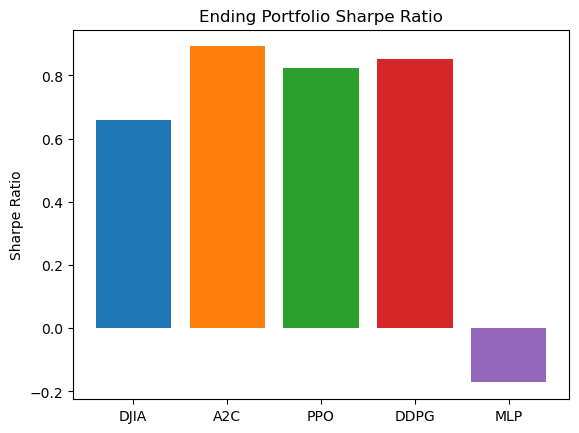

In [39]:
plt.bar("DJIA", baseline_df_stats["Sharpe ratio"])
print(baseline_df_stats["Sharpe ratio"])

def get_sharpe_mean(stats):
    return np.array([stat["Sharpe ratio"] for stat in stats]).mean(axis=0)

plt.bar("A2C", get_sharpe_mean(a2c_perf_stats))
print(get_sharpe_mean(a2c_perf_stats))

print(get_sharpe_mean(a2c_perf_stats) / baseline_df_stats["Sharpe ratio"])

plt.bar("PPO", get_sharpe_mean(ppo_perf_stats))
plt.bar("DDPG", get_sharpe_mean(ddpg_perf_stats))

plt.bar("MLP", get_sharpe_mean(mlp_stats))

plt.ylabel("Sharpe Ratio")
plt.title("Ending Portfolio Sharpe Ratio")
plt.show()